<a href="https://colab.research.google.com/github/vaishnavipatil29/NN_DL_Lab/blob/main/Spring_22_NNDL_Lab_11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# LAB 11 : Generative Adversarial Networks

Name : Vaishnavi, Joshitha

Roll Number : 180020039, 180020009

References : 

  1. https://towardsdatascience.com/gans-from-scratch-8f5da17b3fb4

#**Problem 1** : Understanding and Training Vanilla GANs  

1. Consider MNIST Digit Dataset
2. Create a Generator and a Discriminator Network and train the network. Follow this article : https://medium.com/ai-society/gans-from-scratch-1-a-deep-introduction-with-code-in-pytorch-and-tensorflow-cb03cdcdba0f
3. Explain briefly about your understanding of GANs

##Write down the Objectives, Hypothesis and Experimental description for the above problem


Objective : Train a GAN with a generator and discriminator on mnist digit dataset.

Experimental Description:

1. Sample a noise set and a real-data set, each with size m.
2. Train the Discriminator on this data.
3. Sample a different noise subset with size m.
4. Train the Generator on this data.
5. Repeat from Step 1.


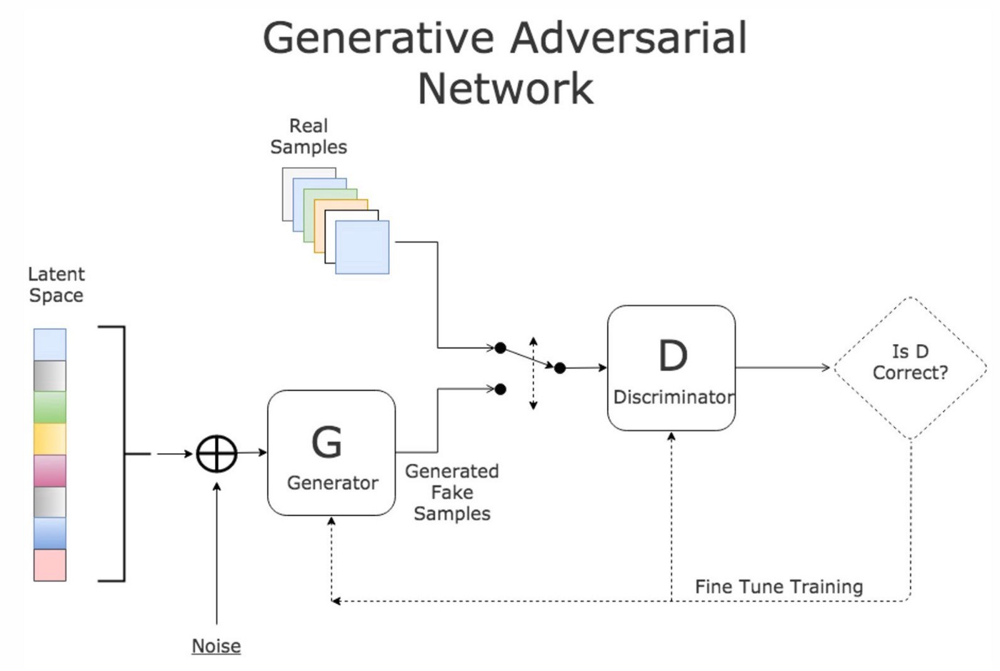

Generative Adversarial Networks are composed of two models:
1. The first model is called a Generator and it aims to generate new data similar to the expected one. The Generator could be asimilated to a human art forger, which creates fake works of art.
2. The second model is named the Discriminator. This model’s goal is to recognize if an input data is ‘real’ — belongs to the original dataset — or if it is ‘fake’ — generated by a forger. In this scenario, a Discriminator is analogous to an art expert, which tries to detect artworks as truthful or fraud.


## Programming : 
  Please write a program to demonstrate the same

In [ ]:
## Write your code here
!pip install torchvision tensorboardx jupyter matplotlib numpy


In [ ]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets


LeCunn’s MNIST dataset, consisting of about 60,000 black and white images of handwritten digits, each with size 28x28 pixels²

Preprocessing : 

Specifically, the input values which range in between [0, 255] will be normalized between -1 and 1. This means the value 0 will be mapped to -1, the value 255 to 1, and similarly all values in between will get a value in the range [-1, 1].


In [ ]:
def mnist_data():
    compose = transform = transforms.Compose([transforms.ToTensor(), transforms.Normalize([0.5], [0.5])])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)
# Load data
data = mnist_data()
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)


### Discriminator

Discriminator will take a flattened image as its input, and return the probability of it belonging to the real dataset, or the synthetic dataset. The input size for each image will be 28x28=784. 

Structure :  
3 hidden layers, each followed by a Leaky-ReLU nonlinearity and a Dropout layer to prevent overfitting. 

A Sigmoid/Logistic function is applied to the real-valued output to obtain a value in the open-range (0, 1):


In [ ]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

        
discriminator = DiscriminatorNet()


Additional functionality that allows us to convert a flattened image into its 2-dimensional representation, and another one that does the opposite.


In [ ]:
def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)


###  Generative Network :

Takes a latent variable vector as input, and returns a 784 valued vector, which corresponds to a flattened 28x28 image. The purpose of this network is to learn how to create undistinguishable images of hand-written digits, which is why its output is itself a new image.

Structure : 
1.  three hidden layers, each followed by a Leaky-ReLU nonlinearity. 
2. The output layer will have a TanH activation function, which maps the resulting values into the (-1, 1) range, which is the same range in which our preprocessed MNIST images is bounded.


In [ ]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
generator = GeneratorNet()


This function allows us to create the random noise. The random noise will be sampled from a normal distribution with mean 0 and variance 1.

In [ ]:
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 100))
    return n


we’ll use Adam as the optimization algorithm for both neural networks, with a learning rate of 0.0002

In [ ]:
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)


Loss function : Binary Cross Entopy Loss (BCE Loss) as it resembles the log-loss for both the Generator and Discriminator

In [ ]:
loss = nn.BCELoss()


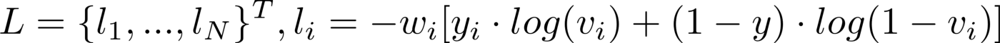
Binary Cross Entropy Log. Mean is calculated by computing sum(L) / N.
In this formula the values y are named targets, v are the inputs, and w are the weights. Since we don’t need the weight at all, it’ll be set to wᵢ=1 for all i.


Discriminator Loss:
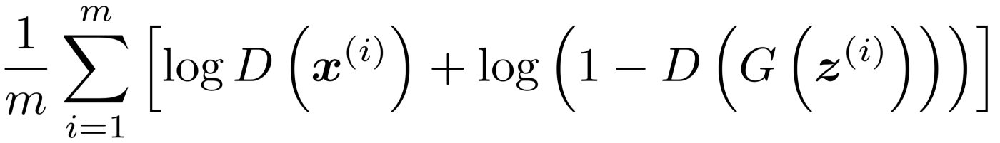

If we replace vᵢ = D(xᵢ) and yᵢ=1 ∀ i (for all i) in the BCE-Loss definition, we obtain the loss related to the real-images. Conversely if we set vᵢ = D(G(zᵢ)) and yᵢ=0 ∀ i, we obtain the loss related to the fake-images

Since maximizing a function is equivalent to minimizing it’s negative, and the BCE-Loss term has a minus sign, we don’t need to worry about the sign.


We can observe that the real-images targets are always ones, while the fake-images targets are zero, so it would be helpful to define the following functions:


In [ ]:
def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data


By summing up these two discriminator losses we obtain the total mini-batch loss for the Discriminator. We will calculate the gradients separately, and then update them together.


In [ ]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N) )
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake


Generator Loss:
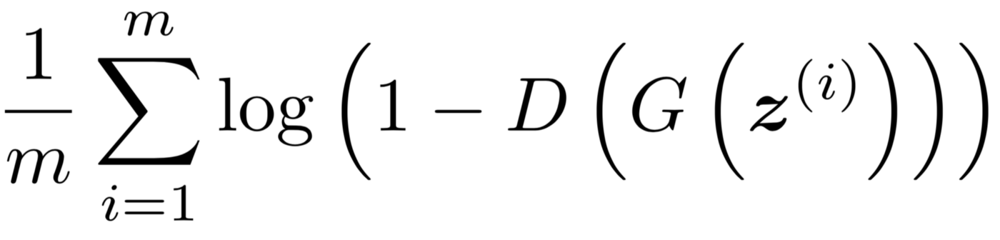

Rather than minimizing log(1- D(G(z))), training the Generator to maximize log D(G(z)) will provide much stronger gradients early in training. Both losses may be swapped interchangeably since they result in the same dynamics for the Generator and Discriminator.

Maximizing log D(G(z)) is equivalent to minimizing it’s negative and since the BCE-Loss definition has a minus sign, we don’t need to take care of the sign. Similarly to the Discriminator, if we set vᵢ = D(G(zᵢ)) and yᵢ=1 ∀ i, we obtain the desired loss to be minimized.


In [ ]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error


In [ ]:
!wget https://raw.githubusercontent.com/diegoalejogm/gans/master/utils.py

In [ ]:
from utils1 import Logger


In [ ]:
num_test_samples = 16
test_noise = noise(num_test_samples)


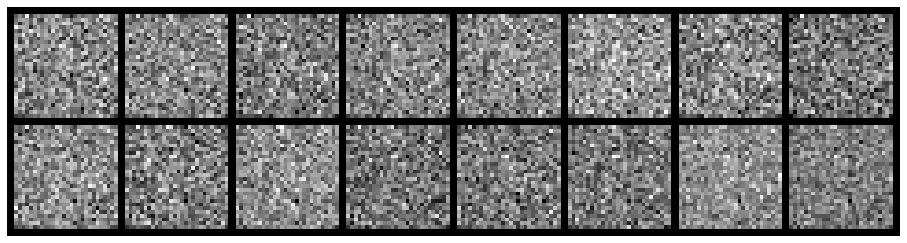

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3903, Generator Loss: 0.6739
D(x): 0.5079, D(G(z)): 0.5095


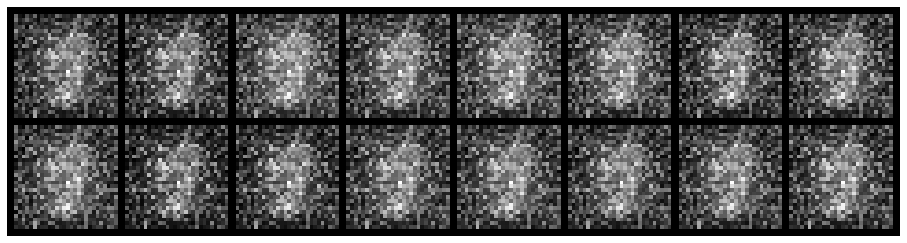

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 1.3107, Generator Loss: 1.5540
D(x): 0.6453, D(G(z)): 0.4654


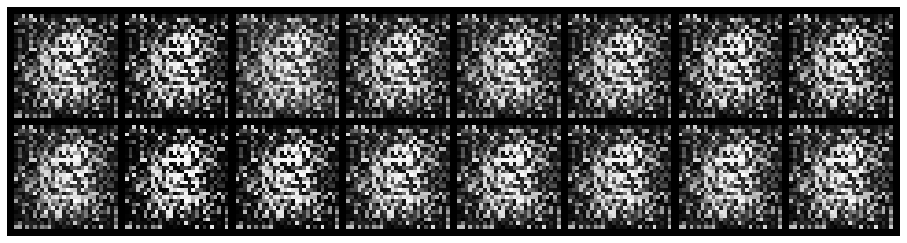

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.4103, Generator Loss: 3.8607
D(x): 0.8561, D(G(z)): 0.1803


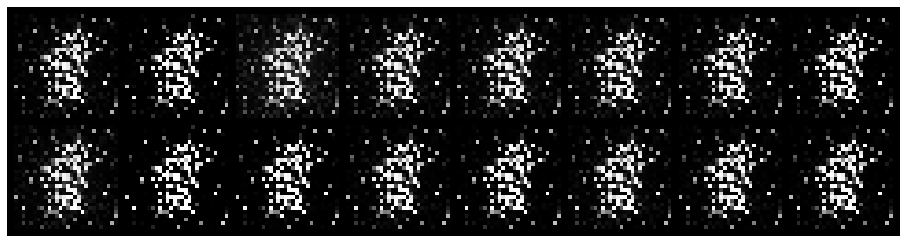

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.2172, Generator Loss: 5.2012
D(x): 0.9144, D(G(z)): 0.0706


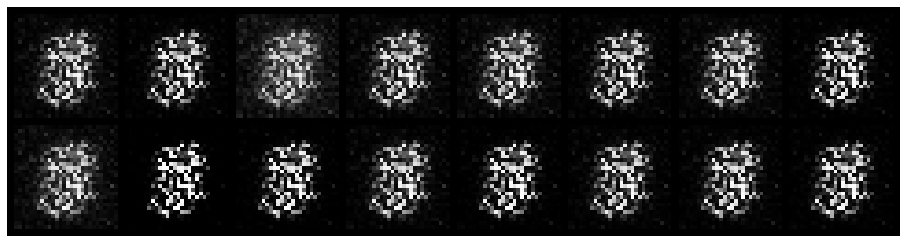

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.1979, Generator Loss: 4.6796
D(x): 0.9372, D(G(z)): 0.0954


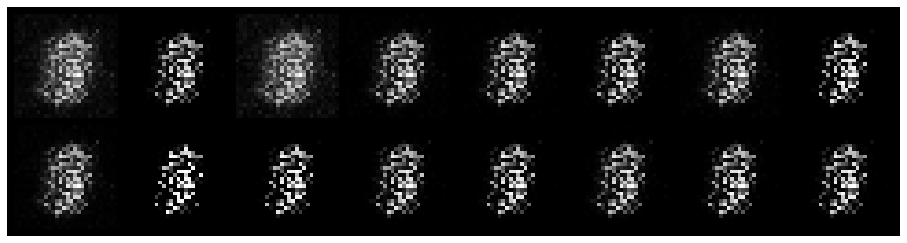

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 3.4884, Generator Loss: 0.2022
D(x): 0.4553, D(G(z)): 0.8914


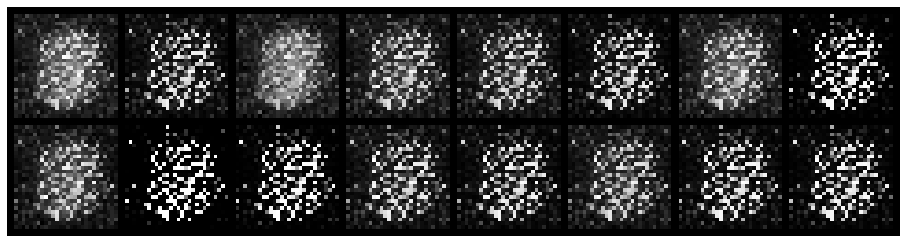

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.4254, Generator Loss: 5.7648
D(x): 0.8946, D(G(z)): 0.1652


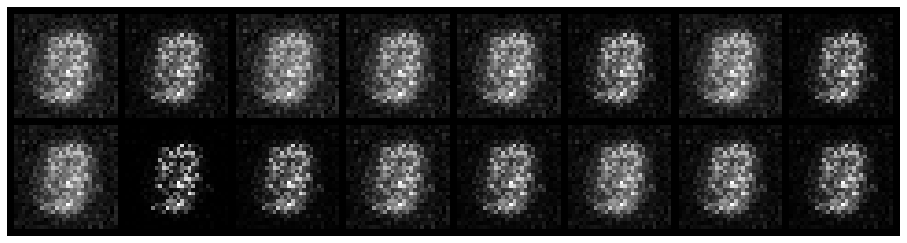

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 0.7442, Generator Loss: 1.8500
D(x): 0.7011, D(G(z)): 0.2511


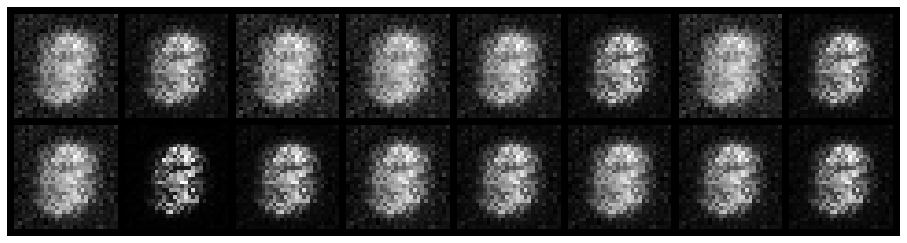

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 1.0229, Generator Loss: 1.5624
D(x): 0.6964, D(G(z)): 0.3814


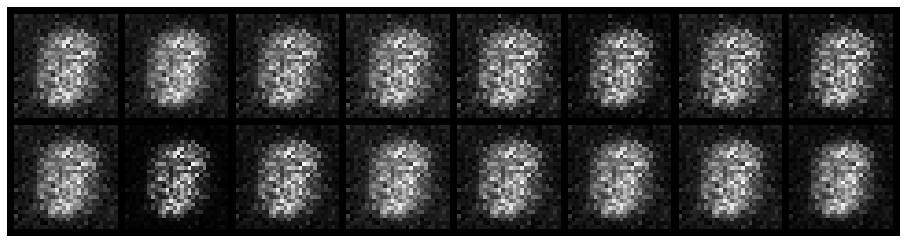

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.7962, Generator Loss: 1.5167
D(x): 0.6905, D(G(z)): 0.3034


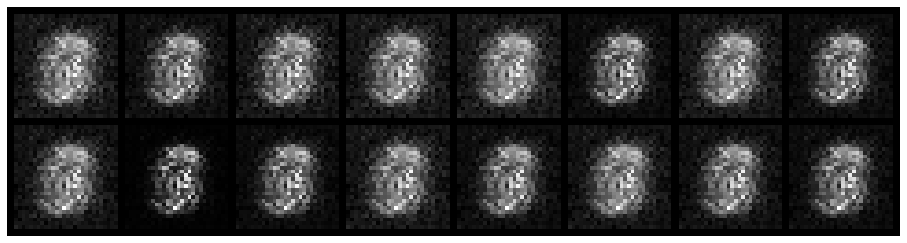

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 1.2454, Generator Loss: 0.8226
D(x): 0.6228, D(G(z)): 0.4971


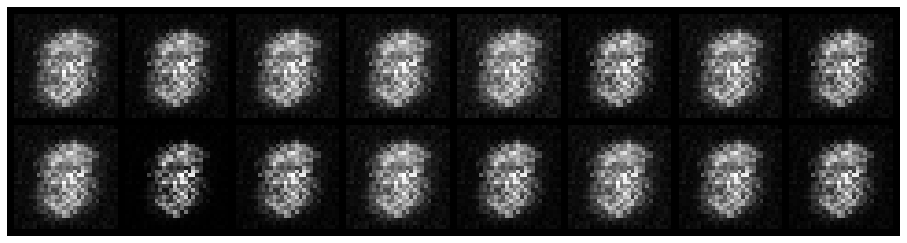

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 2.1498, Generator Loss: 0.7261
D(x): 0.4806, D(G(z)): 0.6244


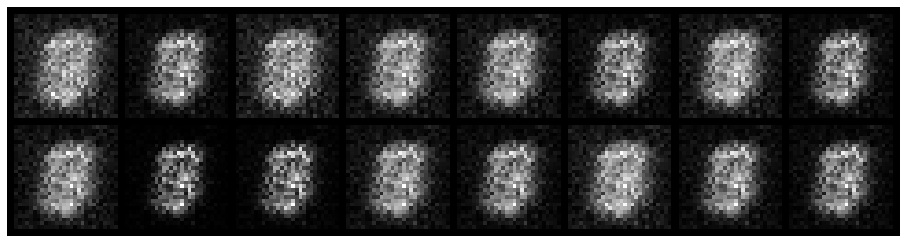

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.8636, Generator Loss: 2.6933
D(x): 0.7141, D(G(z)): 0.2016


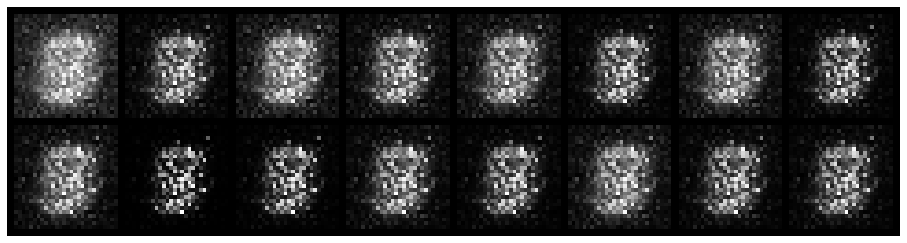

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 1.2817, Generator Loss: 1.4568
D(x): 0.6421, D(G(z)): 0.4409


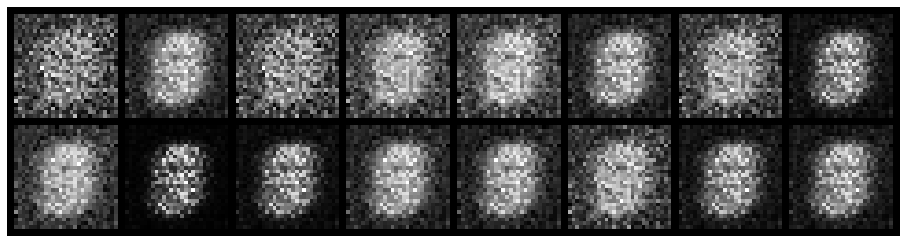

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.7094, Generator Loss: 4.0822
D(x): 0.8993, D(G(z)): 0.2891


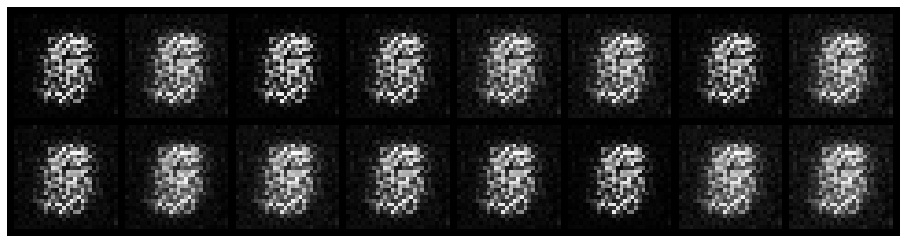

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.4289, Generator Loss: 2.5324
D(x): 0.8777, D(G(z)): 0.2066


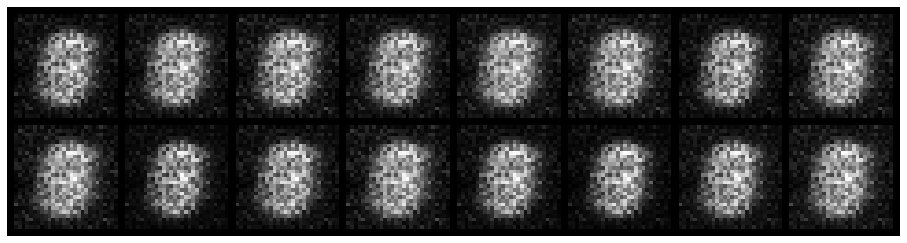

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.7984, Generator Loss: 1.8858
D(x): 0.8332, D(G(z)): 0.3509


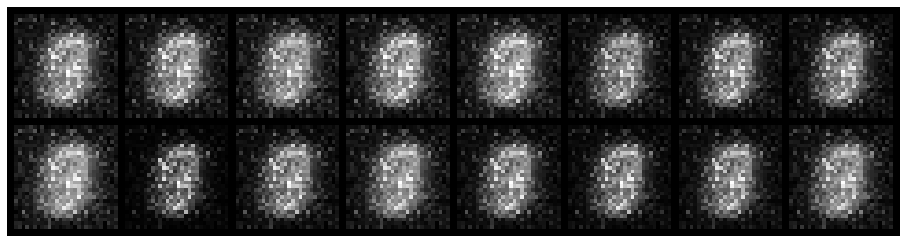

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.6288, Generator Loss: 2.5371
D(x): 0.8164, D(G(z)): 0.2273


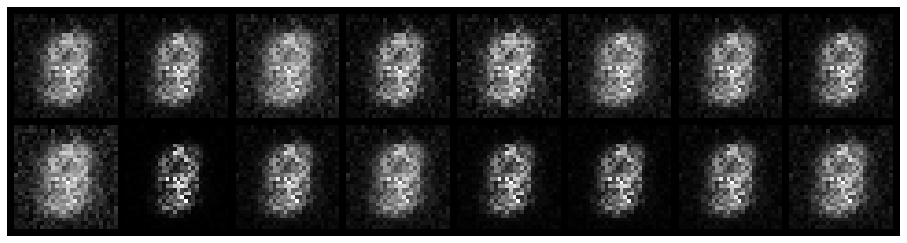

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 1.4750, Generator Loss: 1.8204
D(x): 0.6082, D(G(z)): 0.3860


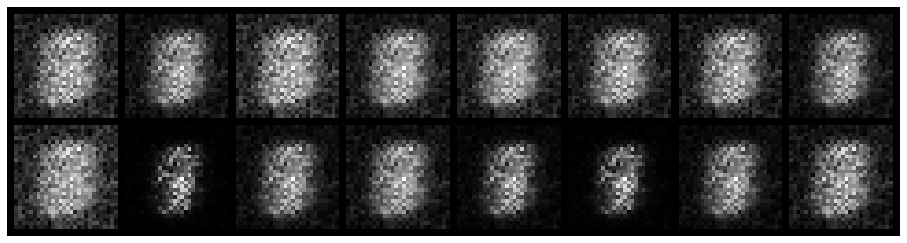

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 1.0624, Generator Loss: 1.4107
D(x): 0.7165, D(G(z)): 0.3440


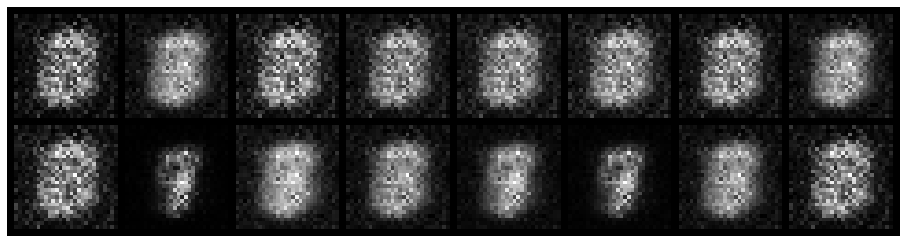

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.6830, Generator Loss: 2.6202
D(x): 0.8175, D(G(z)): 0.2660


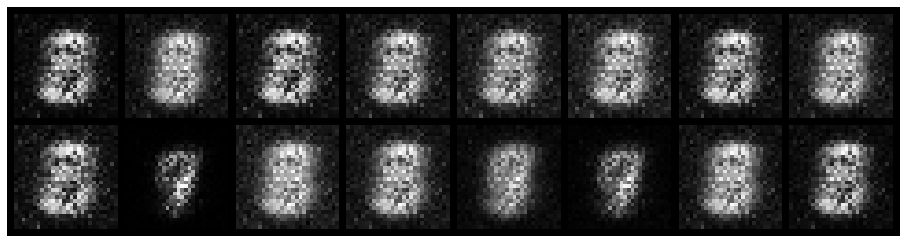

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.5894, Generator Loss: 2.7921
D(x): 0.8013, D(G(z)): 0.1432


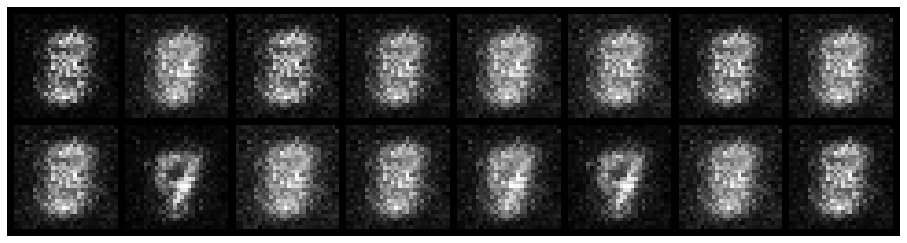

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.3639, Generator Loss: 2.4945
D(x): 0.8873, D(G(z)): 0.1173


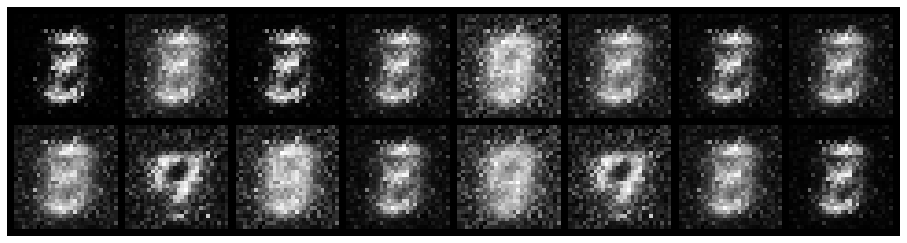

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.2981, Generator Loss: 3.2800
D(x): 0.9161, D(G(z)): 0.1240


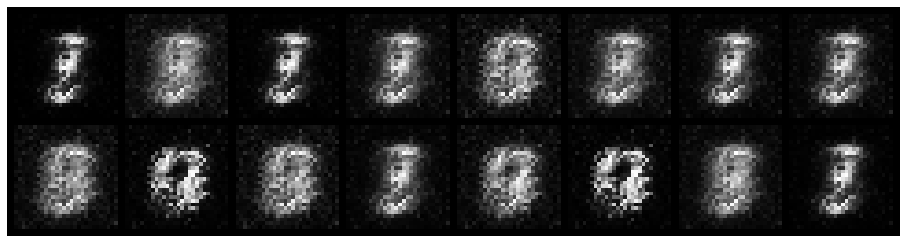

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 1.1475, Generator Loss: 1.7909
D(x): 0.6720, D(G(z)): 0.3265


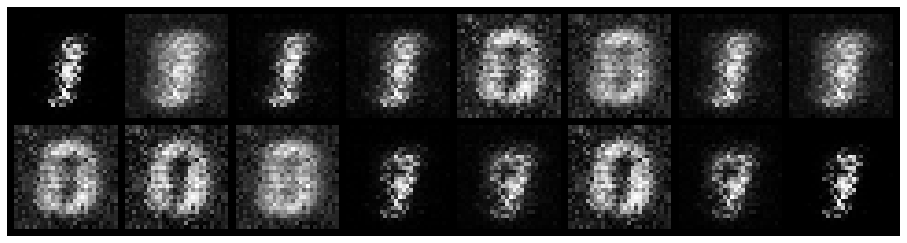

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.6870, Generator Loss: 2.8420
D(x): 0.8899, D(G(z)): 0.2824


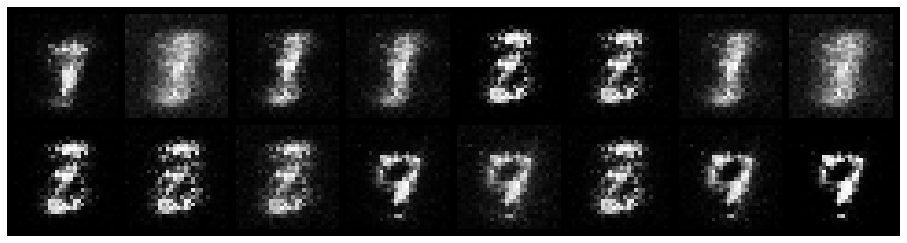

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.4198, Generator Loss: 3.0319
D(x): 0.8642, D(G(z)): 0.1507


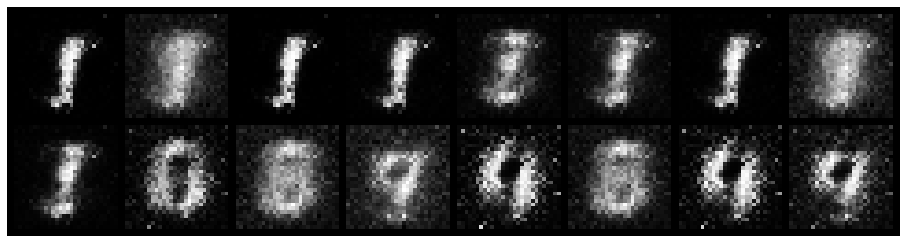

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.5388, Generator Loss: 2.3935
D(x): 0.8023, D(G(z)): 0.1415


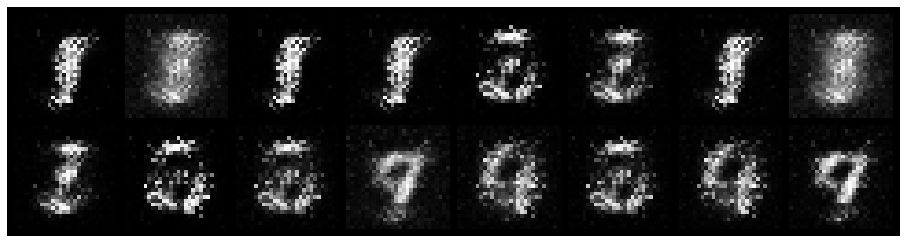

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.2717, Generator Loss: 3.9253
D(x): 0.8815, D(G(z)): 0.0511


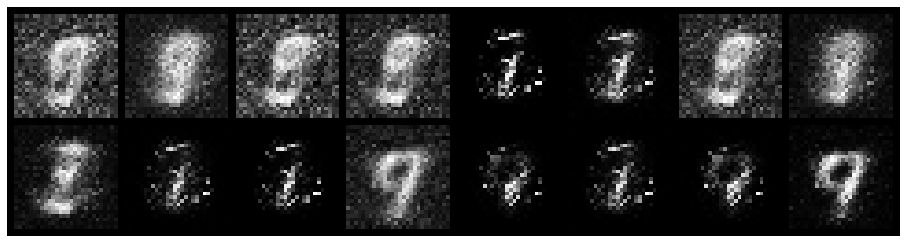

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.6313, Generator Loss: 2.8162
D(x): 0.8907, D(G(z)): 0.1817


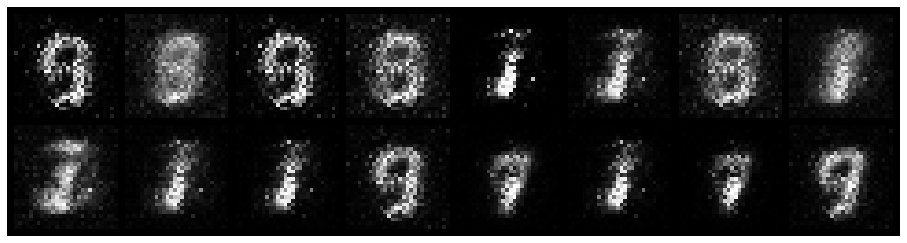

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.5397, Generator Loss: 2.9395
D(x): 0.8047, D(G(z)): 0.0891


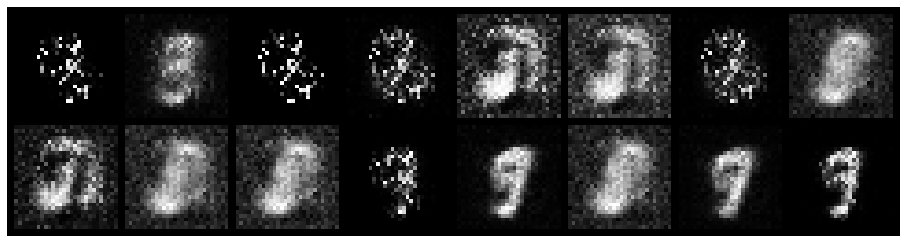

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.7125, Generator Loss: 3.0104
D(x): 0.7932, D(G(z)): 0.1440


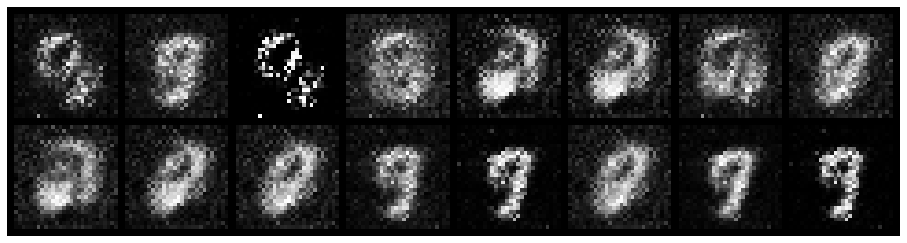

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.5255, Generator Loss: 2.0980
D(x): 0.8820, D(G(z)): 0.2135


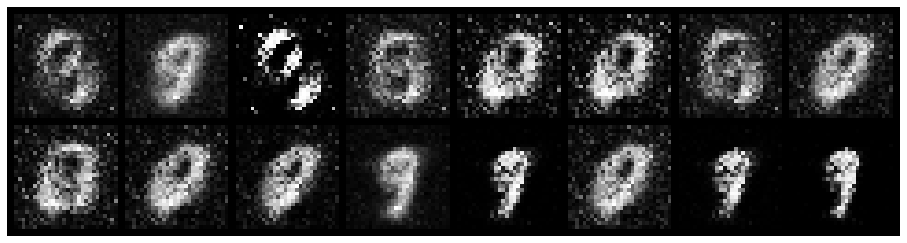

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.5374, Generator Loss: 2.2788
D(x): 0.8848, D(G(z)): 0.2488


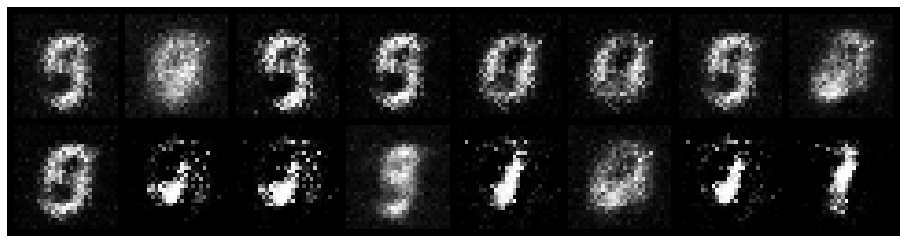

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.4886, Generator Loss: 2.7350
D(x): 0.8012, D(G(z)): 0.0829


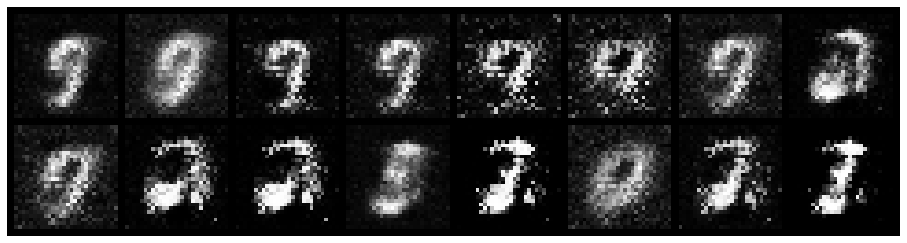

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.5162, Generator Loss: 2.1069
D(x): 0.9125, D(G(z)): 0.2704


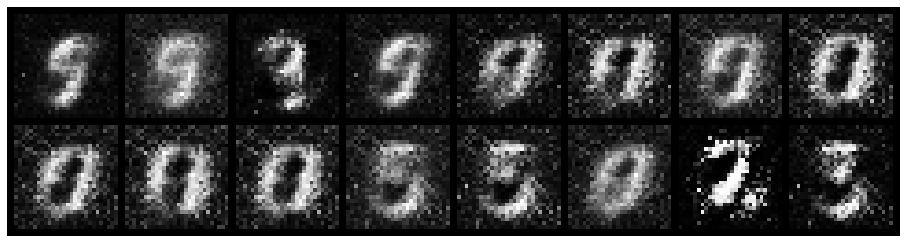

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.5195, Generator Loss: 2.9282
D(x): 0.8515, D(G(z)): 0.1539


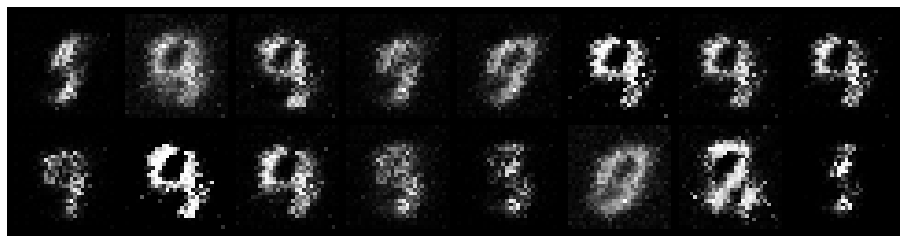

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.8992, Generator Loss: 2.1130
D(x): 0.7248, D(G(z)): 0.2263


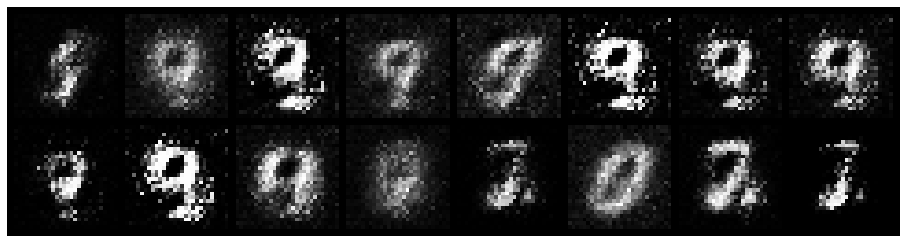

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 1.0316, Generator Loss: 2.0639
D(x): 0.7086, D(G(z)): 0.3050


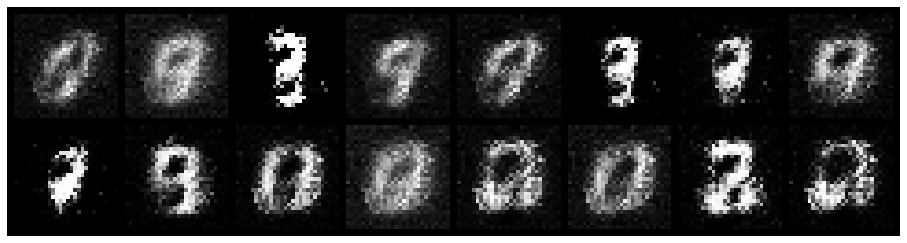

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.6809, Generator Loss: 1.9455
D(x): 0.7369, D(G(z)): 0.1768


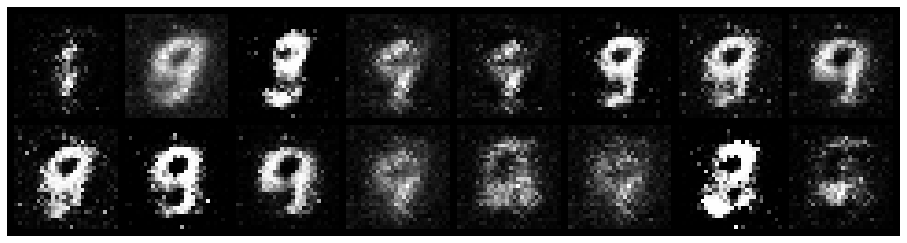

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.7976, Generator Loss: 2.7486
D(x): 0.7341, D(G(z)): 0.1225


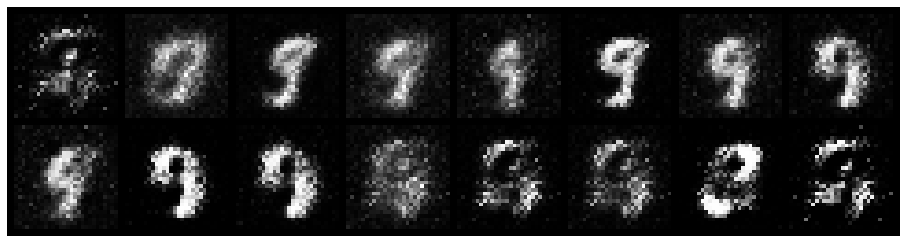

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.6426, Generator Loss: 2.9785
D(x): 0.8076, D(G(z)): 0.1649


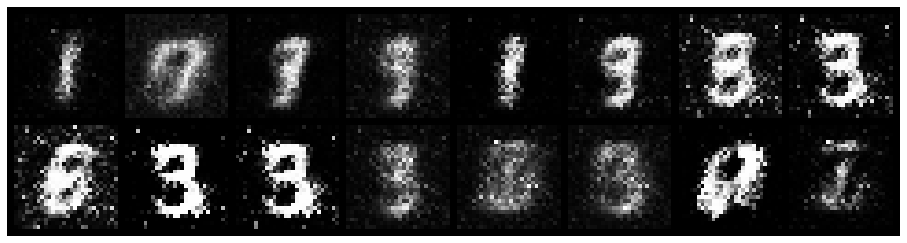

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.5746, Generator Loss: 2.9826
D(x): 0.8304, D(G(z)): 0.2060


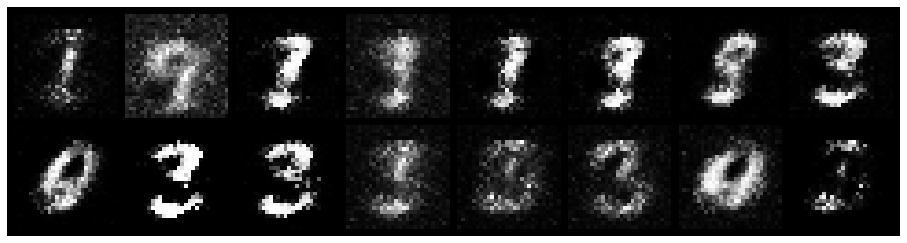

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.5185, Generator Loss: 2.6351
D(x): 0.8284, D(G(z)): 0.1559


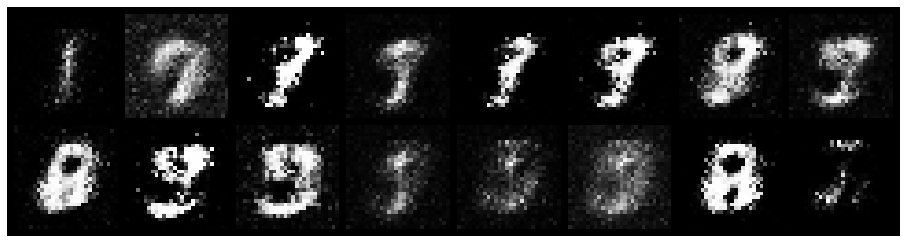

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.5331, Generator Loss: 3.6198
D(x): 0.8768, D(G(z)): 0.1779


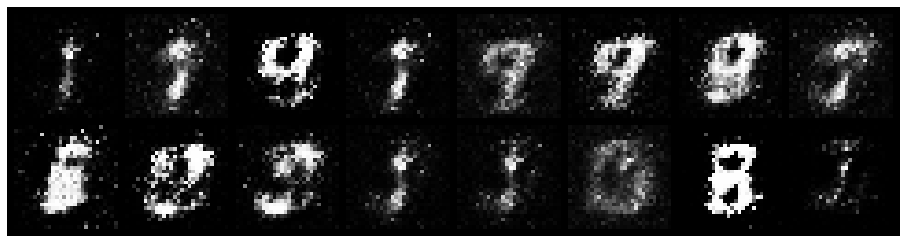

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.4279, Generator Loss: 3.6291
D(x): 0.8175, D(G(z)): 0.0525


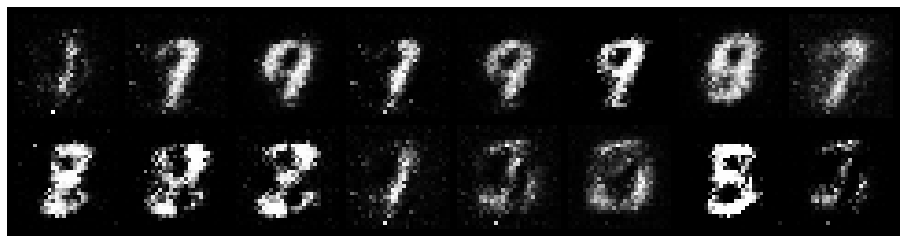

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.3504, Generator Loss: 2.7194
D(x): 0.8881, D(G(z)): 0.1198


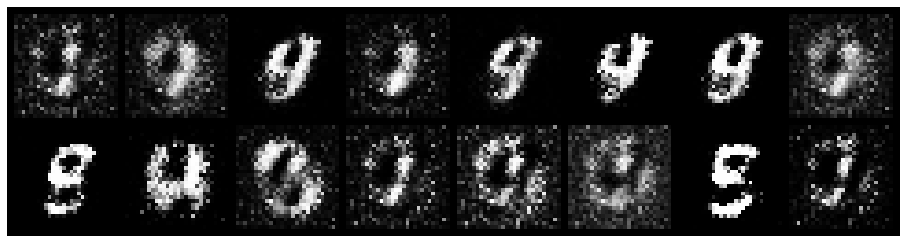

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.7944, Generator Loss: 2.2653
D(x): 0.7459, D(G(z)): 0.1949


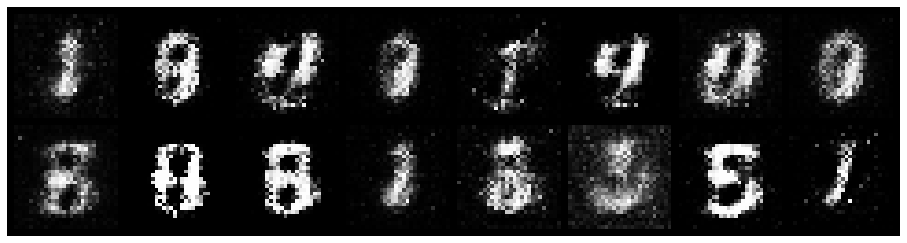

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.5140, Generator Loss: 3.8277
D(x): 0.7842, D(G(z)): 0.0784


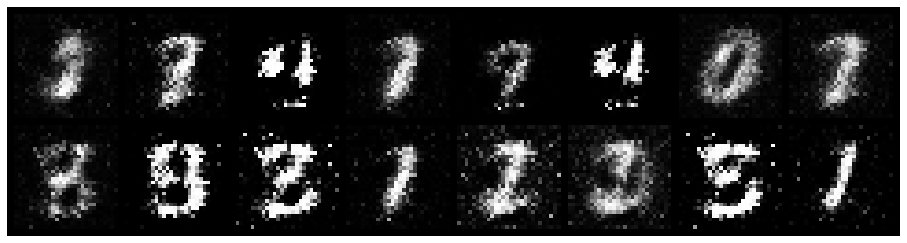

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.6672, Generator Loss: 2.6156
D(x): 0.7992, D(G(z)): 0.1423


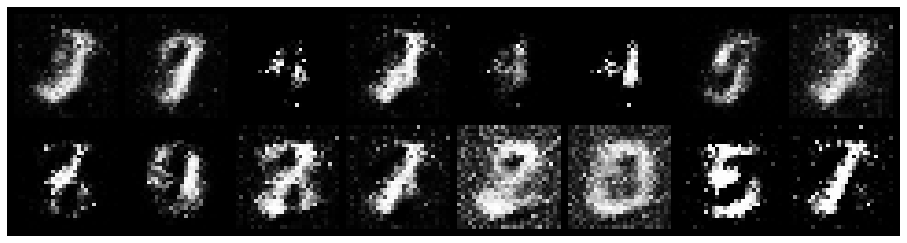

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.5651, Generator Loss: 2.4275
D(x): 0.8607, D(G(z)): 0.1929


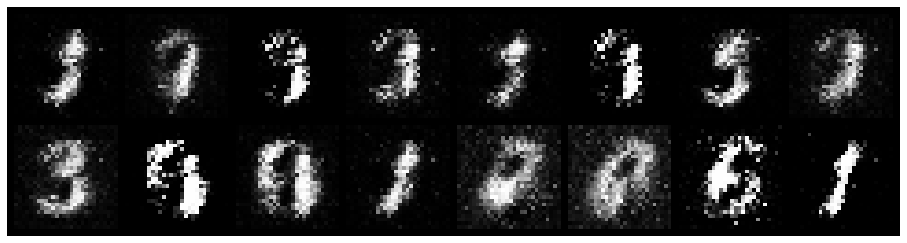

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.5882, Generator Loss: 3.0683
D(x): 0.7986, D(G(z)): 0.1556


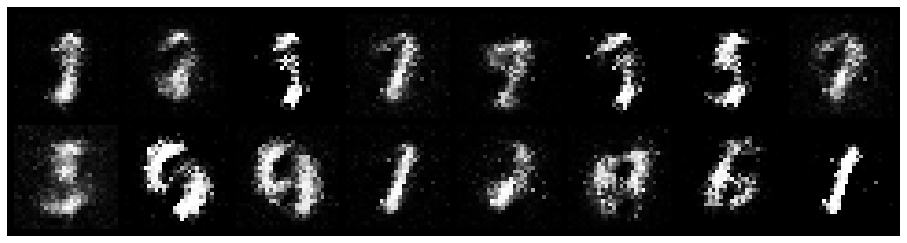

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.7146, Generator Loss: 2.9814
D(x): 0.8046, D(G(z)): 0.1848


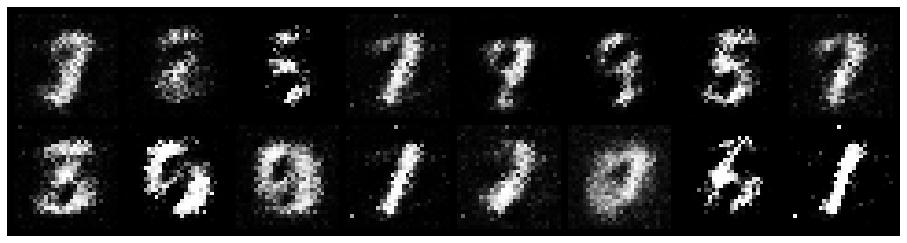

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.3270, Generator Loss: 2.2835
D(x): 0.9080, D(G(z)): 0.1575


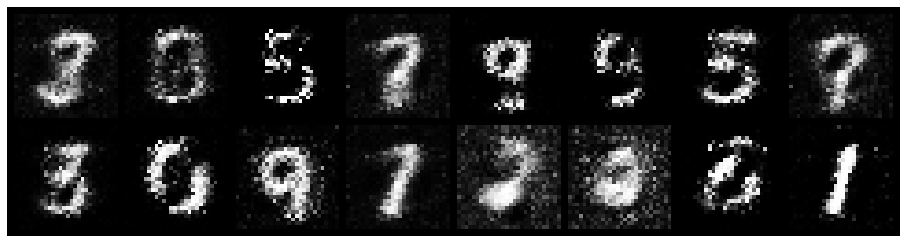

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.5112, Generator Loss: 2.1421
D(x): 0.8606, D(G(z)): 0.1886


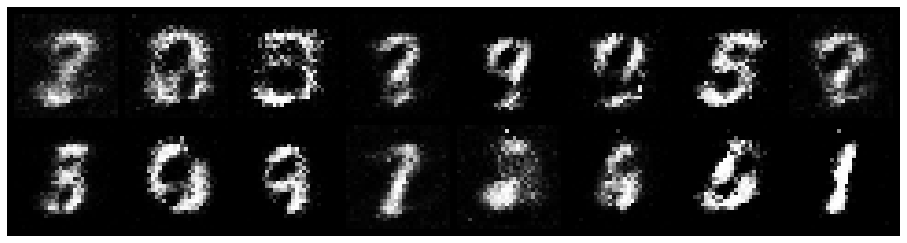

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.4318, Generator Loss: 2.8705
D(x): 0.8012, D(G(z)): 0.0705


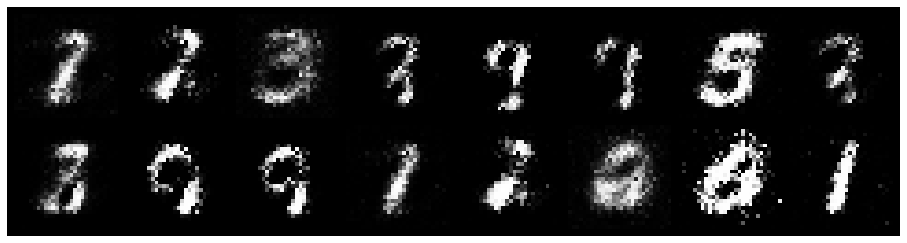

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.6660, Generator Loss: 2.3486
D(x): 0.8568, D(G(z)): 0.2616


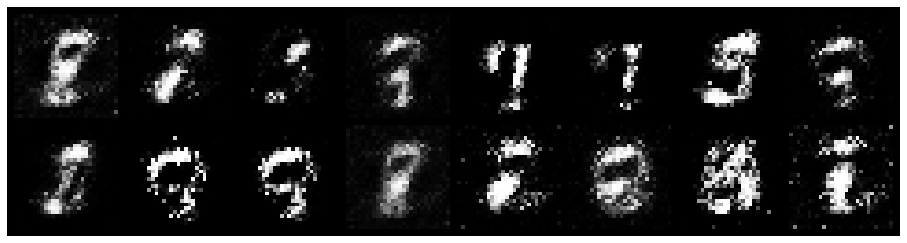

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.6697, Generator Loss: 2.1080
D(x): 0.8231, D(G(z)): 0.2237


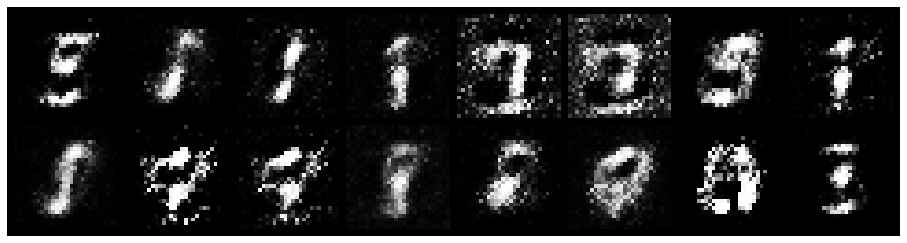

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.7538, Generator Loss: 1.7718
D(x): 0.8236, D(G(z)): 0.3028


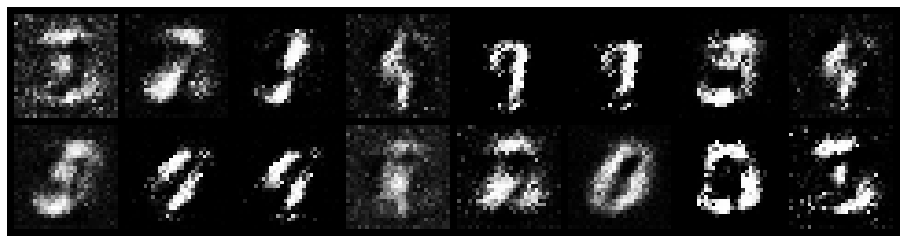

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.6963, Generator Loss: 2.2048
D(x): 0.7871, D(G(z)): 0.2290


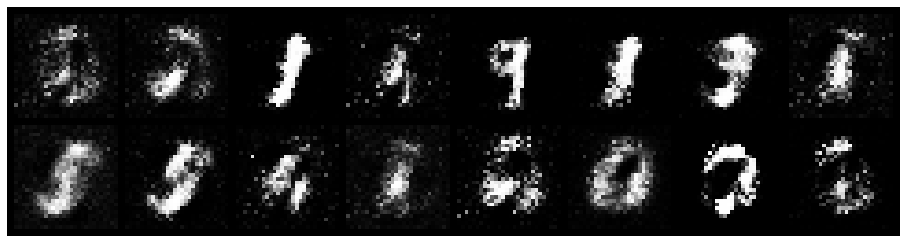

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.9303, Generator Loss: 2.2031
D(x): 0.7037, D(G(z)): 0.1801


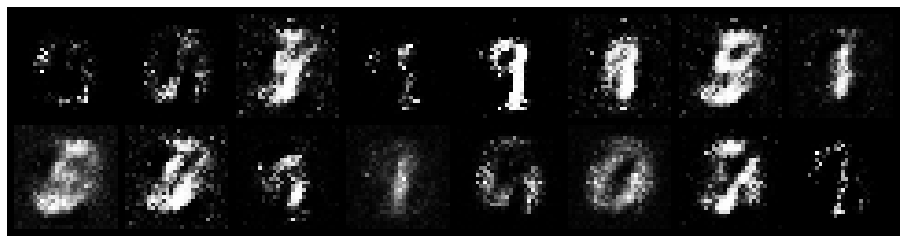

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.6195, Generator Loss: 2.1690
D(x): 0.7898, D(G(z)): 0.1674


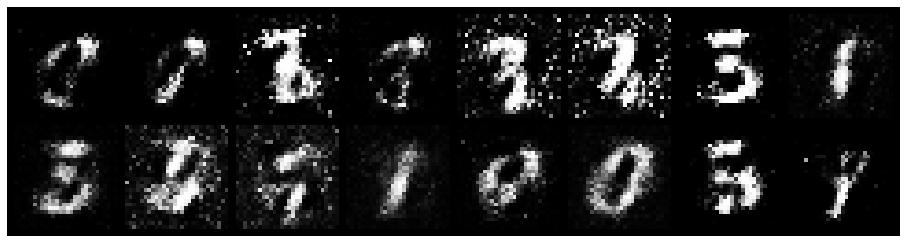

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.7218, Generator Loss: 2.7567
D(x): 0.7136, D(G(z)): 0.1482


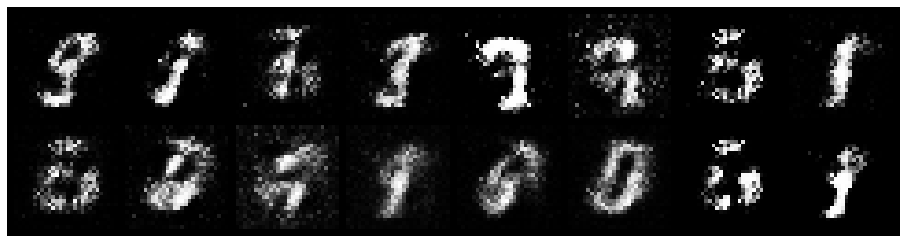

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.5841, Generator Loss: 2.6859
D(x): 0.8034, D(G(z)): 0.1676


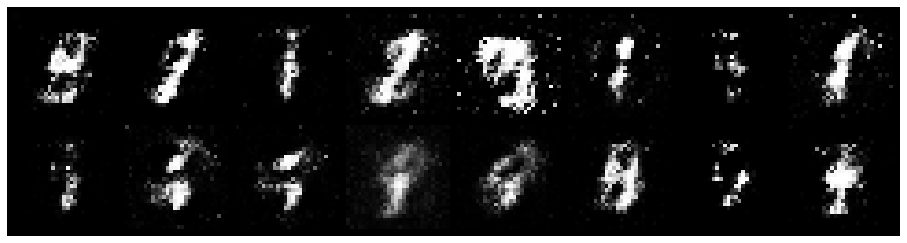

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.3359, Generator Loss: 3.4784
D(x): 0.9049, D(G(z)): 0.1177


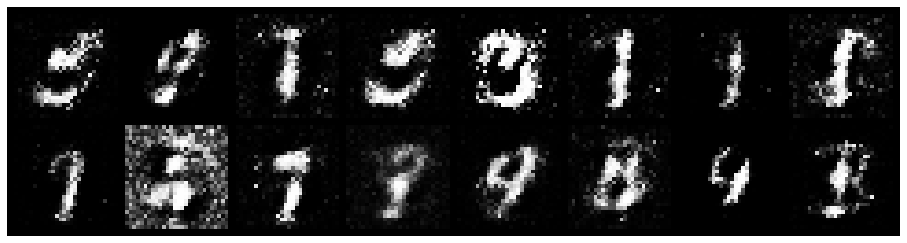

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.6091, Generator Loss: 2.7456
D(x): 0.8765, D(G(z)): 0.2557


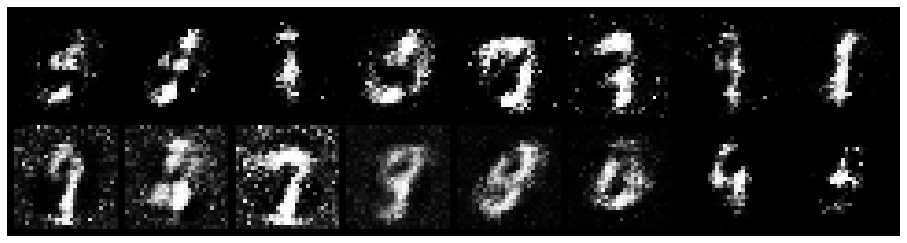

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.3690, Generator Loss: 3.5236
D(x): 0.8590, D(G(z)): 0.1105


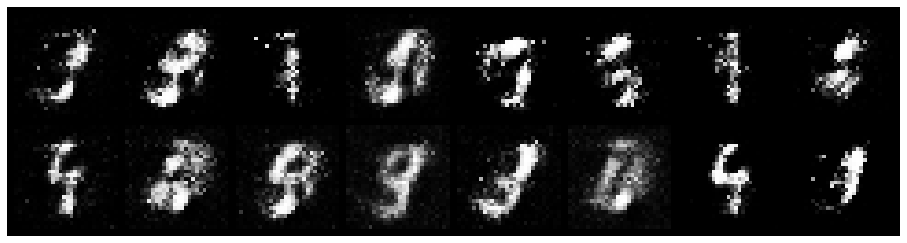

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.5933, Generator Loss: 2.8625
D(x): 0.7541, D(G(z)): 0.1263


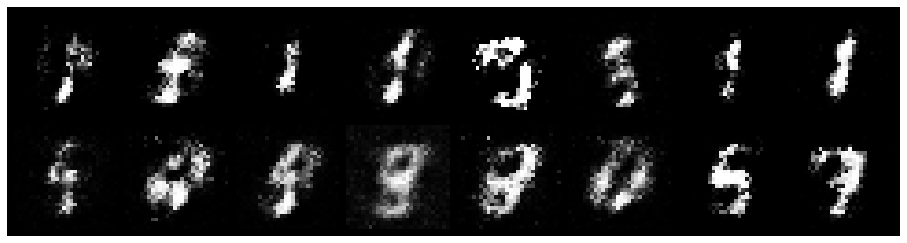

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.4270, Generator Loss: 2.5895
D(x): 0.8743, D(G(z)): 0.1844


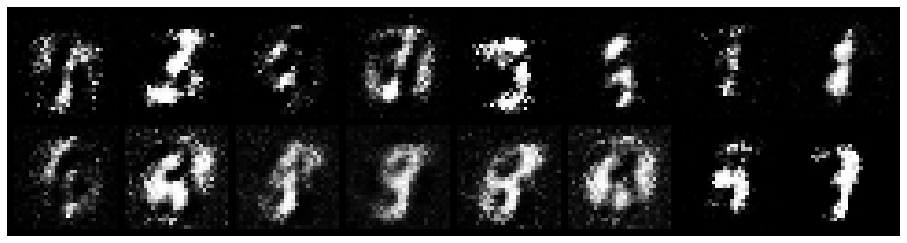

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.5827, Generator Loss: 1.9990
D(x): 0.7804, D(G(z)): 0.1744


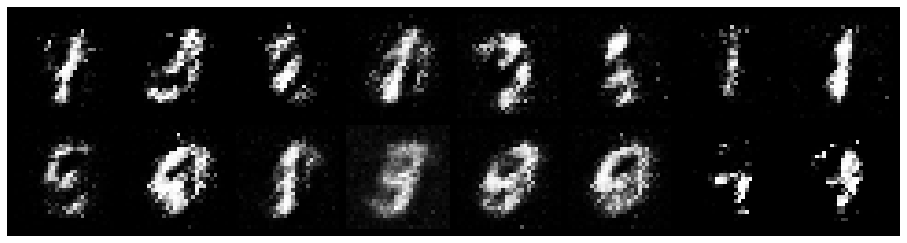

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.5941, Generator Loss: 2.2395
D(x): 0.8198, D(G(z)): 0.1997


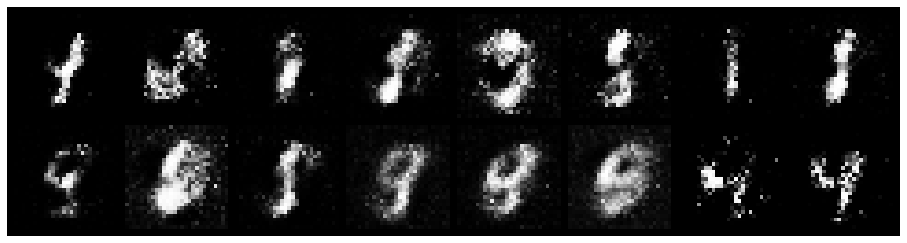

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.6624, Generator Loss: 2.0789
D(x): 0.7570, D(G(z)): 0.1908


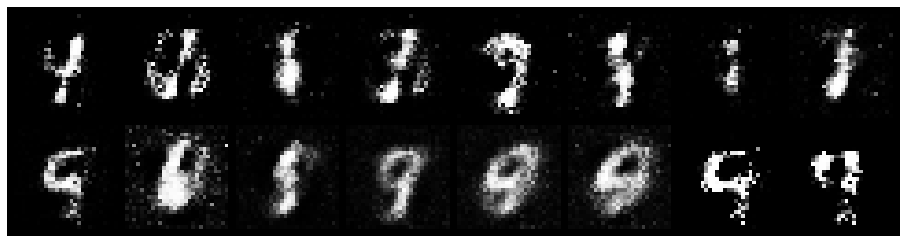

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.8891, Generator Loss: 1.9802
D(x): 0.6211, D(G(z)): 0.2121


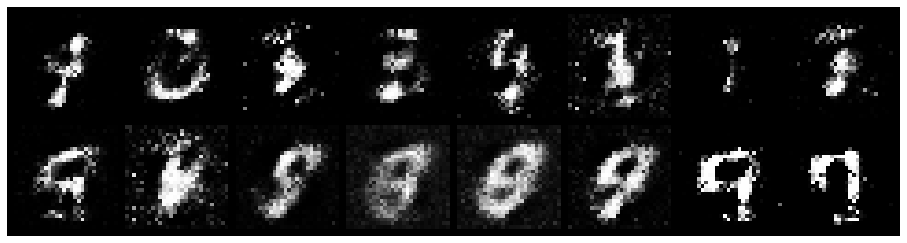

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.6609, Generator Loss: 1.8082
D(x): 0.8013, D(G(z)): 0.2890


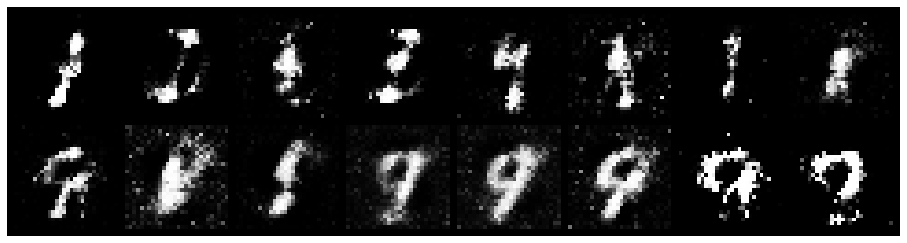

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.5460, Generator Loss: 2.4098
D(x): 0.8080, D(G(z)): 0.1486


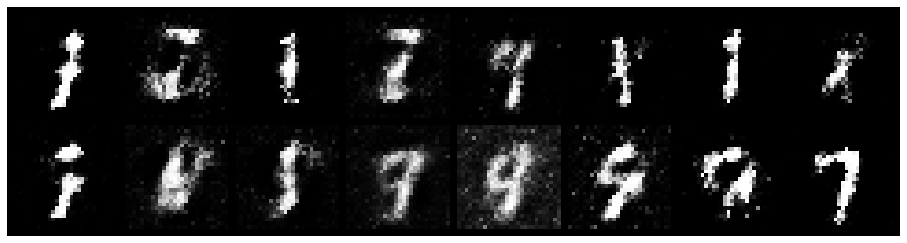

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.4484, Generator Loss: 2.3827
D(x): 0.8355, D(G(z)): 0.1568


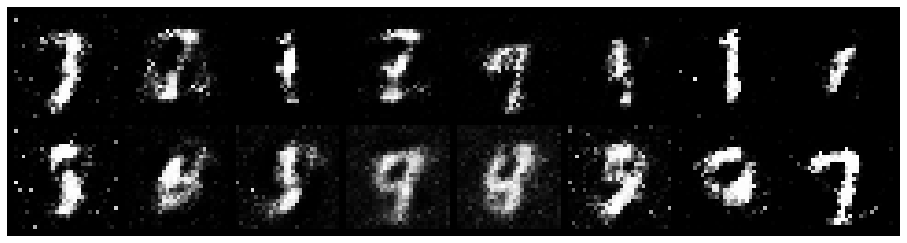

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.4415, Generator Loss: 2.4635
D(x): 0.8441, D(G(z)): 0.1781


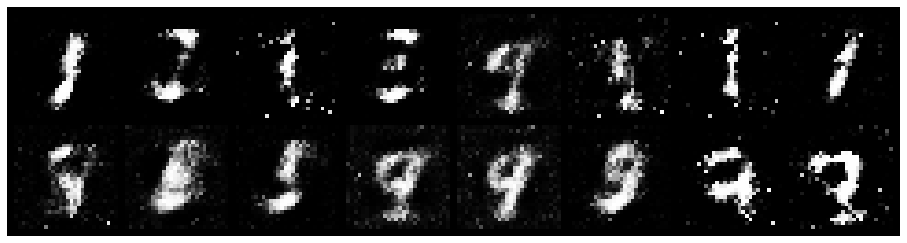

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.5180, Generator Loss: 2.4605
D(x): 0.8115, D(G(z)): 0.1484


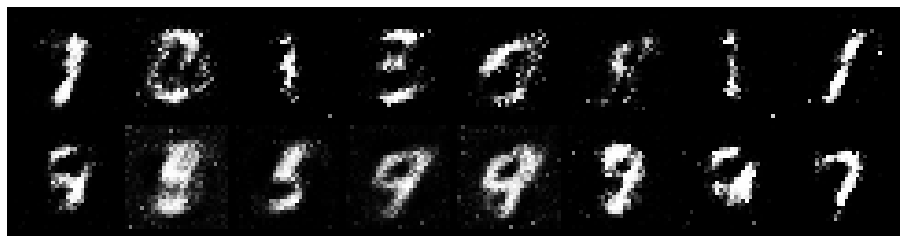

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.6122, Generator Loss: 2.4269
D(x): 0.7748, D(G(z)): 0.1945


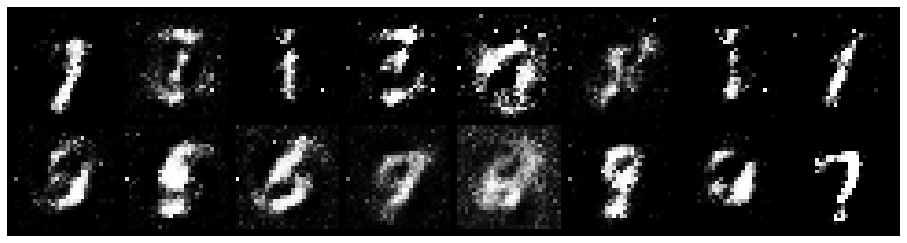

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.8920, Generator Loss: 2.3849
D(x): 0.8121, D(G(z)): 0.3137


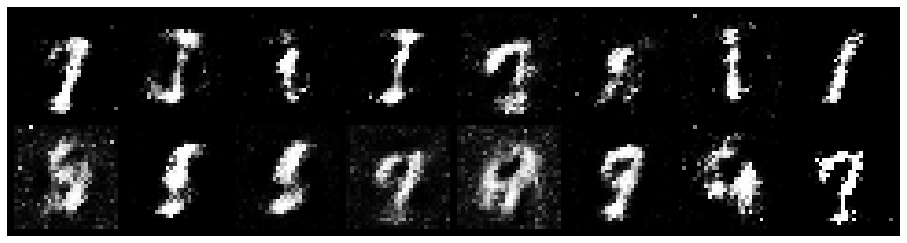

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.6108, Generator Loss: 1.7887
D(x): 0.7897, D(G(z)): 0.2269


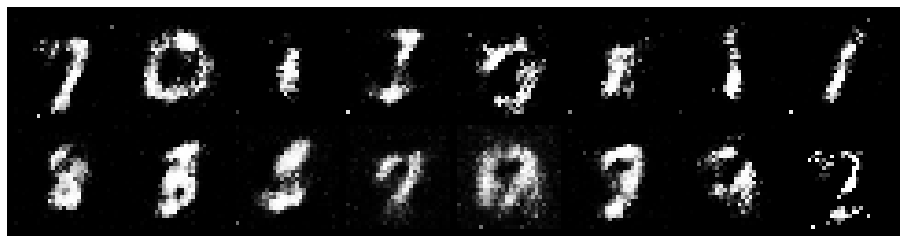

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.6824, Generator Loss: 2.0234
D(x): 0.7683, D(G(z)): 0.1875


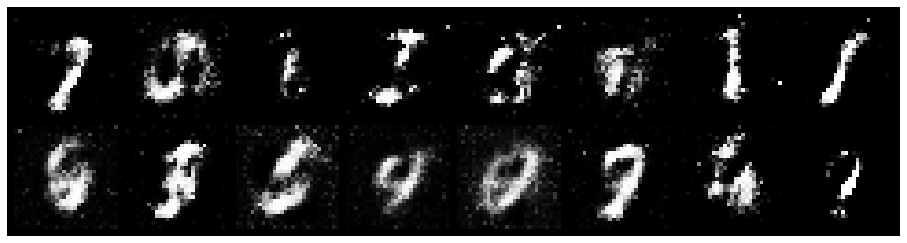

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.5647, Generator Loss: 2.5077
D(x): 0.8289, D(G(z)): 0.1865


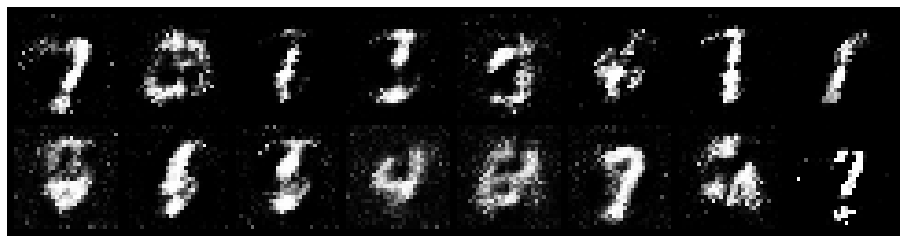

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.6474, Generator Loss: 2.0551
D(x): 0.7541, D(G(z)): 0.1958


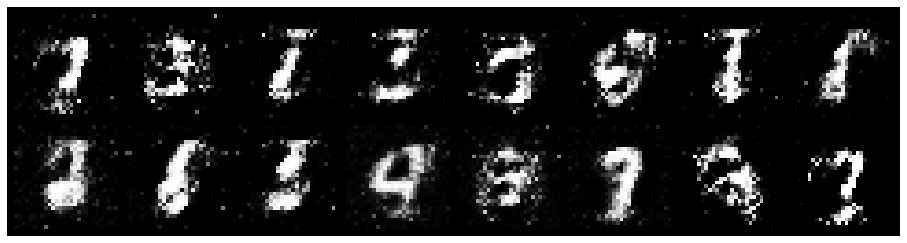

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.8227, Generator Loss: 1.7950
D(x): 0.7227, D(G(z)): 0.2401


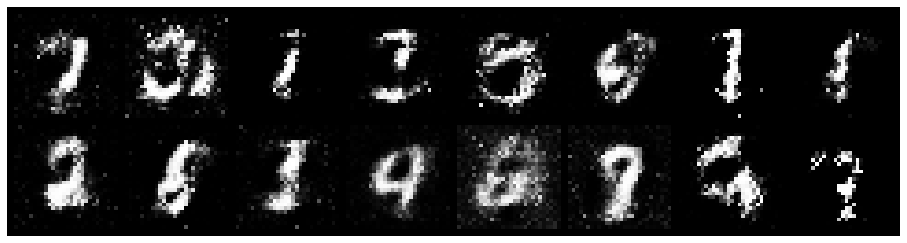

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.6915, Generator Loss: 2.2236
D(x): 0.7833, D(G(z)): 0.2553


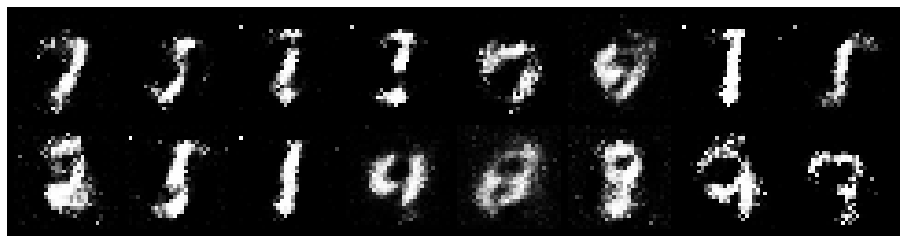

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.8448, Generator Loss: 1.4487
D(x): 0.7671, D(G(z)): 0.2910


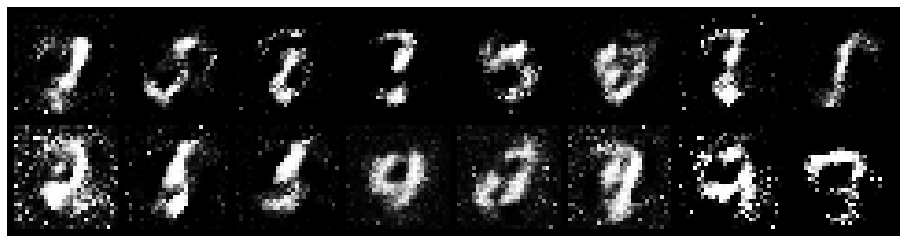

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.9672, Generator Loss: 1.8583
D(x): 0.6393, D(G(z)): 0.1973


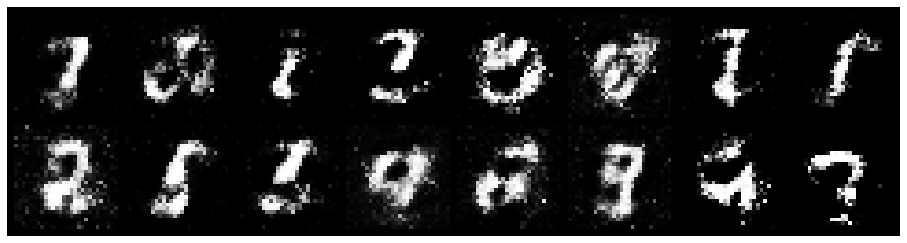

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.9610, Generator Loss: 1.7508
D(x): 0.7791, D(G(z)): 0.3469


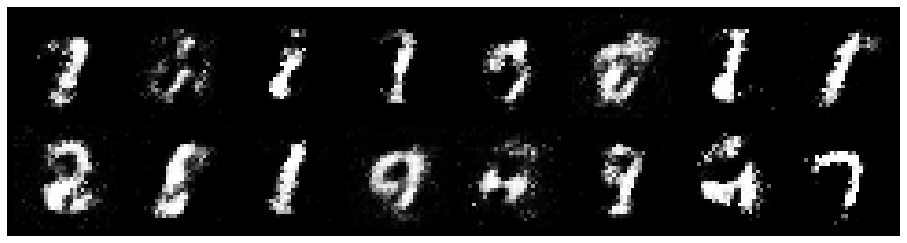

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.6062, Generator Loss: 1.9366
D(x): 0.7906, D(G(z)): 0.1956


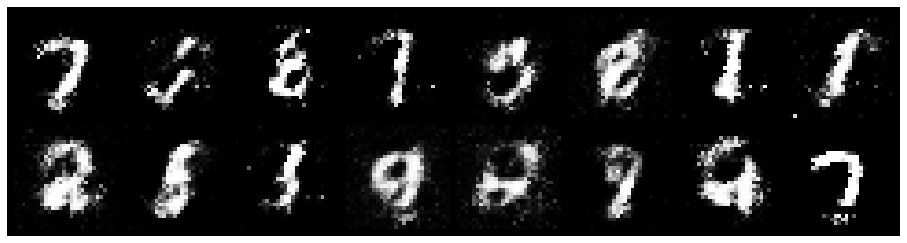

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.8353, Generator Loss: 2.3939
D(x): 0.7075, D(G(z)): 0.1803


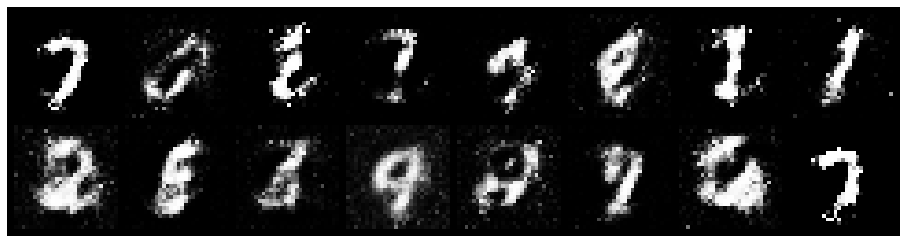

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.5001, Generator Loss: 2.0832
D(x): 0.8354, D(G(z)): 0.1804


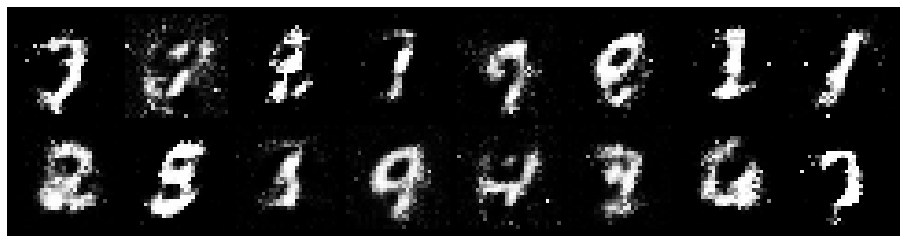

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.7995, Generator Loss: 2.0105
D(x): 0.8061, D(G(z)): 0.2681


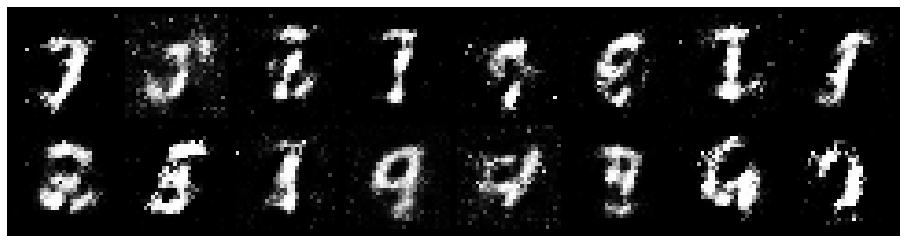

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.6805, Generator Loss: 1.8456
D(x): 0.8175, D(G(z)): 0.2397


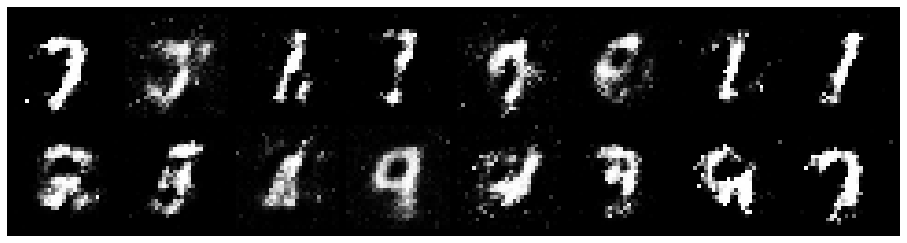

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.8888, Generator Loss: 1.8696
D(x): 0.7074, D(G(z)): 0.2832


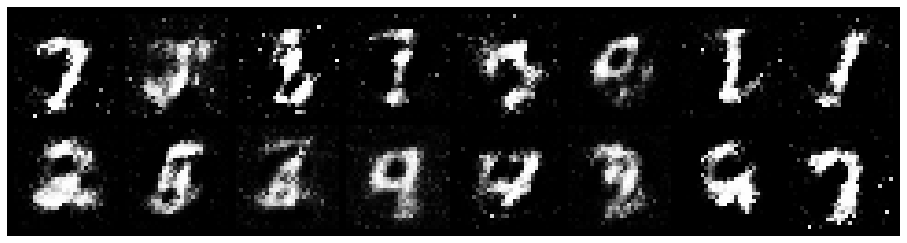

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.7442, Generator Loss: 2.0596
D(x): 0.7772, D(G(z)): 0.2738


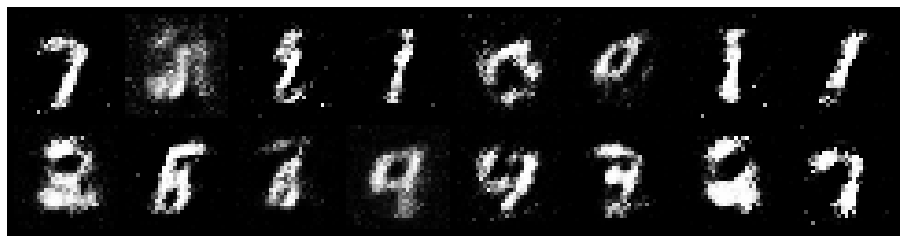

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 1.0580, Generator Loss: 1.7382
D(x): 0.6627, D(G(z)): 0.2424


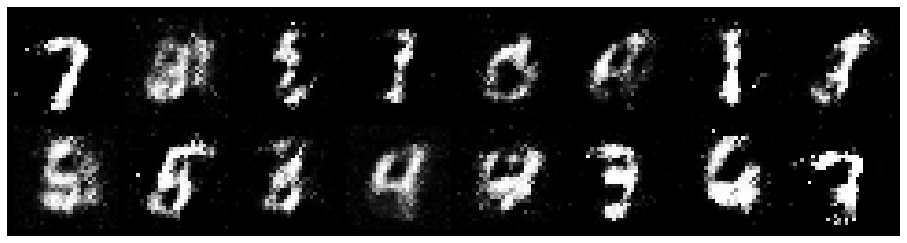

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.6627, Generator Loss: 1.8444
D(x): 0.8167, D(G(z)): 0.2710


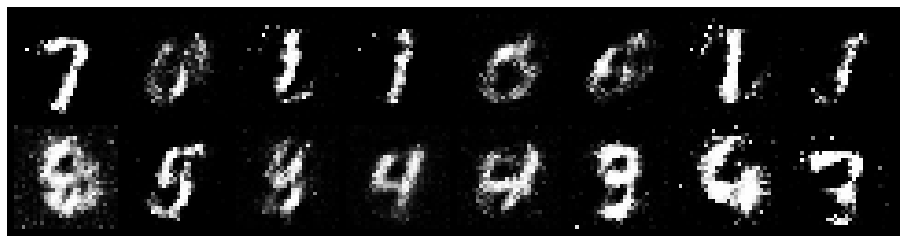

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.7309, Generator Loss: 1.8064
D(x): 0.7611, D(G(z)): 0.2405


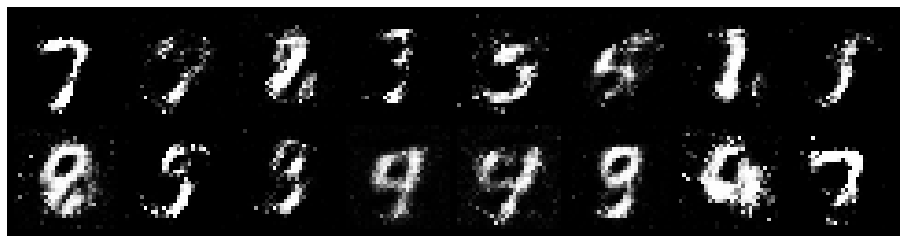

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.6428, Generator Loss: 1.7050
D(x): 0.7399, D(G(z)): 0.2114


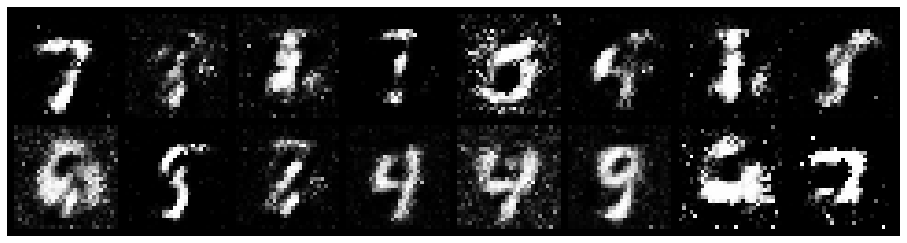

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.6815, Generator Loss: 1.7871
D(x): 0.8143, D(G(z)): 0.2867


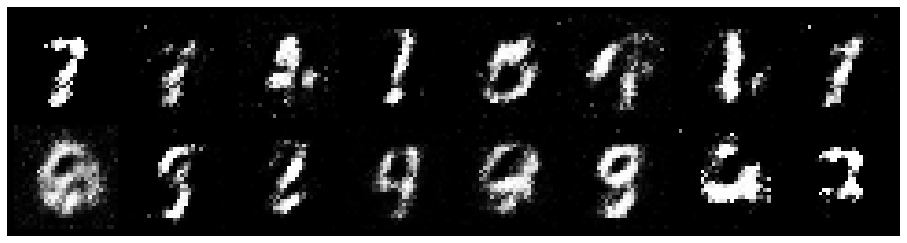

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.8379, Generator Loss: 1.4363
D(x): 0.7065, D(G(z)): 0.2882


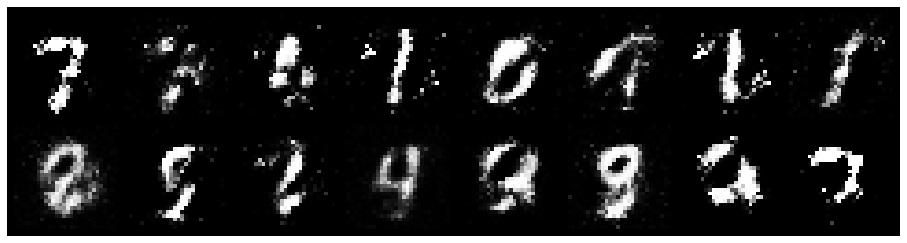

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.8812, Generator Loss: 1.8889
D(x): 0.7058, D(G(z)): 0.2529


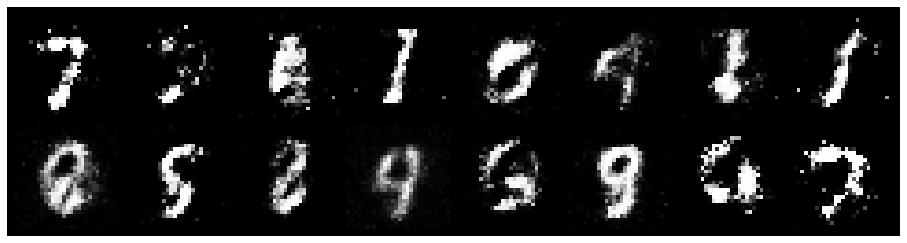

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.8139, Generator Loss: 1.3704
D(x): 0.7055, D(G(z)): 0.2612


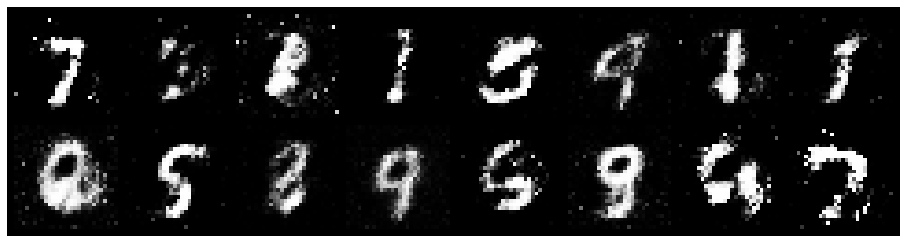

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.7436, Generator Loss: 1.9600
D(x): 0.7242, D(G(z)): 0.1863


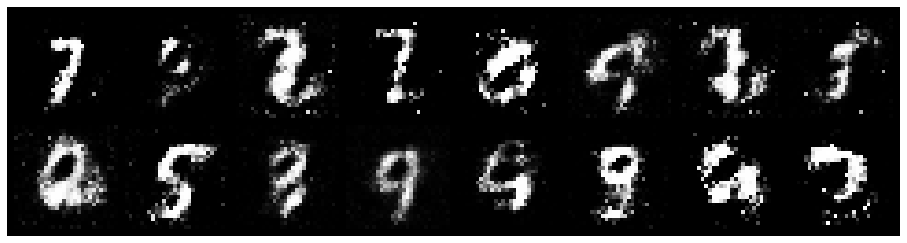

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.8114, Generator Loss: 1.9876
D(x): 0.7385, D(G(z)): 0.2775


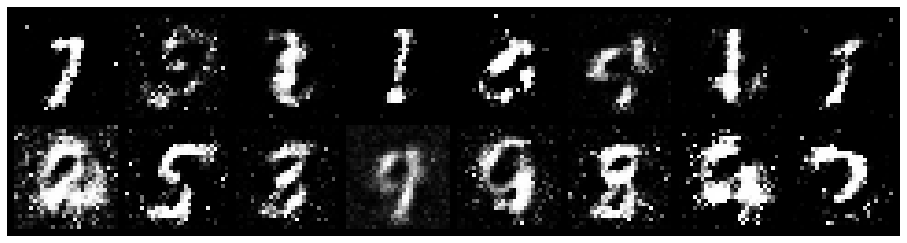

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 1.0194, Generator Loss: 1.6143
D(x): 0.6197, D(G(z)): 0.2635


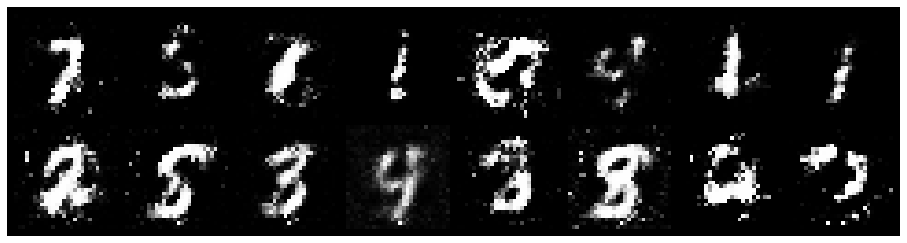

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.9037, Generator Loss: 1.5267
D(x): 0.7153, D(G(z)): 0.3163


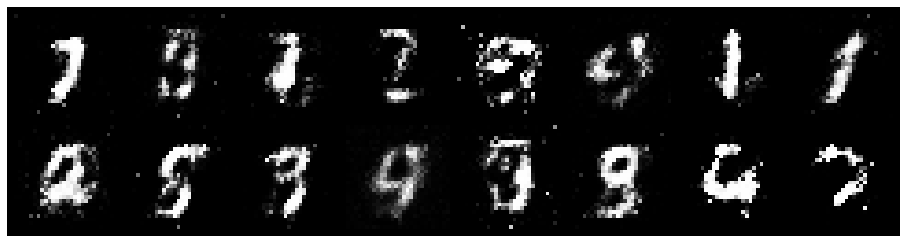

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.9245, Generator Loss: 1.4735
D(x): 0.7145, D(G(z)): 0.3438


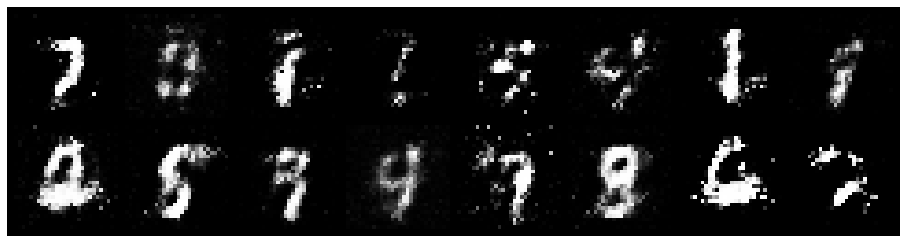

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.8384, Generator Loss: 1.5354
D(x): 0.7755, D(G(z)): 0.3302


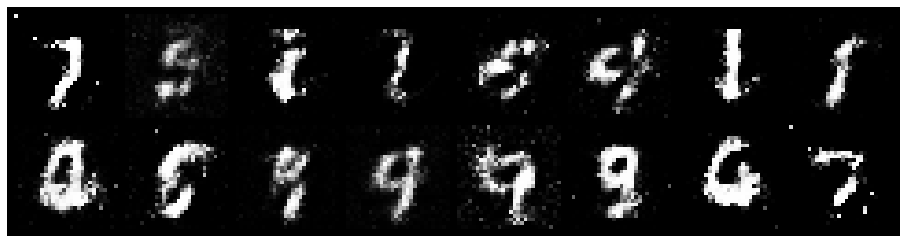

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 1.0084, Generator Loss: 1.5640
D(x): 0.6709, D(G(z)): 0.3105


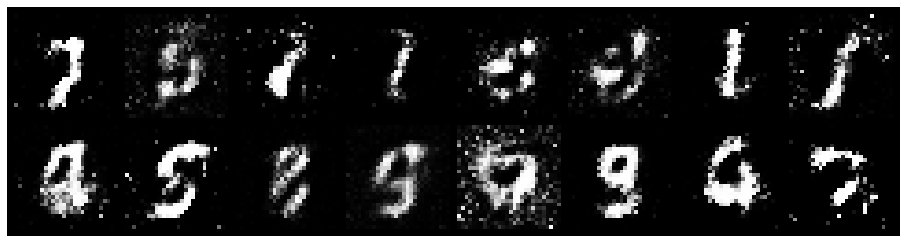

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 1.0774, Generator Loss: 1.6410
D(x): 0.6619, D(G(z)): 0.3141


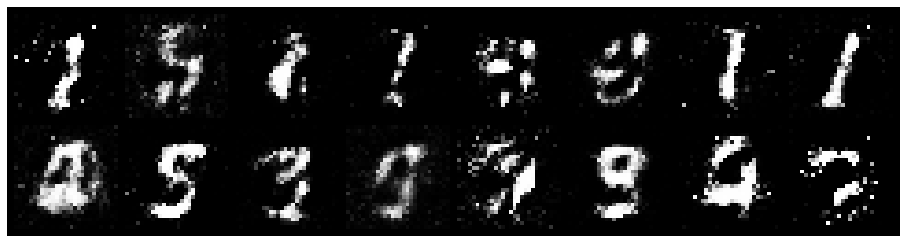

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.7271, Generator Loss: 1.6118
D(x): 0.7413, D(G(z)): 0.2727


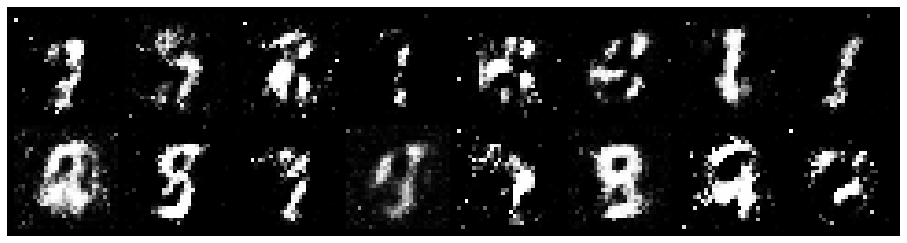

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.8052, Generator Loss: 1.6705
D(x): 0.7530, D(G(z)): 0.3096


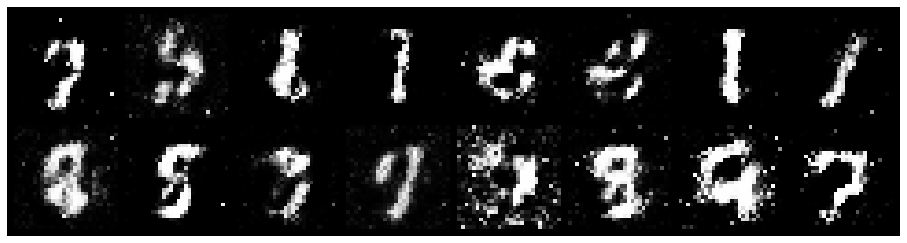

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.8287, Generator Loss: 1.7197
D(x): 0.7184, D(G(z)): 0.2379


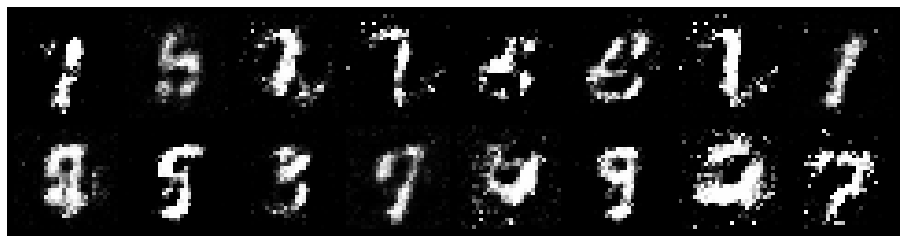

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.9183, Generator Loss: 1.9489
D(x): 0.7083, D(G(z)): 0.2742


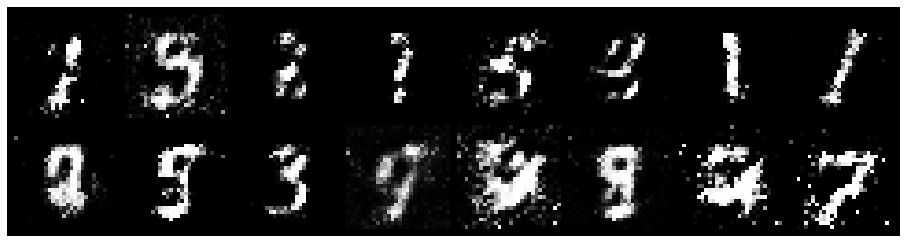

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.6323, Generator Loss: 1.9060
D(x): 0.7851, D(G(z)): 0.2481


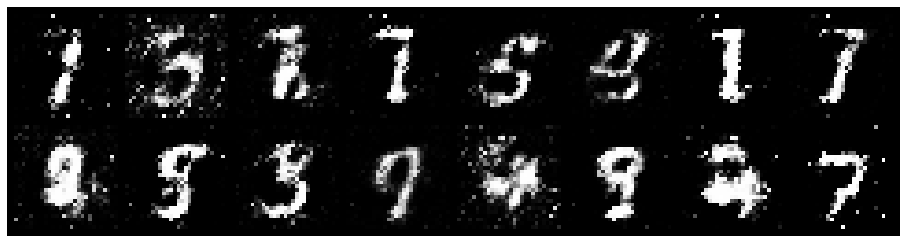

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.6760, Generator Loss: 1.5211
D(x): 0.7936, D(G(z)): 0.2655


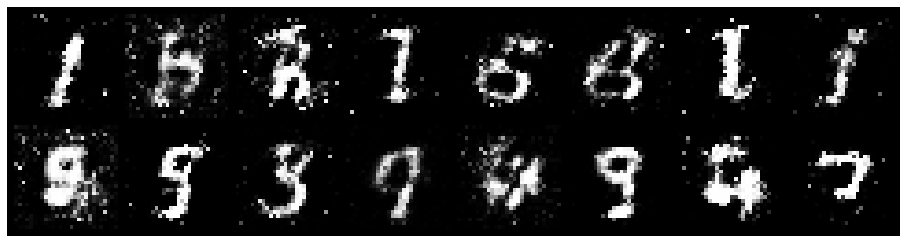

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 1.0268, Generator Loss: 1.4371
D(x): 0.6528, D(G(z)): 0.3437


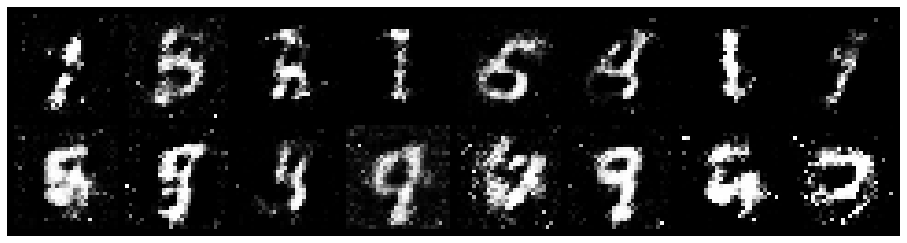

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.7836, Generator Loss: 1.8144
D(x): 0.6602, D(G(z)): 0.2010


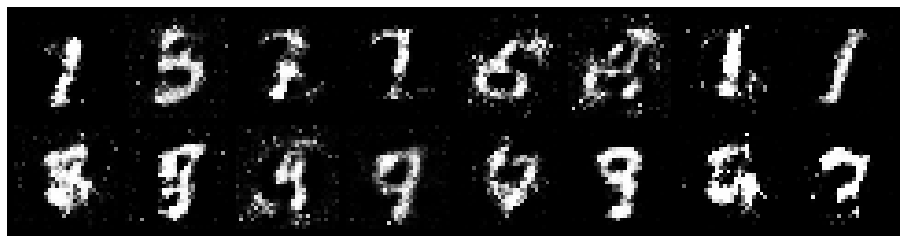

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.9218, Generator Loss: 1.6438
D(x): 0.6618, D(G(z)): 0.2663


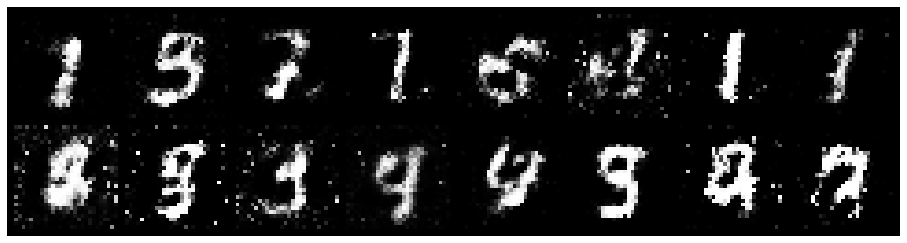

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.9283, Generator Loss: 1.5672
D(x): 0.7382, D(G(z)): 0.3143


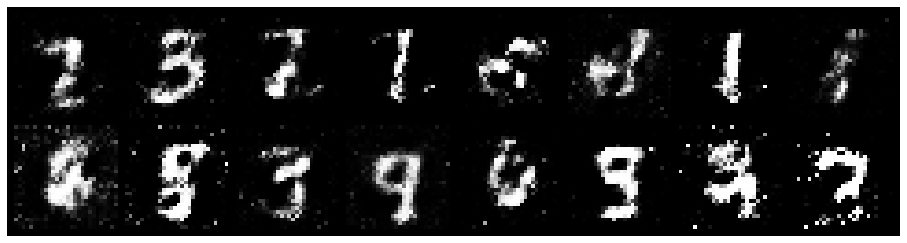

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.8501, Generator Loss: 1.8214
D(x): 0.6758, D(G(z)): 0.2103


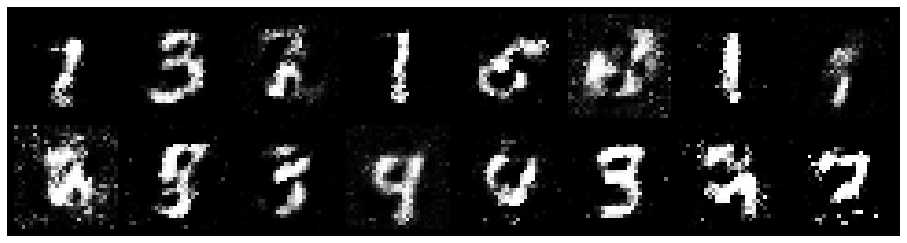

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 1.0354, Generator Loss: 1.7126
D(x): 0.7438, D(G(z)): 0.3575


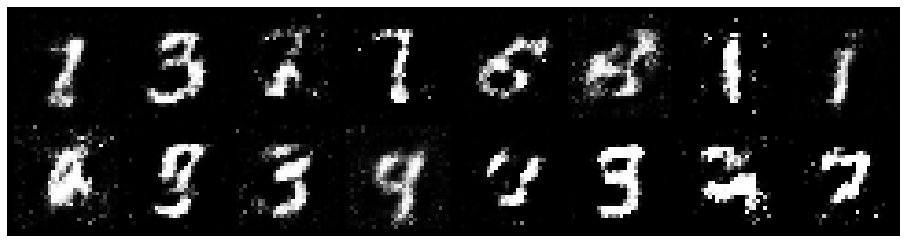

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.7844, Generator Loss: 1.6193
D(x): 0.7514, D(G(z)): 0.2827


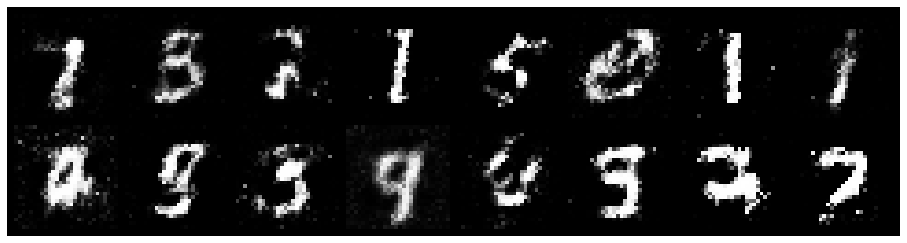

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.7334, Generator Loss: 1.7043
D(x): 0.7092, D(G(z)): 0.2367


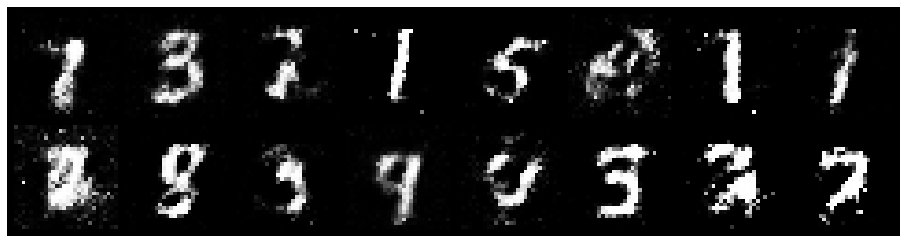

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.7618, Generator Loss: 2.1829
D(x): 0.7783, D(G(z)): 0.2743


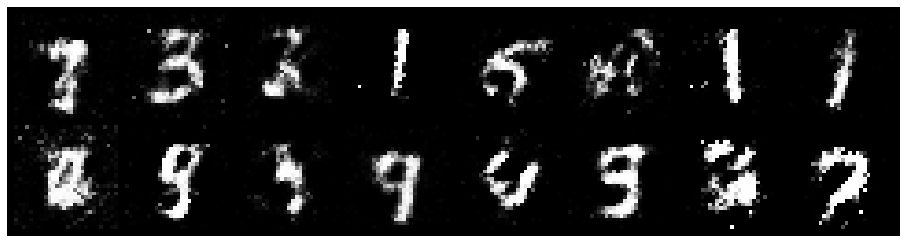

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.7361, Generator Loss: 2.0646
D(x): 0.7452, D(G(z)): 0.2439


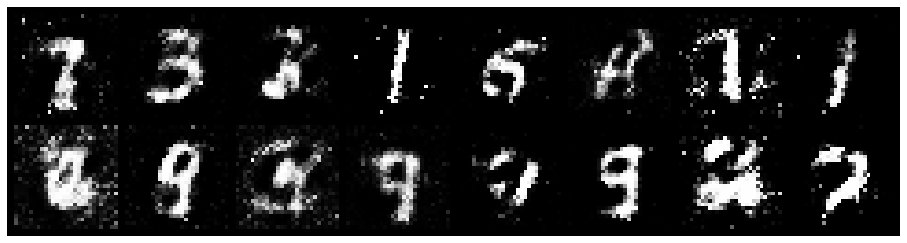

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.9015, Generator Loss: 1.6870
D(x): 0.7322, D(G(z)): 0.3098


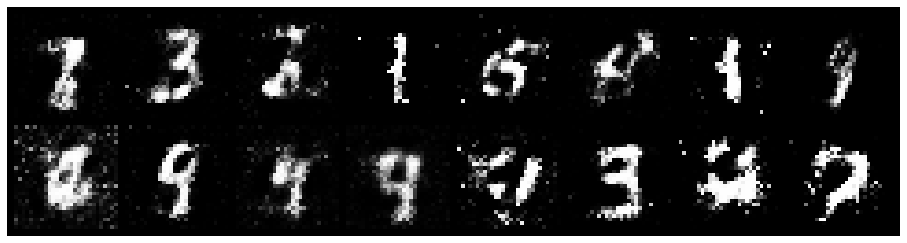

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.7240, Generator Loss: 1.9527
D(x): 0.8026, D(G(z)): 0.2901


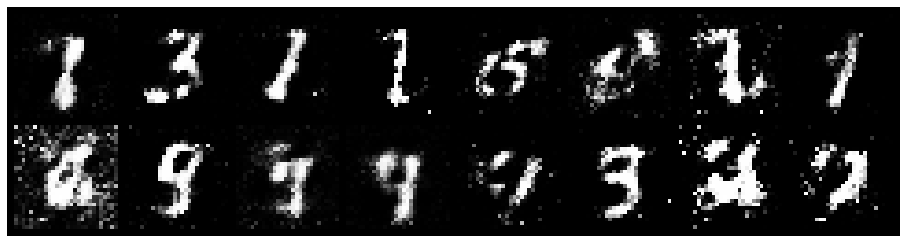

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.8693, Generator Loss: 1.9421
D(x): 0.6477, D(G(z)): 0.1968


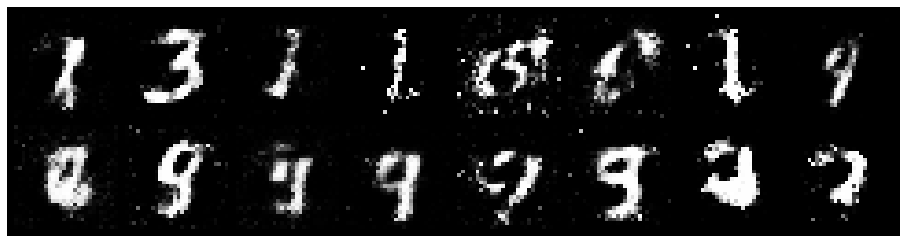

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.8937, Generator Loss: 1.3022
D(x): 0.7319, D(G(z)): 0.3387


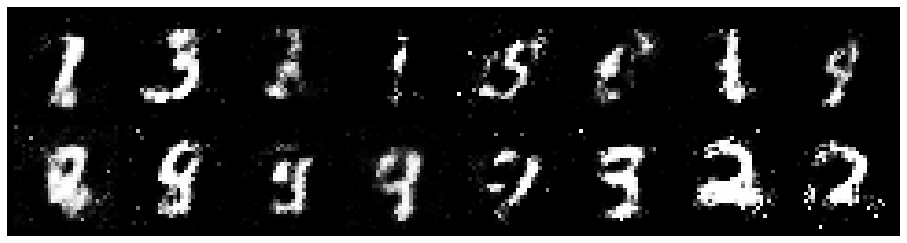

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.9983, Generator Loss: 1.8025
D(x): 0.7250, D(G(z)): 0.3238


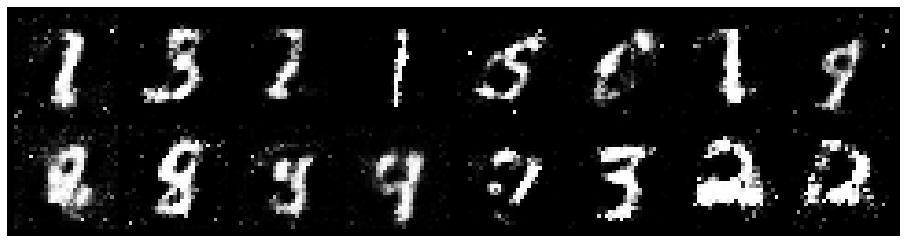

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.7789, Generator Loss: 1.7458
D(x): 0.7638, D(G(z)): 0.3025


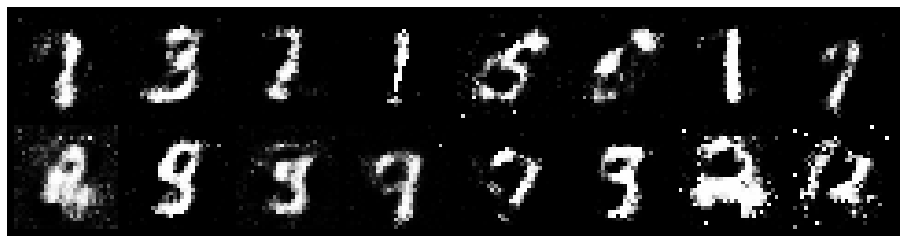

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 0.7061, Generator Loss: 2.1795
D(x): 0.7444, D(G(z)): 0.2161


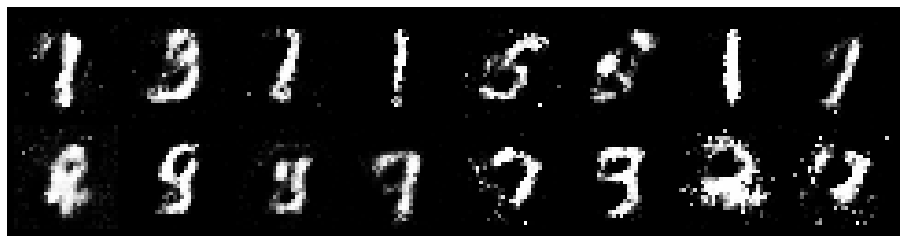

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.7992, Generator Loss: 1.7872
D(x): 0.8116, D(G(z)): 0.3232


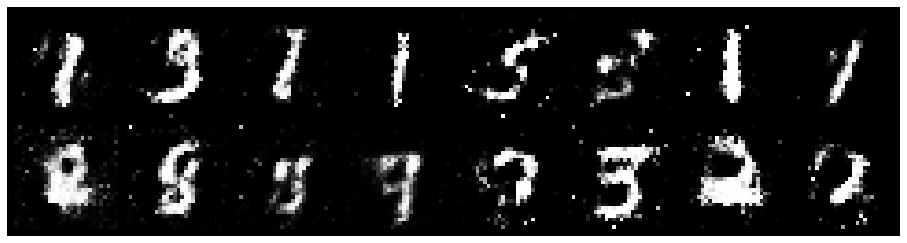

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.8963, Generator Loss: 1.2653
D(x): 0.7410, D(G(z)): 0.3317


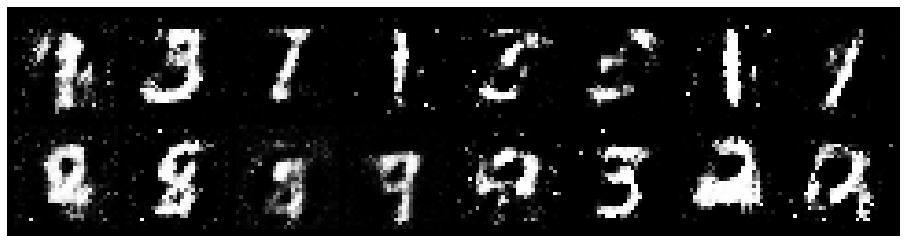

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.7299, Generator Loss: 2.3974
D(x): 0.6834, D(G(z)): 0.1829


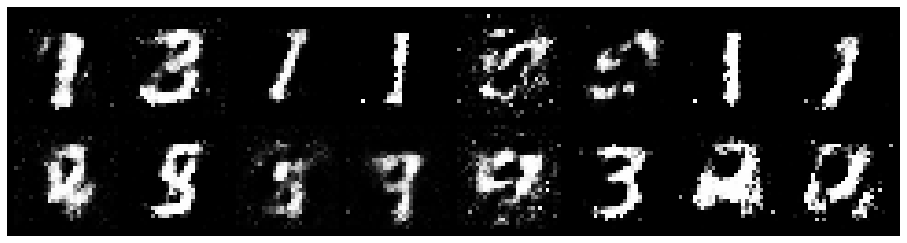

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.8850, Generator Loss: 2.4763
D(x): 0.7152, D(G(z)): 0.2680


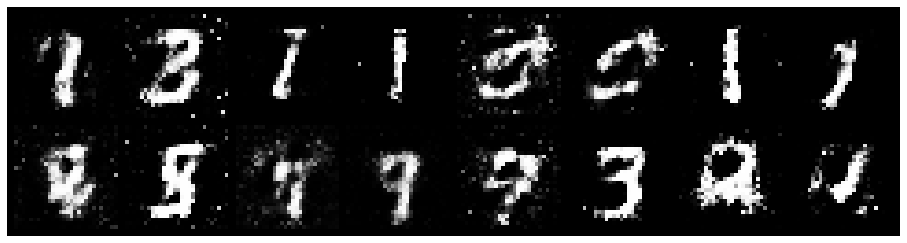

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.7905, Generator Loss: 1.5857
D(x): 0.7915, D(G(z)): 0.3195


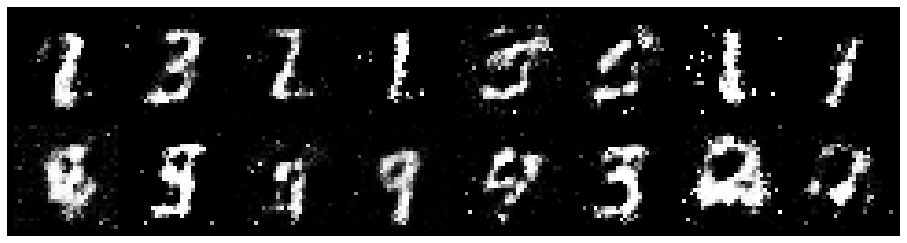

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.8033, Generator Loss: 1.5163
D(x): 0.7856, D(G(z)): 0.3327


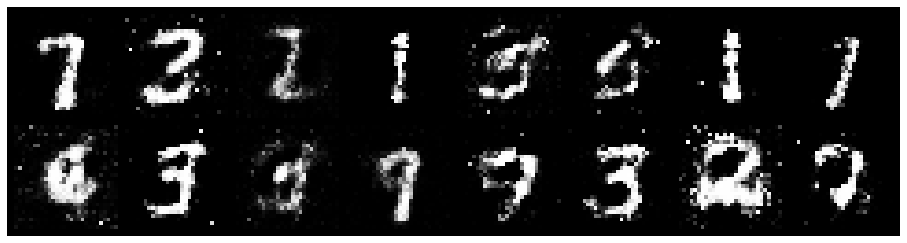

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.7727, Generator Loss: 1.4213
D(x): 0.6965, D(G(z)): 0.2393


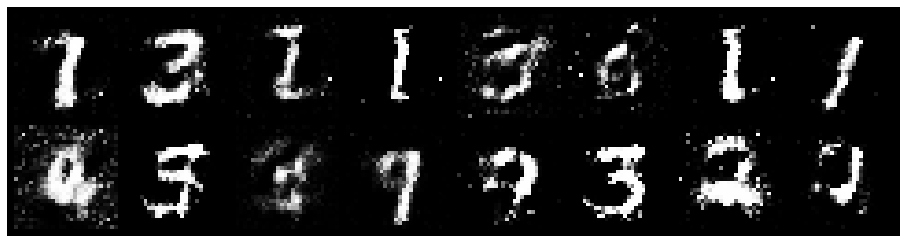

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 1.0126, Generator Loss: 1.6478
D(x): 0.6664, D(G(z)): 0.3212


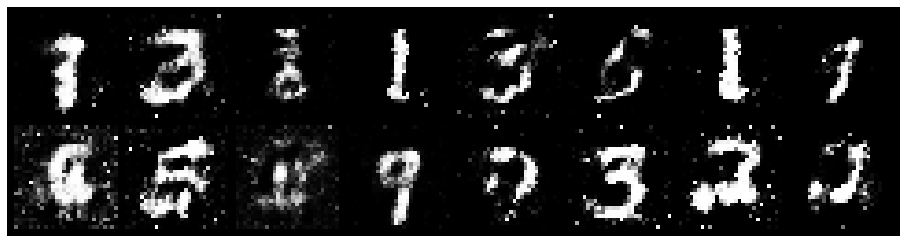

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.9626, Generator Loss: 1.5332
D(x): 0.6370, D(G(z)): 0.3039


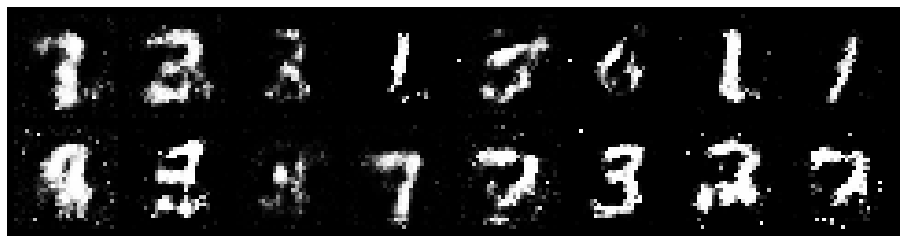

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.9352, Generator Loss: 1.7842
D(x): 0.6855, D(G(z)): 0.2781


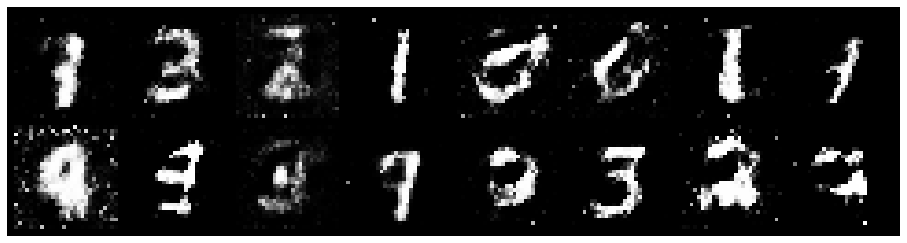

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.8444, Generator Loss: 1.3457
D(x): 0.7815, D(G(z)): 0.3453


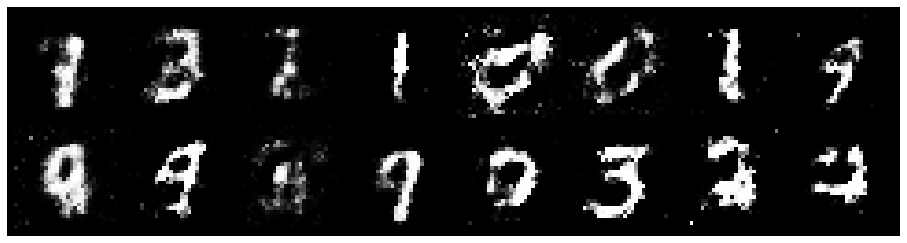

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.9706, Generator Loss: 1.4806
D(x): 0.6956, D(G(z)): 0.3120


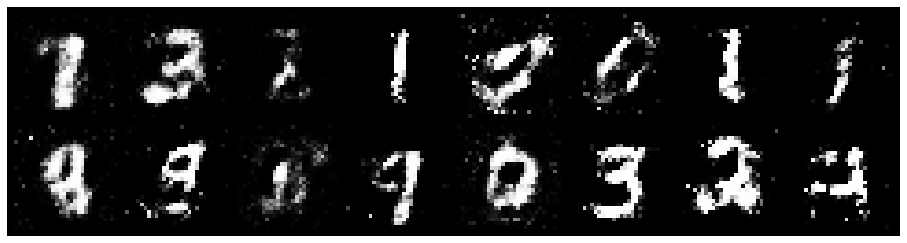

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 1.0889, Generator Loss: 1.1400
D(x): 0.7585, D(G(z)): 0.4224


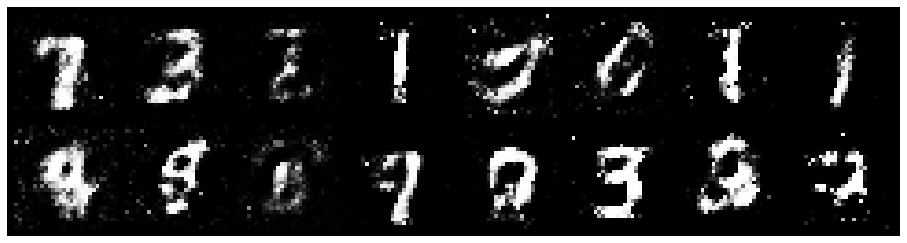

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.8150, Generator Loss: 1.1897
D(x): 0.7054, D(G(z)): 0.2867


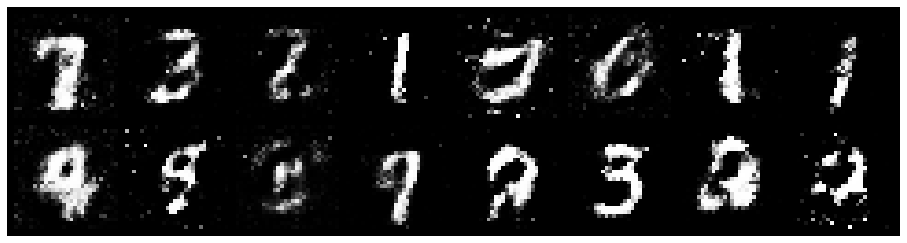

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.6964, Generator Loss: 1.9508
D(x): 0.7382, D(G(z)): 0.2344


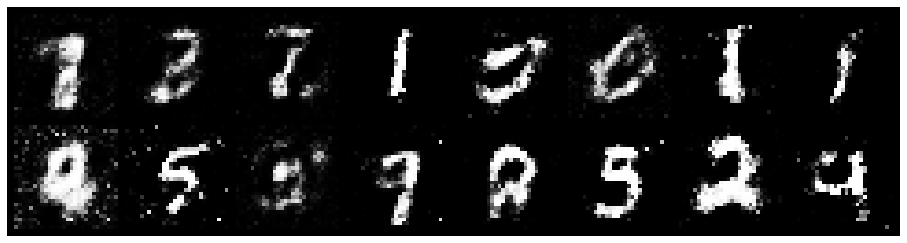

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.8851, Generator Loss: 1.6621
D(x): 0.7749, D(G(z)): 0.3604


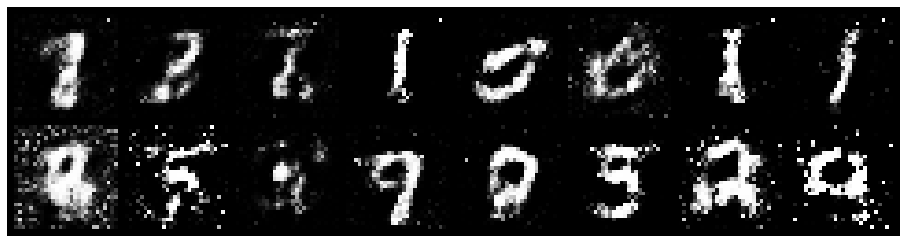

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.8813, Generator Loss: 1.3499
D(x): 0.7317, D(G(z)): 0.3387


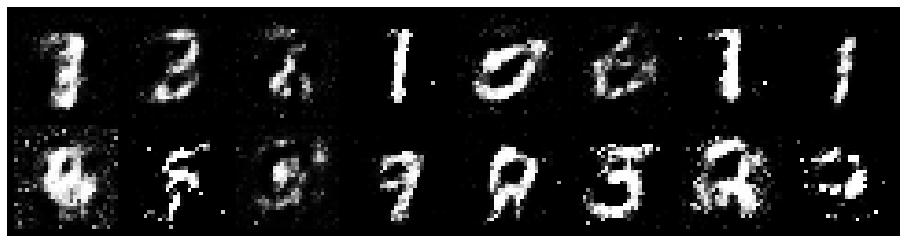

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 1.0210, Generator Loss: 1.6127
D(x): 0.6681, D(G(z)): 0.3391


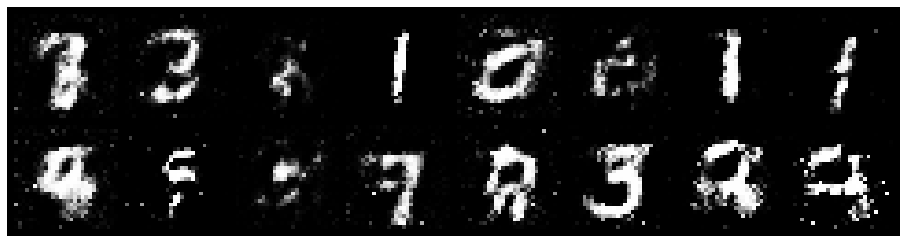

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 0.9267, Generator Loss: 1.6200
D(x): 0.7187, D(G(z)): 0.3436


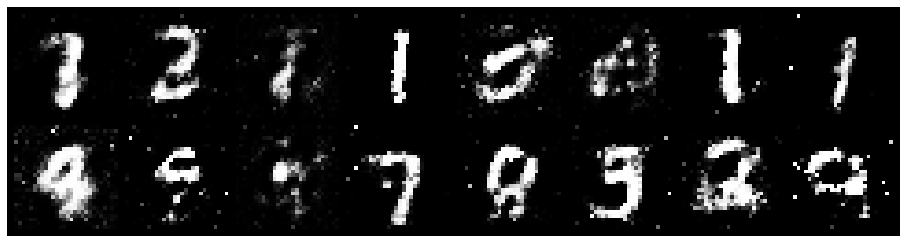

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 0.8708, Generator Loss: 1.7913
D(x): 0.6687, D(G(z)): 0.2369


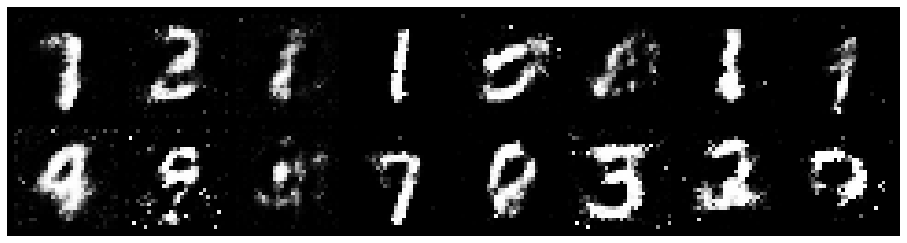

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 1.0986, Generator Loss: 1.1489
D(x): 0.7431, D(G(z)): 0.4434


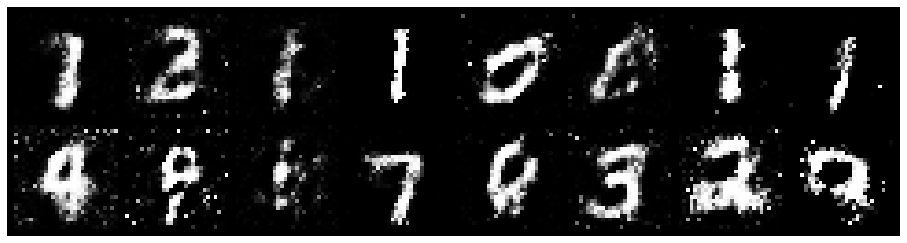

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 0.9017, Generator Loss: 1.4410
D(x): 0.6621, D(G(z)): 0.2940


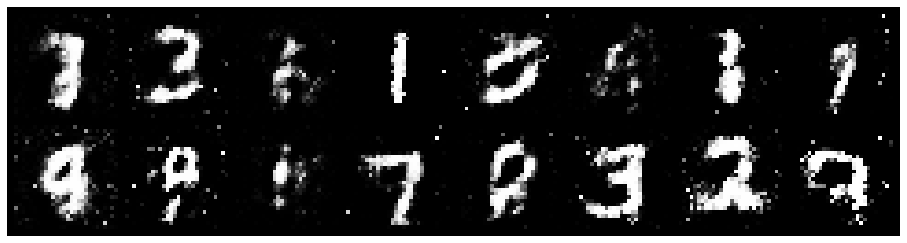

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 0.8156, Generator Loss: 2.0999
D(x): 0.7252, D(G(z)): 0.2312


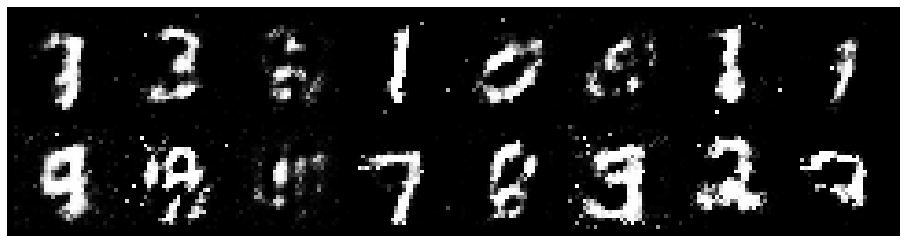

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.8008, Generator Loss: 1.2203
D(x): 0.7558, D(G(z)): 0.3164


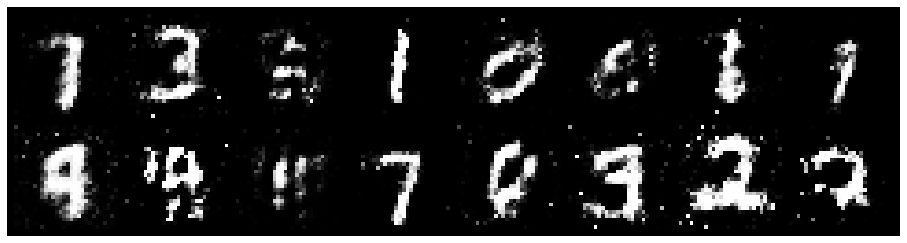

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.7495, Generator Loss: 2.1131
D(x): 0.7252, D(G(z)): 0.2378


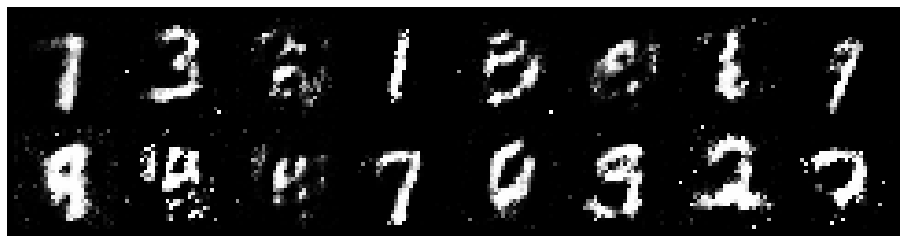

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 1.1449, Generator Loss: 1.3975
D(x): 0.6833, D(G(z)): 0.3958


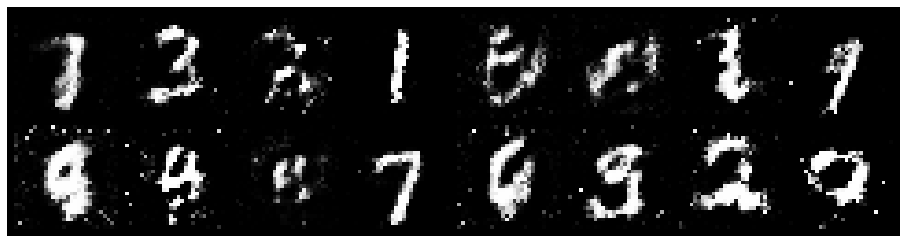

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 1.0227, Generator Loss: 1.3165
D(x): 0.6733, D(G(z)): 0.3475


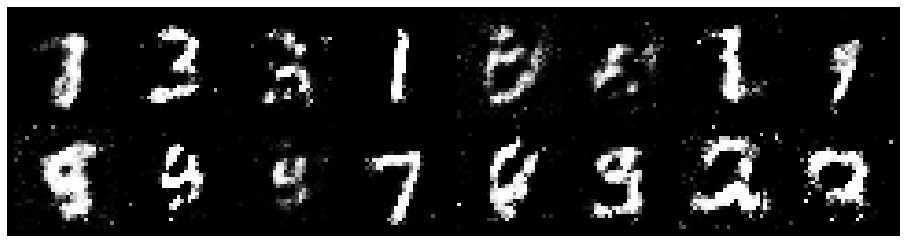

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 1.0513, Generator Loss: 1.5673
D(x): 0.6537, D(G(z)): 0.3359


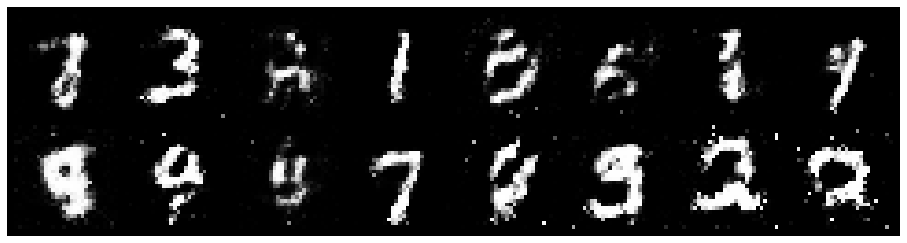

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.8304, Generator Loss: 1.6266
D(x): 0.7530, D(G(z)): 0.3101


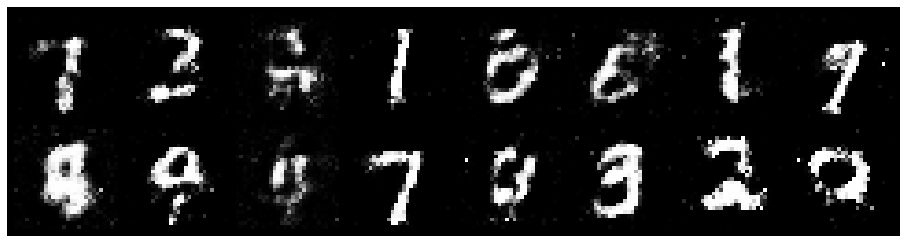

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.7934, Generator Loss: 1.8608
D(x): 0.7752, D(G(z)): 0.3216


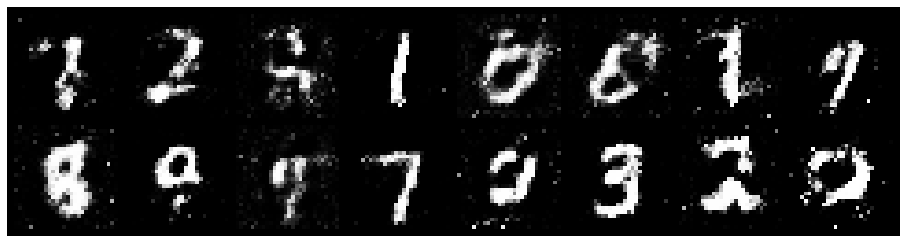

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.9421, Generator Loss: 1.5067
D(x): 0.6525, D(G(z)): 0.3036


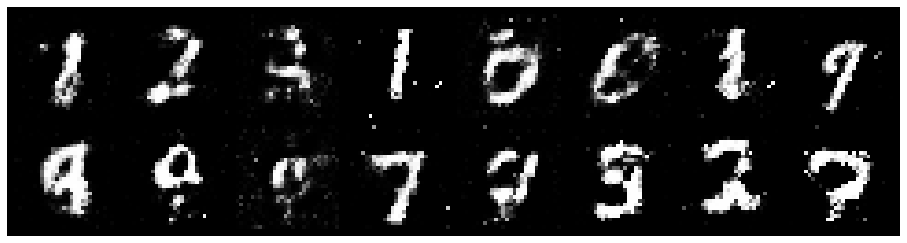

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.7920, Generator Loss: 1.3828
D(x): 0.7290, D(G(z)): 0.3103


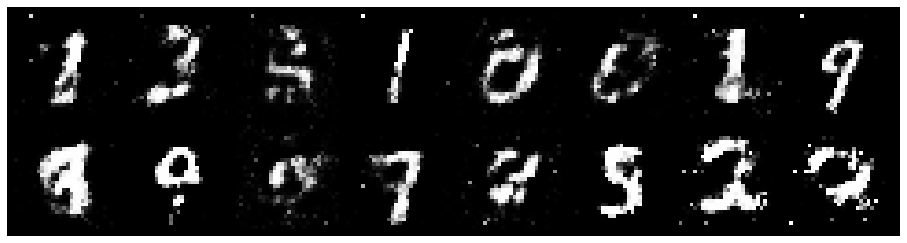

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.1151, Generator Loss: 1.2032
D(x): 0.6531, D(G(z)): 0.4049


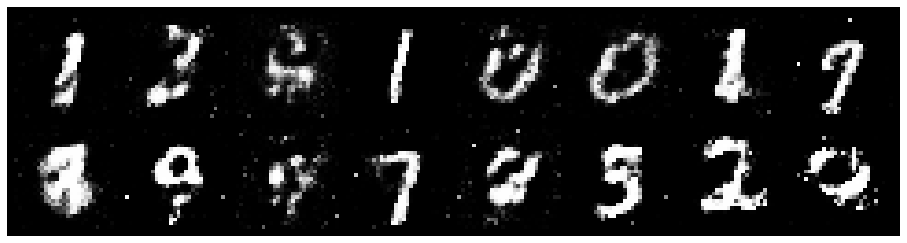

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 1.1355, Generator Loss: 1.3243
D(x): 0.6324, D(G(z)): 0.3577


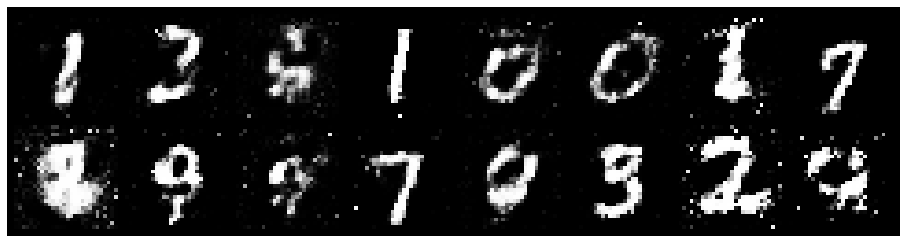

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 0.9835, Generator Loss: 1.3159
D(x): 0.7056, D(G(z)): 0.3242


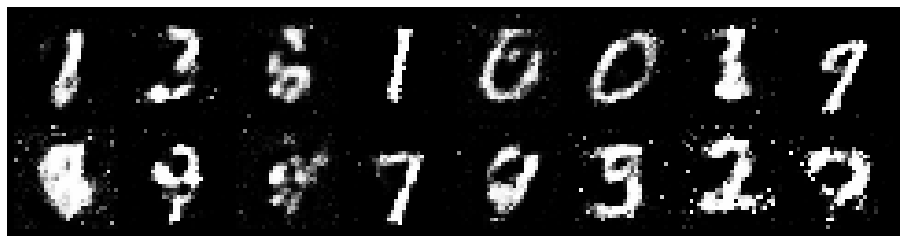

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 1.0291, Generator Loss: 1.4503
D(x): 0.6341, D(G(z)): 0.3083


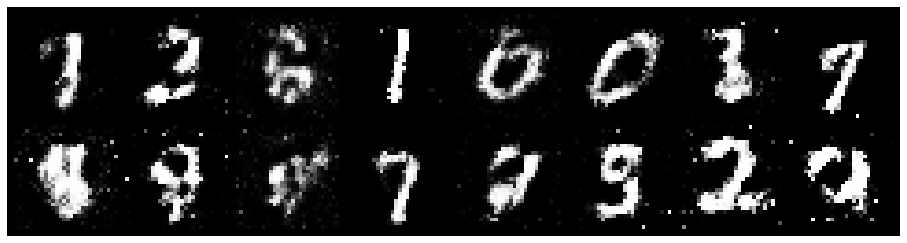

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 1.1442, Generator Loss: 1.4478
D(x): 0.7223, D(G(z)): 0.3865


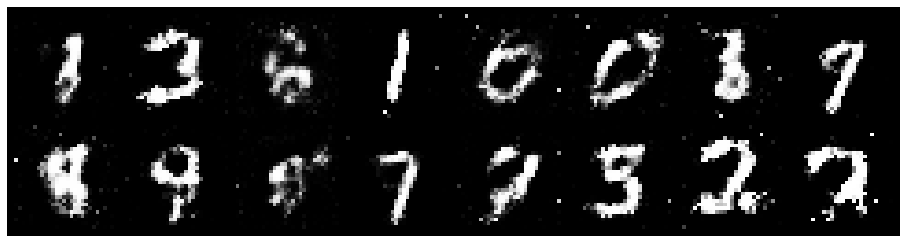

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 0.9973, Generator Loss: 2.2022
D(x): 0.6622, D(G(z)): 0.2858


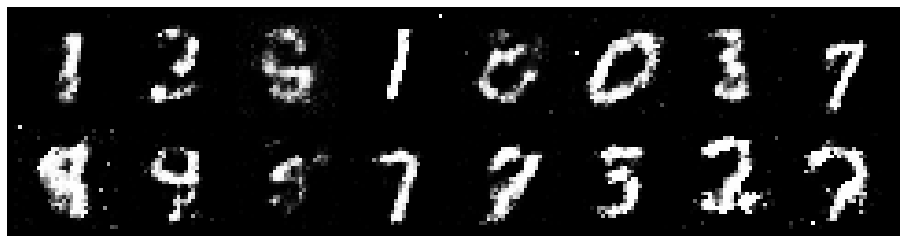

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.9850, Generator Loss: 1.3617
D(x): 0.6490, D(G(z)): 0.3175


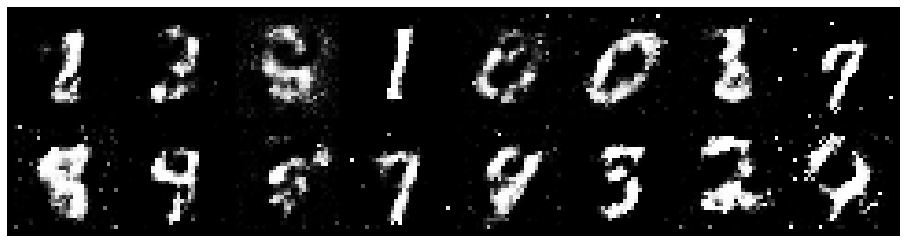

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 0.9839, Generator Loss: 2.0675
D(x): 0.7139, D(G(z)): 0.3256


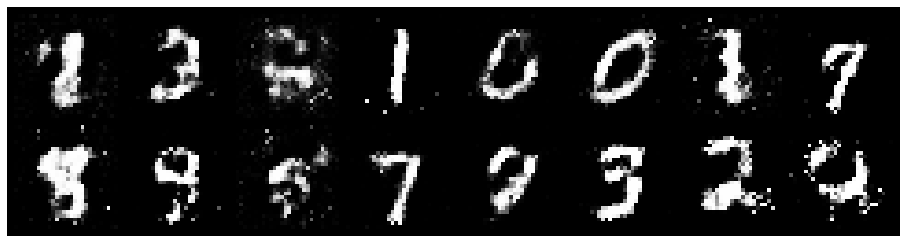

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 1.0231, Generator Loss: 1.6226
D(x): 0.6553, D(G(z)): 0.3052


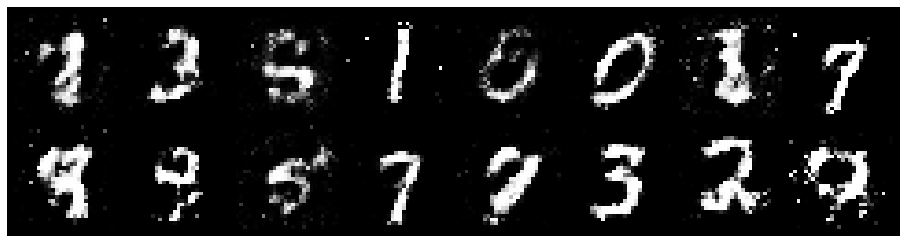

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 0.8852, Generator Loss: 1.5041
D(x): 0.6975, D(G(z)): 0.3264


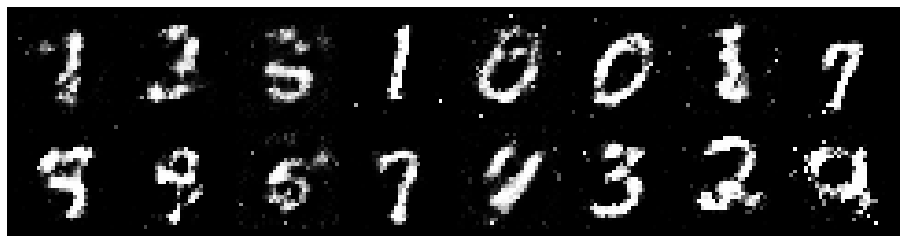

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.9004, Generator Loss: 1.8522
D(x): 0.6543, D(G(z)): 0.2629


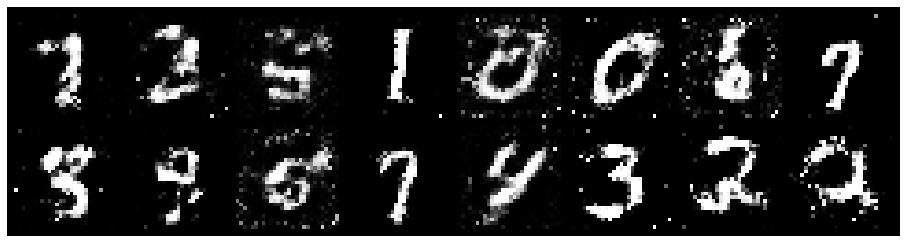

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.9856, Generator Loss: 1.3996
D(x): 0.6212, D(G(z)): 0.2676


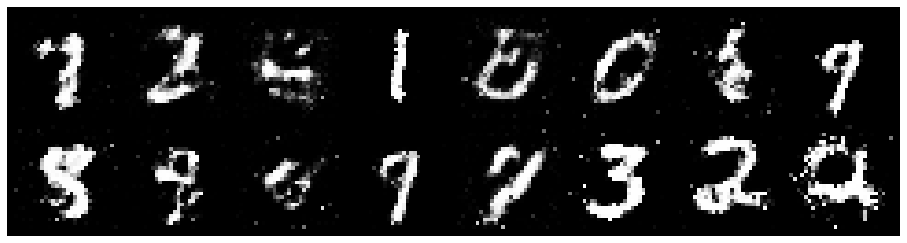

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 0.8255, Generator Loss: 1.7230
D(x): 0.6870, D(G(z)): 0.2675


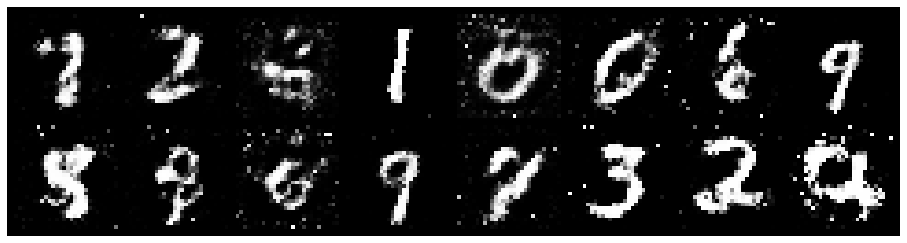

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 0.8864, Generator Loss: 1.4108
D(x): 0.6749, D(G(z)): 0.2985


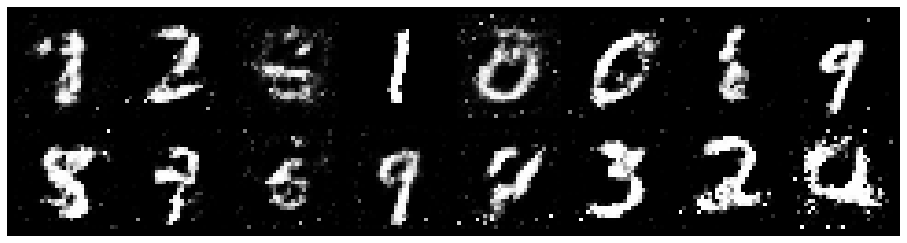

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 1.0025, Generator Loss: 1.6855
D(x): 0.6228, D(G(z)): 0.2993


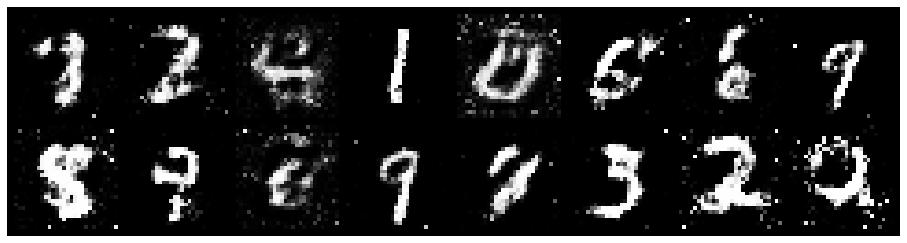

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.8633, Generator Loss: 1.5118
D(x): 0.7550, D(G(z)): 0.3308


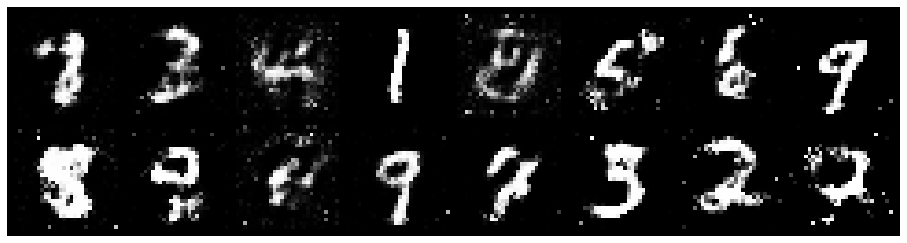

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 0.9660, Generator Loss: 1.7385
D(x): 0.6364, D(G(z)): 0.2743


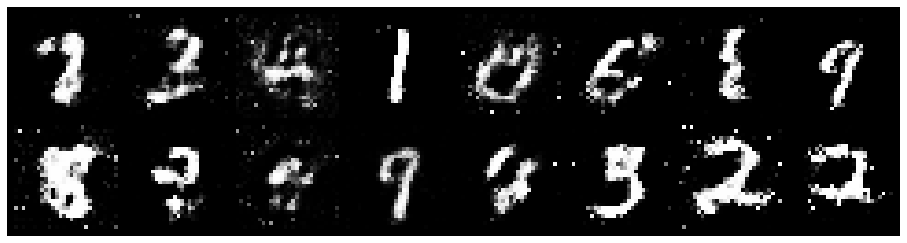

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 1.0235, Generator Loss: 1.2895
D(x): 0.6409, D(G(z)): 0.3304


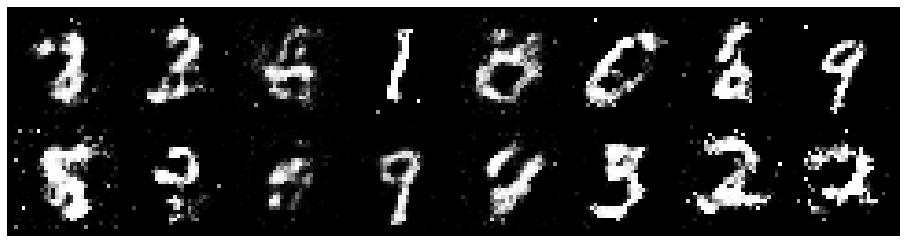

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 1.0221, Generator Loss: 1.2715
D(x): 0.6074, D(G(z)): 0.3309


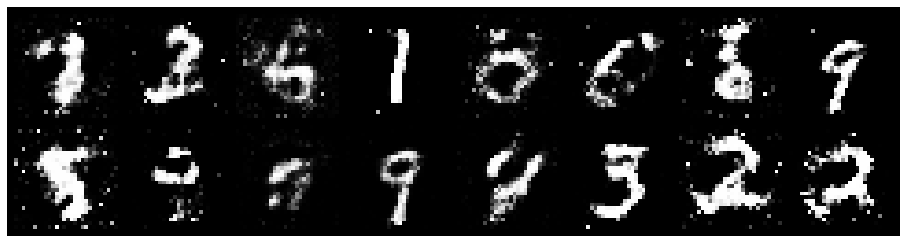

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.0325, Generator Loss: 1.7032
D(x): 0.6412, D(G(z)): 0.3360


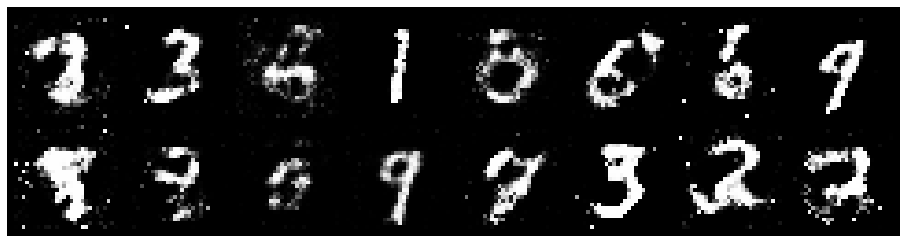

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 1.0739, Generator Loss: 1.1297
D(x): 0.6628, D(G(z)): 0.3688


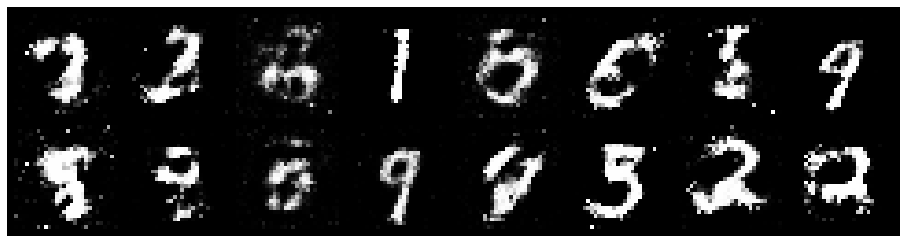

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 0.8573, Generator Loss: 1.4447
D(x): 0.7189, D(G(z)): 0.3363


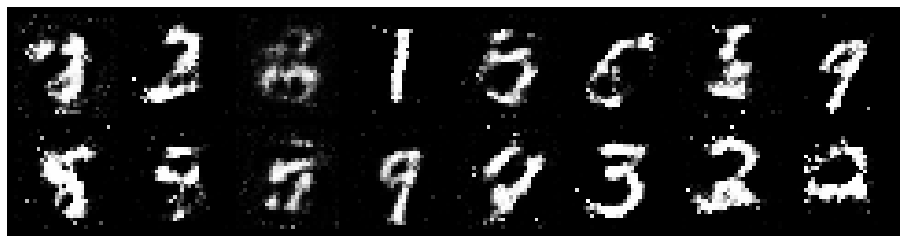

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 0.8623, Generator Loss: 1.5189
D(x): 0.7083, D(G(z)): 0.2977


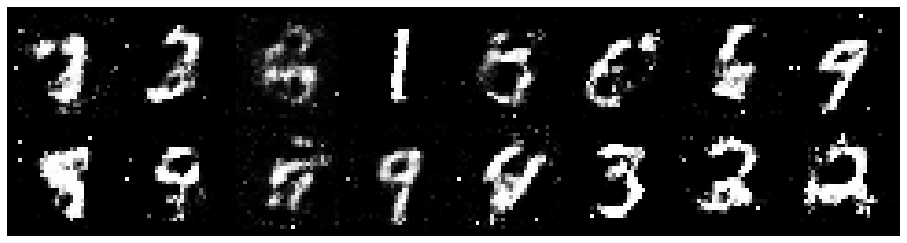

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.8967, Generator Loss: 1.8419
D(x): 0.7004, D(G(z)): 0.3097


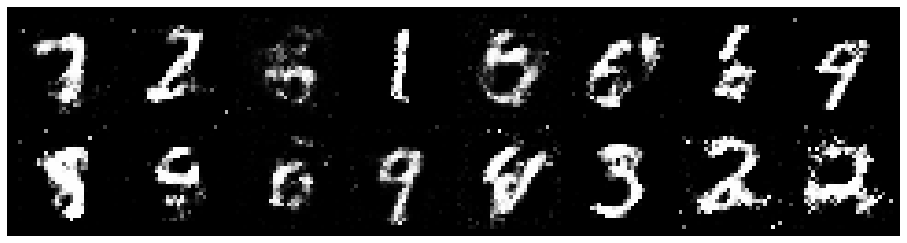

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 0.9232, Generator Loss: 1.4400
D(x): 0.6258, D(G(z)): 0.2454


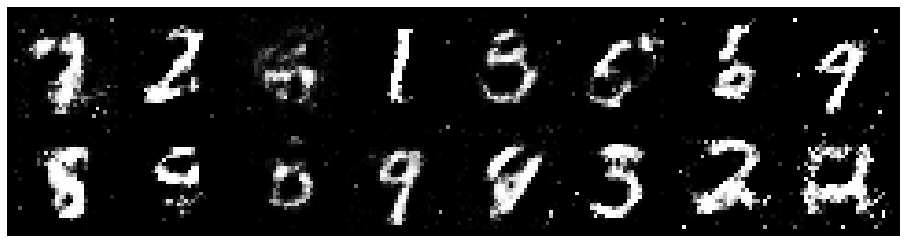

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 1.0061, Generator Loss: 1.5288
D(x): 0.6329, D(G(z)): 0.3204


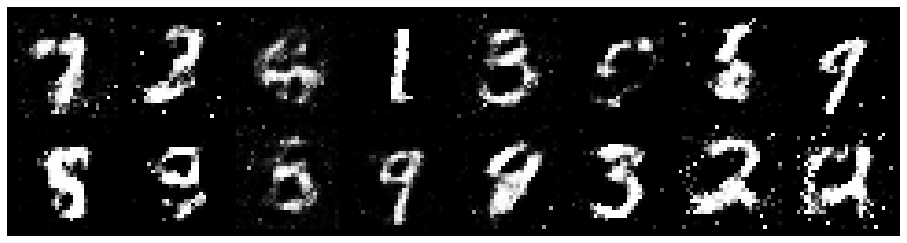

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 1.0806, Generator Loss: 1.1550
D(x): 0.6445, D(G(z)): 0.3796


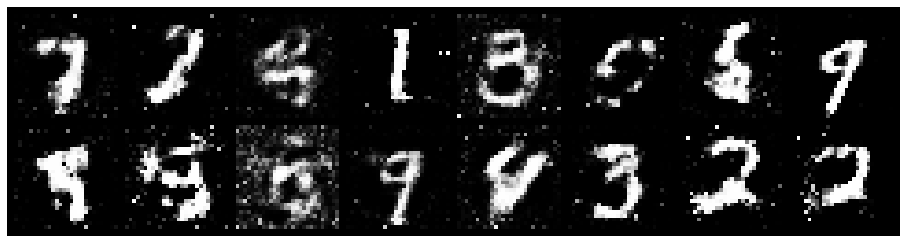

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 1.2004, Generator Loss: 1.0799
D(x): 0.5971, D(G(z)): 0.4064


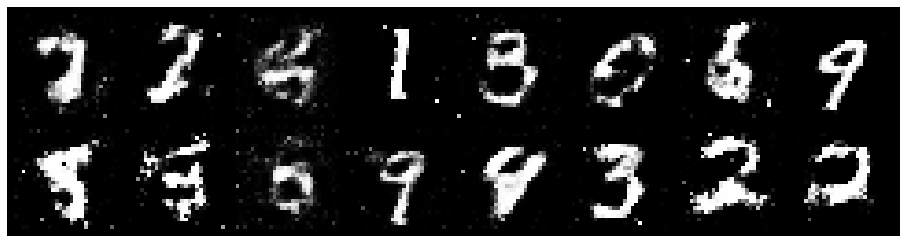

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.0741, Generator Loss: 1.2626
D(x): 0.6121, D(G(z)): 0.3326


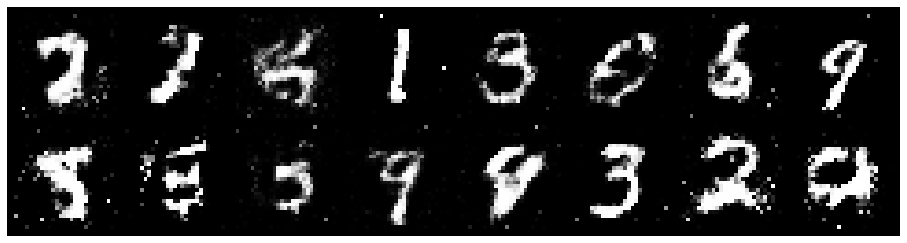

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.2162, Generator Loss: 1.2422
D(x): 0.5600, D(G(z)): 0.3203


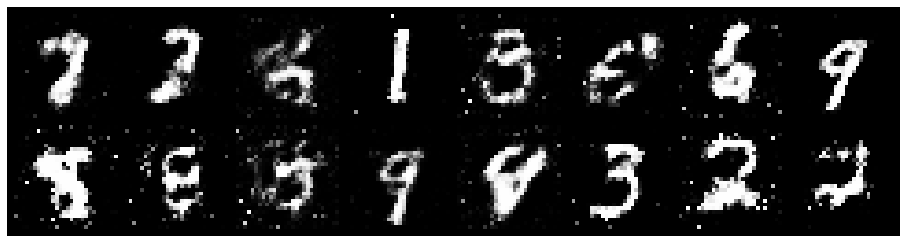

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 1.1802, Generator Loss: 1.2054
D(x): 0.5777, D(G(z)): 0.3517


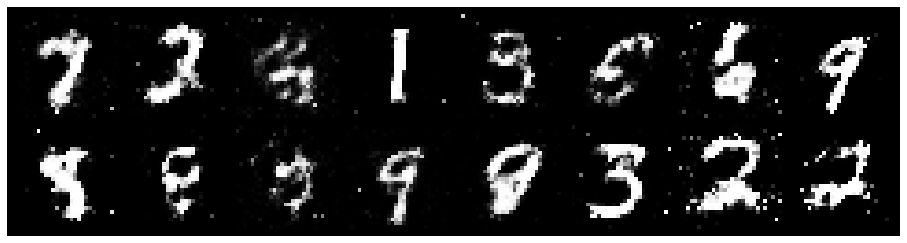

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.0144, Generator Loss: 1.1441
D(x): 0.6720, D(G(z)): 0.3651


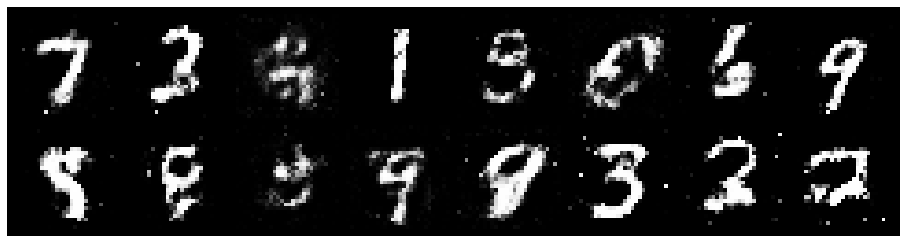

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 0.9549, Generator Loss: 1.3995
D(x): 0.6836, D(G(z)): 0.3164


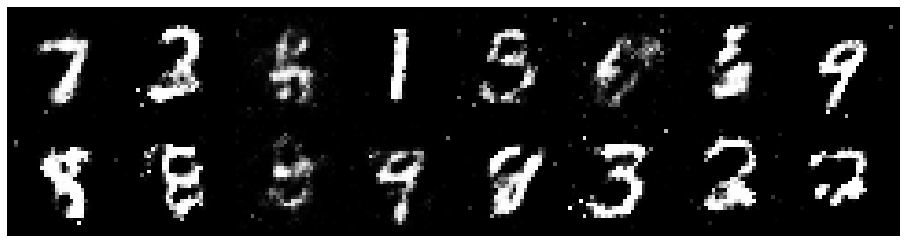

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.0081, Generator Loss: 1.3464
D(x): 0.6717, D(G(z)): 0.3187


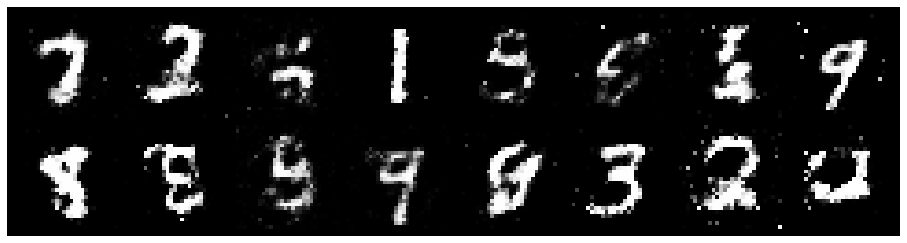

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.2922, Generator Loss: 1.1064
D(x): 0.6261, D(G(z)): 0.4265


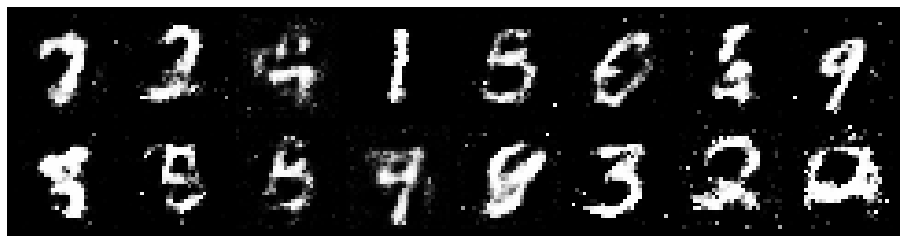

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.3187, Generator Loss: 1.0090
D(x): 0.5553, D(G(z)): 0.3800


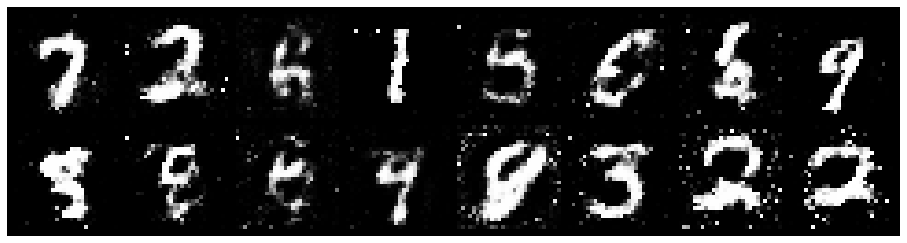

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.0352, Generator Loss: 1.1486
D(x): 0.6816, D(G(z)): 0.3958


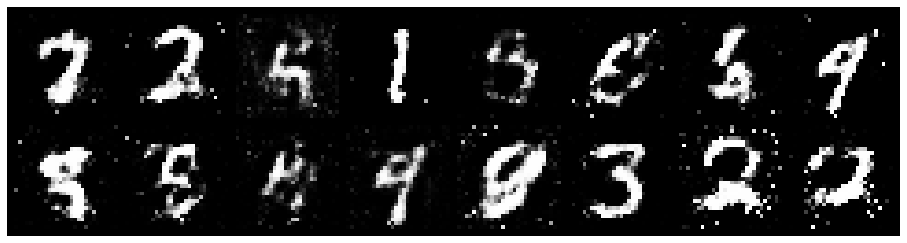

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.1008, Generator Loss: 1.3452
D(x): 0.6157, D(G(z)): 0.3363


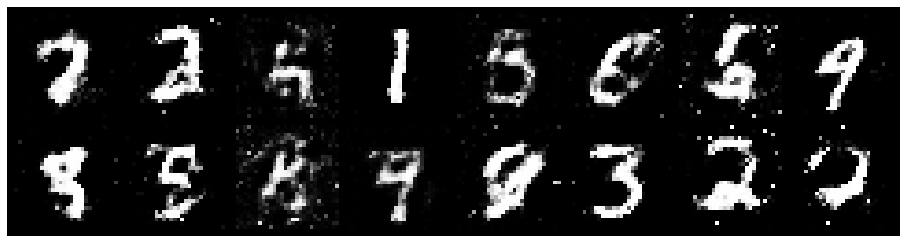

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.1573, Generator Loss: 1.1257
D(x): 0.5549, D(G(z)): 0.3222


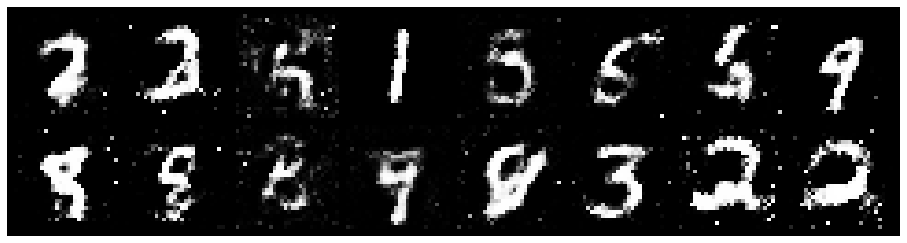

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.2055, Generator Loss: 1.1652
D(x): 0.5429, D(G(z)): 0.3406


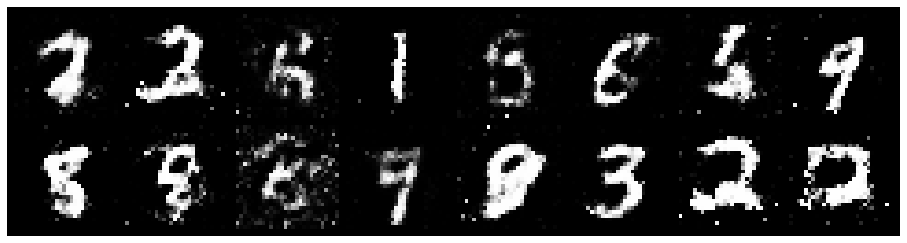

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.0177, Generator Loss: 1.2457
D(x): 0.6619, D(G(z)): 0.3561


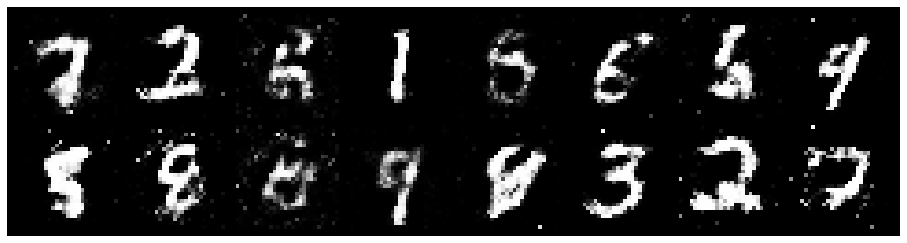

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 0.9274, Generator Loss: 1.1683
D(x): 0.7249, D(G(z)): 0.3512


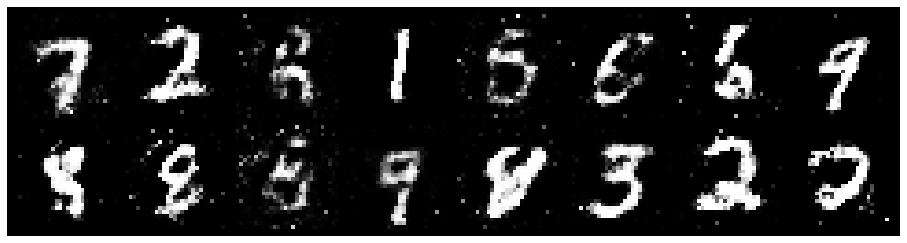

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 0.9735, Generator Loss: 1.3822
D(x): 0.6750, D(G(z)): 0.3418


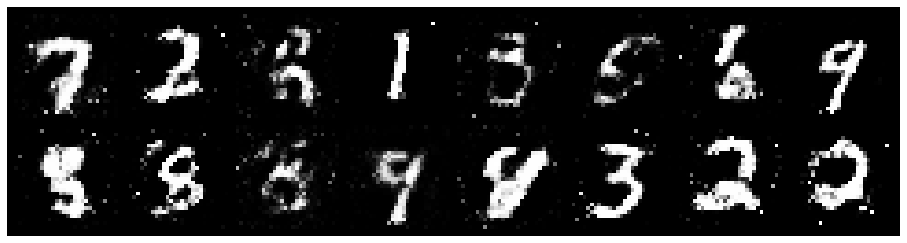

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 0.9880, Generator Loss: 1.3918
D(x): 0.7509, D(G(z)): 0.3903


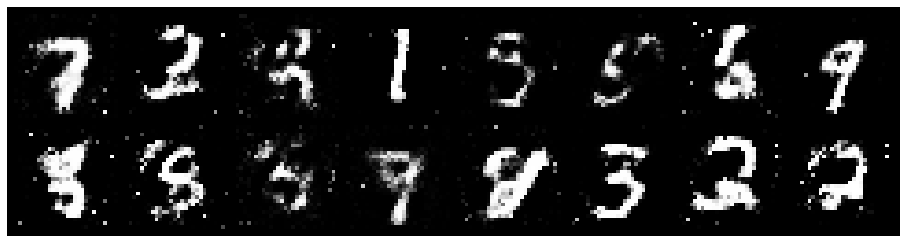

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.0481, Generator Loss: 1.2576
D(x): 0.6436, D(G(z)): 0.3323


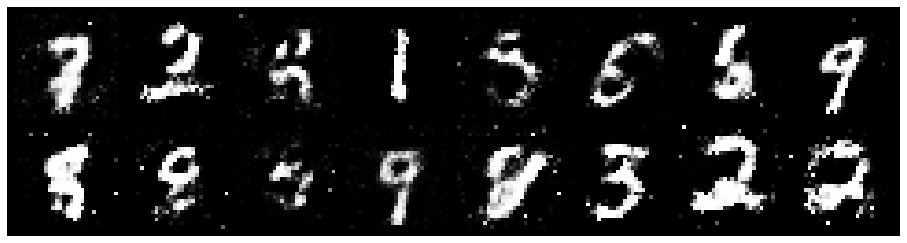

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.1111, Generator Loss: 1.1344
D(x): 0.5861, D(G(z)): 0.3323


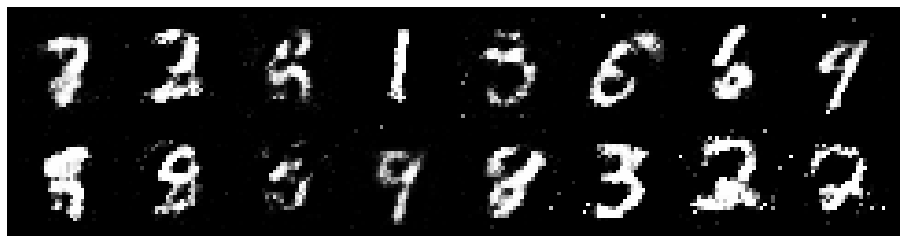

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.0954, Generator Loss: 1.1262
D(x): 0.7029, D(G(z)): 0.4228


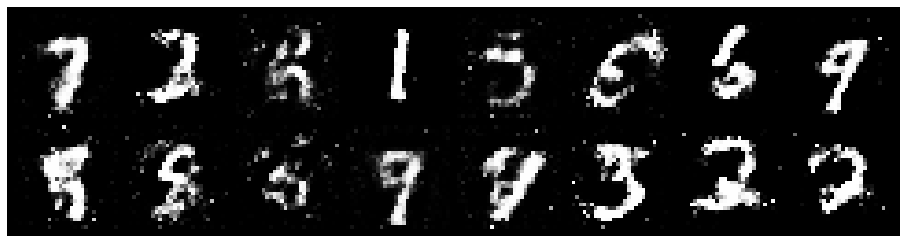

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.0335, Generator Loss: 1.2707
D(x): 0.6555, D(G(z)): 0.3786


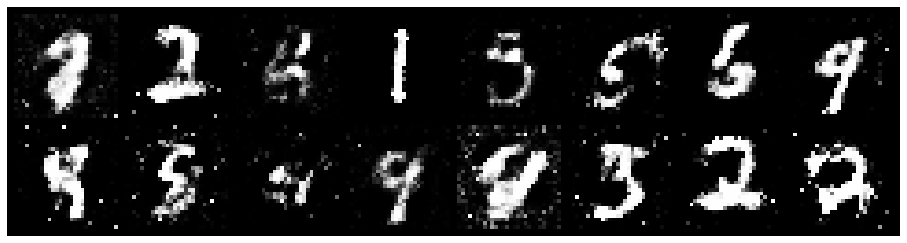

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.0062, Generator Loss: 1.1523
D(x): 0.6688, D(G(z)): 0.3623


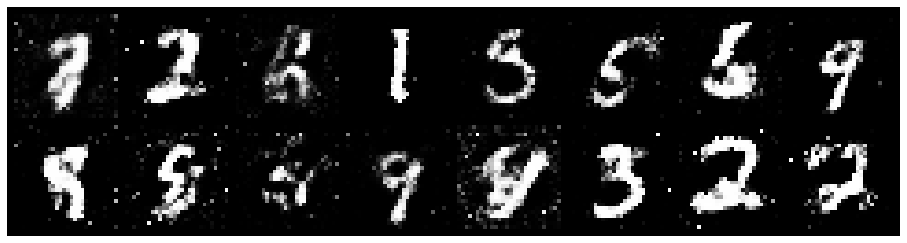

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.2045, Generator Loss: 1.1321
D(x): 0.6041, D(G(z)): 0.4059


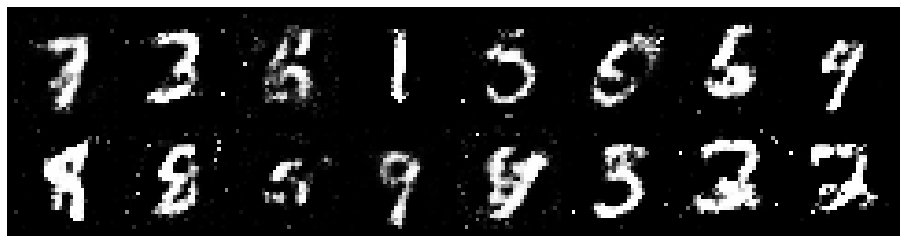

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 0.9060, Generator Loss: 1.2572
D(x): 0.7075, D(G(z)): 0.3177


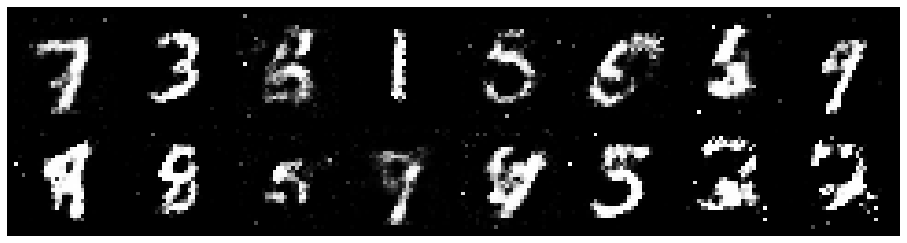

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.0891, Generator Loss: 1.2694
D(x): 0.6244, D(G(z)): 0.3687


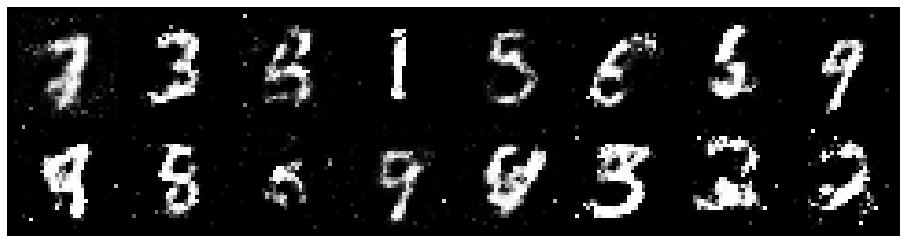

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 0.9175, Generator Loss: 1.0008
D(x): 0.7510, D(G(z)): 0.3991


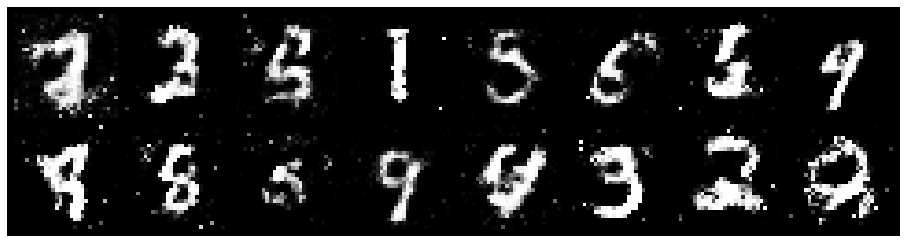

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 0.9912, Generator Loss: 1.2030
D(x): 0.6739, D(G(z)): 0.3736


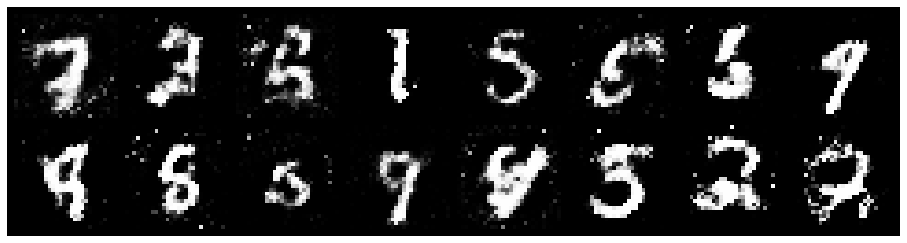

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.0836, Generator Loss: 1.2580
D(x): 0.6836, D(G(z)): 0.4193


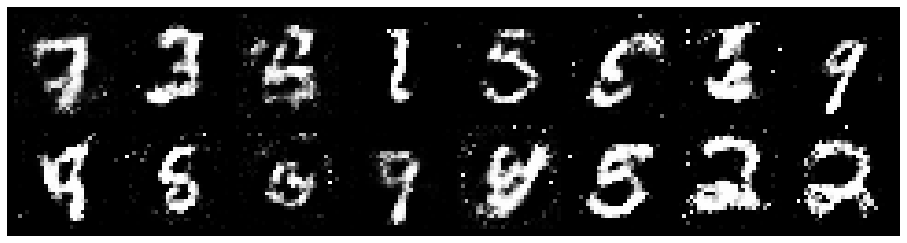

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.0295, Generator Loss: 1.2102
D(x): 0.6548, D(G(z)): 0.3874


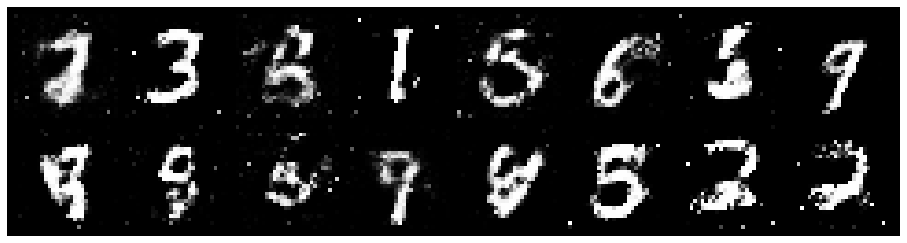

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.0433, Generator Loss: 1.1350
D(x): 0.7137, D(G(z)): 0.4258


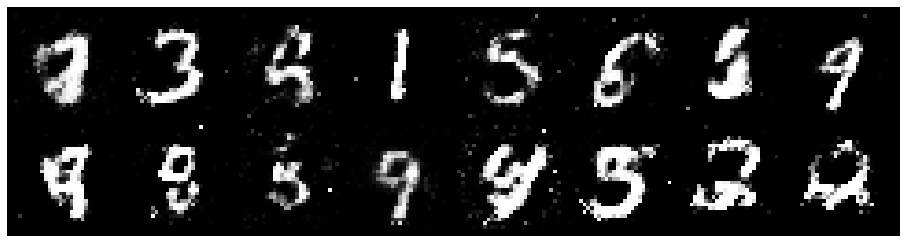

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.1774, Generator Loss: 1.3156
D(x): 0.5914, D(G(z)): 0.3549


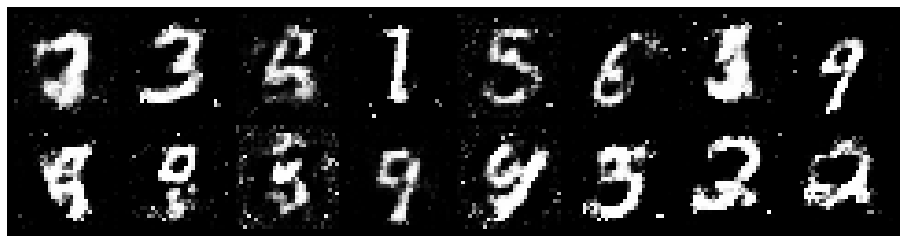

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.0350, Generator Loss: 1.3870
D(x): 0.6253, D(G(z)): 0.3127


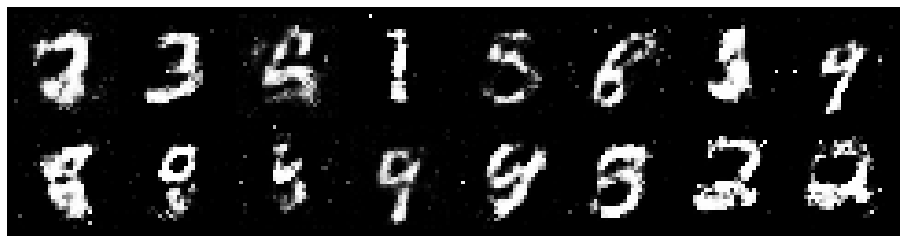

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.0482, Generator Loss: 1.7141
D(x): 0.6280, D(G(z)): 0.2934


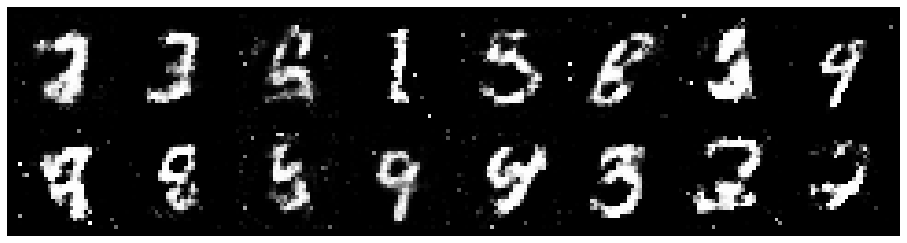

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.1203, Generator Loss: 1.3109
D(x): 0.7375, D(G(z)): 0.4201


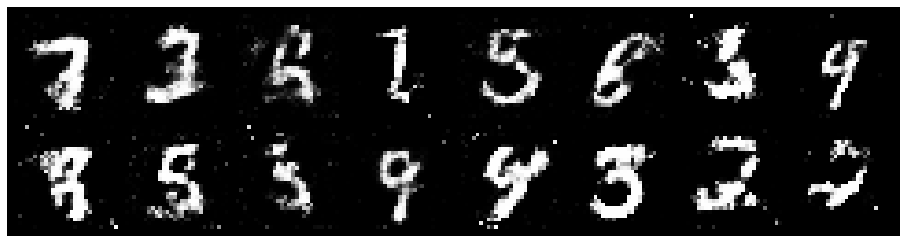

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.1456, Generator Loss: 1.3381
D(x): 0.6658, D(G(z)): 0.4074


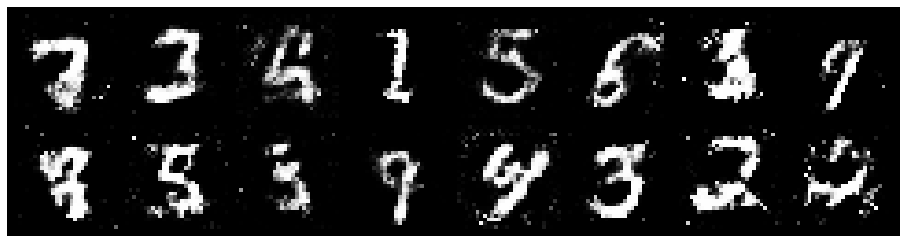

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.0159, Generator Loss: 1.2736
D(x): 0.7016, D(G(z)): 0.3785


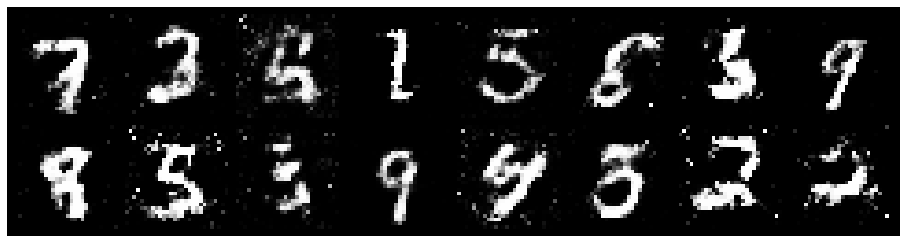

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.2016, Generator Loss: 1.2856
D(x): 0.5473, D(G(z)): 0.3076


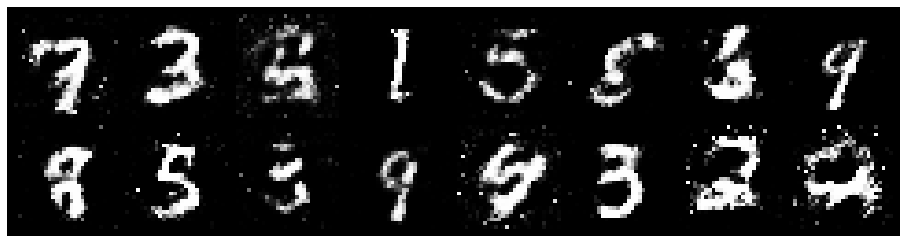

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.1907, Generator Loss: 0.9527
D(x): 0.6167, D(G(z)): 0.3724


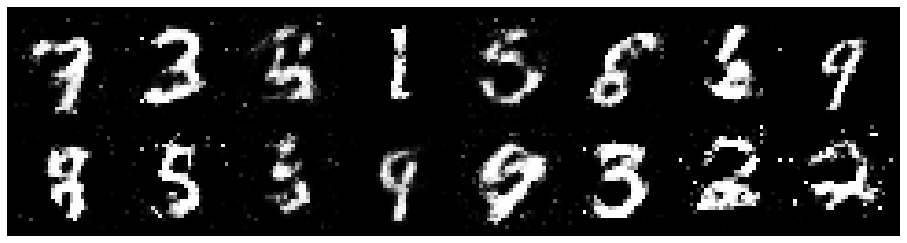

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.2736, Generator Loss: 1.3118
D(x): 0.6076, D(G(z)): 0.3498


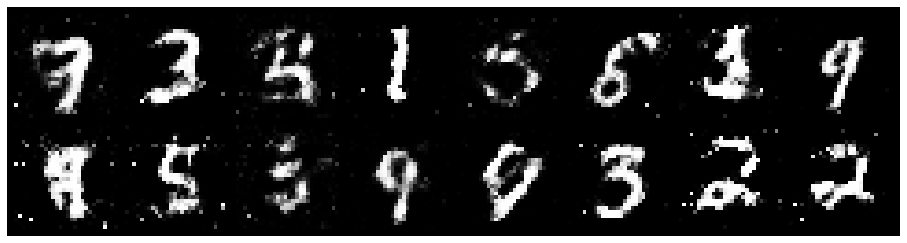

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 0.8790, Generator Loss: 1.2337
D(x): 0.7226, D(G(z)): 0.3455


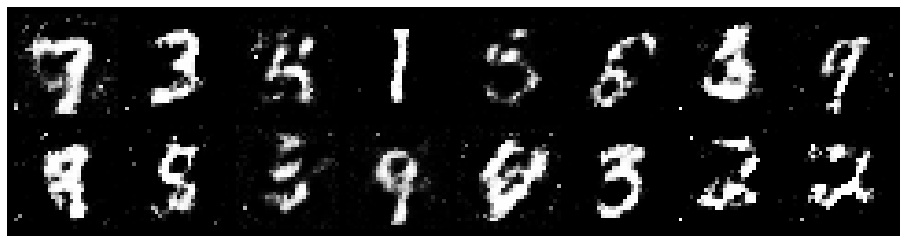

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 0.9238, Generator Loss: 1.6879
D(x): 0.6430, D(G(z)): 0.2719


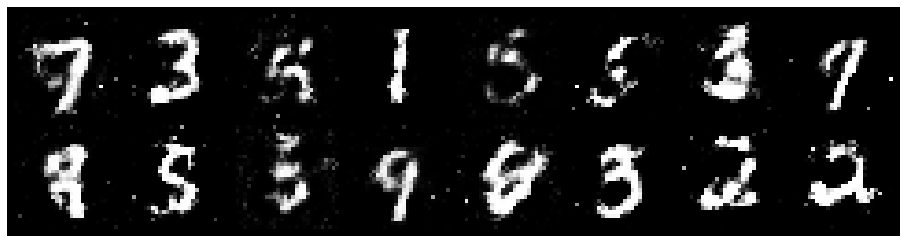

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.2736, Generator Loss: 1.1731
D(x): 0.6423, D(G(z)): 0.4321


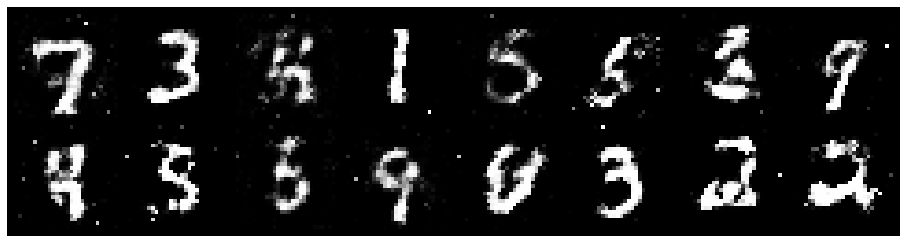

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.1360, Generator Loss: 1.3414
D(x): 0.5845, D(G(z)): 0.3325


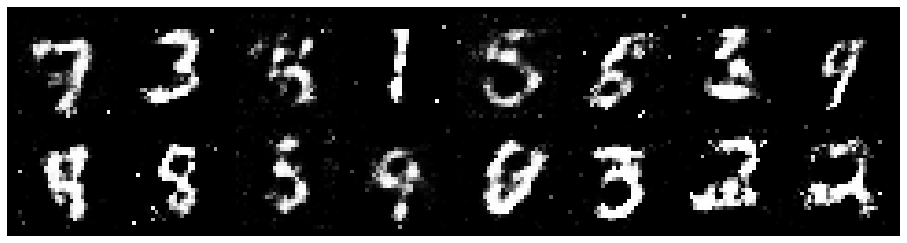

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.1844, Generator Loss: 1.0434
D(x): 0.6206, D(G(z)): 0.3992


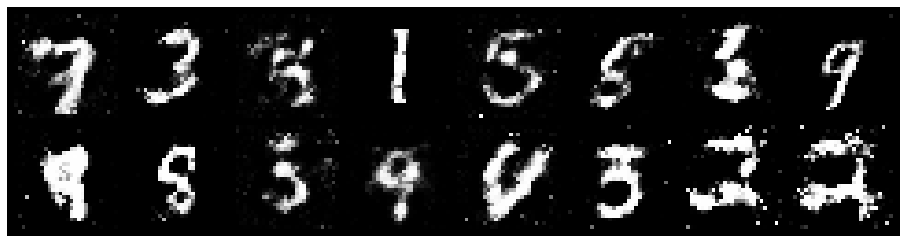

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.0713, Generator Loss: 1.3023
D(x): 0.5990, D(G(z)): 0.3469


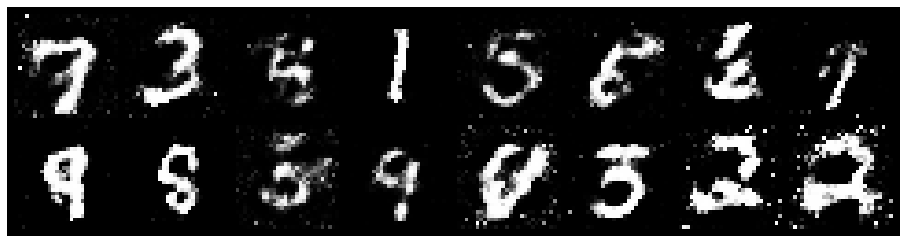

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.2117, Generator Loss: 1.2269
D(x): 0.5499, D(G(z)): 0.3394


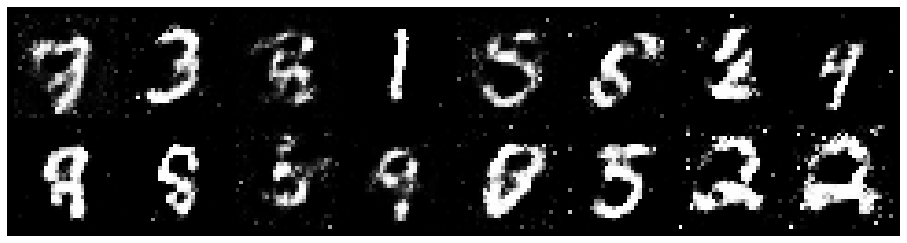

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.1989, Generator Loss: 1.0596
D(x): 0.6385, D(G(z)): 0.4418


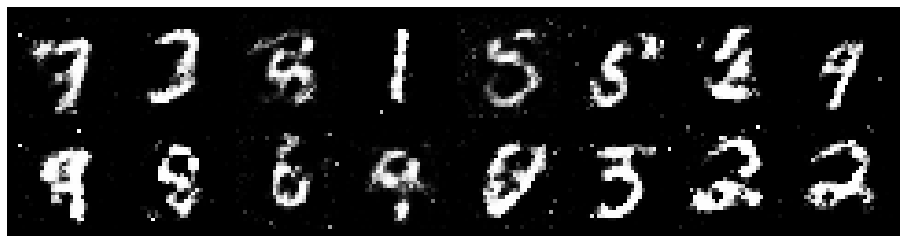

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.2255, Generator Loss: 0.9531
D(x): 0.6209, D(G(z)): 0.4278


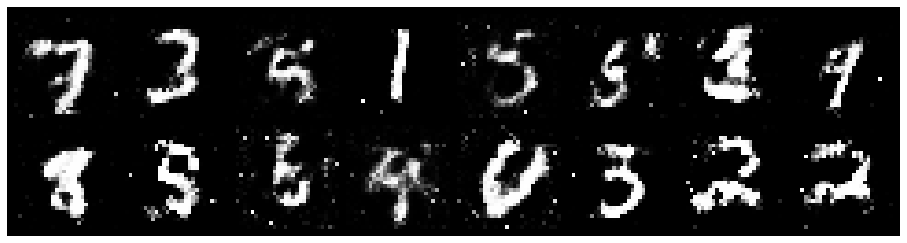

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.1005, Generator Loss: 1.4777
D(x): 0.6521, D(G(z)): 0.3670


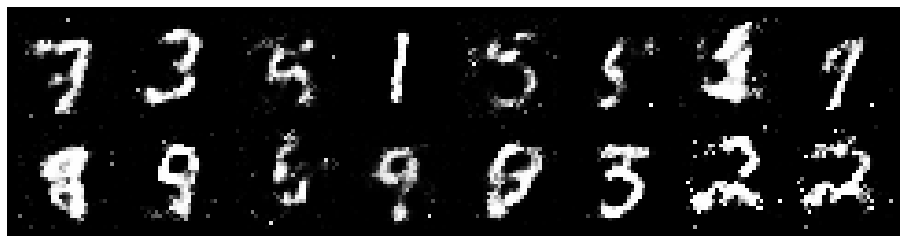

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.0023, Generator Loss: 1.3685
D(x): 0.6825, D(G(z)): 0.3404


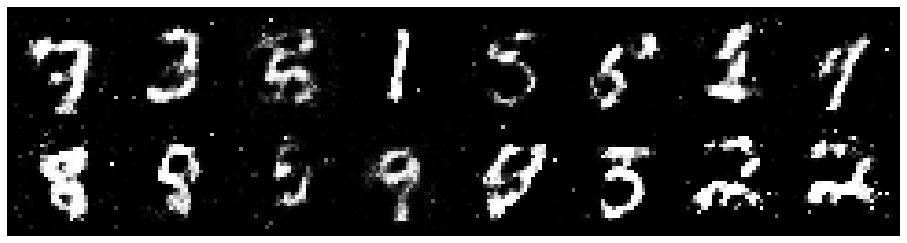

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.1324, Generator Loss: 1.2329
D(x): 0.6130, D(G(z)): 0.3999


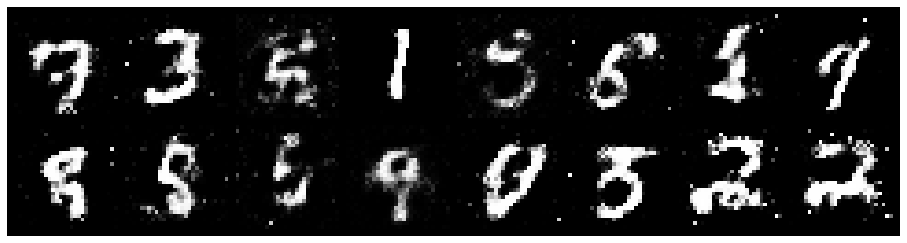

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.0358, Generator Loss: 1.2358
D(x): 0.6506, D(G(z)): 0.3570


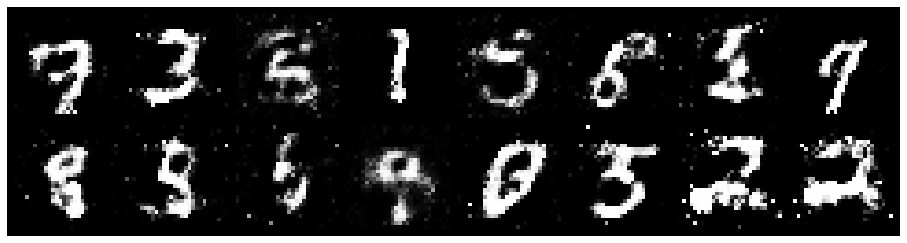

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.1329, Generator Loss: 1.2833
D(x): 0.6822, D(G(z)): 0.4318


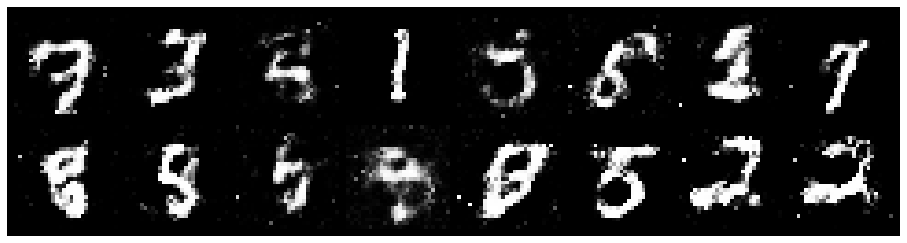

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.2558, Generator Loss: 1.3130
D(x): 0.6359, D(G(z)): 0.4308


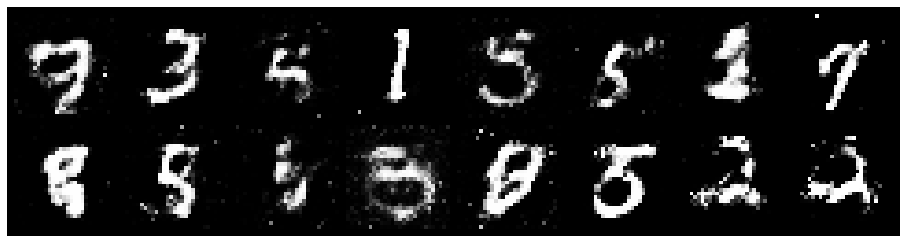

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.2649, Generator Loss: 1.3188
D(x): 0.6168, D(G(z)): 0.4145


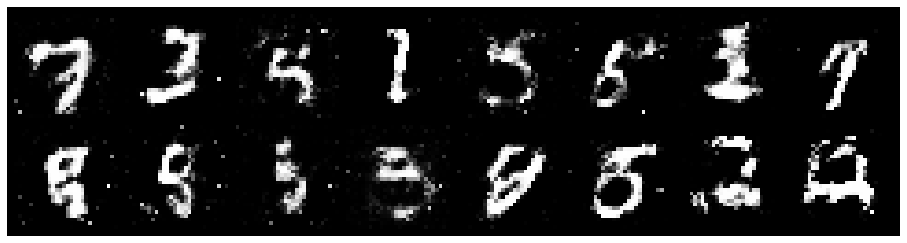

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.0301, Generator Loss: 1.1335
D(x): 0.6828, D(G(z)): 0.3664


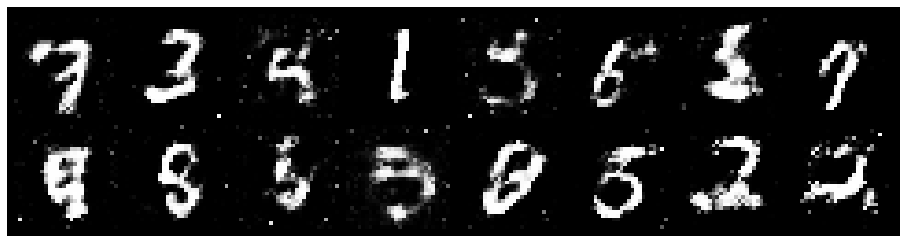

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.1843, Generator Loss: 1.1323
D(x): 0.5679, D(G(z)): 0.3383


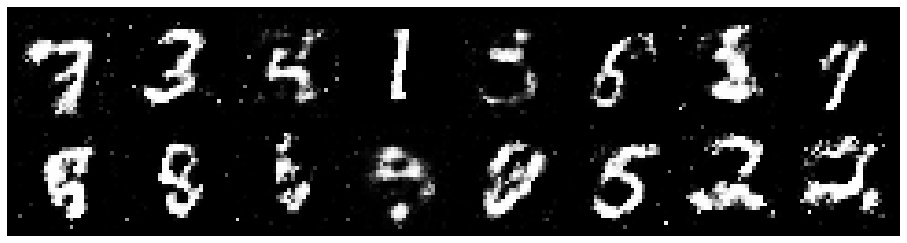

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.4465, Generator Loss: 1.0713
D(x): 0.6295, D(G(z)): 0.5216


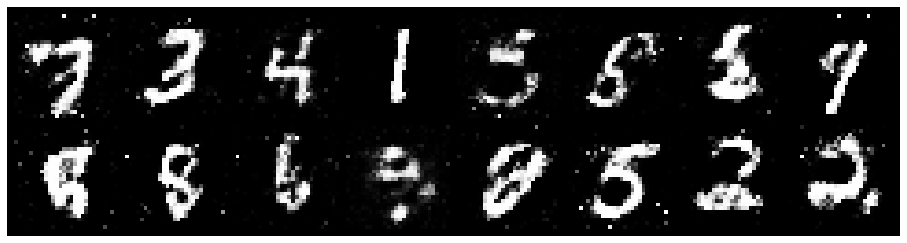

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.0721, Generator Loss: 1.0844
D(x): 0.6333, D(G(z)): 0.3910


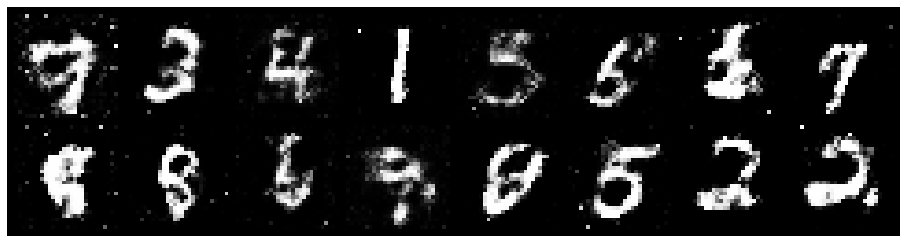

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.1929, Generator Loss: 1.4163
D(x): 0.5549, D(G(z)): 0.3492


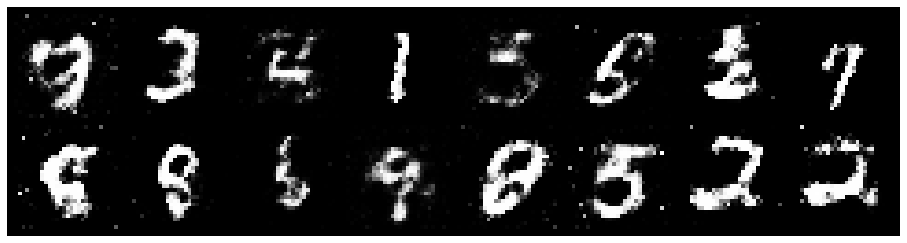

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.0287, Generator Loss: 1.1824
D(x): 0.5925, D(G(z)): 0.3242


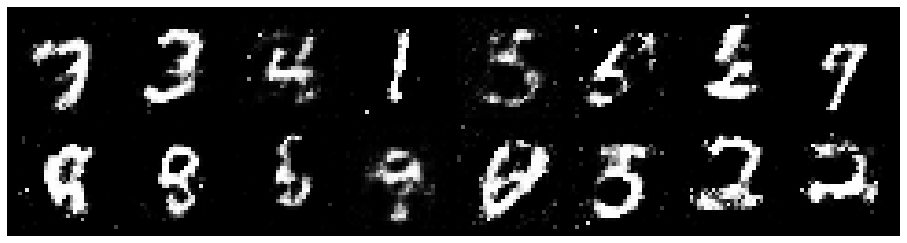

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 0.9814, Generator Loss: 1.1072
D(x): 0.6538, D(G(z)): 0.3500


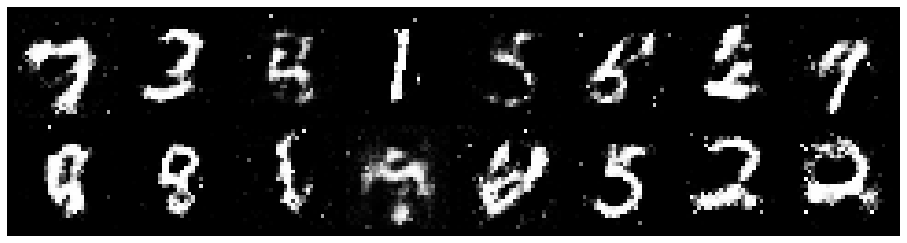

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.0427, Generator Loss: 1.2327
D(x): 0.6276, D(G(z)): 0.3355


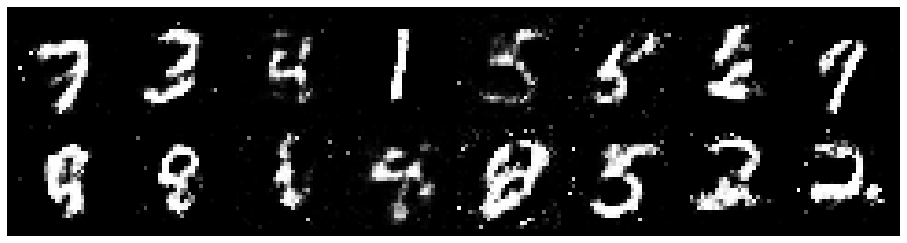

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.0710, Generator Loss: 1.2897
D(x): 0.6361, D(G(z)): 0.3469


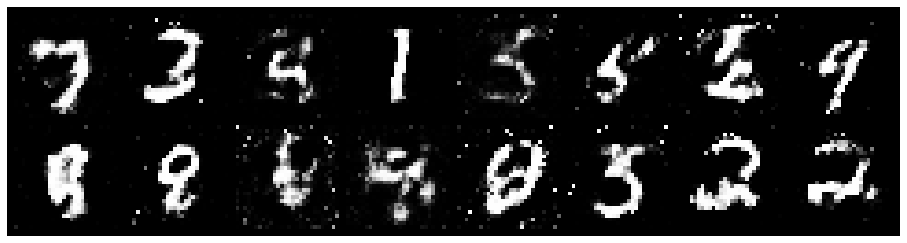

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 0.9879, Generator Loss: 1.2121
D(x): 0.6056, D(G(z)): 0.3037


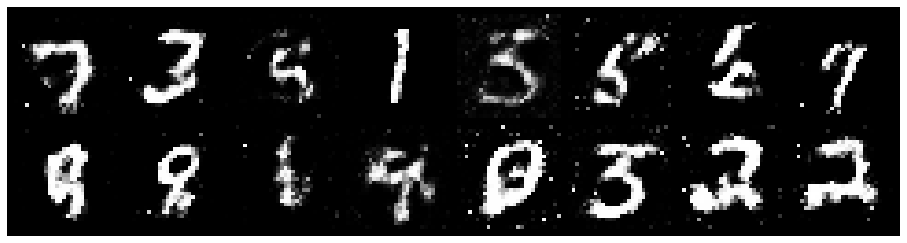

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 0.9512, Generator Loss: 1.3269
D(x): 0.6956, D(G(z)): 0.3725


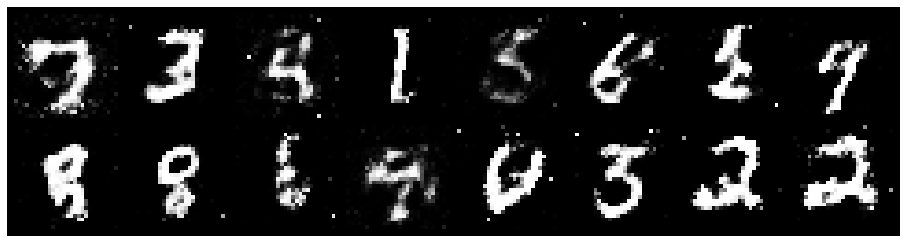

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.0346, Generator Loss: 1.1018
D(x): 0.6434, D(G(z)): 0.3862


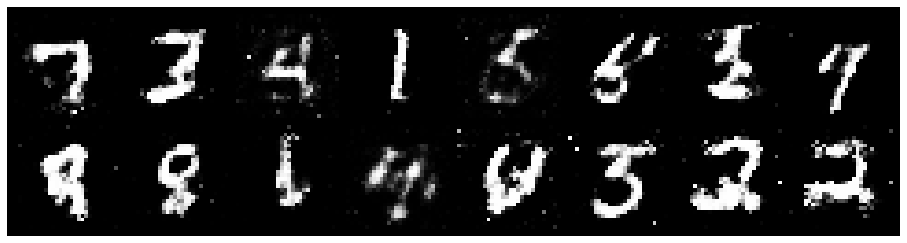

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.2088, Generator Loss: 1.1299
D(x): 0.6708, D(G(z)): 0.4780


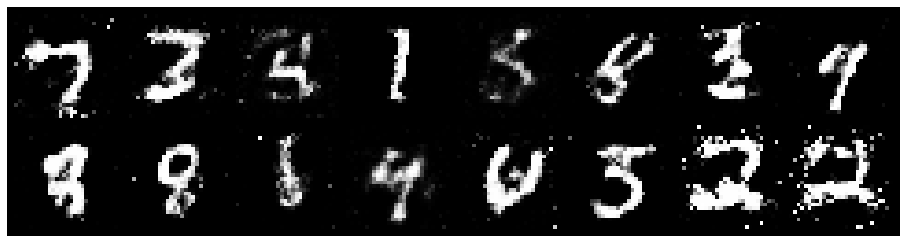

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.1304, Generator Loss: 0.9860
D(x): 0.5733, D(G(z)): 0.3615


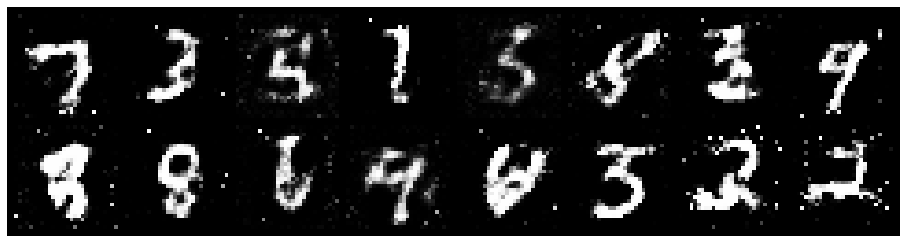

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.2399, Generator Loss: 1.2650
D(x): 0.5817, D(G(z)): 0.3560


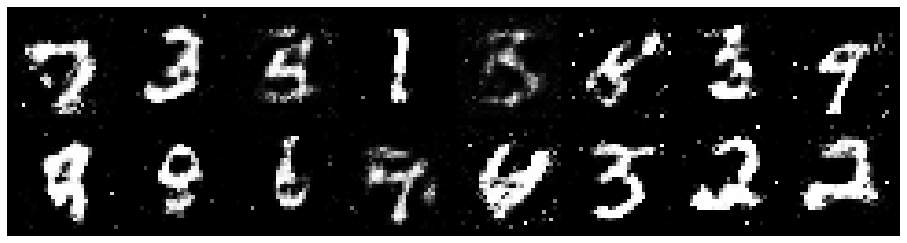

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.3062, Generator Loss: 1.3102
D(x): 0.5693, D(G(z)): 0.3765


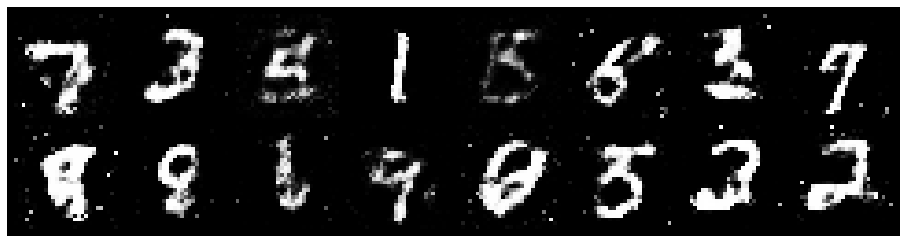

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.2582, Generator Loss: 1.0662
D(x): 0.5763, D(G(z)): 0.4026


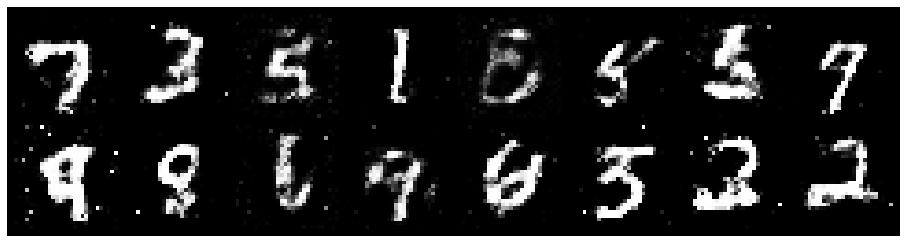

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 0.9585, Generator Loss: 1.1764
D(x): 0.6722, D(G(z)): 0.3445


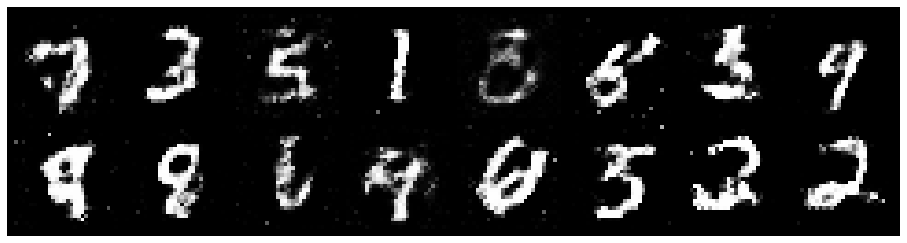

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.0954, Generator Loss: 1.1580
D(x): 0.6649, D(G(z)): 0.3863


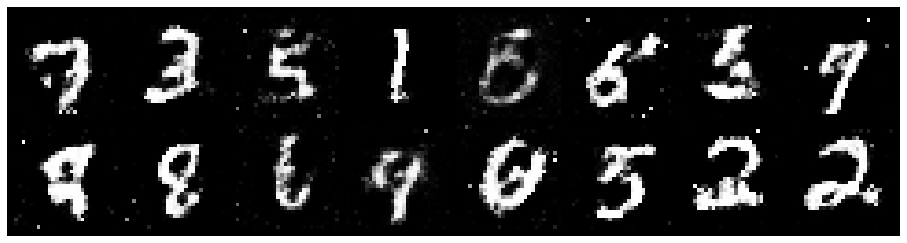

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.1959, Generator Loss: 1.1805
D(x): 0.6904, D(G(z)): 0.4382


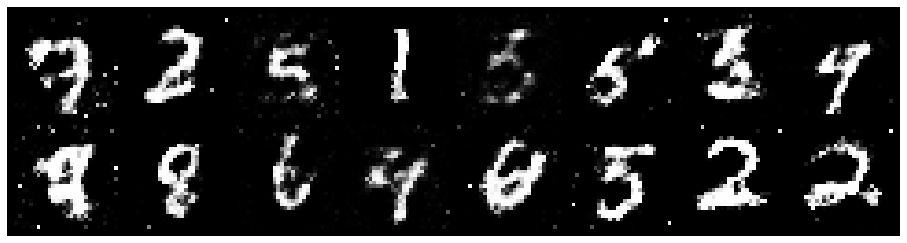

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 0.9505, Generator Loss: 1.3701
D(x): 0.6635, D(G(z)): 0.3292


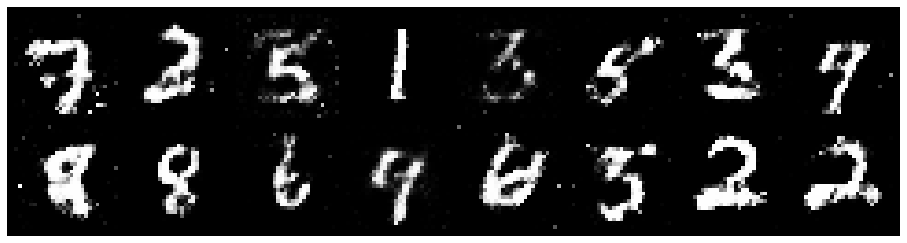

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.0974, Generator Loss: 1.1905
D(x): 0.6612, D(G(z)): 0.3994


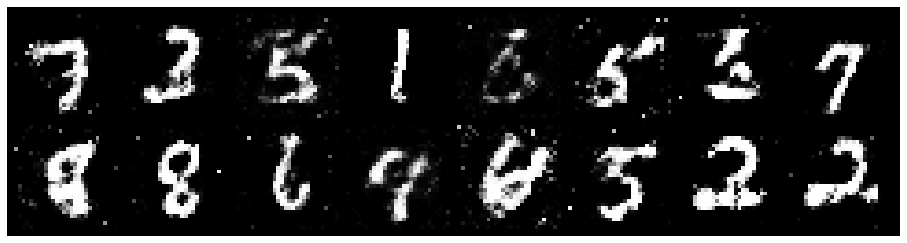

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.2857, Generator Loss: 0.8815
D(x): 0.5988, D(G(z)): 0.4424


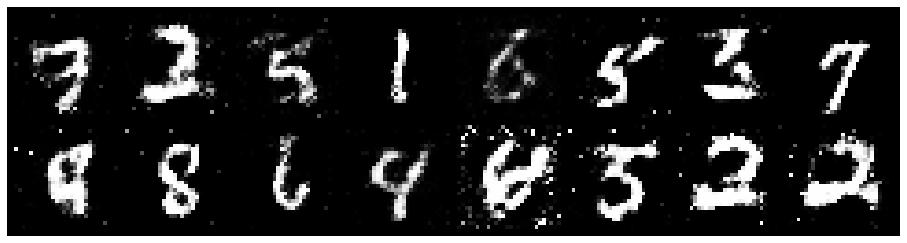

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.2026, Generator Loss: 0.9152
D(x): 0.5773, D(G(z)): 0.4213


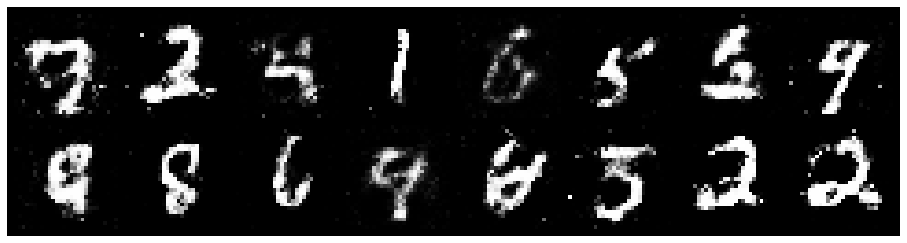

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.1361, Generator Loss: 1.2120
D(x): 0.6006, D(G(z)): 0.3707


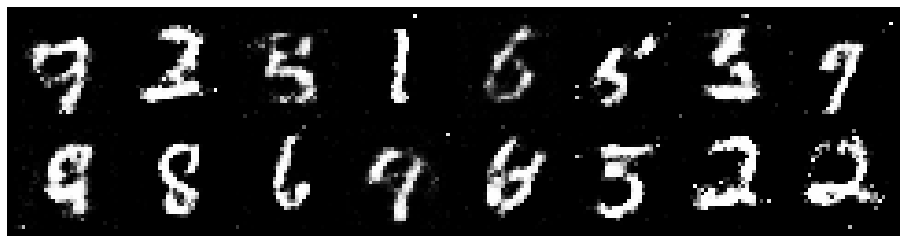

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.0816, Generator Loss: 1.2664
D(x): 0.6317, D(G(z)): 0.3934


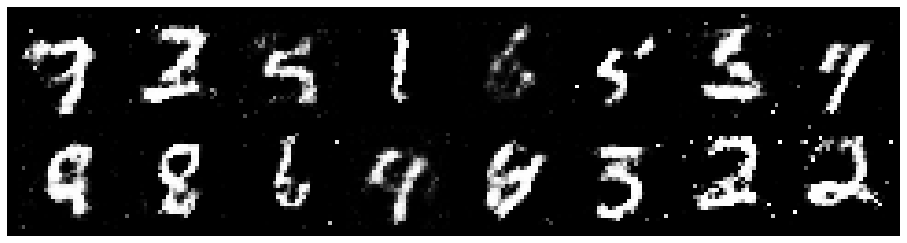

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.0775, Generator Loss: 1.1202
D(x): 0.6230, D(G(z)): 0.3548


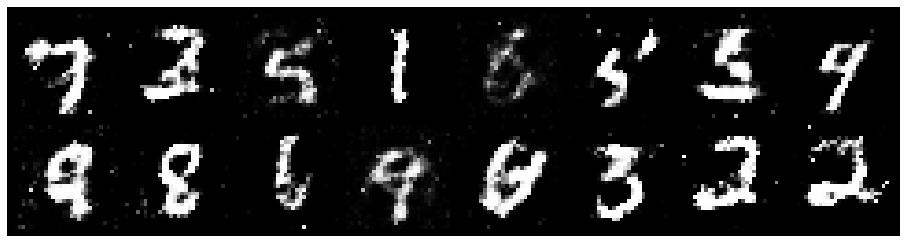

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.0110, Generator Loss: 1.2692
D(x): 0.7002, D(G(z)): 0.3873


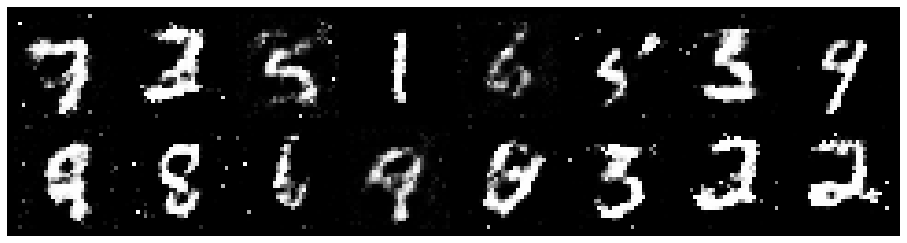

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.1318, Generator Loss: 1.0143
D(x): 0.5710, D(G(z)): 0.3375


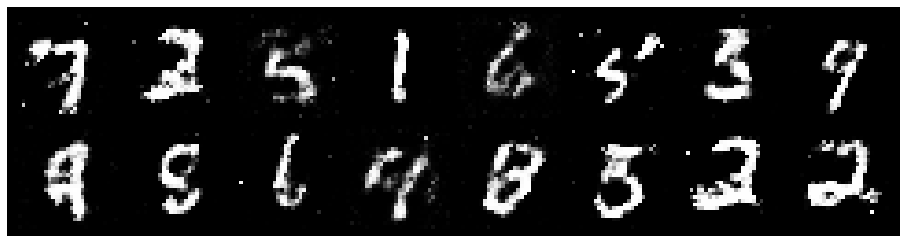

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.2092, Generator Loss: 1.1515
D(x): 0.5855, D(G(z)): 0.4045


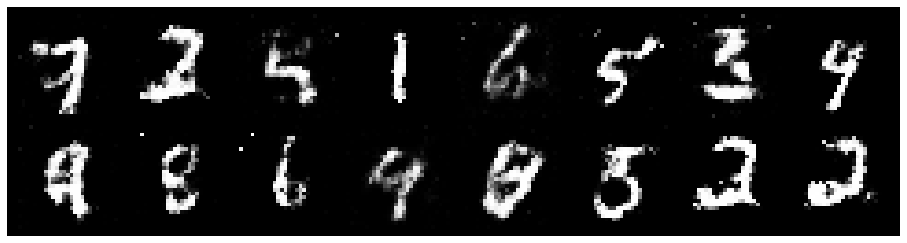

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.1724, Generator Loss: 0.8327
D(x): 0.5924, D(G(z)): 0.4486


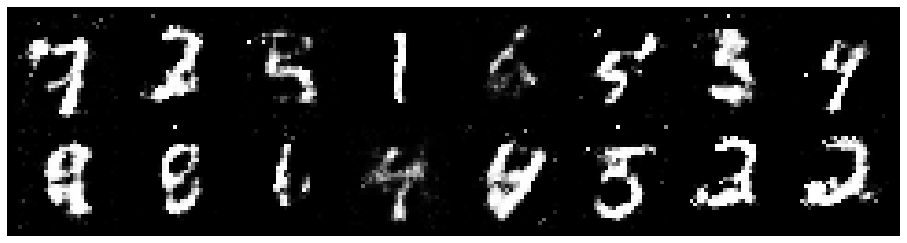

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.2267, Generator Loss: 0.8722
D(x): 0.5647, D(G(z)): 0.4426


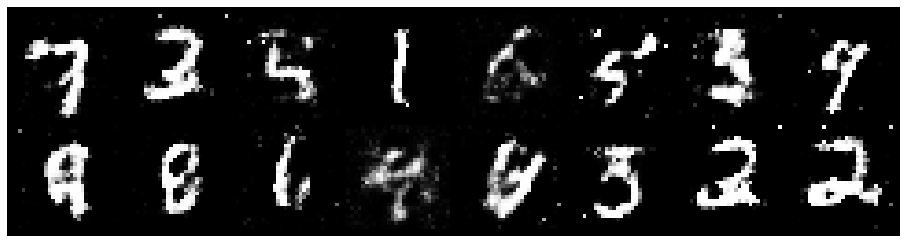

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.2893, Generator Loss: 1.0755
D(x): 0.5364, D(G(z)): 0.4002


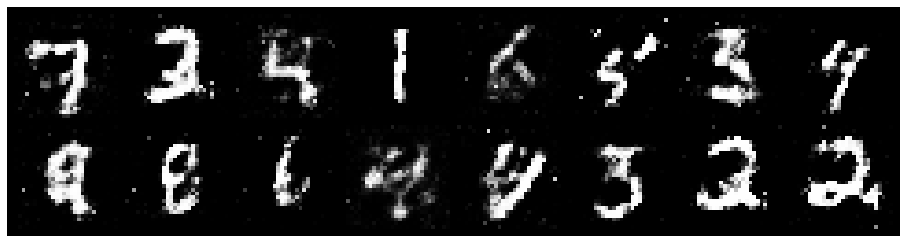

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.1678, Generator Loss: 0.9939
D(x): 0.5687, D(G(z)): 0.4019


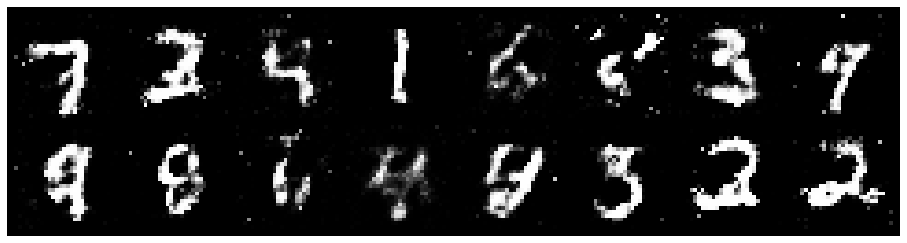

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.1539, Generator Loss: 1.2063
D(x): 0.6065, D(G(z)): 0.3946


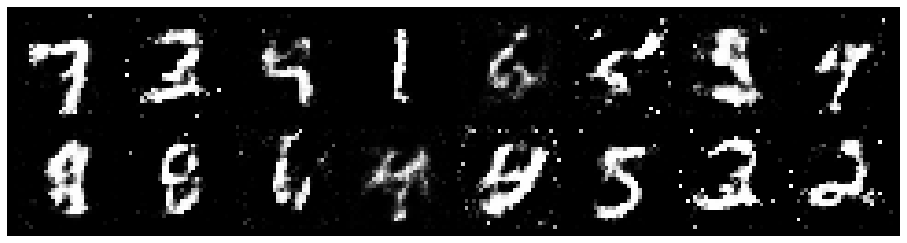

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.0679, Generator Loss: 1.0878
D(x): 0.6060, D(G(z)): 0.3486


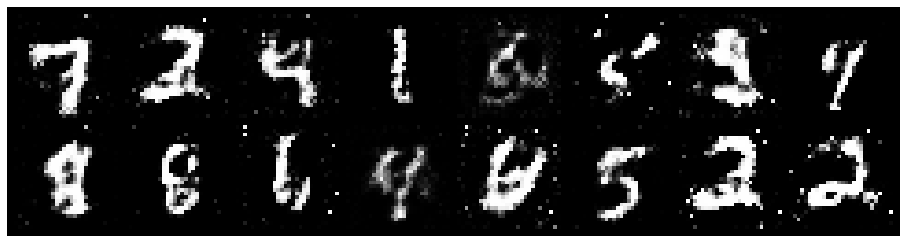

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 0.9664, Generator Loss: 1.0365
D(x): 0.6477, D(G(z)): 0.3500


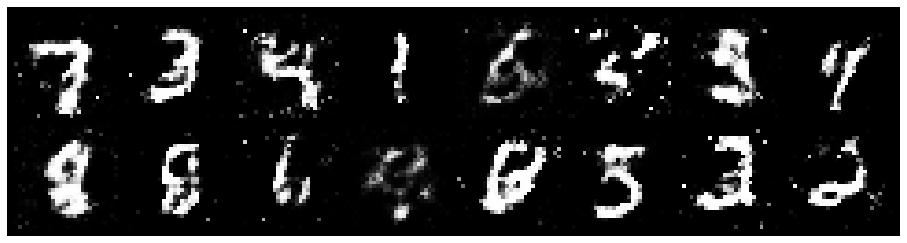

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.0749, Generator Loss: 1.2968
D(x): 0.5903, D(G(z)): 0.3571


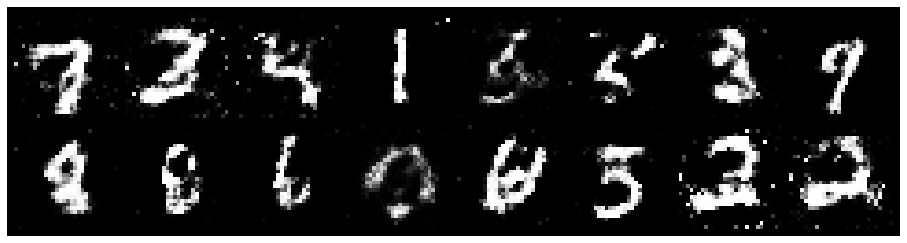

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.1184, Generator Loss: 1.1442
D(x): 0.5995, D(G(z)): 0.3754


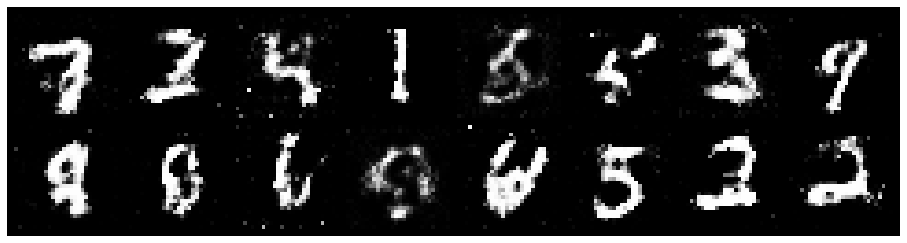

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.1299, Generator Loss: 1.5139
D(x): 0.6371, D(G(z)): 0.3708


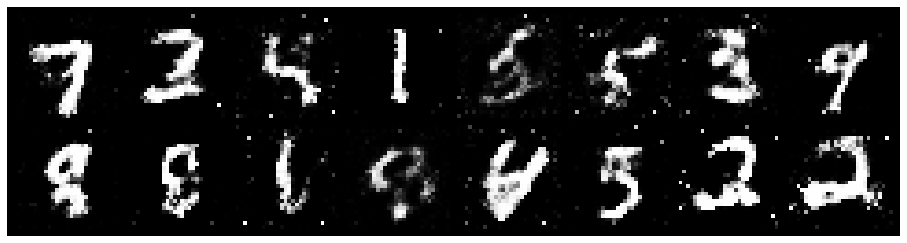

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 0.9738, Generator Loss: 1.3168
D(x): 0.6455, D(G(z)): 0.3319


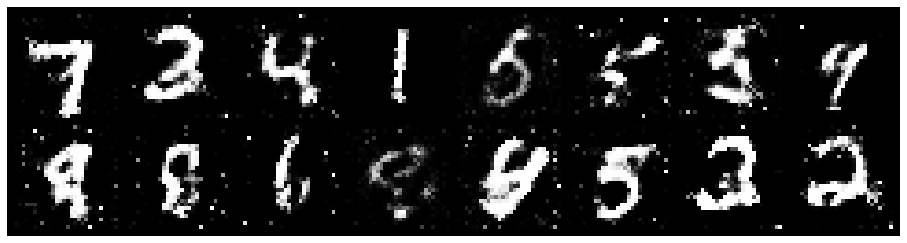

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.2794, Generator Loss: 0.9969
D(x): 0.5642, D(G(z)): 0.4108


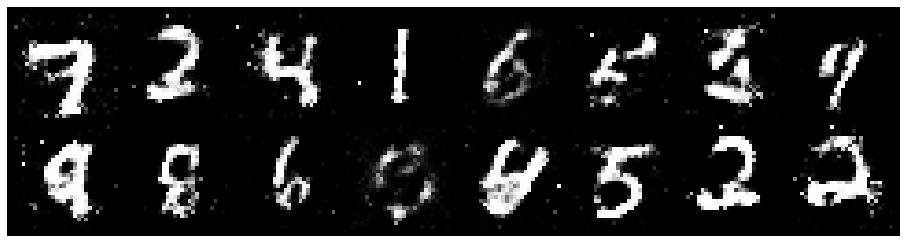

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.2528, Generator Loss: 0.8220
D(x): 0.6487, D(G(z)): 0.5005


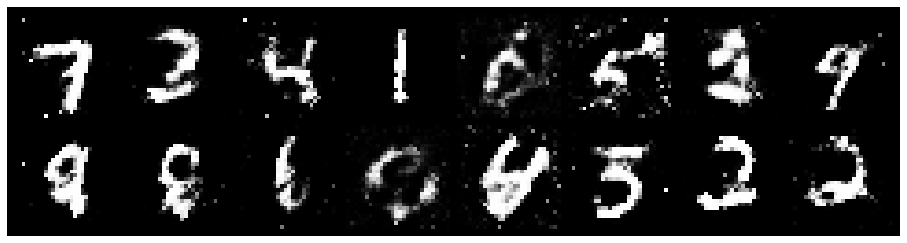

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.0367, Generator Loss: 0.9930
D(x): 0.6756, D(G(z)): 0.3889


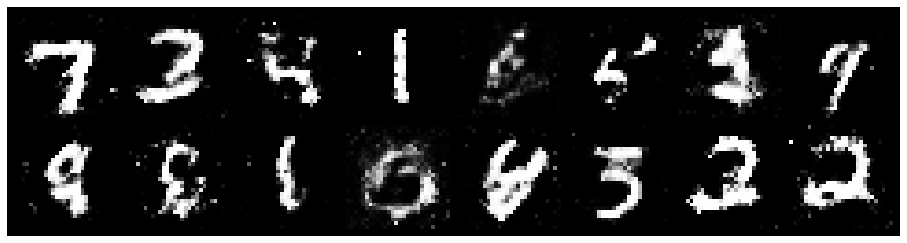

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 0.9649, Generator Loss: 1.3562
D(x): 0.7080, D(G(z)): 0.3634


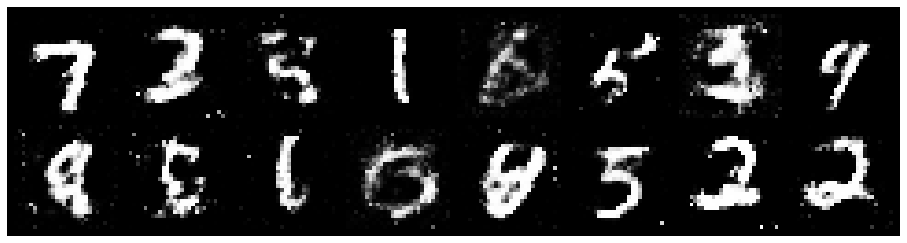

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.3334, Generator Loss: 1.0438
D(x): 0.6089, D(G(z)): 0.4563


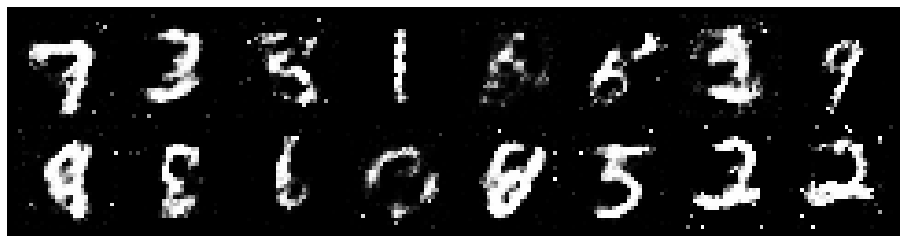

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.1759, Generator Loss: 1.0331
D(x): 0.5732, D(G(z)): 0.3981


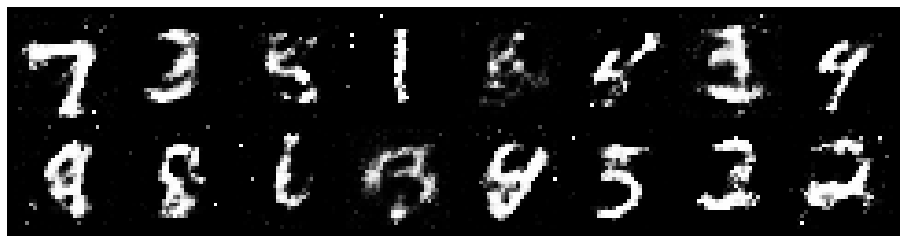

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1736, Generator Loss: 1.1824
D(x): 0.6402, D(G(z)): 0.4251


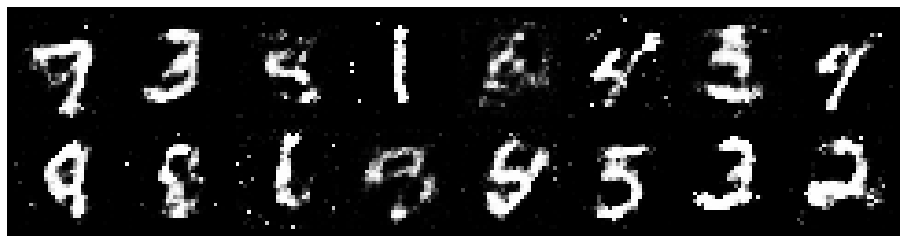

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.1660, Generator Loss: 1.0924
D(x): 0.6110, D(G(z)): 0.4221


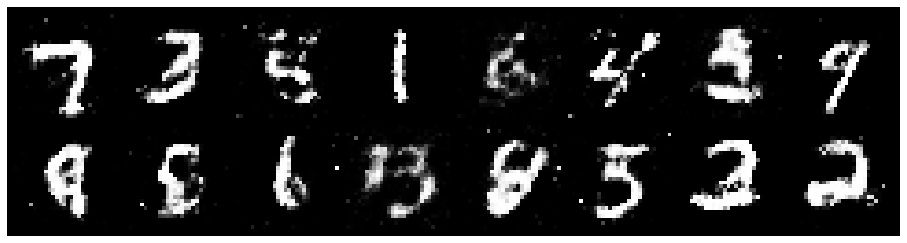

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.0858, Generator Loss: 1.1402
D(x): 0.6479, D(G(z)): 0.4162


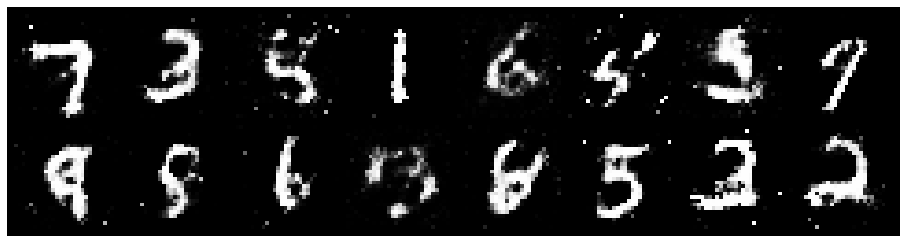

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.0838, Generator Loss: 1.0295
D(x): 0.6012, D(G(z)): 0.3736


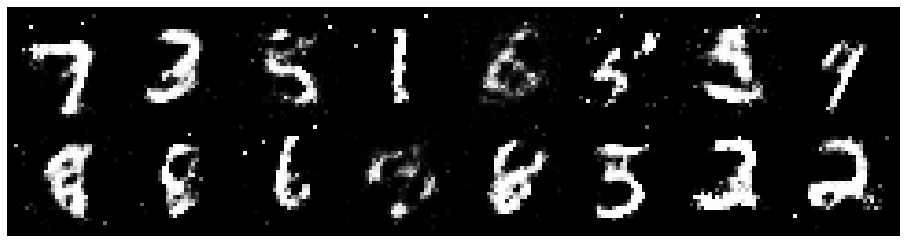

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.1948, Generator Loss: 1.0841
D(x): 0.6230, D(G(z)): 0.4208


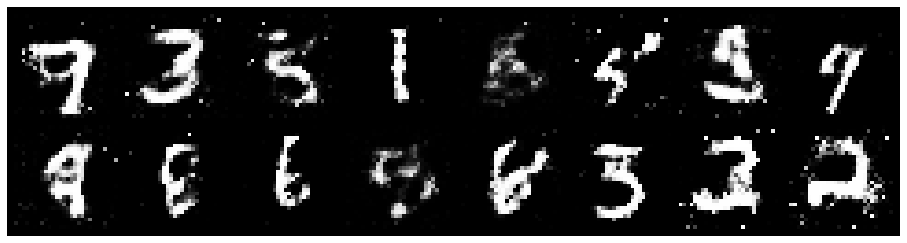

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.1918, Generator Loss: 1.0568
D(x): 0.6116, D(G(z)): 0.4055


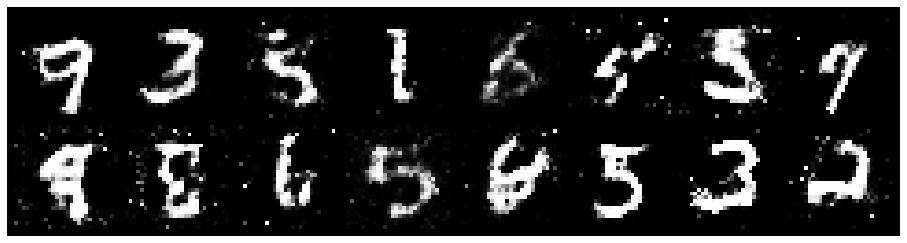

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.1299, Generator Loss: 1.0071
D(x): 0.6180, D(G(z)): 0.3875


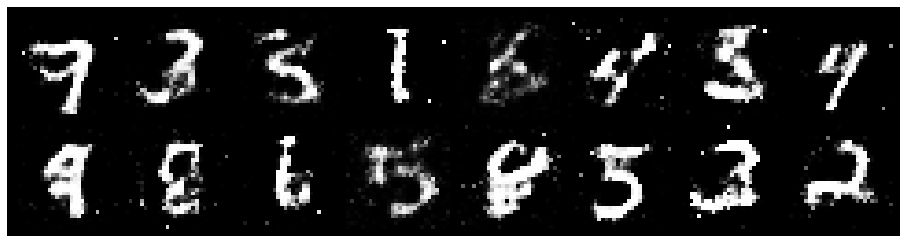

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.4417, Generator Loss: 1.0895
D(x): 0.4508, D(G(z)): 0.3683


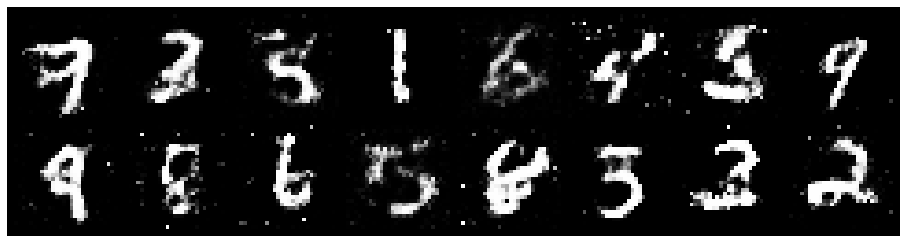

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.1608, Generator Loss: 1.0982
D(x): 0.5610, D(G(z)): 0.3584


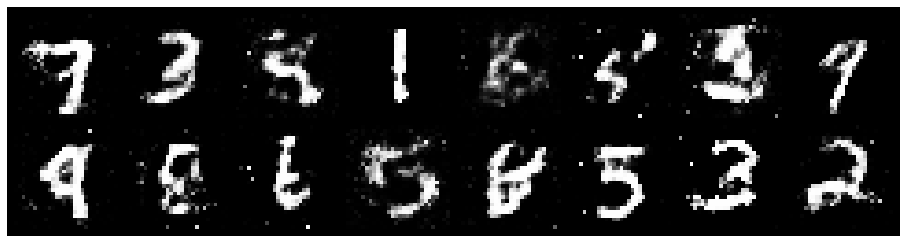

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.3246, Generator Loss: 0.8190
D(x): 0.5531, D(G(z)): 0.4483


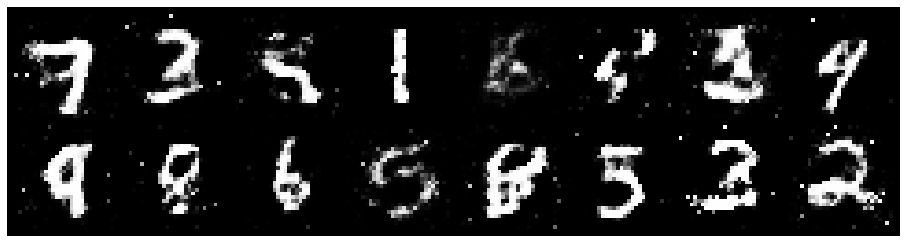

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.2677, Generator Loss: 0.9206
D(x): 0.5789, D(G(z)): 0.4462


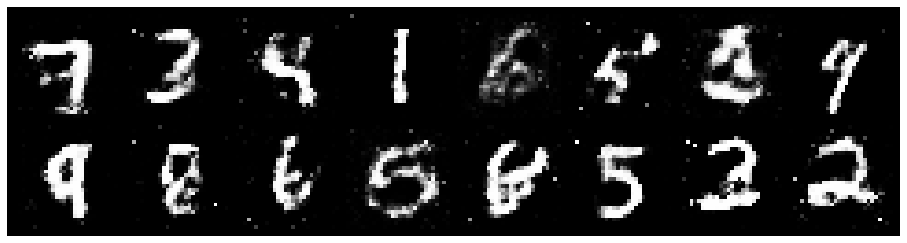

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.2402, Generator Loss: 0.8132
D(x): 0.5875, D(G(z)): 0.4580


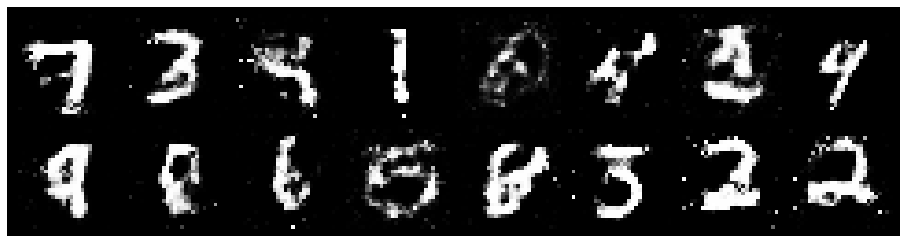

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.2921, Generator Loss: 0.9207
D(x): 0.5553, D(G(z)): 0.4365


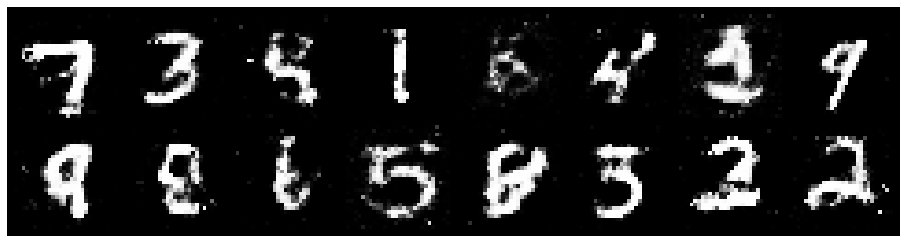

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.2025, Generator Loss: 0.9167
D(x): 0.6372, D(G(z)): 0.4448


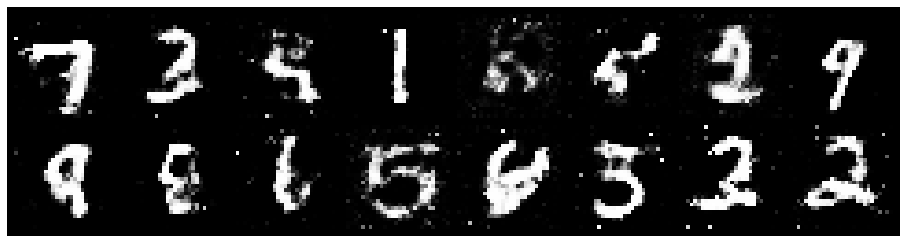

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.2588, Generator Loss: 0.9766
D(x): 0.5457, D(G(z)): 0.4090


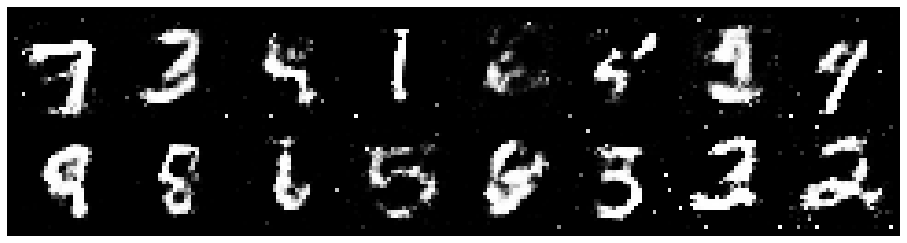

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.1372, Generator Loss: 1.2814
D(x): 0.5951, D(G(z)): 0.3855


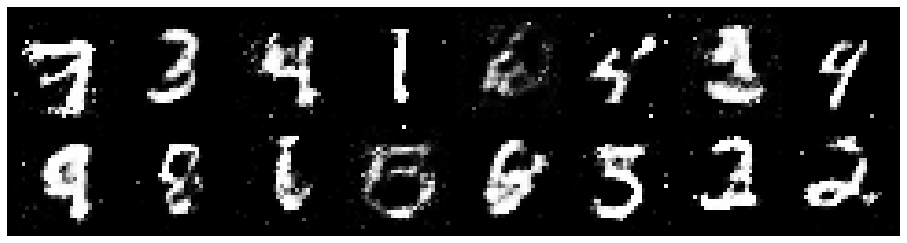

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.1220, Generator Loss: 1.1981
D(x): 0.6556, D(G(z)): 0.4129


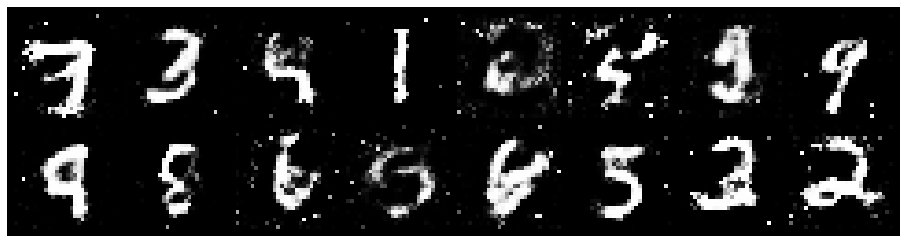

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.2114, Generator Loss: 0.9129
D(x): 0.5710, D(G(z)): 0.4399


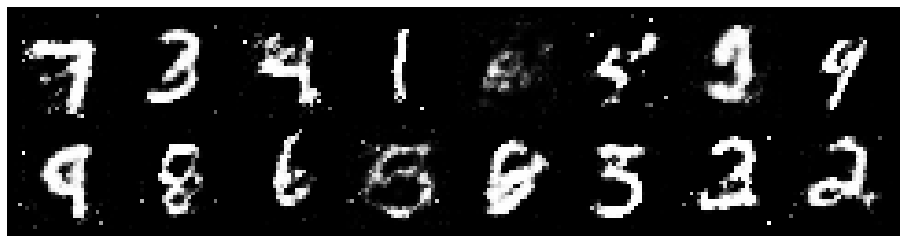

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.0804, Generator Loss: 0.9898
D(x): 0.6624, D(G(z)): 0.4087


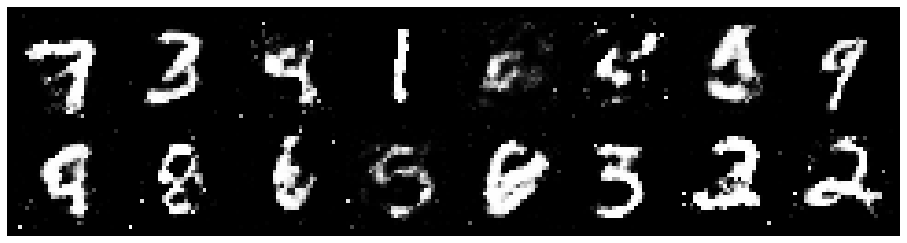

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.1068, Generator Loss: 0.9262
D(x): 0.5901, D(G(z)): 0.3892


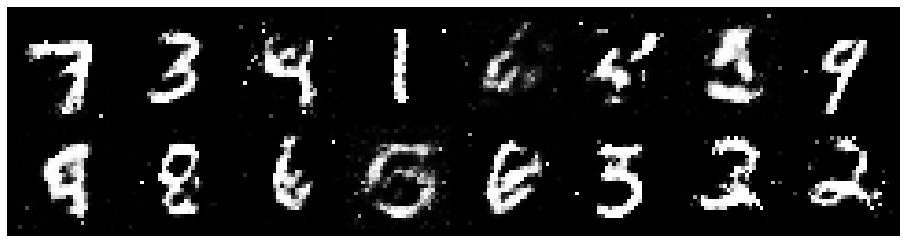

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.2442, Generator Loss: 0.9056
D(x): 0.5900, D(G(z)): 0.4384


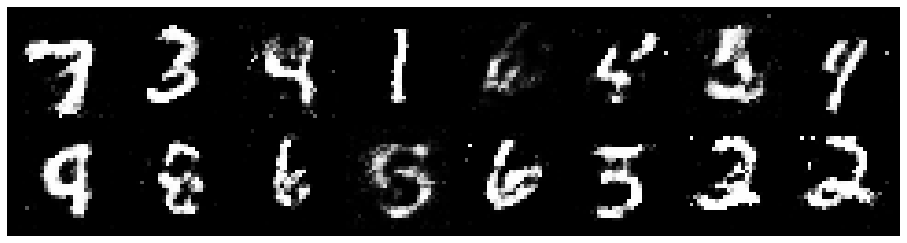

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.1958, Generator Loss: 0.9764
D(x): 0.5956, D(G(z)): 0.4498


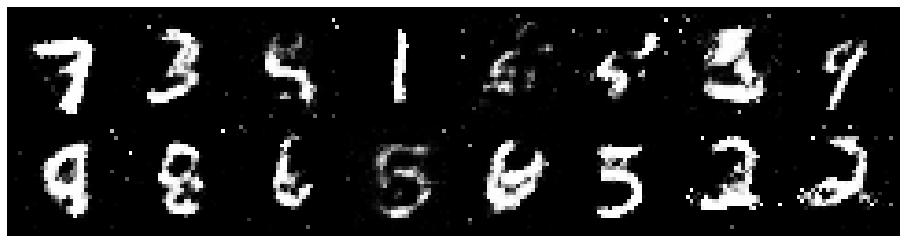

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.1199, Generator Loss: 1.3093
D(x): 0.6016, D(G(z)): 0.3678


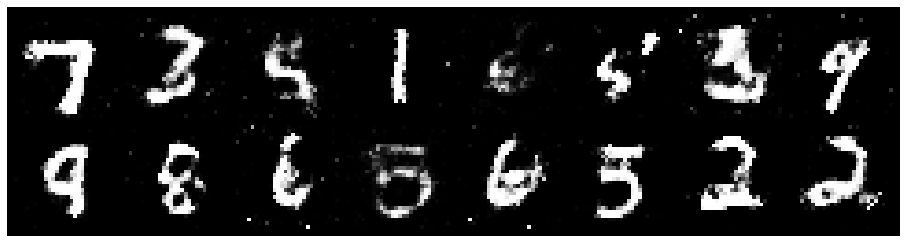

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.1875, Generator Loss: 1.0797
D(x): 0.6465, D(G(z)): 0.4306


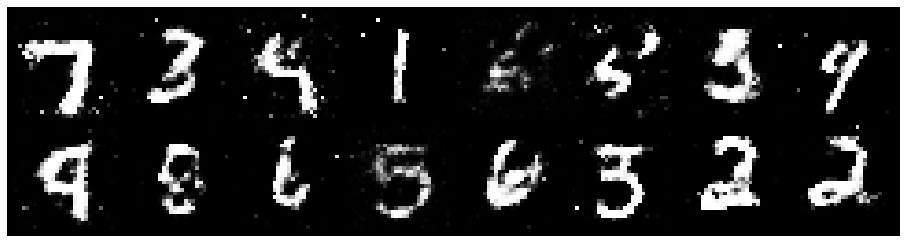

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.2424, Generator Loss: 0.8762
D(x): 0.6169, D(G(z)): 0.4735


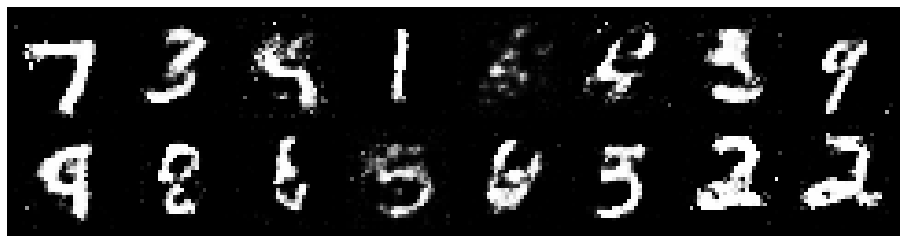

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.3240, Generator Loss: 0.9069
D(x): 0.5674, D(G(z)): 0.4642


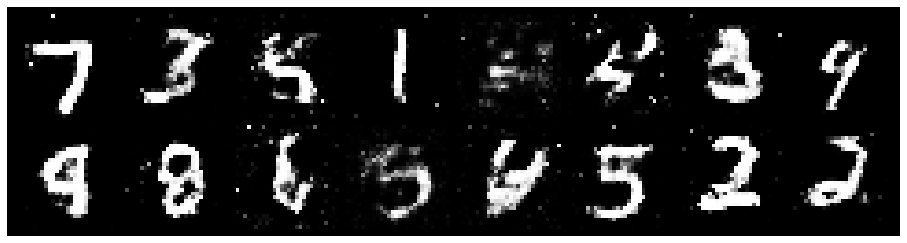

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.0957, Generator Loss: 1.0996
D(x): 0.6328, D(G(z)): 0.4053


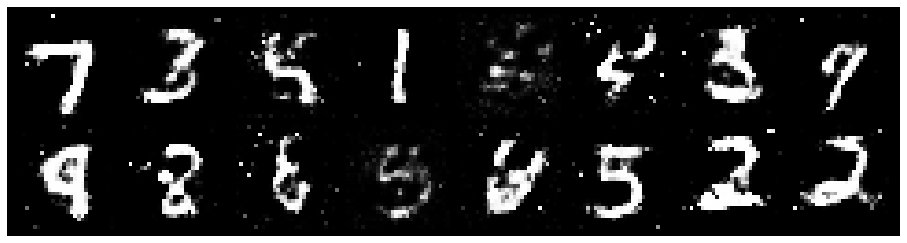

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.3300, Generator Loss: 1.2192
D(x): 0.5831, D(G(z)): 0.3971


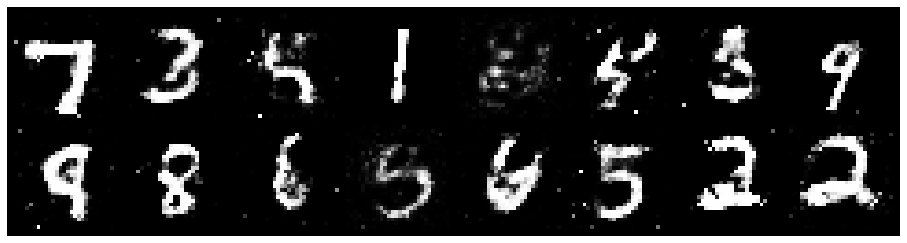

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.1198, Generator Loss: 1.2918
D(x): 0.6524, D(G(z)): 0.3907


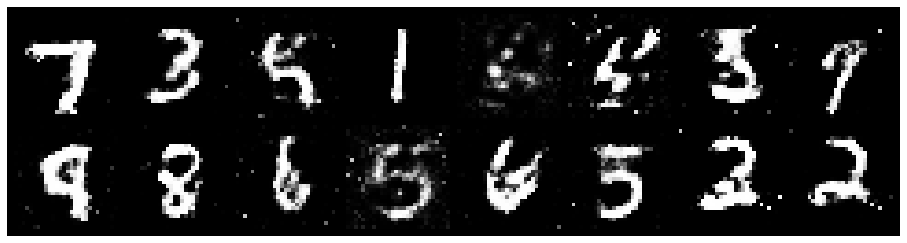

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.1793, Generator Loss: 1.3572
D(x): 0.5900, D(G(z)): 0.3302


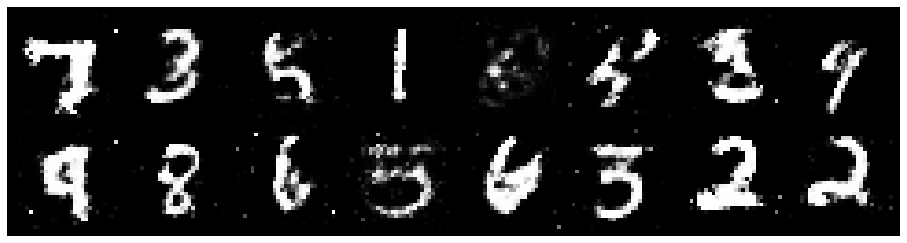

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.2269, Generator Loss: 1.2969
D(x): 0.5953, D(G(z)): 0.3859


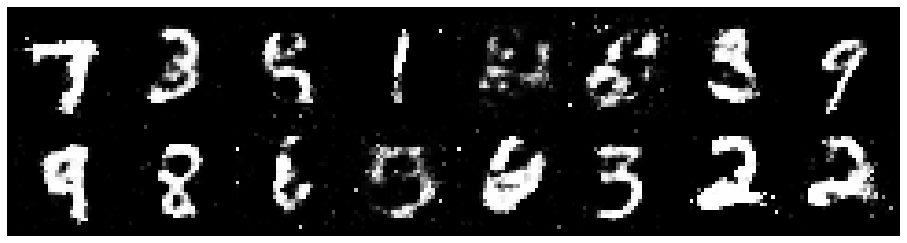

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.2410, Generator Loss: 1.0000
D(x): 0.5763, D(G(z)): 0.4310


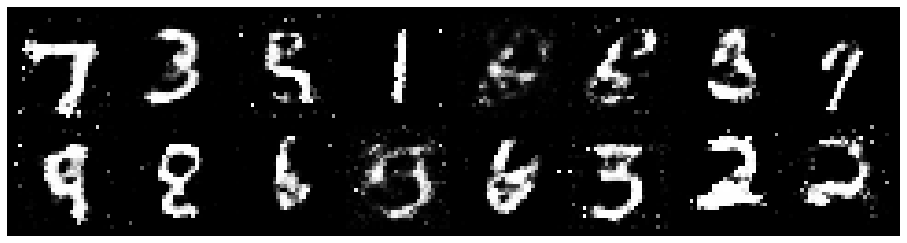

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.2086, Generator Loss: 0.9741
D(x): 0.6489, D(G(z)): 0.4480


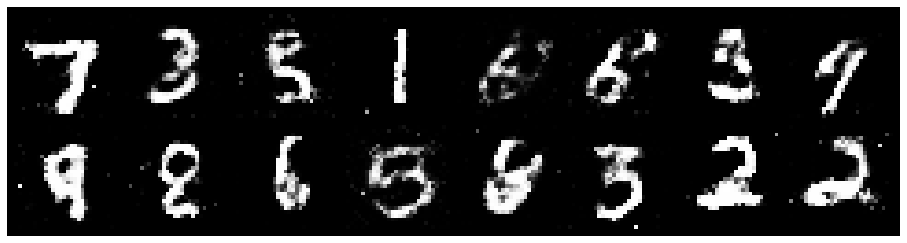

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.0683, Generator Loss: 1.0735
D(x): 0.6415, D(G(z)): 0.3729


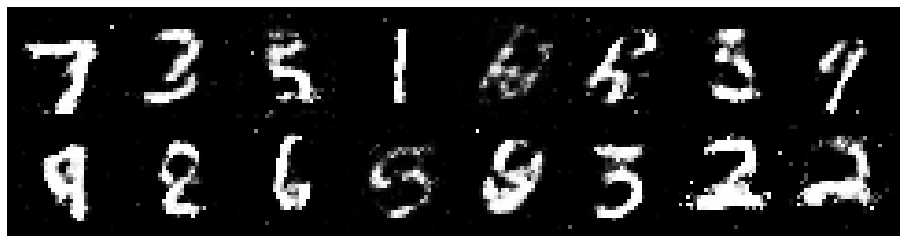

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.1521, Generator Loss: 1.4360
D(x): 0.5981, D(G(z)): 0.3451


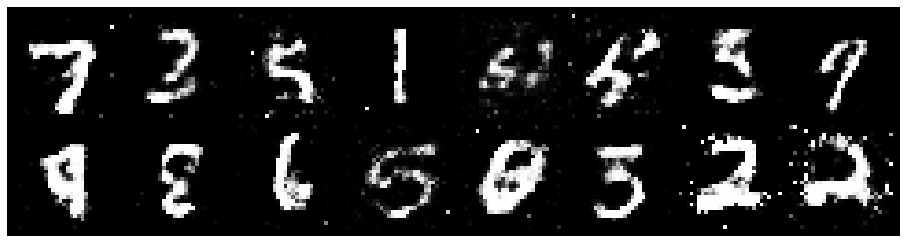

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.0446, Generator Loss: 1.2015
D(x): 0.6691, D(G(z)): 0.3792


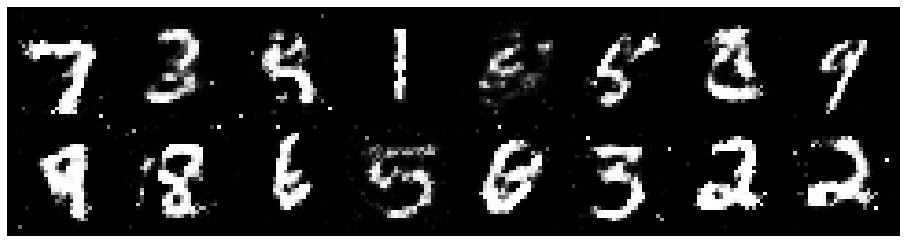

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.2317, Generator Loss: 1.1973
D(x): 0.6521, D(G(z)): 0.4072


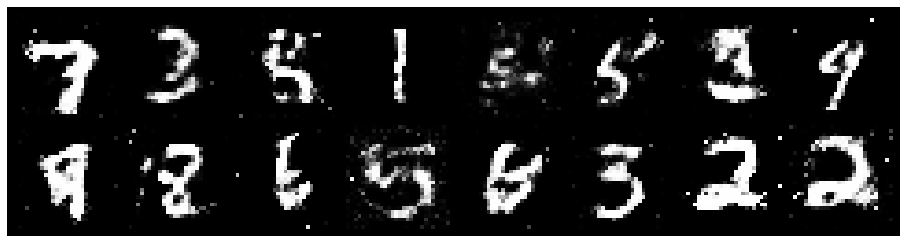

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.0584, Generator Loss: 1.2332
D(x): 0.6705, D(G(z)): 0.4033


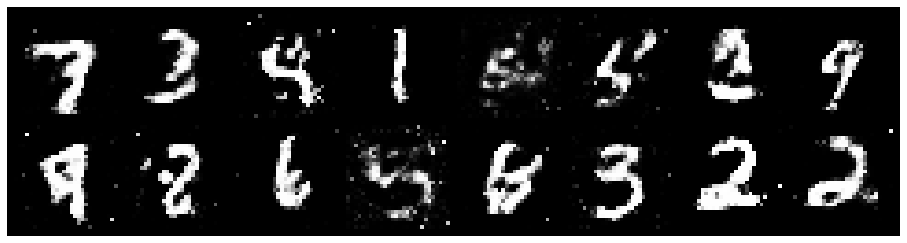

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.0732, Generator Loss: 1.3483
D(x): 0.6156, D(G(z)): 0.3556


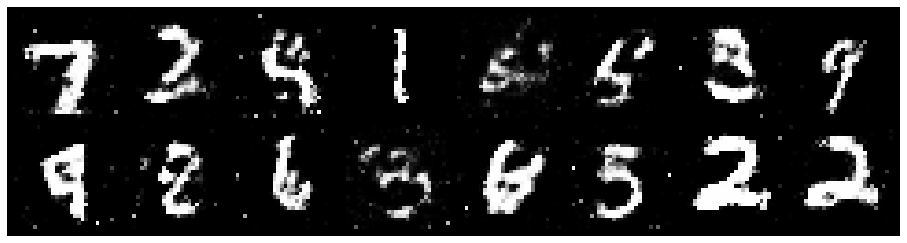

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.1592, Generator Loss: 1.1990
D(x): 0.5946, D(G(z)): 0.3900


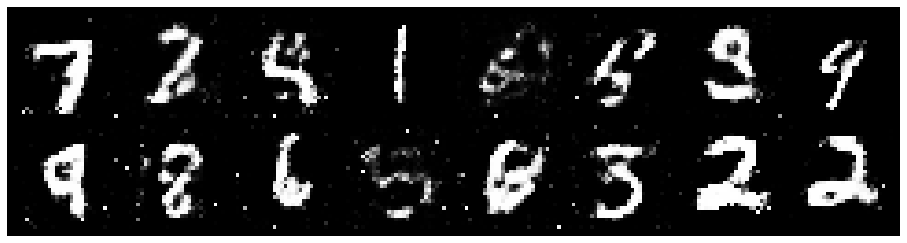

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.1618, Generator Loss: 0.8366
D(x): 0.5928, D(G(z)): 0.4218


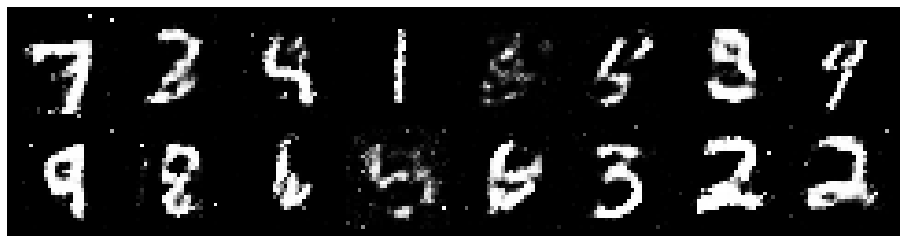

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.2967, Generator Loss: 0.9461
D(x): 0.5979, D(G(z)): 0.4744


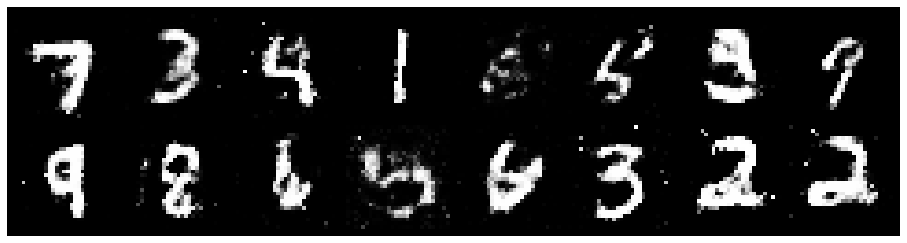

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.1680, Generator Loss: 1.0883
D(x): 0.5501, D(G(z)): 0.3764


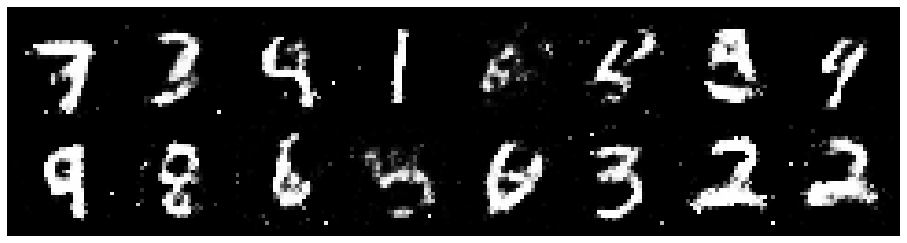

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.1015, Generator Loss: 1.2821
D(x): 0.5827, D(G(z)): 0.3396


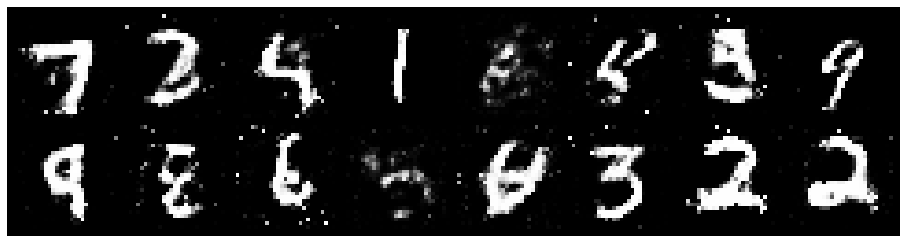

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.1993, Generator Loss: 1.2501
D(x): 0.6158, D(G(z)): 0.4291


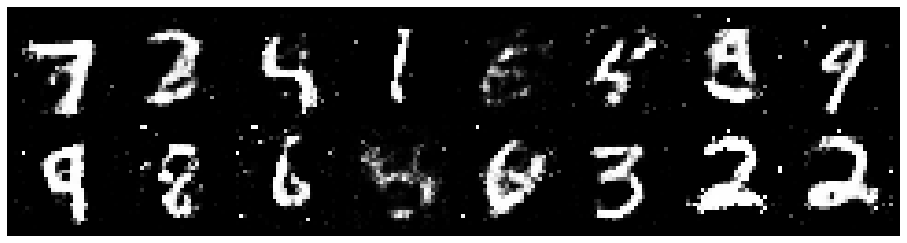

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.1958, Generator Loss: 1.0671
D(x): 0.6002, D(G(z)): 0.4253


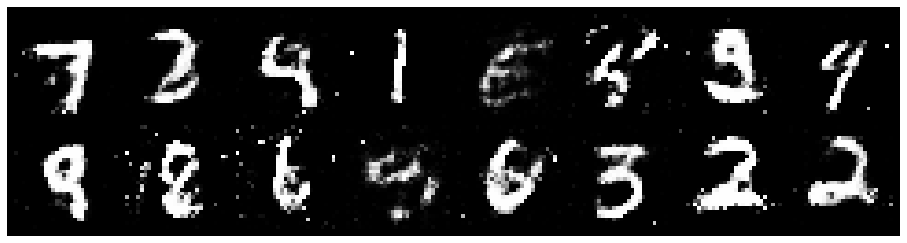

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.1638, Generator Loss: 1.0570
D(x): 0.6023, D(G(z)): 0.4078


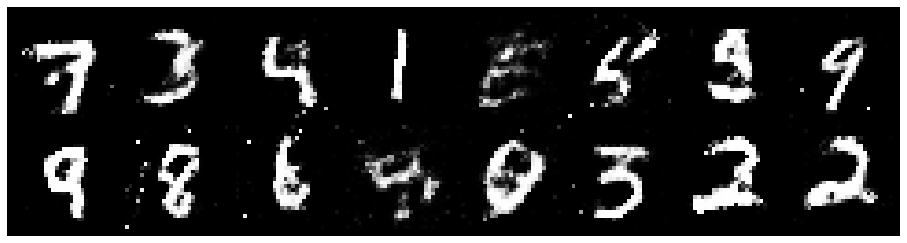

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.0969, Generator Loss: 1.1074
D(x): 0.6188, D(G(z)): 0.3921


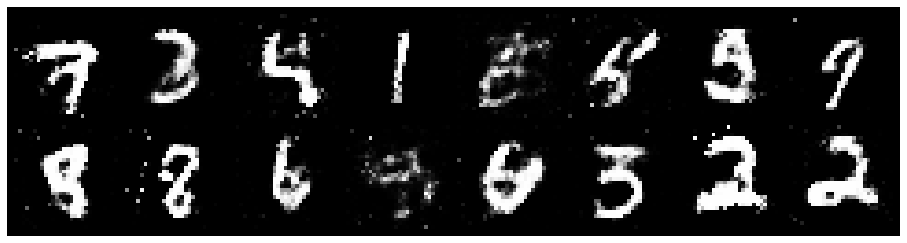

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.0599, Generator Loss: 1.2409
D(x): 0.6114, D(G(z)): 0.3573


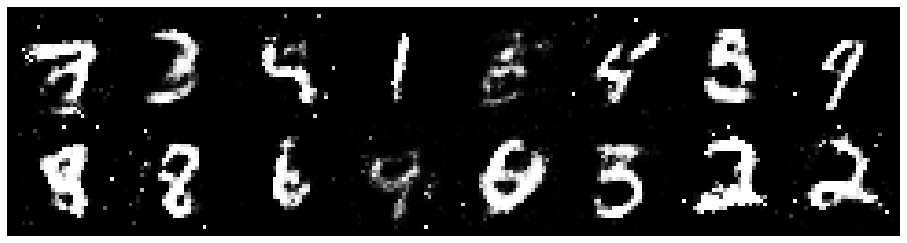

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.1264, Generator Loss: 1.0235
D(x): 0.6700, D(G(z)): 0.4315


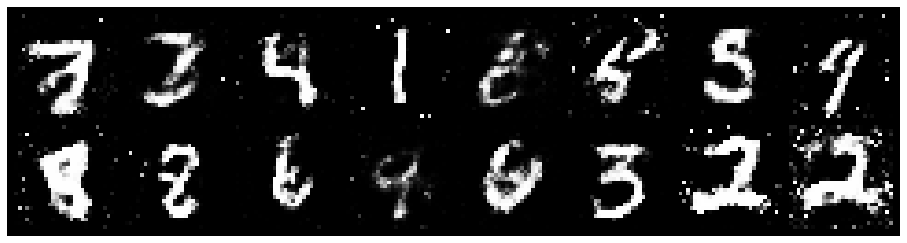

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.2041, Generator Loss: 1.0067
D(x): 0.5475, D(G(z)): 0.3955


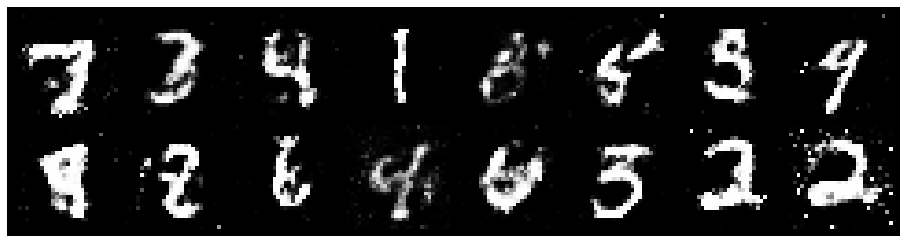

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.2766, Generator Loss: 0.9681
D(x): 0.5773, D(G(z)): 0.4357


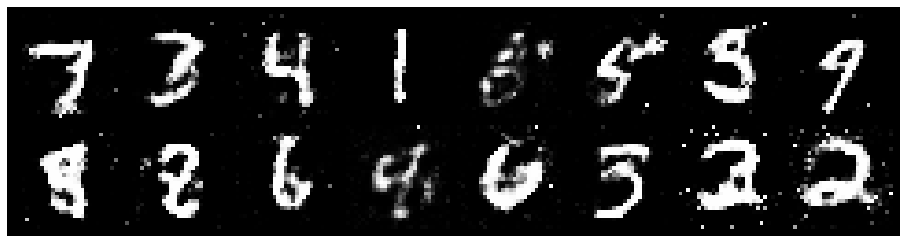

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.2901, Generator Loss: 0.9851
D(x): 0.5778, D(G(z)): 0.4696


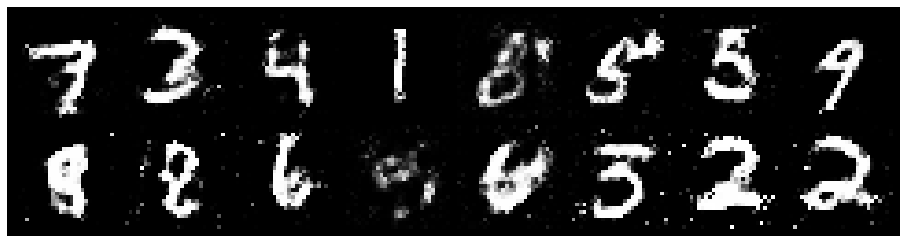

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.2113, Generator Loss: 0.9348
D(x): 0.5936, D(G(z)): 0.4507


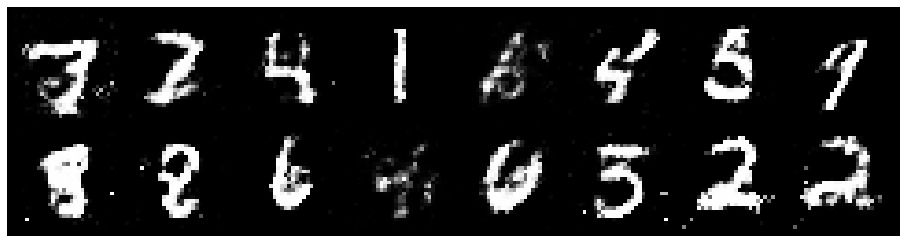

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.1663, Generator Loss: 0.9240
D(x): 0.5567, D(G(z)): 0.3931


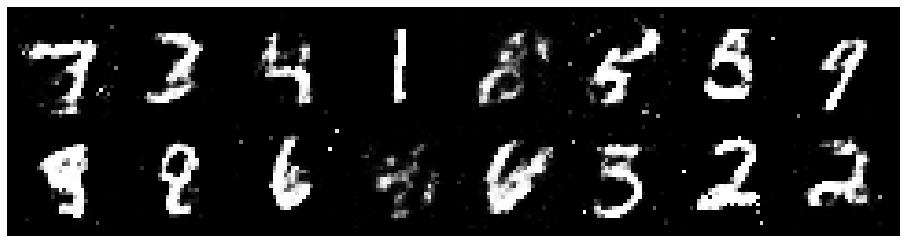

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.2156, Generator Loss: 1.1108
D(x): 0.5254, D(G(z)): 0.3566


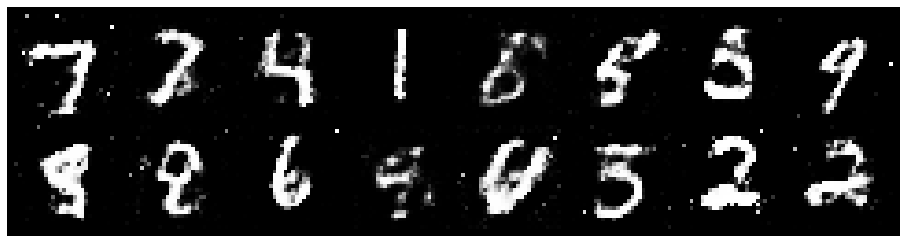

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.0534, Generator Loss: 0.9521
D(x): 0.6676, D(G(z)): 0.4003


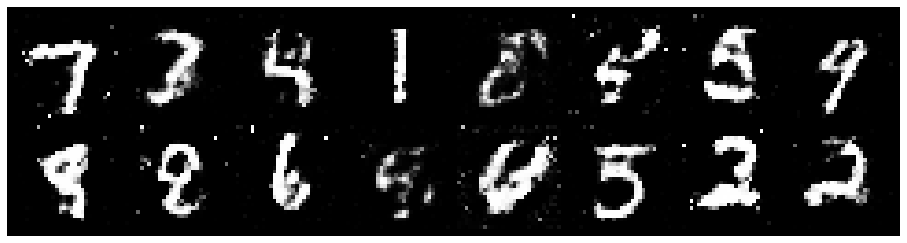

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.2279, Generator Loss: 0.8457
D(x): 0.5857, D(G(z)): 0.4488


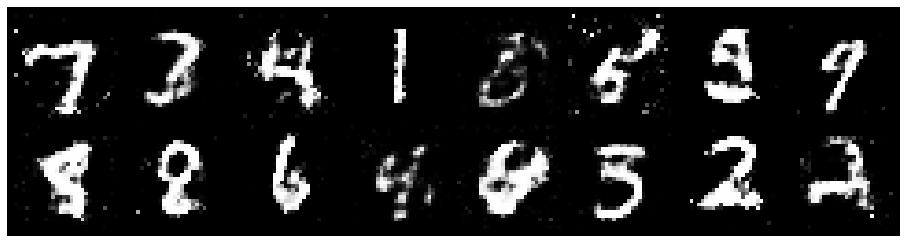

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.2556, Generator Loss: 0.8953
D(x): 0.5790, D(G(z)): 0.4484


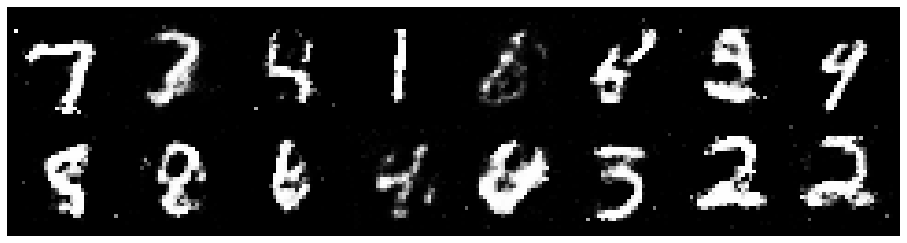

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.1991, Generator Loss: 0.9710
D(x): 0.5619, D(G(z)): 0.3956


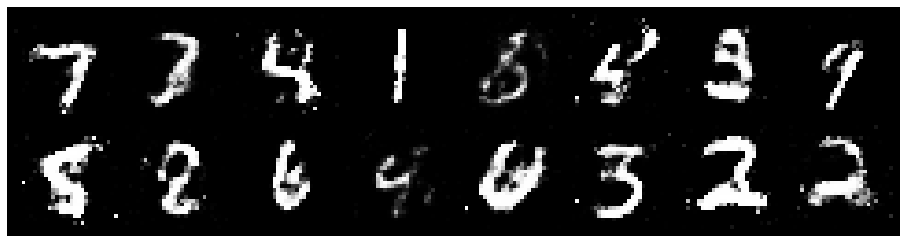

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.2133, Generator Loss: 0.9471
D(x): 0.6039, D(G(z)): 0.4333


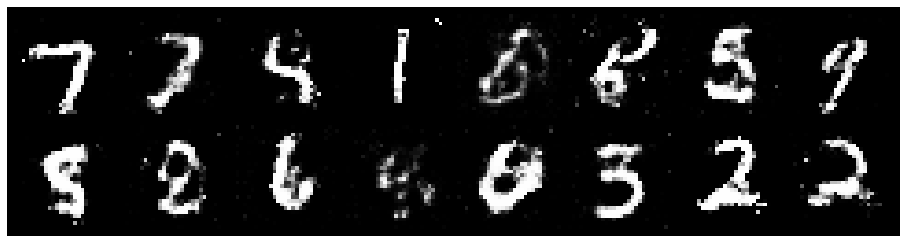

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2606, Generator Loss: 1.0043
D(x): 0.5105, D(G(z)): 0.3604


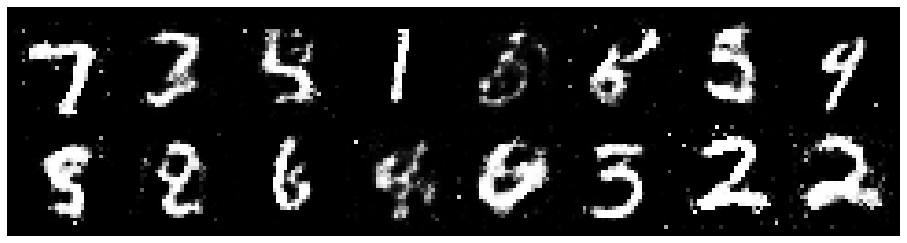

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.2221, Generator Loss: 0.9276
D(x): 0.5973, D(G(z)): 0.4442


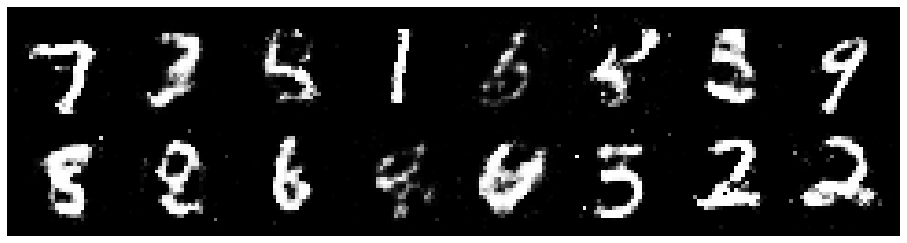

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.2685, Generator Loss: 1.3436
D(x): 0.5242, D(G(z)): 0.3426


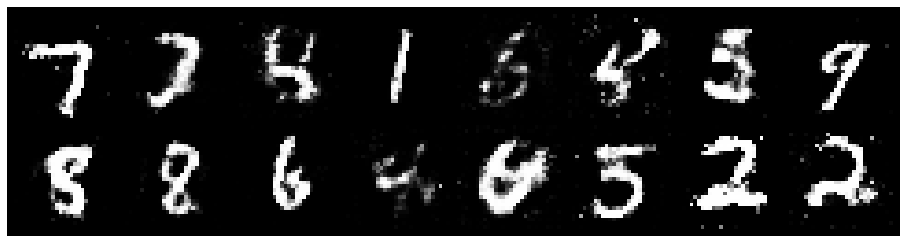

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.1396, Generator Loss: 1.2183
D(x): 0.5925, D(G(z)): 0.3573


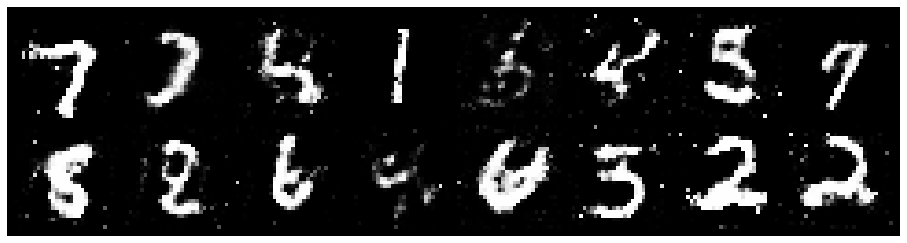

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.1081, Generator Loss: 1.0717
D(x): 0.6354, D(G(z)): 0.4213


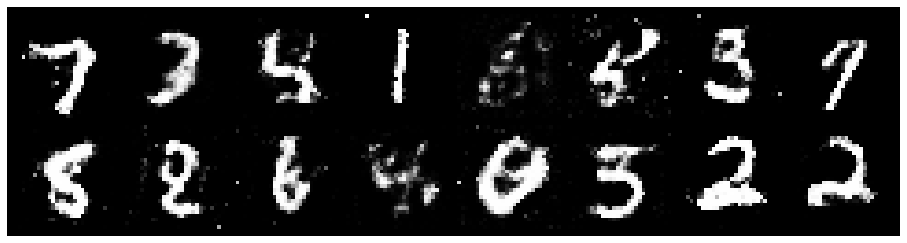

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.1436, Generator Loss: 0.9818
D(x): 0.5882, D(G(z)): 0.4125


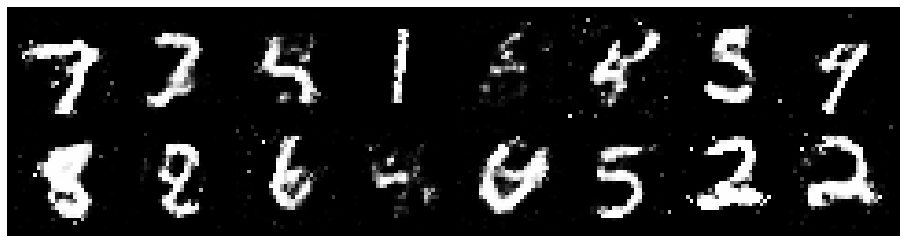

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.0698, Generator Loss: 1.0573
D(x): 0.6299, D(G(z)): 0.3977


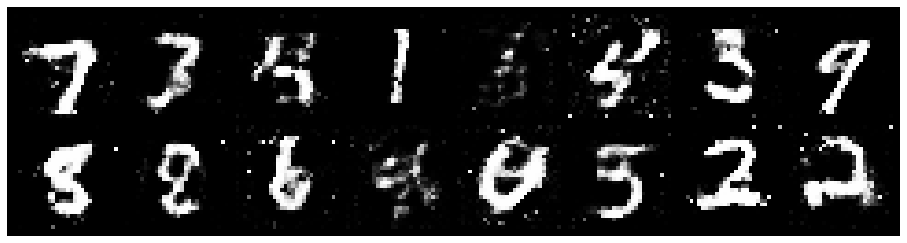

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.1287, Generator Loss: 0.9703
D(x): 0.6133, D(G(z)): 0.4160


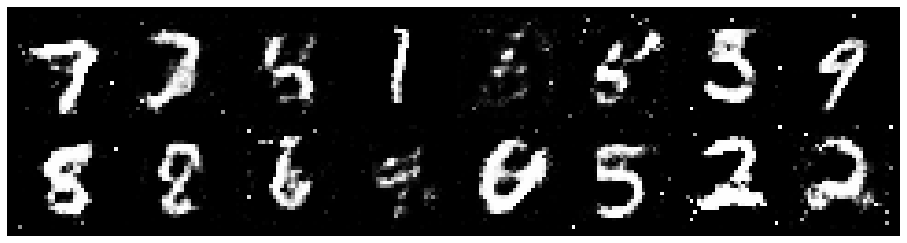

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.2301, Generator Loss: 0.8934
D(x): 0.5857, D(G(z)): 0.4218


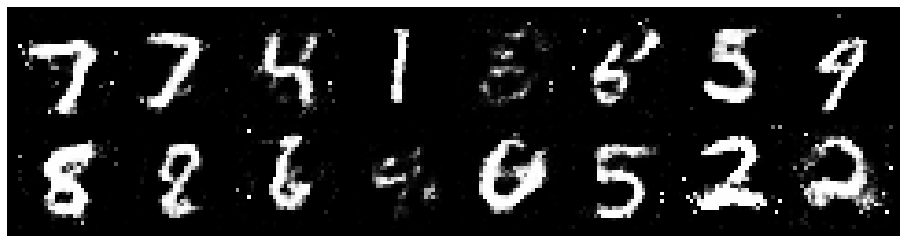

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.1945, Generator Loss: 0.8291
D(x): 0.5952, D(G(z)): 0.4347


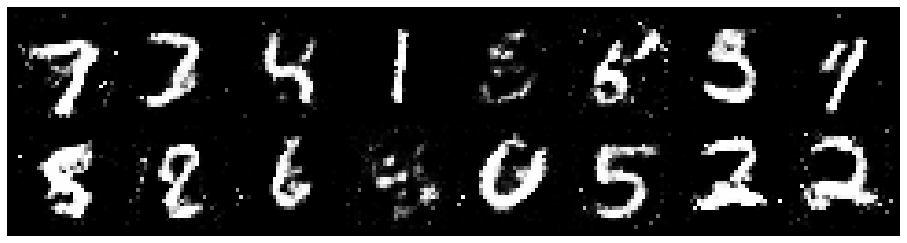

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.1802, Generator Loss: 0.9712
D(x): 0.6032, D(G(z)): 0.4169


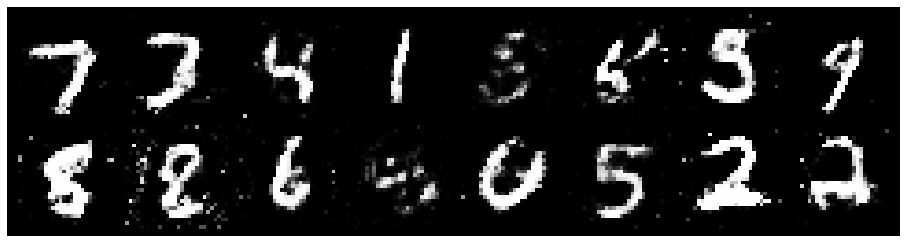

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.3186, Generator Loss: 0.8610
D(x): 0.5757, D(G(z)): 0.4945


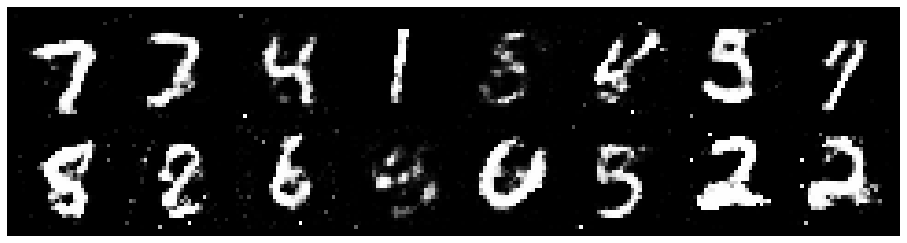

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.1808, Generator Loss: 0.9392
D(x): 0.5836, D(G(z)): 0.3885


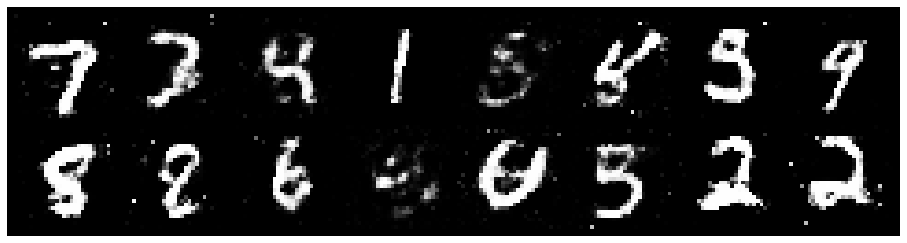

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.1967, Generator Loss: 1.0934
D(x): 0.6051, D(G(z)): 0.4365


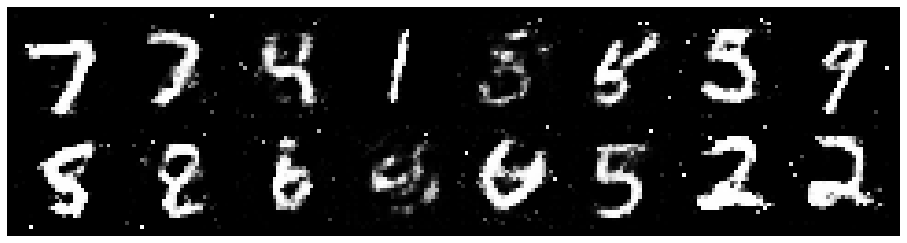

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.0951, Generator Loss: 1.0966
D(x): 0.6077, D(G(z)): 0.3897


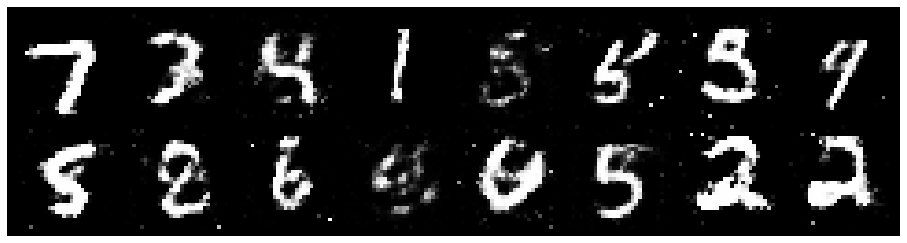

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.2646, Generator Loss: 1.1049
D(x): 0.5696, D(G(z)): 0.4115


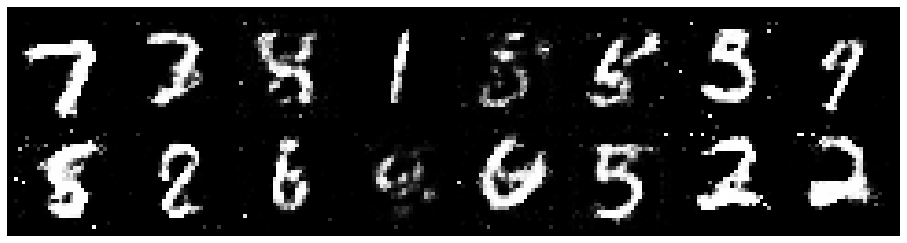

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.1704, Generator Loss: 1.0343
D(x): 0.5665, D(G(z)): 0.3796


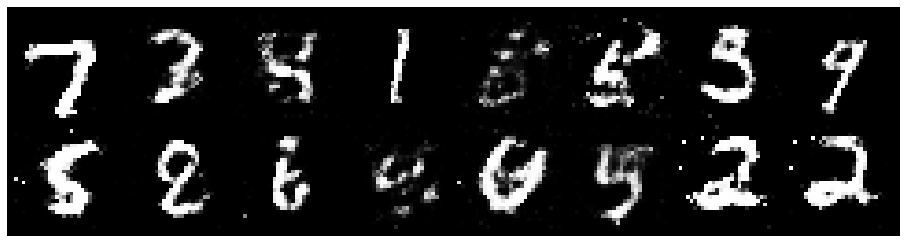

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.1780, Generator Loss: 0.9474
D(x): 0.6235, D(G(z)): 0.4149


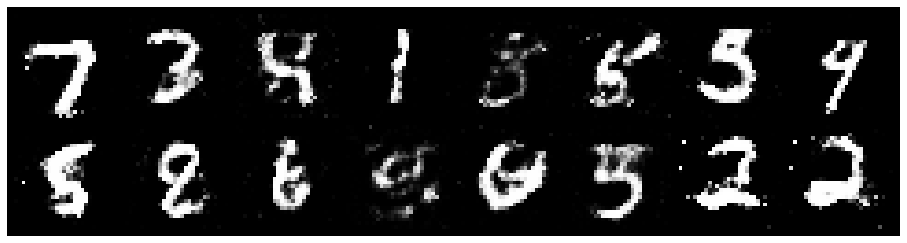

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.1968, Generator Loss: 0.9134
D(x): 0.6488, D(G(z)): 0.4477


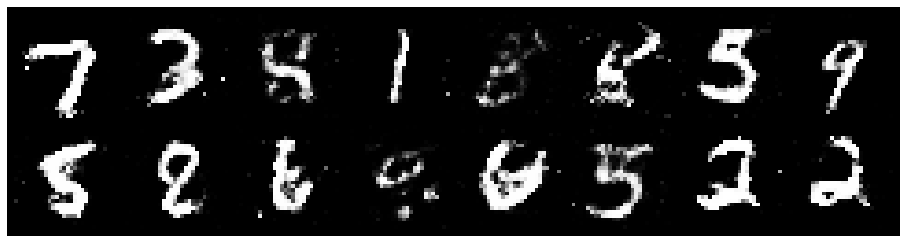

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.0496, Generator Loss: 1.0228
D(x): 0.6203, D(G(z)): 0.3734


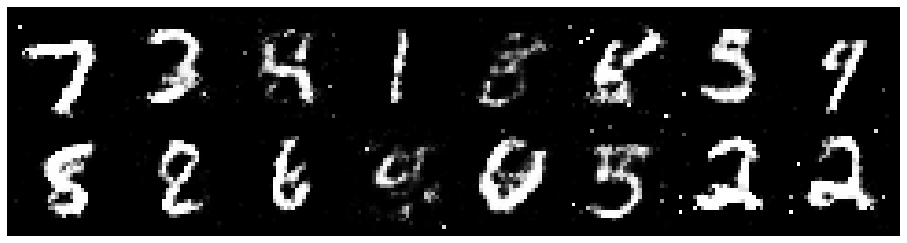

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.2202, Generator Loss: 1.1328
D(x): 0.5630, D(G(z)): 0.4058


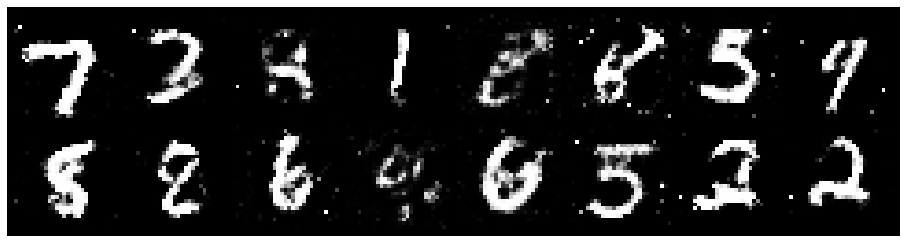

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.1779, Generator Loss: 0.9924
D(x): 0.5629, D(G(z)): 0.3906


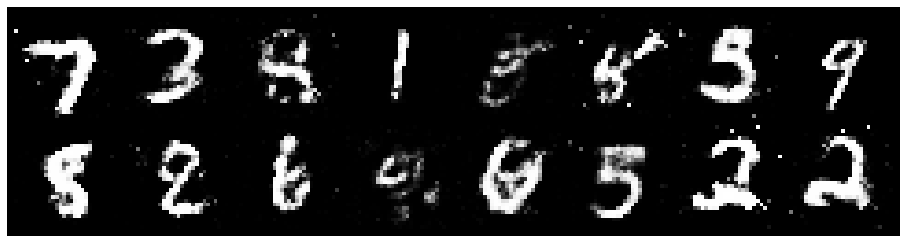

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.0751, Generator Loss: 1.0122
D(x): 0.5976, D(G(z)): 0.3398


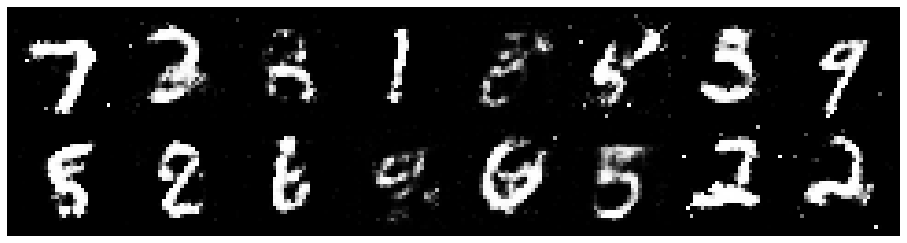

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.0627, Generator Loss: 1.0705
D(x): 0.6165, D(G(z)): 0.3805


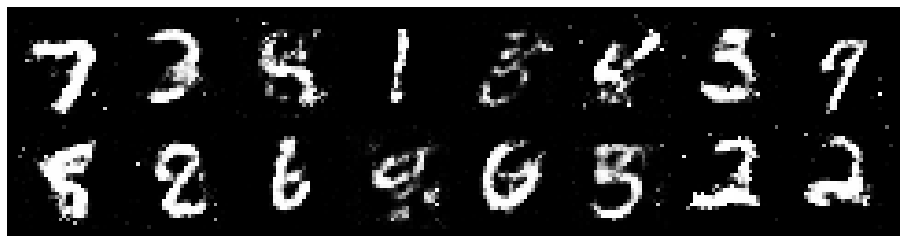

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.0463, Generator Loss: 1.1243
D(x): 0.6048, D(G(z)): 0.3496


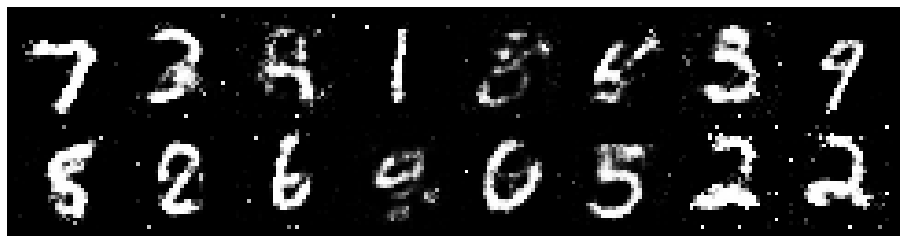

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.2650, Generator Loss: 0.8736
D(x): 0.5729, D(G(z)): 0.4600


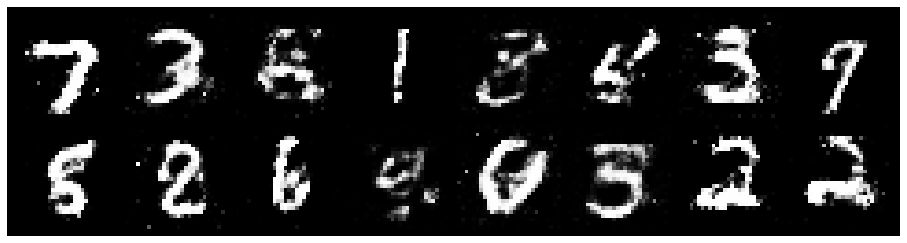

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.2506, Generator Loss: 0.9068
D(x): 0.5642, D(G(z)): 0.4474


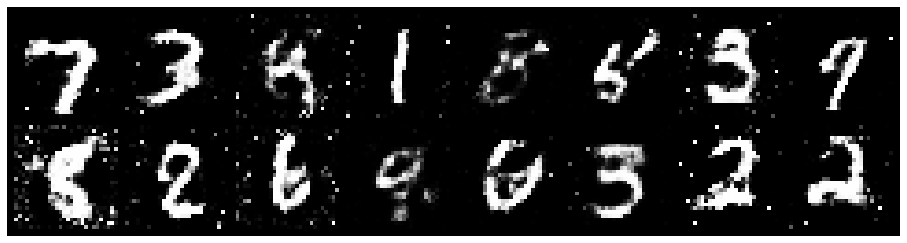

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.2985, Generator Loss: 1.0104
D(x): 0.5302, D(G(z)): 0.4353


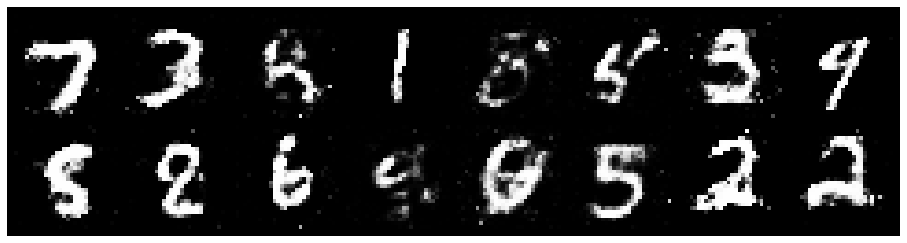

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.1920, Generator Loss: 0.9286
D(x): 0.5986, D(G(z)): 0.4393


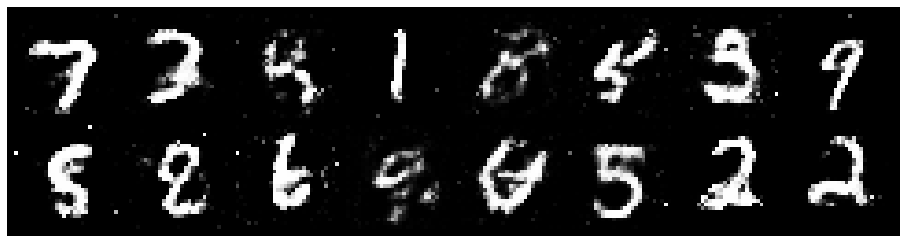

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.1958, Generator Loss: 0.9909
D(x): 0.6029, D(G(z)): 0.4305


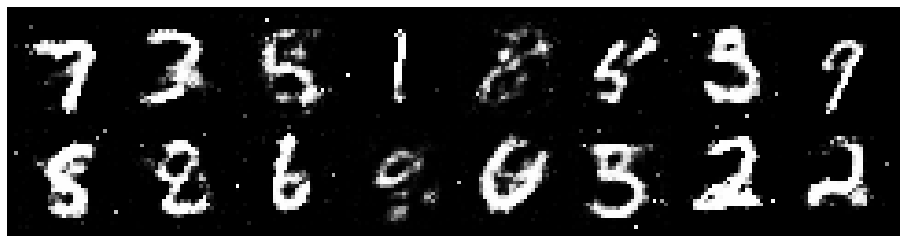

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.2856, Generator Loss: 0.8301
D(x): 0.5927, D(G(z)): 0.4524


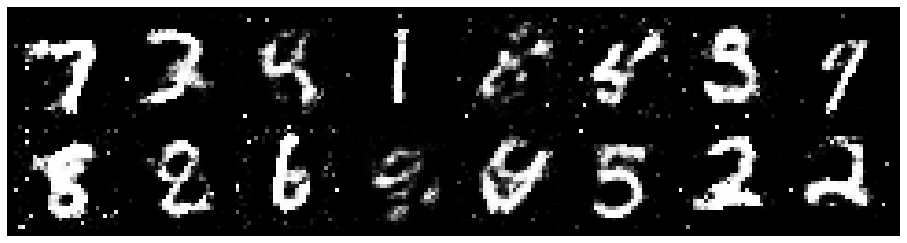

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.1145, Generator Loss: 1.2017
D(x): 0.6016, D(G(z)): 0.3866


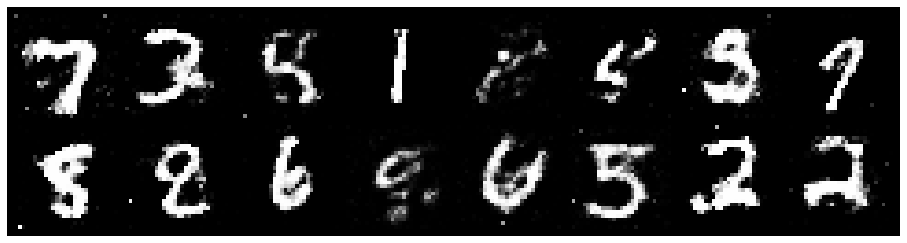

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.2165, Generator Loss: 0.9333
D(x): 0.5926, D(G(z)): 0.4133


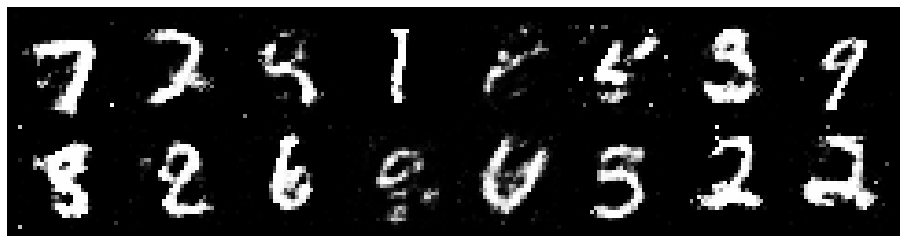

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.2555, Generator Loss: 1.2532
D(x): 0.5725, D(G(z)): 0.4310


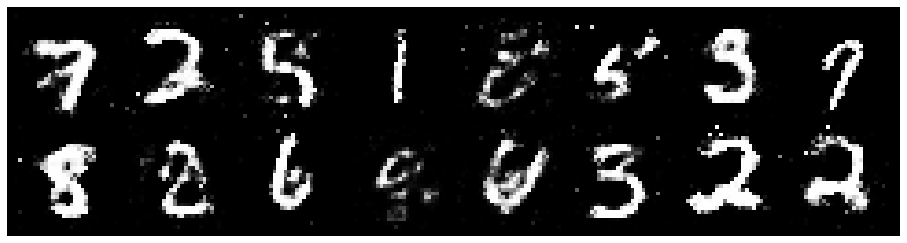

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.2219, Generator Loss: 1.0987
D(x): 0.5559, D(G(z)): 0.4061


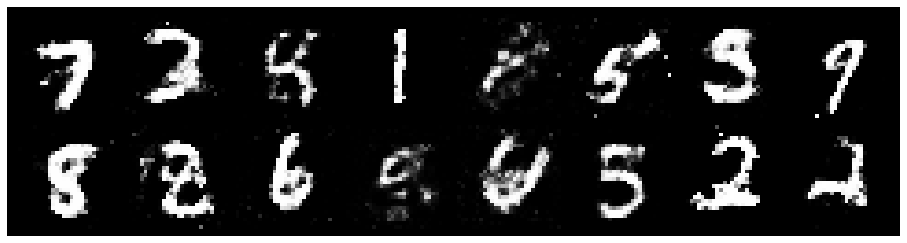

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2350, Generator Loss: 0.9767
D(x): 0.5531, D(G(z)): 0.4151


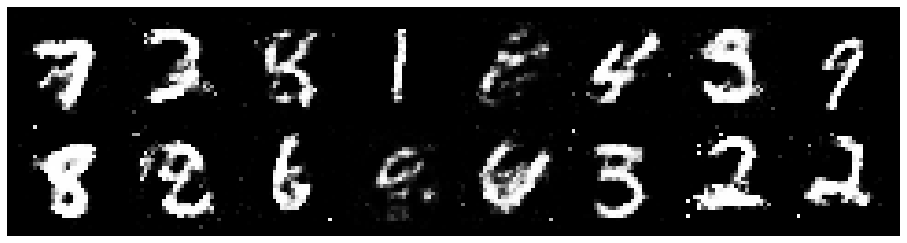

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.1840, Generator Loss: 0.7799
D(x): 0.6128, D(G(z)): 0.4471


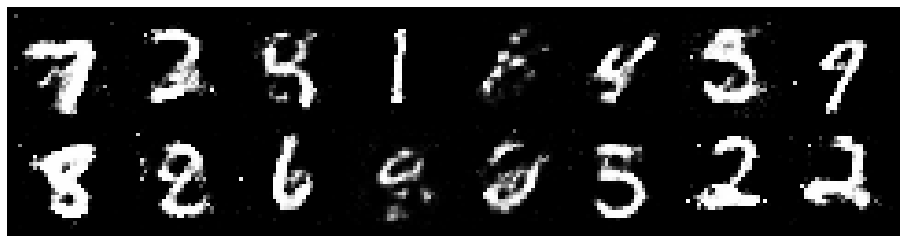

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2871, Generator Loss: 0.9840
D(x): 0.5719, D(G(z)): 0.4150


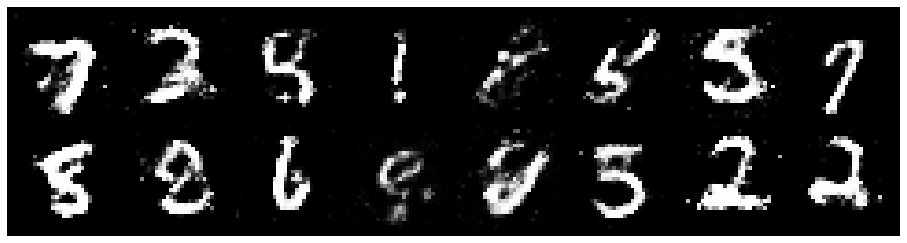

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.2662, Generator Loss: 0.9277
D(x): 0.5497, D(G(z)): 0.3908


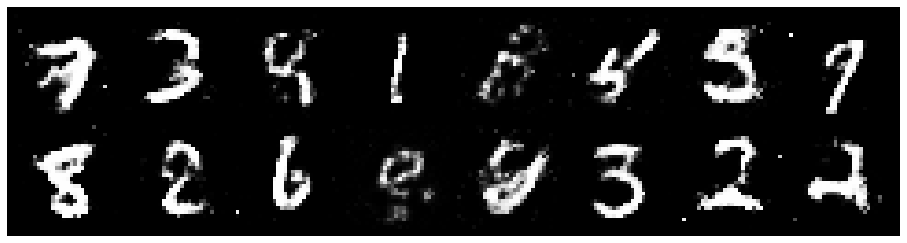

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.3275, Generator Loss: 1.0369
D(x): 0.5382, D(G(z)): 0.4394


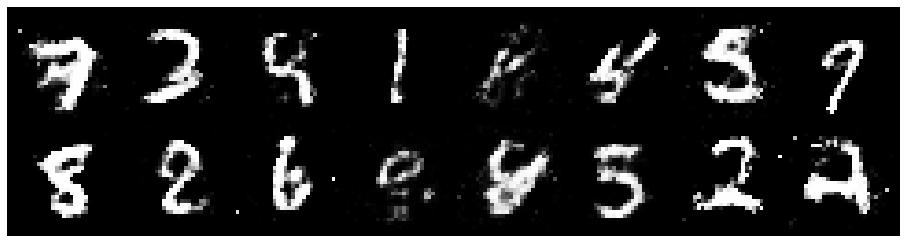

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.3732, Generator Loss: 0.9384
D(x): 0.4984, D(G(z)): 0.4362


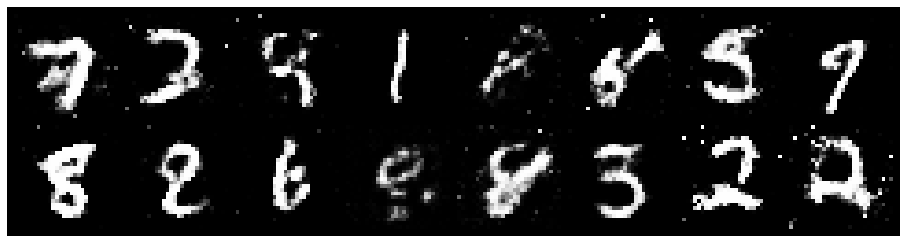

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.2448, Generator Loss: 1.1018
D(x): 0.5488, D(G(z)): 0.3721


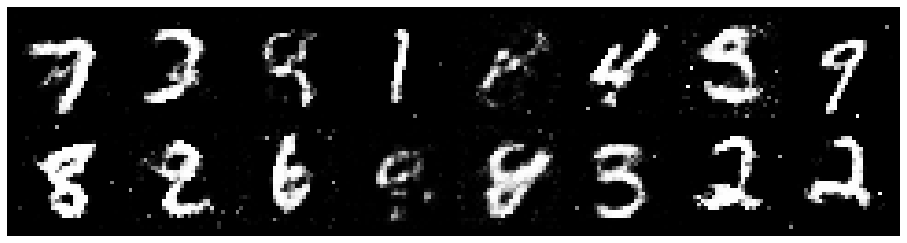

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.1628, Generator Loss: 1.0621
D(x): 0.5891, D(G(z)): 0.4022


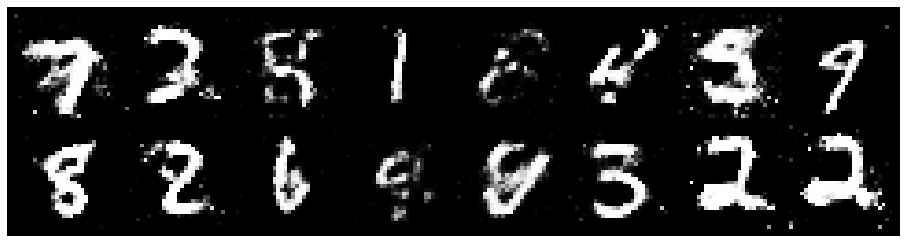

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.2316, Generator Loss: 1.1399
D(x): 0.5791, D(G(z)): 0.4238


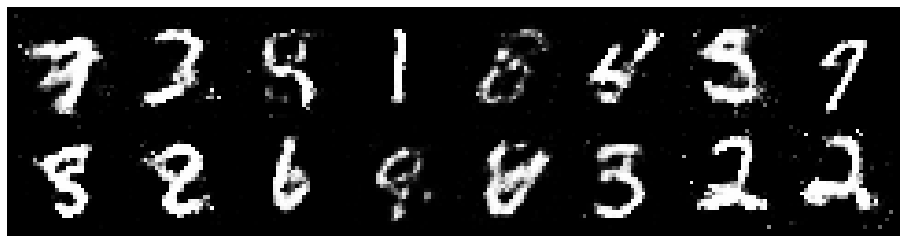

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.2983, Generator Loss: 0.9966
D(x): 0.5411, D(G(z)): 0.4291


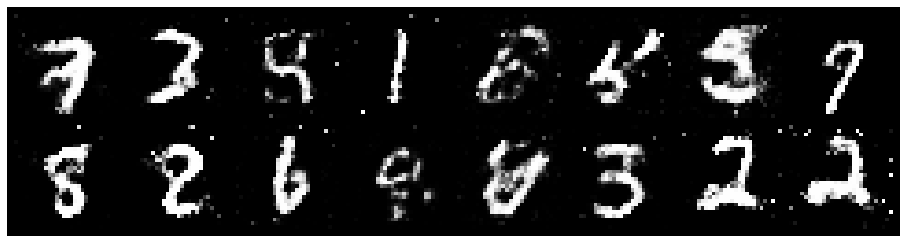

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.2398, Generator Loss: 1.0047
D(x): 0.5488, D(G(z)): 0.3978


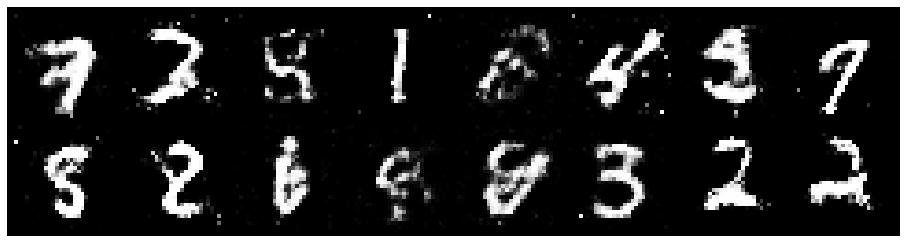

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.2201, Generator Loss: 0.8812
D(x): 0.5771, D(G(z)): 0.4449


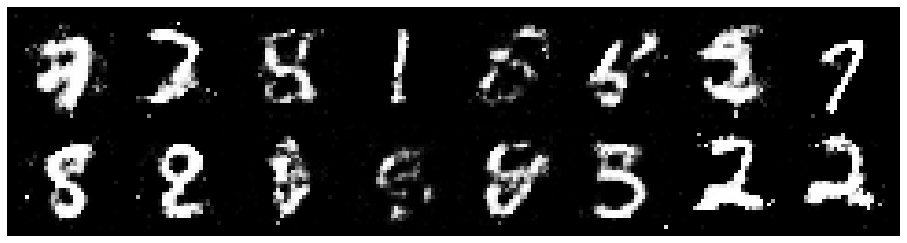

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.1168, Generator Loss: 0.9302
D(x): 0.6454, D(G(z)): 0.4451


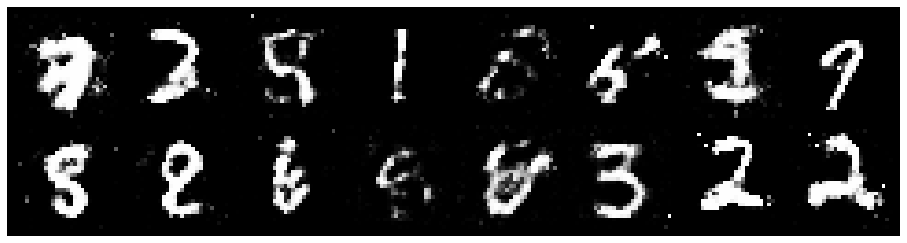

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.2195, Generator Loss: 1.3126
D(x): 0.5363, D(G(z)): 0.3412


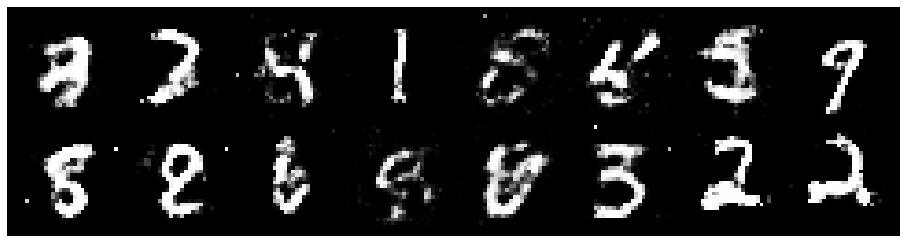

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.0792, Generator Loss: 1.0578
D(x): 0.5825, D(G(z)): 0.3449


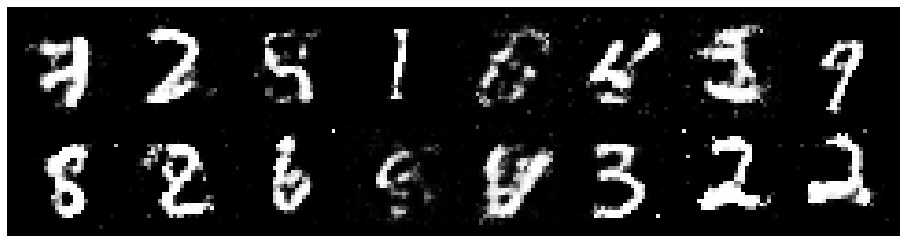

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.1340, Generator Loss: 1.1253
D(x): 0.6479, D(G(z)): 0.4255


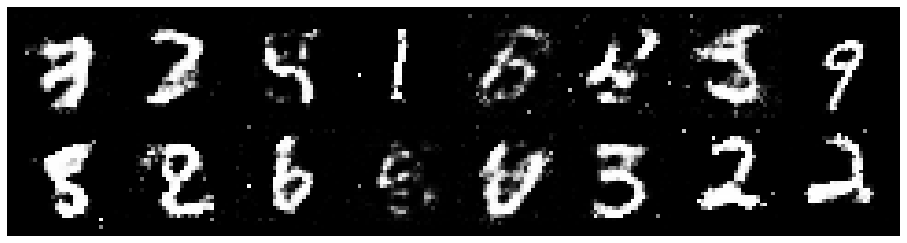

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.0272, Generator Loss: 1.1088
D(x): 0.6375, D(G(z)): 0.3753


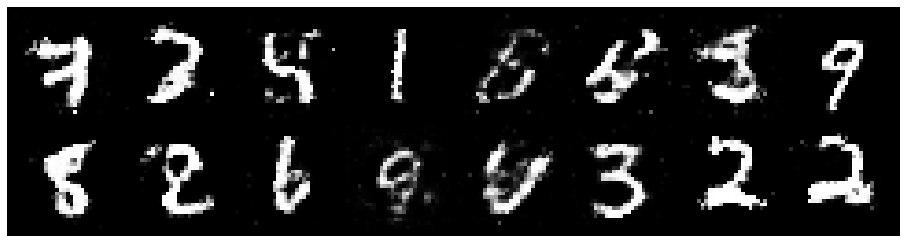

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.0512, Generator Loss: 1.0908
D(x): 0.6866, D(G(z)): 0.4239


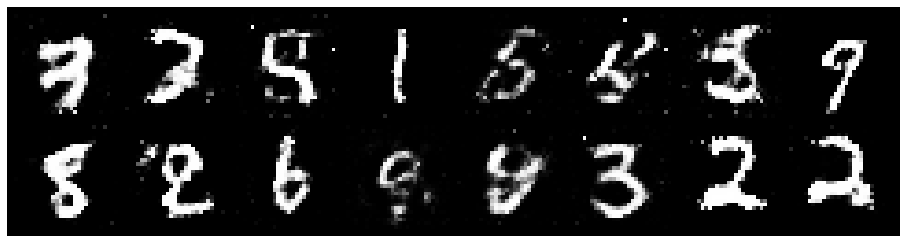

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.1658, Generator Loss: 0.8680
D(x): 0.6064, D(G(z)): 0.4314


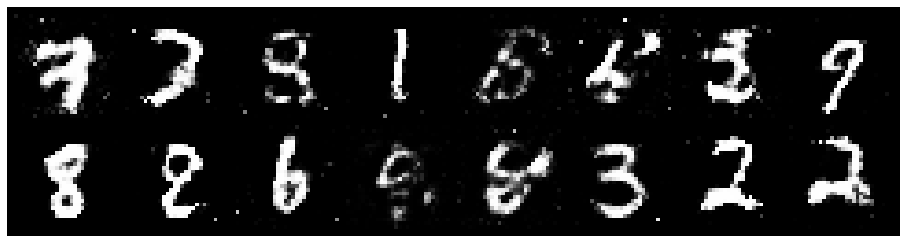

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.2442, Generator Loss: 1.0616
D(x): 0.5314, D(G(z)): 0.4018


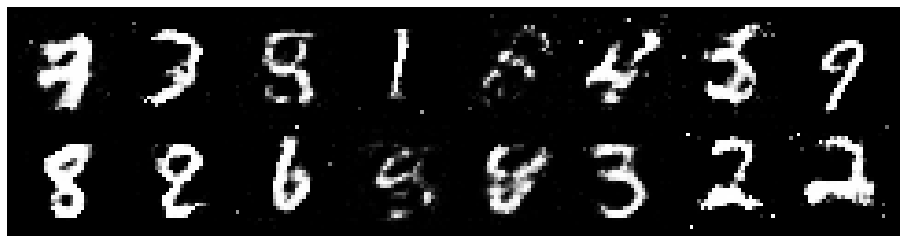

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.2548, Generator Loss: 0.9186
D(x): 0.5764, D(G(z)): 0.4519


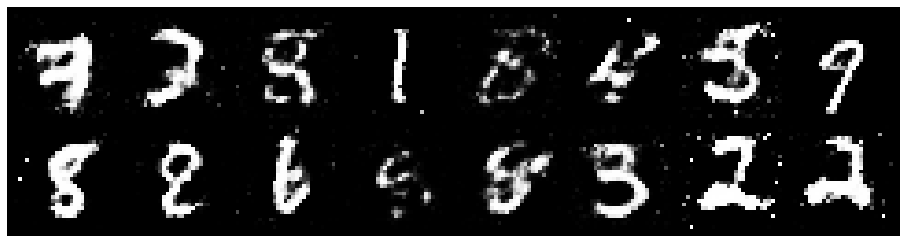

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.1751, Generator Loss: 0.9708
D(x): 0.6476, D(G(z)): 0.4628


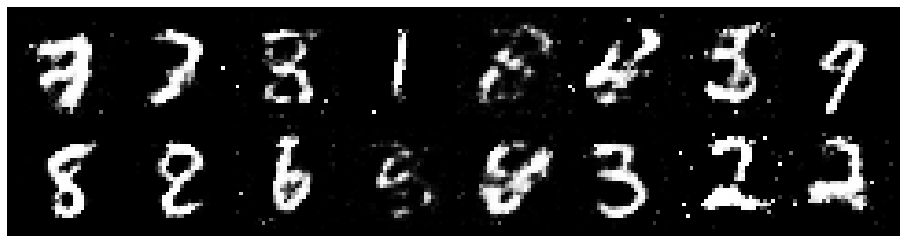

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 0.9894, Generator Loss: 1.0156
D(x): 0.6419, D(G(z)): 0.3434


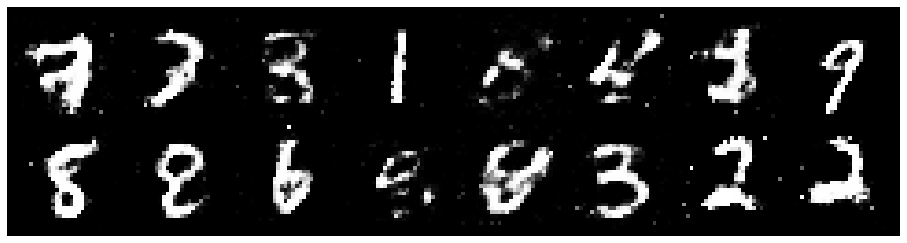

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.1320, Generator Loss: 0.9935
D(x): 0.5853, D(G(z)): 0.4032


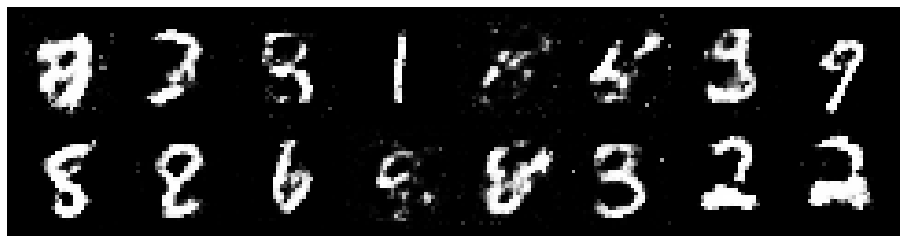

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.2293, Generator Loss: 0.8336
D(x): 0.5748, D(G(z)): 0.4546


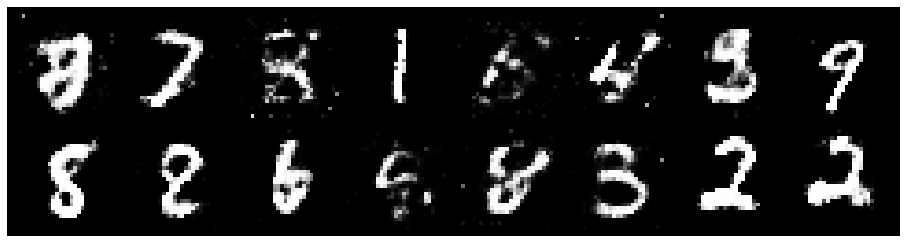

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.1995, Generator Loss: 1.0031
D(x): 0.5950, D(G(z)): 0.4418


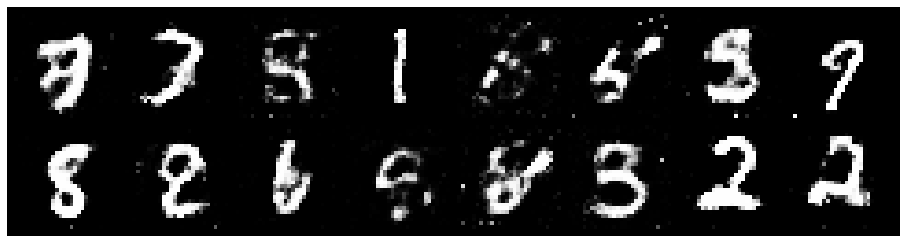

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.1445, Generator Loss: 0.9217
D(x): 0.6081, D(G(z)): 0.4156


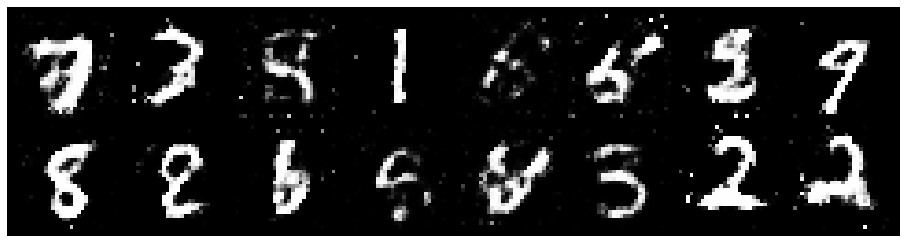

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.2911, Generator Loss: 1.0637
D(x): 0.5886, D(G(z)): 0.4376


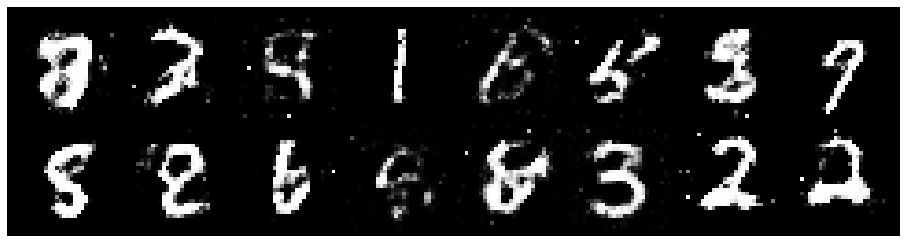

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.1925, Generator Loss: 1.2330
D(x): 0.5730, D(G(z)): 0.3795


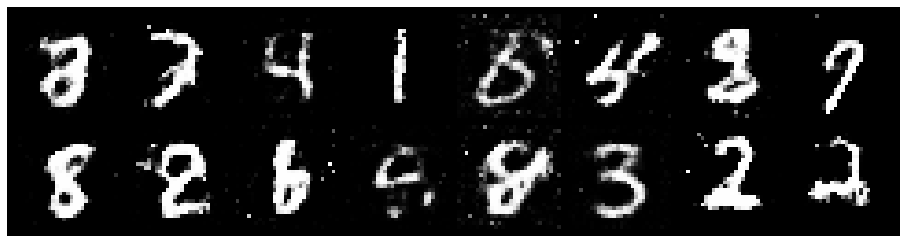

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.1053, Generator Loss: 1.1924
D(x): 0.5888, D(G(z)): 0.3513


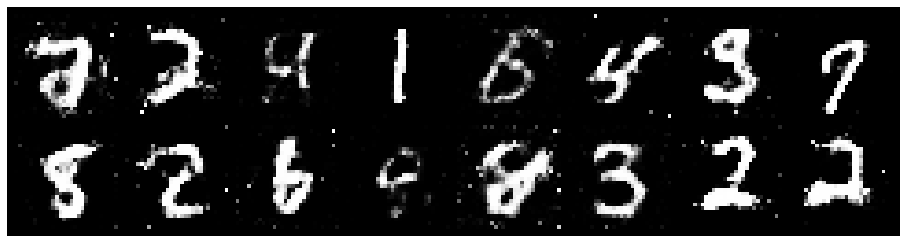

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1020, Generator Loss: 1.0388
D(x): 0.5680, D(G(z)): 0.3606


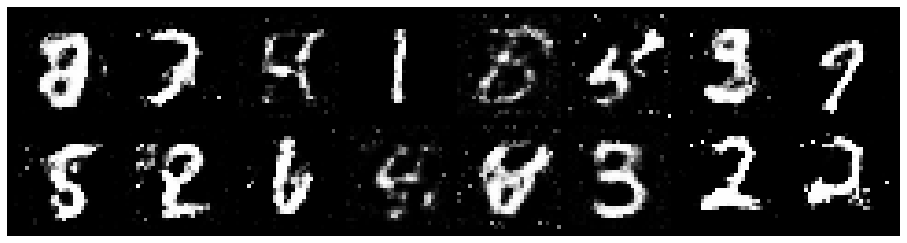

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.1300, Generator Loss: 1.1660
D(x): 0.5573, D(G(z)): 0.3593


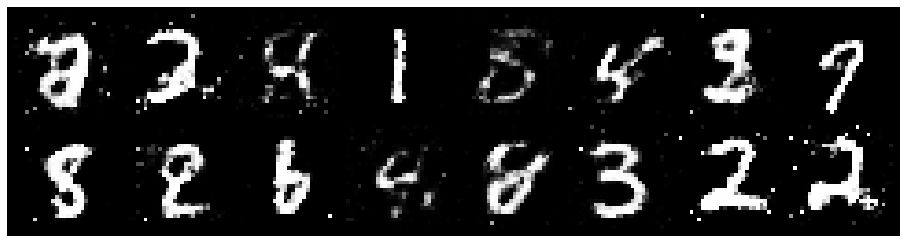

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.0971, Generator Loss: 1.1482
D(x): 0.5996, D(G(z)): 0.3596


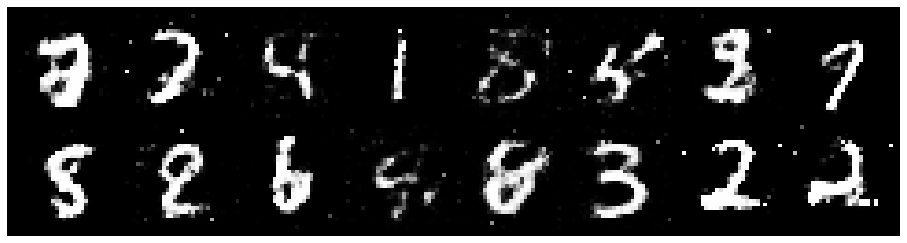

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.2018, Generator Loss: 1.1405
D(x): 0.5839, D(G(z)): 0.4114


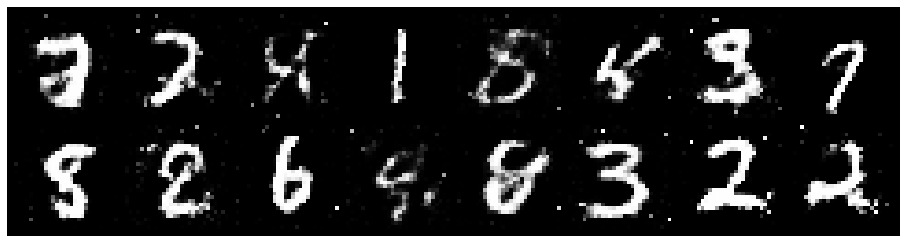

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.2236, Generator Loss: 0.9058
D(x): 0.5709, D(G(z)): 0.4171


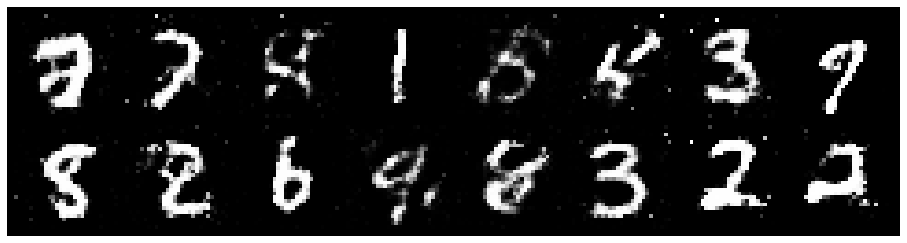

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.2201, Generator Loss: 1.0456
D(x): 0.5850, D(G(z)): 0.4280


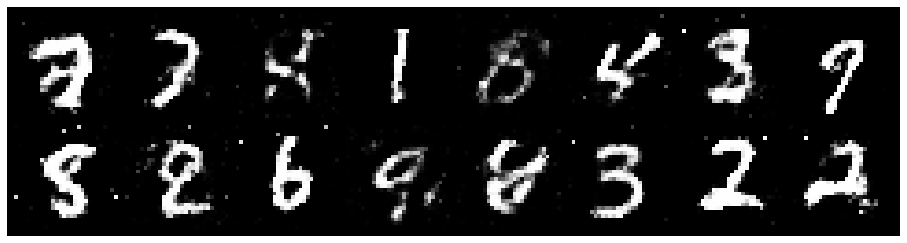

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.2103, Generator Loss: 0.9373
D(x): 0.6275, D(G(z)): 0.4599


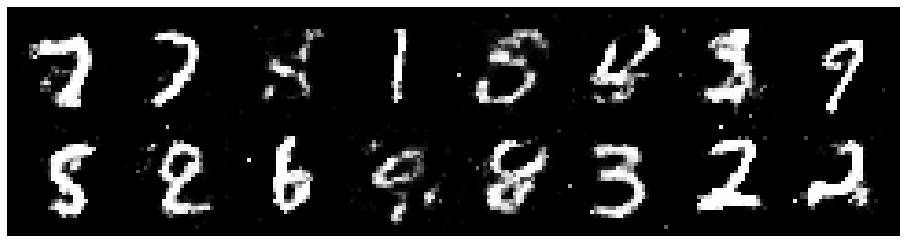

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.1440, Generator Loss: 1.2133
D(x): 0.6177, D(G(z)): 0.3956


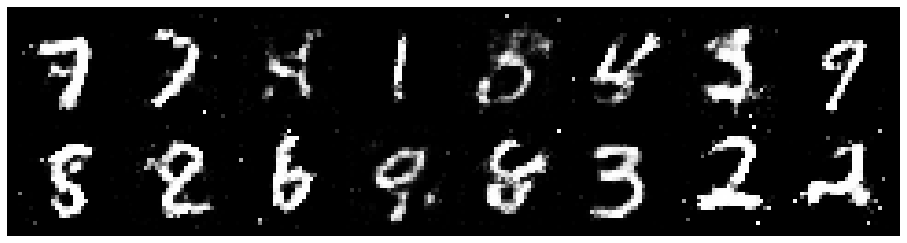

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.1738, Generator Loss: 1.1935
D(x): 0.5588, D(G(z)): 0.3734


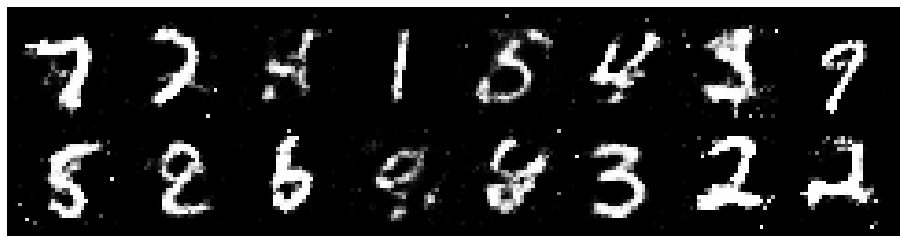

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.1400, Generator Loss: 1.0570
D(x): 0.6058, D(G(z)): 0.4018


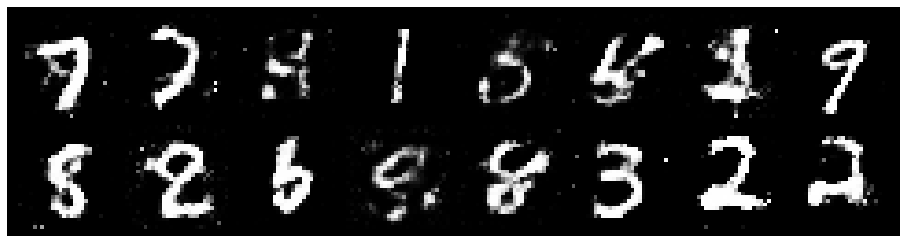

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.1046, Generator Loss: 0.9218
D(x): 0.6564, D(G(z)): 0.3933


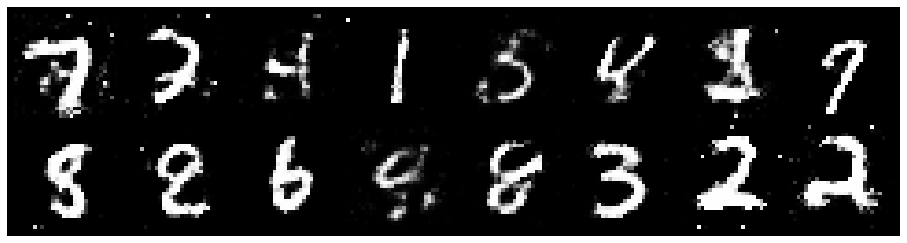

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.0780, Generator Loss: 1.0127
D(x): 0.6431, D(G(z)): 0.4097


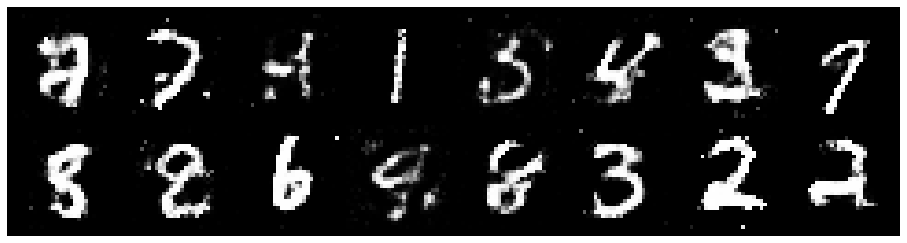

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.3667, Generator Loss: 0.8020
D(x): 0.5596, D(G(z)): 0.4895


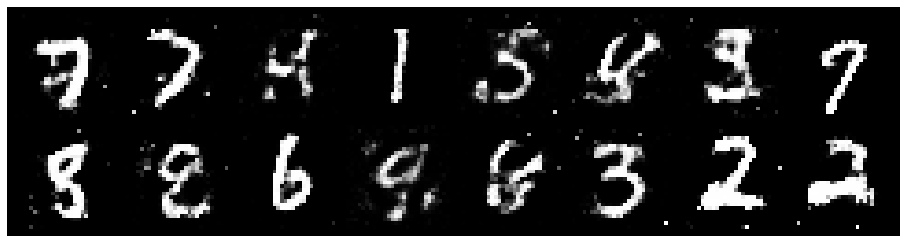

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.2474, Generator Loss: 1.1314
D(x): 0.5811, D(G(z)): 0.4282


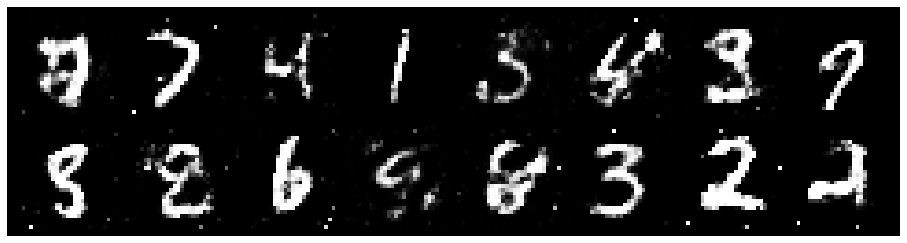

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.2450, Generator Loss: 1.1395
D(x): 0.5854, D(G(z)): 0.4225


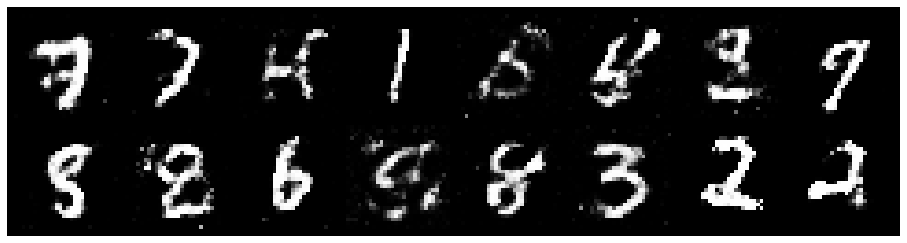

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.2542, Generator Loss: 0.9847
D(x): 0.5350, D(G(z)): 0.4048


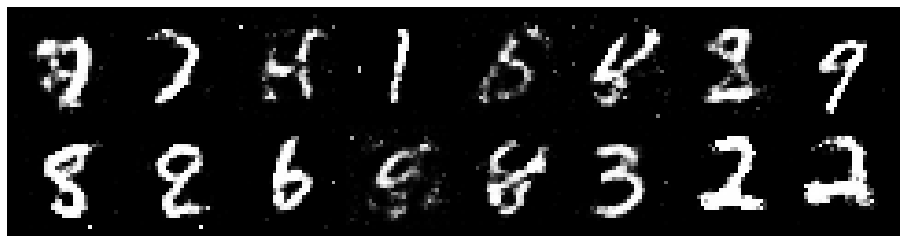

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.2421, Generator Loss: 0.9528
D(x): 0.5462, D(G(z)): 0.3908


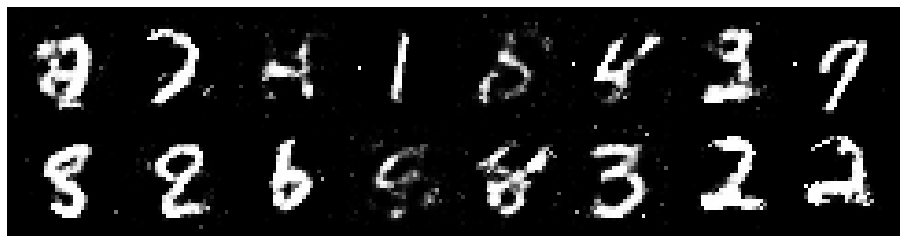

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.1328, Generator Loss: 1.1134
D(x): 0.6402, D(G(z)): 0.4045


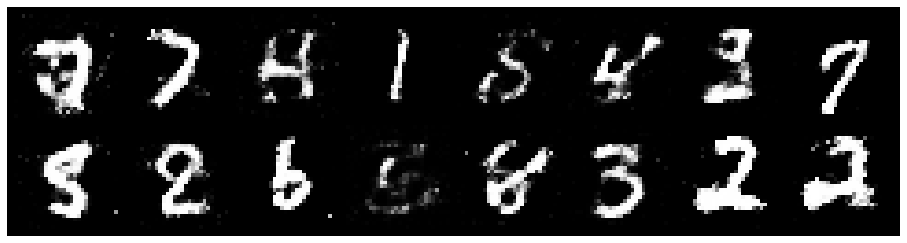

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.2639, Generator Loss: 1.0061
D(x): 0.5591, D(G(z)): 0.4291


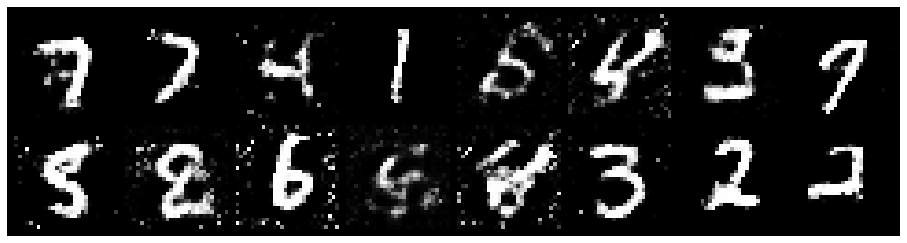

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.2786, Generator Loss: 1.1101
D(x): 0.5952, D(G(z)): 0.4547


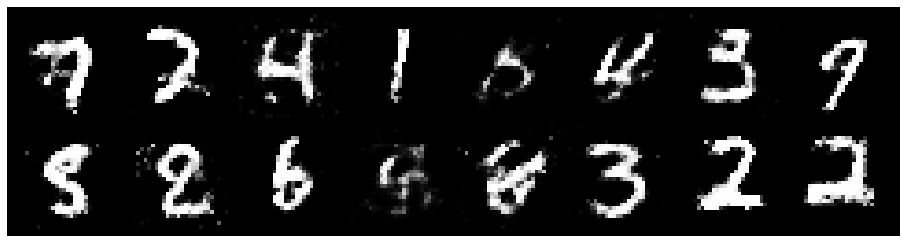

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.1807, Generator Loss: 0.8390
D(x): 0.6015, D(G(z)): 0.4586


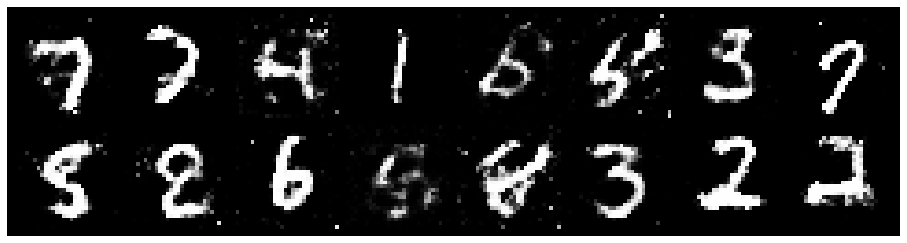

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.2763, Generator Loss: 0.9856
D(x): 0.5496, D(G(z)): 0.4280


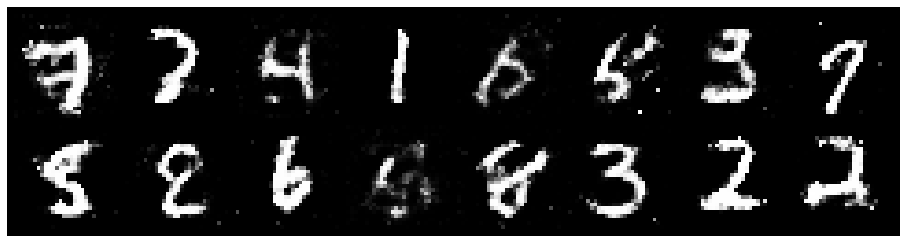

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.2484, Generator Loss: 0.9164
D(x): 0.6176, D(G(z)): 0.4720


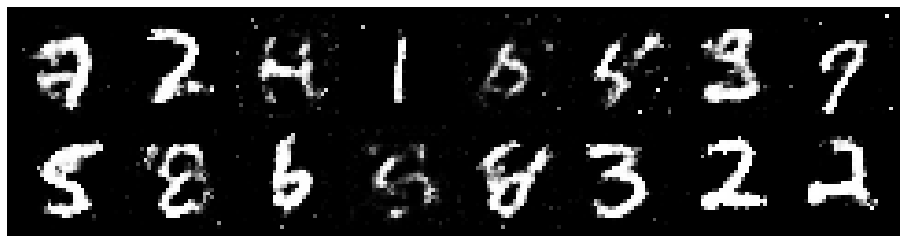

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.3259, Generator Loss: 0.8865
D(x): 0.5807, D(G(z)): 0.4863


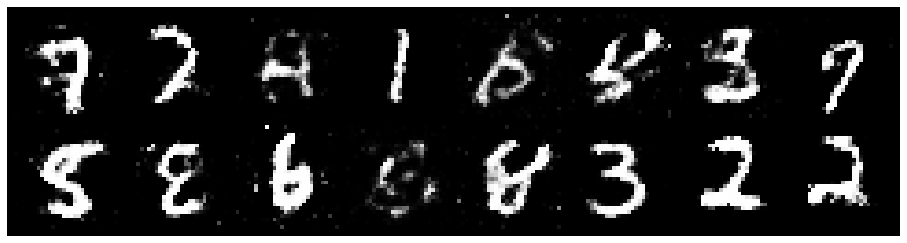

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.2352, Generator Loss: 0.9037
D(x): 0.6337, D(G(z)): 0.4779


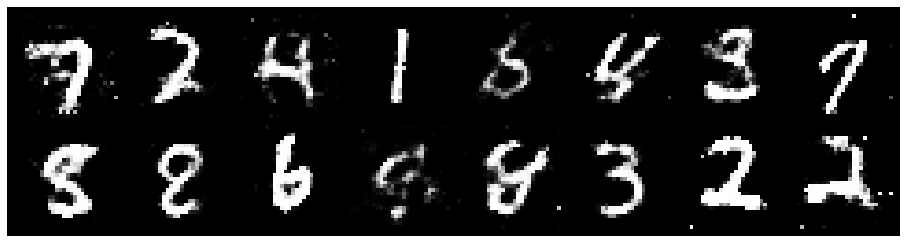

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.2280, Generator Loss: 1.0145
D(x): 0.6039, D(G(z)): 0.4511


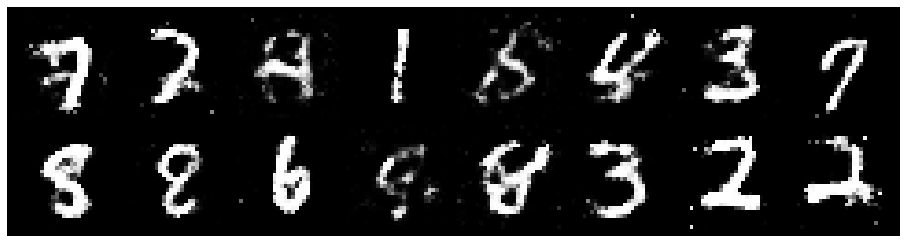

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.1431, Generator Loss: 1.0215
D(x): 0.5844, D(G(z)): 0.3849


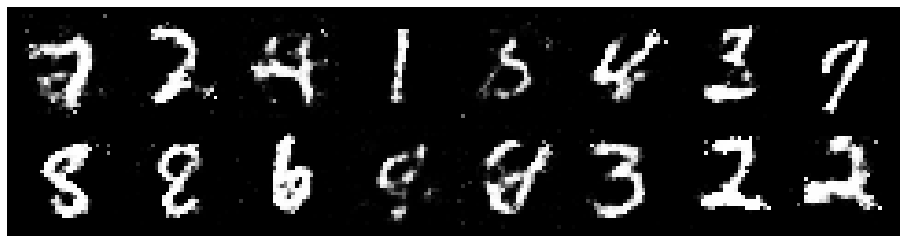

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.3713, Generator Loss: 1.0024
D(x): 0.4739, D(G(z)): 0.3994


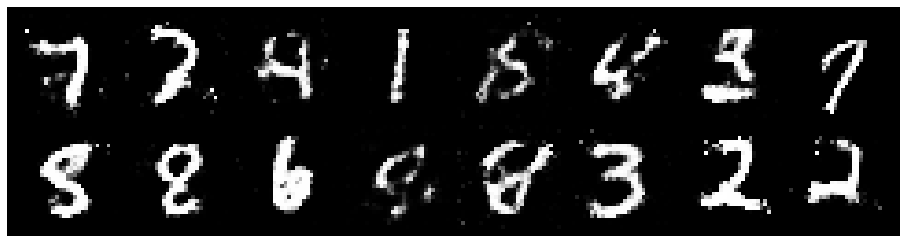

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.2450, Generator Loss: 0.8800
D(x): 0.5458, D(G(z)): 0.4237


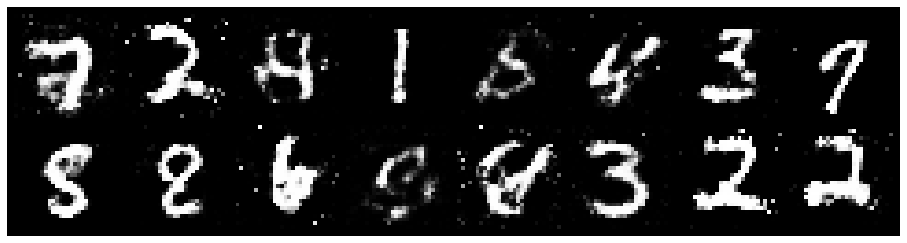

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.2615, Generator Loss: 0.7900
D(x): 0.5675, D(G(z)): 0.4687


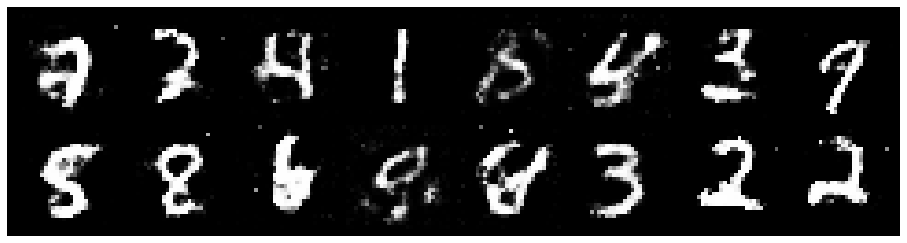

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.3360, Generator Loss: 0.9794
D(x): 0.5228, D(G(z)): 0.3970


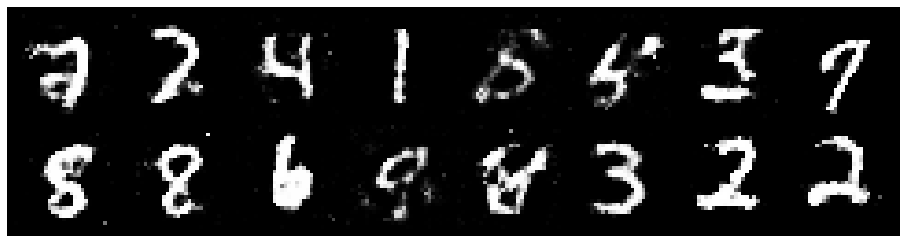

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.1576, Generator Loss: 0.9038
D(x): 0.6245, D(G(z)): 0.4336


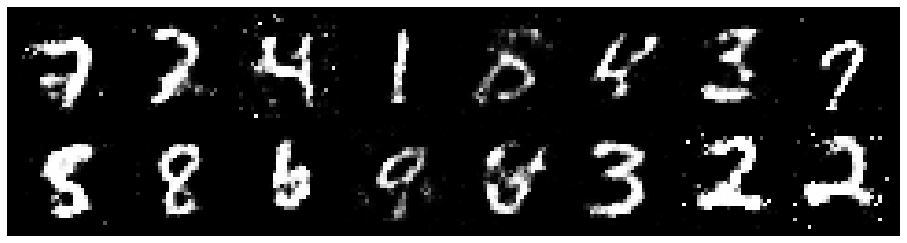

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.2312, Generator Loss: 1.0081
D(x): 0.5349, D(G(z)): 0.3871


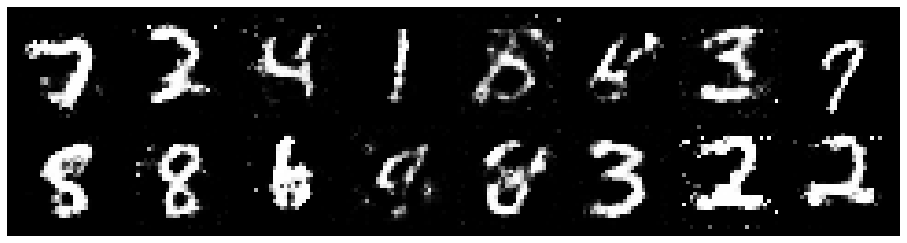

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.1734, Generator Loss: 1.0785
D(x): 0.5995, D(G(z)): 0.3906


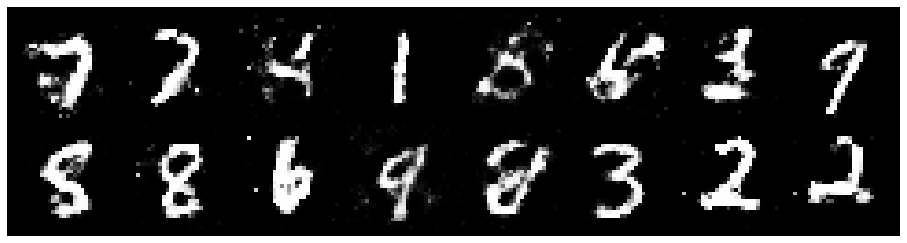

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.4495, Generator Loss: 1.0336
D(x): 0.5178, D(G(z)): 0.4467


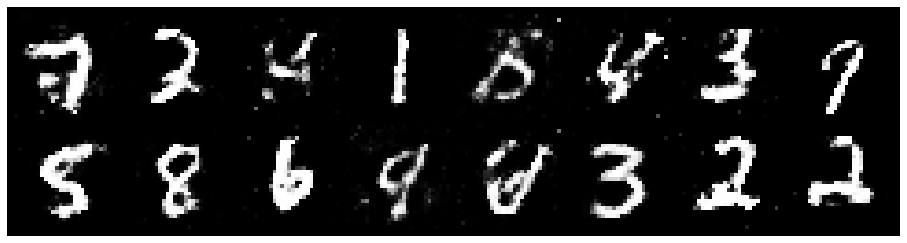

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2974, Generator Loss: 0.8384
D(x): 0.5734, D(G(z)): 0.4810


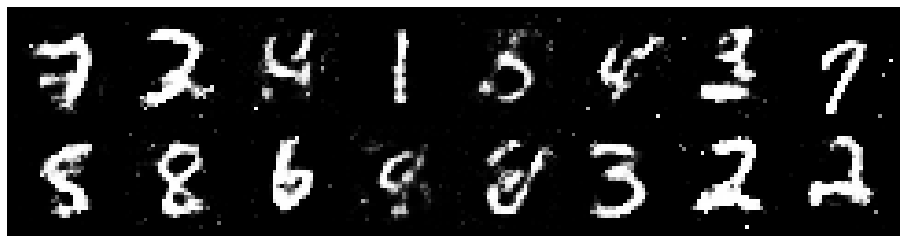

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.2814, Generator Loss: 1.1510
D(x): 0.6094, D(G(z)): 0.4568


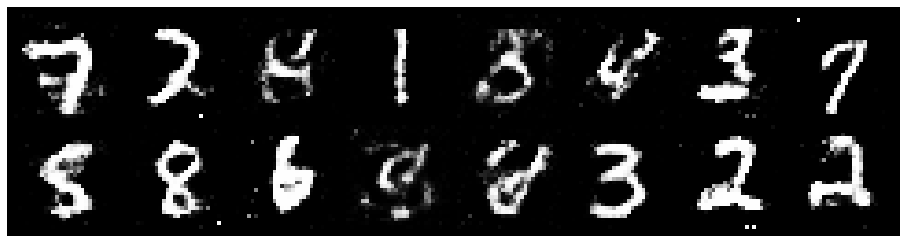

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.3518, Generator Loss: 1.0094
D(x): 0.5346, D(G(z)): 0.4350


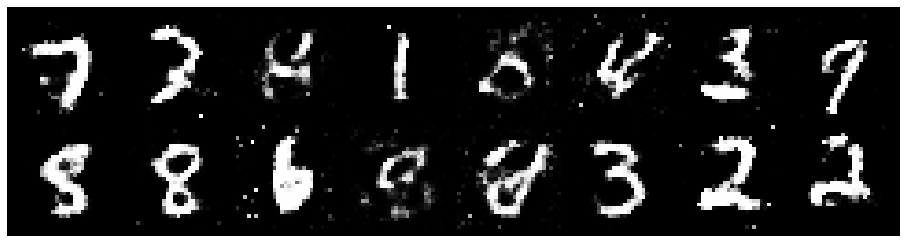

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.0681, Generator Loss: 1.2099
D(x): 0.6308, D(G(z)): 0.3679


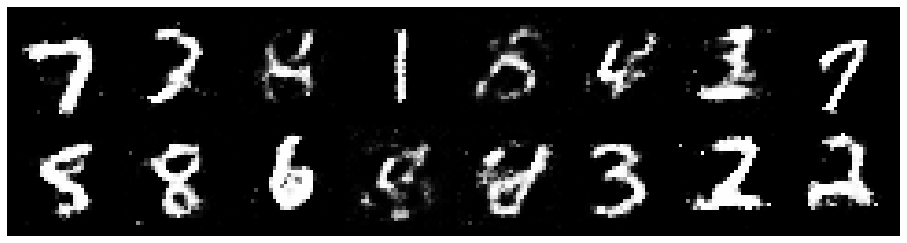

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.0164, Generator Loss: 1.1748
D(x): 0.6489, D(G(z)): 0.3901


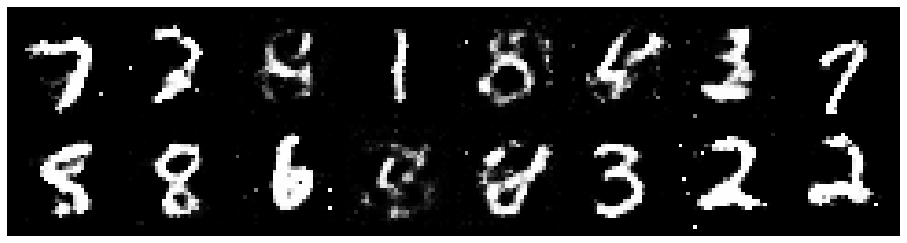

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.1255, Generator Loss: 1.2194
D(x): 0.5622, D(G(z)): 0.3580


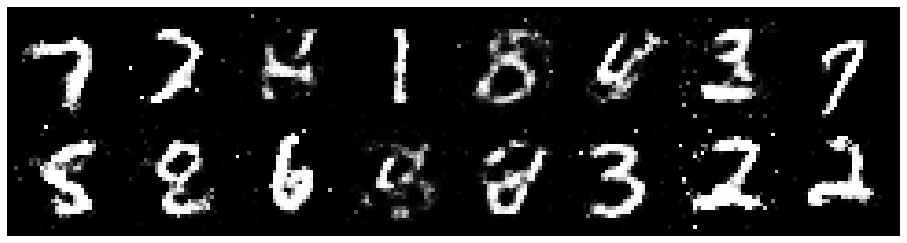

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.2596, Generator Loss: 1.0488
D(x): 0.5643, D(G(z)): 0.4367


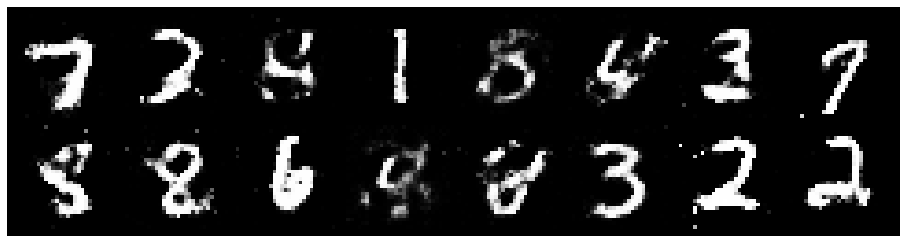

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.3144, Generator Loss: 0.8422
D(x): 0.6127, D(G(z)): 0.4931


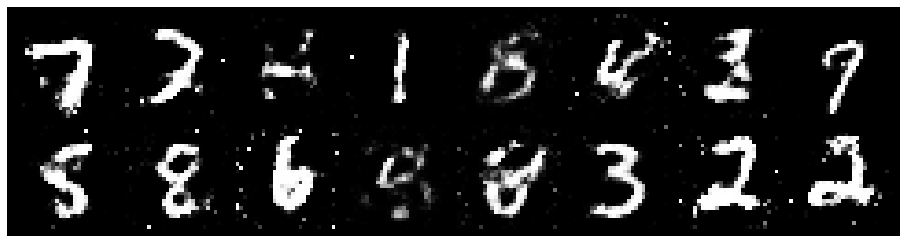

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.2611, Generator Loss: 0.8563
D(x): 0.5576, D(G(z)): 0.4459


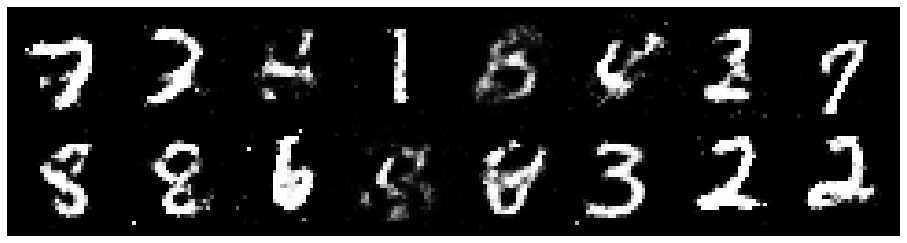

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.2414, Generator Loss: 0.8726
D(x): 0.5861, D(G(z)): 0.4433


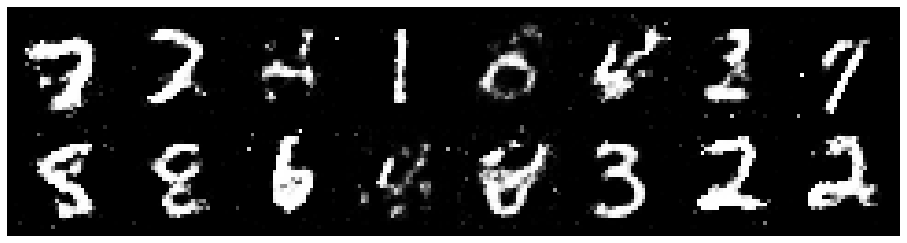

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.2380, Generator Loss: 1.1283
D(x): 0.6074, D(G(z)): 0.4422


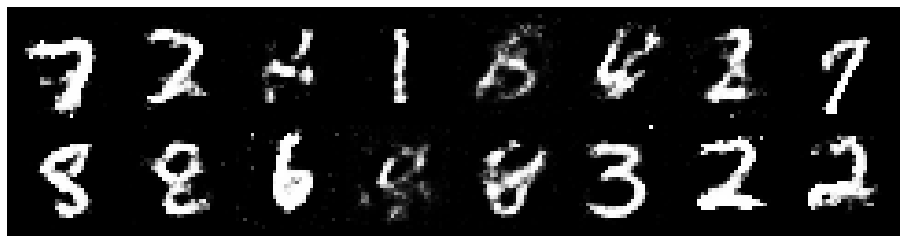

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.3018, Generator Loss: 1.1650
D(x): 0.5860, D(G(z)): 0.4237


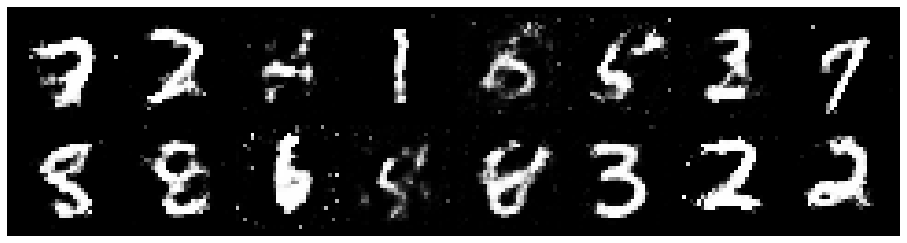

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.3634, Generator Loss: 0.8151
D(x): 0.5769, D(G(z)): 0.4835


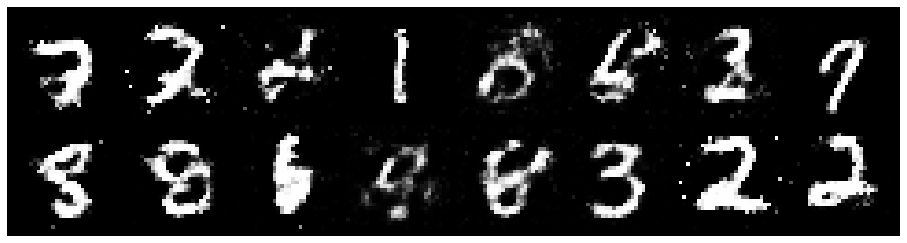

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.3151, Generator Loss: 0.8753
D(x): 0.5713, D(G(z)): 0.4739


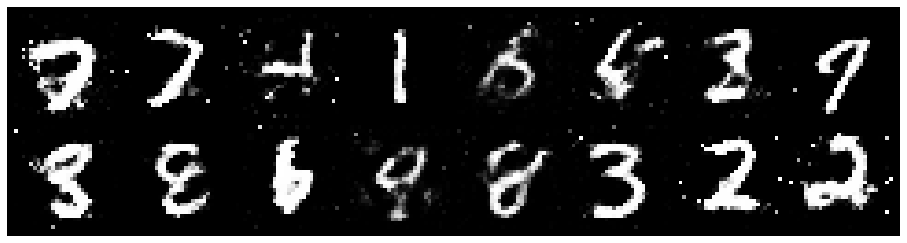

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.2807, Generator Loss: 0.7795
D(x): 0.6262, D(G(z)): 0.5072


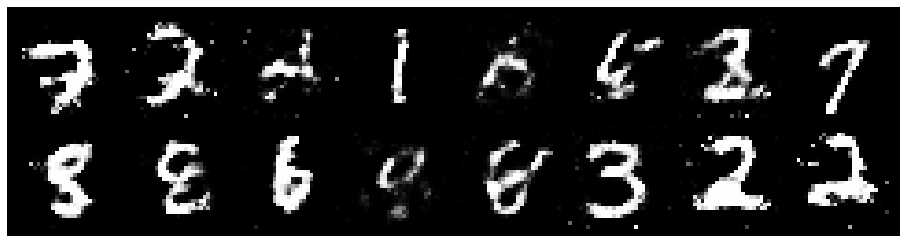

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.3606, Generator Loss: 0.9221
D(x): 0.5464, D(G(z)): 0.4545


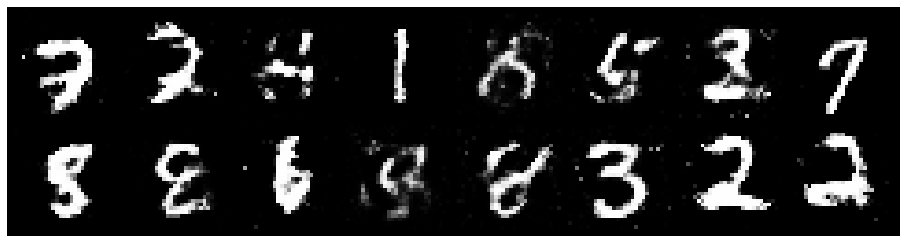

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.2647, Generator Loss: 1.0014
D(x): 0.6193, D(G(z)): 0.4823


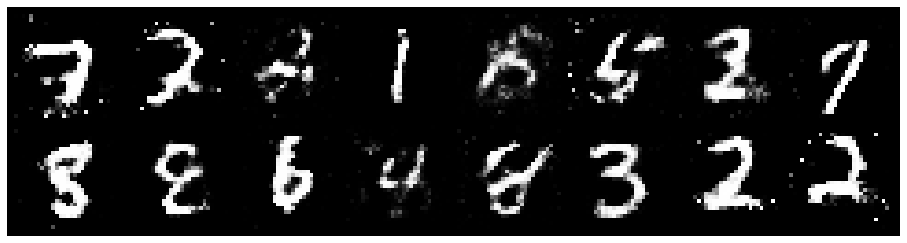

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.2545, Generator Loss: 1.1749
D(x): 0.5888, D(G(z)): 0.4003


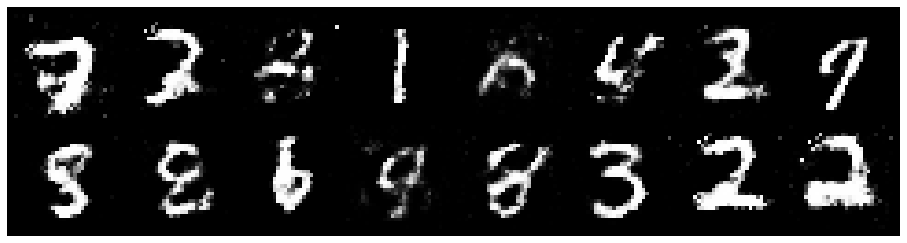

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.1246, Generator Loss: 0.9710
D(x): 0.6150, D(G(z)): 0.4234


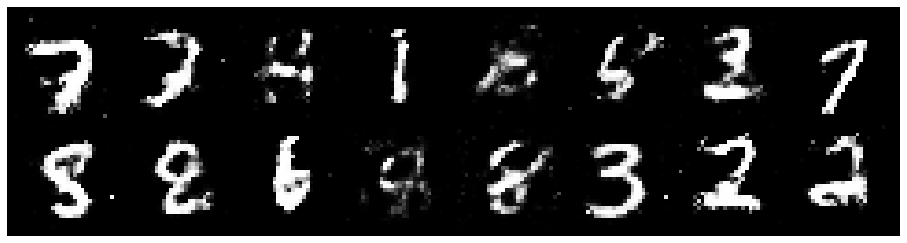

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.1188, Generator Loss: 1.0679
D(x): 0.6062, D(G(z)): 0.3995


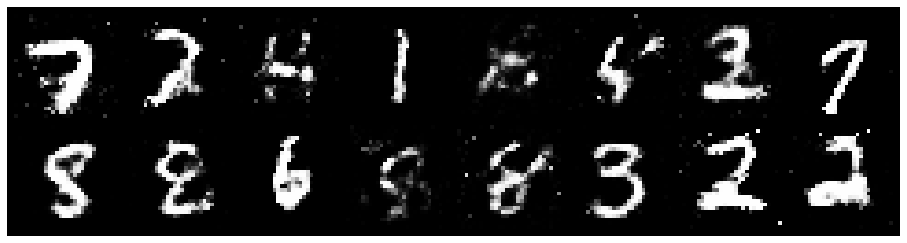

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.2670, Generator Loss: 0.9855
D(x): 0.5368, D(G(z)): 0.4138


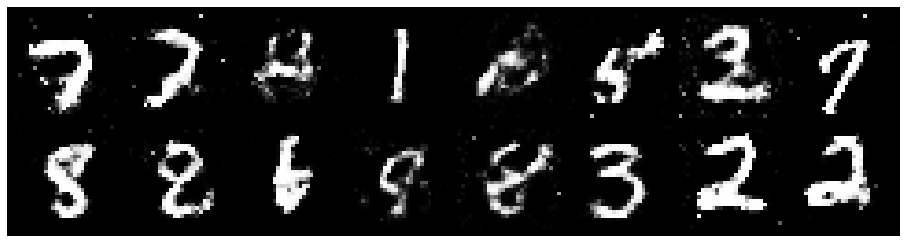

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.1912, Generator Loss: 1.0117
D(x): 0.5580, D(G(z)): 0.4136


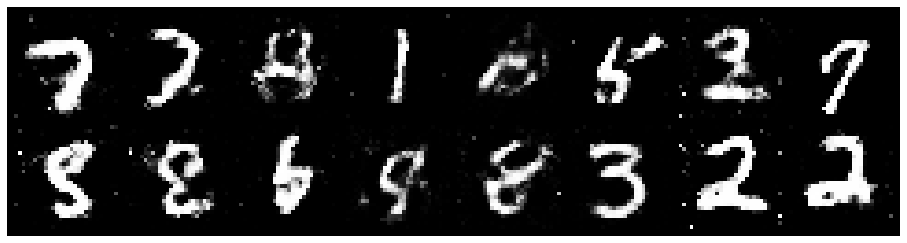

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.2191, Generator Loss: 0.9200
D(x): 0.5760, D(G(z)): 0.4321


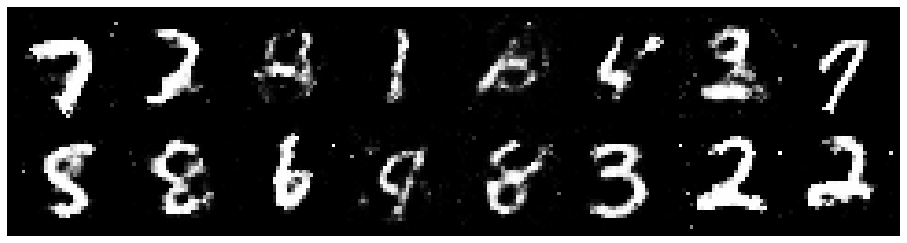

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2034, Generator Loss: 1.0309
D(x): 0.5336, D(G(z)): 0.3822


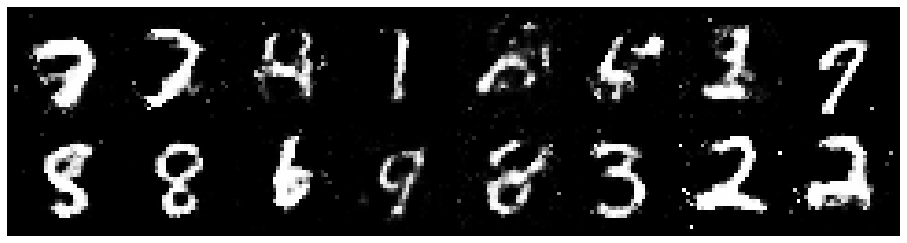

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.3087, Generator Loss: 0.7883
D(x): 0.5966, D(G(z)): 0.4908


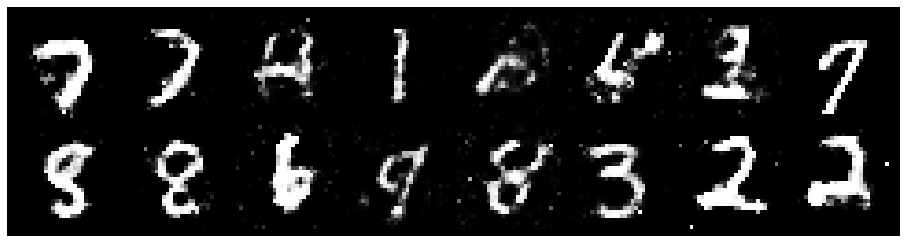

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2318, Generator Loss: 0.9993
D(x): 0.5996, D(G(z)): 0.4334


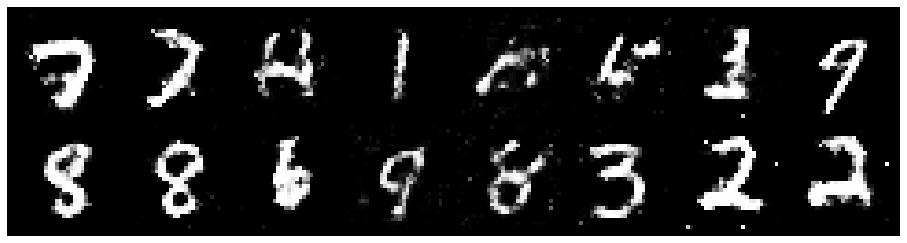

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.1718, Generator Loss: 1.0048
D(x): 0.5348, D(G(z)): 0.3779


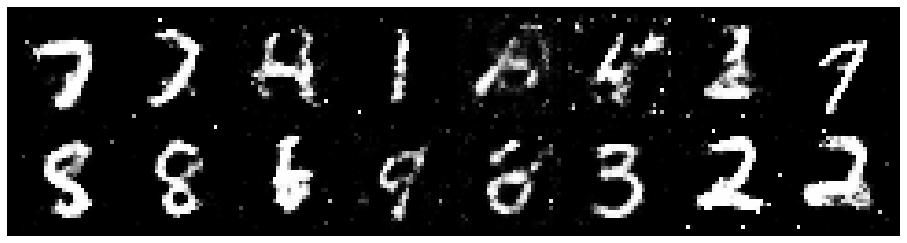

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.1885, Generator Loss: 0.9664
D(x): 0.5330, D(G(z)): 0.3800


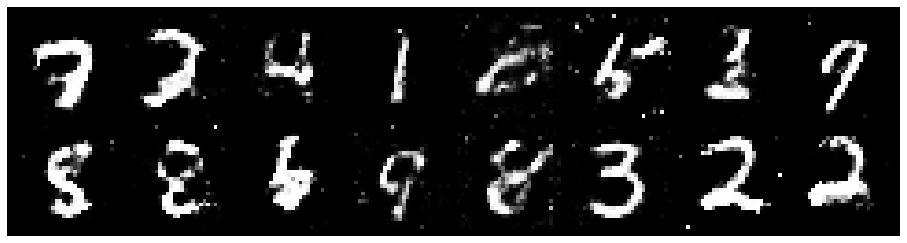

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.2940, Generator Loss: 0.8568
D(x): 0.5650, D(G(z)): 0.4612


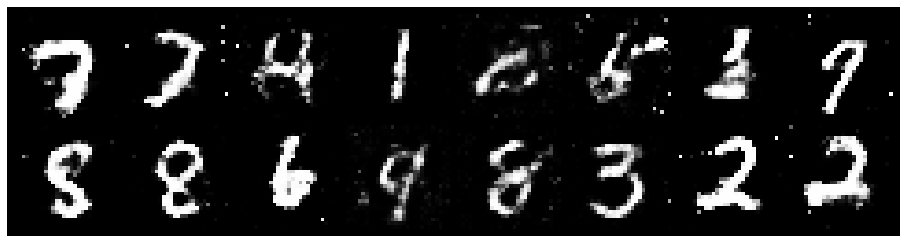

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.2705, Generator Loss: 0.8996
D(x): 0.6023, D(G(z)): 0.4842


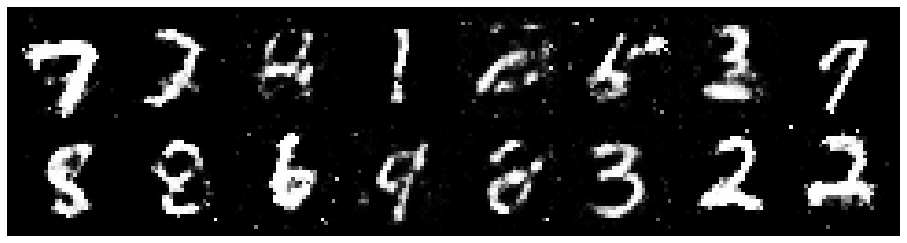

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.1887, Generator Loss: 1.0149
D(x): 0.5547, D(G(z)): 0.3776


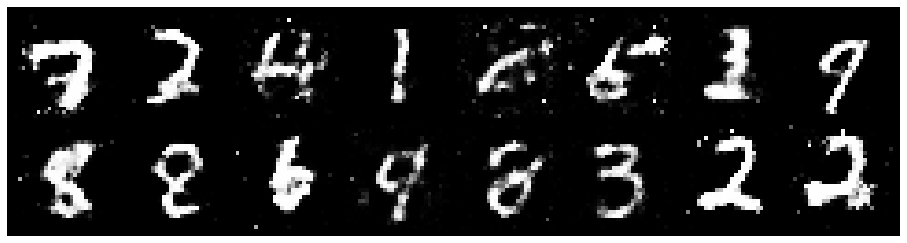

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.2328, Generator Loss: 0.8547
D(x): 0.5838, D(G(z)): 0.4562


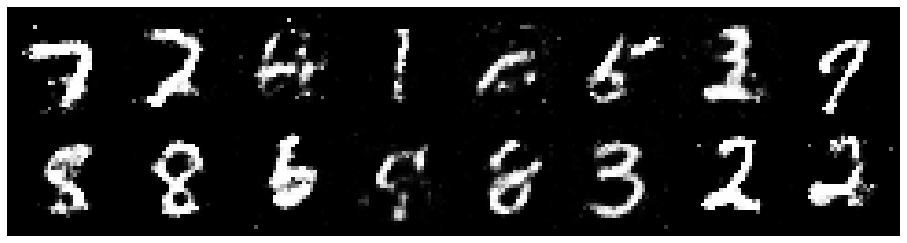

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.2218, Generator Loss: 0.8655
D(x): 0.5675, D(G(z)): 0.4461


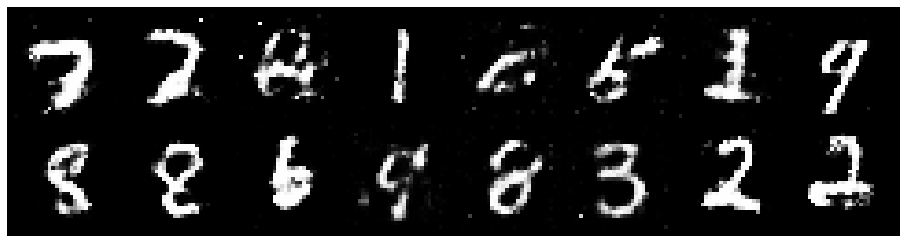

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.2034, Generator Loss: 1.0264
D(x): 0.5638, D(G(z)): 0.4221


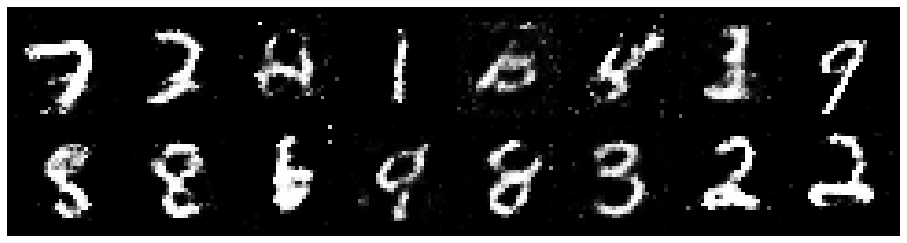

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.2084, Generator Loss: 0.9465
D(x): 0.5552, D(G(z)): 0.4361


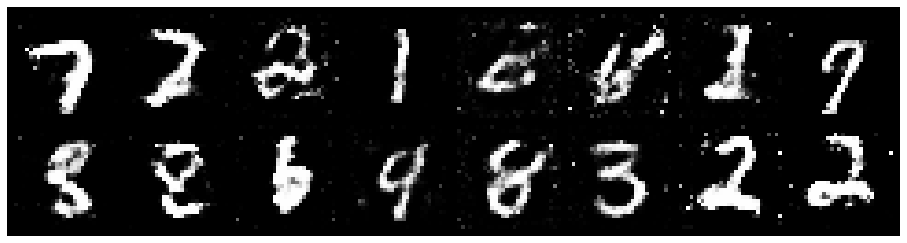

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.3126, Generator Loss: 0.8495
D(x): 0.5564, D(G(z)): 0.4763


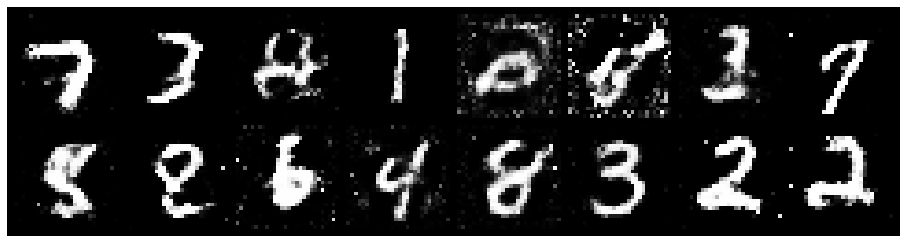

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2991, Generator Loss: 0.9918
D(x): 0.5158, D(G(z)): 0.3956


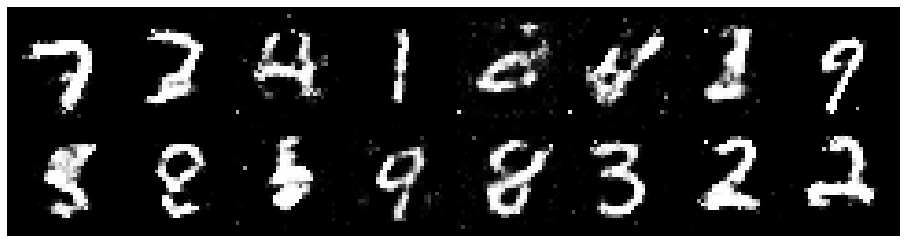

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.3656, Generator Loss: 0.9375
D(x): 0.5046, D(G(z)): 0.4278


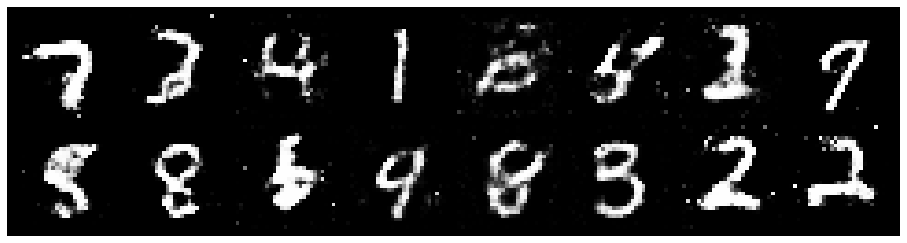

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2194, Generator Loss: 1.0159
D(x): 0.5866, D(G(z)): 0.4164


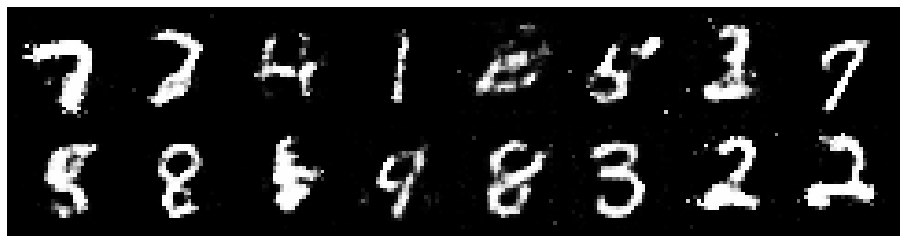

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.1022, Generator Loss: 1.1266
D(x): 0.5961, D(G(z)): 0.3722


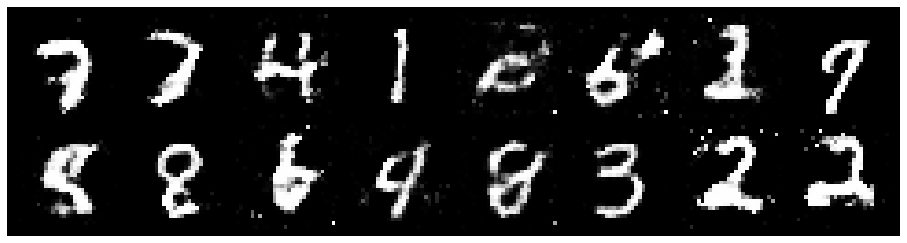

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.1319, Generator Loss: 0.9602
D(x): 0.6046, D(G(z)): 0.4121


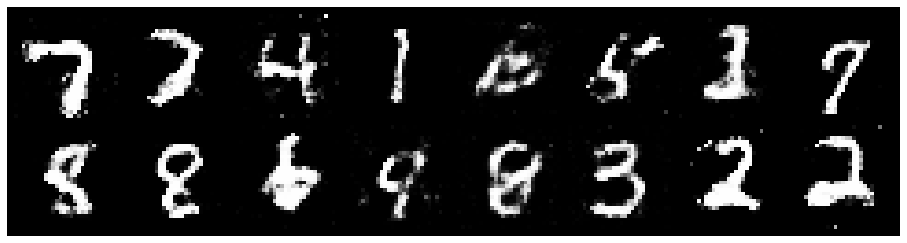

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.1158, Generator Loss: 0.9975
D(x): 0.5790, D(G(z)): 0.3799


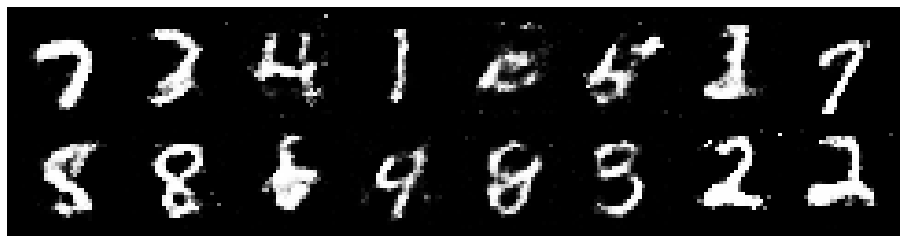

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.1842, Generator Loss: 0.9765
D(x): 0.5704, D(G(z)): 0.4191


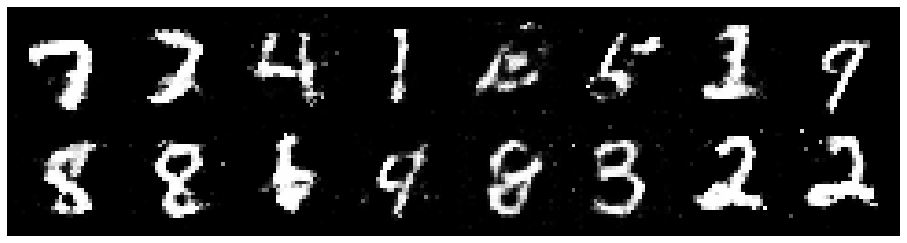

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.2247, Generator Loss: 0.9556
D(x): 0.5757, D(G(z)): 0.4425


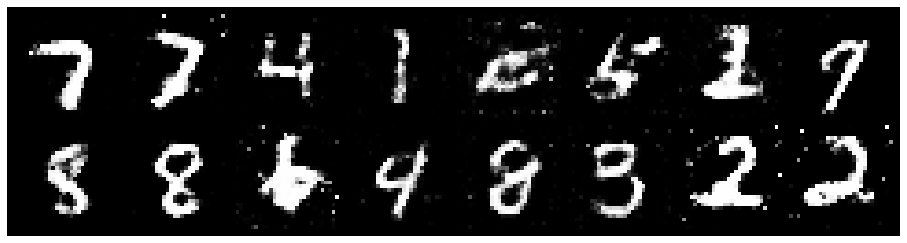

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.2369, Generator Loss: 0.7669
D(x): 0.5902, D(G(z)): 0.4570


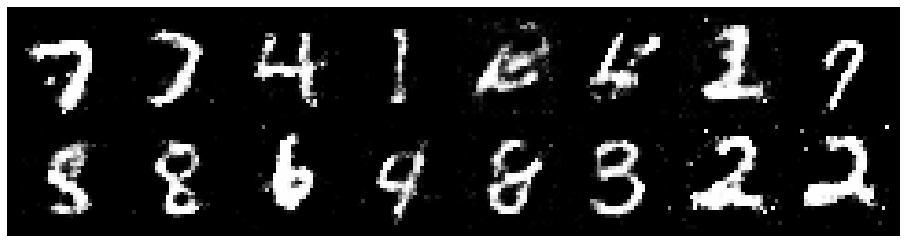

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.3343, Generator Loss: 0.8893
D(x): 0.5369, D(G(z)): 0.4585


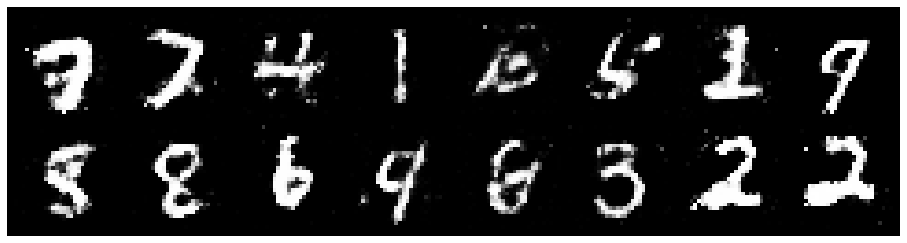

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.3695, Generator Loss: 0.7453
D(x): 0.5973, D(G(z)): 0.5206


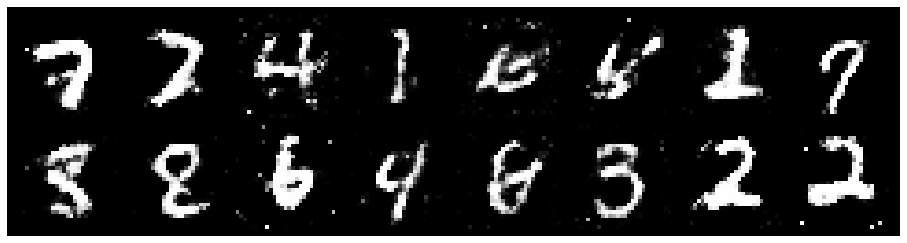

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2854, Generator Loss: 0.7960
D(x): 0.6282, D(G(z)): 0.5050


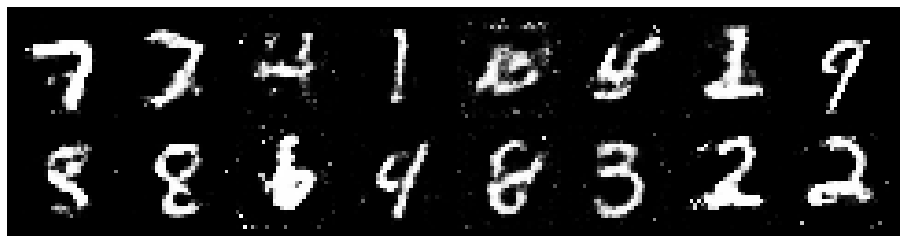

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 0.9776, Generator Loss: 1.1965
D(x): 0.6169, D(G(z)): 0.3275


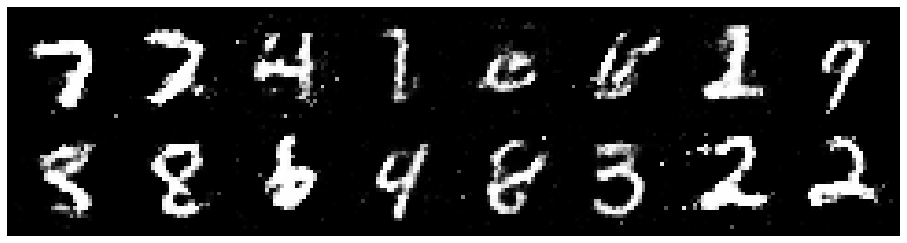

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2308, Generator Loss: 1.1729
D(x): 0.5923, D(G(z)): 0.4069


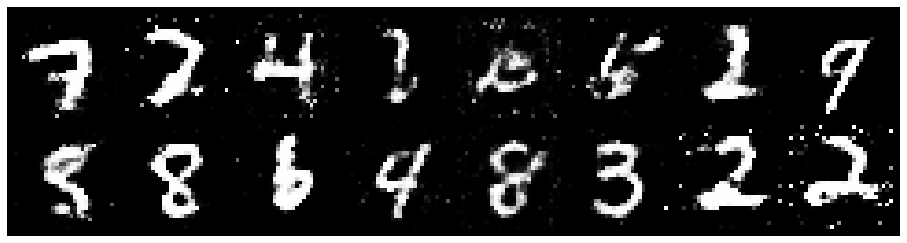

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.2944, Generator Loss: 0.9232
D(x): 0.5587, D(G(z)): 0.4356


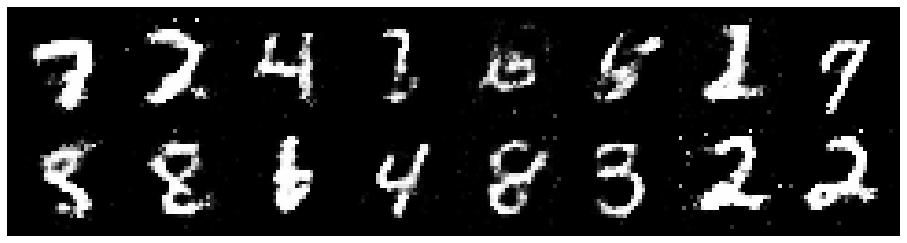

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.2981, Generator Loss: 0.7954
D(x): 0.6157, D(G(z)): 0.5048


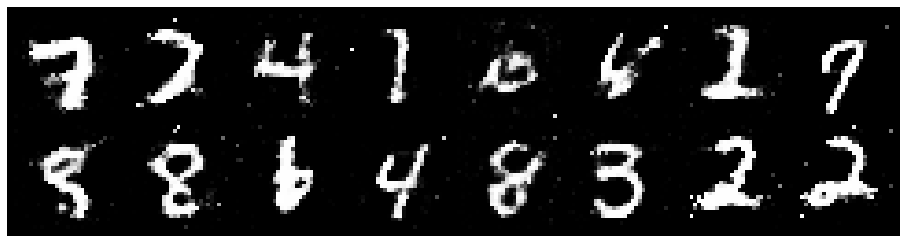

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.3266, Generator Loss: 0.8751
D(x): 0.5664, D(G(z)): 0.4532


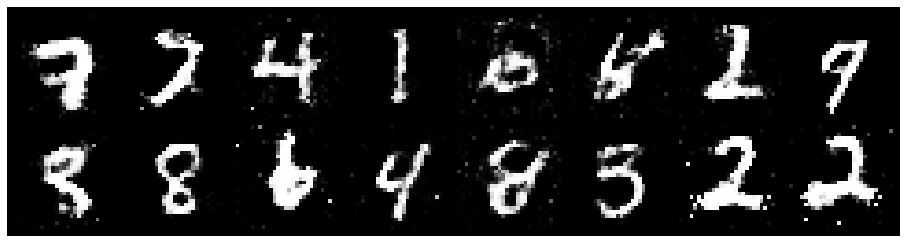

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.3454, Generator Loss: 1.0298
D(x): 0.5245, D(G(z)): 0.4124


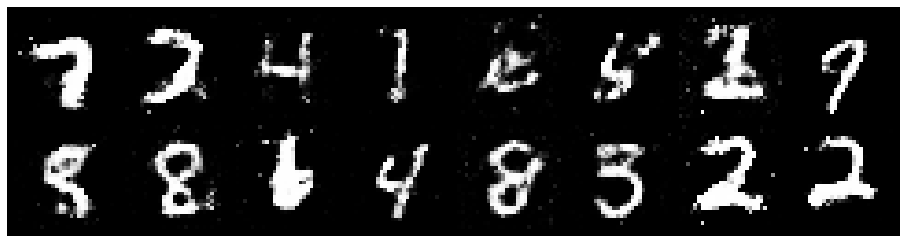

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.2280, Generator Loss: 0.9641
D(x): 0.5704, D(G(z)): 0.4281


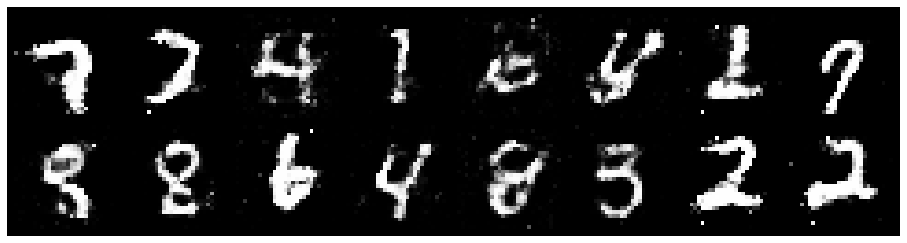

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2553, Generator Loss: 1.0040
D(x): 0.5320, D(G(z)): 0.4017


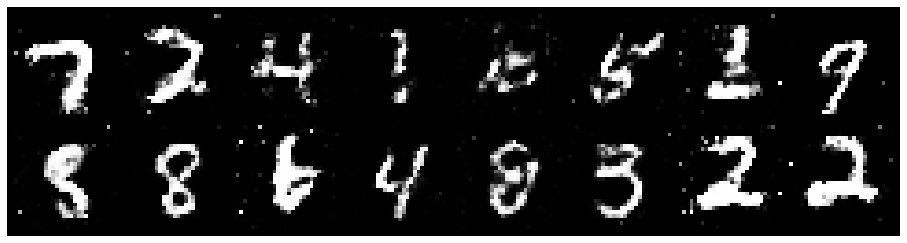

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.2325, Generator Loss: 0.9088
D(x): 0.5950, D(G(z)): 0.4572


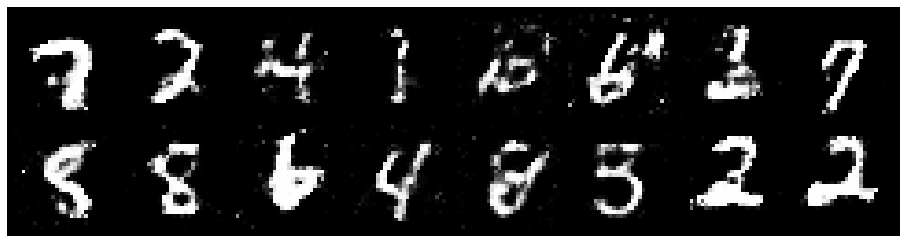

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.2027, Generator Loss: 0.8843
D(x): 0.5796, D(G(z)): 0.4478


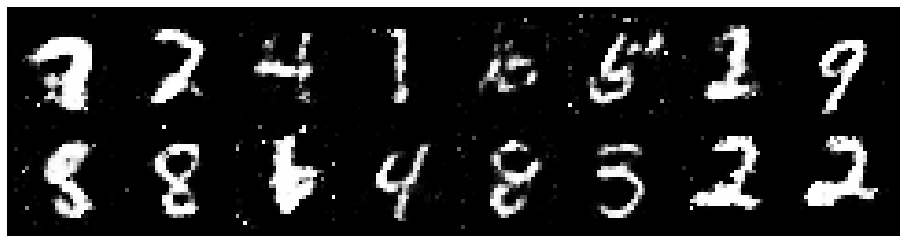

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.2417, Generator Loss: 0.8325
D(x): 0.5864, D(G(z)): 0.4611


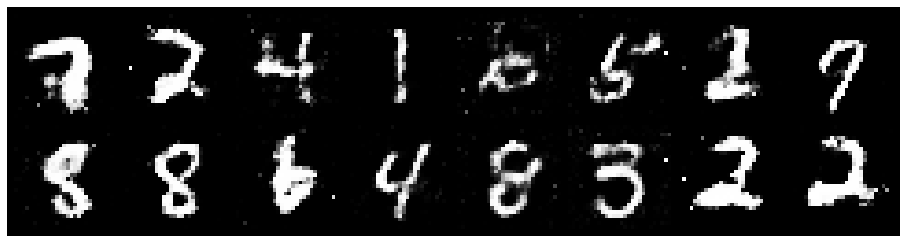

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.1908, Generator Loss: 0.8409
D(x): 0.6043, D(G(z)): 0.4291


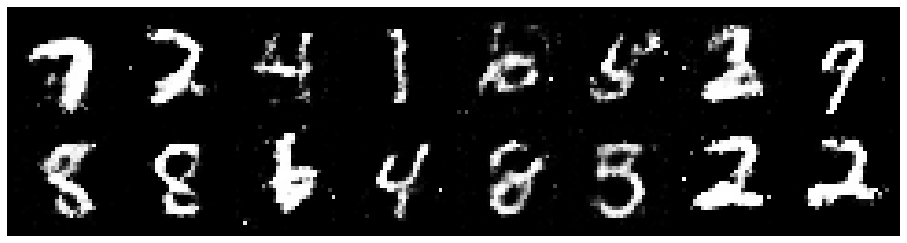

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.4186, Generator Loss: 0.7022
D(x): 0.5550, D(G(z)): 0.5087


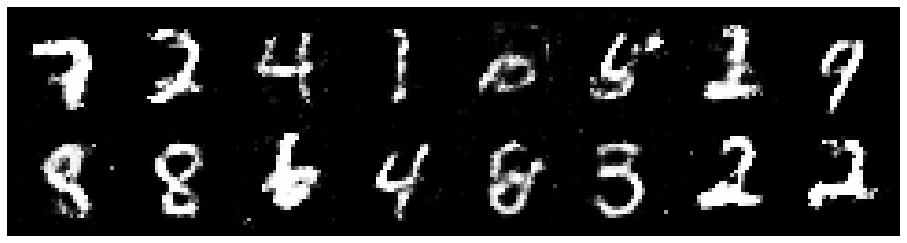

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.4003, Generator Loss: 0.7916
D(x): 0.5862, D(G(z)): 0.5074


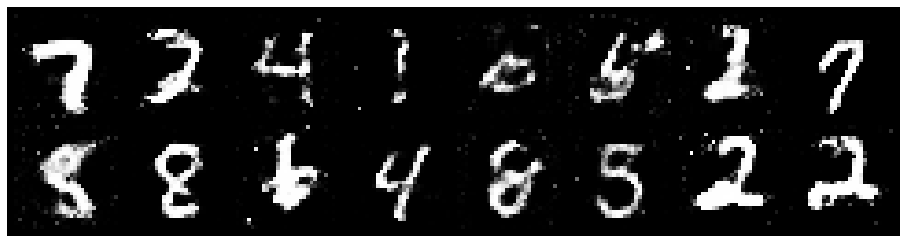

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.1682, Generator Loss: 0.8740
D(x): 0.5960, D(G(z)): 0.4223


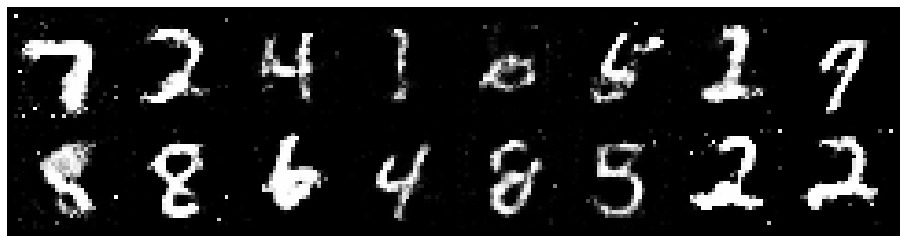

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.1827, Generator Loss: 0.9466
D(x): 0.5966, D(G(z)): 0.4353


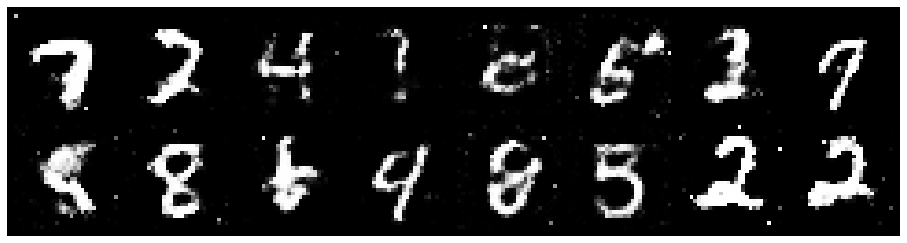

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.2518, Generator Loss: 0.9321
D(x): 0.5905, D(G(z)): 0.4423


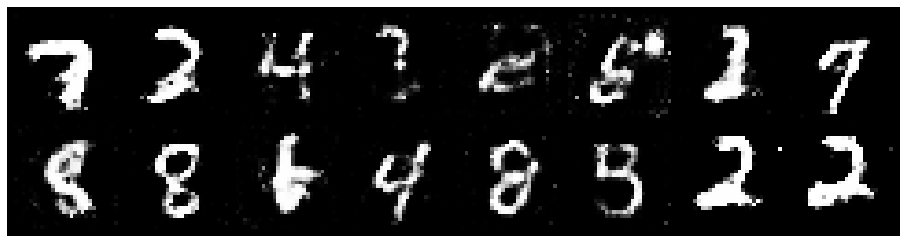

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2480, Generator Loss: 0.9695
D(x): 0.5764, D(G(z)): 0.4293


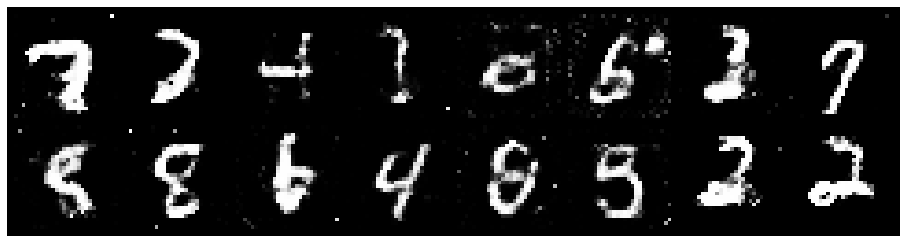

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.1482, Generator Loss: 1.0192
D(x): 0.5905, D(G(z)): 0.4187


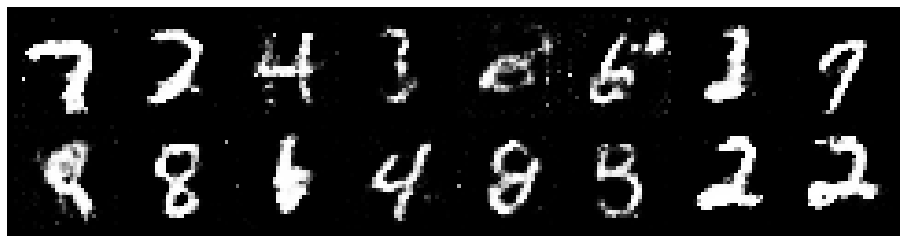

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.1950, Generator Loss: 0.9370
D(x): 0.5792, D(G(z)): 0.4229


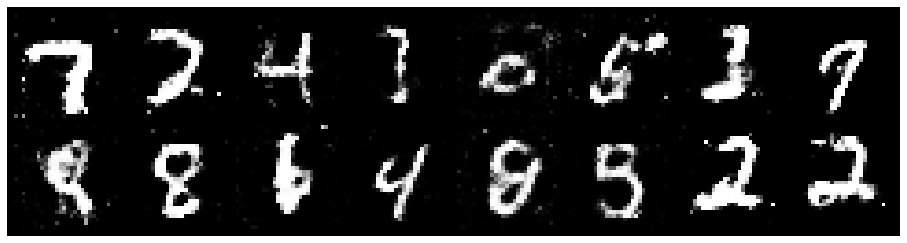

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.2362, Generator Loss: 0.9030
D(x): 0.6143, D(G(z)): 0.4628


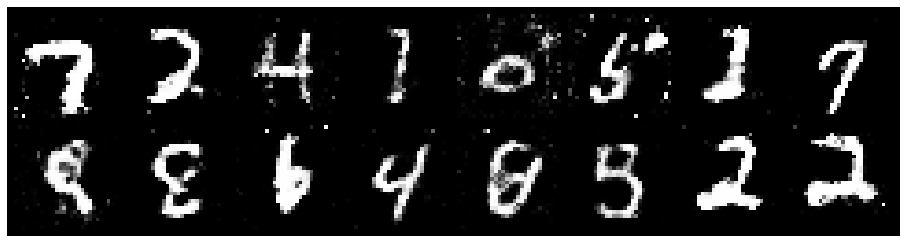

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.3635, Generator Loss: 0.8511
D(x): 0.5164, D(G(z)): 0.4400


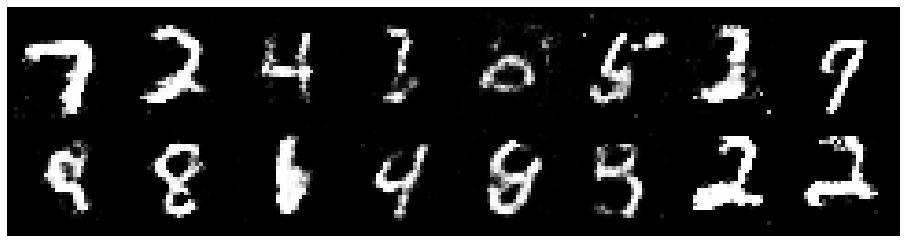

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.3205, Generator Loss: 0.9132
D(x): 0.5337, D(G(z)): 0.4444


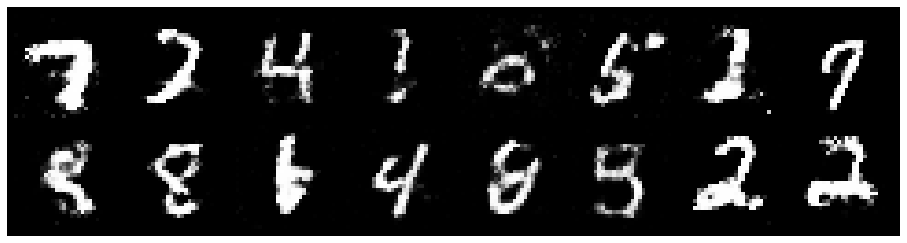

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.3477, Generator Loss: 0.9182
D(x): 0.5395, D(G(z)): 0.4592


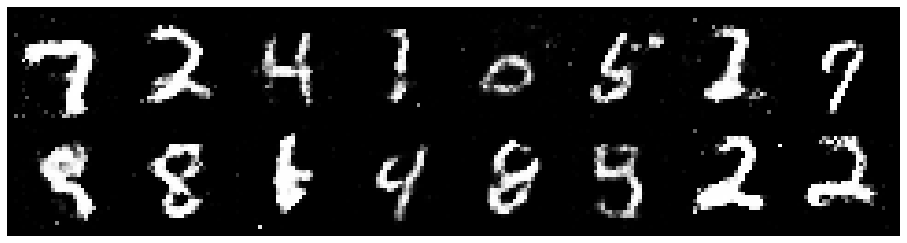

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.2341, Generator Loss: 1.0339
D(x): 0.5749, D(G(z)): 0.4395


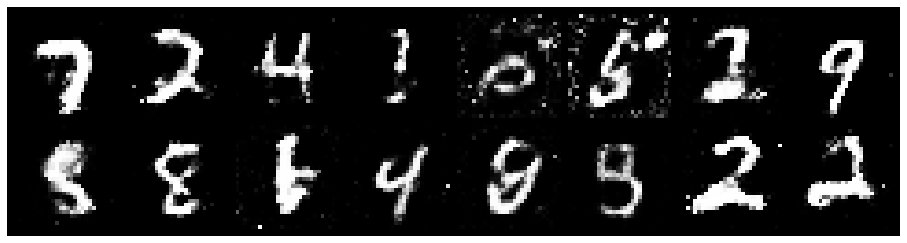

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.2098, Generator Loss: 0.9684
D(x): 0.5910, D(G(z)): 0.4292


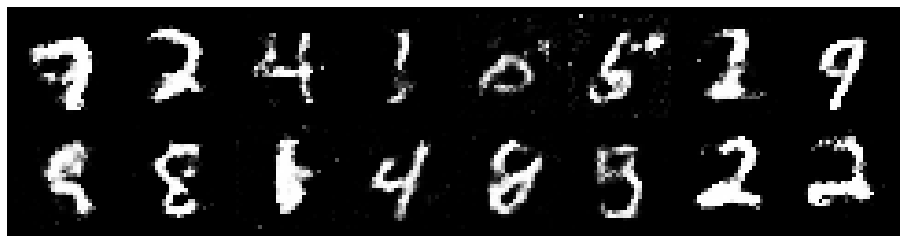

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.1871, Generator Loss: 0.9930
D(x): 0.5836, D(G(z)): 0.4340


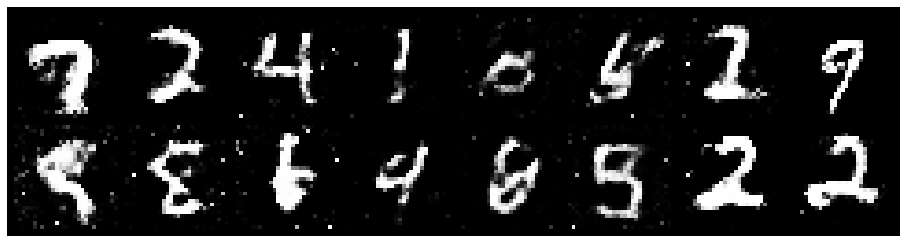

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.2366, Generator Loss: 0.9101
D(x): 0.5680, D(G(z)): 0.4297


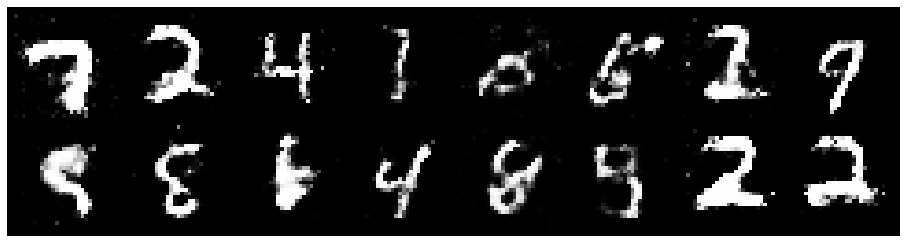

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.3017, Generator Loss: 0.8814
D(x): 0.5377, D(G(z)): 0.4246


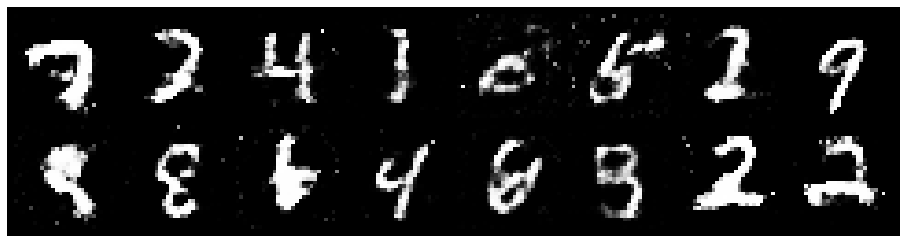

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.2049, Generator Loss: 1.0054
D(x): 0.6224, D(G(z)): 0.4241


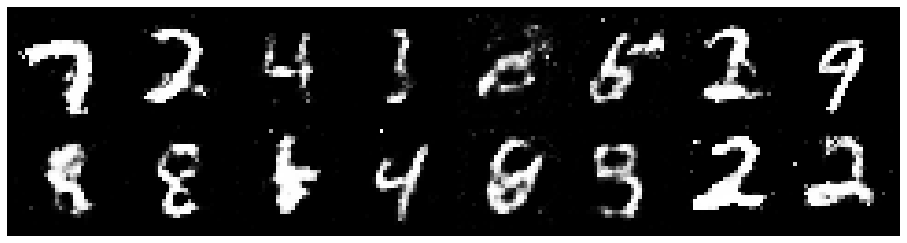

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.1405, Generator Loss: 1.1436
D(x): 0.5766, D(G(z)): 0.3612


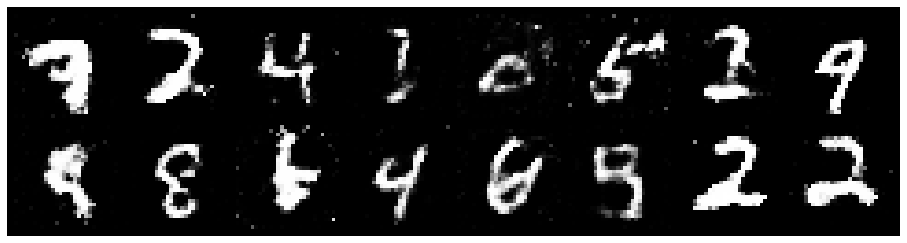

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.1976, Generator Loss: 1.1142
D(x): 0.6057, D(G(z)): 0.4203


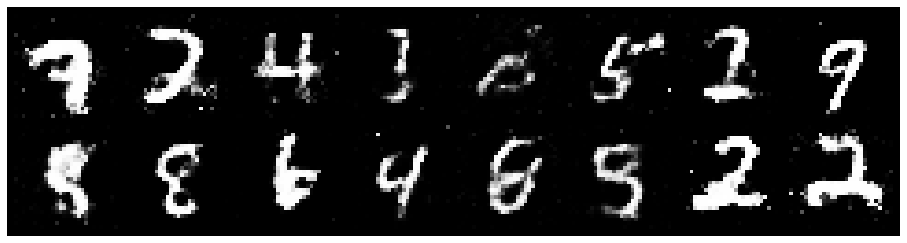

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.3758, Generator Loss: 0.9332
D(x): 0.5494, D(G(z)): 0.4638


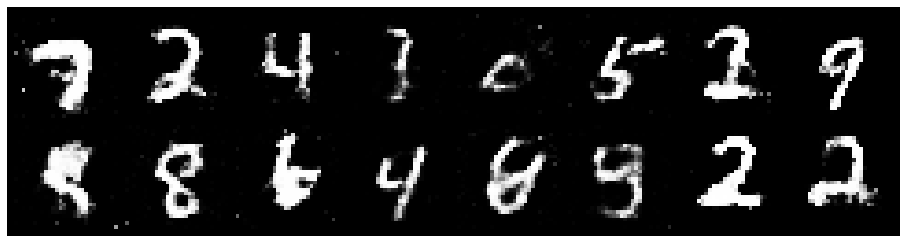

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.2731, Generator Loss: 0.9016
D(x): 0.5492, D(G(z)): 0.4462


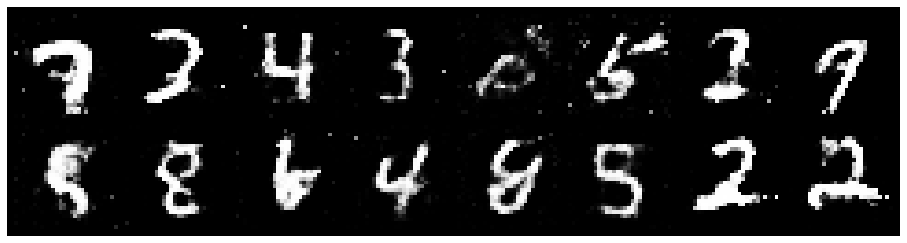

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.3269, Generator Loss: 0.9692
D(x): 0.5919, D(G(z)): 0.4750


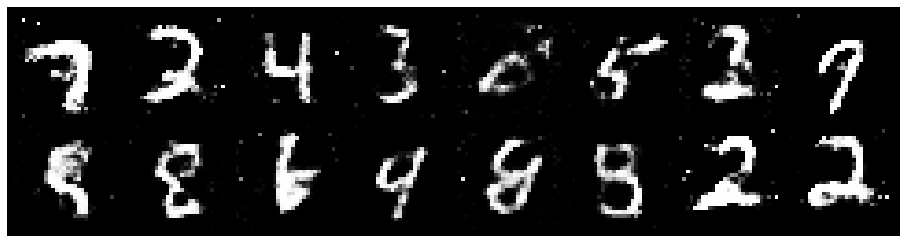

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.2462, Generator Loss: 1.0721
D(x): 0.5105, D(G(z)): 0.3708


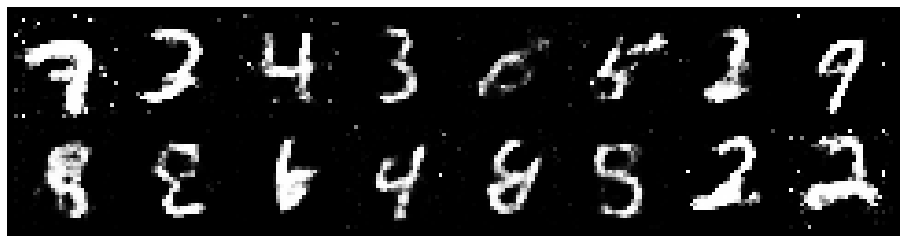

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.1713, Generator Loss: 0.9759
D(x): 0.5912, D(G(z)): 0.4184


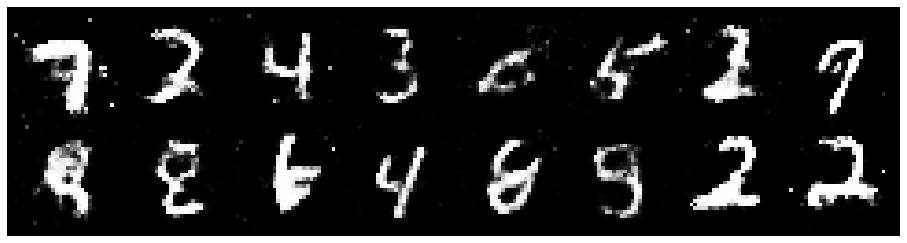

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.3103, Generator Loss: 0.8333
D(x): 0.5506, D(G(z)): 0.4347


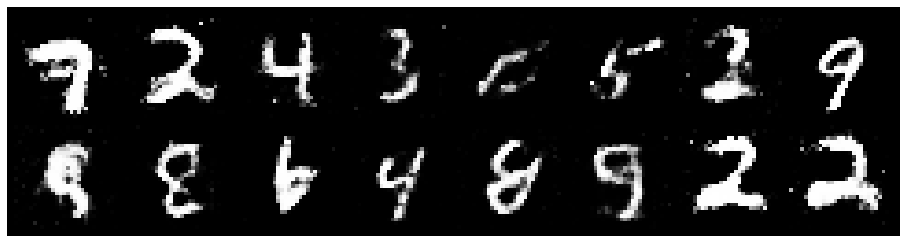

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2006, Generator Loss: 0.9462
D(x): 0.5620, D(G(z)): 0.4195


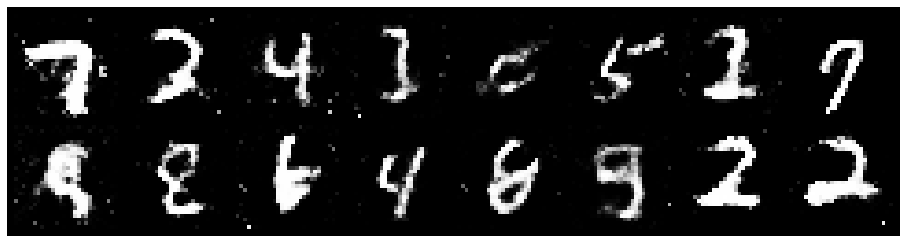

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.2810, Generator Loss: 0.8434
D(x): 0.5625, D(G(z)): 0.4421


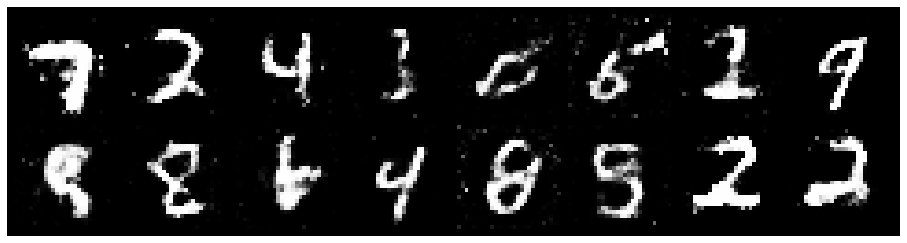

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.2554, Generator Loss: 0.9110
D(x): 0.5570, D(G(z)): 0.4460


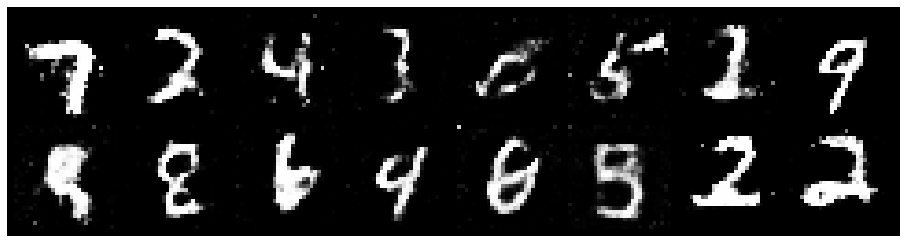

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.2588, Generator Loss: 0.9906
D(x): 0.5228, D(G(z)): 0.3964


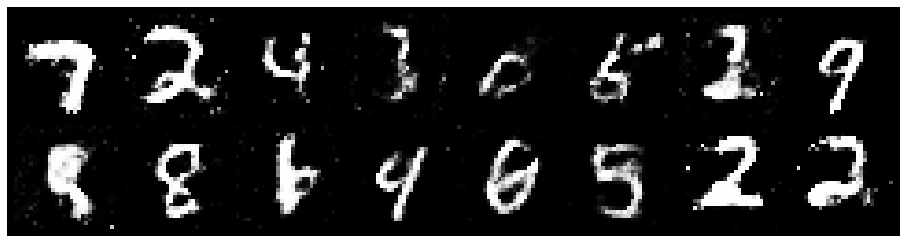

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.2055, Generator Loss: 1.0179
D(x): 0.5606, D(G(z)): 0.4083


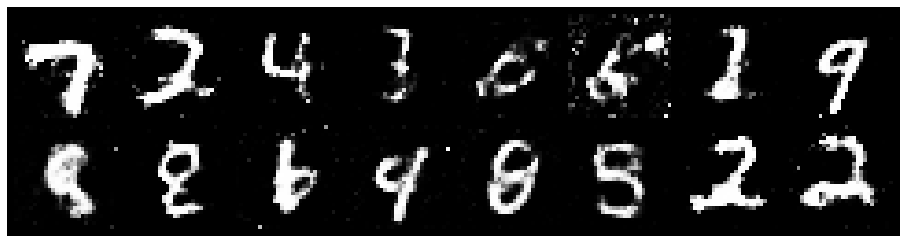

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.3170, Generator Loss: 0.8510
D(x): 0.5228, D(G(z)): 0.4468


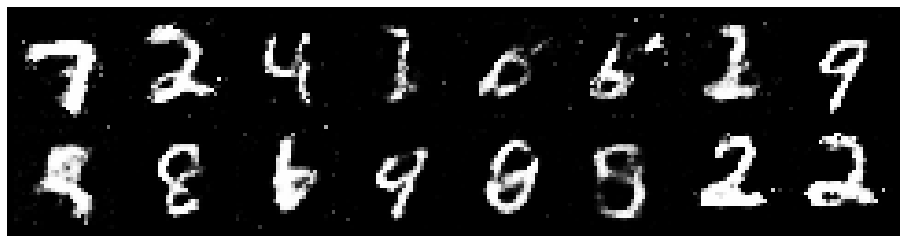

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.2359, Generator Loss: 1.2227
D(x): 0.5531, D(G(z)): 0.3890


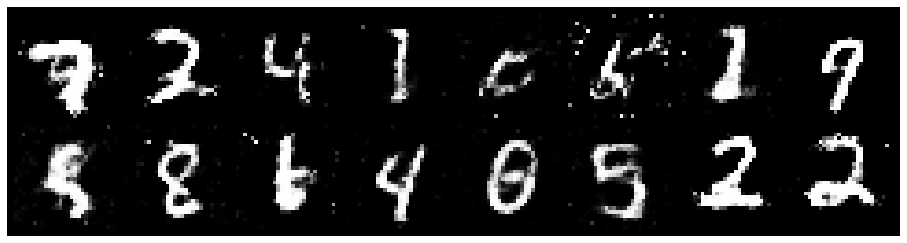

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2371, Generator Loss: 0.9983
D(x): 0.5592, D(G(z)): 0.4098


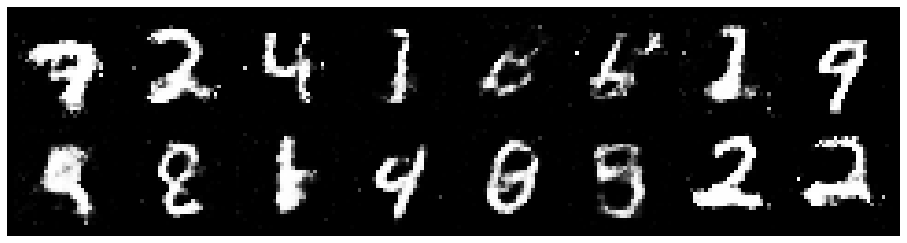

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.3325, Generator Loss: 0.7843
D(x): 0.5319, D(G(z)): 0.4581


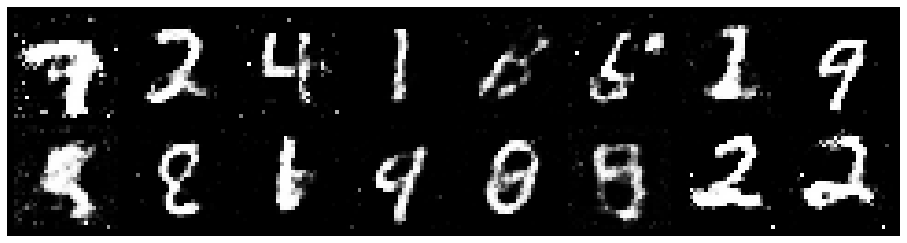

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.3417, Generator Loss: 0.8228
D(x): 0.5422, D(G(z)): 0.4672


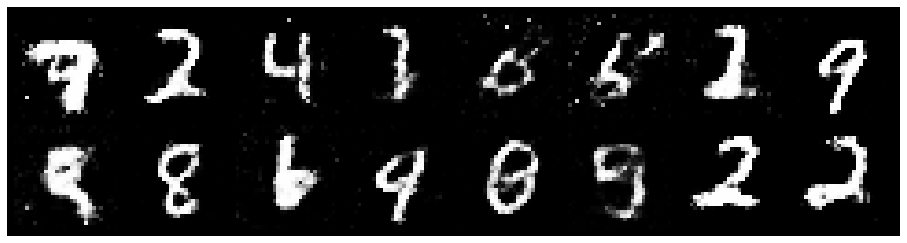

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.2390, Generator Loss: 0.7928
D(x): 0.5645, D(G(z)): 0.4441


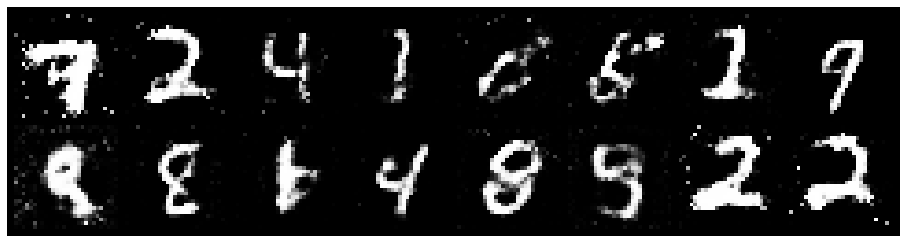

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.2808, Generator Loss: 0.8926
D(x): 0.5995, D(G(z)): 0.4780


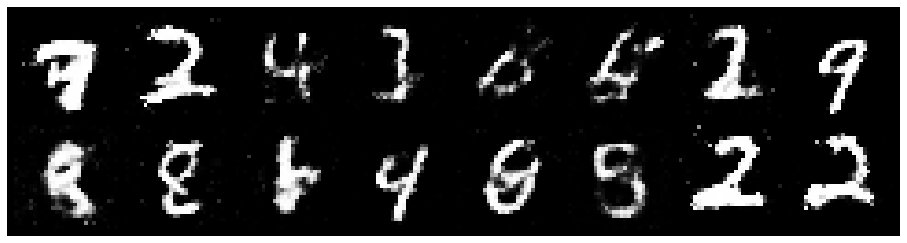

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.2037, Generator Loss: 0.9558
D(x): 0.5654, D(G(z)): 0.4021


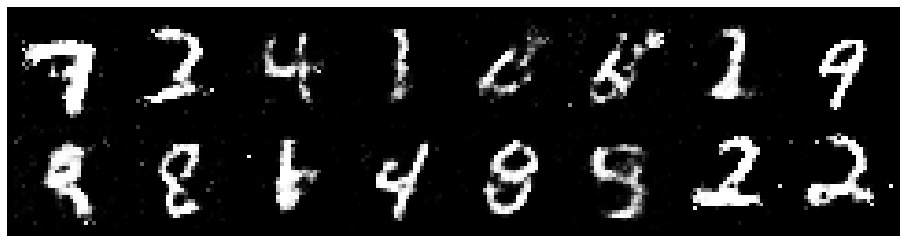

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.1158, Generator Loss: 1.1563
D(x): 0.6043, D(G(z)): 0.4027


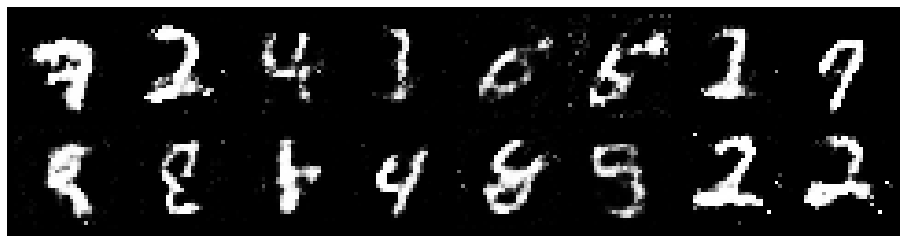

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.2606, Generator Loss: 0.9711
D(x): 0.5670, D(G(z)): 0.4259


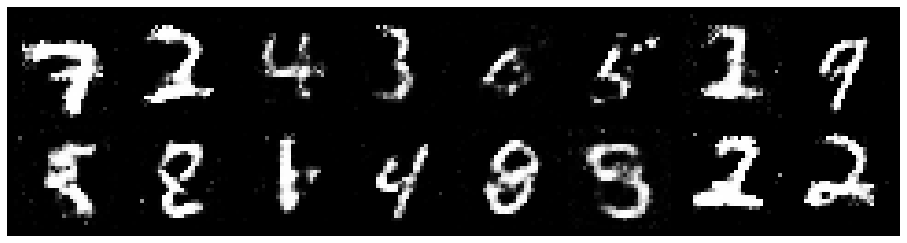

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.2778, Generator Loss: 0.8233
D(x): 0.5567, D(G(z)): 0.4571


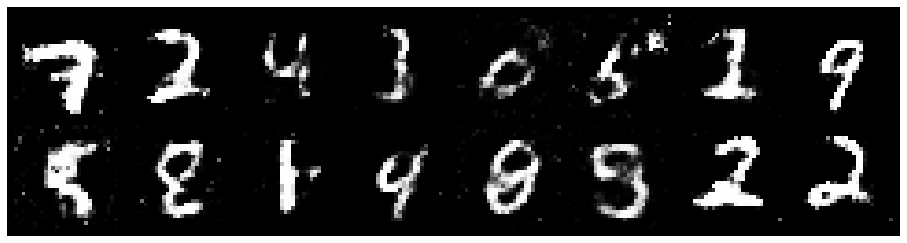

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.1936, Generator Loss: 1.0168
D(x): 0.6352, D(G(z)): 0.4536


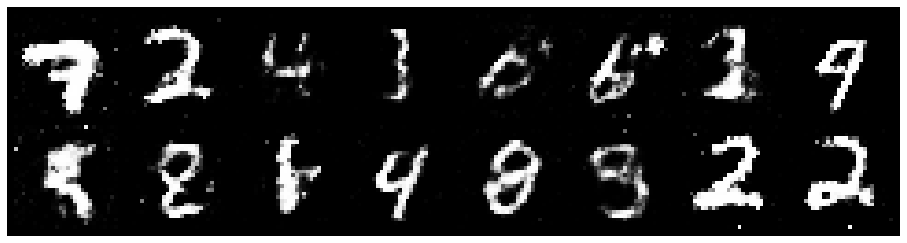

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.3003, Generator Loss: 0.9395
D(x): 0.6053, D(G(z)): 0.4615


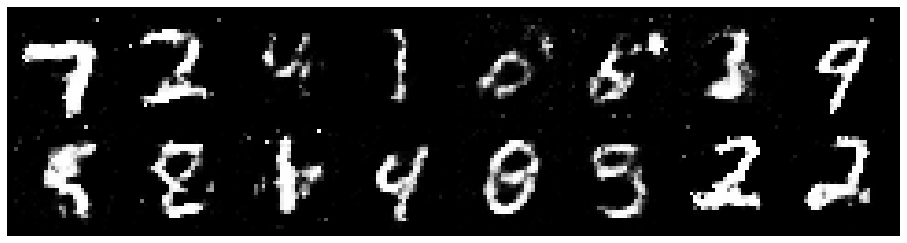

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.3147, Generator Loss: 0.8504
D(x): 0.5610, D(G(z)): 0.4775


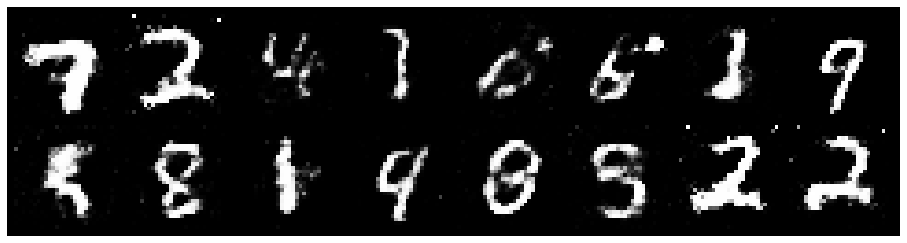

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2931, Generator Loss: 0.9195
D(x): 0.5330, D(G(z)): 0.4408


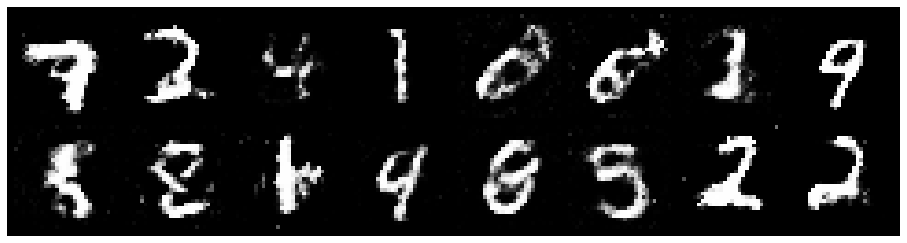

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2770, Generator Loss: 0.8118
D(x): 0.5534, D(G(z)): 0.4481


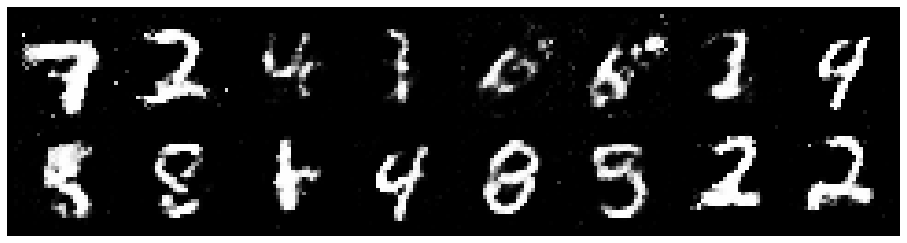

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2897, Generator Loss: 0.9359
D(x): 0.5633, D(G(z)): 0.4570


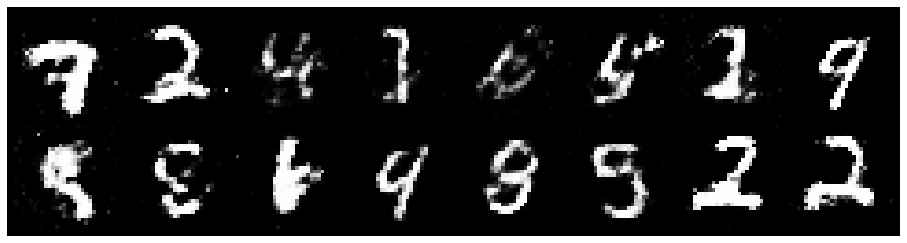

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.1530, Generator Loss: 1.0255
D(x): 0.5413, D(G(z)): 0.3442


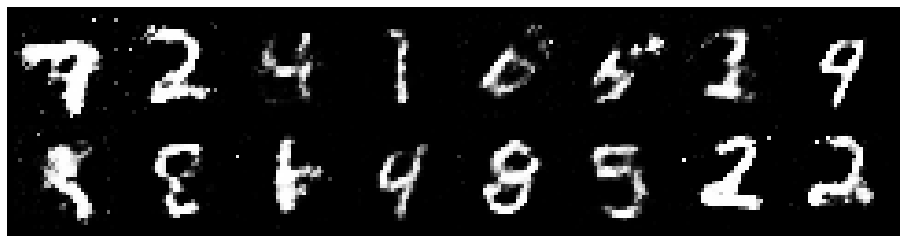

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.2125, Generator Loss: 0.8854
D(x): 0.5826, D(G(z)): 0.4116


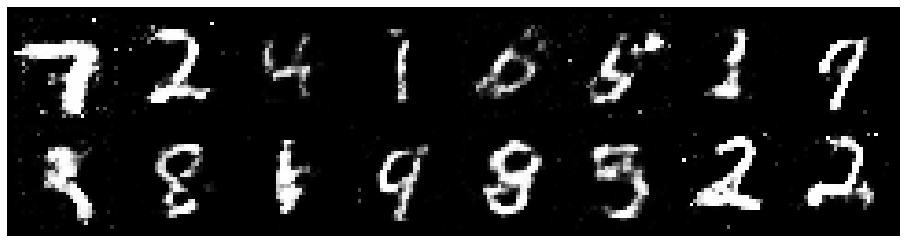

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.3353, Generator Loss: 0.9813
D(x): 0.5567, D(G(z)): 0.4432


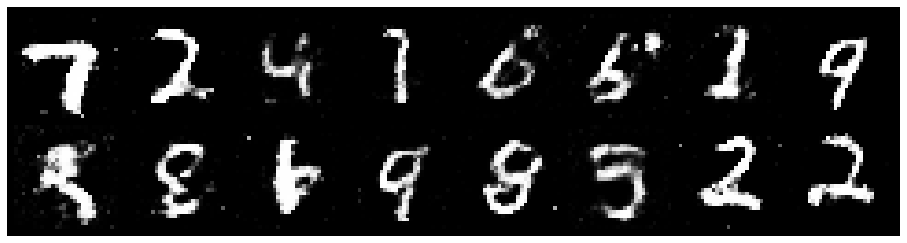

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.2946, Generator Loss: 0.9092
D(x): 0.5364, D(G(z)): 0.4089


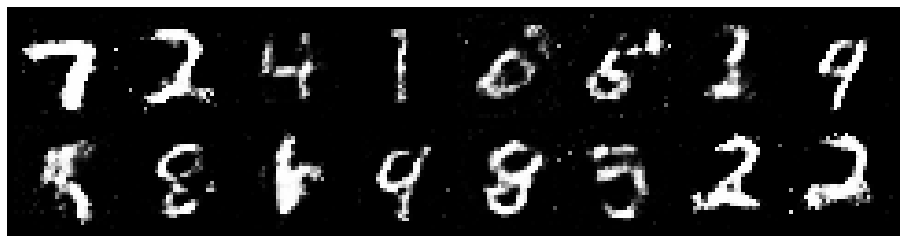

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.2638, Generator Loss: 1.0676
D(x): 0.5617, D(G(z)): 0.4310


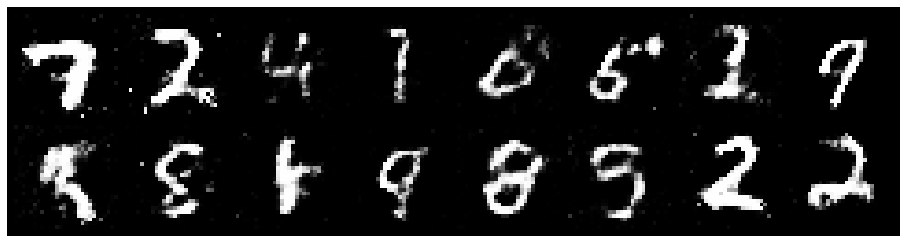

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.2030, Generator Loss: 0.8557
D(x): 0.5814, D(G(z)): 0.4405


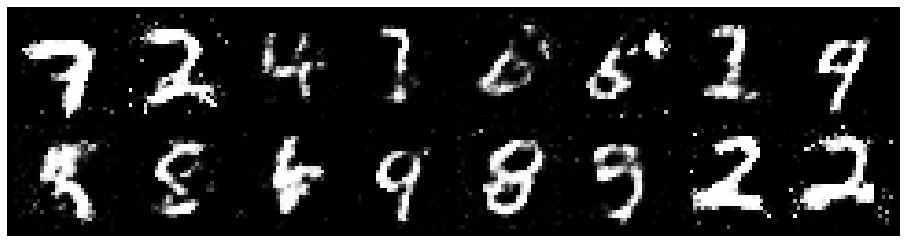

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.3059, Generator Loss: 0.8906
D(x): 0.5316, D(G(z)): 0.4417


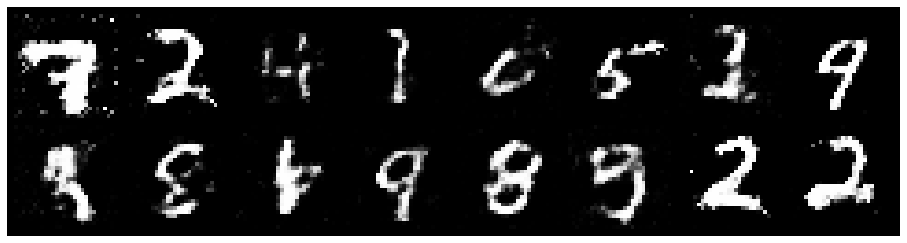

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.3709, Generator Loss: 1.0548
D(x): 0.5980, D(G(z)): 0.4579


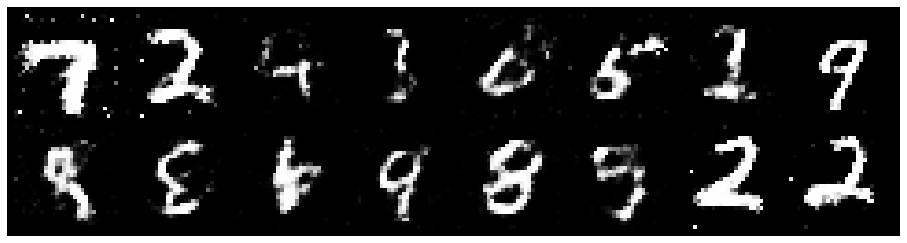

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.2678, Generator Loss: 1.1517
D(x): 0.5742, D(G(z)): 0.4513


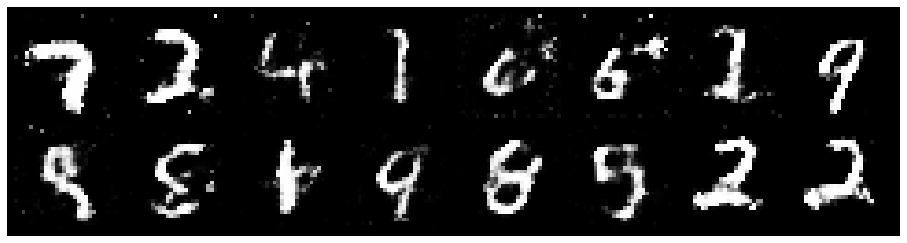

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2233, Generator Loss: 0.9929
D(x): 0.5878, D(G(z)): 0.4528


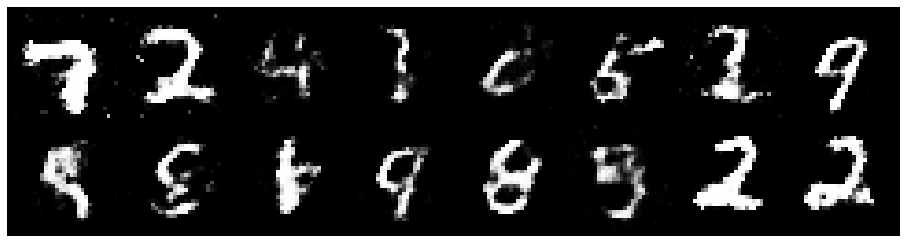

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.3091, Generator Loss: 0.7881
D(x): 0.5330, D(G(z)): 0.4578


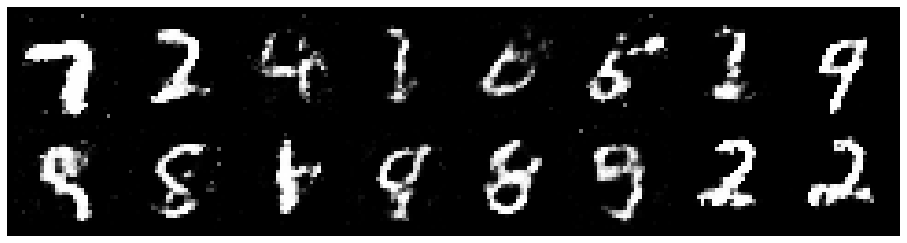

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.2435, Generator Loss: 0.7592
D(x): 0.5880, D(G(z)): 0.4695


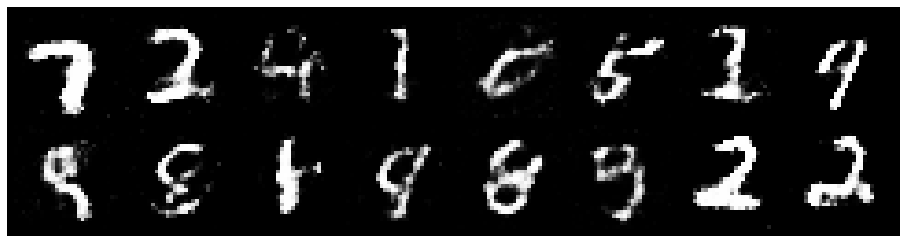

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.3115, Generator Loss: 0.8080
D(x): 0.5584, D(G(z)): 0.4364


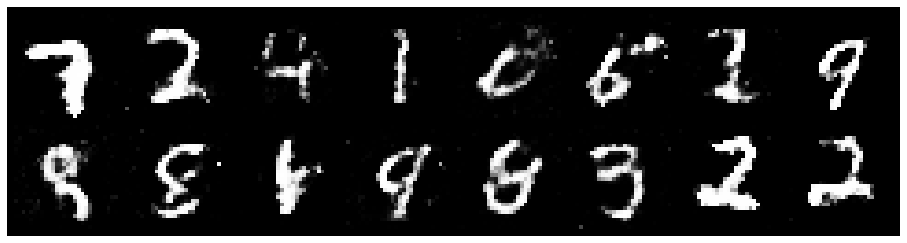

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.2008, Generator Loss: 1.0999
D(x): 0.6050, D(G(z)): 0.4214


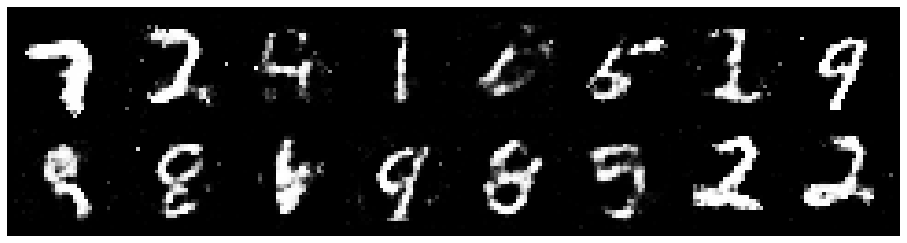

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.2810, Generator Loss: 1.0652
D(x): 0.6045, D(G(z)): 0.4509


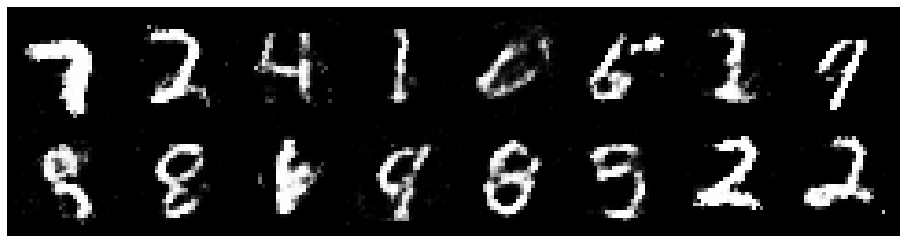

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.1864, Generator Loss: 1.0826
D(x): 0.5859, D(G(z)): 0.4158


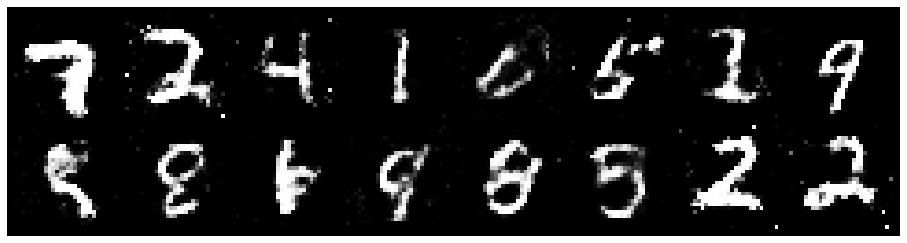

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.1525, Generator Loss: 0.9815
D(x): 0.5967, D(G(z)): 0.4226


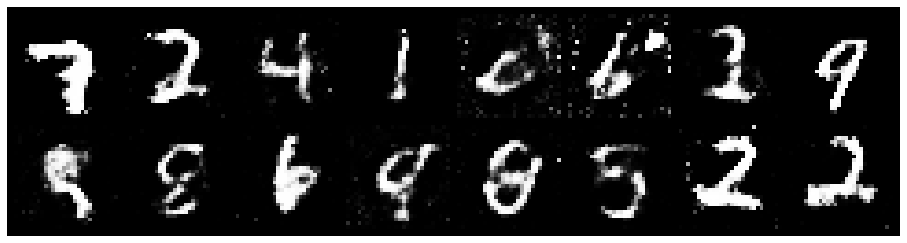

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.3336, Generator Loss: 0.9834
D(x): 0.5318, D(G(z)): 0.4282


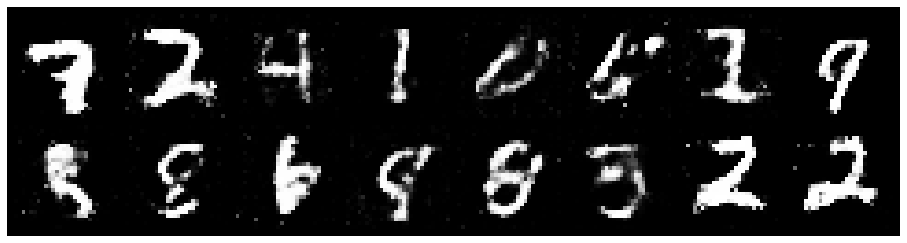

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.1118, Generator Loss: 0.9588
D(x): 0.6108, D(G(z)): 0.4124


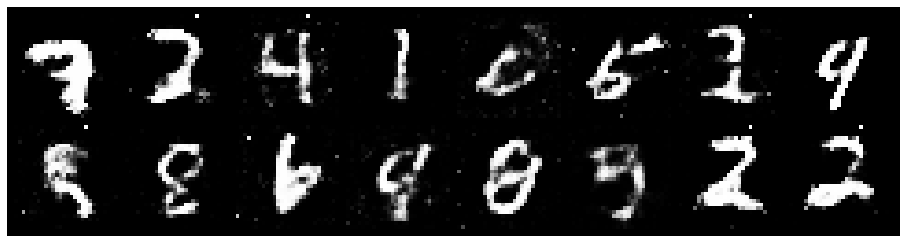

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.2500, Generator Loss: 1.0191
D(x): 0.5551, D(G(z)): 0.4213


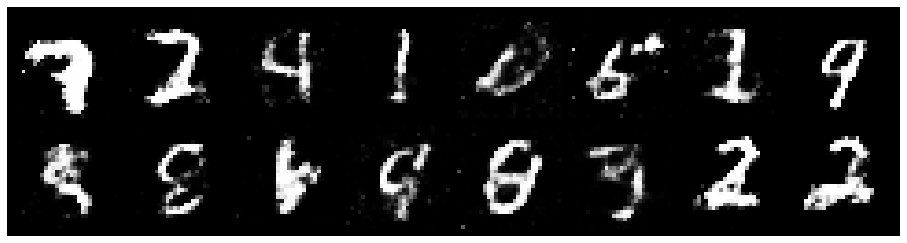

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2560, Generator Loss: 0.7502
D(x): 0.6106, D(G(z)): 0.4768


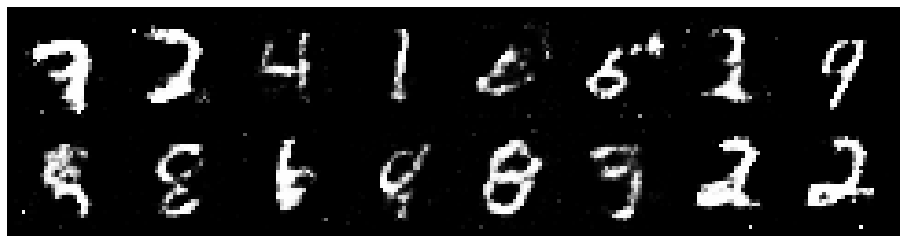

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.1777, Generator Loss: 1.0336
D(x): 0.5797, D(G(z)): 0.4201


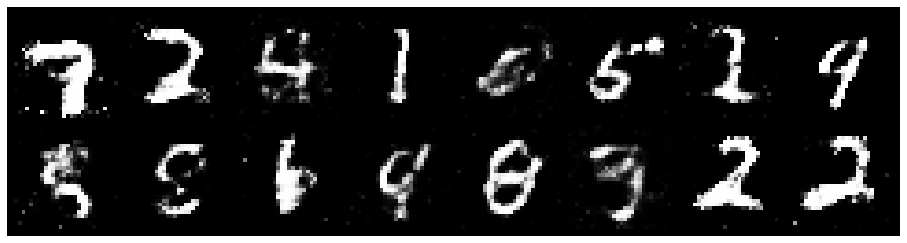

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.2183, Generator Loss: 0.9676
D(x): 0.5862, D(G(z)): 0.4407


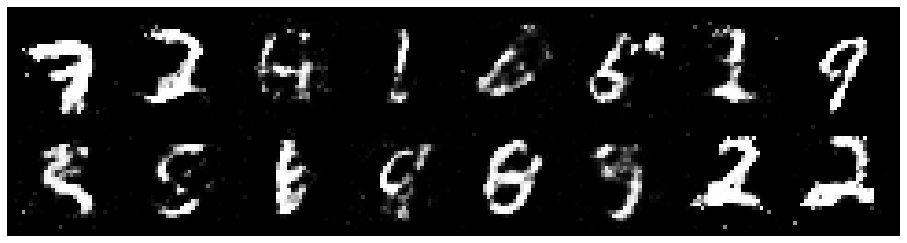

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2807, Generator Loss: 0.9475
D(x): 0.5449, D(G(z)): 0.4218


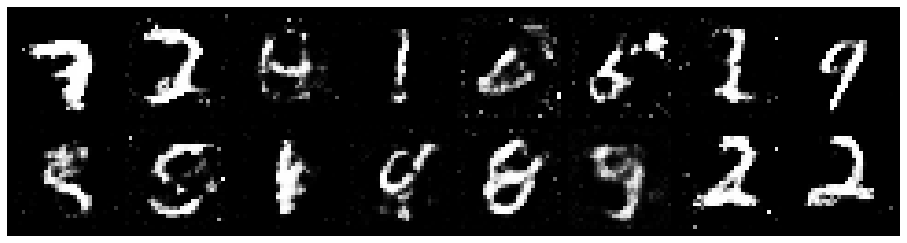

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2676, Generator Loss: 0.8872
D(x): 0.5664, D(G(z)): 0.4391


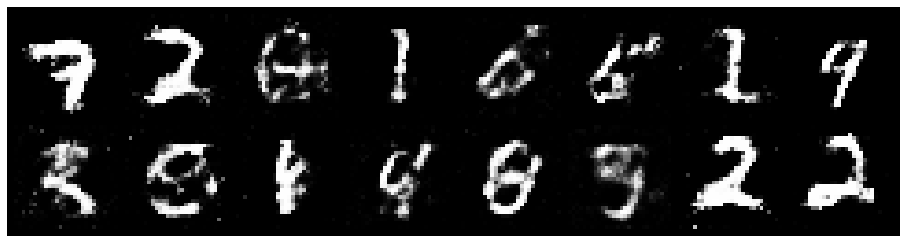

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.1837, Generator Loss: 1.1941
D(x): 0.5720, D(G(z)): 0.3854


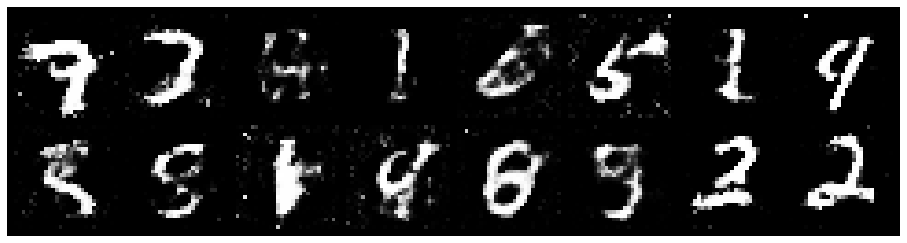

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.1748, Generator Loss: 0.9466
D(x): 0.6003, D(G(z)): 0.4319


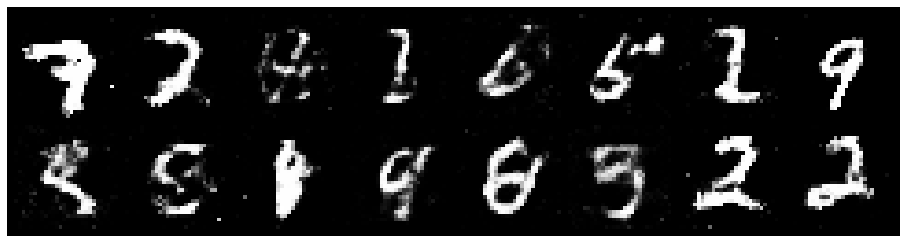

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.0848, Generator Loss: 0.9767
D(x): 0.6387, D(G(z)): 0.4223


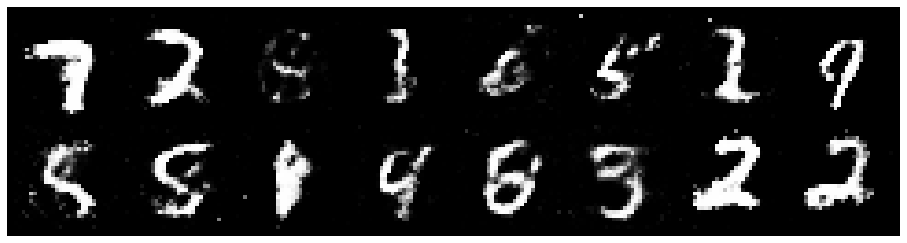

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2687, Generator Loss: 0.9717
D(x): 0.5707, D(G(z)): 0.4393


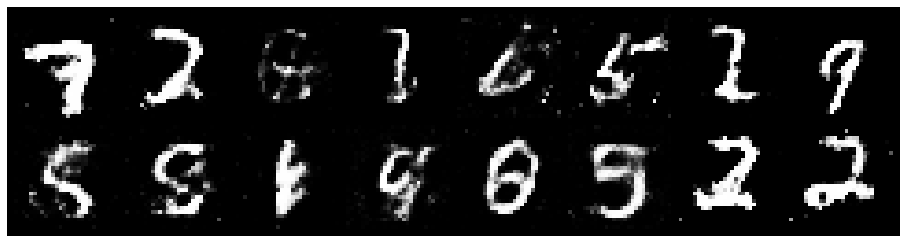

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2514, Generator Loss: 0.9159
D(x): 0.5377, D(G(z)): 0.3897


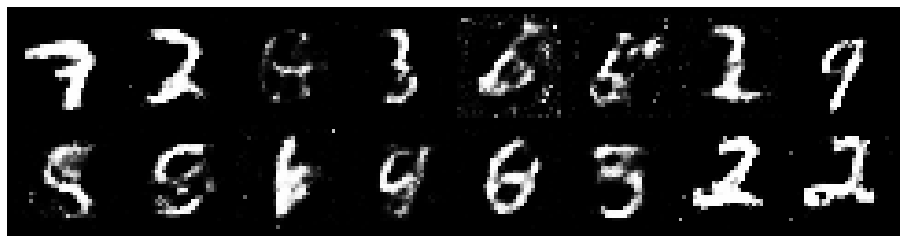

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.1427, Generator Loss: 0.9693
D(x): 0.5830, D(G(z)): 0.3995


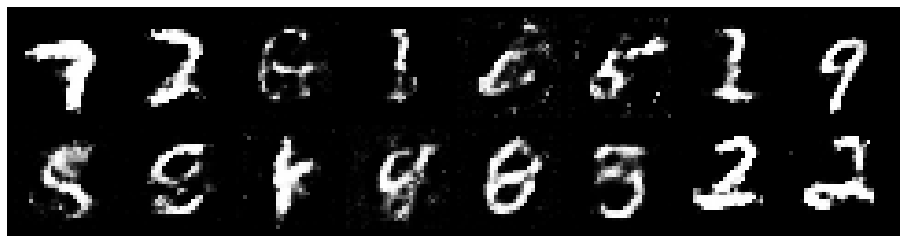

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.2037, Generator Loss: 1.0553
D(x): 0.5648, D(G(z)): 0.4177


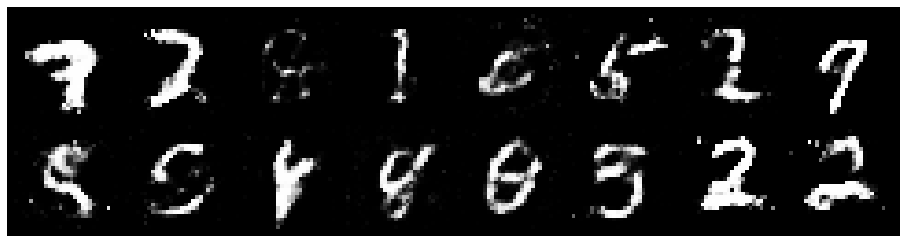

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.2318, Generator Loss: 0.9405
D(x): 0.5629, D(G(z)): 0.4155


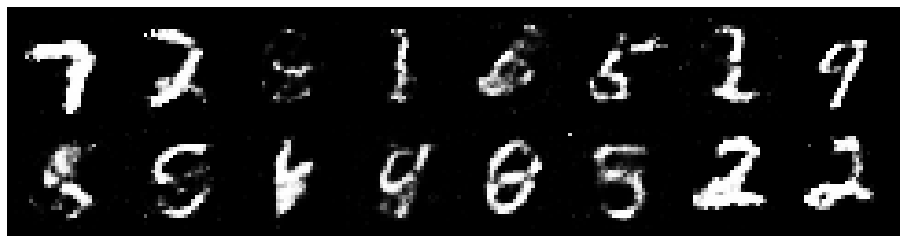

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.2857, Generator Loss: 0.8826
D(x): 0.5459, D(G(z)): 0.4517


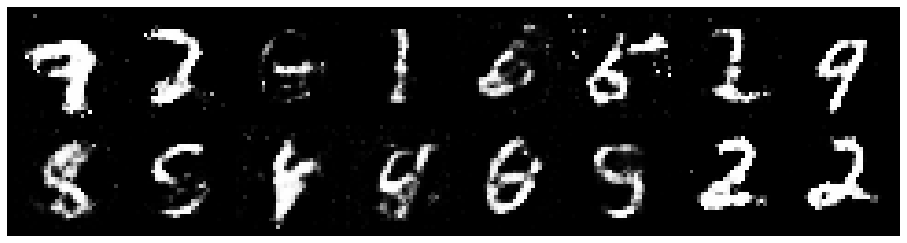

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.2912, Generator Loss: 0.9774
D(x): 0.5379, D(G(z)): 0.4249


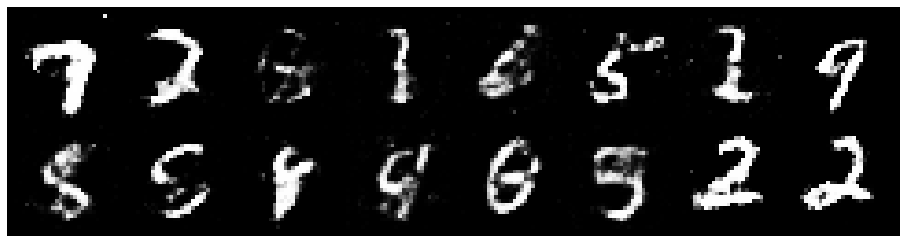

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.1704, Generator Loss: 1.1043
D(x): 0.5661, D(G(z)): 0.3915


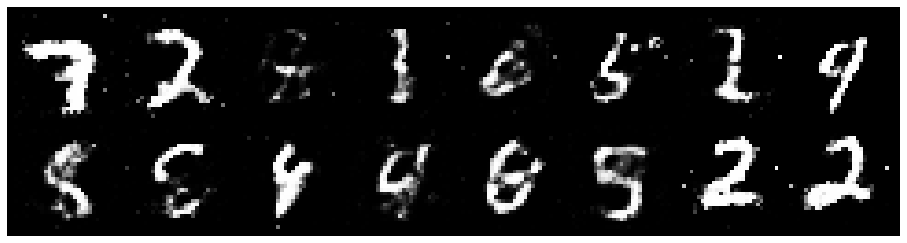

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.3210, Generator Loss: 0.8942
D(x): 0.5564, D(G(z)): 0.4365


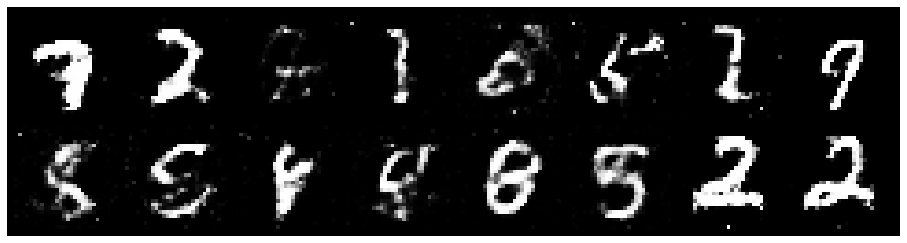

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.2773, Generator Loss: 0.9916
D(x): 0.5481, D(G(z)): 0.4161


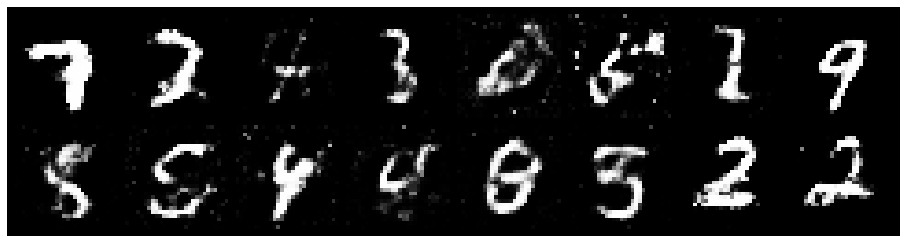

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.3158, Generator Loss: 0.7929
D(x): 0.5770, D(G(z)): 0.4837


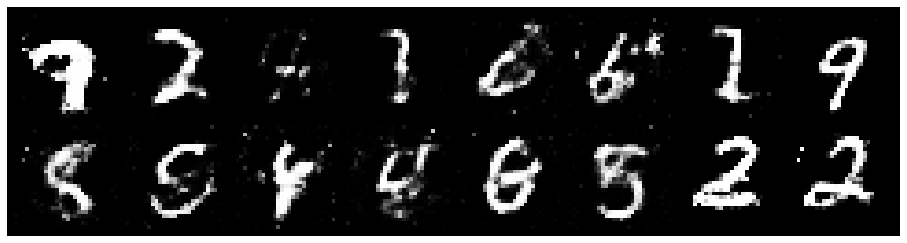

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.3441, Generator Loss: 0.8379
D(x): 0.5544, D(G(z)): 0.4763


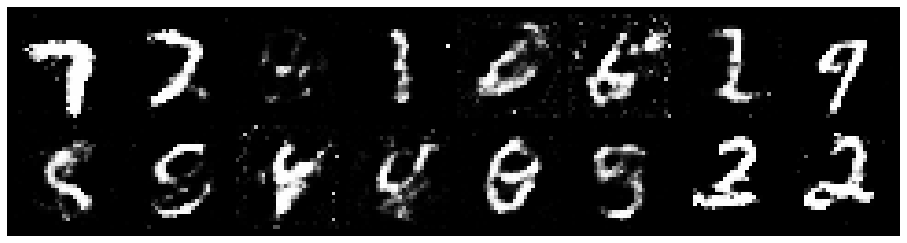

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.3516, Generator Loss: 0.9639
D(x): 0.5578, D(G(z)): 0.4488


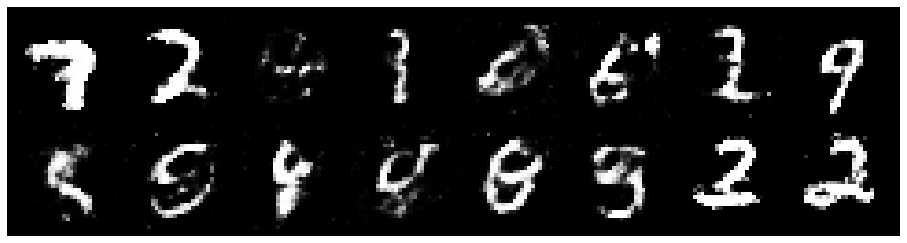

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.1229, Generator Loss: 1.1279
D(x): 0.6049, D(G(z)): 0.4058


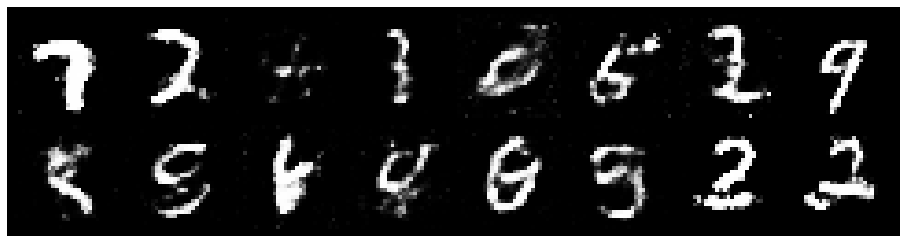

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.3453, Generator Loss: 1.1680
D(x): 0.5589, D(G(z)): 0.4304


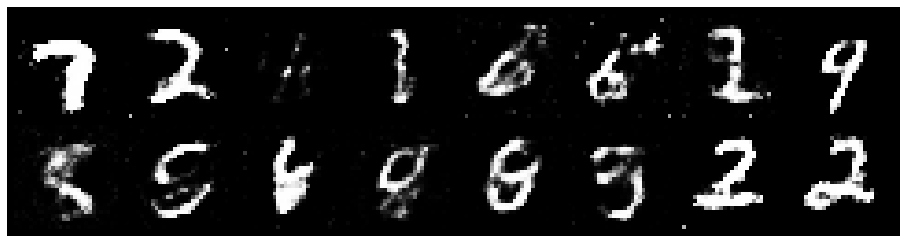

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.2040, Generator Loss: 1.0948
D(x): 0.5943, D(G(z)): 0.4056


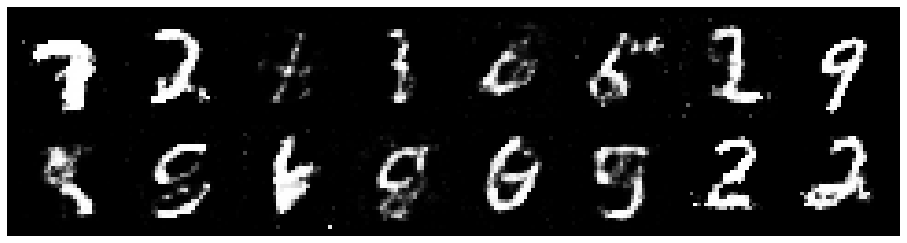

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.2665, Generator Loss: 1.0333
D(x): 0.5880, D(G(z)): 0.4416


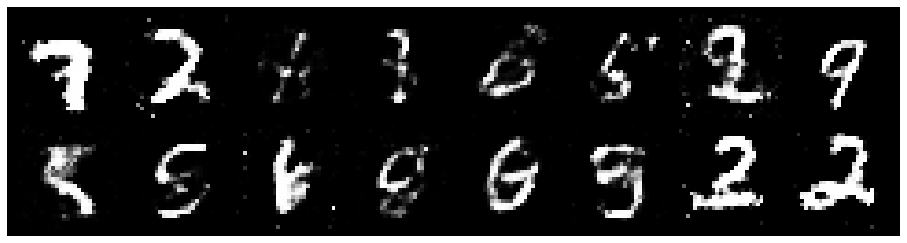

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.1099, Generator Loss: 0.9760
D(x): 0.6042, D(G(z)): 0.3832


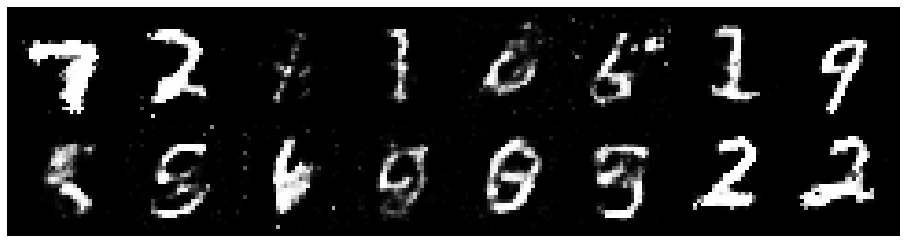

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.2987, Generator Loss: 1.0732
D(x): 0.5815, D(G(z)): 0.4387


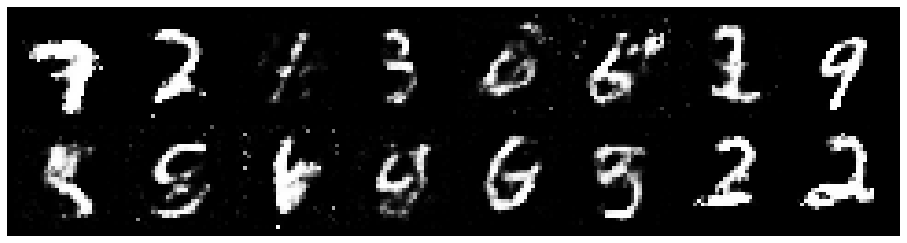

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.2149, Generator Loss: 1.1360
D(x): 0.5858, D(G(z)): 0.4151


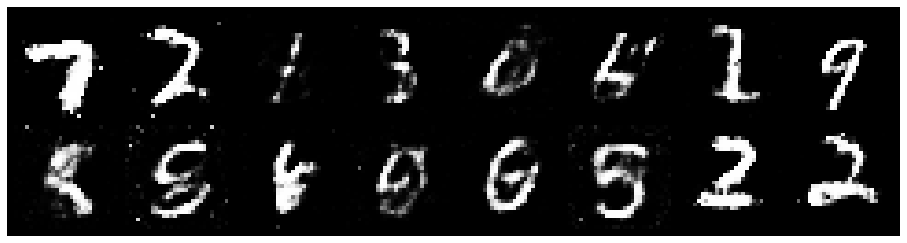

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.2090, Generator Loss: 1.0355
D(x): 0.5955, D(G(z)): 0.4244


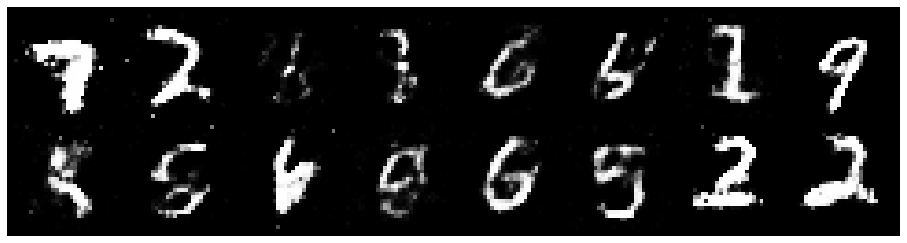

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2604, Generator Loss: 0.9538
D(x): 0.5602, D(G(z)): 0.4190


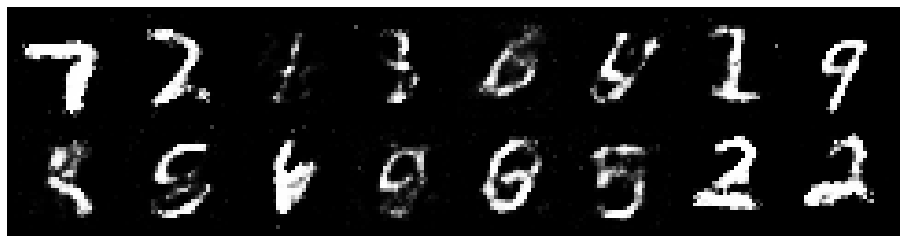

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.2636, Generator Loss: 1.0263
D(x): 0.5386, D(G(z)): 0.4115


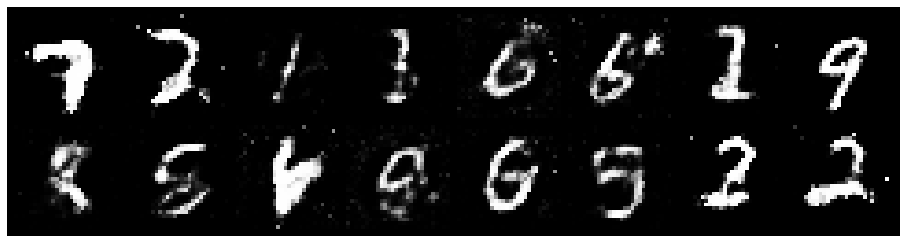

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.1517, Generator Loss: 1.1703
D(x): 0.5483, D(G(z)): 0.3754


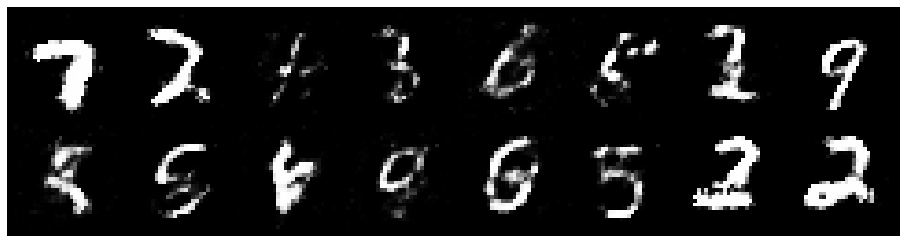

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.2230, Generator Loss: 0.9613
D(x): 0.5149, D(G(z)): 0.3890


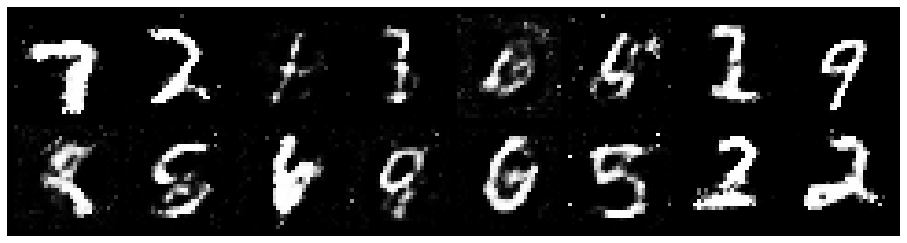

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.2279, Generator Loss: 0.9306
D(x): 0.5560, D(G(z)): 0.4294


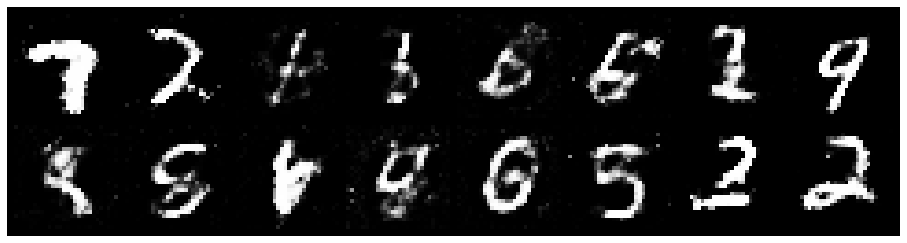

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.3851, Generator Loss: 0.8534
D(x): 0.5342, D(G(z)): 0.4881


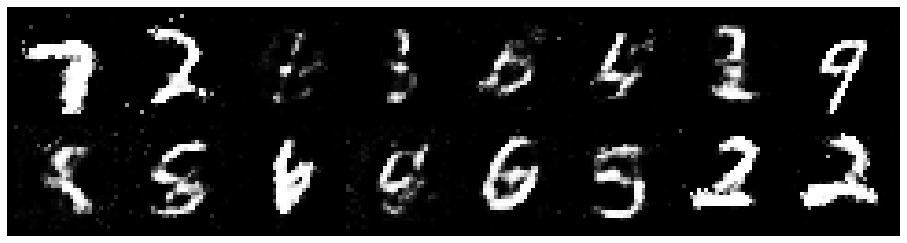

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.3050, Generator Loss: 0.9586
D(x): 0.5540, D(G(z)): 0.4611


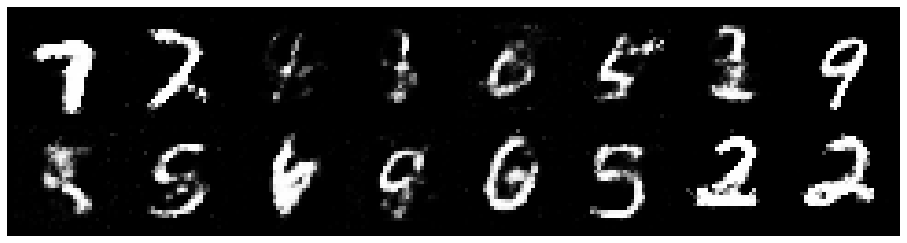

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.1727, Generator Loss: 0.8400
D(x): 0.6020, D(G(z)): 0.4504


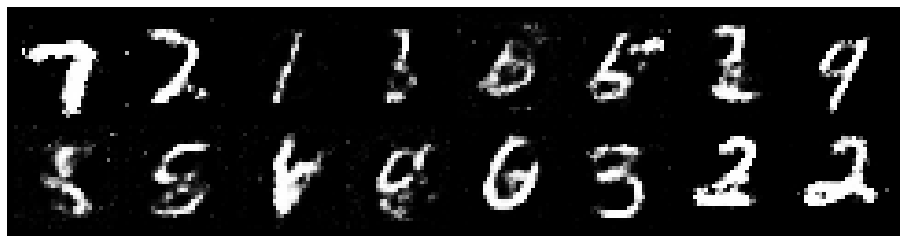

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.2270, Generator Loss: 0.8852
D(x): 0.5412, D(G(z)): 0.4175


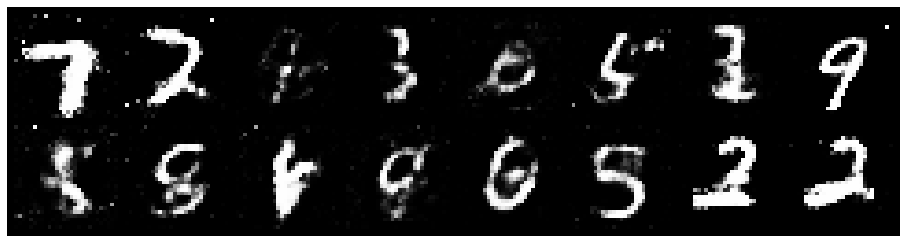

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.2799, Generator Loss: 0.8962
D(x): 0.5133, D(G(z)): 0.4086


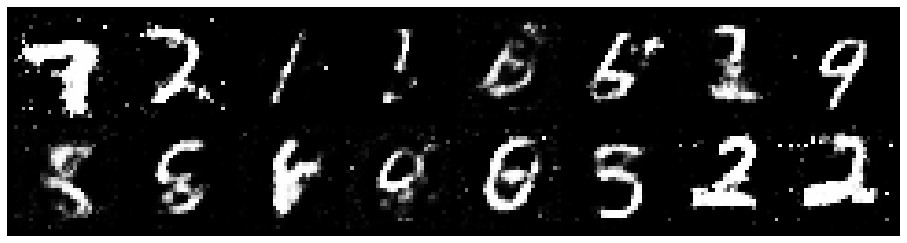

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.1736, Generator Loss: 0.9690
D(x): 0.6233, D(G(z)): 0.4386


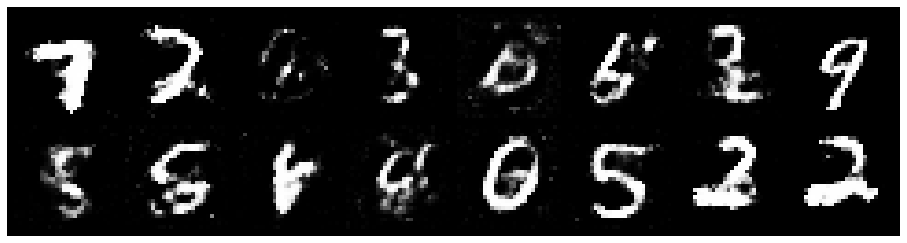

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.1929, Generator Loss: 0.9987
D(x): 0.5824, D(G(z)): 0.4292


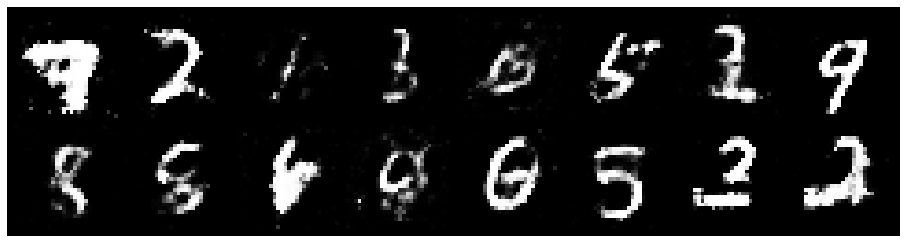

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.2370, Generator Loss: 0.9029
D(x): 0.5787, D(G(z)): 0.4538


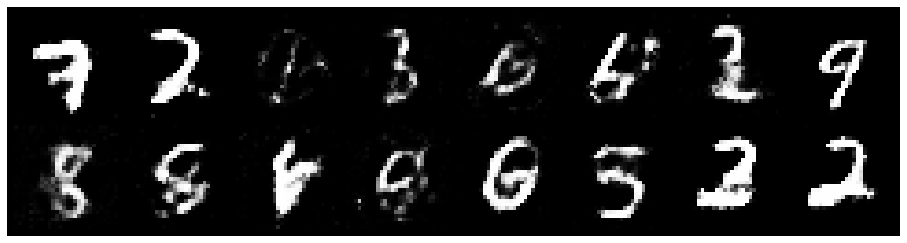

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.3445, Generator Loss: 0.9246
D(x): 0.5069, D(G(z)): 0.4399


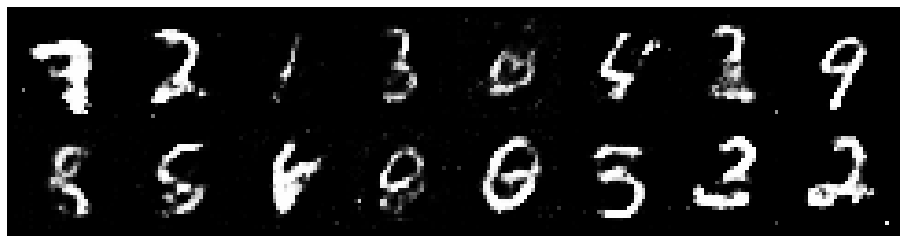

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.2466, Generator Loss: 0.8487
D(x): 0.5512, D(G(z)): 0.4293


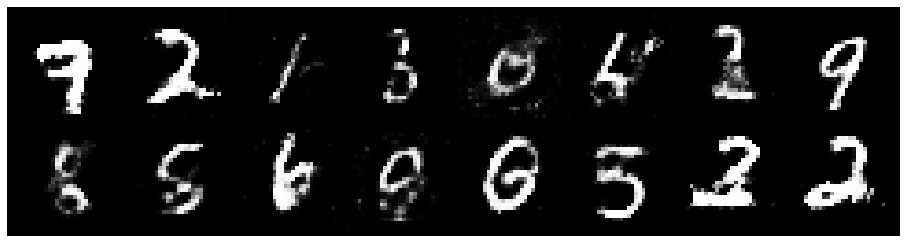

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.3504, Generator Loss: 0.7553
D(x): 0.5610, D(G(z)): 0.4894


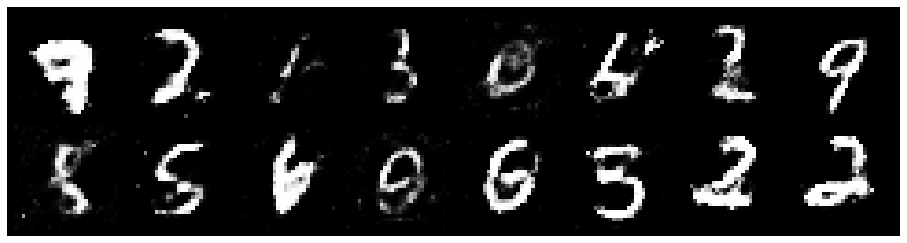

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.2399, Generator Loss: 0.8803
D(x): 0.5899, D(G(z)): 0.4447


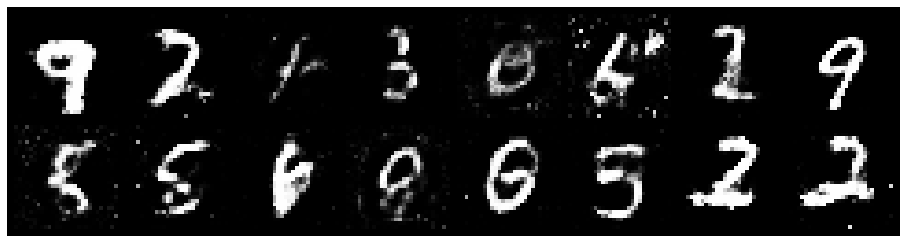

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.2773, Generator Loss: 0.9682
D(x): 0.5256, D(G(z)): 0.4166


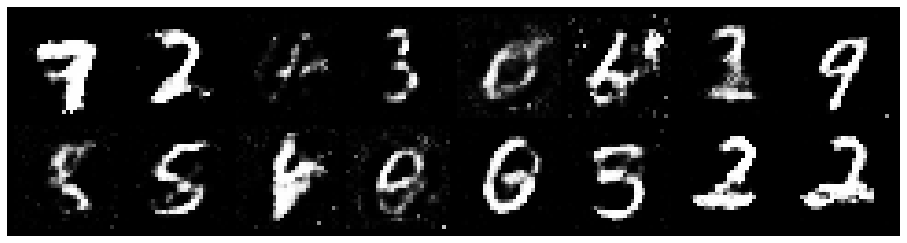

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.3193, Generator Loss: 0.9380
D(x): 0.5655, D(G(z)): 0.4602


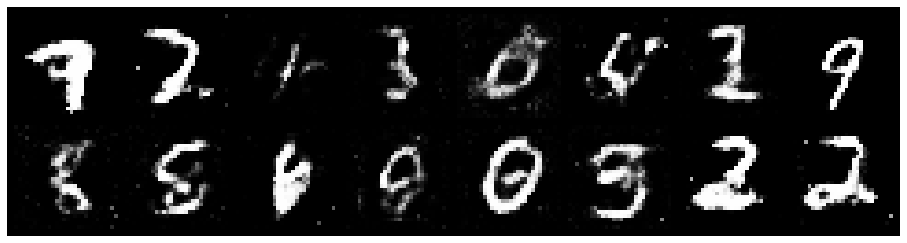

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.3429, Generator Loss: 0.7515
D(x): 0.5645, D(G(z)): 0.4899


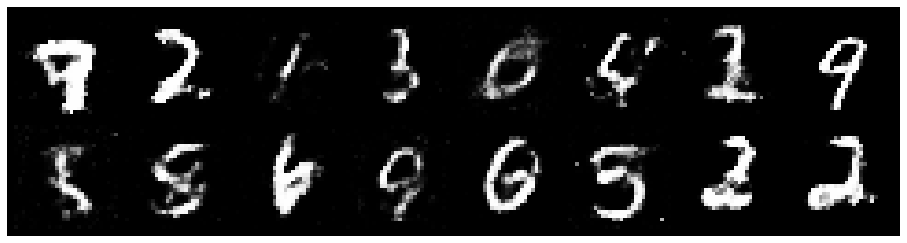

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.3280, Generator Loss: 0.8276
D(x): 0.5453, D(G(z)): 0.4801


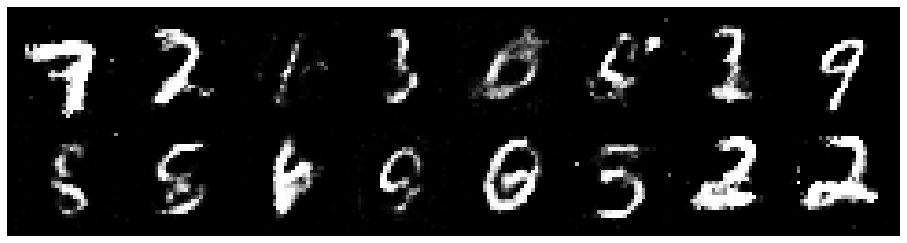

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.3262, Generator Loss: 0.9156
D(x): 0.5306, D(G(z)): 0.4538


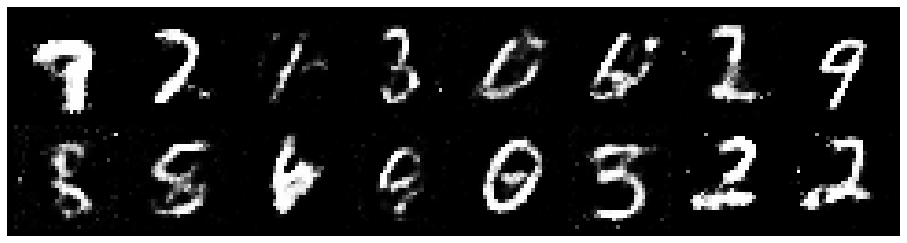

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.2440, Generator Loss: 0.8453
D(x): 0.5432, D(G(z)): 0.4208


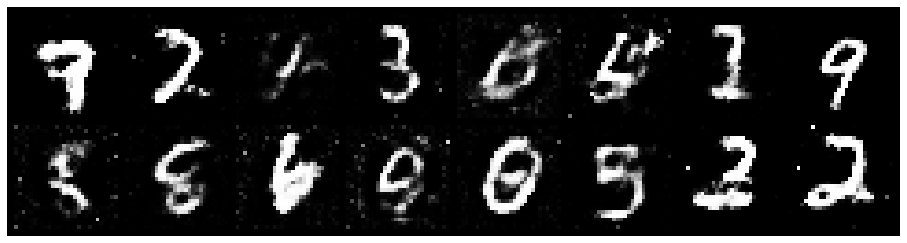

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.2057, Generator Loss: 0.9071
D(x): 0.5798, D(G(z)): 0.4252


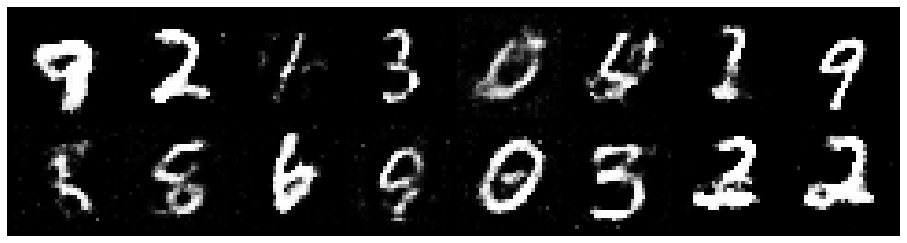

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.1900, Generator Loss: 0.9772
D(x): 0.6023, D(G(z)): 0.4265


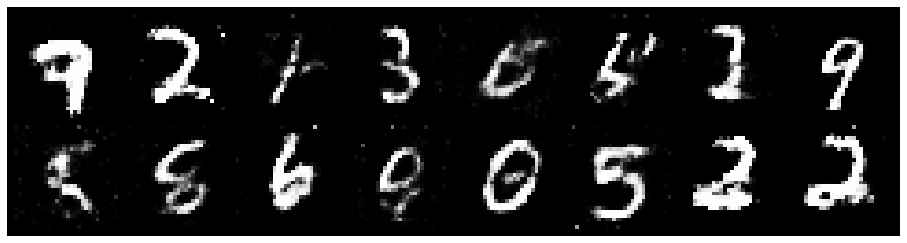

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.1415, Generator Loss: 1.0596
D(x): 0.5342, D(G(z)): 0.3570


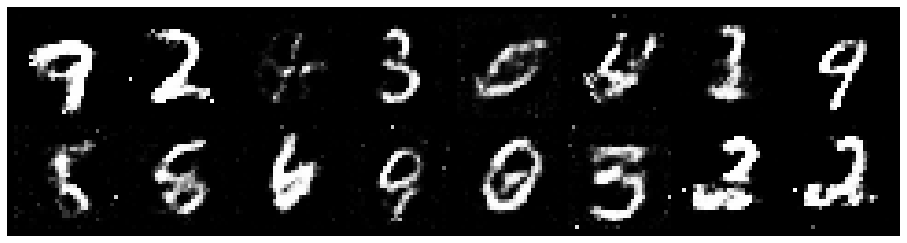

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.1501, Generator Loss: 1.0073
D(x): 0.5915, D(G(z)): 0.3978


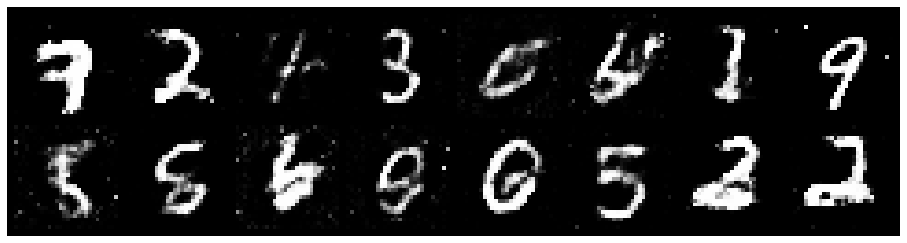

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.2449, Generator Loss: 1.0019
D(x): 0.5604, D(G(z)): 0.4138


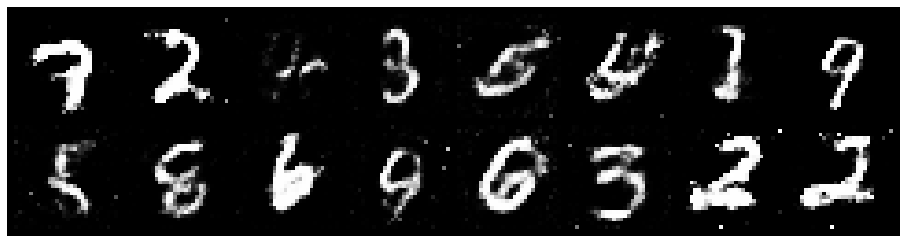

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.2482, Generator Loss: 0.8840
D(x): 0.5725, D(G(z)): 0.4569


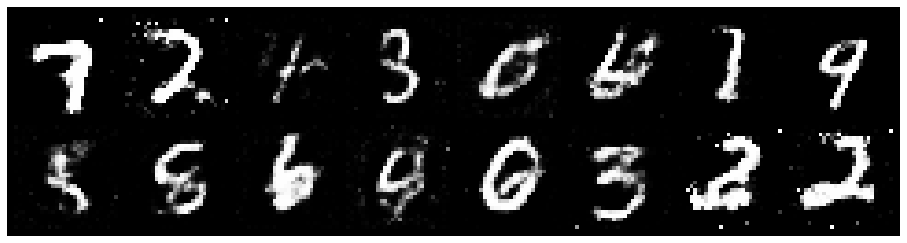

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2659, Generator Loss: 0.8359
D(x): 0.5480, D(G(z)): 0.4453


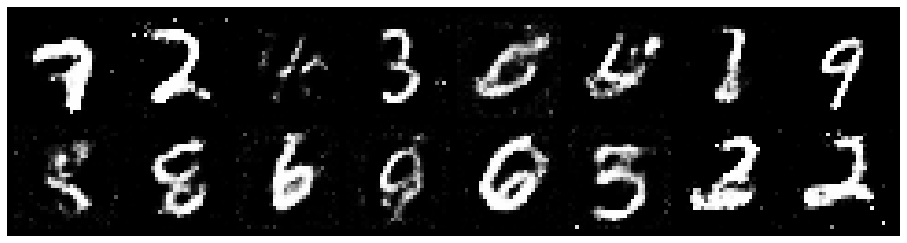

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.1846, Generator Loss: 0.8336
D(x): 0.6079, D(G(z)): 0.4522


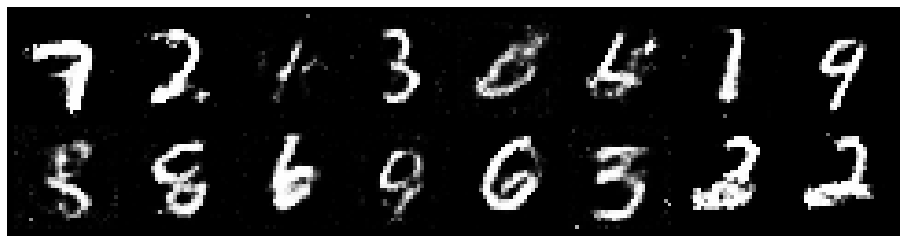

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.2462, Generator Loss: 1.0151
D(x): 0.5315, D(G(z)): 0.3932


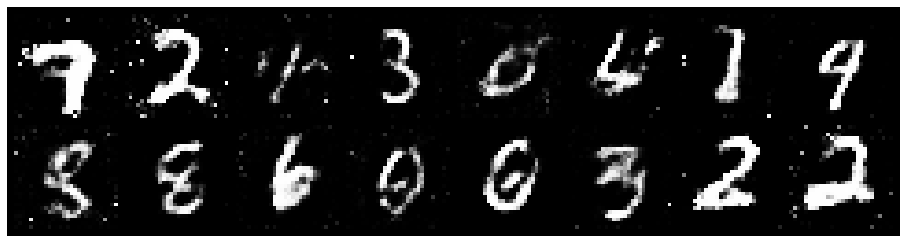

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.2721, Generator Loss: 0.8866
D(x): 0.5430, D(G(z)): 0.4515


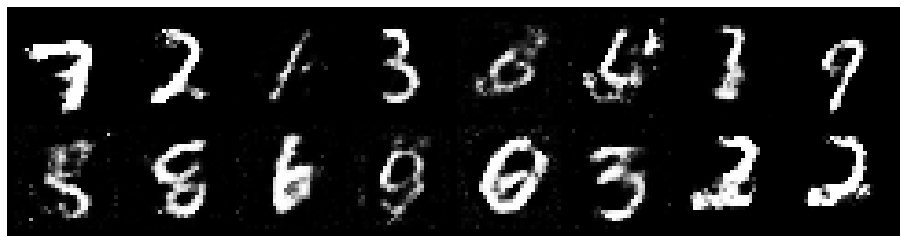

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.2461, Generator Loss: 0.8446
D(x): 0.5723, D(G(z)): 0.4472


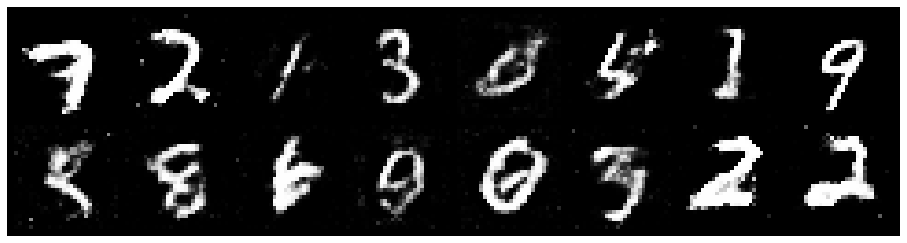

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.3398, Generator Loss: 0.7941
D(x): 0.5408, D(G(z)): 0.4677


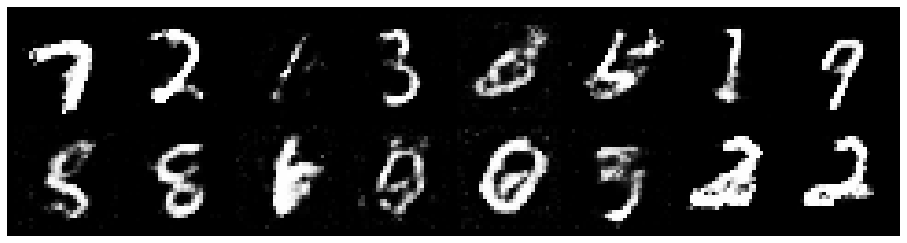

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.3153, Generator Loss: 0.8343
D(x): 0.5696, D(G(z)): 0.4550


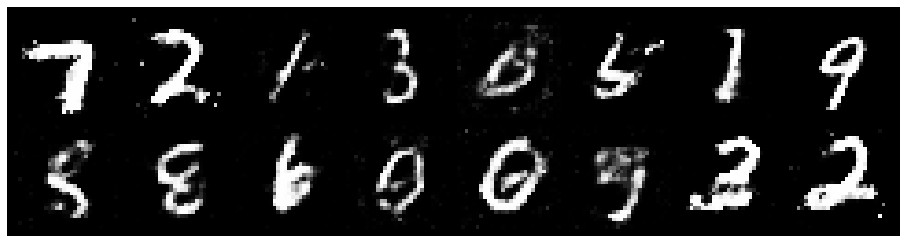

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2821, Generator Loss: 1.1206
D(x): 0.5536, D(G(z)): 0.4205


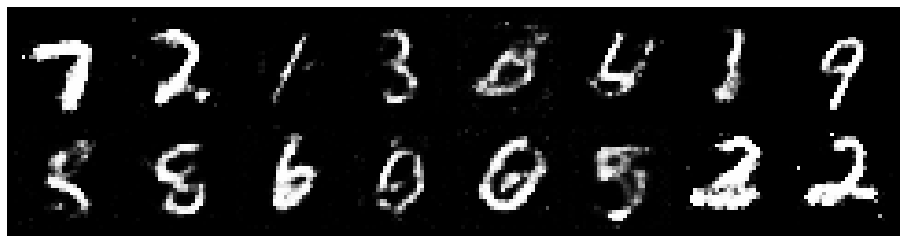

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.3161, Generator Loss: 0.9521
D(x): 0.5620, D(G(z)): 0.4392


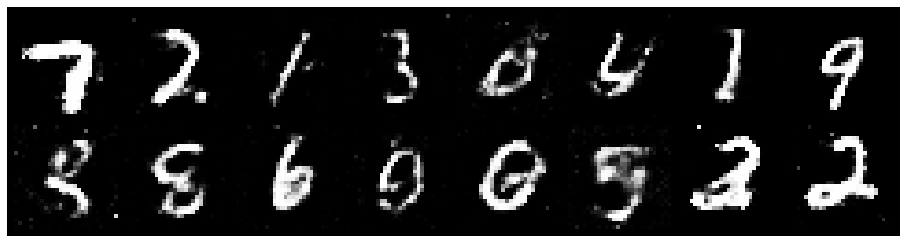

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.3648, Generator Loss: 0.9935
D(x): 0.5606, D(G(z)): 0.4571


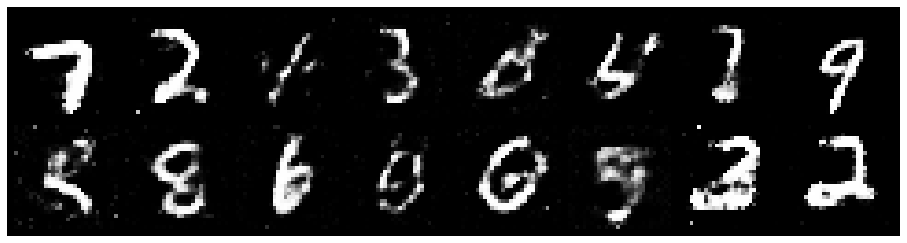

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.3571, Generator Loss: 0.8138
D(x): 0.5328, D(G(z)): 0.4504


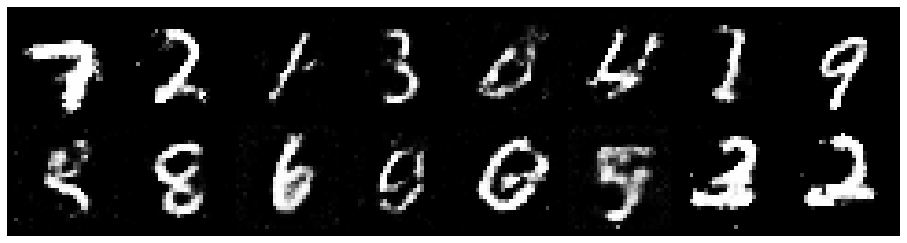

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.2979, Generator Loss: 0.8680
D(x): 0.5444, D(G(z)): 0.4504


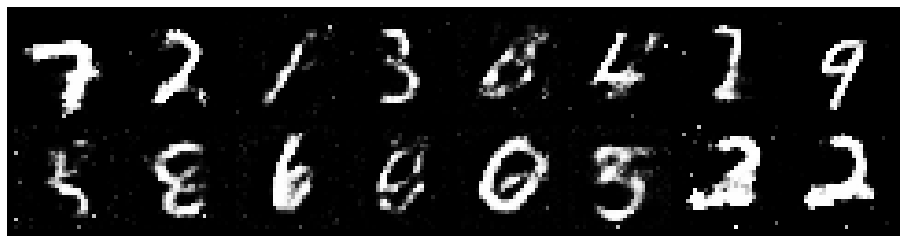

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.3159, Generator Loss: 0.9341
D(x): 0.5495, D(G(z)): 0.4500


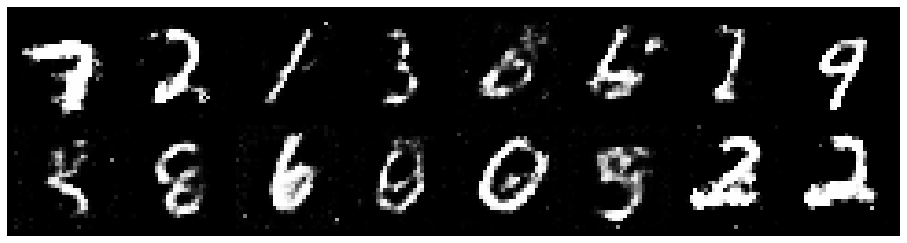

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.5088, Generator Loss: 0.7728
D(x): 0.5465, D(G(z)): 0.5189


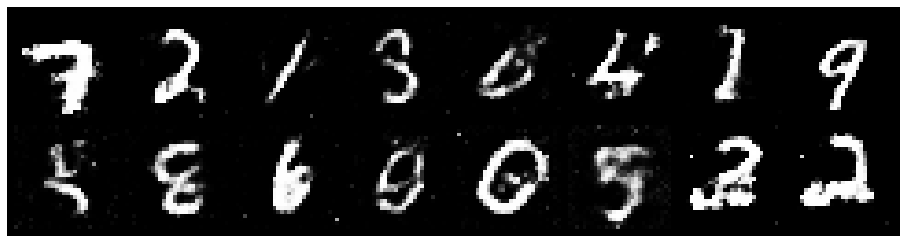

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.3004, Generator Loss: 0.9766
D(x): 0.5871, D(G(z)): 0.4653


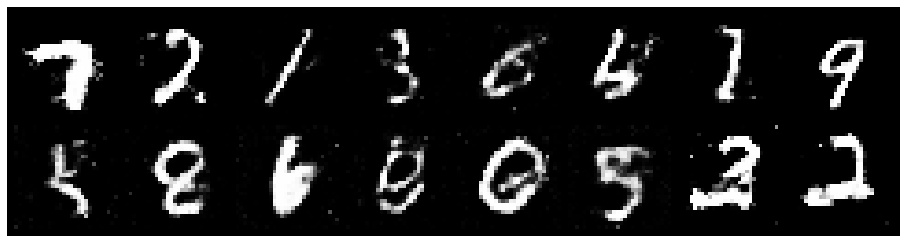

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.3453, Generator Loss: 1.0069
D(x): 0.5750, D(G(z)): 0.4593


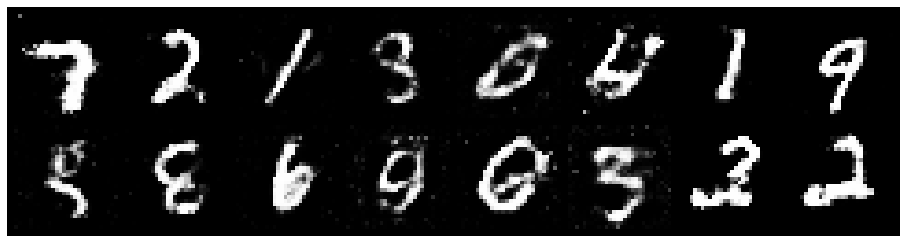

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.1423, Generator Loss: 0.9991
D(x): 0.5818, D(G(z)): 0.3959


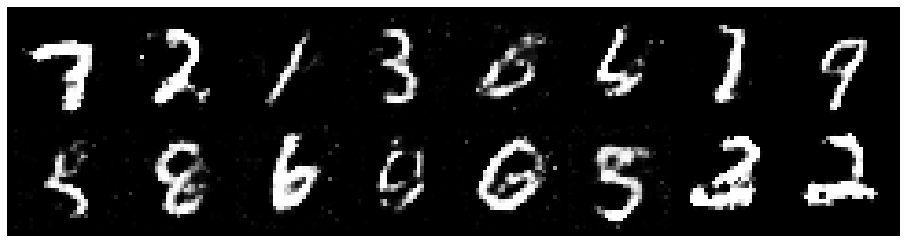

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.1339, Generator Loss: 1.0868
D(x): 0.5842, D(G(z)): 0.3962


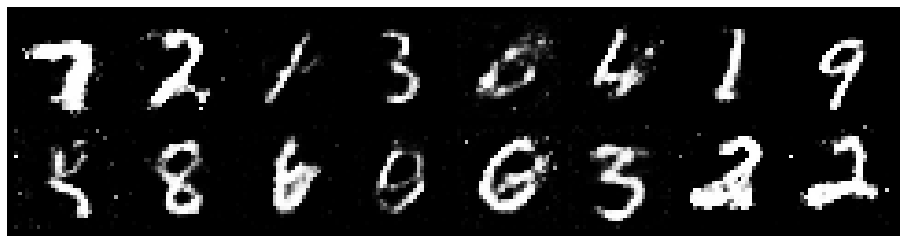

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2325, Generator Loss: 0.9862
D(x): 0.5741, D(G(z)): 0.4258


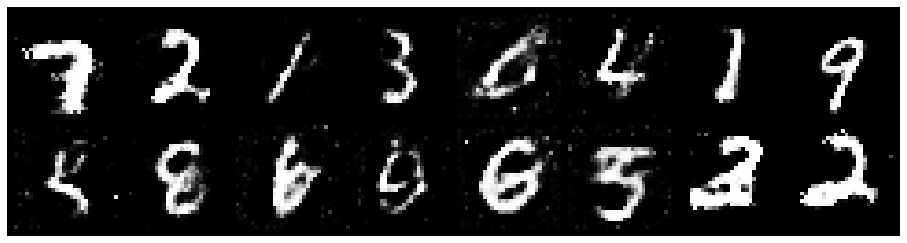

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.3061, Generator Loss: 0.8664
D(x): 0.5475, D(G(z)): 0.4475


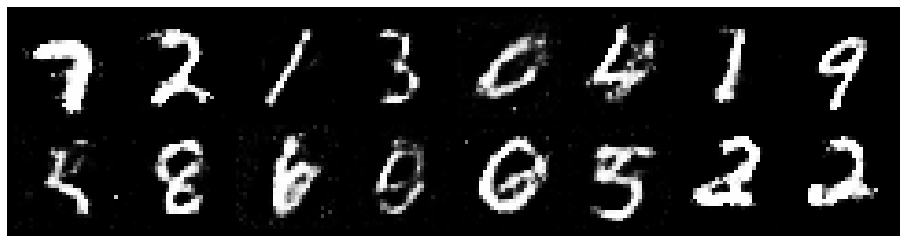

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.2578, Generator Loss: 0.8588
D(x): 0.5890, D(G(z)): 0.4585


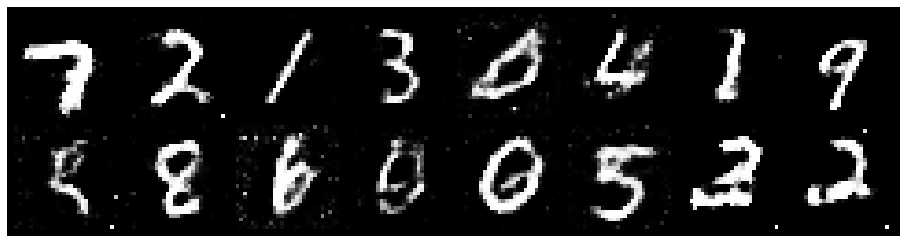

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.3631, Generator Loss: 0.8725
D(x): 0.5908, D(G(z)): 0.5013


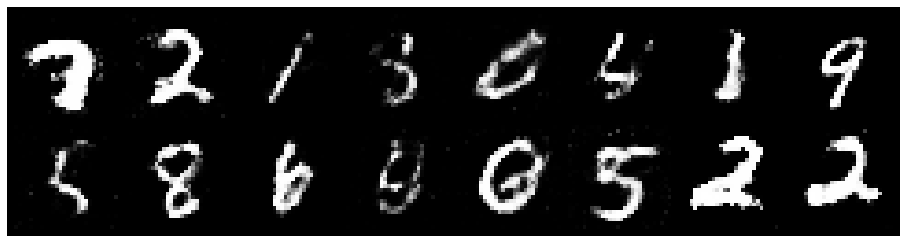

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.1935, Generator Loss: 0.9764
D(x): 0.5721, D(G(z)): 0.4356


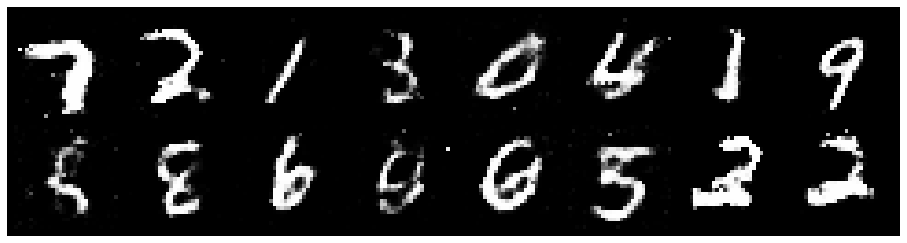

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.2373, Generator Loss: 0.9361
D(x): 0.5728, D(G(z)): 0.4471


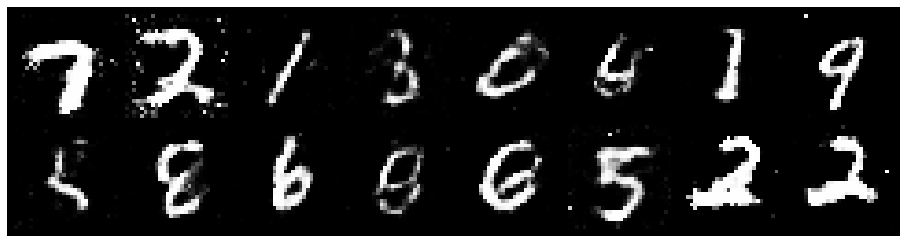

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.3391, Generator Loss: 0.8749
D(x): 0.5339, D(G(z)): 0.4626


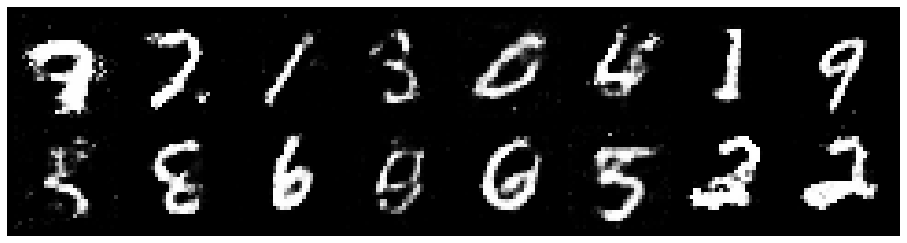

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.3214, Generator Loss: 0.8531
D(x): 0.5505, D(G(z)): 0.4799


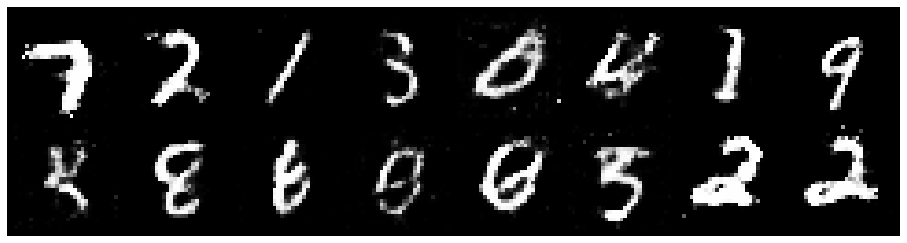

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2338, Generator Loss: 0.8036
D(x): 0.5539, D(G(z)): 0.4388


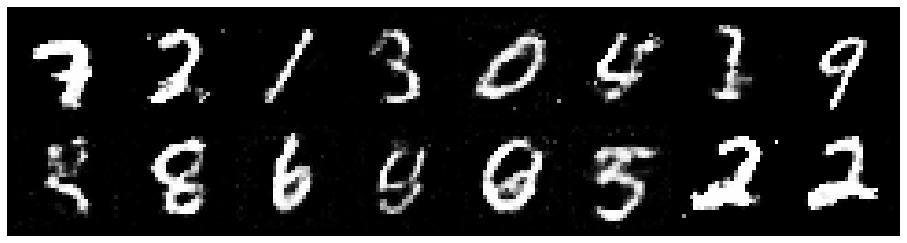

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2894, Generator Loss: 0.8240
D(x): 0.5401, D(G(z)): 0.4596


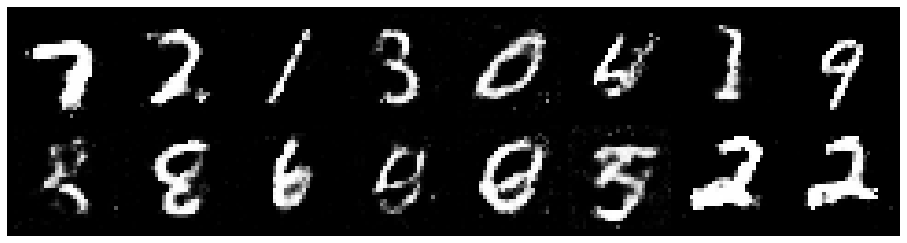

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.3333, Generator Loss: 0.8458
D(x): 0.5474, D(G(z)): 0.4676


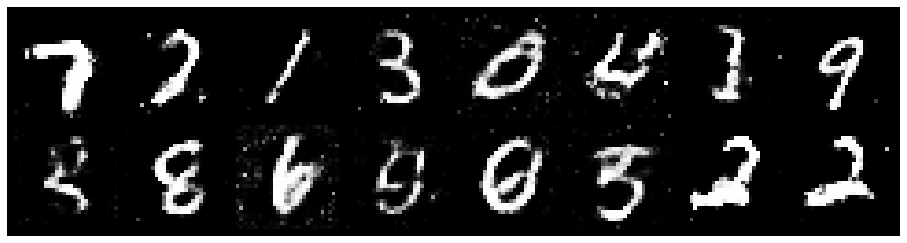

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.3068, Generator Loss: 1.0076
D(x): 0.5173, D(G(z)): 0.4132


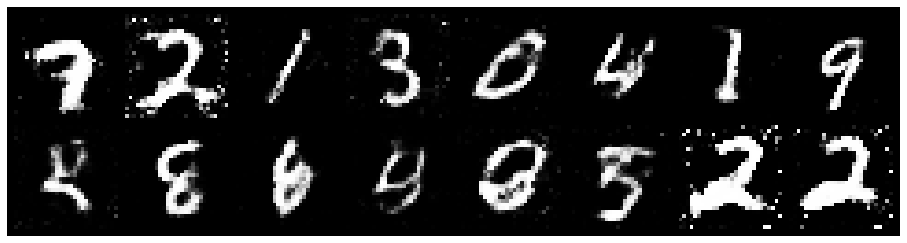

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.1758, Generator Loss: 0.9008
D(x): 0.5799, D(G(z)): 0.4249


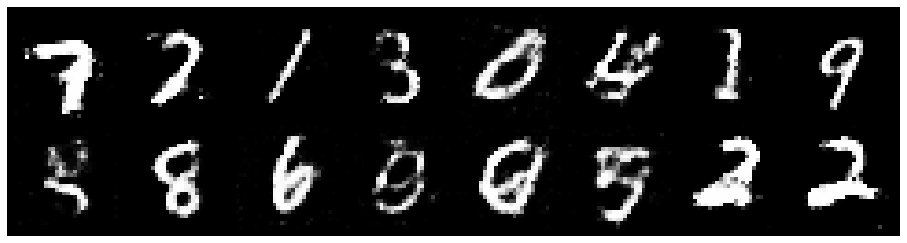

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.2265, Generator Loss: 1.0641
D(x): 0.5721, D(G(z)): 0.4200


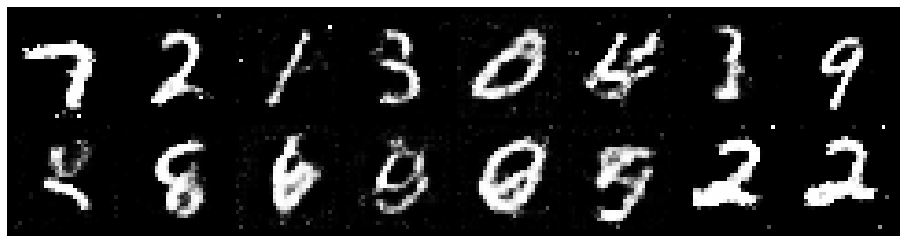

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.1625, Generator Loss: 1.0695
D(x): 0.5465, D(G(z)): 0.3716


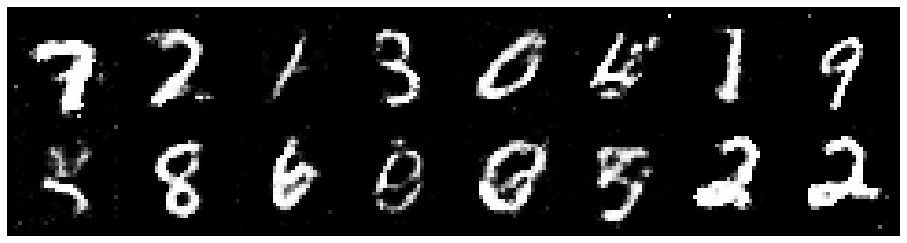

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2251, Generator Loss: 0.8914
D(x): 0.5855, D(G(z)): 0.4552


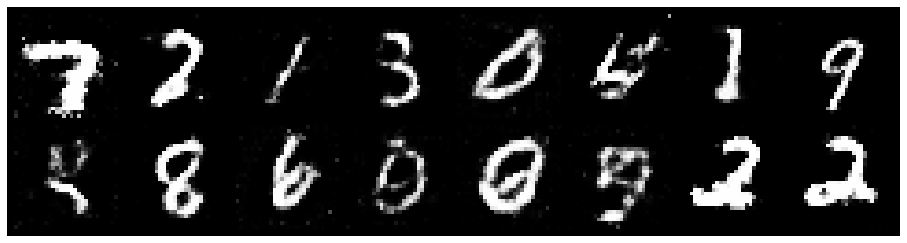

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.1187, Generator Loss: 1.0734
D(x): 0.5911, D(G(z)): 0.3843


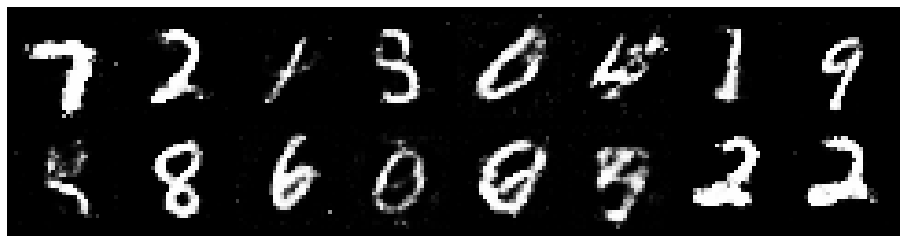

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2186, Generator Loss: 1.1646
D(x): 0.5733, D(G(z)): 0.4214


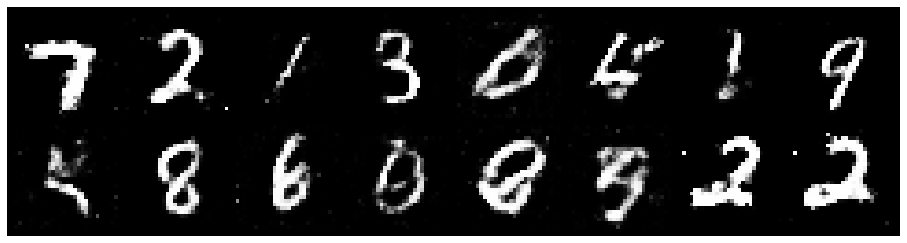

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.1968, Generator Loss: 0.9012
D(x): 0.5701, D(G(z)): 0.4298


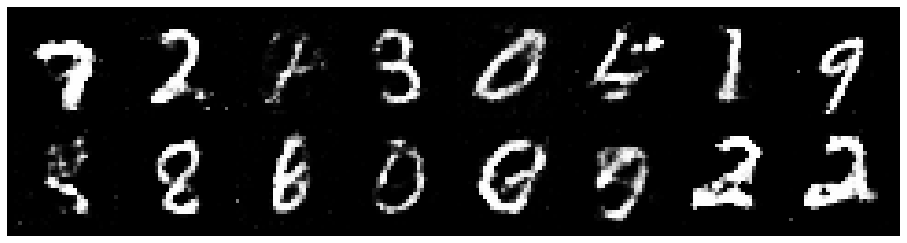

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2267, Generator Loss: 0.8445
D(x): 0.5439, D(G(z)): 0.4266


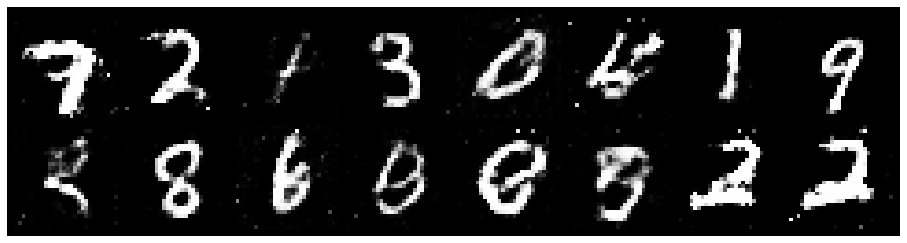

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.2316, Generator Loss: 0.9340
D(x): 0.5732, D(G(z)): 0.4291


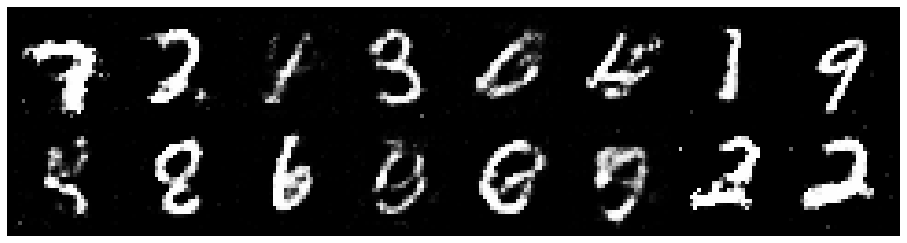

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.2576, Generator Loss: 0.9120
D(x): 0.5537, D(G(z)): 0.4426


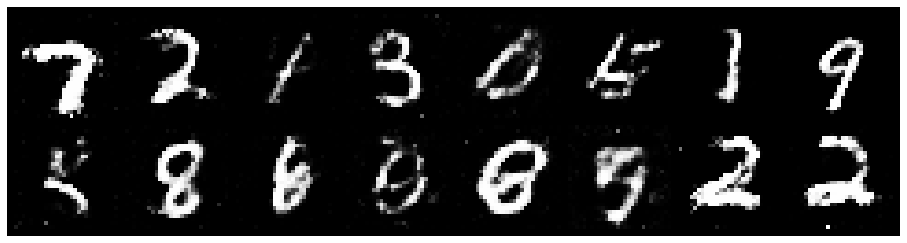

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.2804, Generator Loss: 0.7696
D(x): 0.5709, D(G(z)): 0.4675


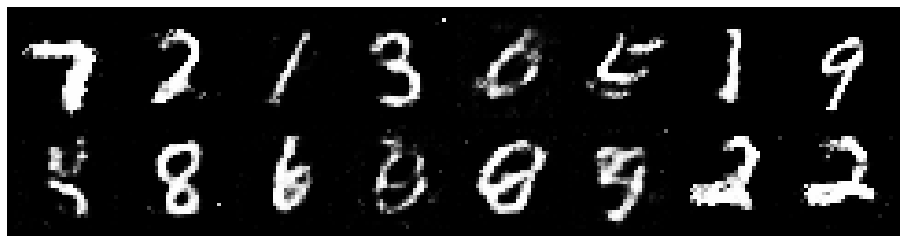

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.3312, Generator Loss: 0.8777
D(x): 0.5069, D(G(z)): 0.4350


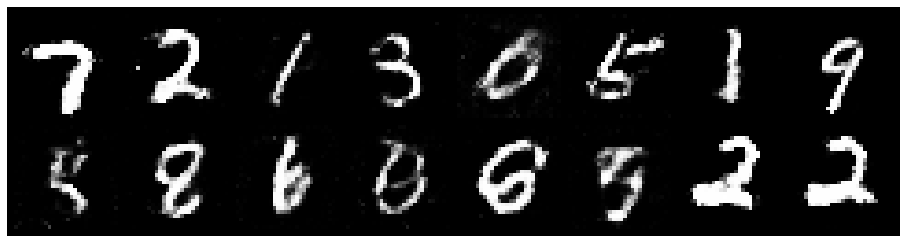

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.2119, Generator Loss: 0.8879
D(x): 0.5997, D(G(z)): 0.4629


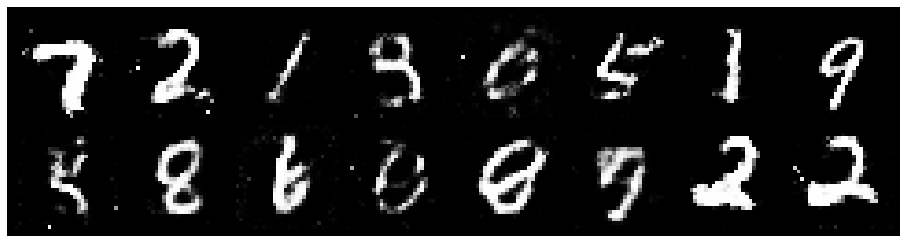

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.3331, Generator Loss: 0.8787
D(x): 0.5248, D(G(z)): 0.4431


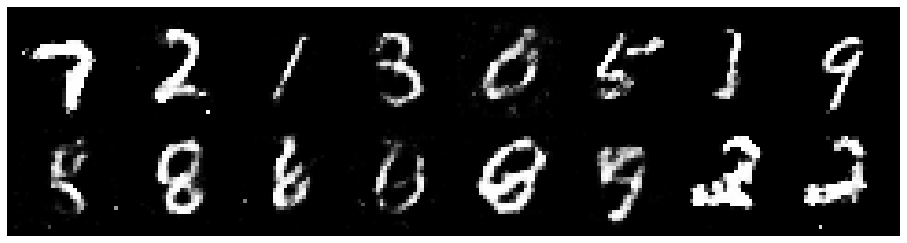

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.1300, Generator Loss: 0.9674
D(x): 0.6096, D(G(z)): 0.4145


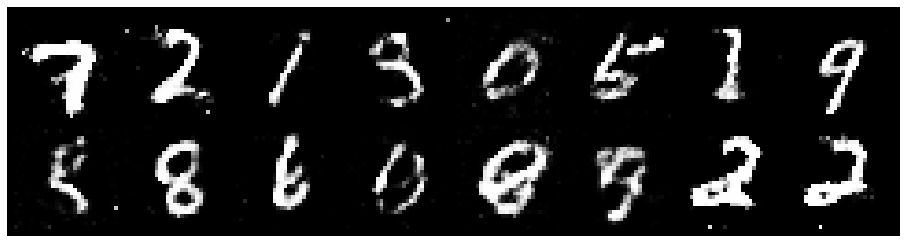

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.2427, Generator Loss: 0.9974
D(x): 0.5384, D(G(z)): 0.3974


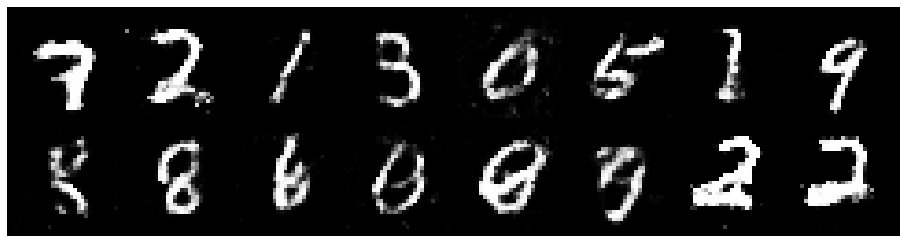

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2890, Generator Loss: 0.8738
D(x): 0.5532, D(G(z)): 0.4345


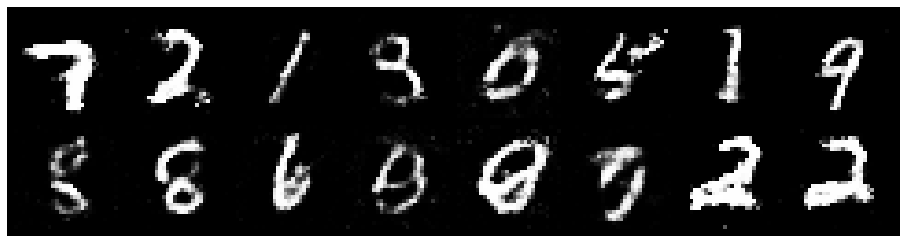

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.3015, Generator Loss: 1.0048
D(x): 0.5212, D(G(z)): 0.4048


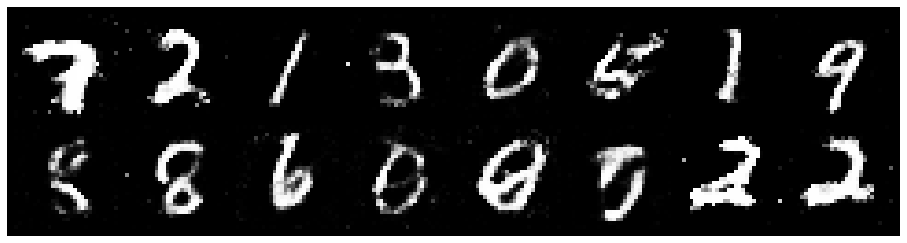

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.1990, Generator Loss: 1.0010
D(x): 0.5808, D(G(z)): 0.3970


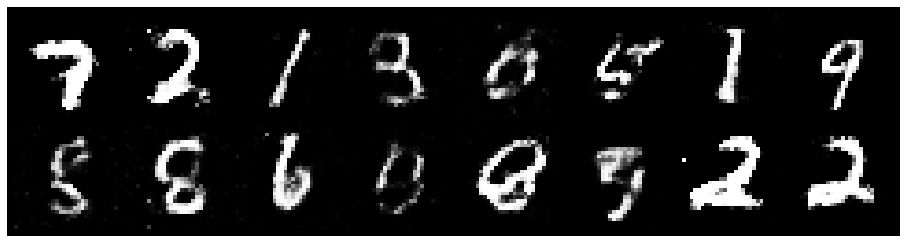

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2098, Generator Loss: 0.8925
D(x): 0.6234, D(G(z)): 0.4781


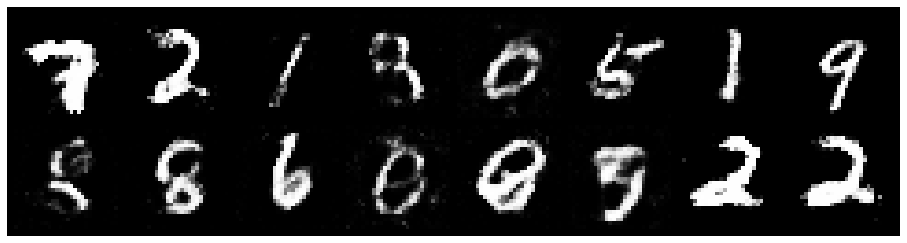

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.1797, Generator Loss: 1.0112
D(x): 0.6355, D(G(z)): 0.4419


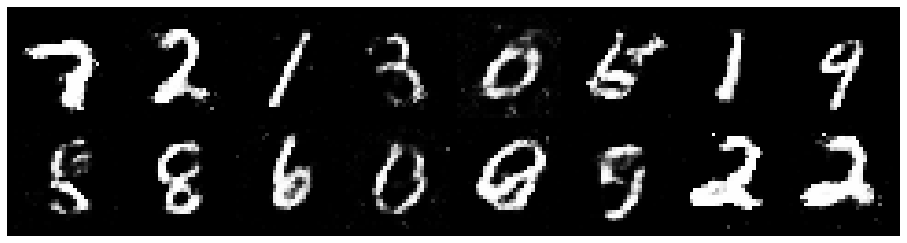

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.1902, Generator Loss: 1.0733
D(x): 0.5563, D(G(z)): 0.3869


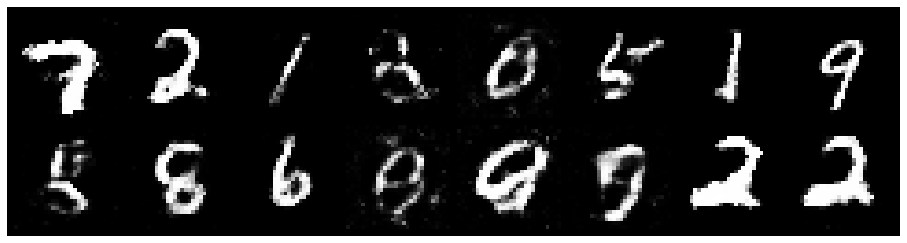

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.2883, Generator Loss: 0.8362
D(x): 0.5281, D(G(z)): 0.4472


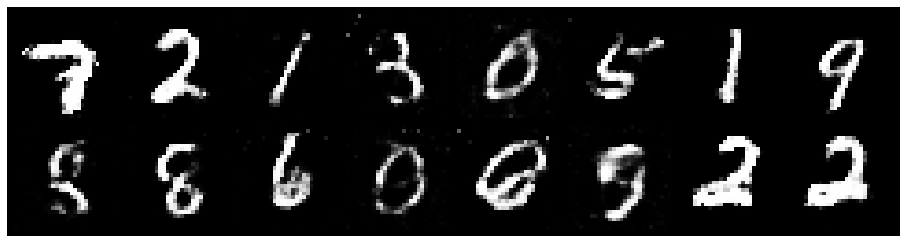

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.2435, Generator Loss: 0.8522
D(x): 0.5559, D(G(z)): 0.4381


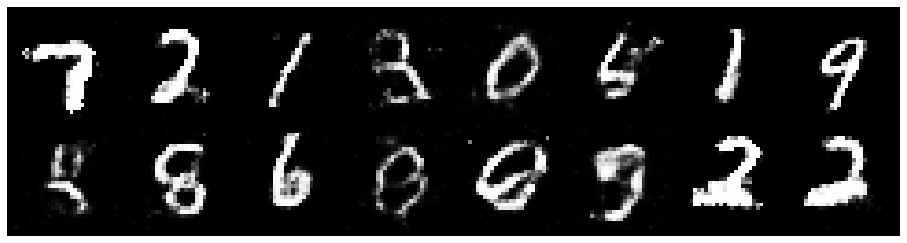

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.3893, Generator Loss: 0.8627
D(x): 0.5372, D(G(z)): 0.4747


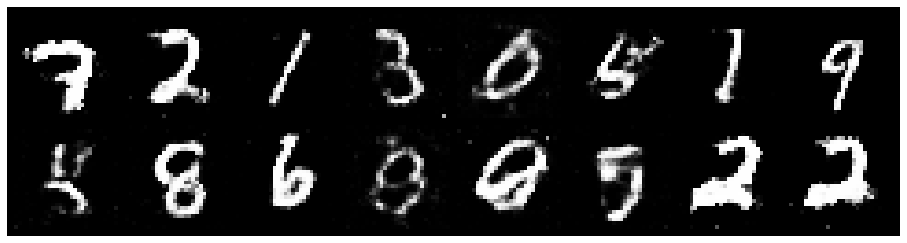

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3404, Generator Loss: 0.8443
D(x): 0.5574, D(G(z)): 0.4707


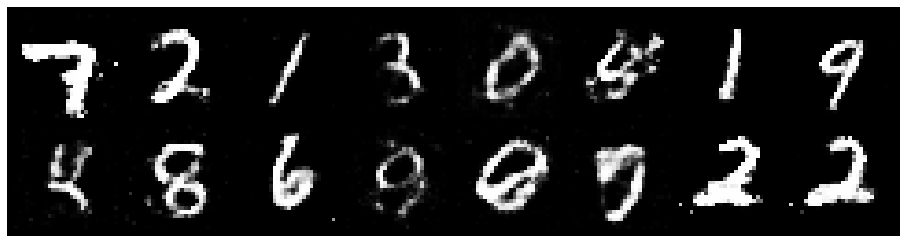

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.2920, Generator Loss: 0.9290
D(x): 0.5363, D(G(z)): 0.4331


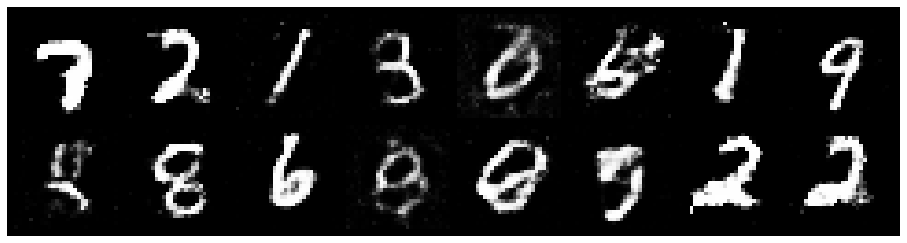

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3023, Generator Loss: 0.9978
D(x): 0.5553, D(G(z)): 0.4168


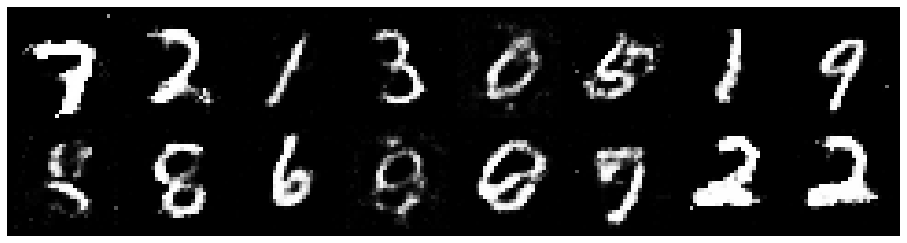

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.2811, Generator Loss: 0.9602
D(x): 0.5683, D(G(z)): 0.4443


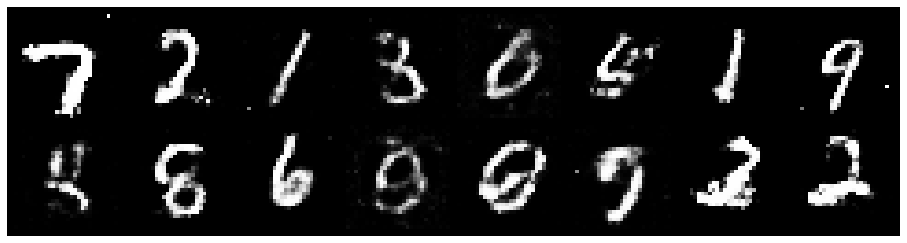

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.2116, Generator Loss: 0.9828
D(x): 0.5410, D(G(z)): 0.3896


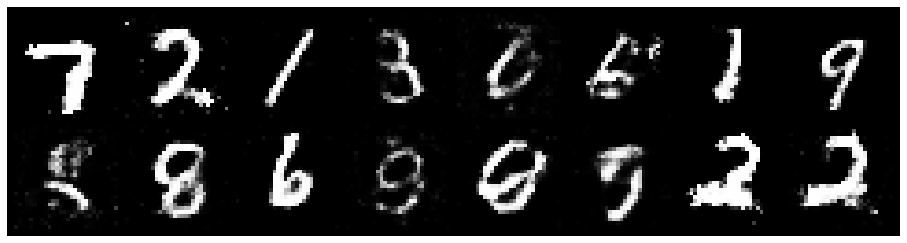

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2781, Generator Loss: 0.9301
D(x): 0.5191, D(G(z)): 0.4168


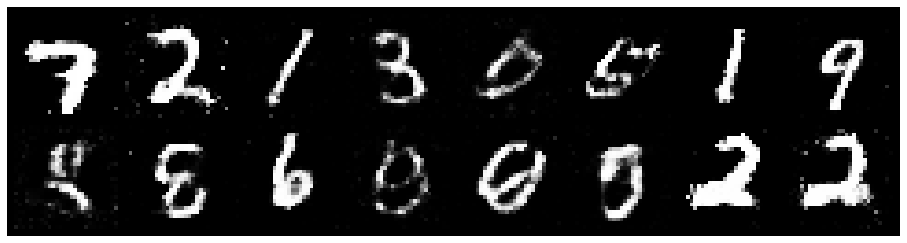

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.1868, Generator Loss: 1.0011
D(x): 0.5982, D(G(z)): 0.4246


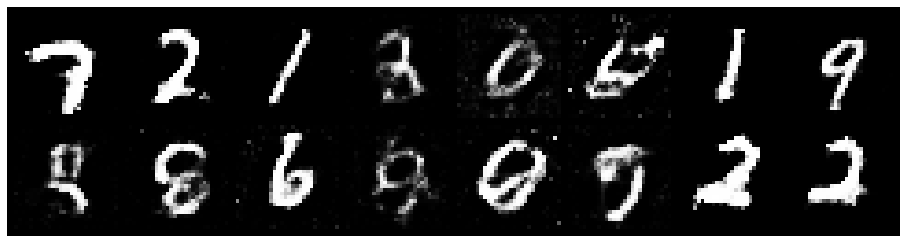

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.3045, Generator Loss: 0.8645
D(x): 0.5387, D(G(z)): 0.4548


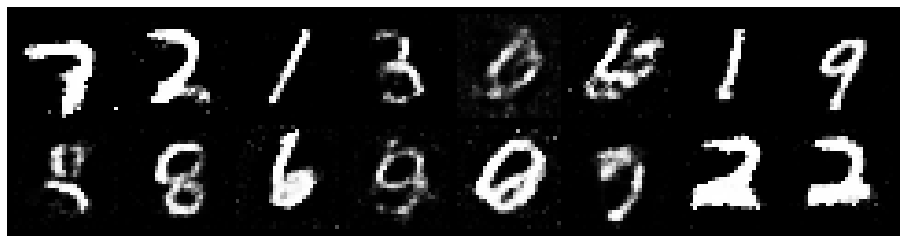

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2999, Generator Loss: 0.9468
D(x): 0.5517, D(G(z)): 0.4473


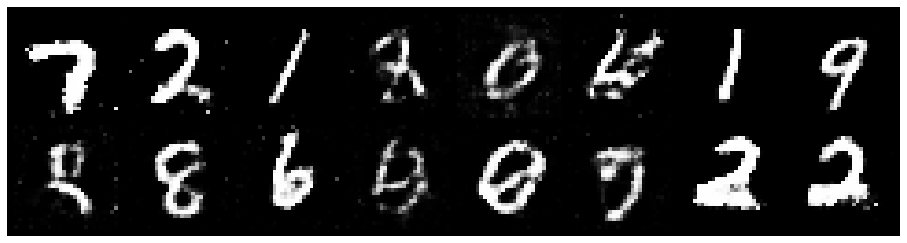

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.3930, Generator Loss: 0.9244
D(x): 0.5768, D(G(z)): 0.4985


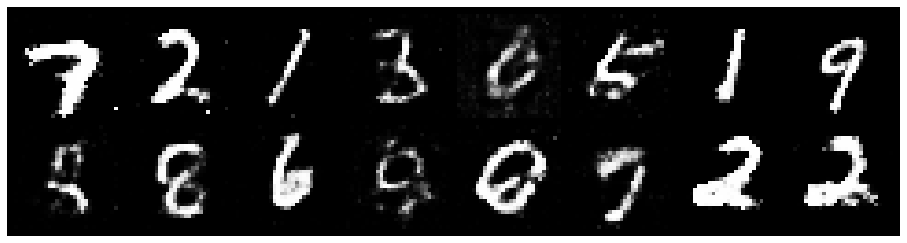

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.1603, Generator Loss: 0.8871
D(x): 0.5864, D(G(z)): 0.4059


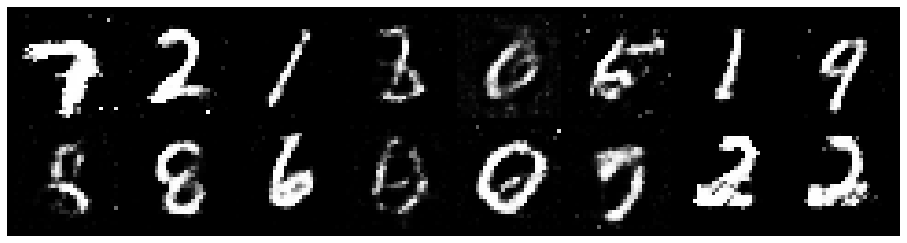

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.2208, Generator Loss: 0.9805
D(x): 0.5435, D(G(z)): 0.4098


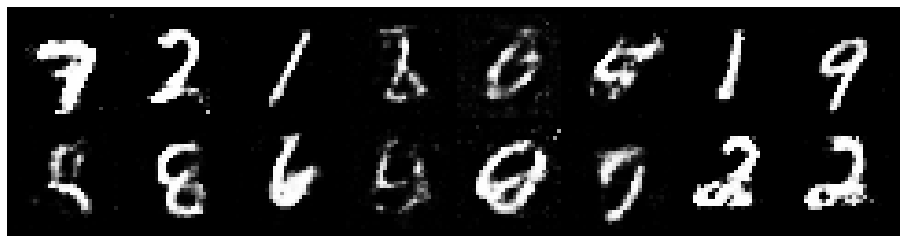

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.2863, Generator Loss: 0.9803
D(x): 0.5755, D(G(z)): 0.4501


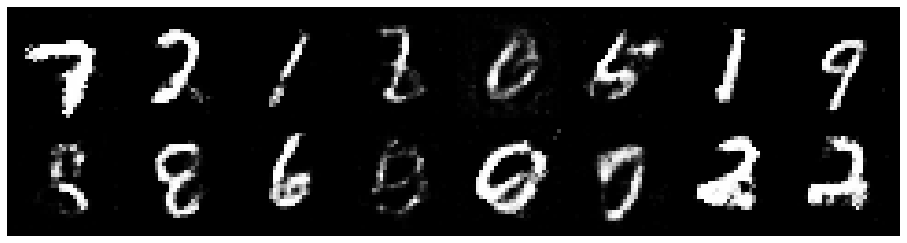

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.1998, Generator Loss: 0.9040
D(x): 0.5965, D(G(z)): 0.4385


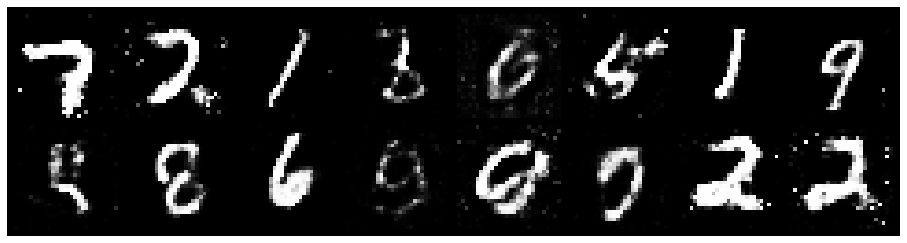

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.2137, Generator Loss: 1.0356
D(x): 0.5058, D(G(z)): 0.3637


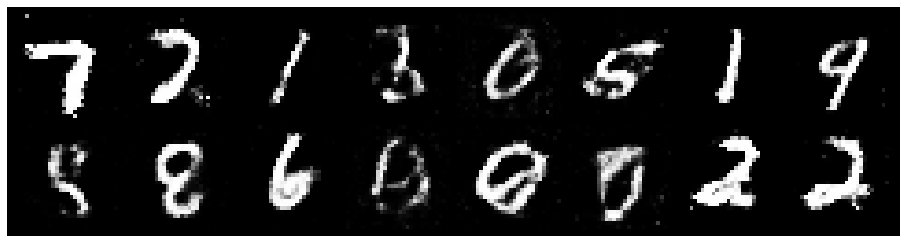

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.2357, Generator Loss: 0.9337
D(x): 0.5423, D(G(z)): 0.4191


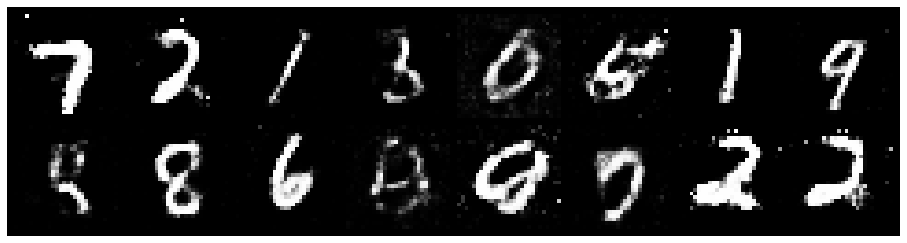

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.3010, Generator Loss: 0.8733
D(x): 0.5556, D(G(z)): 0.4638


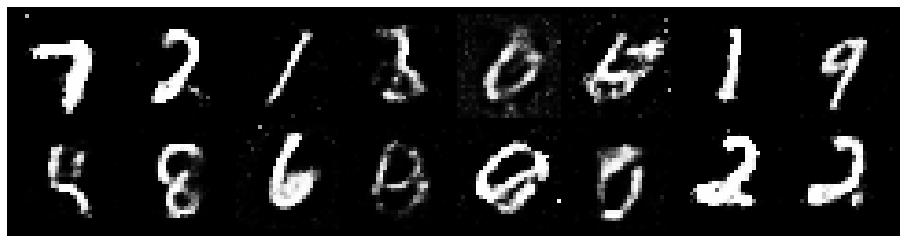

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.2519, Generator Loss: 0.9907
D(x): 0.5240, D(G(z)): 0.3878


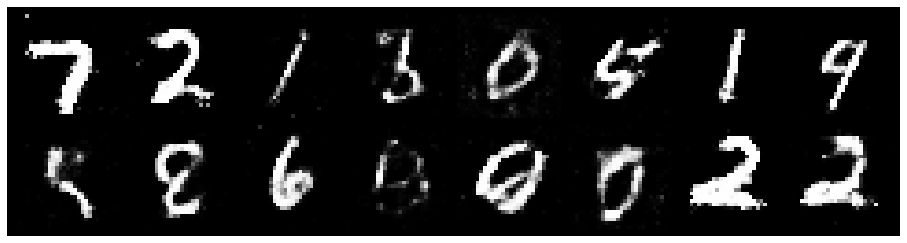

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.1742, Generator Loss: 0.9453
D(x): 0.5630, D(G(z)): 0.4124


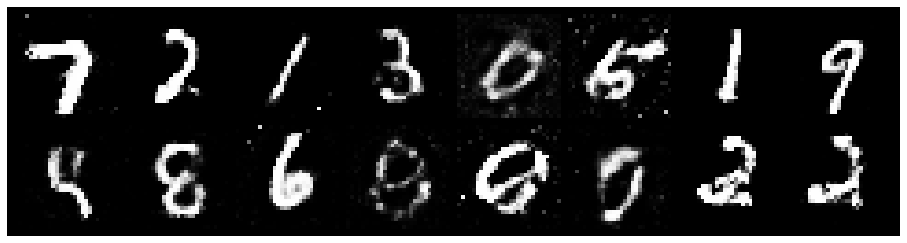

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.1794, Generator Loss: 1.0618
D(x): 0.5681, D(G(z)): 0.4121


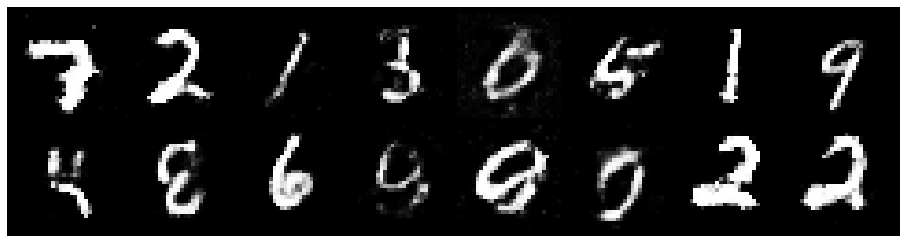

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.1925, Generator Loss: 0.9347
D(x): 0.5726, D(G(z)): 0.4157


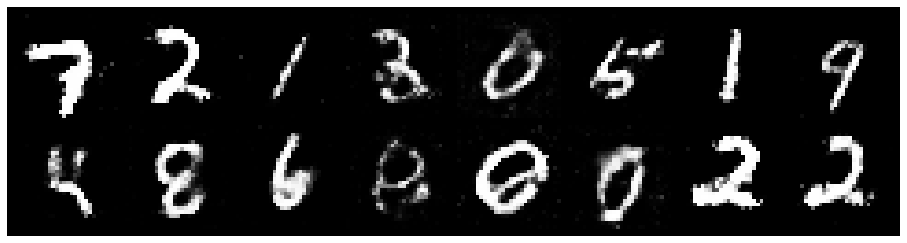

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.2119, Generator Loss: 0.9830
D(x): 0.5342, D(G(z)): 0.4086


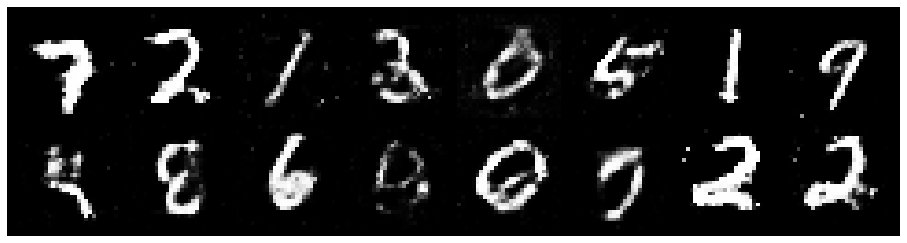

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.3343, Generator Loss: 0.8900
D(x): 0.5422, D(G(z)): 0.4610


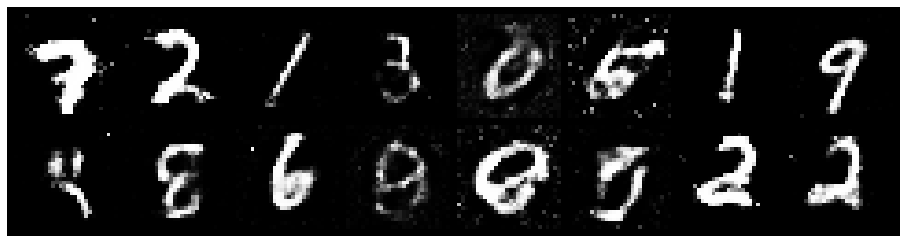

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.3397, Generator Loss: 0.7946
D(x): 0.5756, D(G(z)): 0.4886


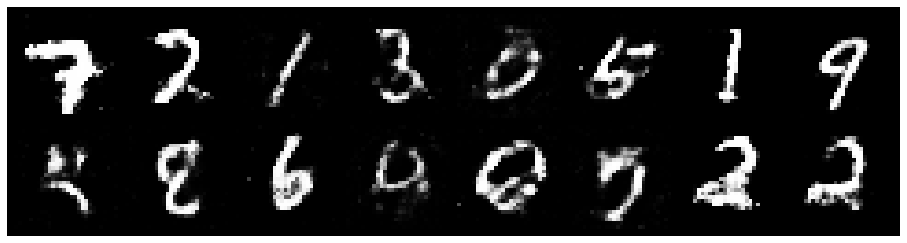

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.3517, Generator Loss: 0.8363
D(x): 0.5724, D(G(z)): 0.4982


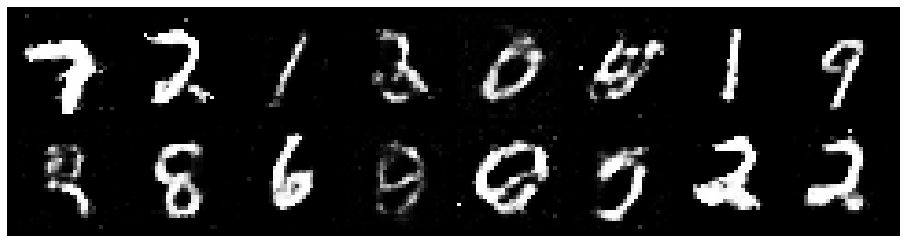

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.3867, Generator Loss: 0.8446
D(x): 0.5640, D(G(z)): 0.4966


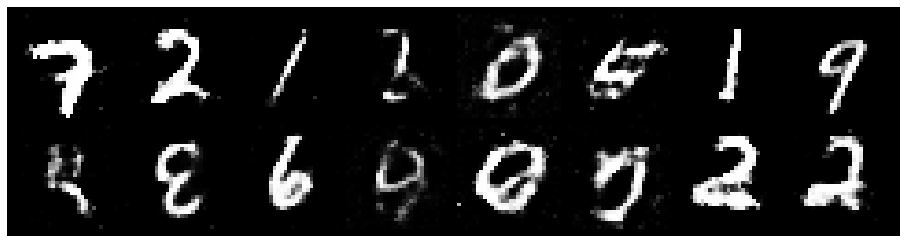

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.3065, Generator Loss: 0.7940
D(x): 0.5614, D(G(z)): 0.4757


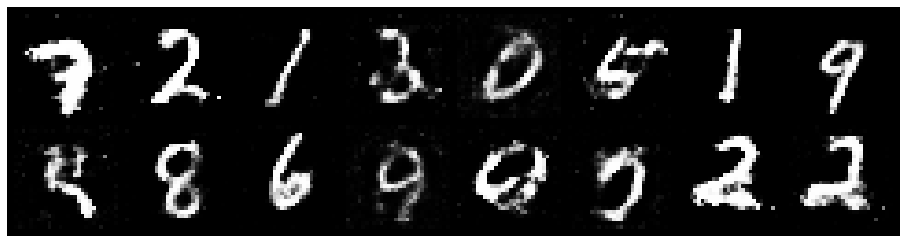

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.3083, Generator Loss: 0.9812
D(x): 0.4825, D(G(z)): 0.3895


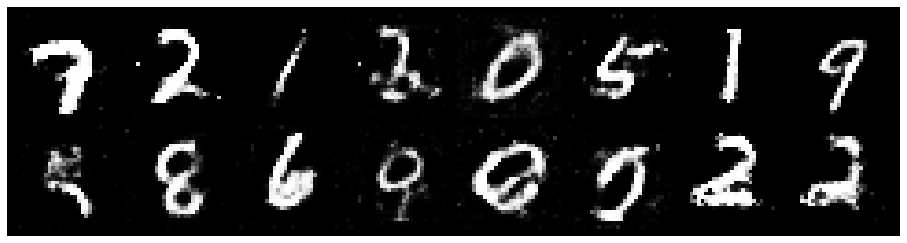

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.3065, Generator Loss: 0.8667
D(x): 0.5690, D(G(z)): 0.4811


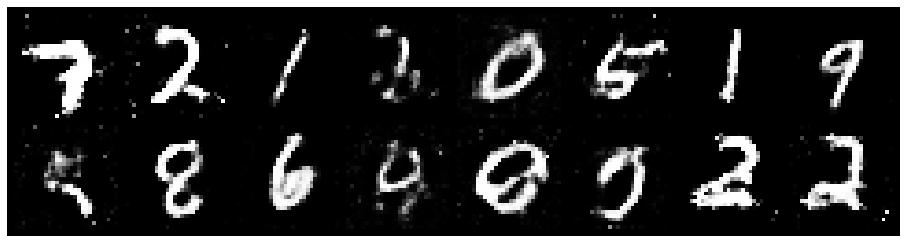

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.2495, Generator Loss: 0.9979
D(x): 0.5535, D(G(z)): 0.4206


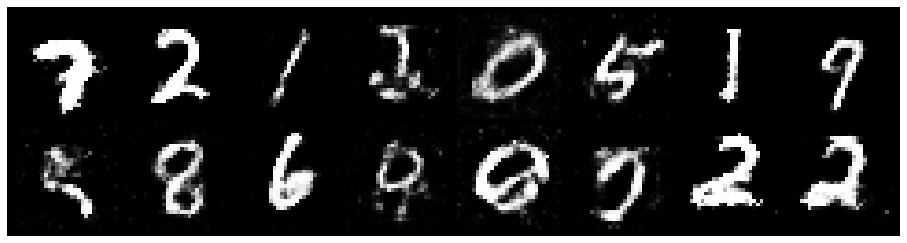

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.2113, Generator Loss: 0.9496
D(x): 0.5694, D(G(z)): 0.4238


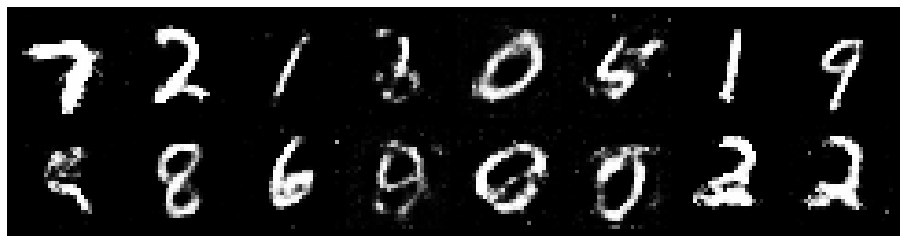

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.1662, Generator Loss: 0.9419
D(x): 0.5738, D(G(z)): 0.3899


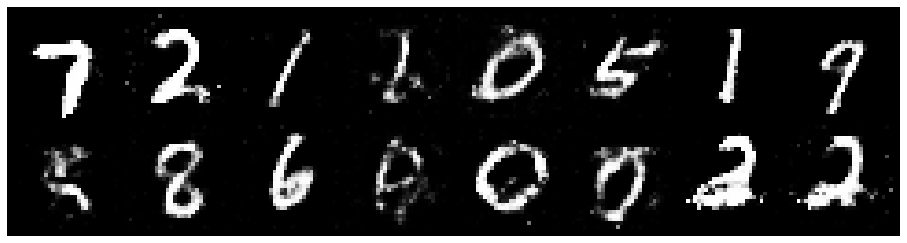

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2636, Generator Loss: 0.9671
D(x): 0.5432, D(G(z)): 0.4122


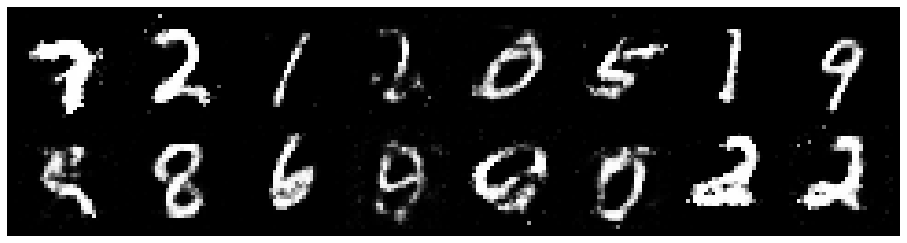

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.3019, Generator Loss: 0.9239
D(x): 0.5099, D(G(z)): 0.4279


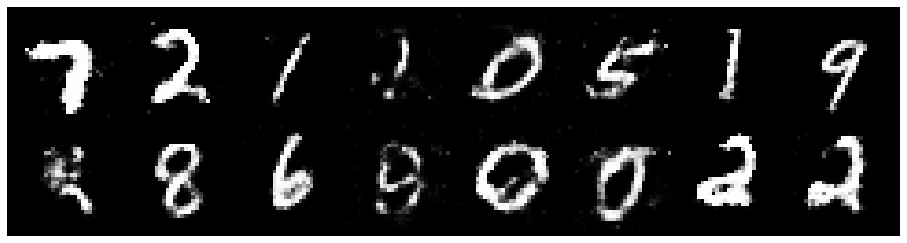

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.2026, Generator Loss: 0.8721
D(x): 0.5530, D(G(z)): 0.4335


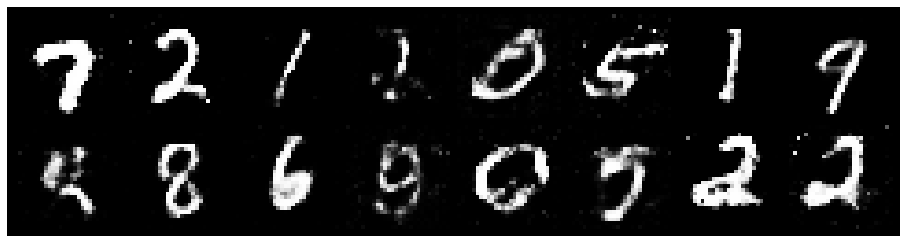

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2893, Generator Loss: 0.8956
D(x): 0.5790, D(G(z)): 0.4518


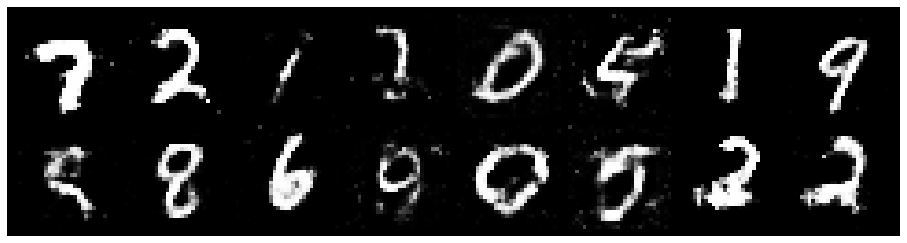

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.3275, Generator Loss: 0.9746
D(x): 0.5582, D(G(z)): 0.4475


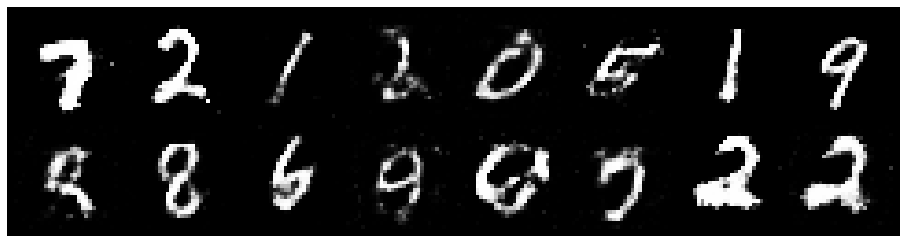

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2689, Generator Loss: 0.8386
D(x): 0.5467, D(G(z)): 0.4233


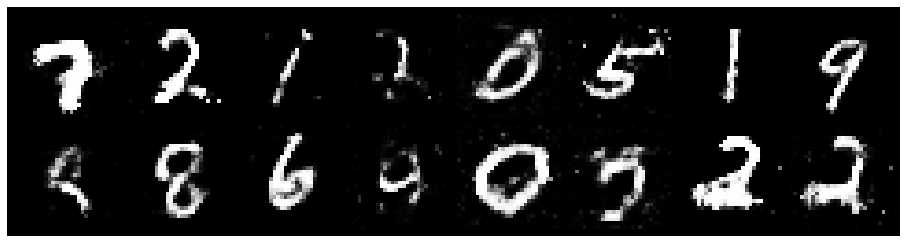

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.2506, Generator Loss: 1.0261
D(x): 0.5475, D(G(z)): 0.4113


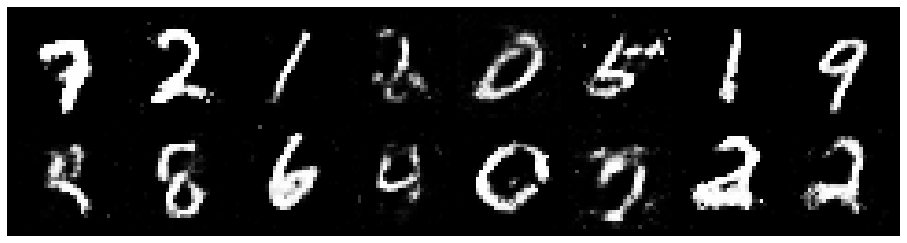

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.1965, Generator Loss: 0.9259
D(x): 0.5876, D(G(z)): 0.4344


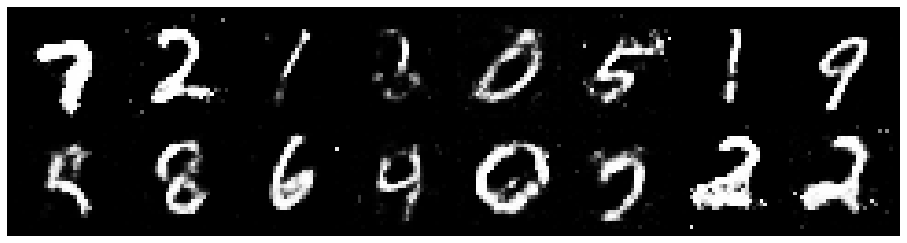

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.2353, Generator Loss: 1.1182
D(x): 0.6063, D(G(z)): 0.4307


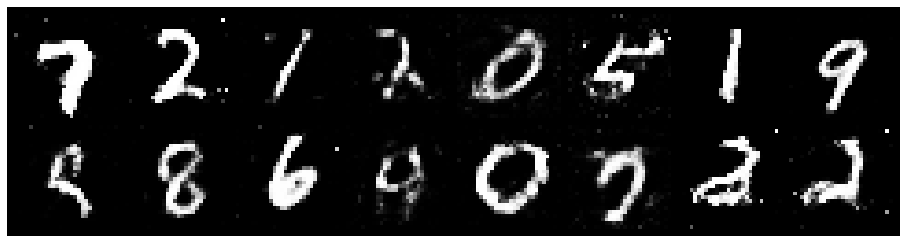

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.1778, Generator Loss: 0.9604
D(x): 0.5894, D(G(z)): 0.4211


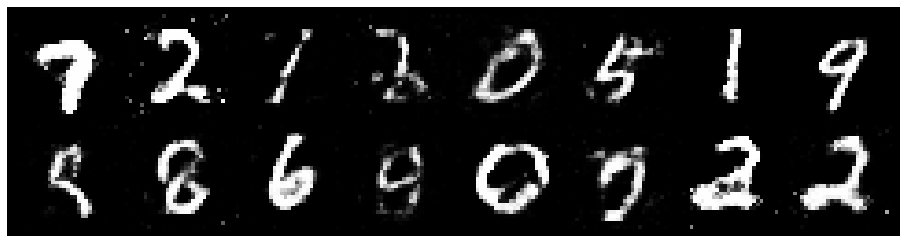

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.1847, Generator Loss: 0.7986
D(x): 0.6135, D(G(z)): 0.4607


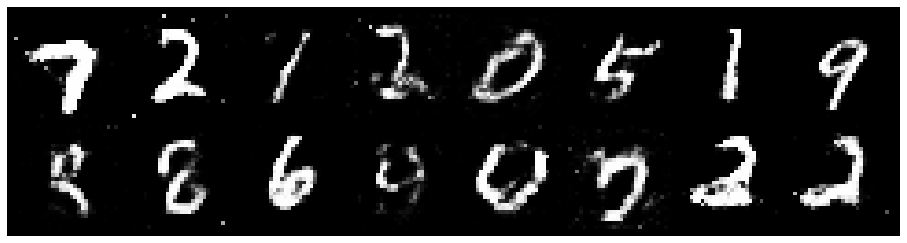

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.2553, Generator Loss: 0.8751
D(x): 0.5581, D(G(z)): 0.4526


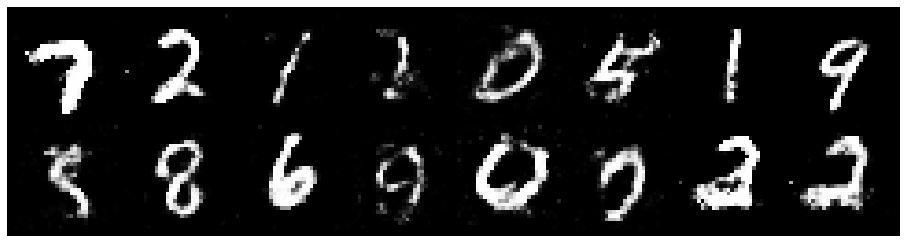

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.1812, Generator Loss: 0.7220
D(x): 0.6055, D(G(z)): 0.4600


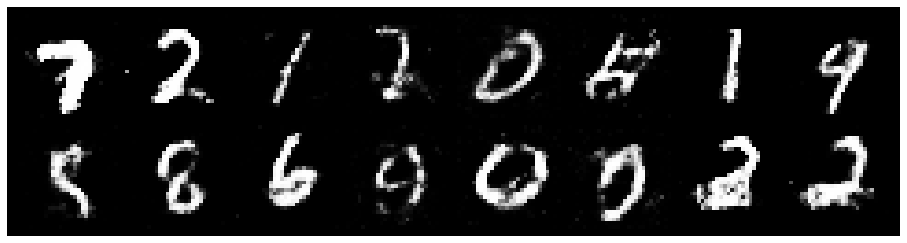

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.2391, Generator Loss: 0.9074
D(x): 0.5437, D(G(z)): 0.4380


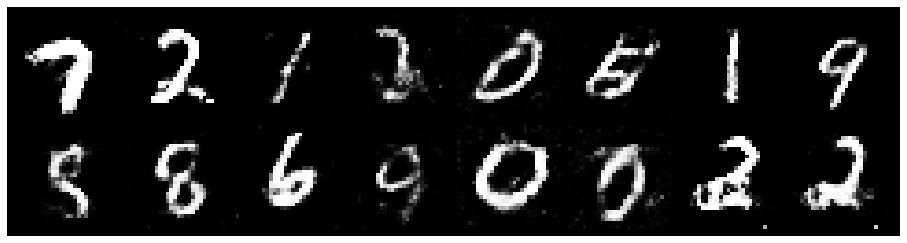

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.2691, Generator Loss: 1.0528
D(x): 0.5535, D(G(z)): 0.4218


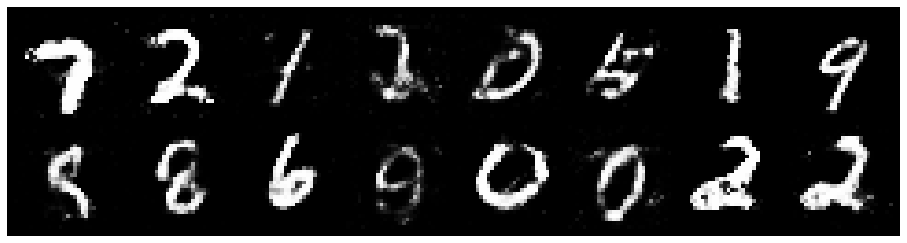

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.2528, Generator Loss: 0.9377
D(x): 0.5683, D(G(z)): 0.4604


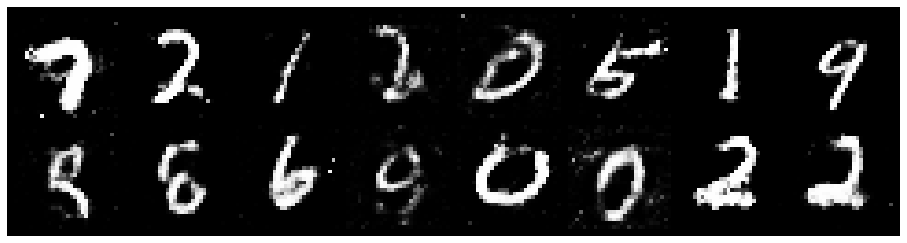

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.3331, Generator Loss: 0.9230
D(x): 0.5425, D(G(z)): 0.4596


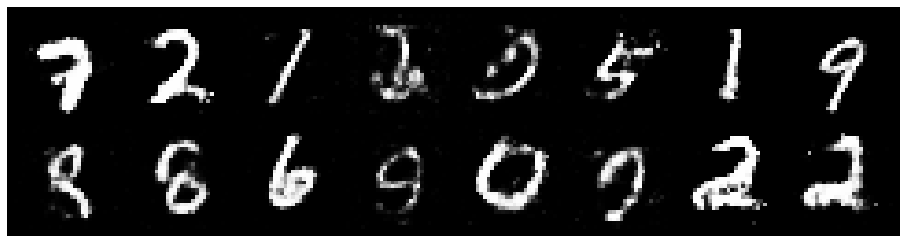

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.2982, Generator Loss: 0.8705
D(x): 0.5476, D(G(z)): 0.4601


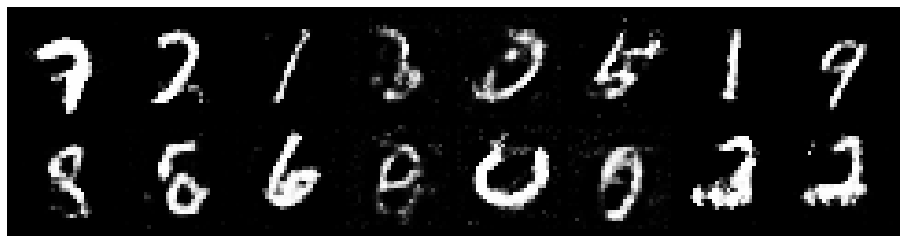

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2936, Generator Loss: 0.8107
D(x): 0.5377, D(G(z)): 0.4633


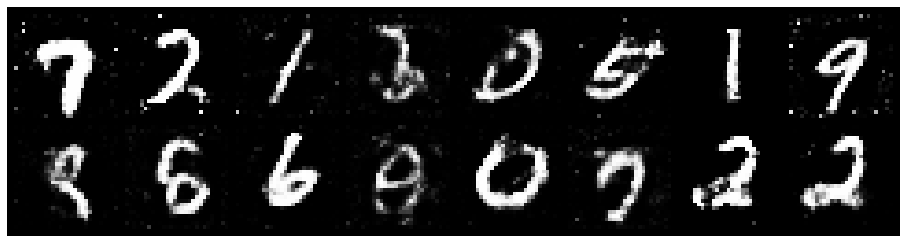

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.4687, Generator Loss: 0.8561
D(x): 0.5442, D(G(z)): 0.5107


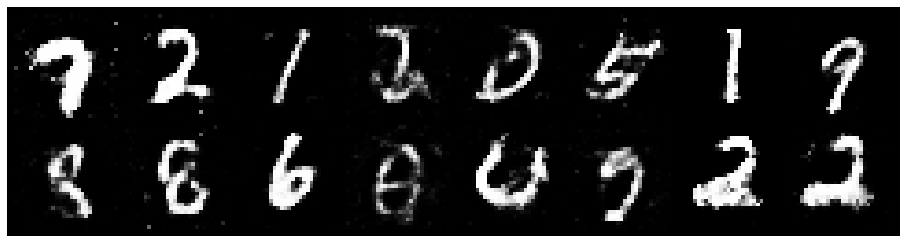

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.3181, Generator Loss: 0.9204
D(x): 0.6151, D(G(z)): 0.4956


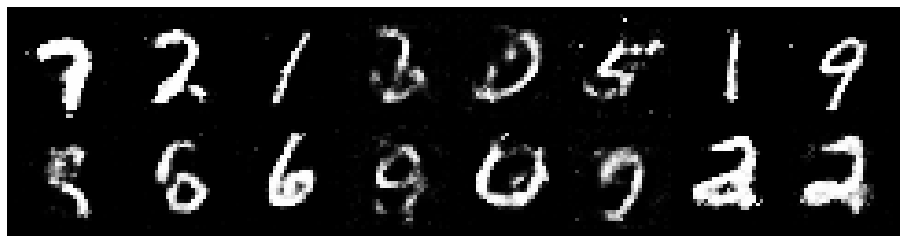

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.1784, Generator Loss: 1.1426
D(x): 0.5900, D(G(z)): 0.4174


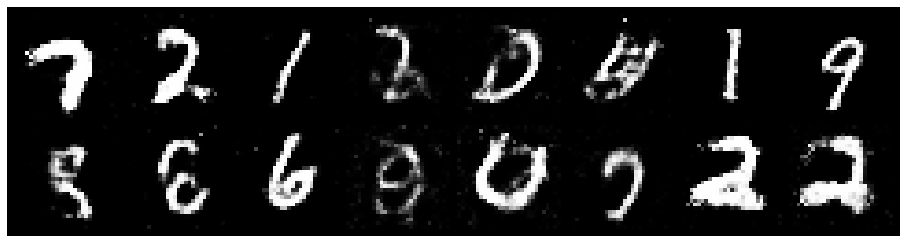

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.2756, Generator Loss: 1.0676
D(x): 0.5712, D(G(z)): 0.4321


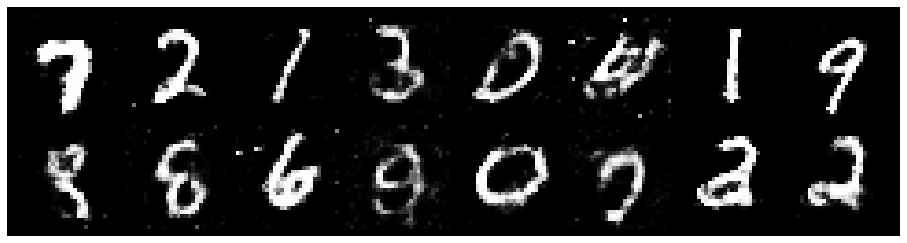

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2687, Generator Loss: 0.9801
D(x): 0.5594, D(G(z)): 0.4399


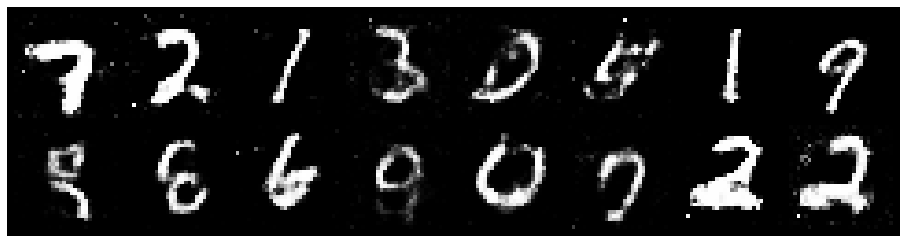

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.3141, Generator Loss: 0.9363
D(x): 0.5091, D(G(z)): 0.4230


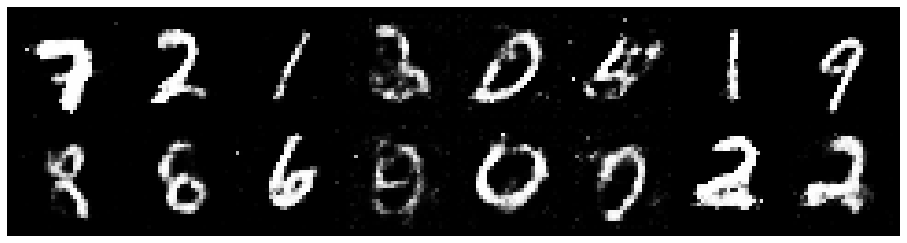

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.3185, Generator Loss: 0.8190
D(x): 0.5611, D(G(z)): 0.4421


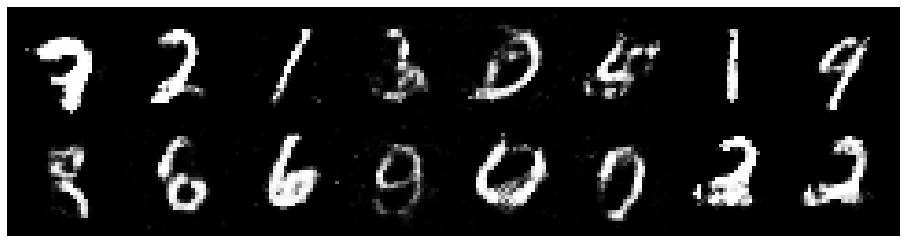

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.2006, Generator Loss: 0.9571
D(x): 0.5742, D(G(z)): 0.4245


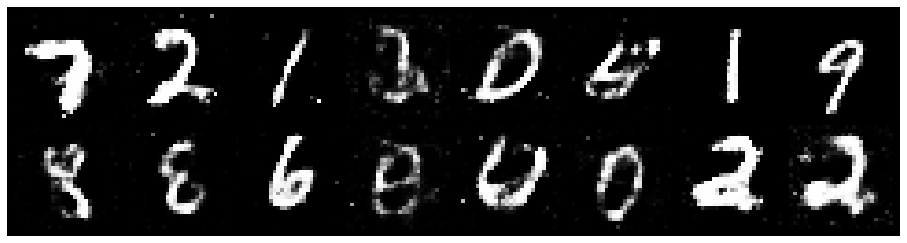

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.2649, Generator Loss: 0.9037
D(x): 0.5674, D(G(z)): 0.4639


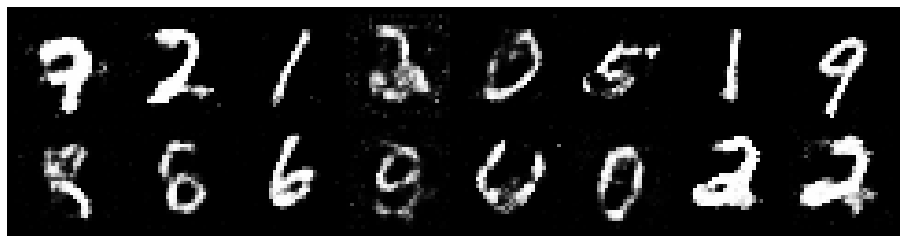

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.2825, Generator Loss: 1.0328
D(x): 0.5470, D(G(z)): 0.4326


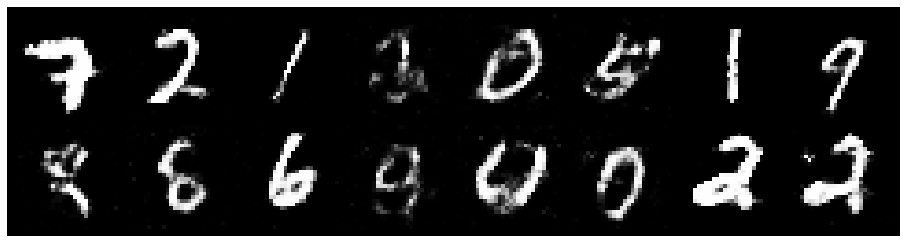

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2394, Generator Loss: 0.8611
D(x): 0.5476, D(G(z)): 0.4313


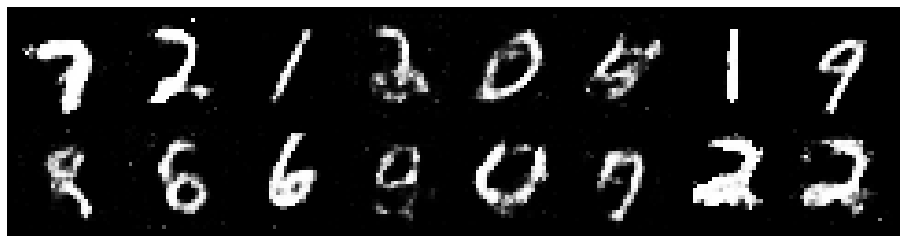

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.3557, Generator Loss: 1.0811
D(x): 0.5565, D(G(z)): 0.4486


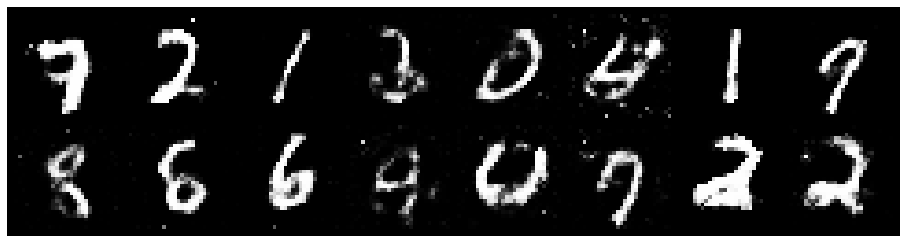

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2568, Generator Loss: 0.9087
D(x): 0.5770, D(G(z)): 0.4469


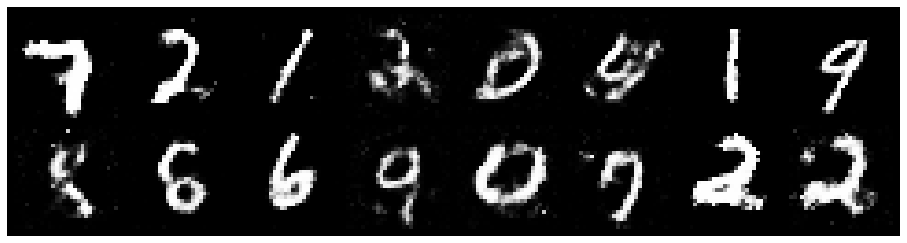

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.2696, Generator Loss: 0.9216
D(x): 0.5453, D(G(z)): 0.4285


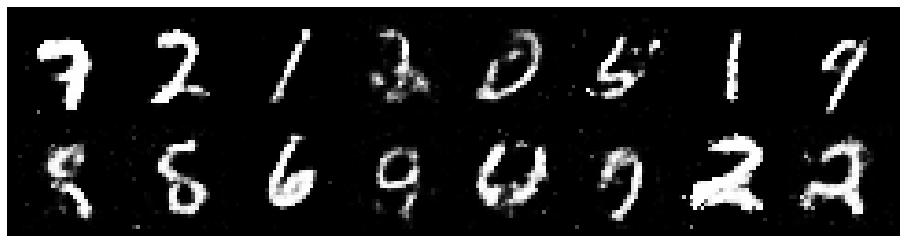

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.2188, Generator Loss: 0.9505
D(x): 0.5915, D(G(z)): 0.4373


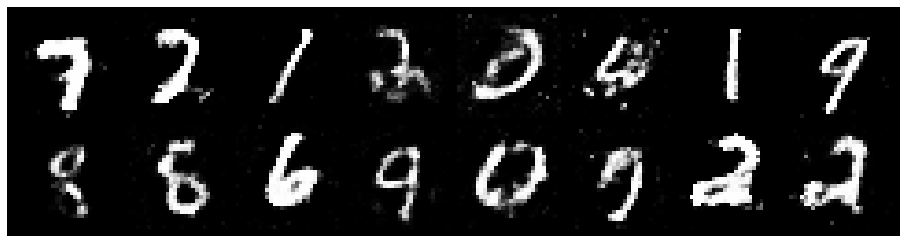

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.1794, Generator Loss: 0.8353
D(x): 0.5943, D(G(z)): 0.4456


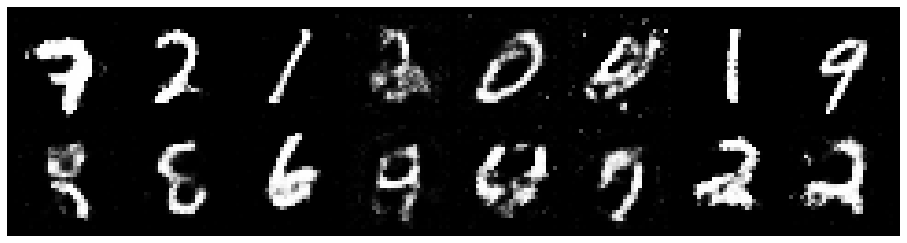

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.2902, Generator Loss: 0.9511
D(x): 0.5451, D(G(z)): 0.4508


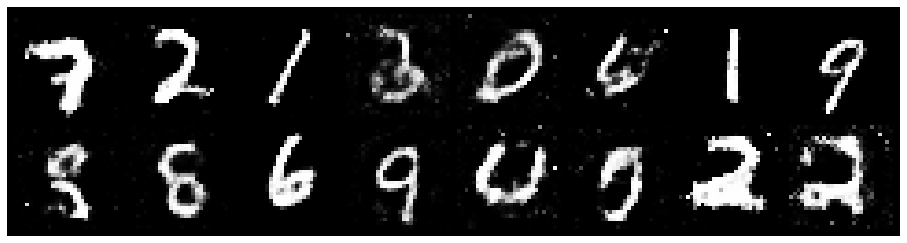

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2674, Generator Loss: 0.9861
D(x): 0.5262, D(G(z)): 0.4053


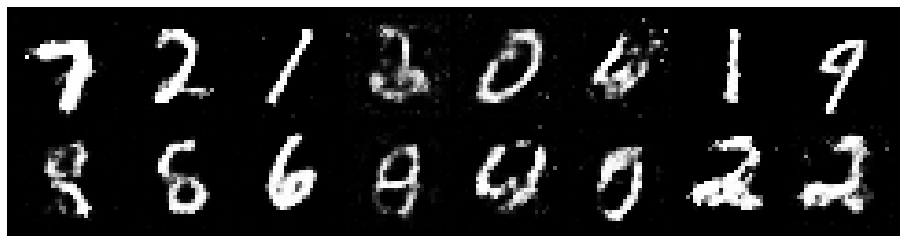

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.2754, Generator Loss: 0.9538
D(x): 0.5740, D(G(z)): 0.4521


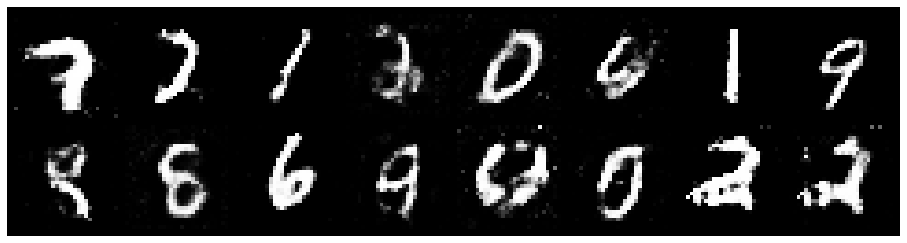

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.3242, Generator Loss: 0.8645
D(x): 0.5408, D(G(z)): 0.4590


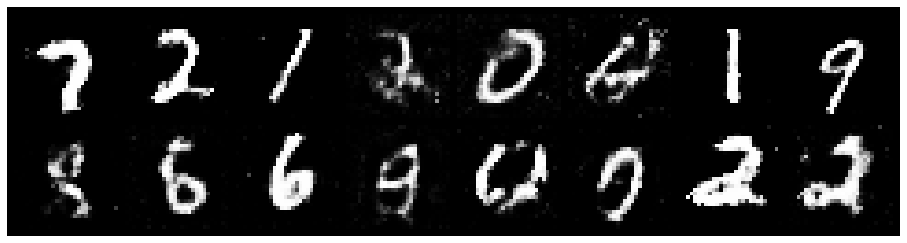

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.3104, Generator Loss: 0.7689
D(x): 0.5732, D(G(z)): 0.4790


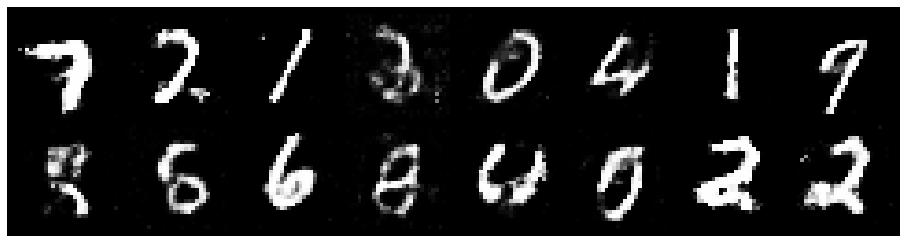

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.3493, Generator Loss: 0.7160
D(x): 0.6111, D(G(z)): 0.5425


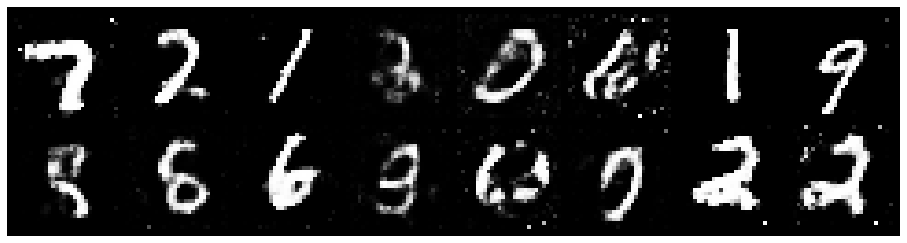

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.3973, Generator Loss: 0.9149
D(x): 0.5455, D(G(z)): 0.4807


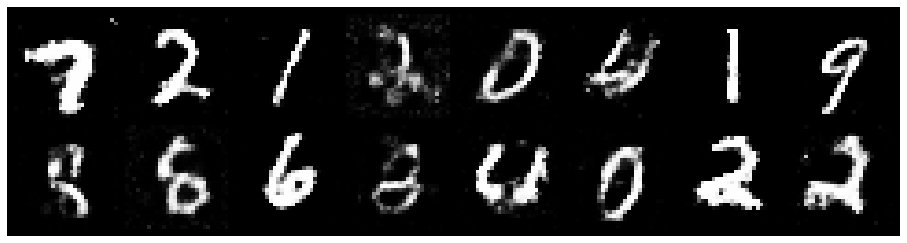

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.2607, Generator Loss: 0.7843
D(x): 0.5484, D(G(z)): 0.4466


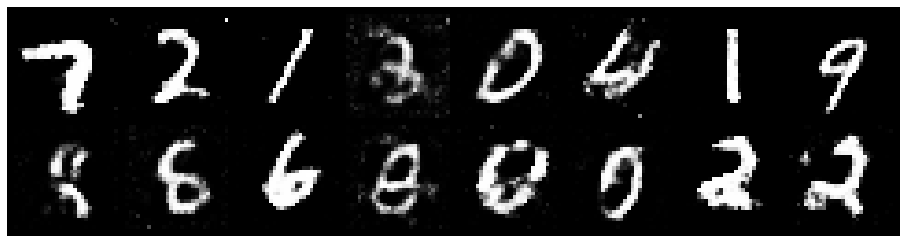

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.1822, Generator Loss: 0.9958
D(x): 0.5595, D(G(z)): 0.3865


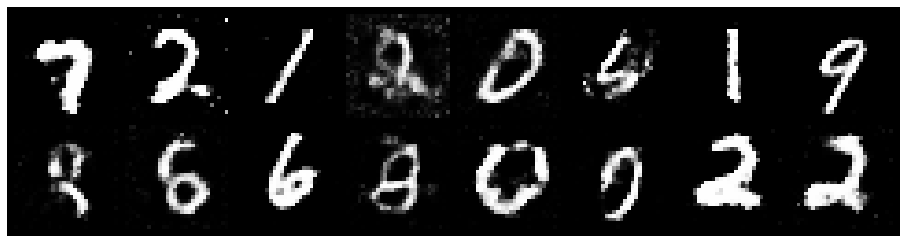

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.3252, Generator Loss: 0.9924
D(x): 0.5524, D(G(z)): 0.4412


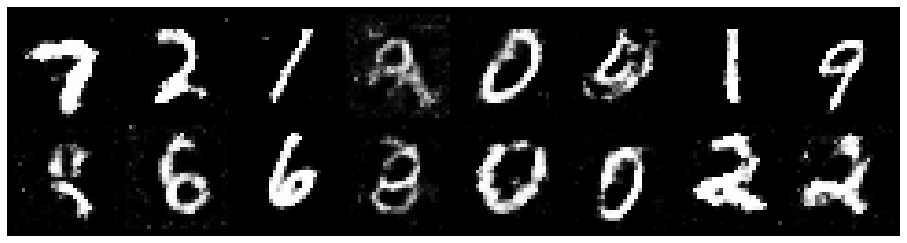

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.4332, Generator Loss: 0.8202
D(x): 0.6078, D(G(z)): 0.5153


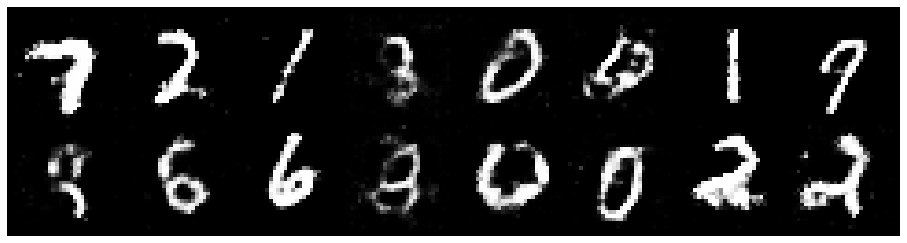

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.2851, Generator Loss: 0.9585
D(x): 0.5626, D(G(z)): 0.4474


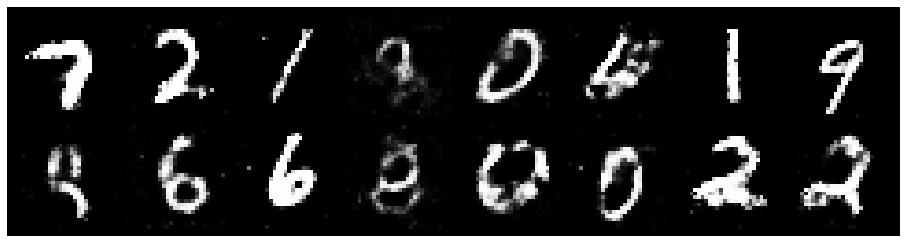

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.2479, Generator Loss: 0.8231
D(x): 0.5808, D(G(z)): 0.4452


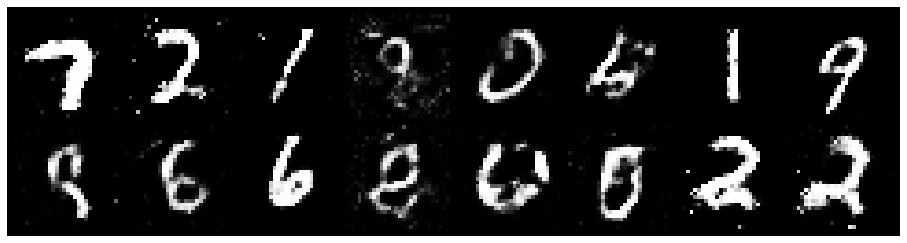

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.3738, Generator Loss: 0.8565
D(x): 0.5350, D(G(z)): 0.4576


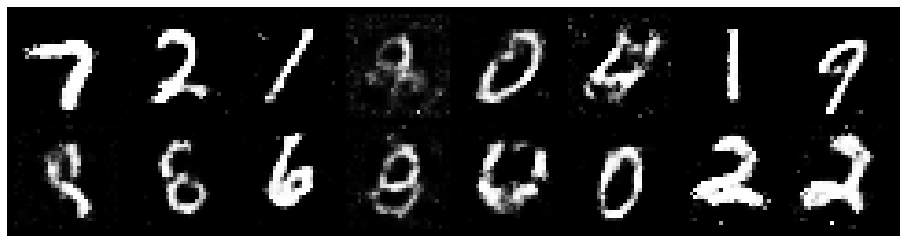

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.3611, Generator Loss: 0.8293
D(x): 0.5562, D(G(z)): 0.4842


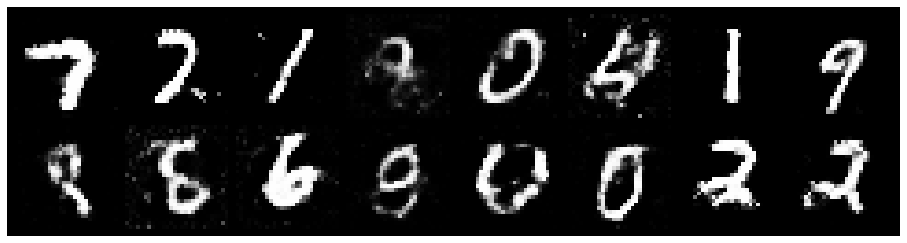

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.2928, Generator Loss: 0.8618
D(x): 0.5748, D(G(z)): 0.4672


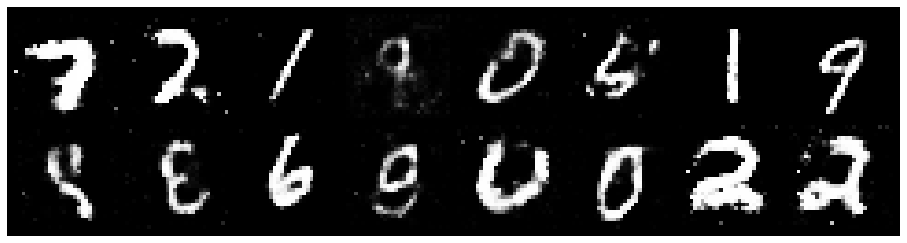

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.3759, Generator Loss: 0.9221
D(x): 0.5460, D(G(z)): 0.4813


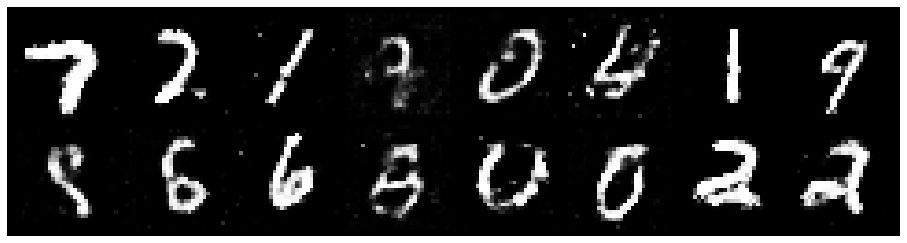

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.2394, Generator Loss: 0.8782
D(x): 0.5960, D(G(z)): 0.4445


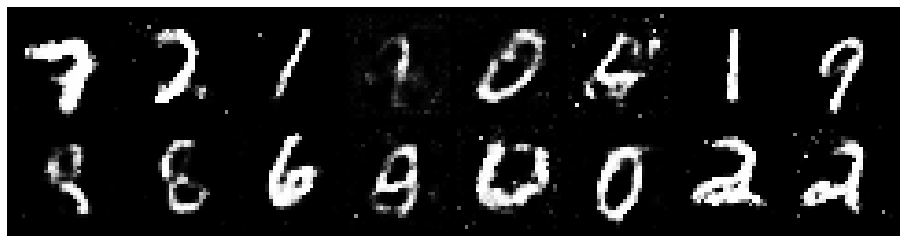

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.3119, Generator Loss: 0.7410
D(x): 0.5853, D(G(z)): 0.5001


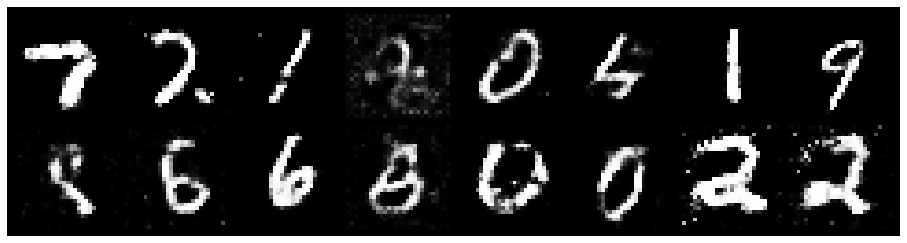

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.2063, Generator Loss: 1.0632
D(x): 0.5517, D(G(z)): 0.3933


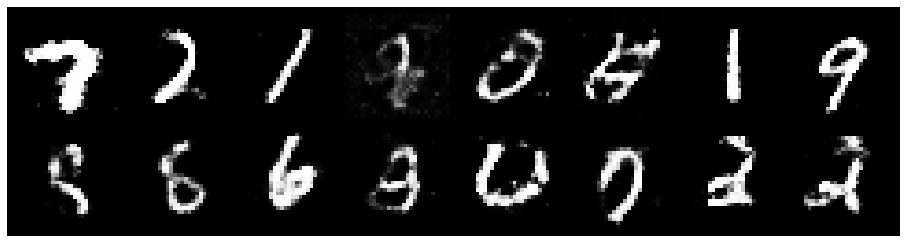

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.3616, Generator Loss: 0.9299
D(x): 0.5396, D(G(z)): 0.4772


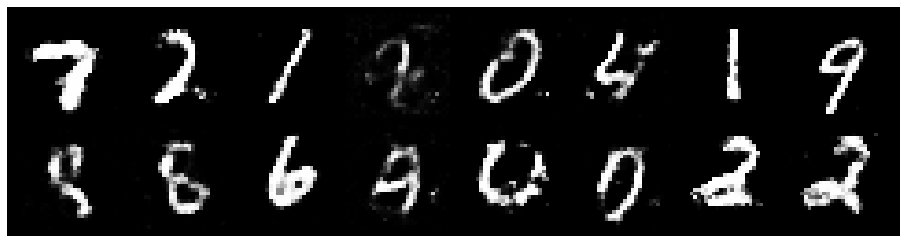

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.3218, Generator Loss: 0.8535
D(x): 0.5427, D(G(z)): 0.4499


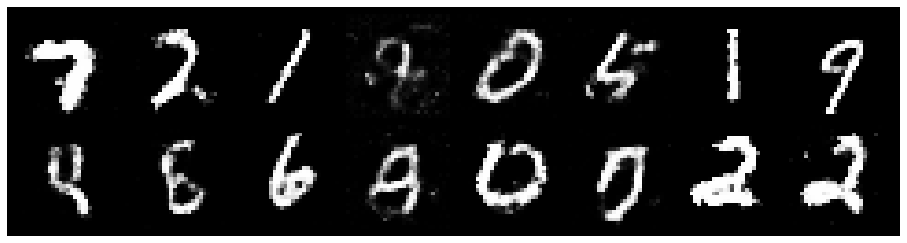

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.2234, Generator Loss: 0.9604
D(x): 0.5613, D(G(z)): 0.3957


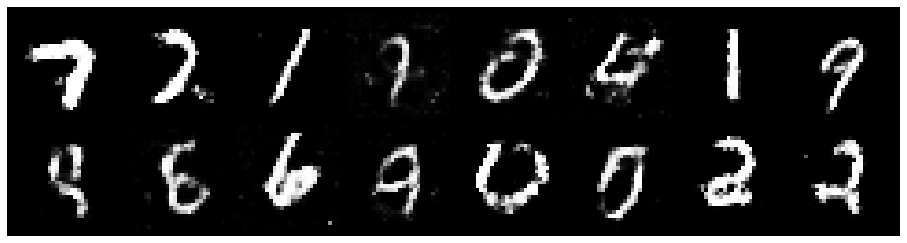

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.3379, Generator Loss: 0.8598
D(x): 0.5161, D(G(z)): 0.4417


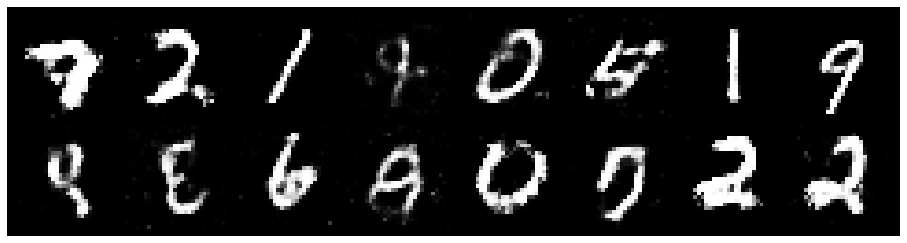

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.2496, Generator Loss: 0.9547
D(x): 0.5349, D(G(z)): 0.3871


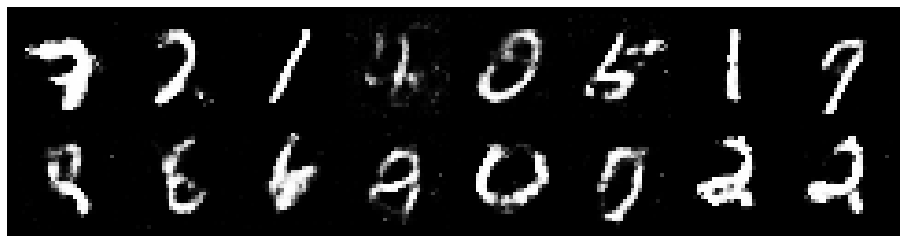

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.2572, Generator Loss: 0.8414
D(x): 0.5947, D(G(z)): 0.4627


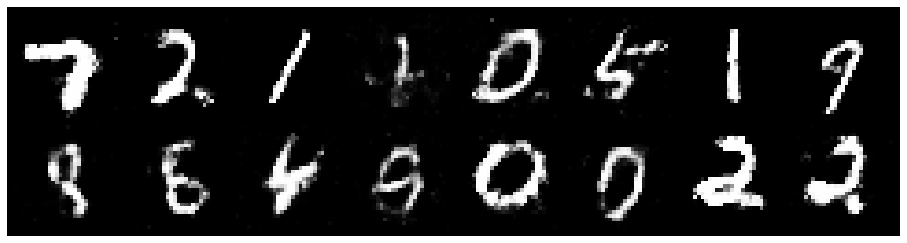

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.2224, Generator Loss: 0.8405
D(x): 0.5604, D(G(z)): 0.4259


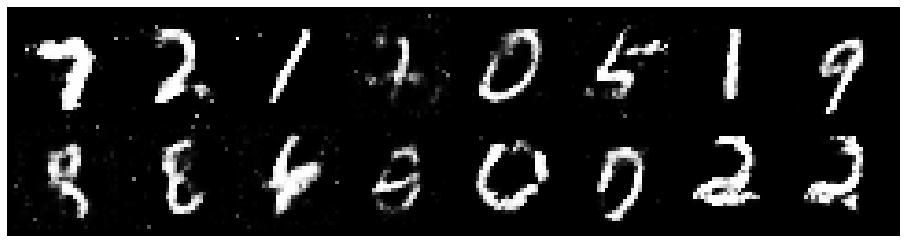

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.2418, Generator Loss: 1.0488
D(x): 0.5380, D(G(z)): 0.4023


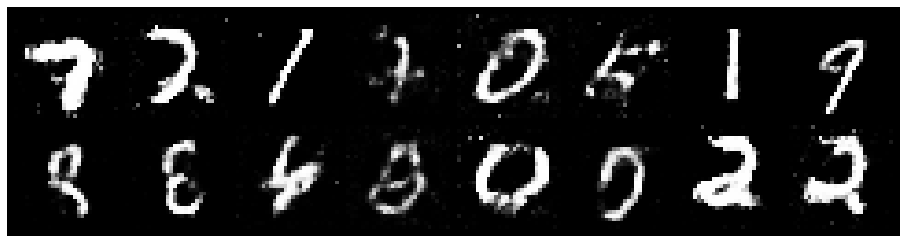

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.2680, Generator Loss: 0.9838
D(x): 0.6049, D(G(z)): 0.4670


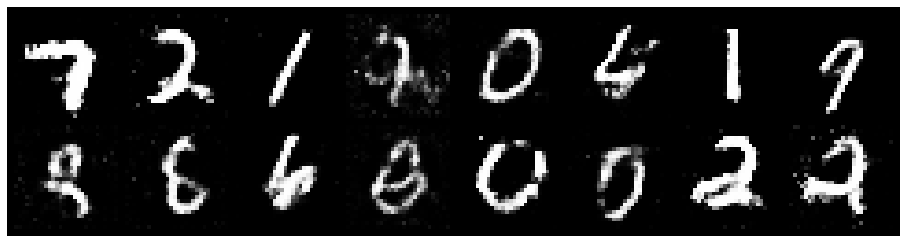

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.1890, Generator Loss: 0.7765
D(x): 0.5986, D(G(z)): 0.4453


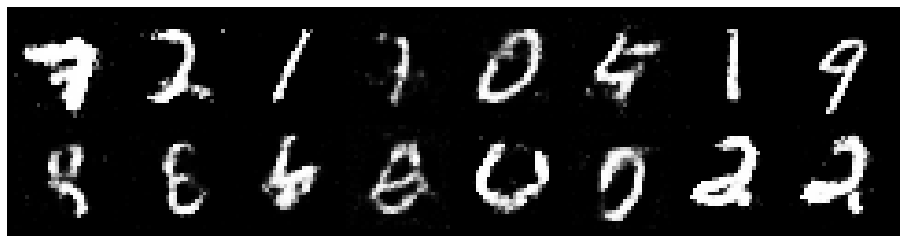

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.2886, Generator Loss: 1.0245
D(x): 0.5072, D(G(z)): 0.3912


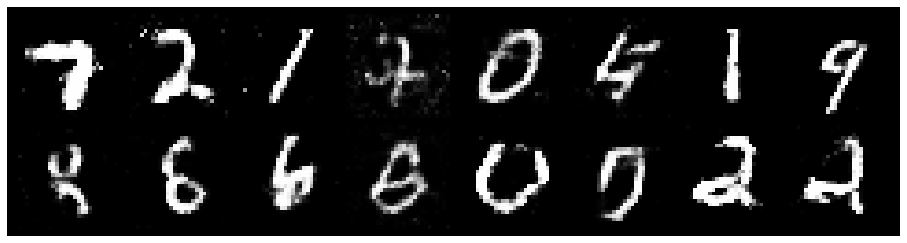

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.2925, Generator Loss: 0.9571
D(x): 0.5445, D(G(z)): 0.4371


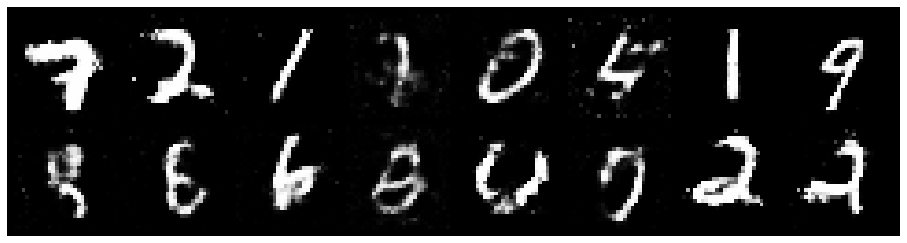

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.2685, Generator Loss: 0.8504
D(x): 0.5703, D(G(z)): 0.4373


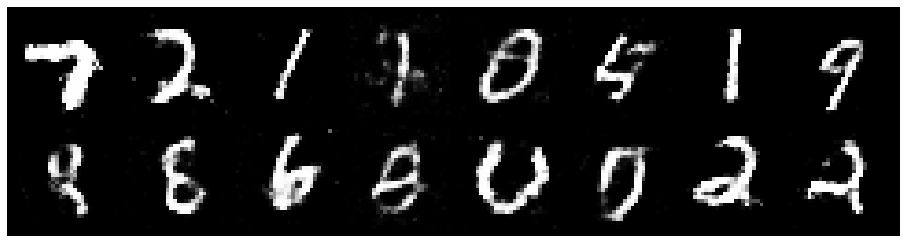

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.1962, Generator Loss: 0.9742
D(x): 0.5901, D(G(z)): 0.4248


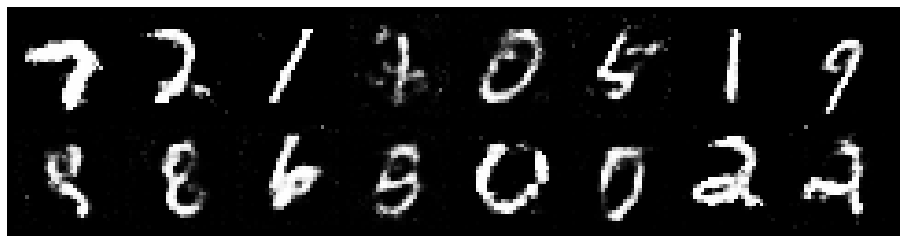

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2593, Generator Loss: 1.0338
D(x): 0.5600, D(G(z)): 0.4227


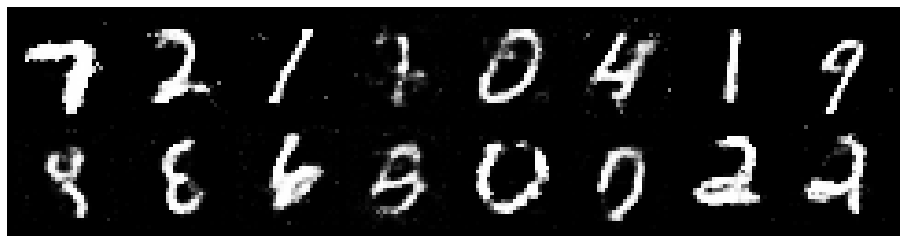

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.1892, Generator Loss: 1.0023
D(x): 0.5748, D(G(z)): 0.4068


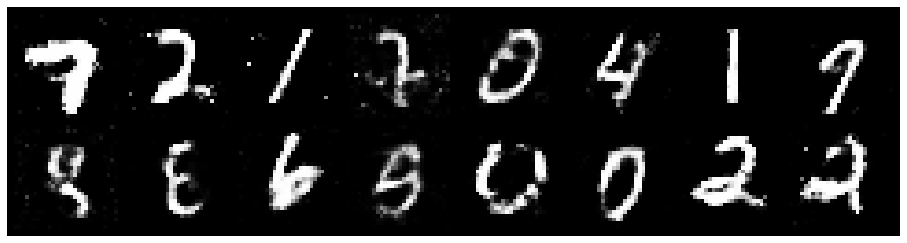

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.2318, Generator Loss: 0.9219
D(x): 0.6049, D(G(z)): 0.4613


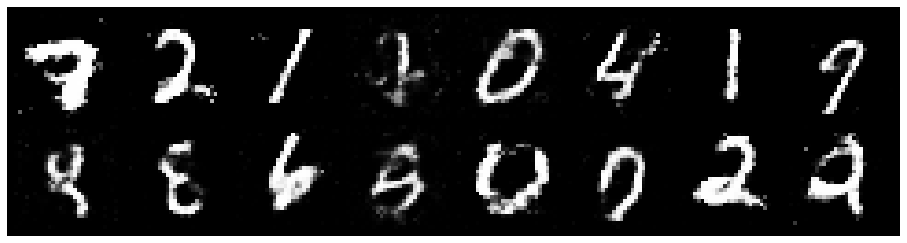

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2772, Generator Loss: 0.9467
D(x): 0.5629, D(G(z)): 0.4374


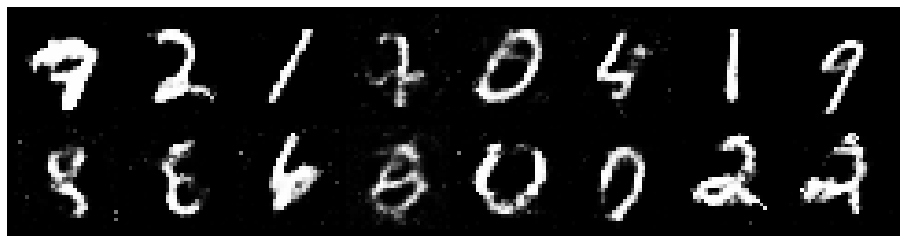

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.3181, Generator Loss: 0.9015
D(x): 0.5445, D(G(z)): 0.4428


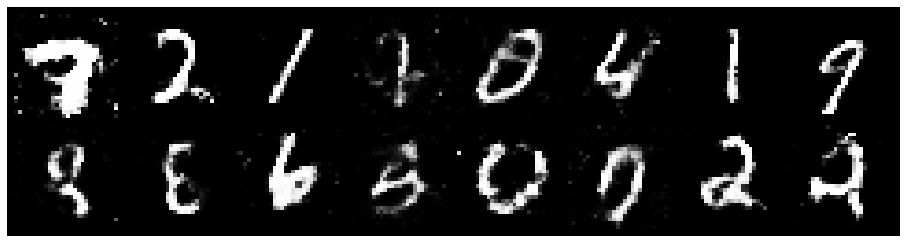

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.3394, Generator Loss: 0.8035
D(x): 0.5325, D(G(z)): 0.4605


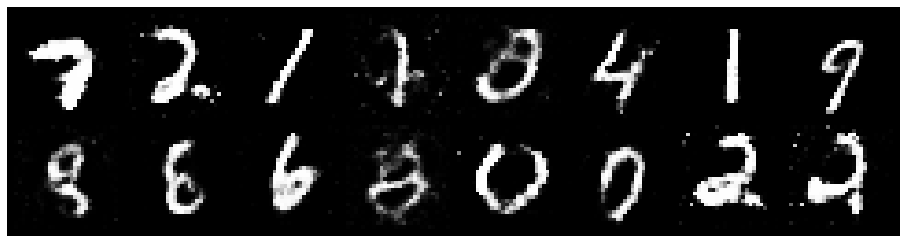

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.3374, Generator Loss: 0.9019
D(x): 0.5146, D(G(z)): 0.4380


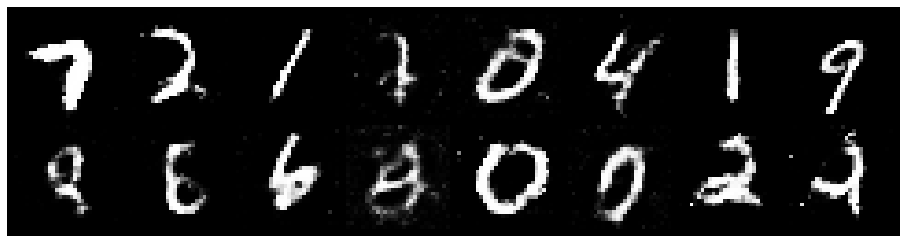

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2789, Generator Loss: 0.8104
D(x): 0.5306, D(G(z)): 0.4375


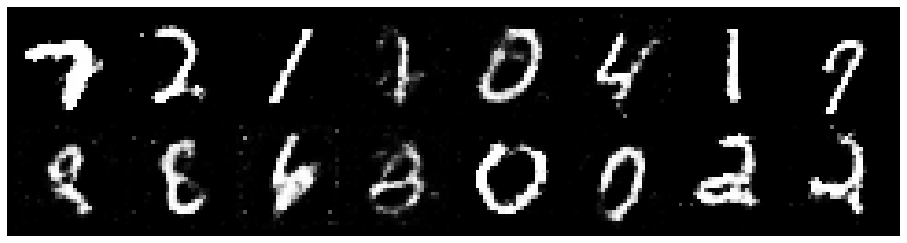

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.2867, Generator Loss: 0.8434
D(x): 0.5510, D(G(z)): 0.4571


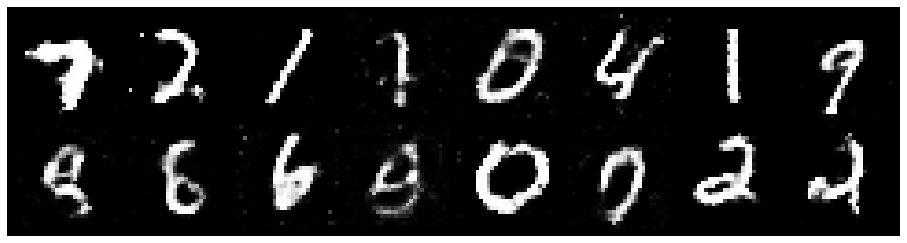

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.3052, Generator Loss: 0.8010
D(x): 0.5573, D(G(z)): 0.4431


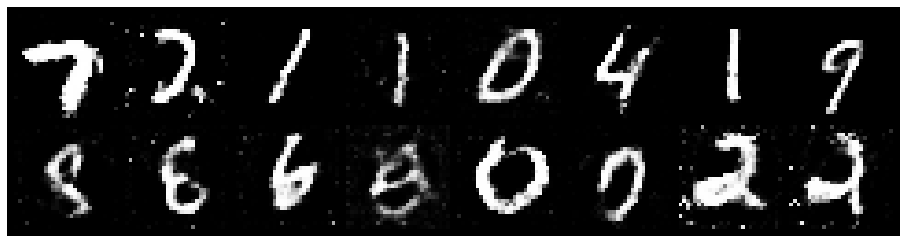

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.4202, Generator Loss: 0.8386
D(x): 0.5356, D(G(z)): 0.4965


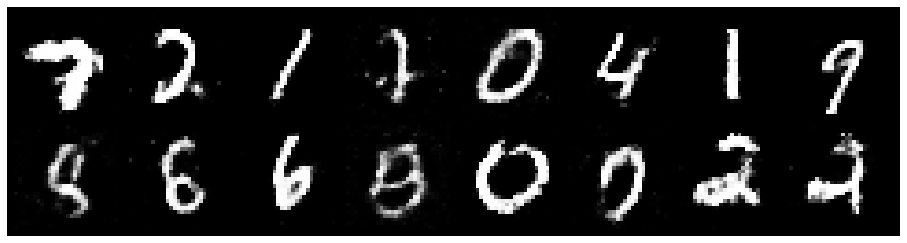

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.3640, Generator Loss: 0.8348
D(x): 0.5494, D(G(z)): 0.4691


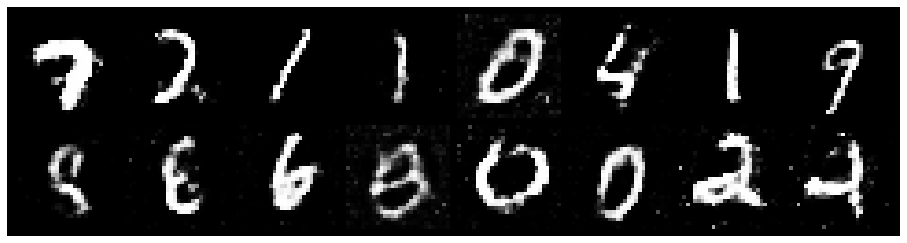

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2651, Generator Loss: 0.8540
D(x): 0.5453, D(G(z)): 0.4463


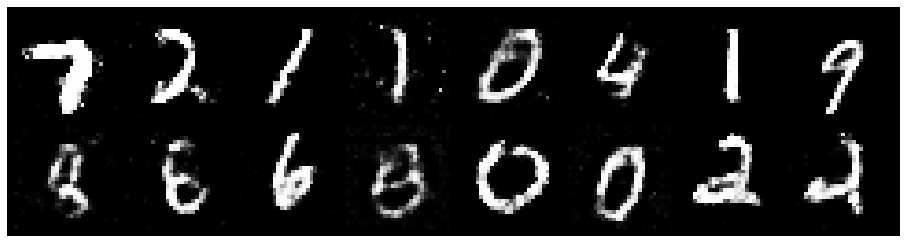

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.2482, Generator Loss: 0.8973
D(x): 0.5564, D(G(z)): 0.4515


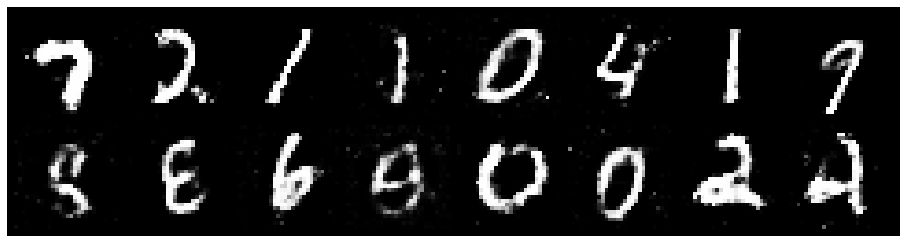

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.3012, Generator Loss: 0.9786
D(x): 0.5946, D(G(z)): 0.4903


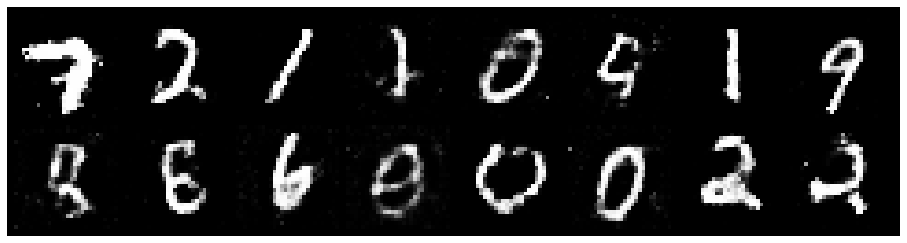

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.2804, Generator Loss: 0.9814
D(x): 0.5646, D(G(z)): 0.4522


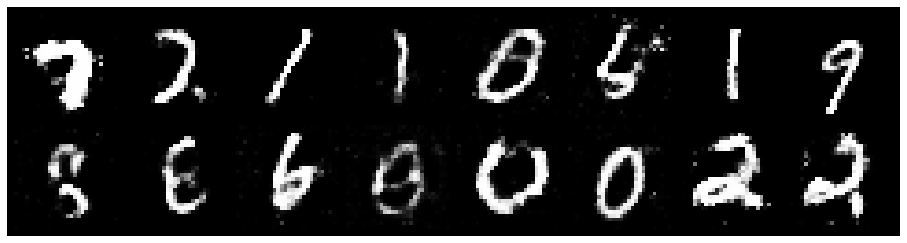

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.1982, Generator Loss: 1.0026
D(x): 0.5962, D(G(z)): 0.4428


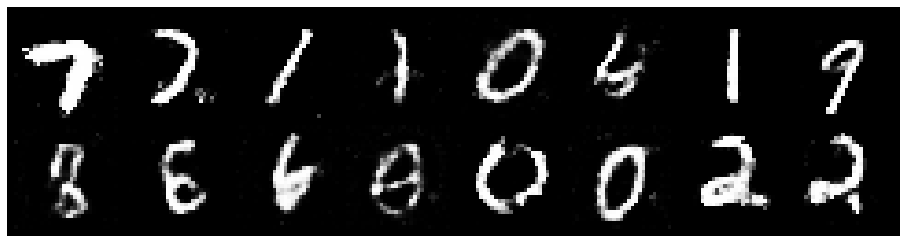

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2997, Generator Loss: 1.0328
D(x): 0.5750, D(G(z)): 0.4767


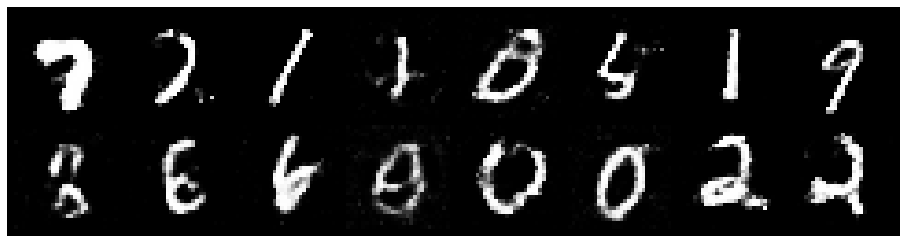

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.2213, Generator Loss: 0.8809
D(x): 0.6361, D(G(z)): 0.4852


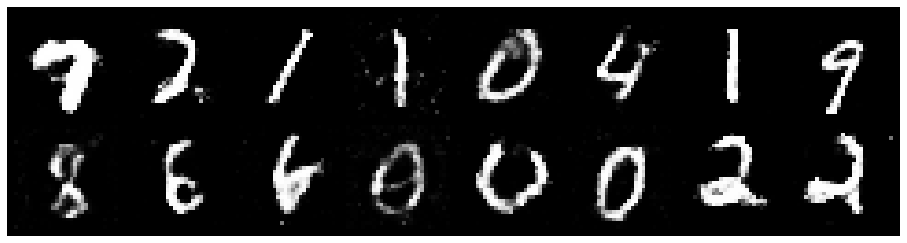

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.2071, Generator Loss: 0.9865
D(x): 0.5876, D(G(z)): 0.4263


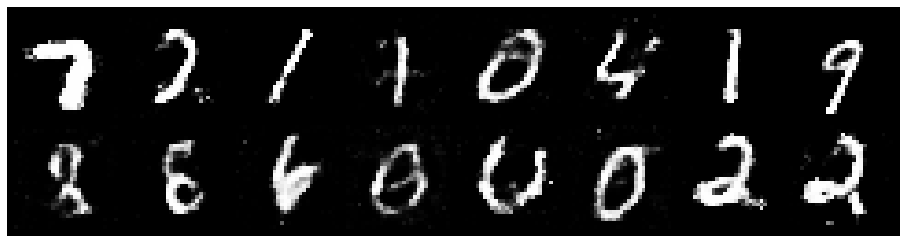

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.2661, Generator Loss: 0.9245
D(x): 0.5715, D(G(z)): 0.4559


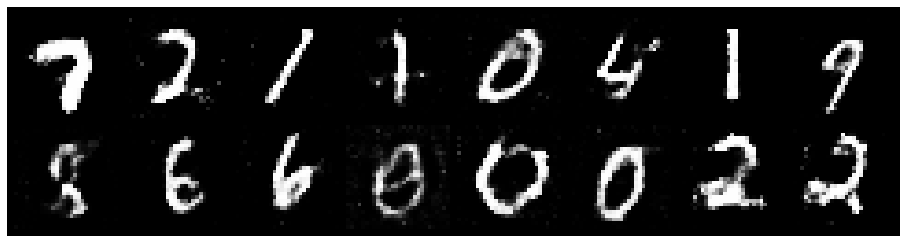

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.2572, Generator Loss: 0.9176
D(x): 0.5821, D(G(z)): 0.4559


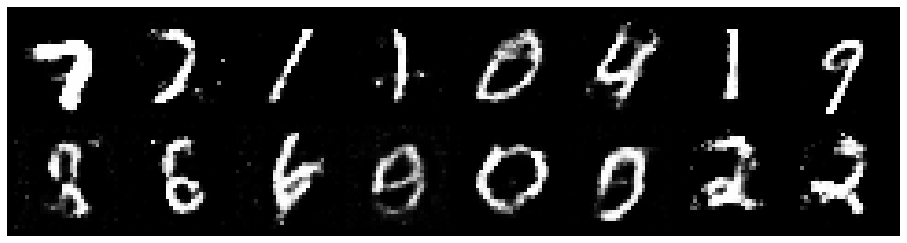

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.1952, Generator Loss: 0.8440
D(x): 0.5742, D(G(z)): 0.4345


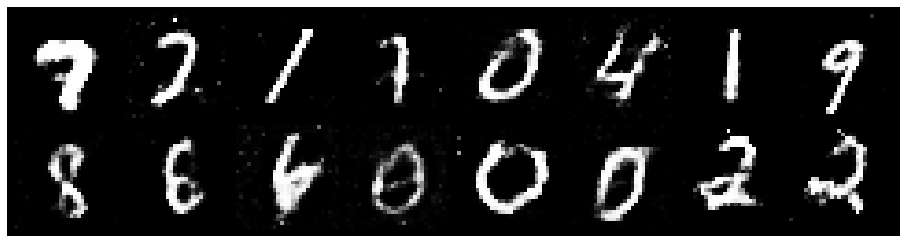

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.2571, Generator Loss: 0.9241
D(x): 0.5427, D(G(z)): 0.4315


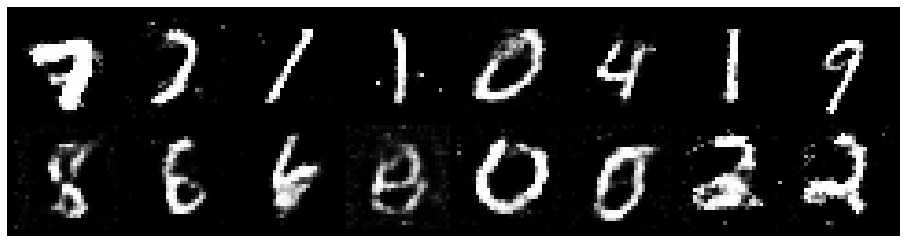

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.1473, Generator Loss: 1.0149
D(x): 0.6002, D(G(z)): 0.4132


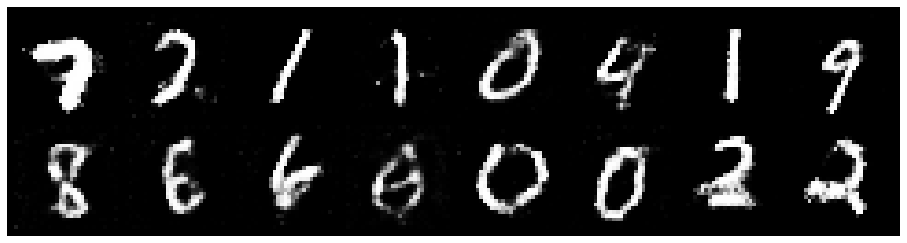

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.4588, Generator Loss: 0.8536
D(x): 0.5534, D(G(z)): 0.4976


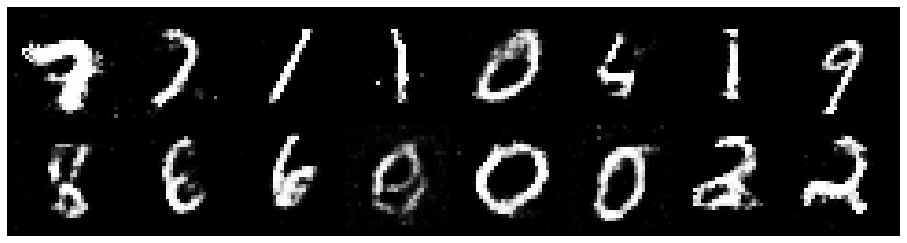

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.3592, Generator Loss: 0.8402
D(x): 0.5246, D(G(z)): 0.4616


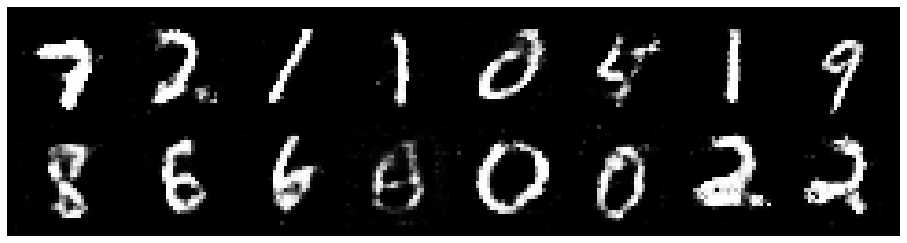

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.3390, Generator Loss: 0.7809
D(x): 0.5296, D(G(z)): 0.4855


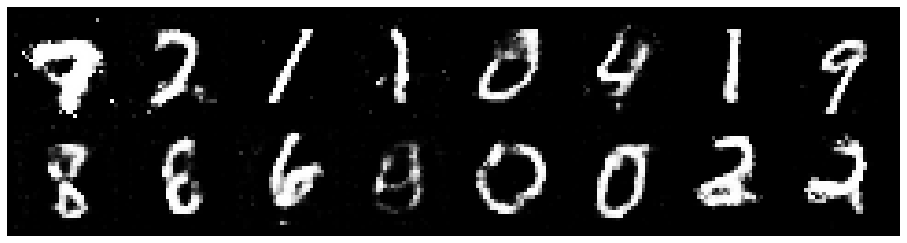

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.2404, Generator Loss: 0.8287
D(x): 0.5449, D(G(z)): 0.4249


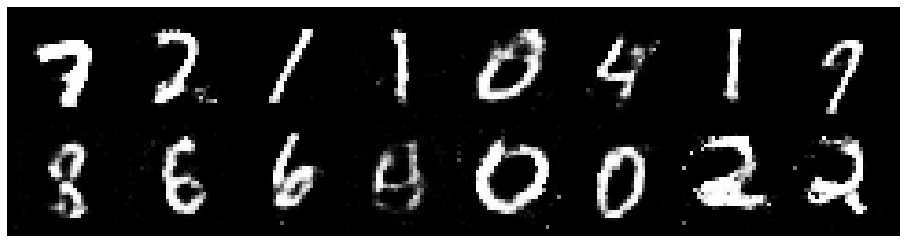

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.3501, Generator Loss: 0.8192
D(x): 0.5391, D(G(z)): 0.4720


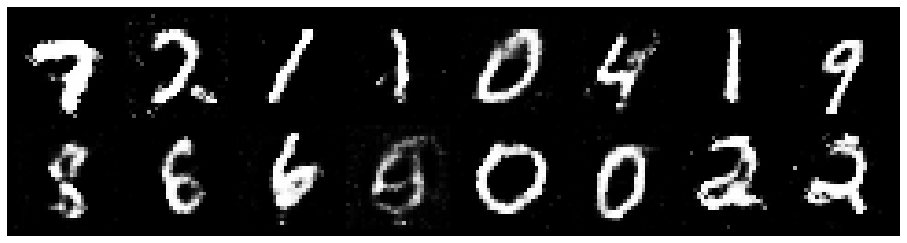

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.3408, Generator Loss: 0.8748
D(x): 0.5077, D(G(z)): 0.4220


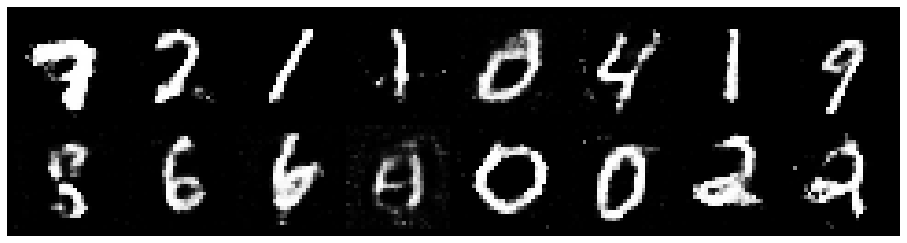

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.2375, Generator Loss: 0.8485
D(x): 0.5618, D(G(z)): 0.4390


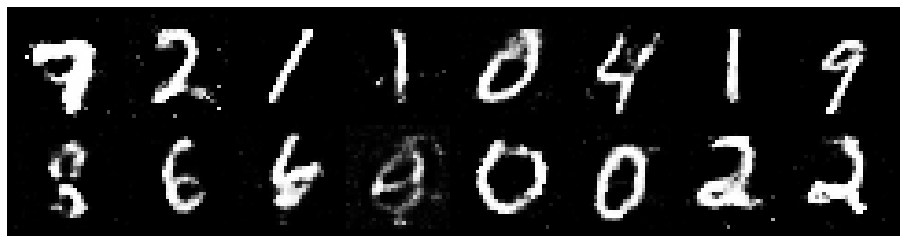

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.3199, Generator Loss: 0.8998
D(x): 0.5544, D(G(z)): 0.4574


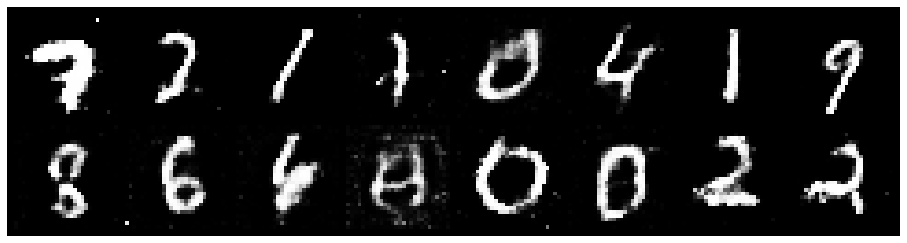

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.3081, Generator Loss: 0.8606
D(x): 0.5462, D(G(z)): 0.4661


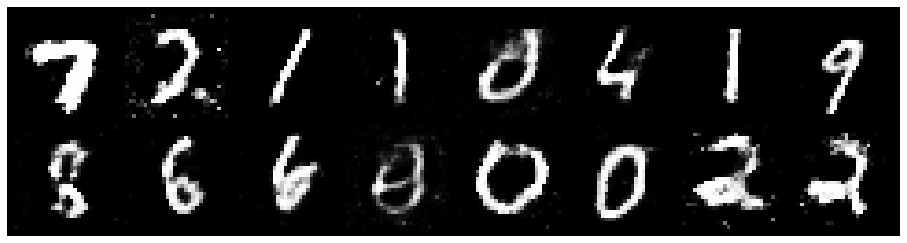

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.3654, Generator Loss: 0.8020
D(x): 0.5478, D(G(z)): 0.4934


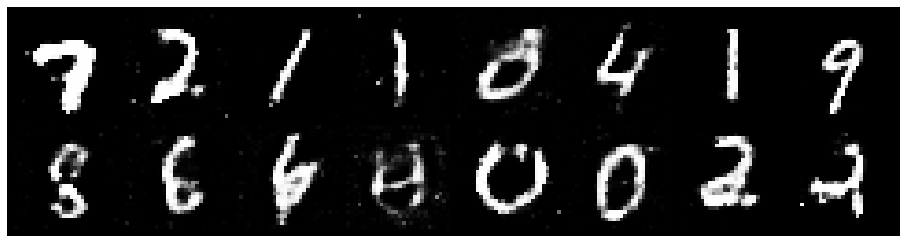

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.4324, Generator Loss: 0.8512
D(x): 0.5377, D(G(z)): 0.4832


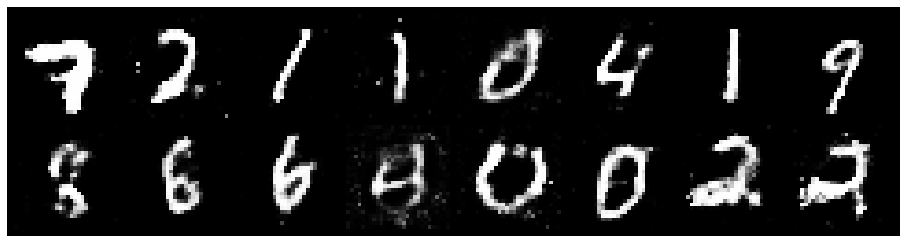

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.2800, Generator Loss: 0.9259
D(x): 0.5759, D(G(z)): 0.4594


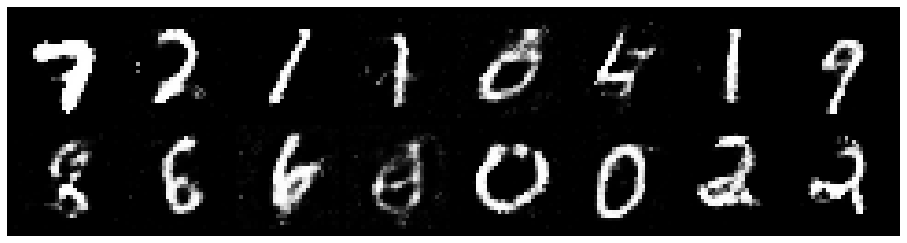

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.2596, Generator Loss: 0.9525
D(x): 0.5705, D(G(z)): 0.4618


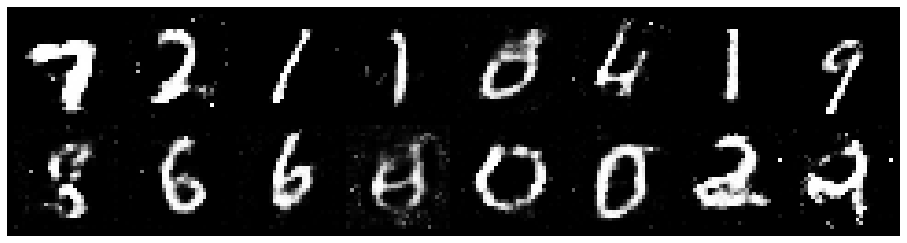

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.2514, Generator Loss: 0.9207
D(x): 0.5598, D(G(z)): 0.4370


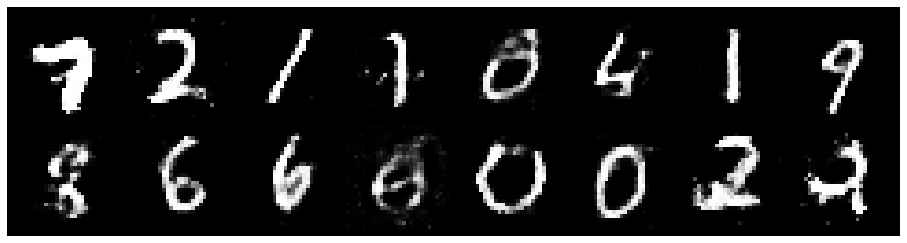

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.2229, Generator Loss: 0.9464
D(x): 0.5739, D(G(z)): 0.4420


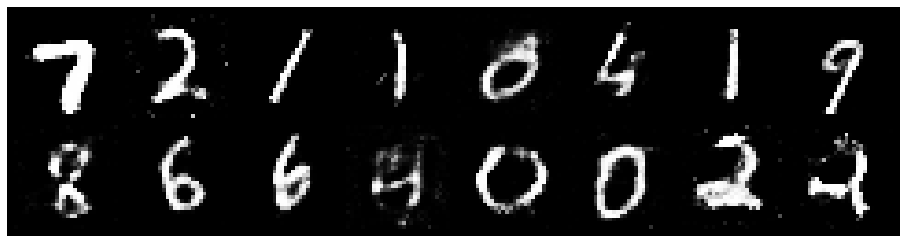

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.2502, Generator Loss: 0.8704
D(x): 0.5546, D(G(z)): 0.4354


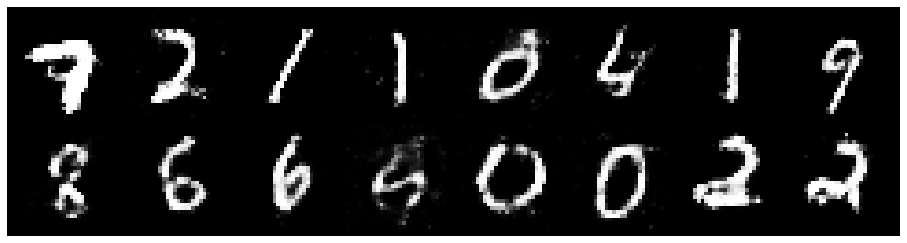

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.3331, Generator Loss: 0.8277
D(x): 0.5293, D(G(z)): 0.4681


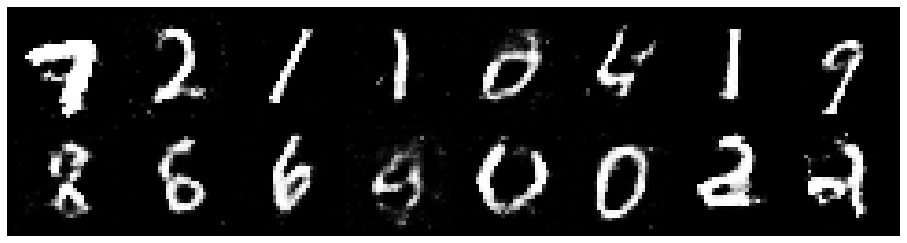

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.3305, Generator Loss: 0.8673
D(x): 0.5643, D(G(z)): 0.4662


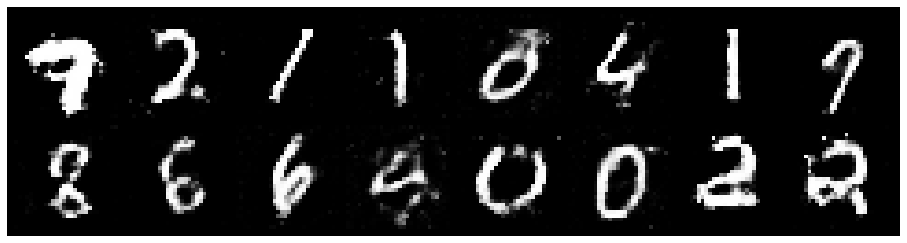

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.3018, Generator Loss: 0.8460
D(x): 0.5488, D(G(z)): 0.4625


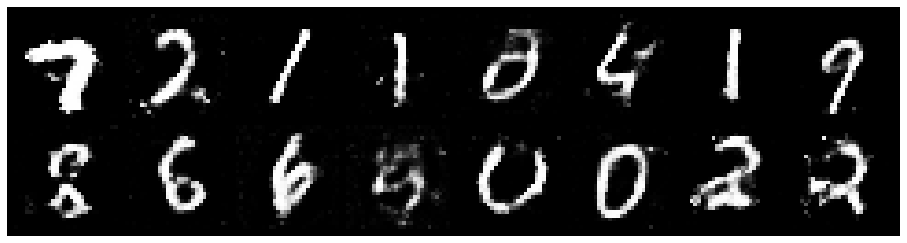

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.3736, Generator Loss: 0.9924
D(x): 0.5340, D(G(z)): 0.4551


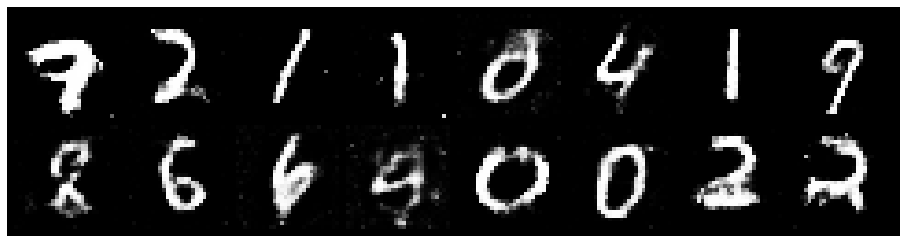

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.4052, Generator Loss: 0.8243
D(x): 0.5415, D(G(z)): 0.4810


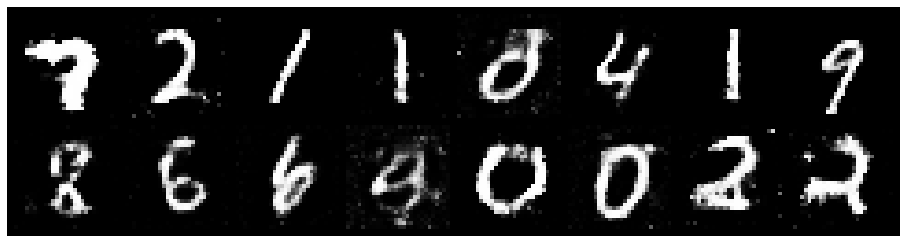

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.2877, Generator Loss: 0.9182
D(x): 0.5557, D(G(z)): 0.4332


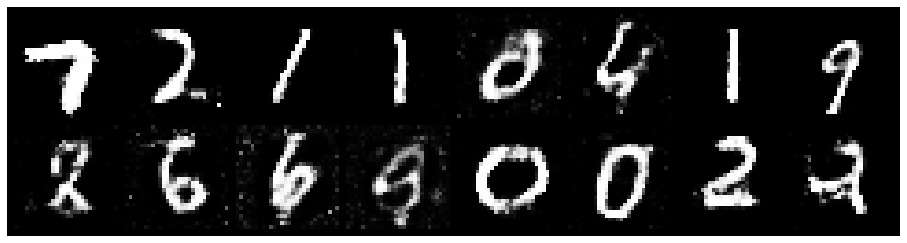

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.3354, Generator Loss: 0.8254
D(x): 0.5562, D(G(z)): 0.4735


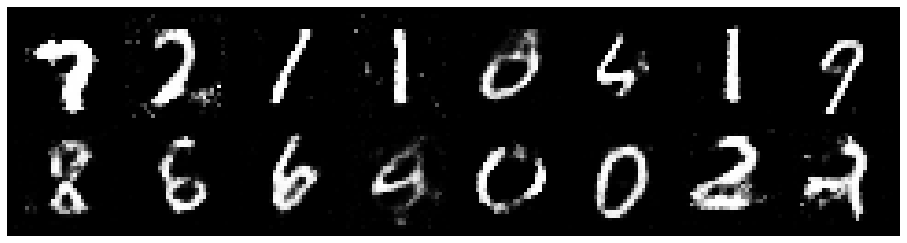

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.2855, Generator Loss: 0.8990
D(x): 0.5387, D(G(z)): 0.4411


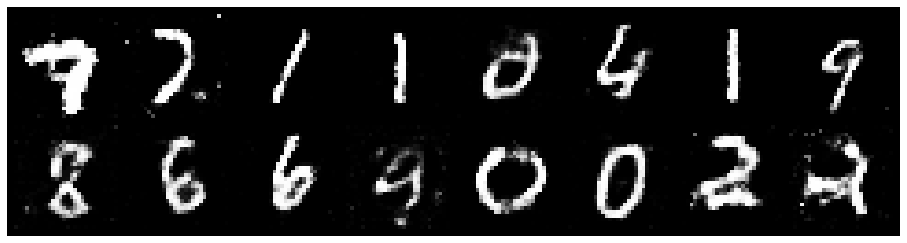

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.2670, Generator Loss: 0.8267
D(x): 0.5398, D(G(z)): 0.4505


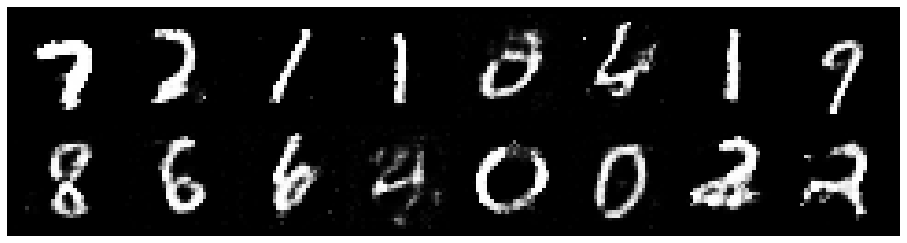

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.2429, Generator Loss: 0.8288
D(x): 0.5724, D(G(z)): 0.4403


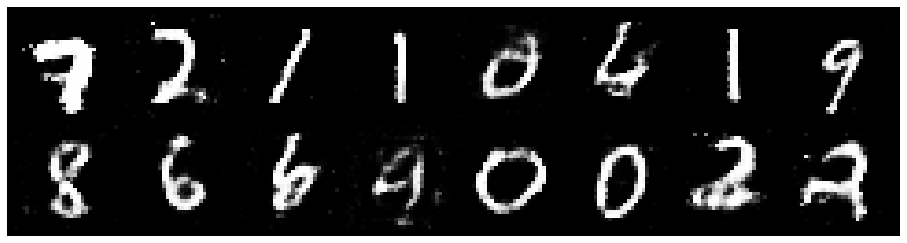

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2961, Generator Loss: 0.9450
D(x): 0.5583, D(G(z)): 0.4405


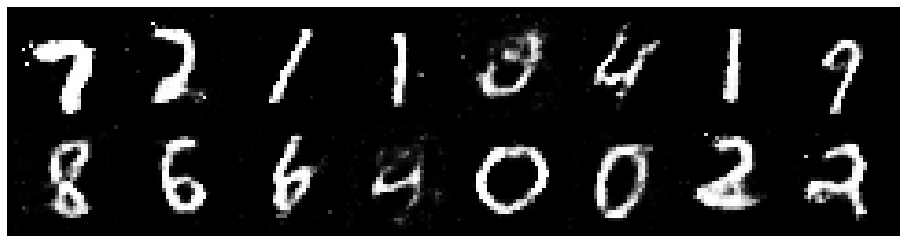

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.3608, Generator Loss: 0.8317
D(x): 0.5362, D(G(z)): 0.4669


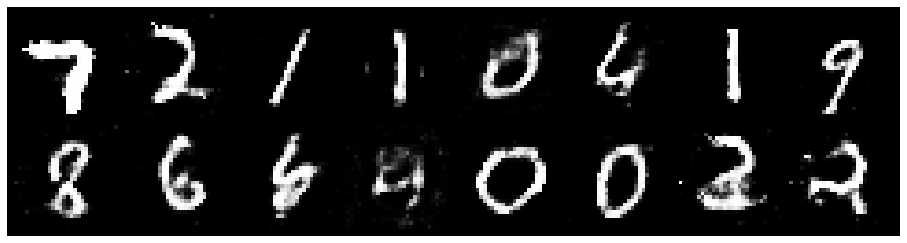

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.1812, Generator Loss: 0.9162
D(x): 0.5902, D(G(z)): 0.4295


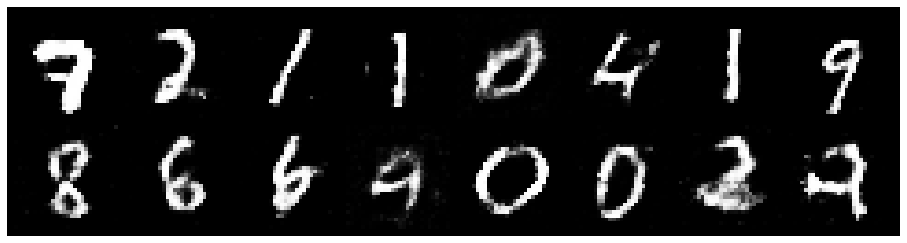

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.2496, Generator Loss: 0.9258
D(x): 0.5447, D(G(z)): 0.4404


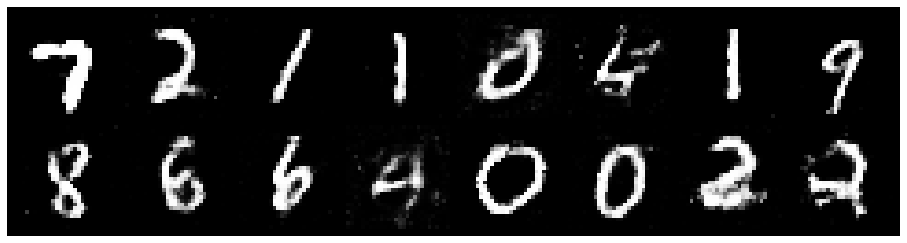

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.2862, Generator Loss: 0.9035
D(x): 0.5116, D(G(z)): 0.4095


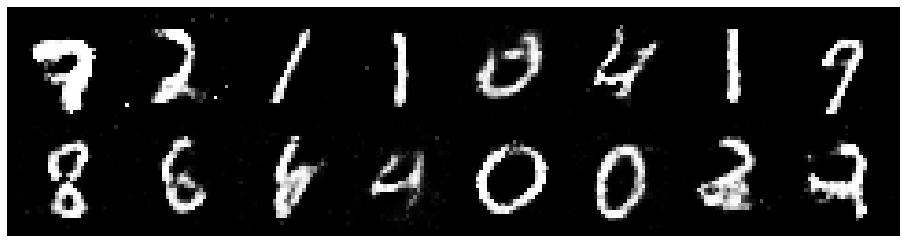

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.2385, Generator Loss: 0.9349
D(x): 0.5469, D(G(z)): 0.4268


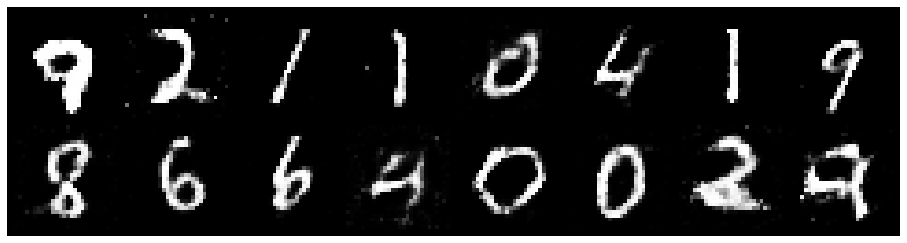

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.2894, Generator Loss: 0.9163
D(x): 0.5134, D(G(z)): 0.4351


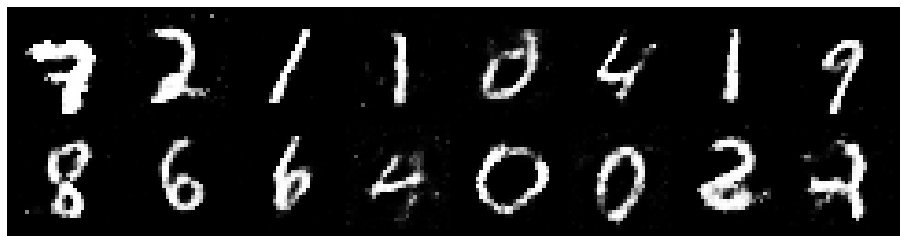

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.2098, Generator Loss: 0.8713
D(x): 0.5610, D(G(z)): 0.4316


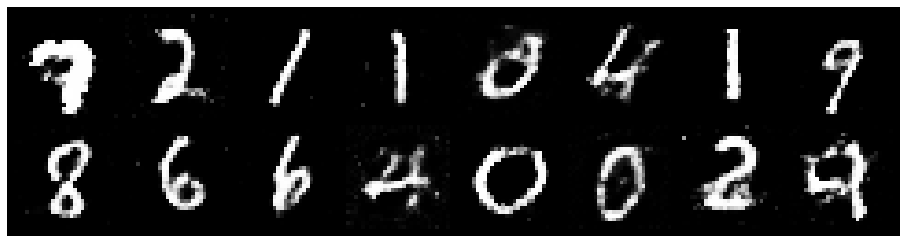

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.2742, Generator Loss: 0.9472
D(x): 0.5260, D(G(z)): 0.4287


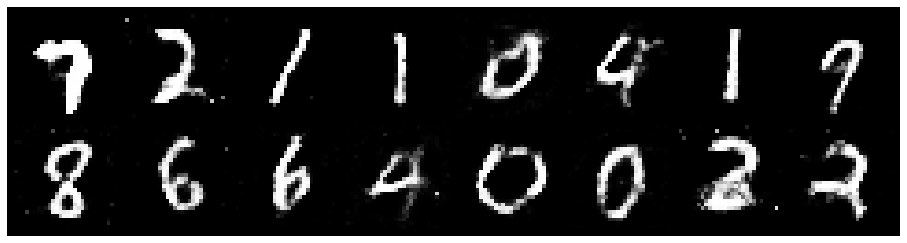

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.2670, Generator Loss: 0.9390
D(x): 0.5576, D(G(z)): 0.4524


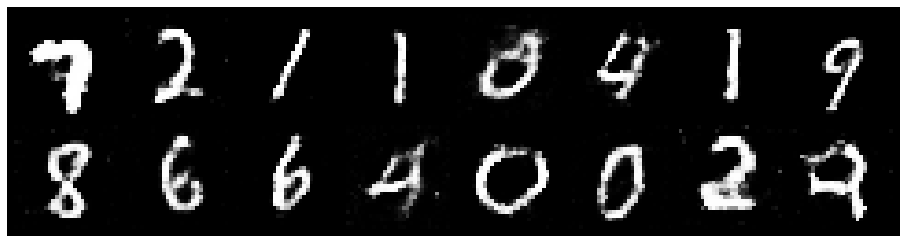

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.2930, Generator Loss: 0.9190
D(x): 0.5495, D(G(z)): 0.4555


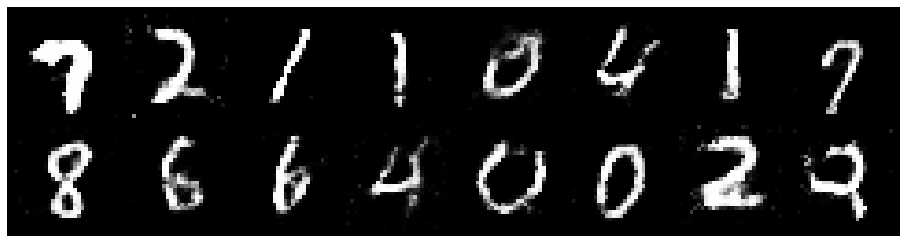

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.1851, Generator Loss: 0.8089
D(x): 0.5826, D(G(z)): 0.4455


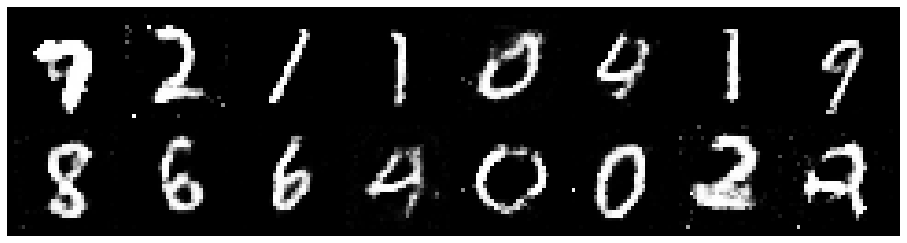

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.2893, Generator Loss: 0.8288
D(x): 0.5816, D(G(z)): 0.4656


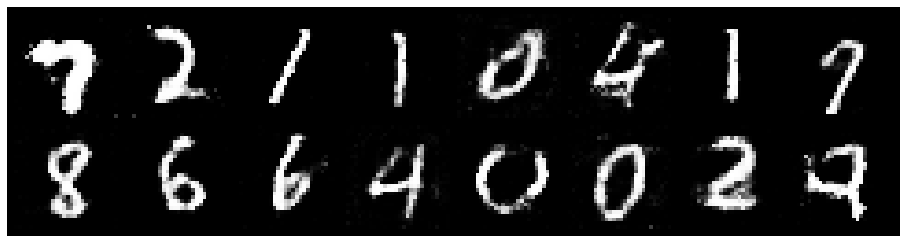

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.4182, Generator Loss: 0.9247
D(x): 0.5286, D(G(z)): 0.4497


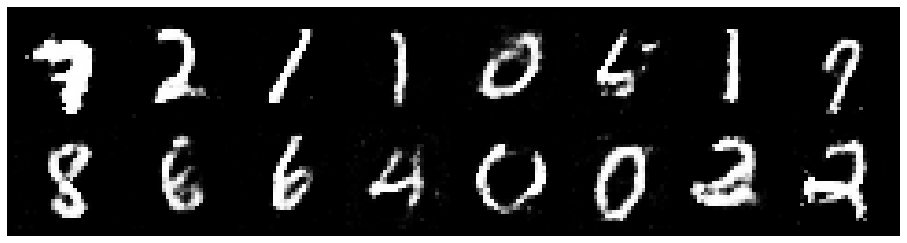

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.3134, Generator Loss: 0.9273
D(x): 0.5220, D(G(z)): 0.4202


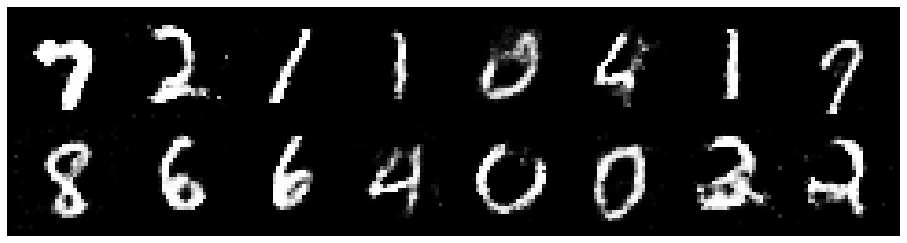

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.2761, Generator Loss: 0.8937
D(x): 0.5567, D(G(z)): 0.4507


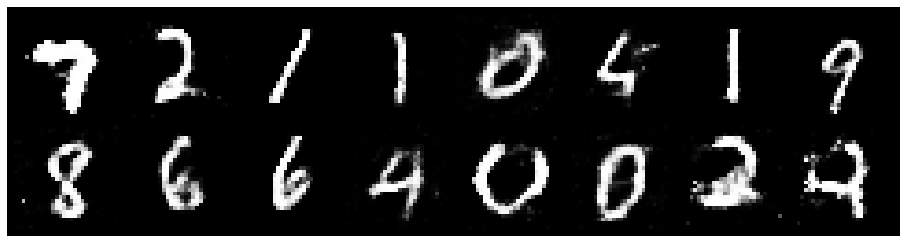

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.3900, Generator Loss: 0.8731
D(x): 0.5494, D(G(z)): 0.4696


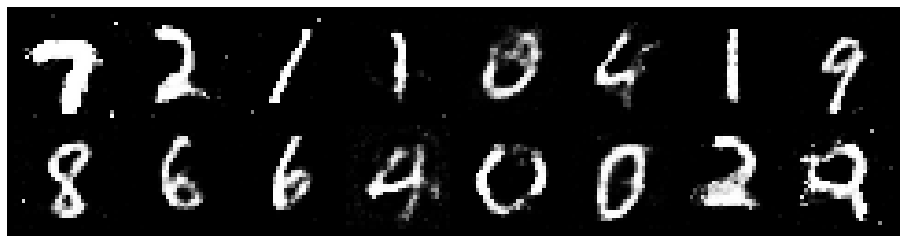

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.2590, Generator Loss: 1.0560
D(x): 0.5487, D(G(z)): 0.4173


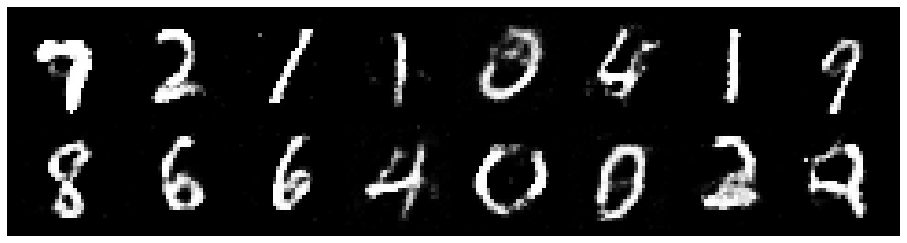

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.1473, Generator Loss: 0.8060
D(x): 0.6044, D(G(z)): 0.4320


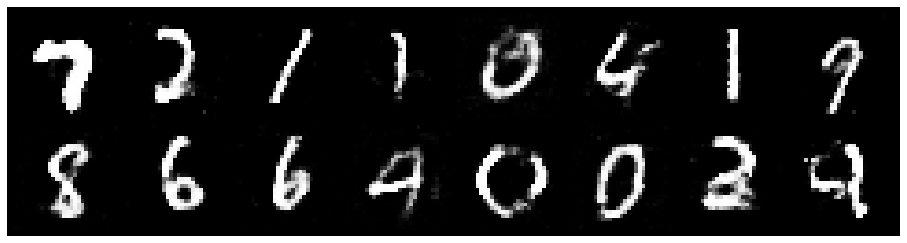

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.2735, Generator Loss: 0.9338
D(x): 0.5786, D(G(z)): 0.4435


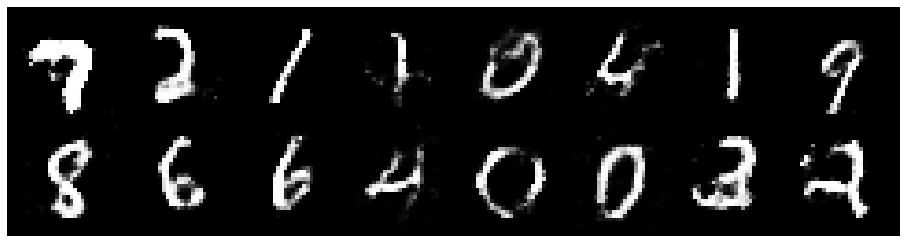

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.3867, Generator Loss: 0.7740
D(x): 0.5701, D(G(z)): 0.4870


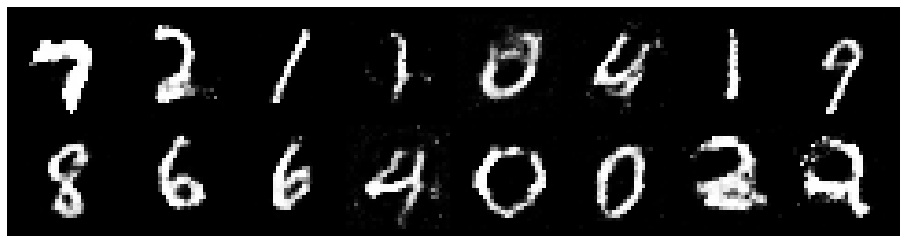

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.2798, Generator Loss: 0.9466
D(x): 0.5280, D(G(z)): 0.4185


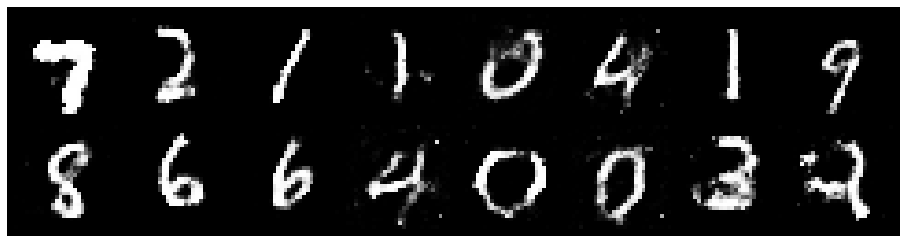

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.3110, Generator Loss: 0.8747
D(x): 0.5325, D(G(z)): 0.4510


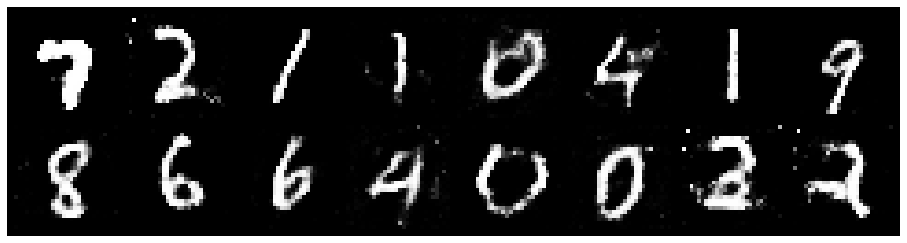

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.2589, Generator Loss: 0.8157
D(x): 0.5682, D(G(z)): 0.4613


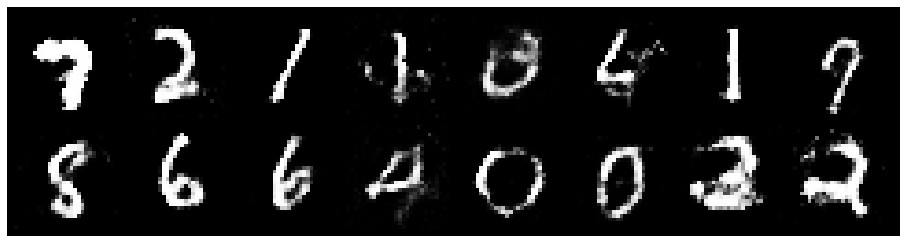

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.1544, Generator Loss: 0.9535
D(x): 0.5858, D(G(z)): 0.4088


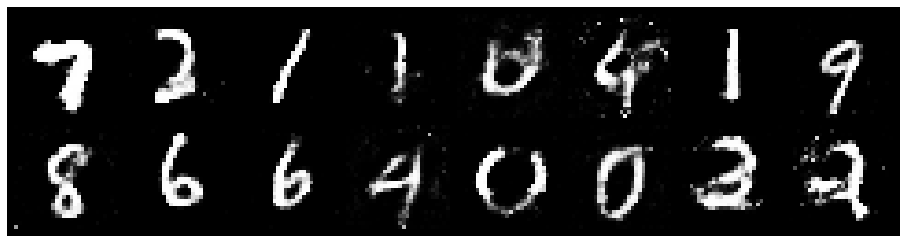

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.2707, Generator Loss: 0.8993
D(x): 0.5619, D(G(z)): 0.4424


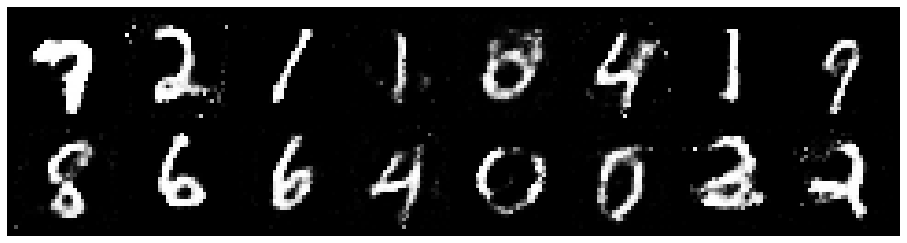

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.2514, Generator Loss: 0.9330
D(x): 0.5616, D(G(z)): 0.4291


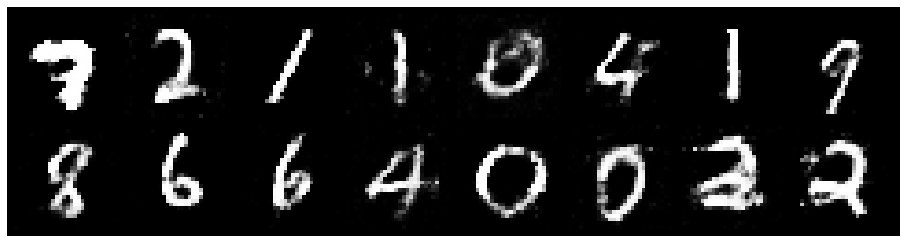

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.2997, Generator Loss: 0.8467
D(x): 0.5269, D(G(z)): 0.4380


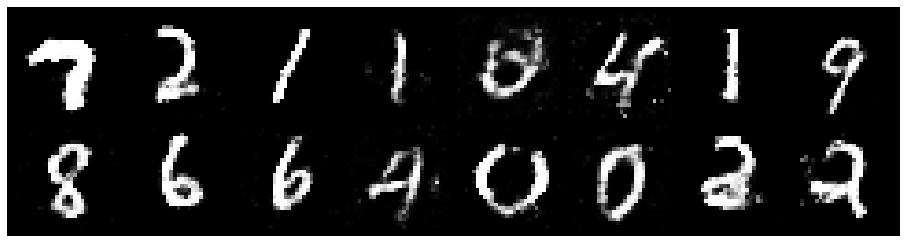

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2991, Generator Loss: 0.8718
D(x): 0.5620, D(G(z)): 0.4763


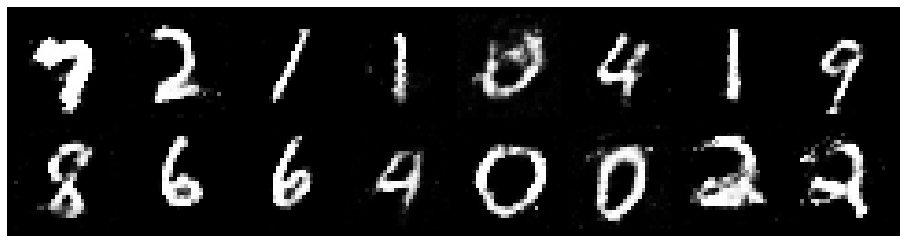

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.2576, Generator Loss: 0.8066
D(x): 0.5659, D(G(z)): 0.4588


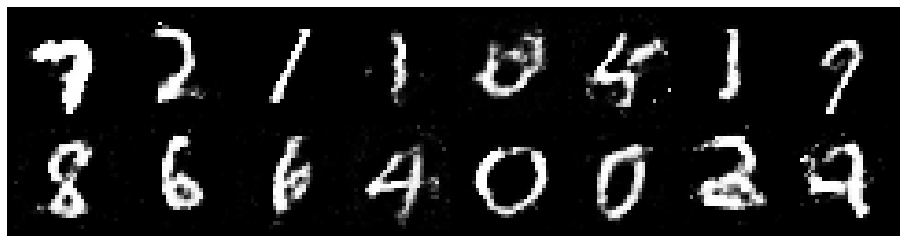

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.3425, Generator Loss: 0.8014
D(x): 0.5649, D(G(z)): 0.4840


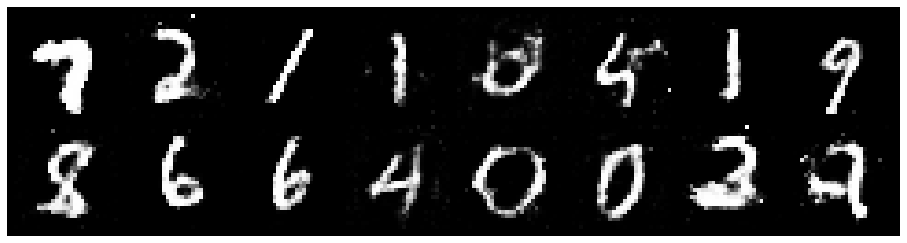

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.2332, Generator Loss: 0.8262
D(x): 0.5727, D(G(z)): 0.4454


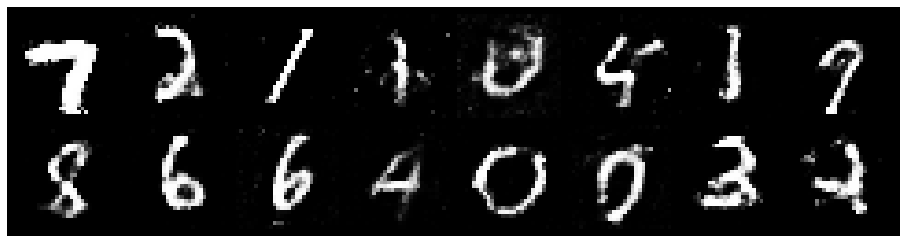

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.2547, Generator Loss: 0.8523
D(x): 0.5122, D(G(z)): 0.4169


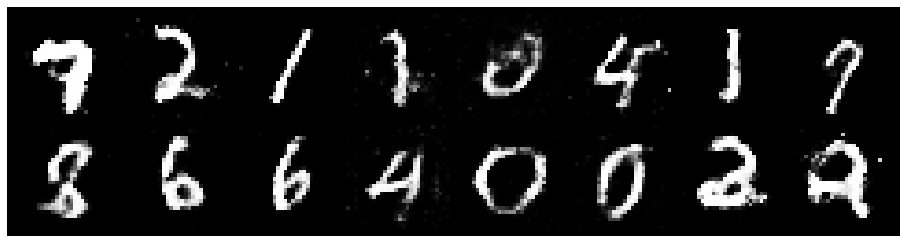

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.2786, Generator Loss: 0.8410
D(x): 0.5446, D(G(z)): 0.4514


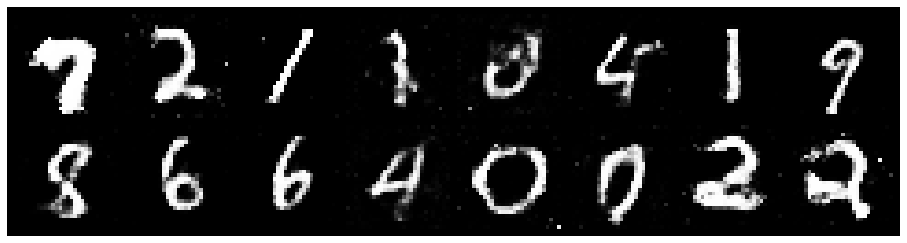

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.2903, Generator Loss: 0.8451
D(x): 0.5408, D(G(z)): 0.4468


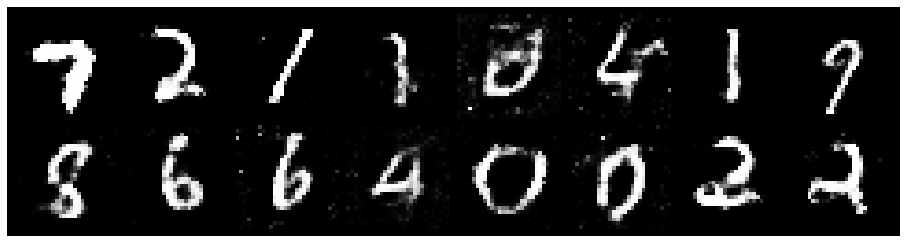

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.2061, Generator Loss: 0.8520
D(x): 0.5730, D(G(z)): 0.4411


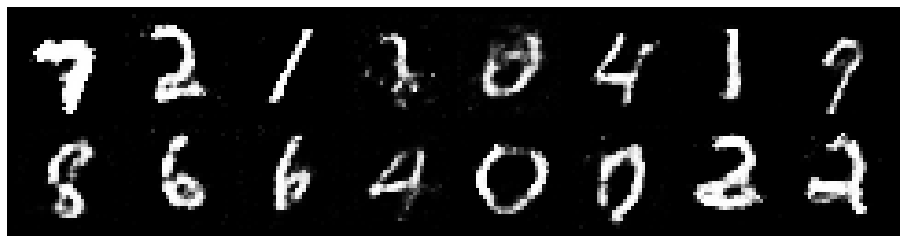

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.1469, Generator Loss: 0.9698
D(x): 0.6107, D(G(z)): 0.4234


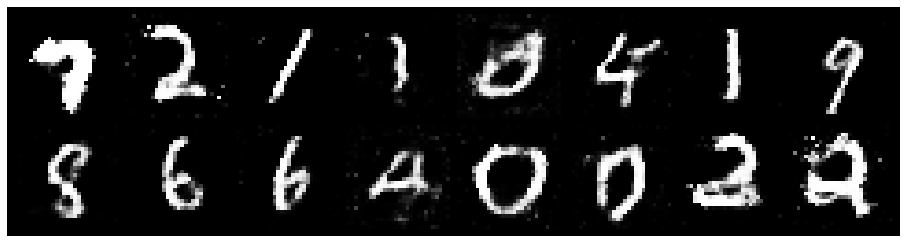

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.3010, Generator Loss: 0.8744
D(x): 0.5841, D(G(z)): 0.4595


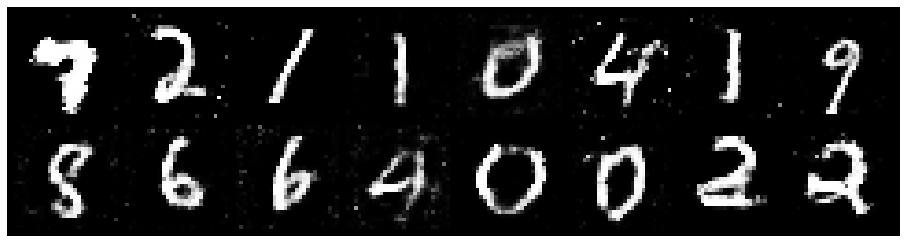

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.2899, Generator Loss: 0.8540
D(x): 0.5806, D(G(z)): 0.4904


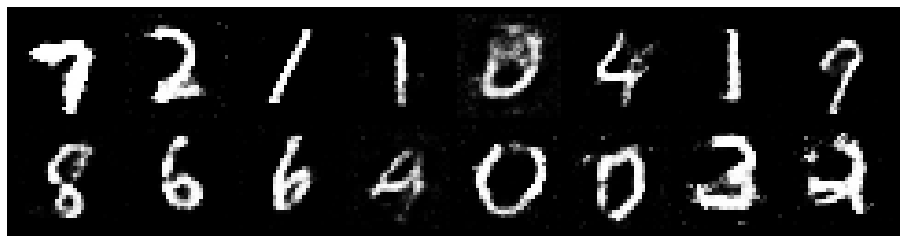

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.3116, Generator Loss: 0.8404
D(x): 0.5301, D(G(z)): 0.4703


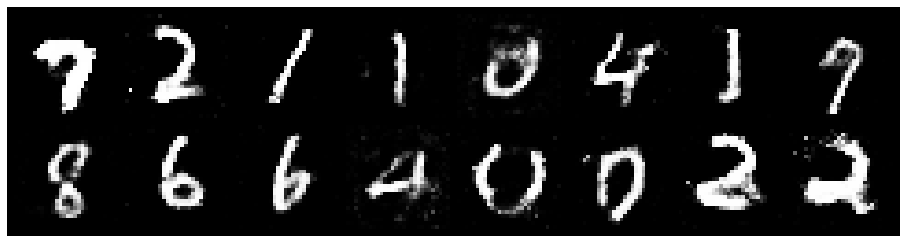

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.2377, Generator Loss: 0.8789
D(x): 0.5553, D(G(z)): 0.4430


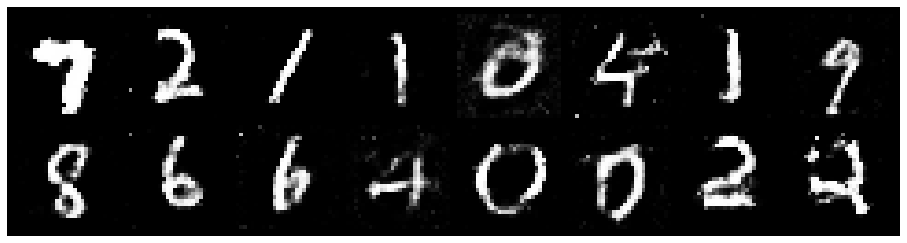

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2880, Generator Loss: 0.8287
D(x): 0.5567, D(G(z)): 0.4448


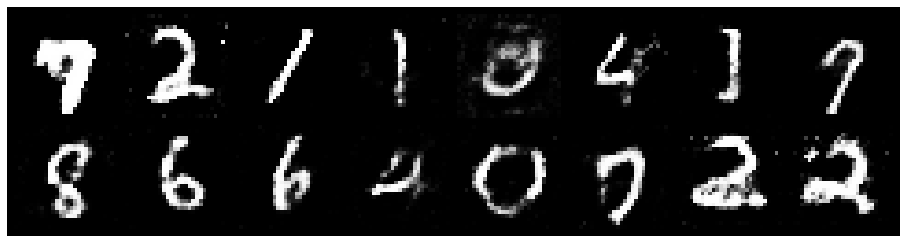

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.3404, Generator Loss: 0.8623
D(x): 0.5436, D(G(z)): 0.4512


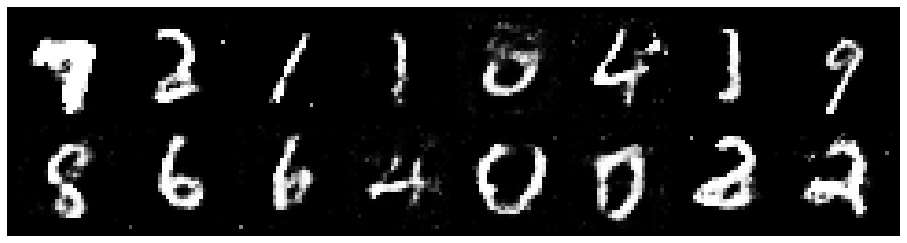

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.2176, Generator Loss: 0.8788
D(x): 0.6071, D(G(z)): 0.4439


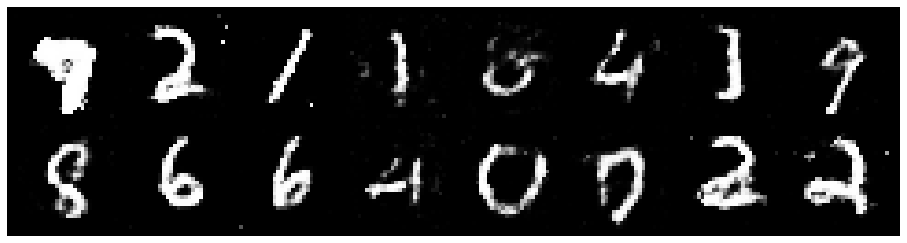

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.1454, Generator Loss: 1.1306
D(x): 0.5950, D(G(z)): 0.4032


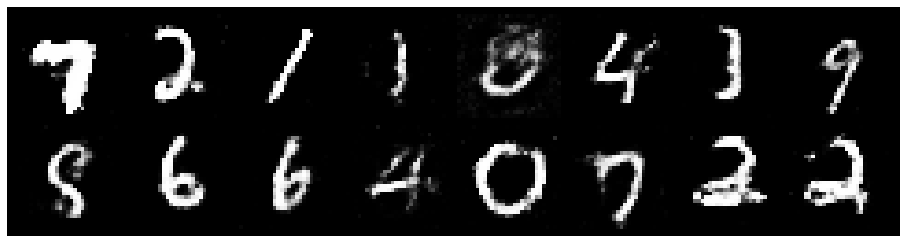

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.2147, Generator Loss: 0.9984
D(x): 0.5742, D(G(z)): 0.4176


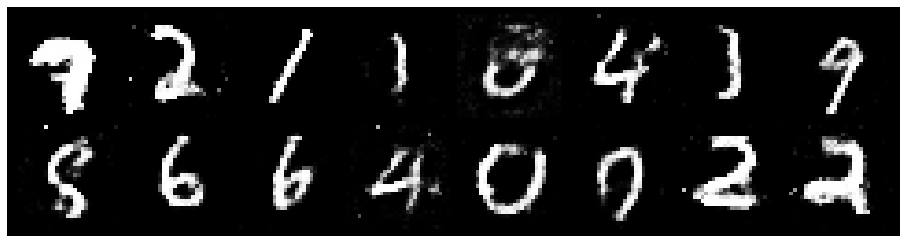

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.1426, Generator Loss: 1.1313
D(x): 0.5780, D(G(z)): 0.4025


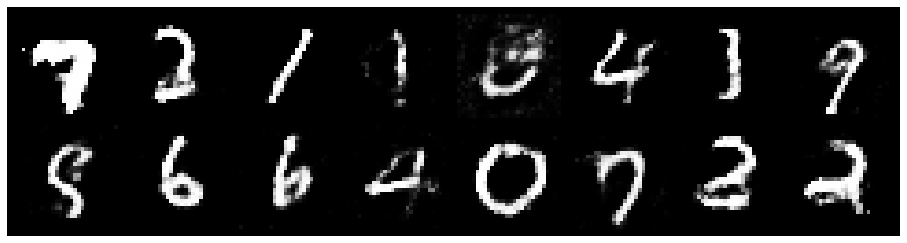

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.3460, Generator Loss: 0.8198
D(x): 0.5225, D(G(z)): 0.4379


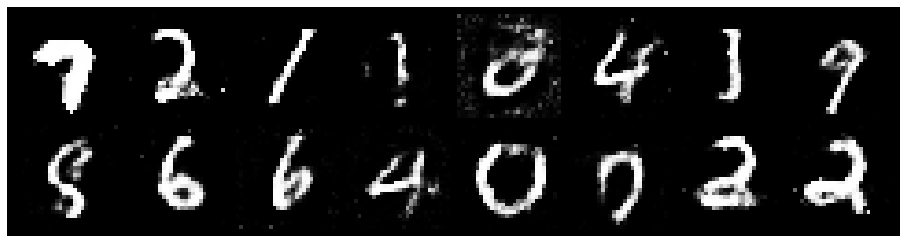

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.3587, Generator Loss: 0.9342
D(x): 0.5530, D(G(z)): 0.4654


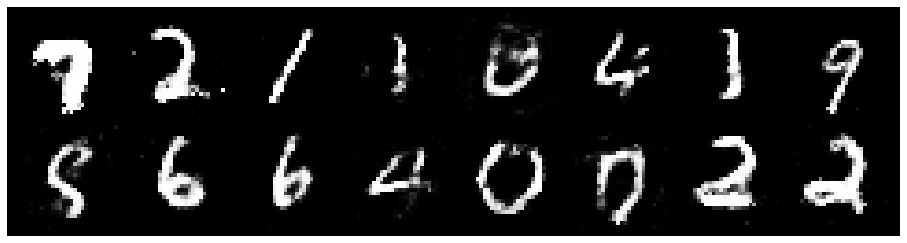

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.2470, Generator Loss: 0.8275
D(x): 0.5774, D(G(z)): 0.4521


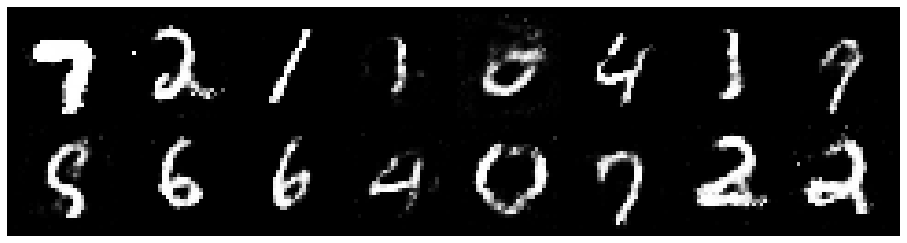

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.2489, Generator Loss: 0.9514
D(x): 0.5422, D(G(z)): 0.4294


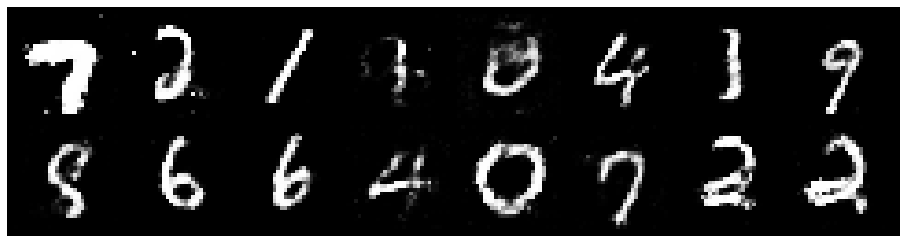

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.3629, Generator Loss: 0.8546
D(x): 0.5331, D(G(z)): 0.4764


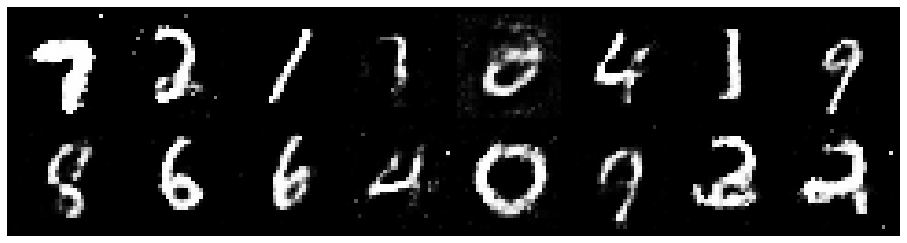

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.2515, Generator Loss: 0.9842
D(x): 0.5591, D(G(z)): 0.4427


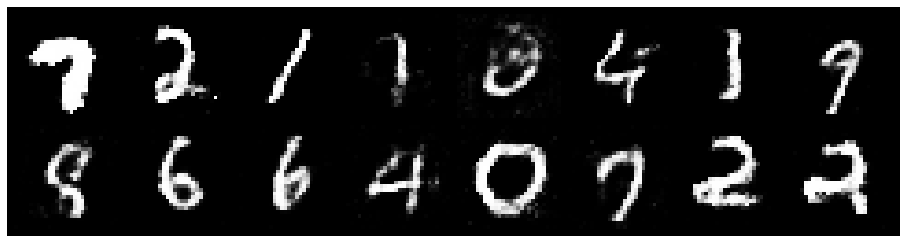

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.1977, Generator Loss: 0.9139
D(x): 0.5764, D(G(z)): 0.4211


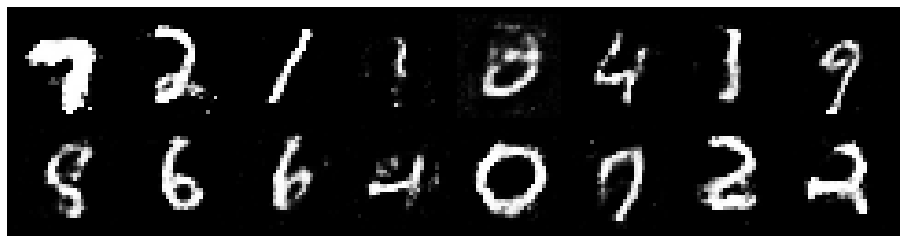

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2626, Generator Loss: 0.8935
D(x): 0.5787, D(G(z)): 0.4380


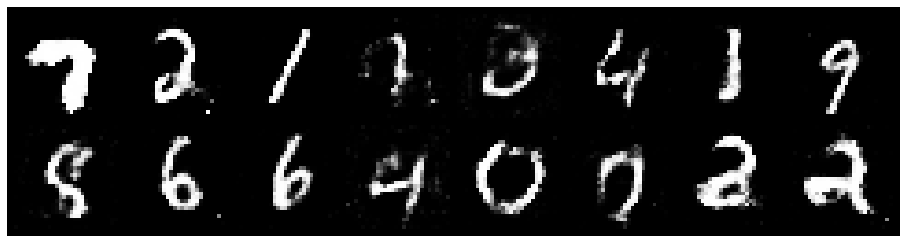

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.2929, Generator Loss: 0.9048
D(x): 0.5565, D(G(z)): 0.4649


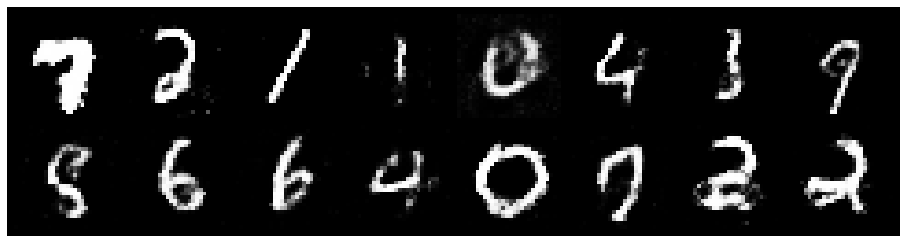

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.3277, Generator Loss: 0.8342
D(x): 0.5147, D(G(z)): 0.4475


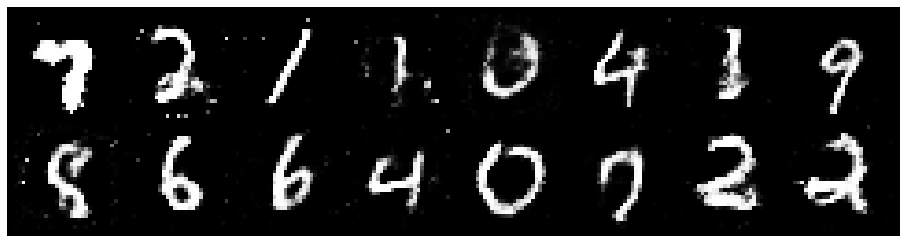

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2397, Generator Loss: 0.7501
D(x): 0.5777, D(G(z)): 0.4437


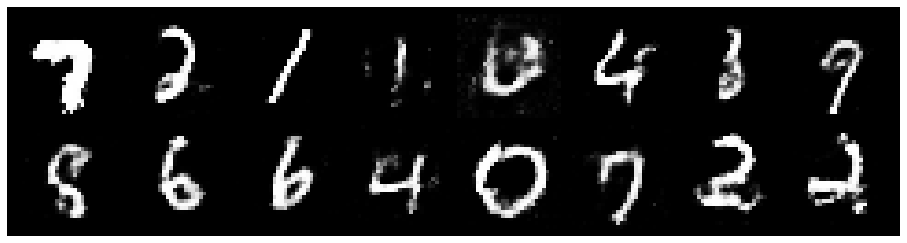

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.3390, Generator Loss: 0.8463
D(x): 0.5275, D(G(z)): 0.4498


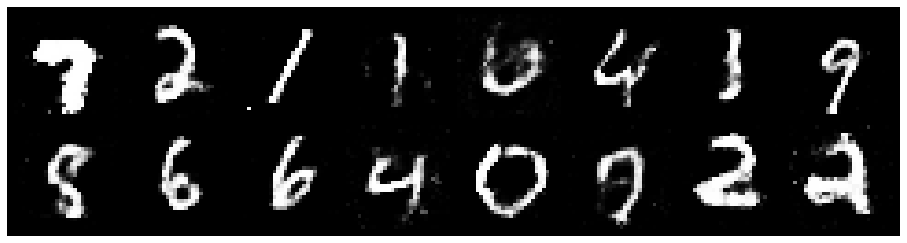

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.4258, Generator Loss: 0.8710
D(x): 0.5038, D(G(z)): 0.4623


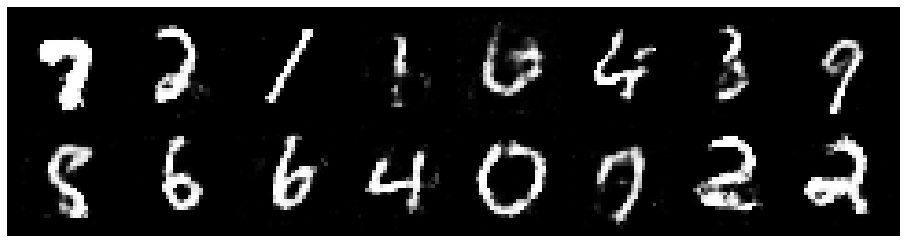

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.2093, Generator Loss: 0.8878
D(x): 0.5971, D(G(z)): 0.4480


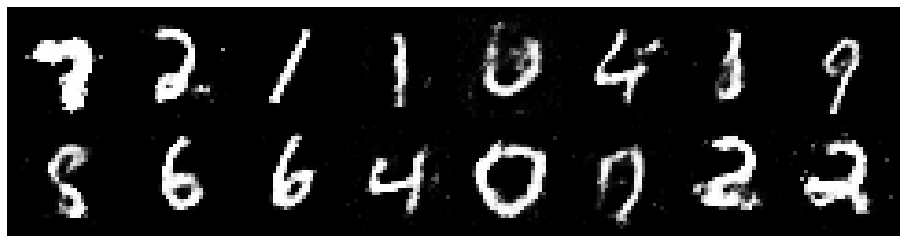

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2555, Generator Loss: 0.8495
D(x): 0.5558, D(G(z)): 0.4422


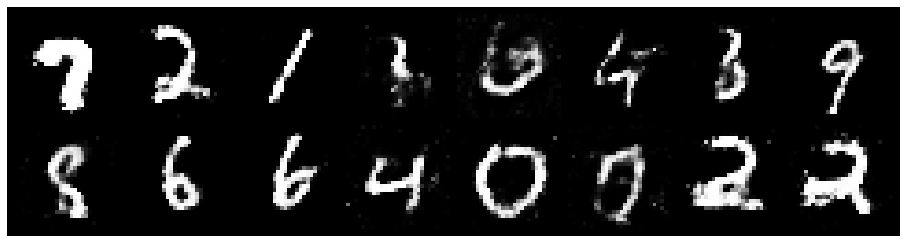

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.2927, Generator Loss: 0.8515
D(x): 0.5927, D(G(z)): 0.4825


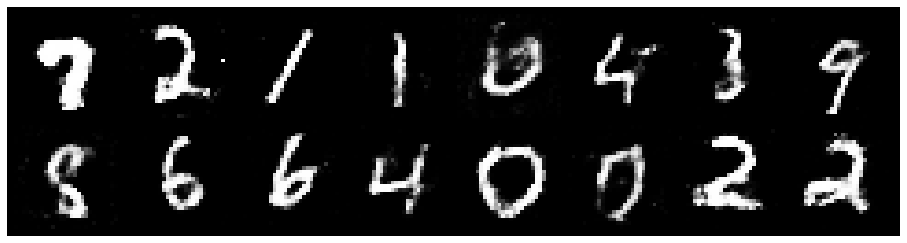

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.3047, Generator Loss: 0.8156
D(x): 0.5820, D(G(z)): 0.4735


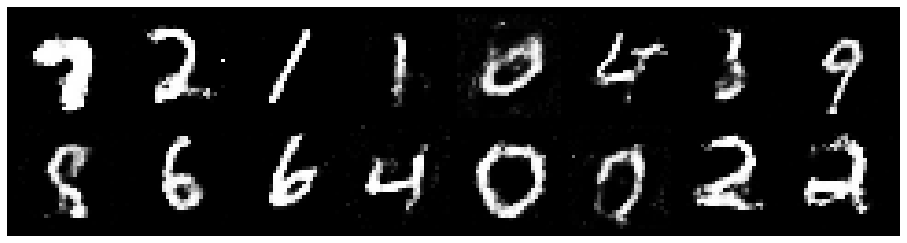

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.3084, Generator Loss: 0.7990
D(x): 0.5772, D(G(z)): 0.4713


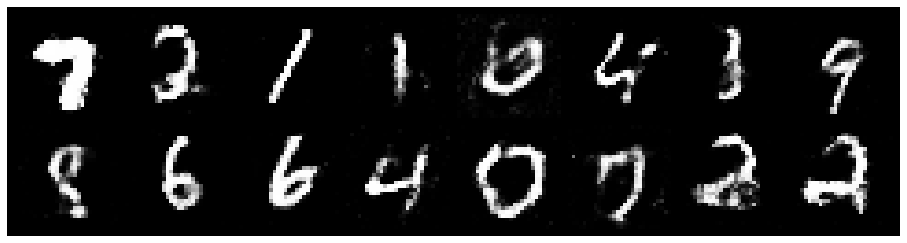

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.3029, Generator Loss: 0.7788
D(x): 0.5488, D(G(z)): 0.4695


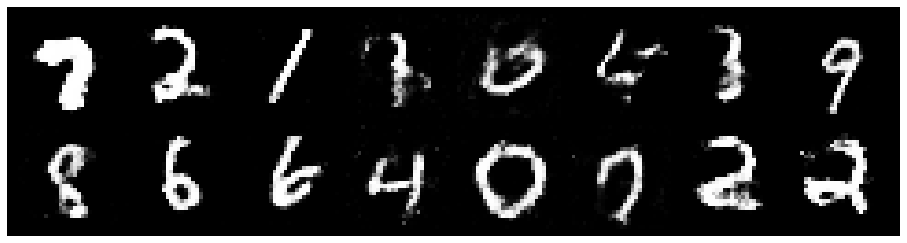

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.2682, Generator Loss: 0.8331
D(x): 0.5418, D(G(z)): 0.4514


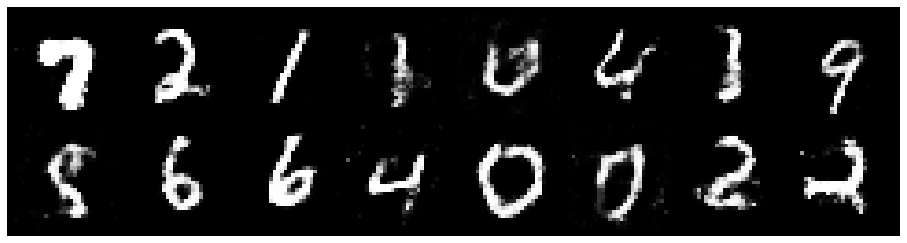

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.2604, Generator Loss: 0.8470
D(x): 0.5413, D(G(z)): 0.4466


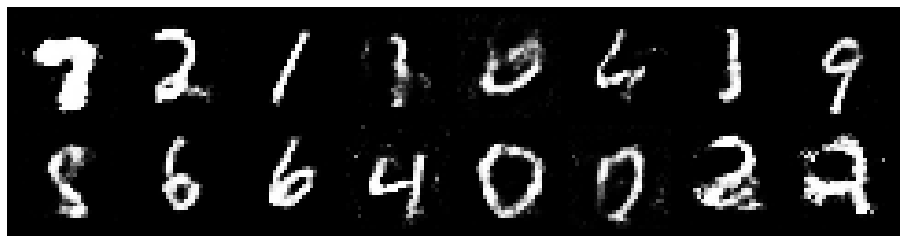

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.2921, Generator Loss: 0.9163
D(x): 0.5269, D(G(z)): 0.4400


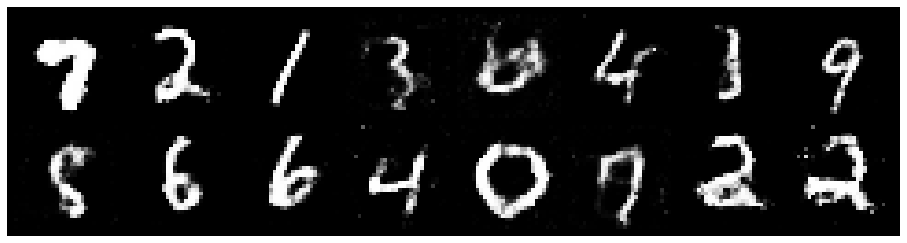

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.3258, Generator Loss: 0.8776
D(x): 0.5581, D(G(z)): 0.4803


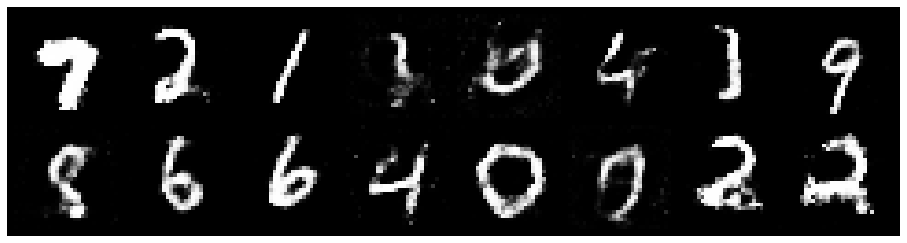

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.2336, Generator Loss: 0.9775
D(x): 0.5699, D(G(z)): 0.4330


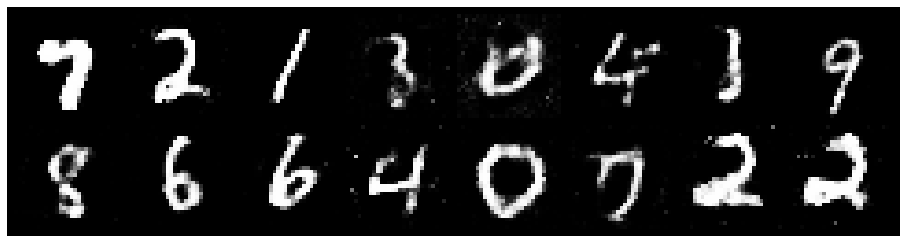

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2424, Generator Loss: 0.9462
D(x): 0.5558, D(G(z)): 0.4329


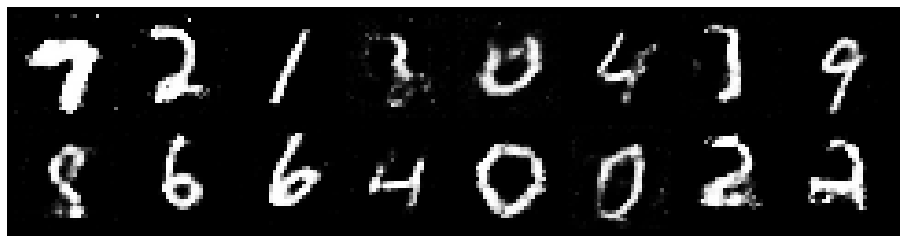

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.2667, Generator Loss: 0.8484
D(x): 0.5593, D(G(z)): 0.4433


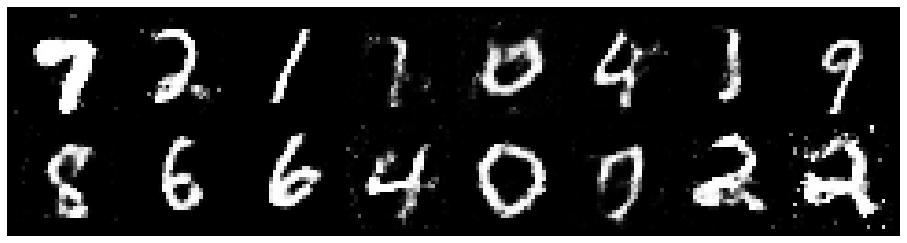

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.2956, Generator Loss: 0.8428
D(x): 0.5384, D(G(z)): 0.4367


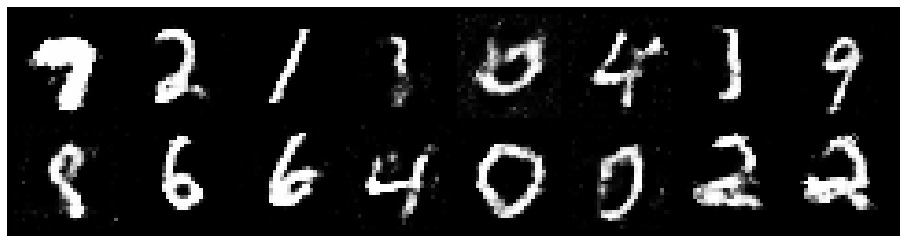

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.3275, Generator Loss: 1.0030
D(x): 0.4847, D(G(z)): 0.3963


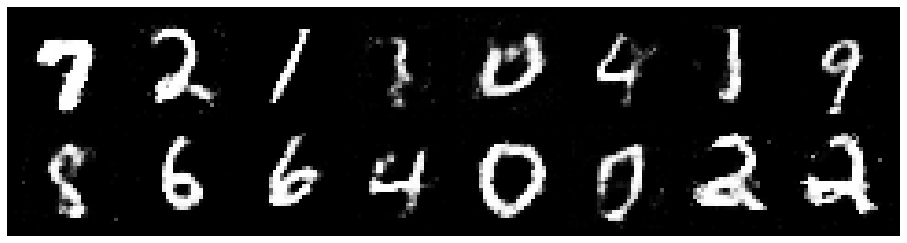

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.3066, Generator Loss: 0.9329
D(x): 0.5315, D(G(z)): 0.4293


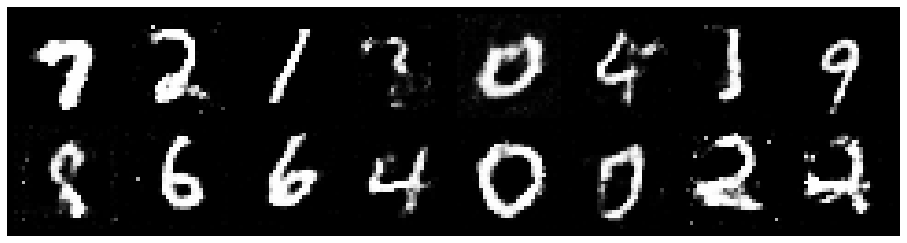

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.3953, Generator Loss: 0.8372
D(x): 0.5731, D(G(z)): 0.5032


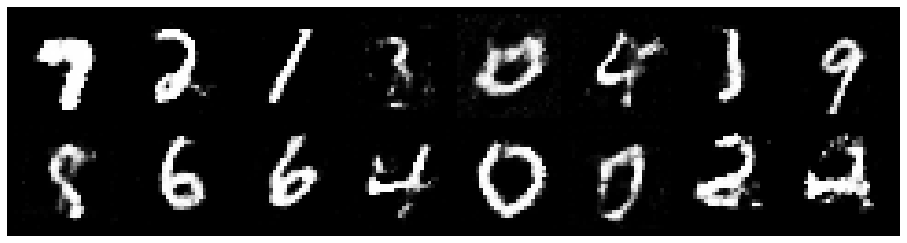

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.2017, Generator Loss: 0.8505
D(x): 0.6021, D(G(z)): 0.4469


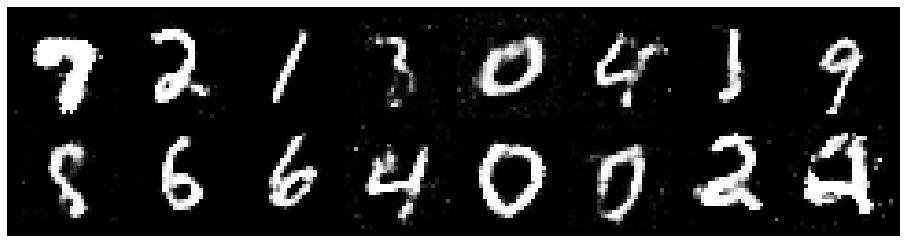

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.3022, Generator Loss: 0.8381
D(x): 0.5546, D(G(z)): 0.4700


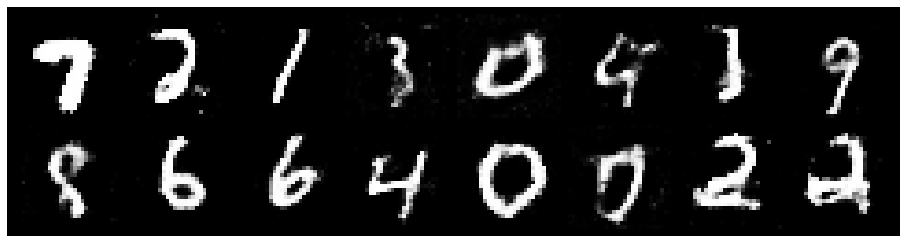

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.2696, Generator Loss: 1.0270
D(x): 0.5683, D(G(z)): 0.4276


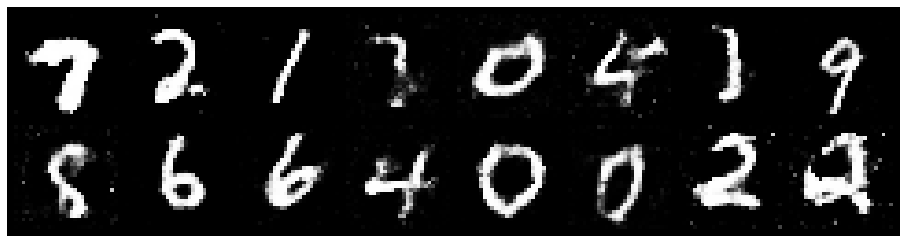

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.3037, Generator Loss: 0.8071
D(x): 0.5346, D(G(z)): 0.4606


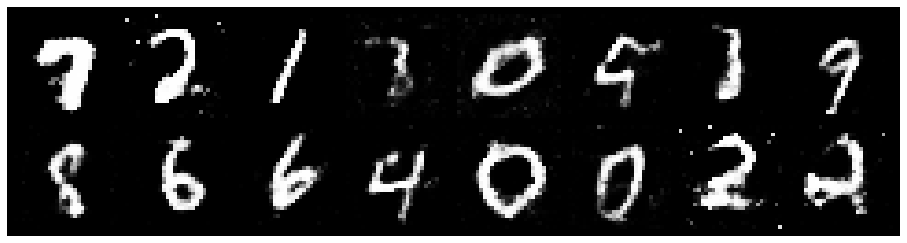

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.3317, Generator Loss: 0.7910
D(x): 0.5533, D(G(z)): 0.4905


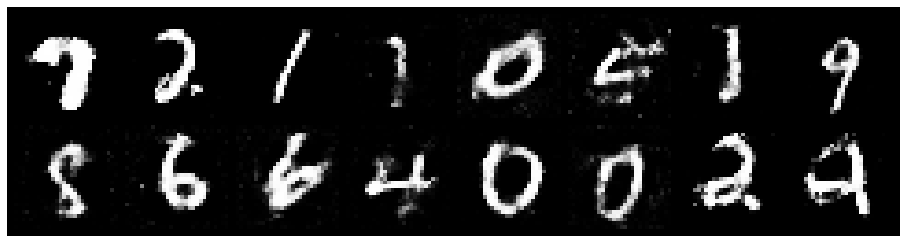

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.2095, Generator Loss: 0.8740
D(x): 0.5677, D(G(z)): 0.4407


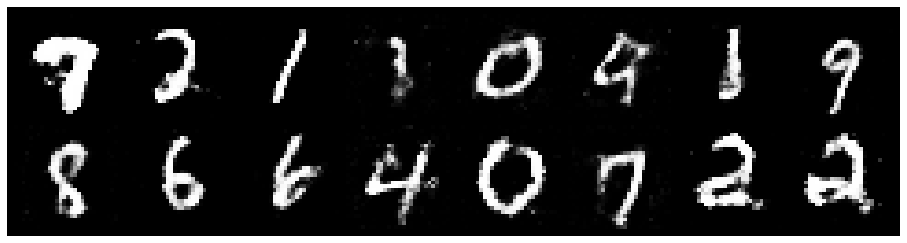

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.1769, Generator Loss: 0.8608
D(x): 0.6135, D(G(z)): 0.4603


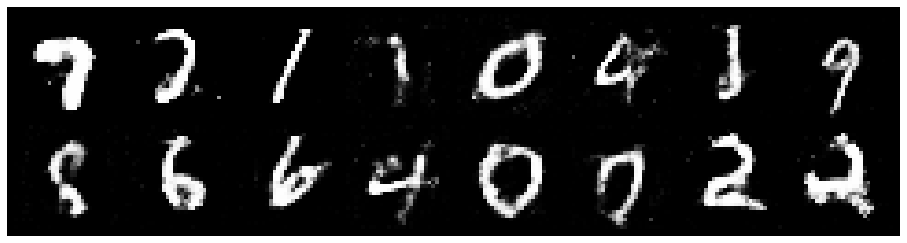

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.2759, Generator Loss: 0.8551
D(x): 0.5294, D(G(z)): 0.4298


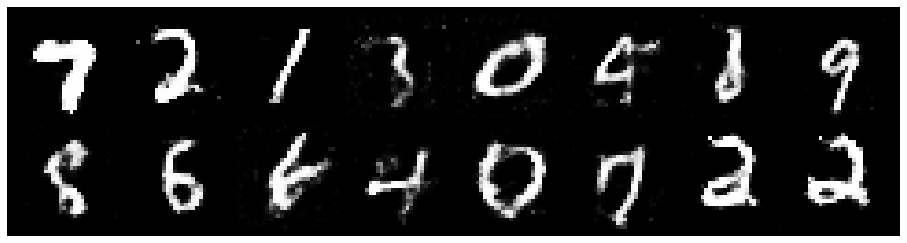

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.3666, Generator Loss: 0.8284
D(x): 0.5333, D(G(z)): 0.4768


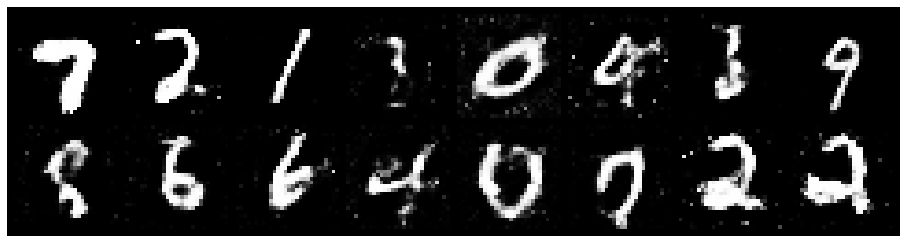

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.2644, Generator Loss: 0.7663
D(x): 0.5626, D(G(z)): 0.4597


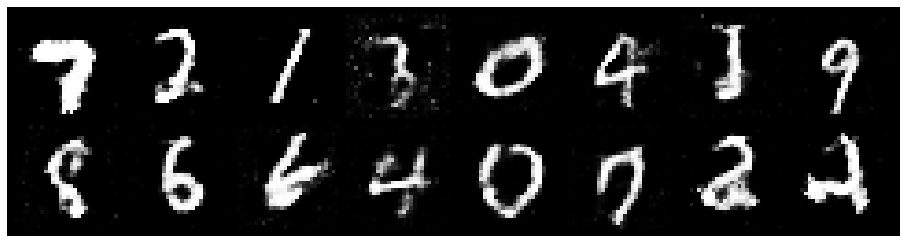

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.2799, Generator Loss: 0.7421
D(x): 0.5674, D(G(z)): 0.4755


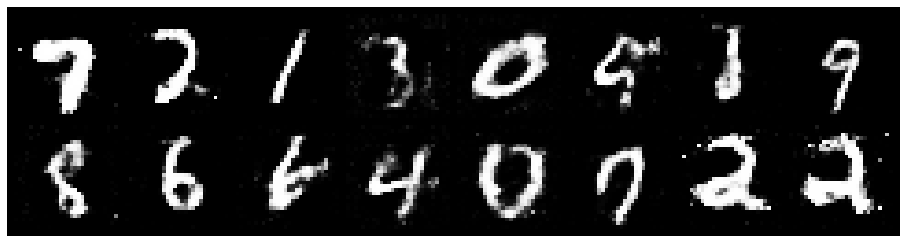

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.2888, Generator Loss: 0.8553
D(x): 0.5324, D(G(z)): 0.4430


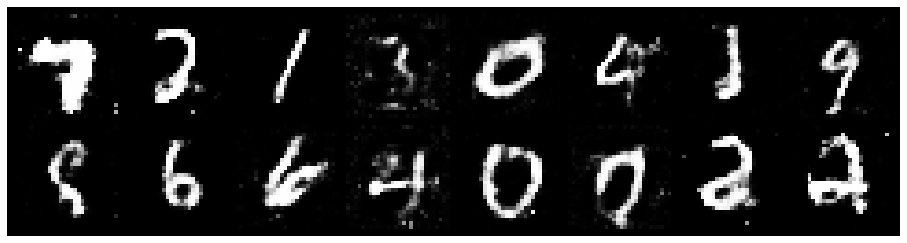

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.2514, Generator Loss: 0.7871
D(x): 0.5614, D(G(z)): 0.4311


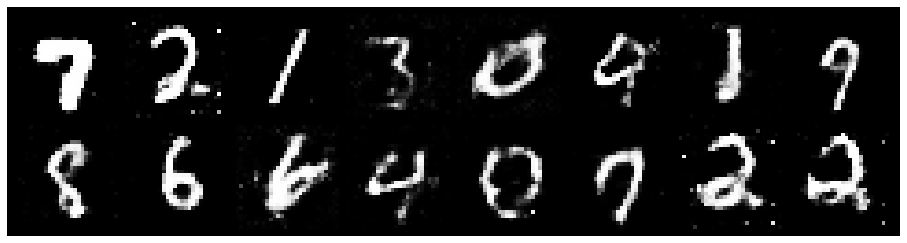

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.3389, Generator Loss: 0.8468
D(x): 0.5480, D(G(z)): 0.4633


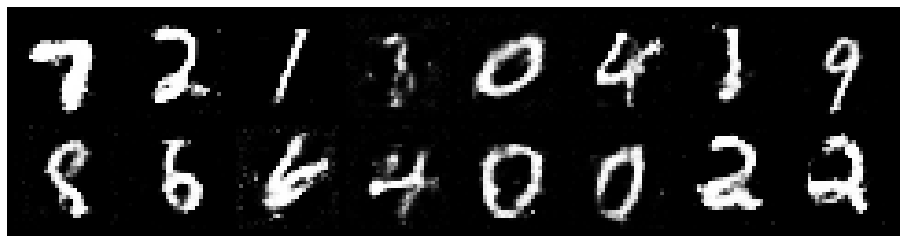

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.3181, Generator Loss: 0.8999
D(x): 0.5961, D(G(z)): 0.4993


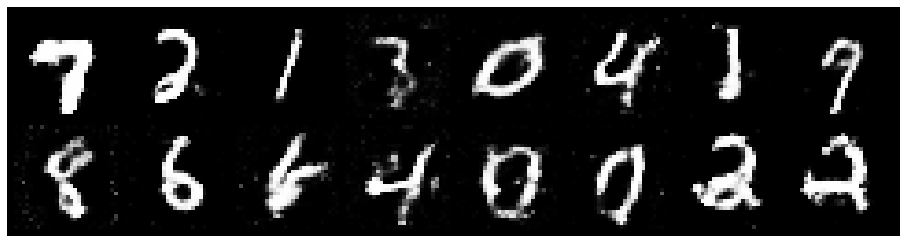

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.4447, Generator Loss: 0.8395
D(x): 0.5460, D(G(z)): 0.4978


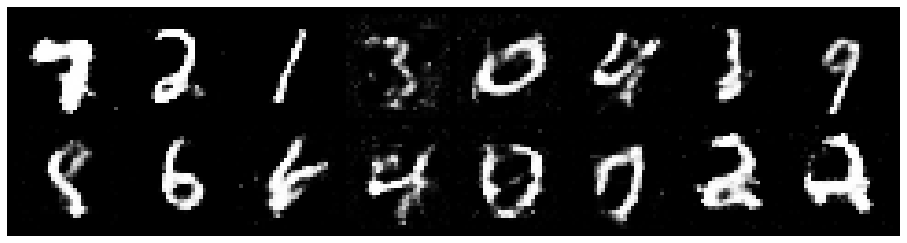

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.3757, Generator Loss: 0.9805
D(x): 0.5452, D(G(z)): 0.4837


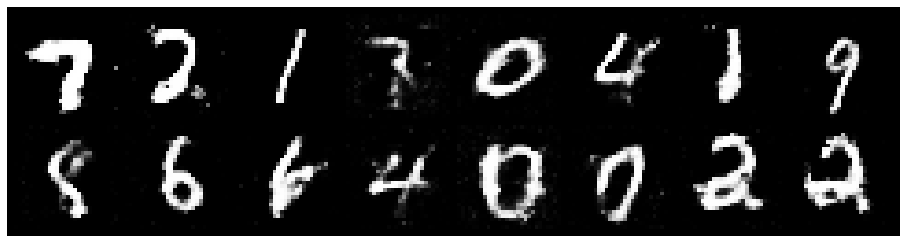

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.4184, Generator Loss: 0.7232
D(x): 0.5620, D(G(z)): 0.4956


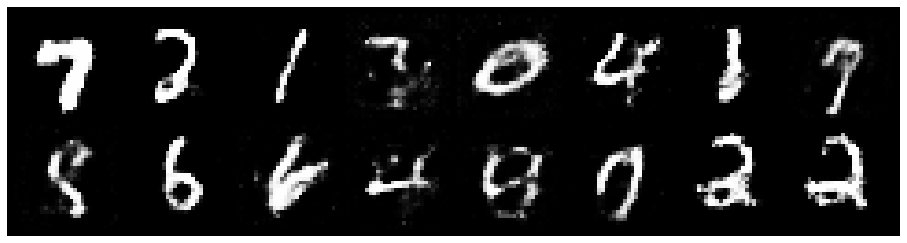

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.3014, Generator Loss: 0.7916
D(x): 0.5635, D(G(z)): 0.4785


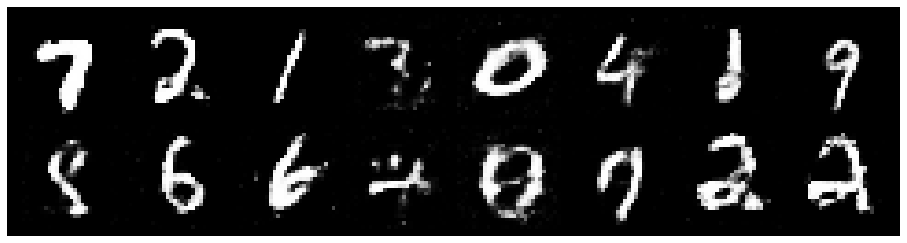

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.3055, Generator Loss: 0.9635
D(x): 0.5152, D(G(z)): 0.4190


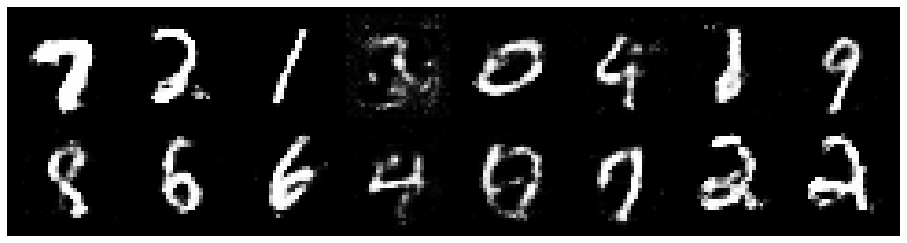

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.2148, Generator Loss: 1.0540
D(x): 0.5667, D(G(z)): 0.4210


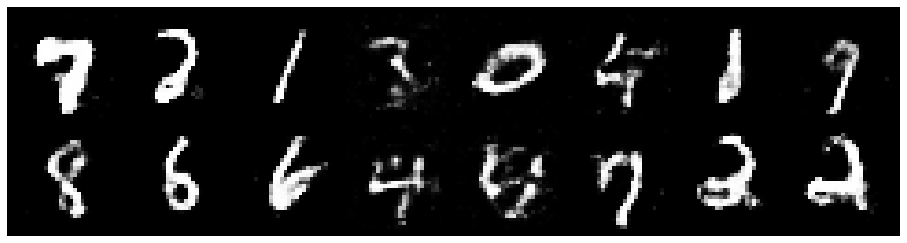

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.2416, Generator Loss: 0.9870
D(x): 0.5314, D(G(z)): 0.4101


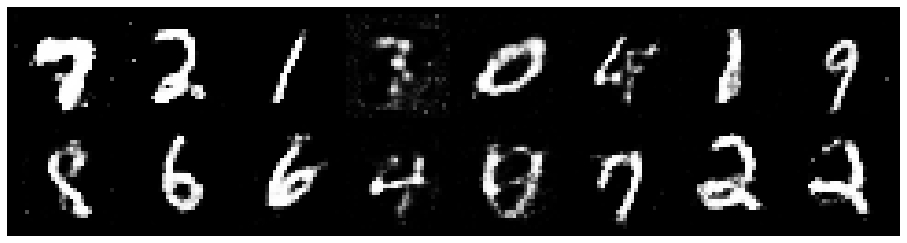

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.2500, Generator Loss: 0.8565
D(x): 0.5490, D(G(z)): 0.4370


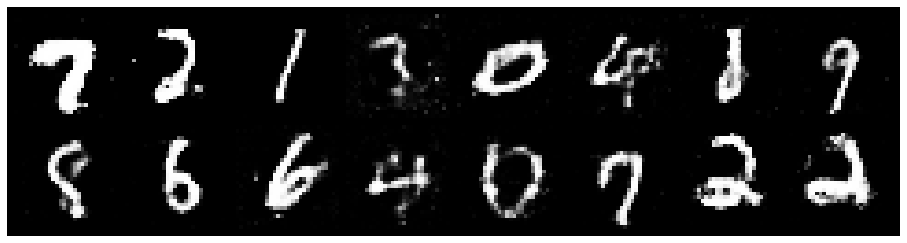

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.1544, Generator Loss: 1.0440
D(x): 0.5868, D(G(z)): 0.3956


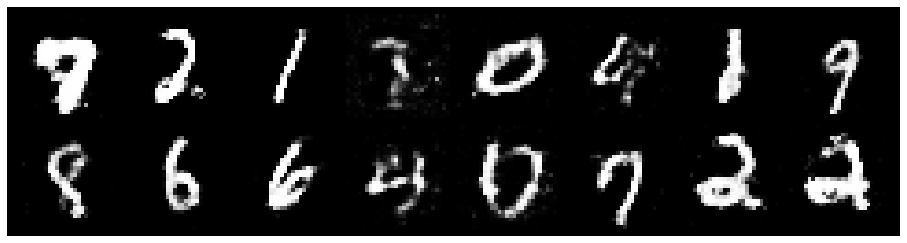

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.3749, Generator Loss: 0.9002
D(x): 0.5682, D(G(z)): 0.4847


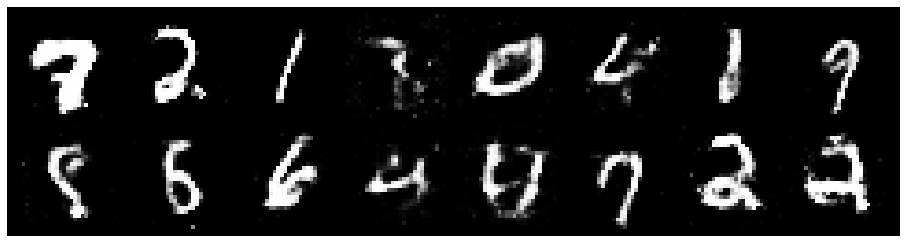

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.2673, Generator Loss: 0.9929
D(x): 0.5504, D(G(z)): 0.4418


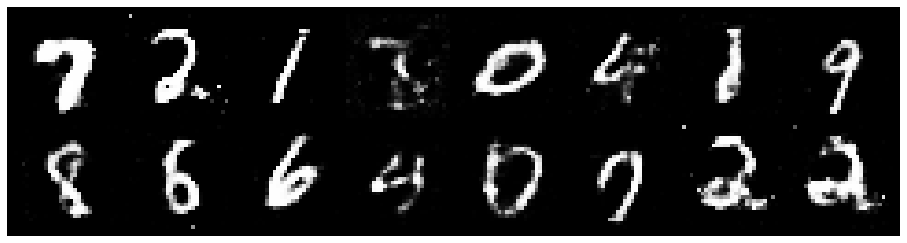

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.2861, Generator Loss: 1.0184
D(x): 0.4662, D(G(z)): 0.3634


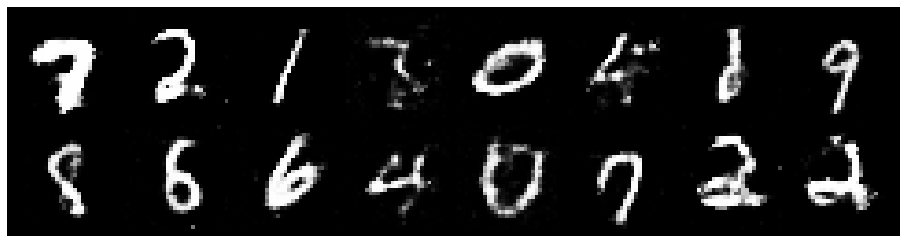

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.1629, Generator Loss: 0.9100
D(x): 0.5710, D(G(z)): 0.3994


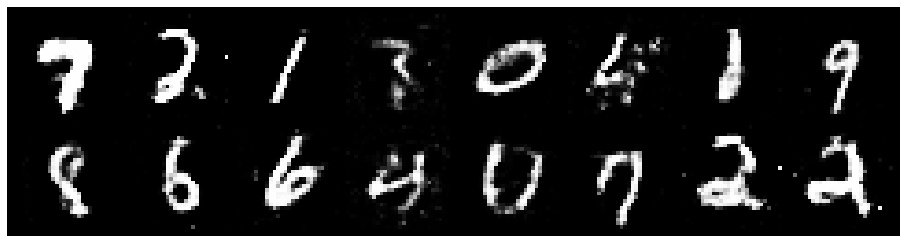

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.2390, Generator Loss: 0.8151
D(x): 0.5701, D(G(z)): 0.4448


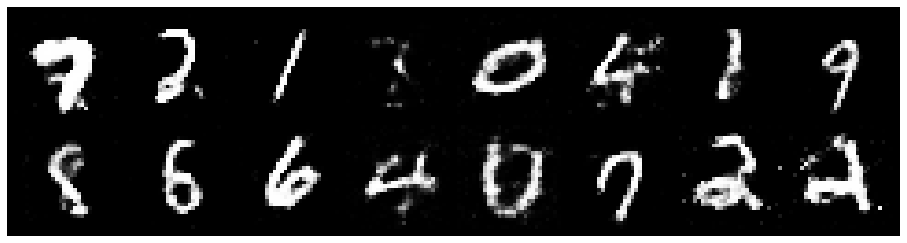

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.2537, Generator Loss: 1.0000
D(x): 0.5601, D(G(z)): 0.4438


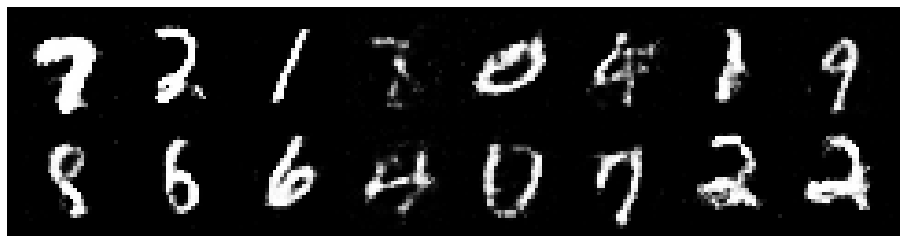

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.1932, Generator Loss: 1.0368
D(x): 0.5734, D(G(z)): 0.4179


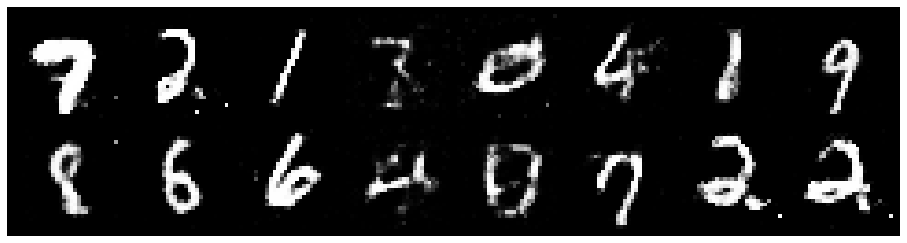

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.2555, Generator Loss: 0.8447
D(x): 0.5458, D(G(z)): 0.4415


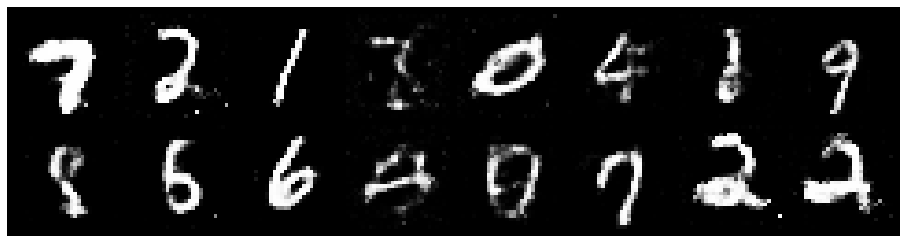

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.1657, Generator Loss: 1.1598
D(x): 0.5719, D(G(z)): 0.3957


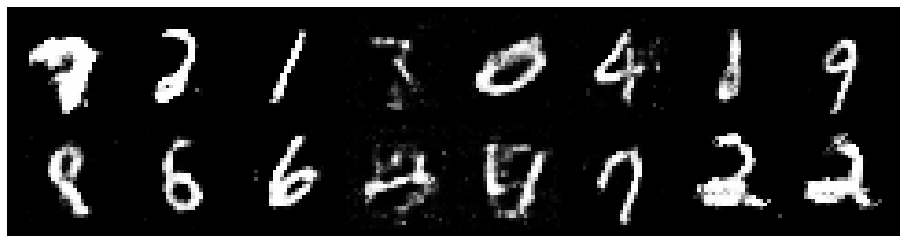

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.2652, Generator Loss: 0.8870
D(x): 0.5712, D(G(z)): 0.4420


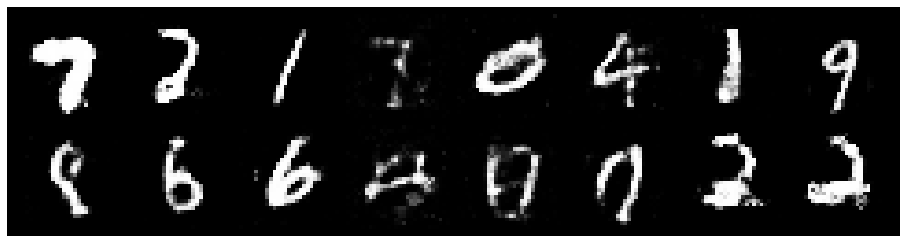

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.3059, Generator Loss: 0.9268
D(x): 0.5847, D(G(z)): 0.4764


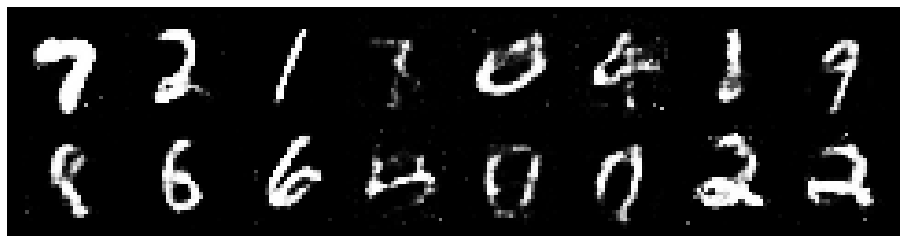

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.1473, Generator Loss: 1.0983
D(x): 0.5881, D(G(z)): 0.3814


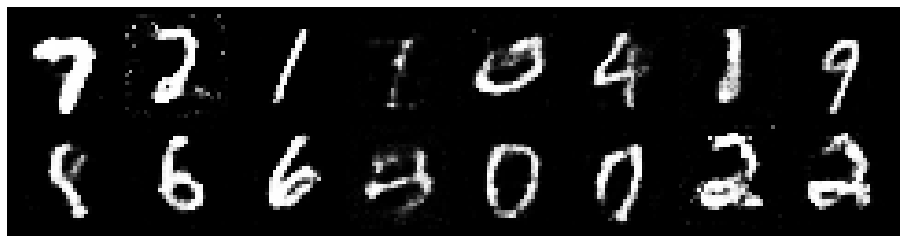

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.2195, Generator Loss: 0.9131
D(x): 0.5500, D(G(z)): 0.4189


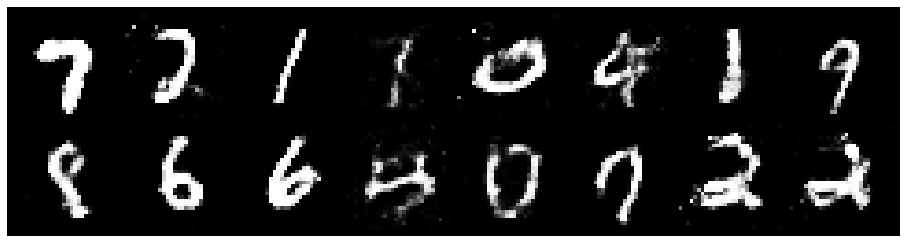

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2222, Generator Loss: 0.8372
D(x): 0.5681, D(G(z)): 0.4384


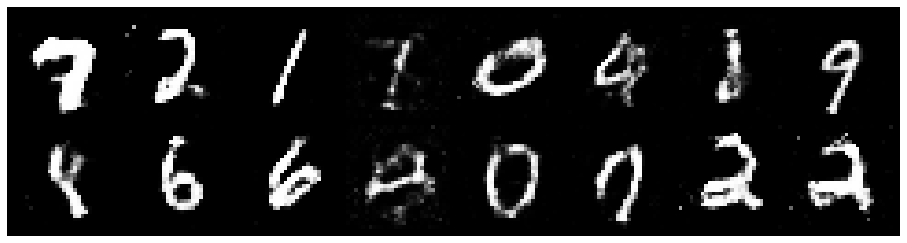

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.3517, Generator Loss: 0.8652
D(x): 0.5561, D(G(z)): 0.4874


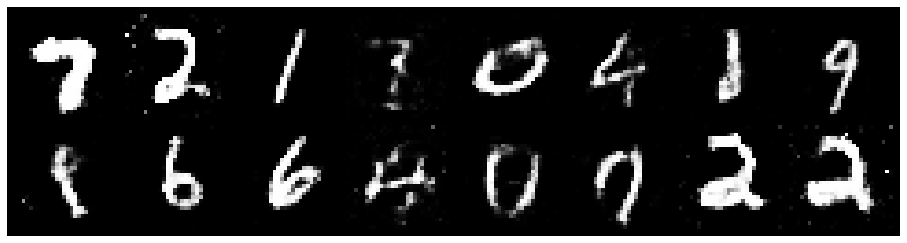

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.3834, Generator Loss: 0.8342
D(x): 0.5486, D(G(z)): 0.4932


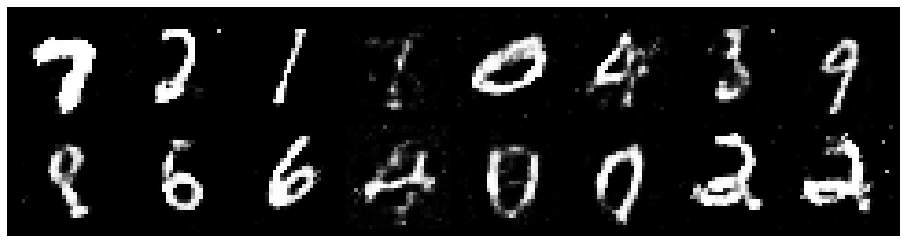

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.2718, Generator Loss: 0.9019
D(x): 0.5488, D(G(z)): 0.4316


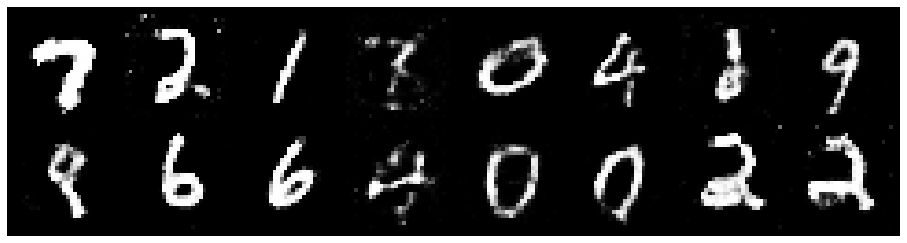

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.2918, Generator Loss: 0.7669
D(x): 0.5406, D(G(z)): 0.4601


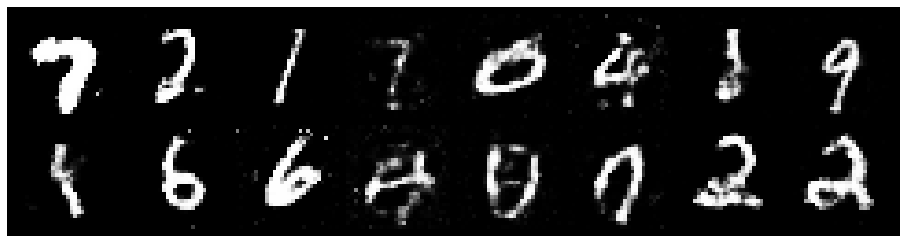

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.2982, Generator Loss: 0.8212
D(x): 0.5283, D(G(z)): 0.4477


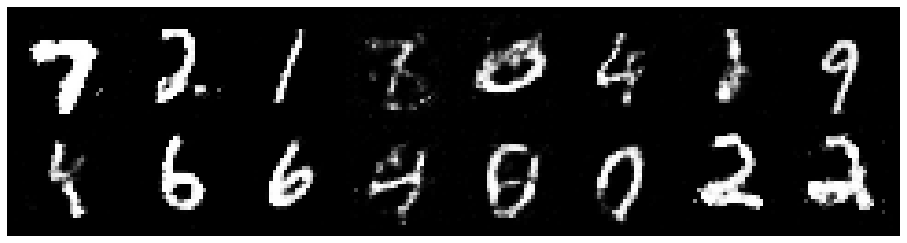

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.3046, Generator Loss: 0.9908
D(x): 0.5247, D(G(z)): 0.4291


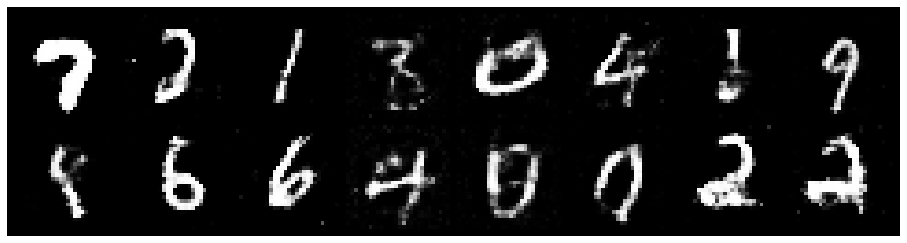

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.3088, Generator Loss: 0.8112
D(x): 0.5662, D(G(z)): 0.4832


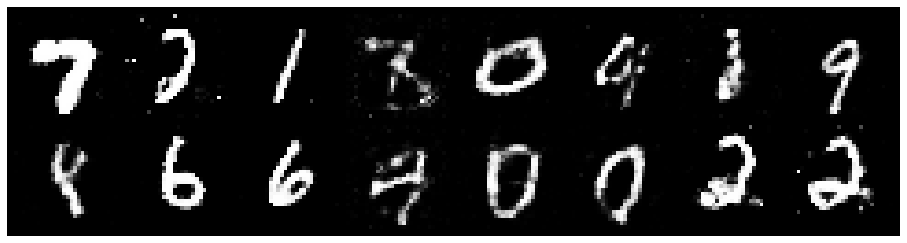

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.3066, Generator Loss: 0.8522
D(x): 0.5639, D(G(z)): 0.4680


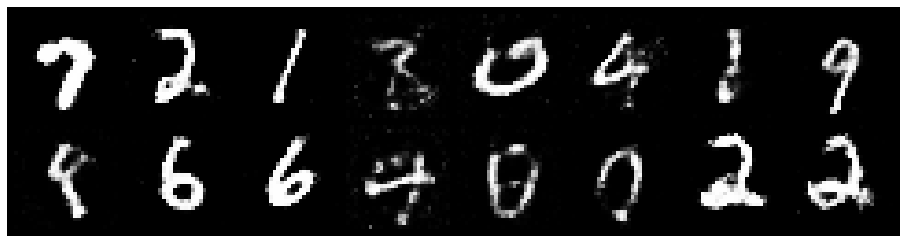

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.3574, Generator Loss: 0.7686
D(x): 0.5217, D(G(z)): 0.4572


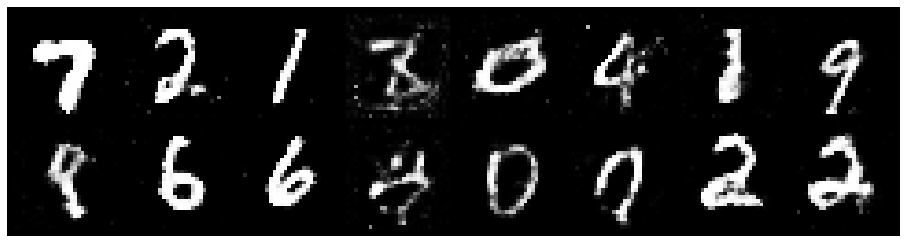

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.2720, Generator Loss: 0.9295
D(x): 0.5271, D(G(z)): 0.4103


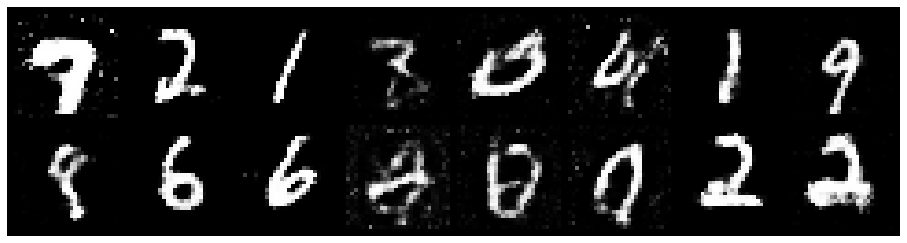

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.3044, Generator Loss: 0.8992
D(x): 0.5440, D(G(z)): 0.4616


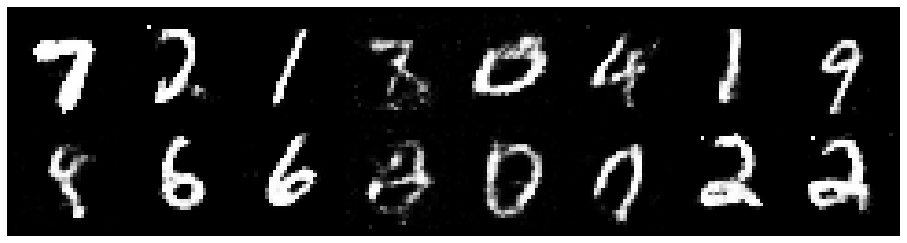

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.1677, Generator Loss: 0.8954
D(x): 0.5686, D(G(z)): 0.4080


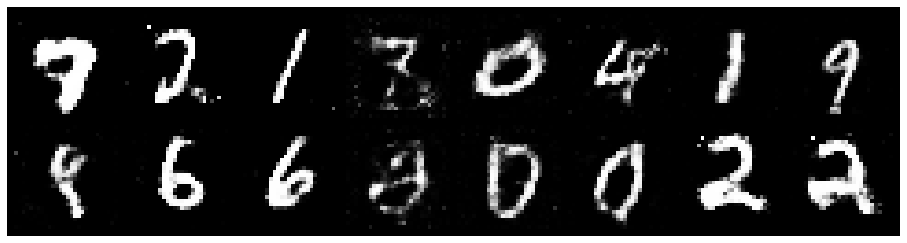

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.2596, Generator Loss: 0.8704
D(x): 0.5636, D(G(z)): 0.4595


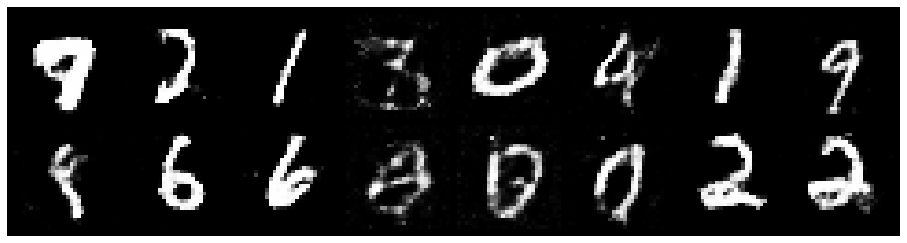

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.2775, Generator Loss: 0.8280
D(x): 0.5583, D(G(z)): 0.4554


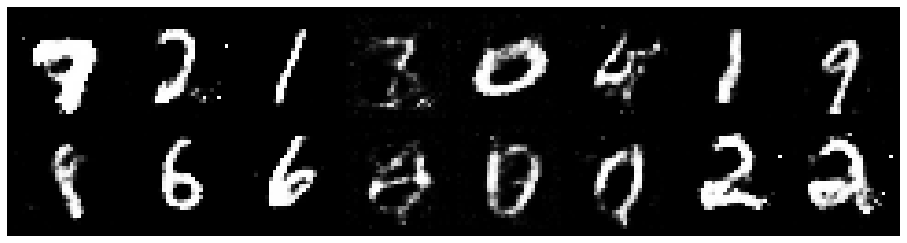

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.2688, Generator Loss: 0.8753
D(x): 0.5579, D(G(z)): 0.4540


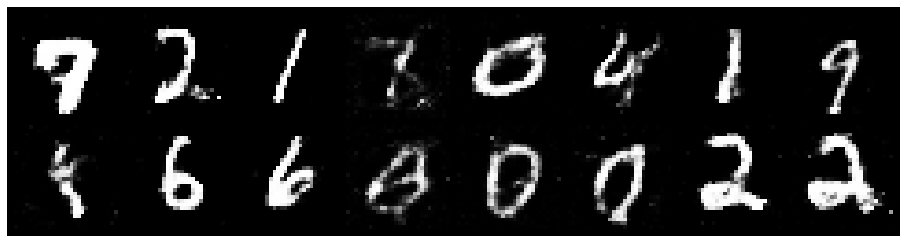

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.3160, Generator Loss: 0.8543
D(x): 0.5533, D(G(z)): 0.4643


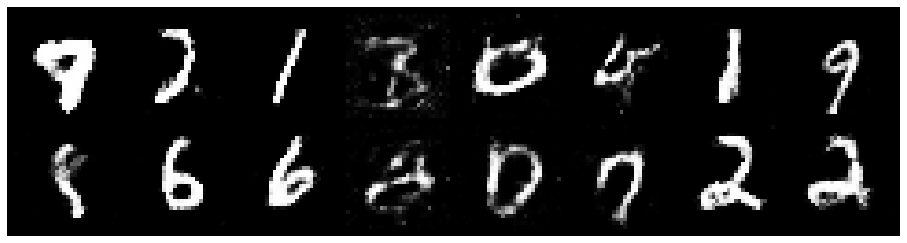

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.3201, Generator Loss: 0.8448
D(x): 0.5337, D(G(z)): 0.4756


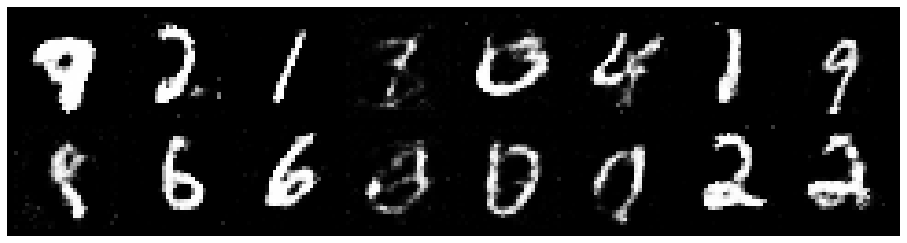

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.3142, Generator Loss: 0.8800
D(x): 0.5583, D(G(z)): 0.4771


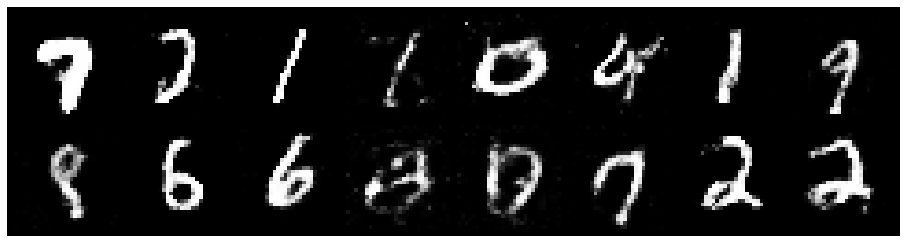

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.2738, Generator Loss: 0.8492
D(x): 0.5249, D(G(z)): 0.4260


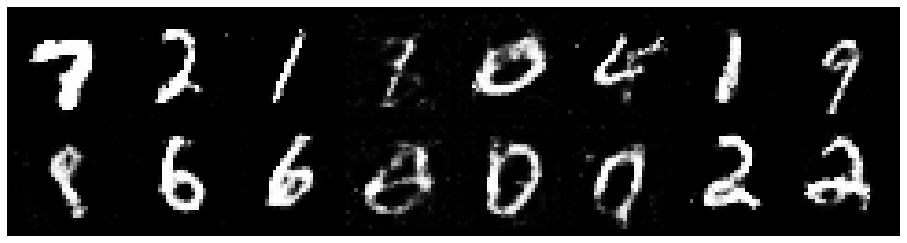

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.1780, Generator Loss: 0.8941
D(x): 0.5786, D(G(z)): 0.4273


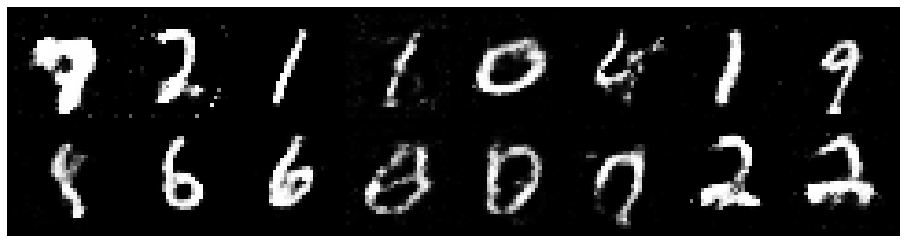

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.3091, Generator Loss: 0.9198
D(x): 0.5527, D(G(z)): 0.4633


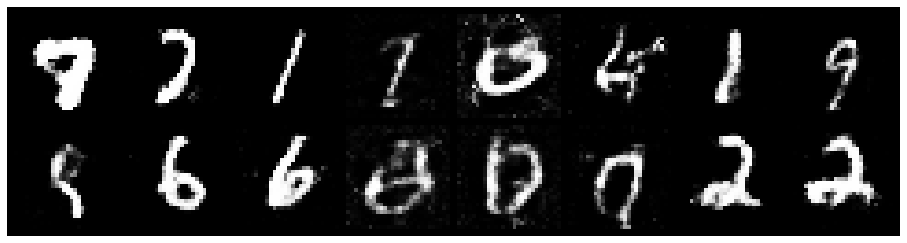

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.2082, Generator Loss: 0.9629
D(x): 0.5739, D(G(z)): 0.4302


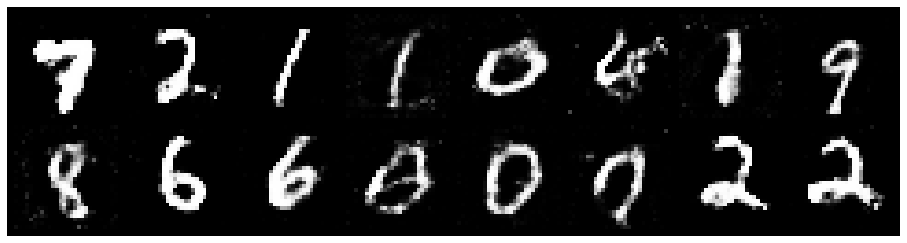

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.3160, Generator Loss: 0.8431
D(x): 0.5167, D(G(z)): 0.4365


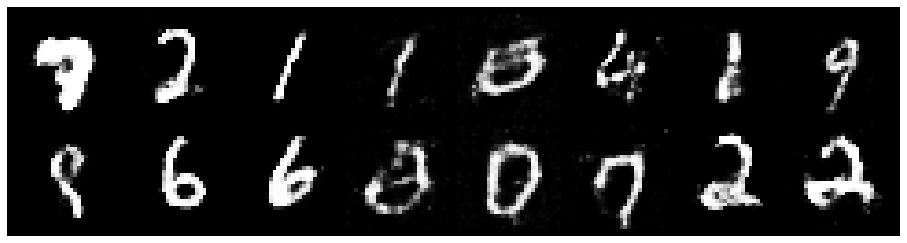

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.2612, Generator Loss: 0.9400
D(x): 0.5739, D(G(z)): 0.4356


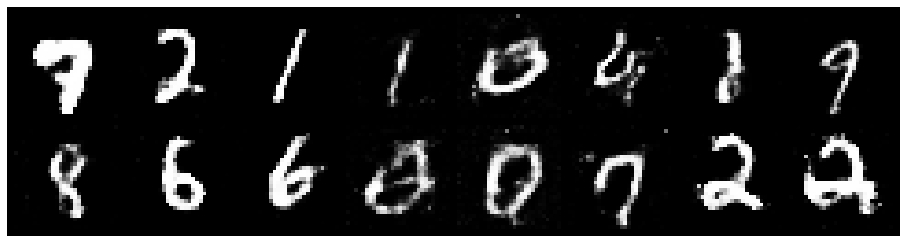

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.2346, Generator Loss: 1.0439
D(x): 0.5777, D(G(z)): 0.4298


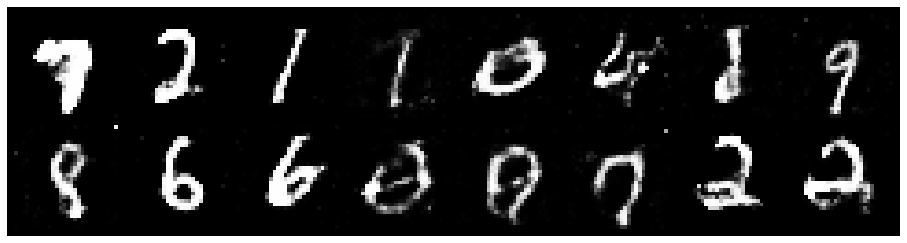

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.1745, Generator Loss: 1.0694
D(x): 0.5737, D(G(z)): 0.4104


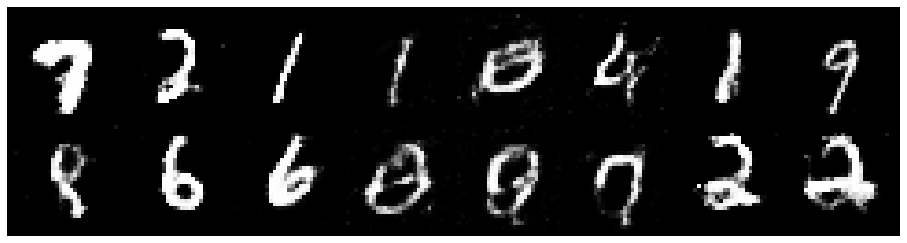

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.1924, Generator Loss: 0.8698
D(x): 0.5924, D(G(z)): 0.4336


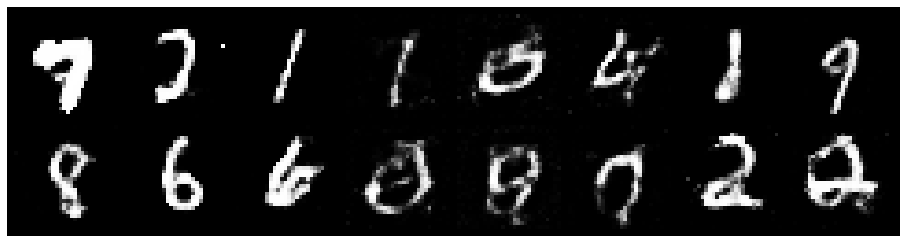

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.2295, Generator Loss: 0.8720
D(x): 0.5771, D(G(z)): 0.4470


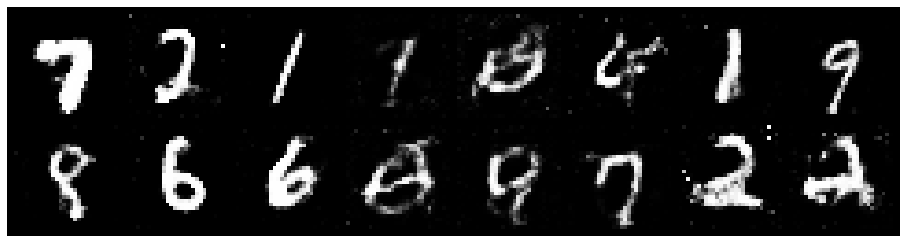

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.3747, Generator Loss: 0.8969
D(x): 0.4992, D(G(z)): 0.4505


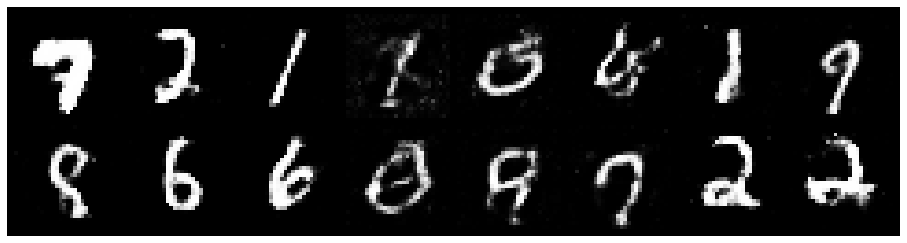

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.2566, Generator Loss: 0.9290
D(x): 0.5563, D(G(z)): 0.4322


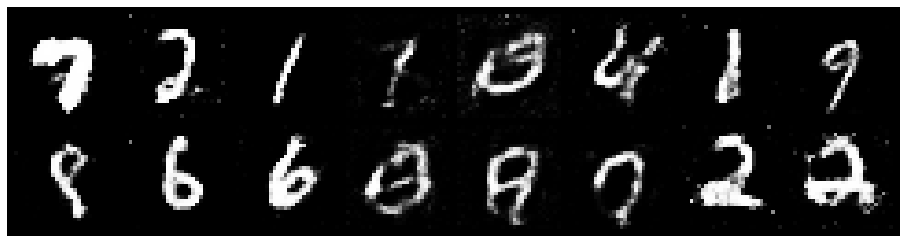

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.1830, Generator Loss: 0.9103
D(x): 0.5882, D(G(z)): 0.4346


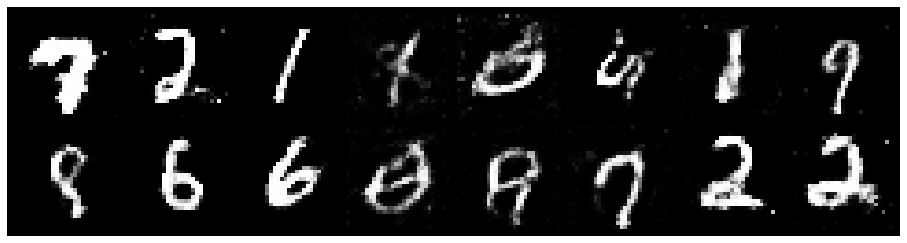

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.3068, Generator Loss: 0.9470
D(x): 0.5504, D(G(z)): 0.4661


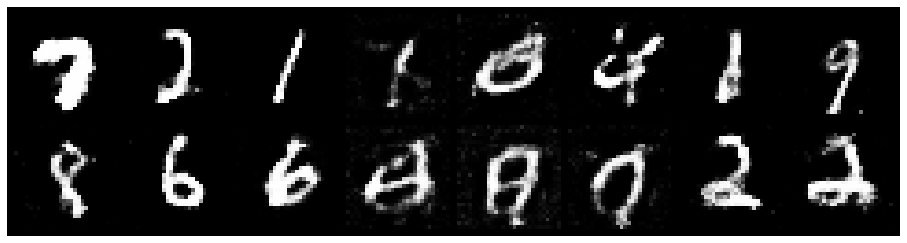

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2913, Generator Loss: 0.8187
D(x): 0.5637, D(G(z)): 0.4549


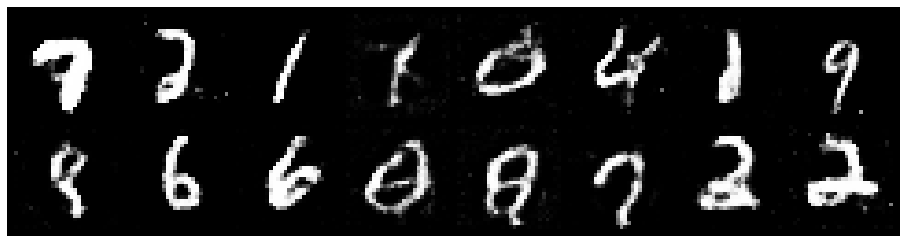

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.1478, Generator Loss: 0.8693
D(x): 0.6109, D(G(z)): 0.4395


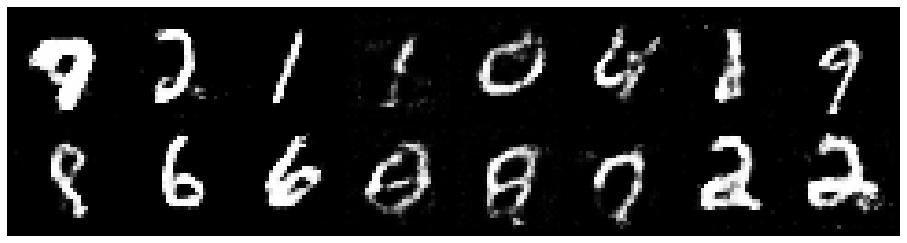

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.3706, Generator Loss: 0.9447
D(x): 0.5273, D(G(z)): 0.4538


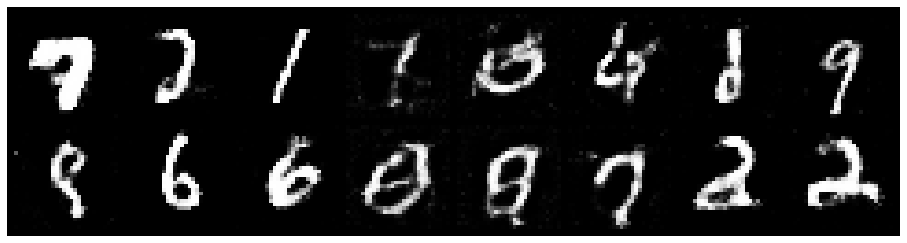

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.3203, Generator Loss: 0.8631
D(x): 0.5141, D(G(z)): 0.4358


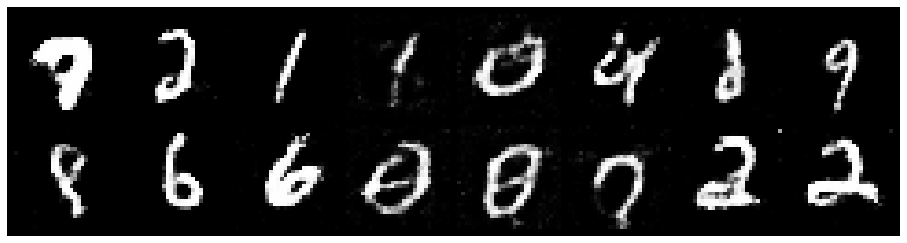

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.1918, Generator Loss: 0.9180
D(x): 0.5593, D(G(z)): 0.3972


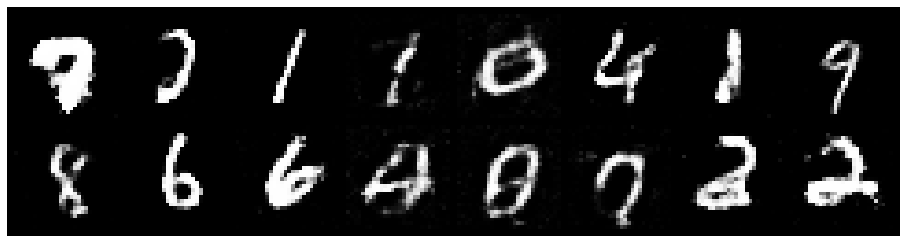

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.2339, Generator Loss: 0.9629
D(x): 0.5766, D(G(z)): 0.4278


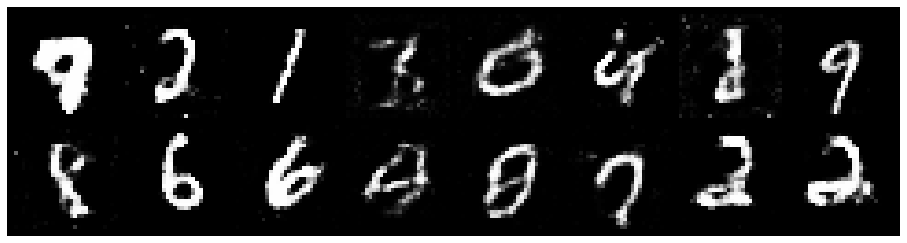

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2231, Generator Loss: 0.9447
D(x): 0.5699, D(G(z)): 0.4336


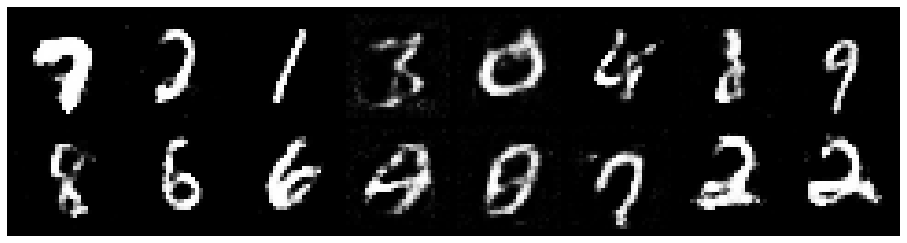

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.1561, Generator Loss: 0.9371
D(x): 0.5667, D(G(z)): 0.3975


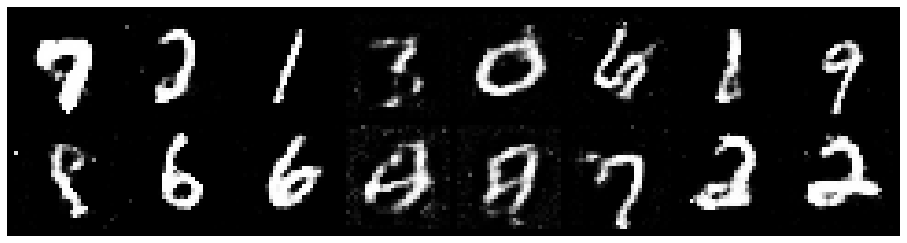

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.1486, Generator Loss: 0.9900
D(x): 0.6144, D(G(z)): 0.4357


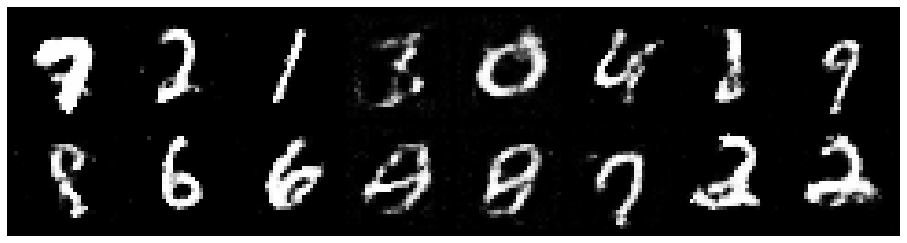

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.2759, Generator Loss: 0.8273
D(x): 0.5594, D(G(z)): 0.4672


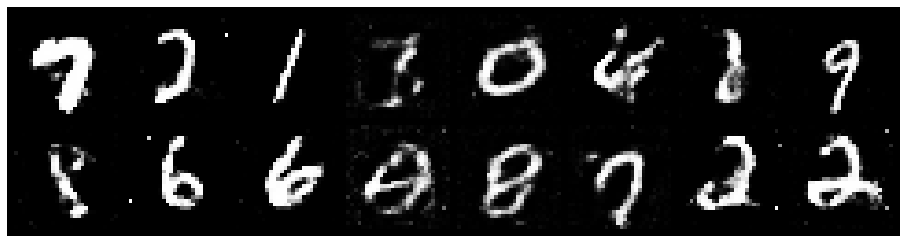

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.3095, Generator Loss: 0.8200
D(x): 0.5317, D(G(z)): 0.4557


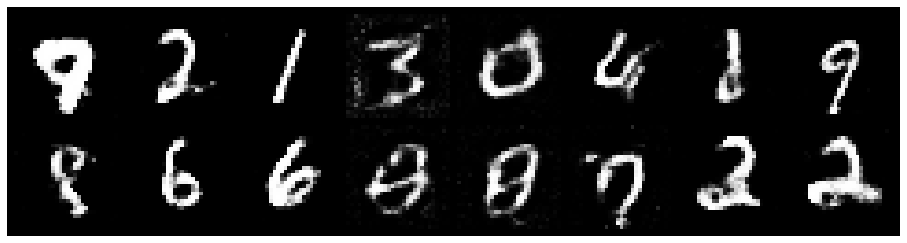

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.2752, Generator Loss: 1.0228
D(x): 0.5367, D(G(z)): 0.4349


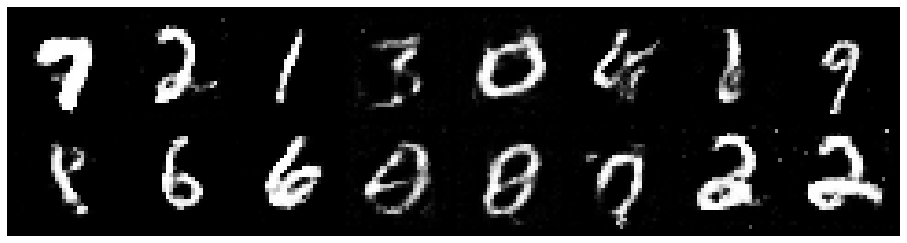

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.2601, Generator Loss: 0.9082
D(x): 0.5091, D(G(z)): 0.3986


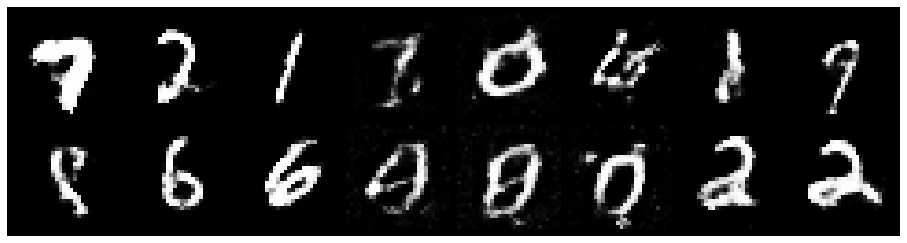

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.3667, Generator Loss: 0.8045
D(x): 0.5325, D(G(z)): 0.4733


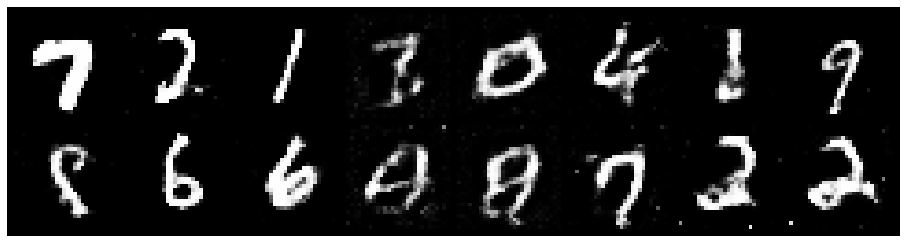

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.2882, Generator Loss: 0.8633
D(x): 0.5984, D(G(z)): 0.4785


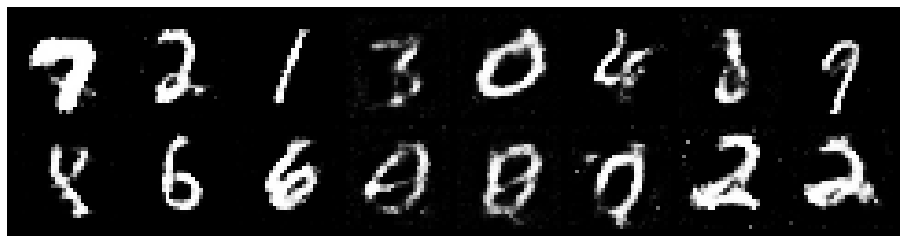

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.4093, Generator Loss: 0.7745
D(x): 0.5323, D(G(z)): 0.5042


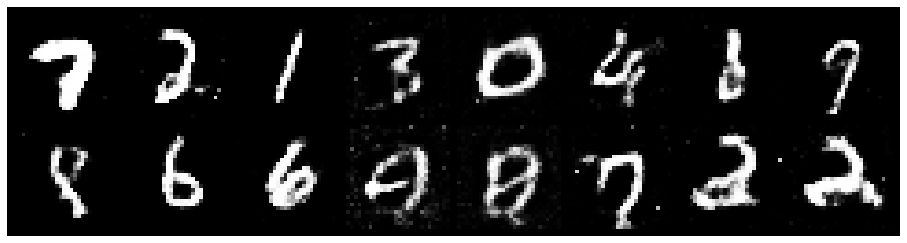

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.3185, Generator Loss: 0.9591
D(x): 0.5331, D(G(z)): 0.4364


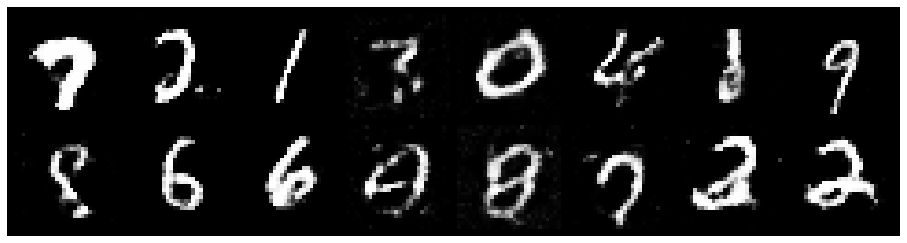

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.2339, Generator Loss: 0.9572
D(x): 0.5350, D(G(z)): 0.4147


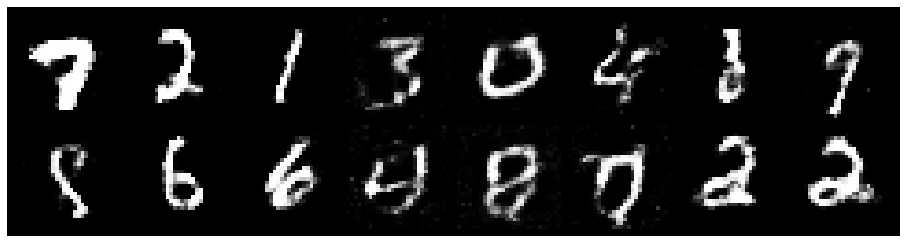

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.2047, Generator Loss: 0.8736
D(x): 0.5524, D(G(z)): 0.4283


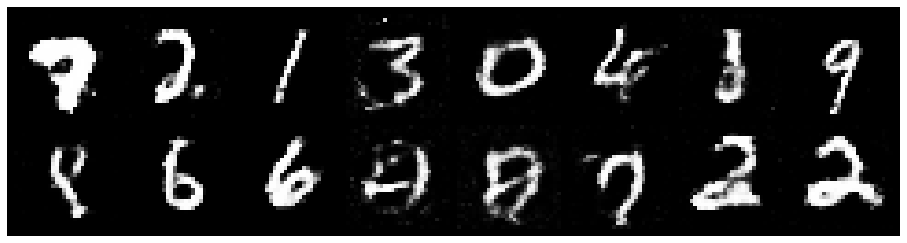

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.2245, Generator Loss: 0.9679
D(x): 0.5590, D(G(z)): 0.4353


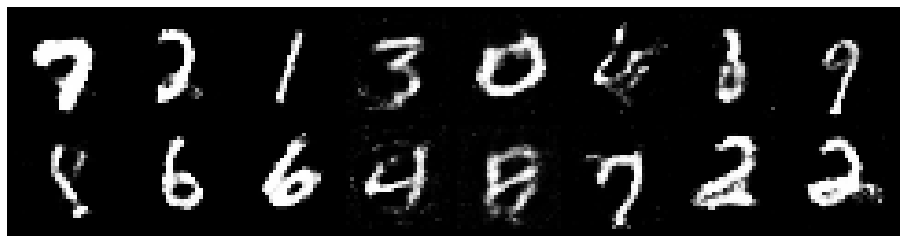

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.2328, Generator Loss: 0.9290
D(x): 0.5562, D(G(z)): 0.4328


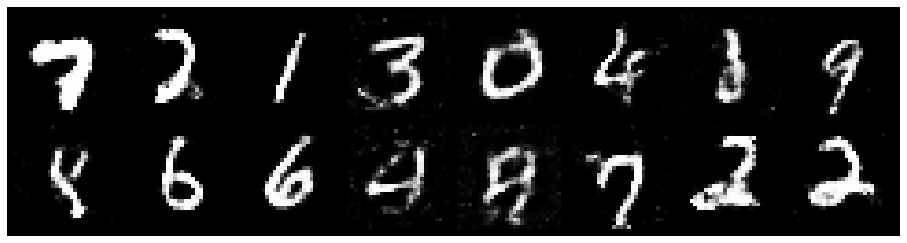

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.3220, Generator Loss: 0.9398
D(x): 0.5619, D(G(z)): 0.4735


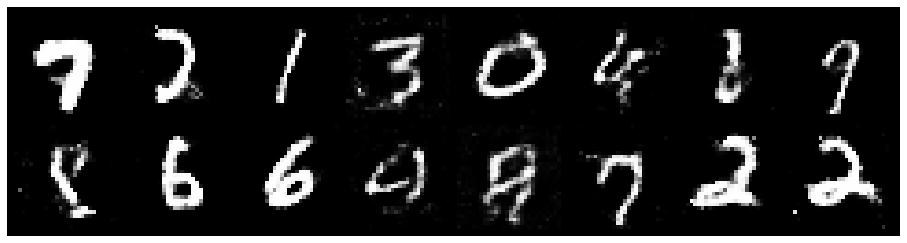

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.2453, Generator Loss: 0.7929
D(x): 0.5545, D(G(z)): 0.4270


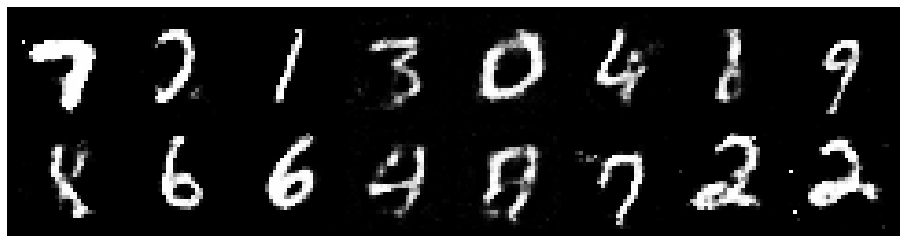

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.2223, Generator Loss: 0.9905
D(x): 0.5384, D(G(z)): 0.4164


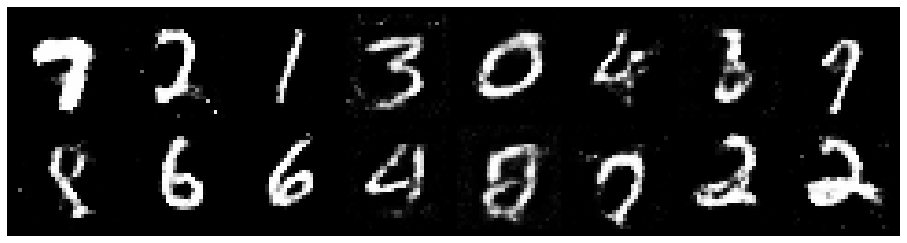

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.1714, Generator Loss: 0.8813
D(x): 0.5734, D(G(z)): 0.4284


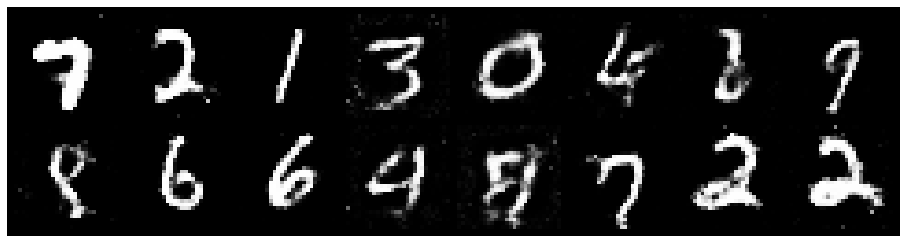

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.1805, Generator Loss: 0.9659
D(x): 0.5908, D(G(z)): 0.4412


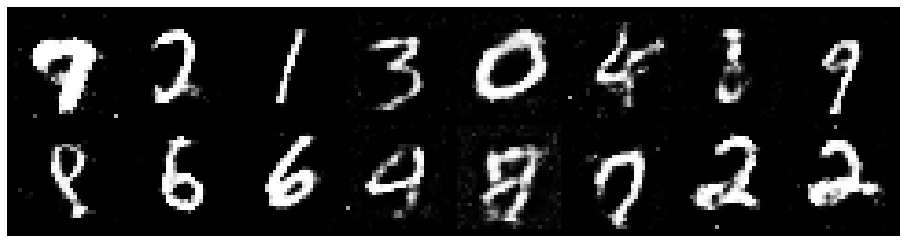

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.3748, Generator Loss: 0.8245
D(x): 0.5057, D(G(z)): 0.4418


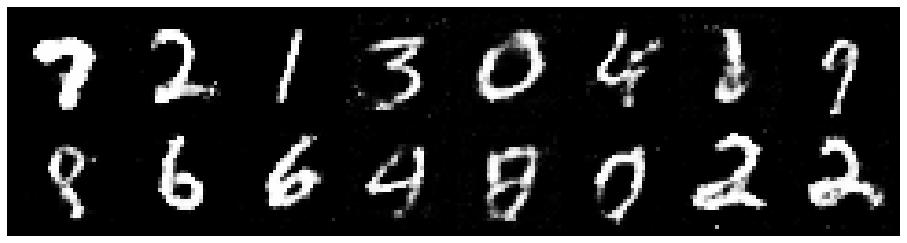

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.2416, Generator Loss: 1.0451
D(x): 0.5971, D(G(z)): 0.4346


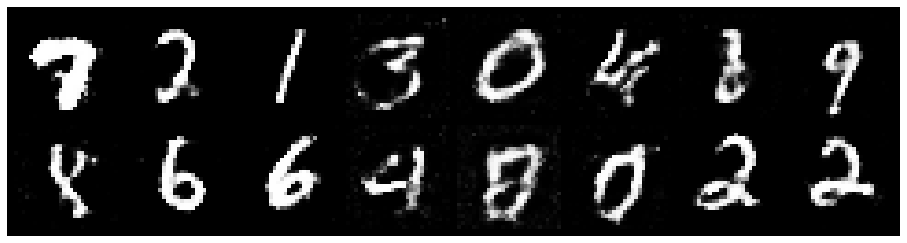

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.2971, Generator Loss: 0.9087
D(x): 0.6015, D(G(z)): 0.4906


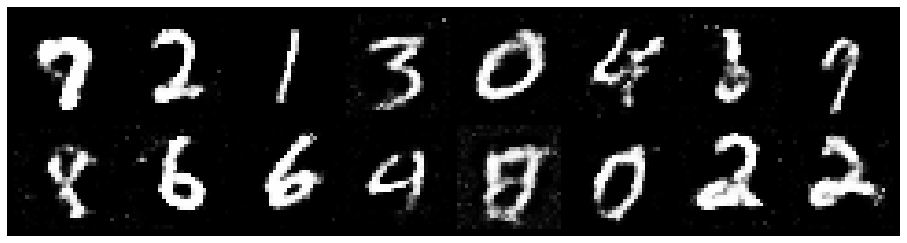

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.4074, Generator Loss: 0.8214
D(x): 0.5437, D(G(z)): 0.4811


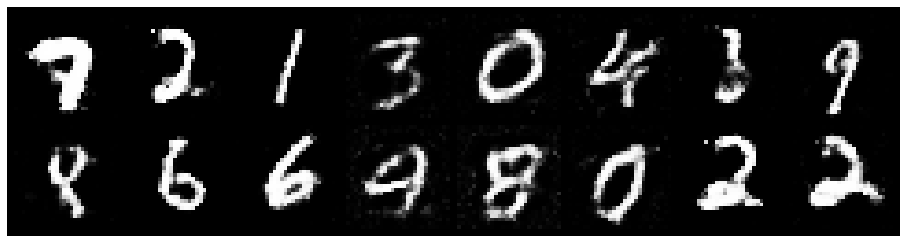

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.3496, Generator Loss: 0.7508
D(x): 0.5821, D(G(z)): 0.5092


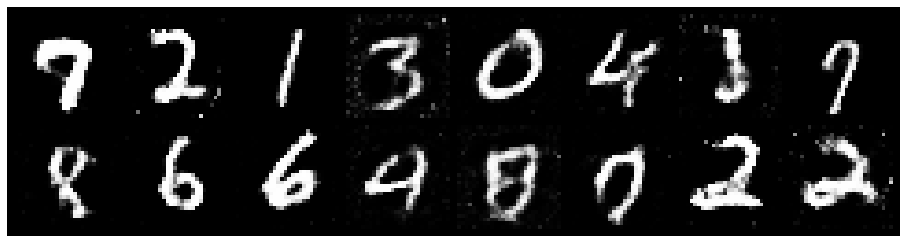

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.3691, Generator Loss: 0.7650
D(x): 0.5384, D(G(z)): 0.4882


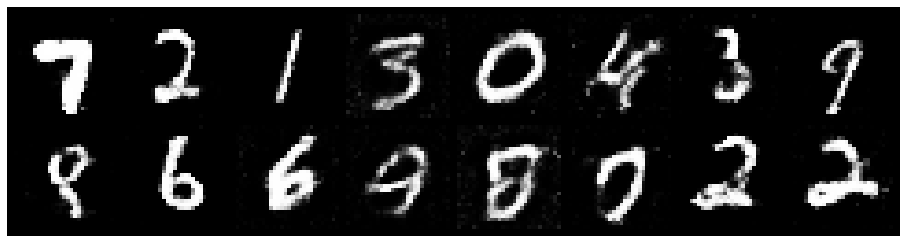

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.3200, Generator Loss: 0.7771
D(x): 0.5302, D(G(z)): 0.4736


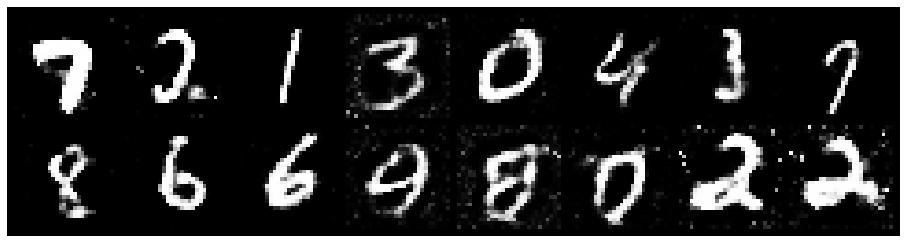

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.3707, Generator Loss: 0.7434
D(x): 0.5251, D(G(z)): 0.4754


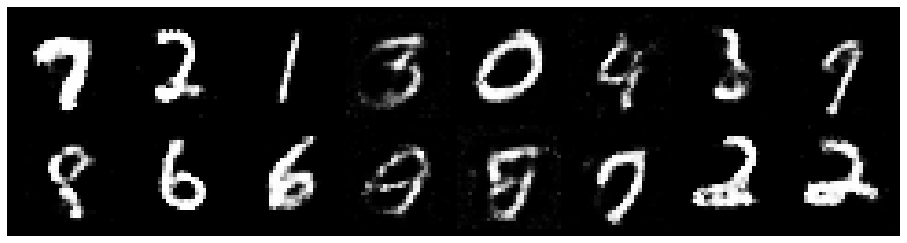

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.3432, Generator Loss: 0.7759
D(x): 0.5261, D(G(z)): 0.4702


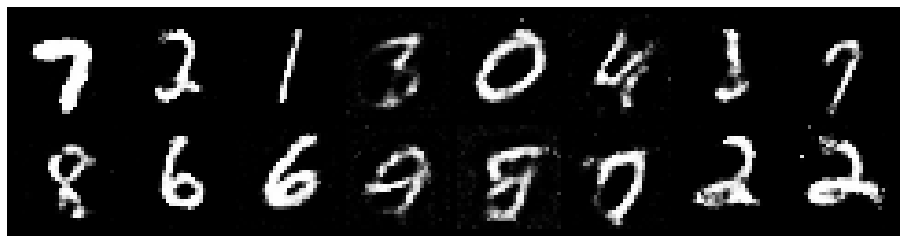

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.3371, Generator Loss: 0.8083
D(x): 0.5468, D(G(z)): 0.4666


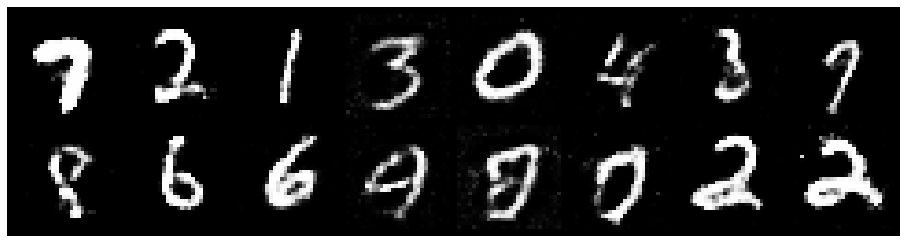

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.2280, Generator Loss: 0.8336
D(x): 0.5636, D(G(z)): 0.4334


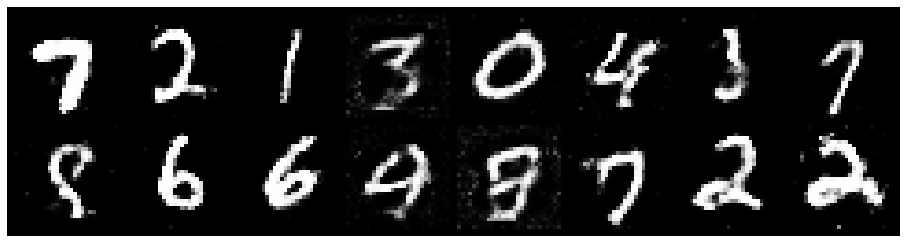

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.2700, Generator Loss: 1.0628
D(x): 0.5546, D(G(z)): 0.4411


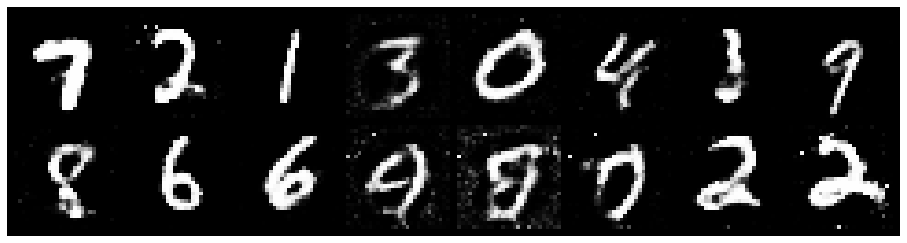

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.2435, Generator Loss: 0.9795
D(x): 0.5770, D(G(z)): 0.4419


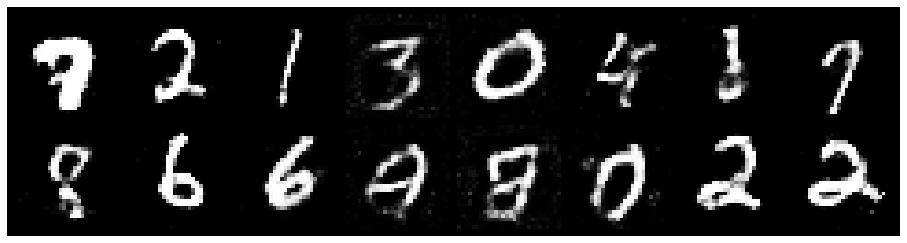

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.2461, Generator Loss: 0.9924
D(x): 0.5540, D(G(z)): 0.4166


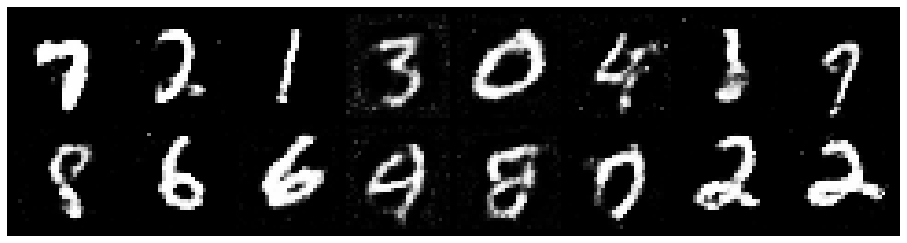

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.2968, Generator Loss: 0.9406
D(x): 0.5889, D(G(z)): 0.4623


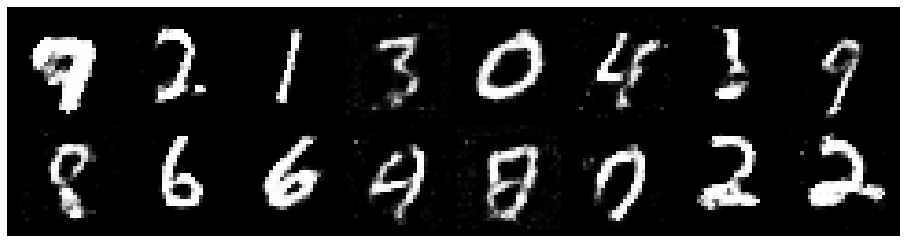

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.2151, Generator Loss: 1.0321
D(x): 0.5829, D(G(z)): 0.4420


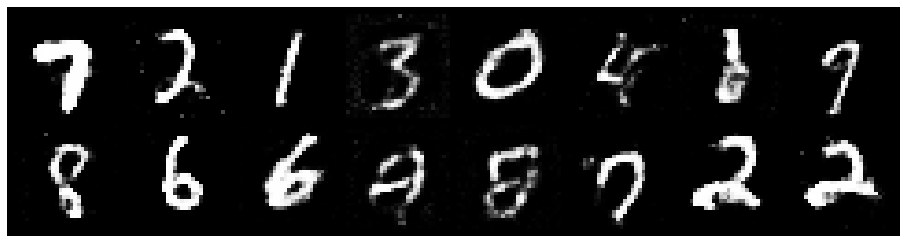

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.1577, Generator Loss: 0.9273
D(x): 0.5887, D(G(z)): 0.4092


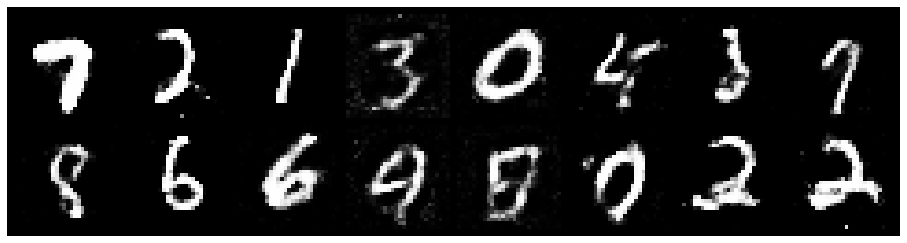

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.3085, Generator Loss: 0.8283
D(x): 0.5844, D(G(z)): 0.4739


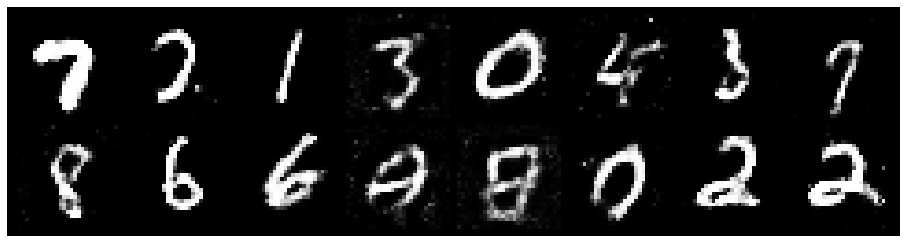

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.3267, Generator Loss: 1.0037
D(x): 0.5353, D(G(z)): 0.4565


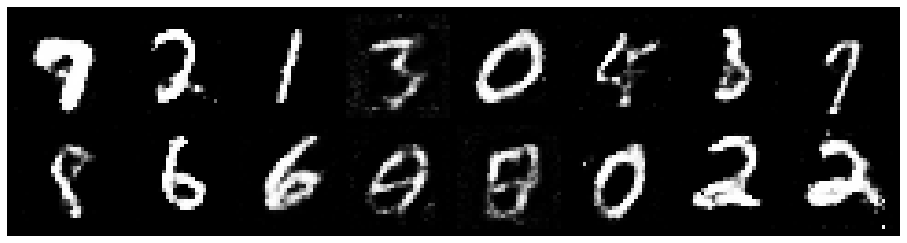

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.3902, Generator Loss: 0.9329
D(x): 0.5536, D(G(z)): 0.4752


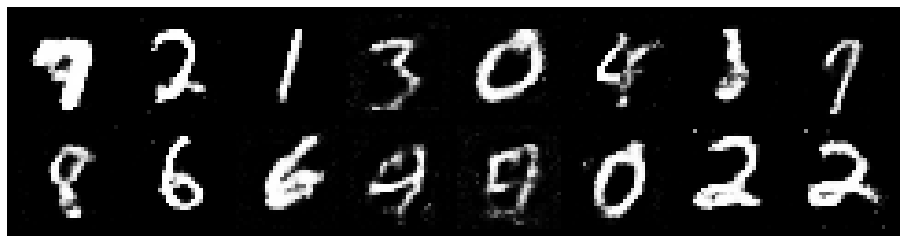

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.3012, Generator Loss: 0.9944
D(x): 0.5112, D(G(z)): 0.3995


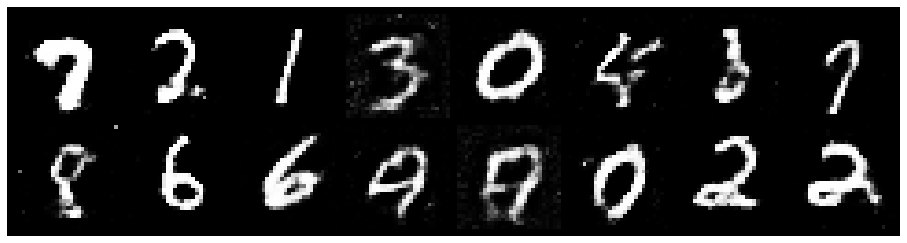

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.2290, Generator Loss: 0.9084
D(x): 0.6063, D(G(z)): 0.4708


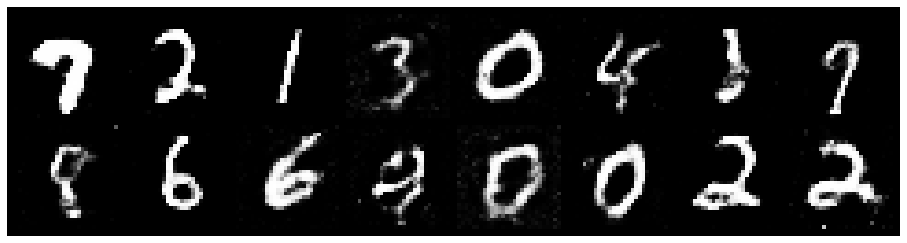

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.2252, Generator Loss: 0.9409
D(x): 0.5233, D(G(z)): 0.3954


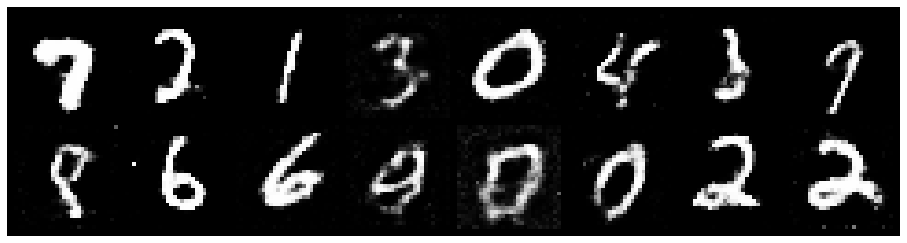

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.2241, Generator Loss: 0.9733
D(x): 0.5314, D(G(z)): 0.3785


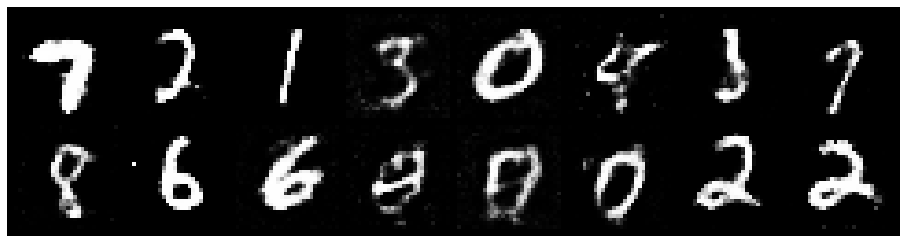

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.2562, Generator Loss: 0.8664
D(x): 0.5487, D(G(z)): 0.4375


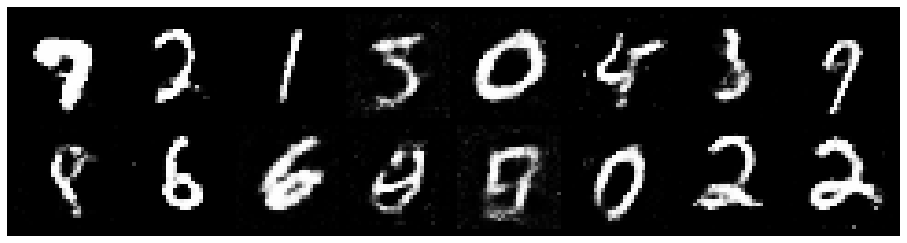

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.2362, Generator Loss: 0.8843
D(x): 0.5557, D(G(z)): 0.4323


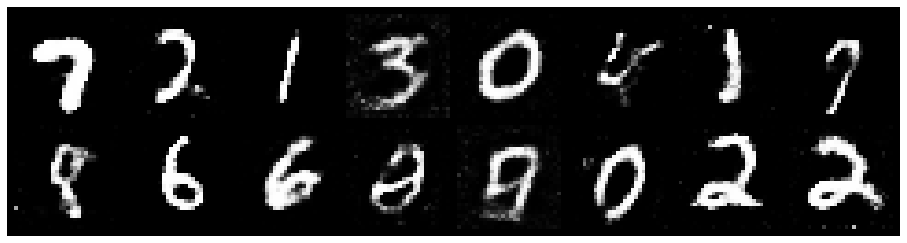

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.2599, Generator Loss: 0.9156
D(x): 0.5481, D(G(z)): 0.4422


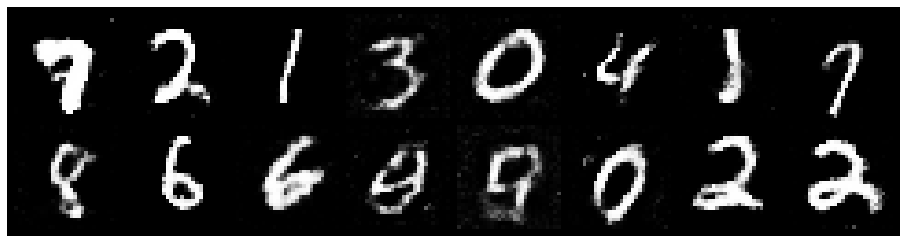

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.1866, Generator Loss: 1.0906
D(x): 0.5291, D(G(z)): 0.3747


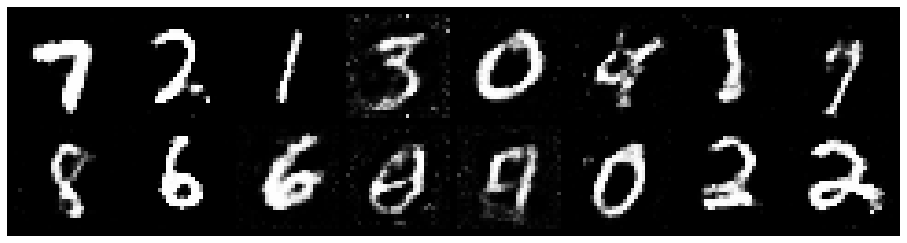

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.1651, Generator Loss: 0.8484
D(x): 0.5506, D(G(z)): 0.3993


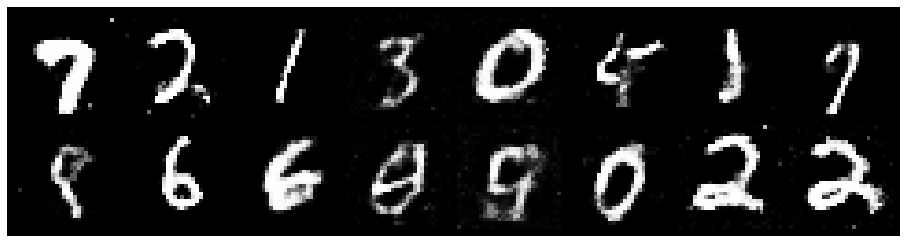

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.1889, Generator Loss: 0.9902
D(x): 0.5542, D(G(z)): 0.3983


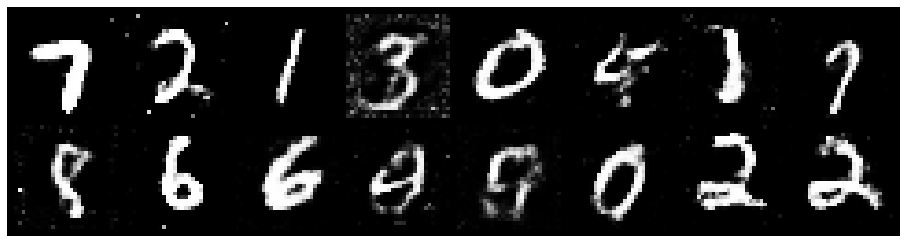

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.2056, Generator Loss: 0.8315
D(x): 0.5840, D(G(z)): 0.4375


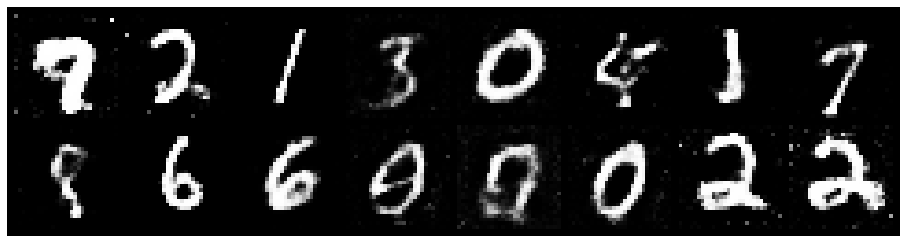

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.3012, Generator Loss: 0.9048
D(x): 0.5446, D(G(z)): 0.4558


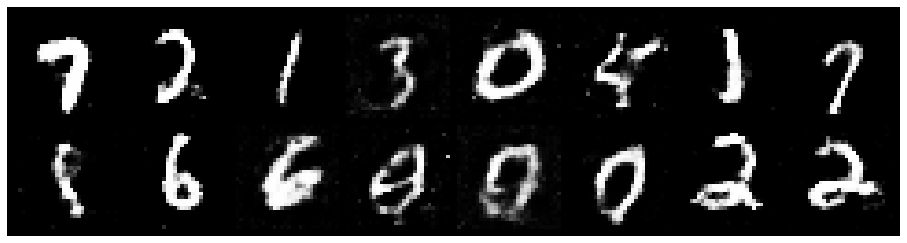

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.3070, Generator Loss: 0.8378
D(x): 0.5501, D(G(z)): 0.4731


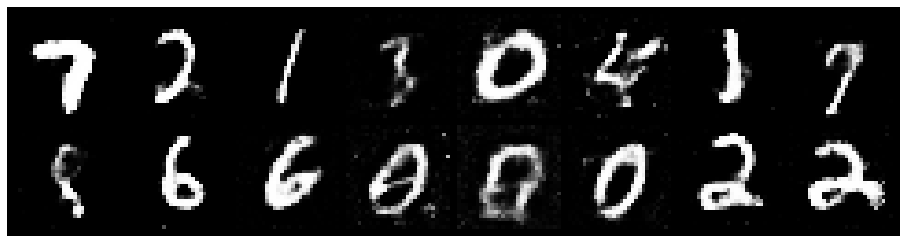

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.2595, Generator Loss: 0.8491
D(x): 0.5679, D(G(z)): 0.4617


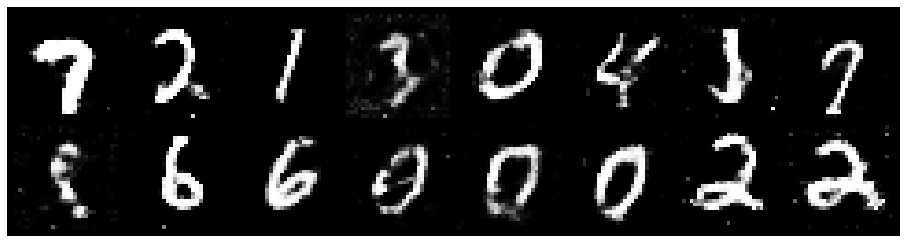

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.2457, Generator Loss: 0.8824
D(x): 0.5991, D(G(z)): 0.4628


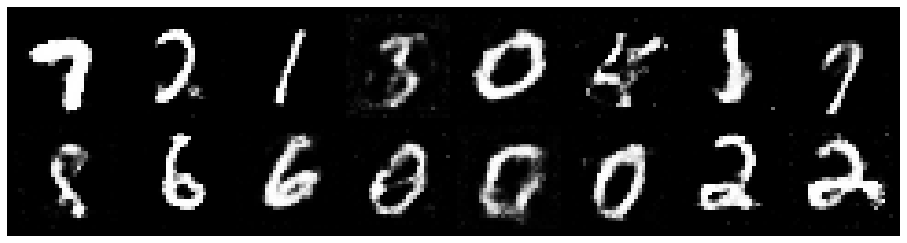

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.2207, Generator Loss: 0.8913
D(x): 0.5440, D(G(z)): 0.4108


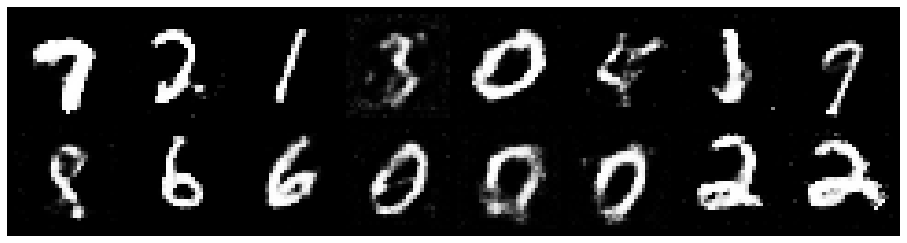

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.3176, Generator Loss: 0.8506
D(x): 0.5318, D(G(z)): 0.4495


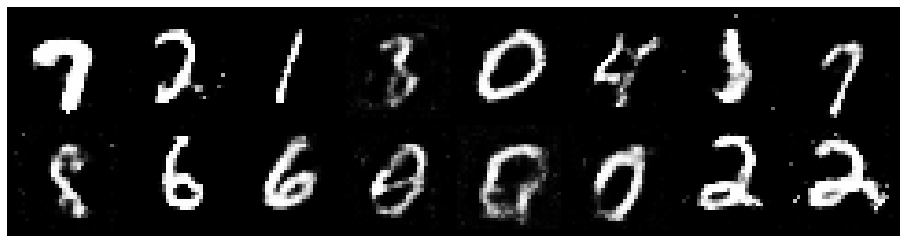

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.3665, Generator Loss: 0.7992
D(x): 0.5428, D(G(z)): 0.4784


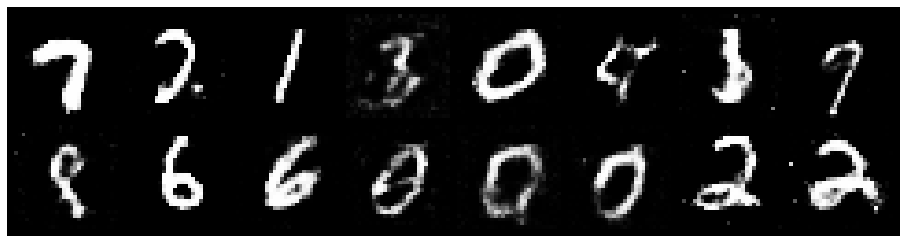

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.3954, Generator Loss: 0.8136
D(x): 0.5107, D(G(z)): 0.4721


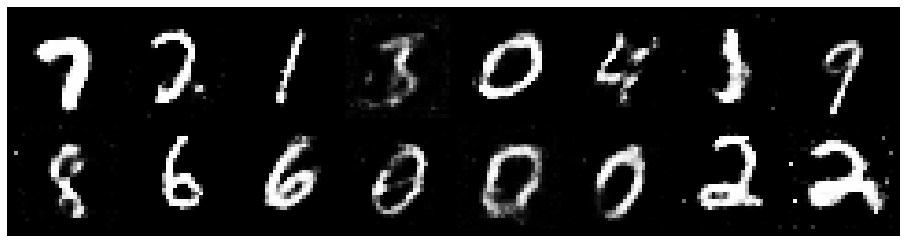

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.3197, Generator Loss: 0.7735
D(x): 0.5454, D(G(z)): 0.4689


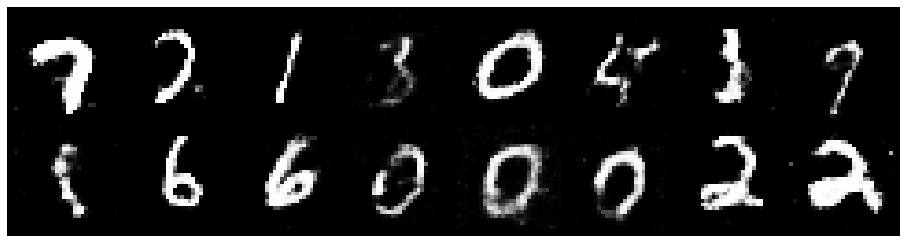

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.2790, Generator Loss: 0.7586
D(x): 0.5661, D(G(z)): 0.4838


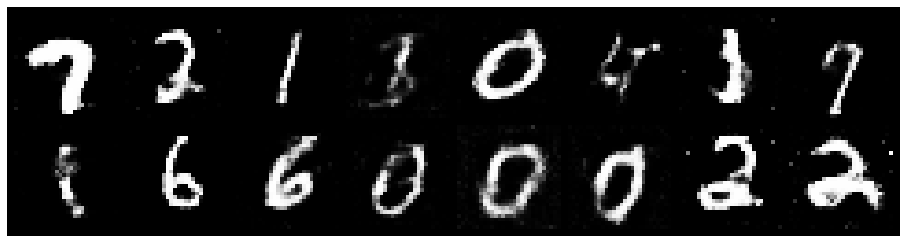

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.2900, Generator Loss: 0.8725
D(x): 0.5513, D(G(z)): 0.4659


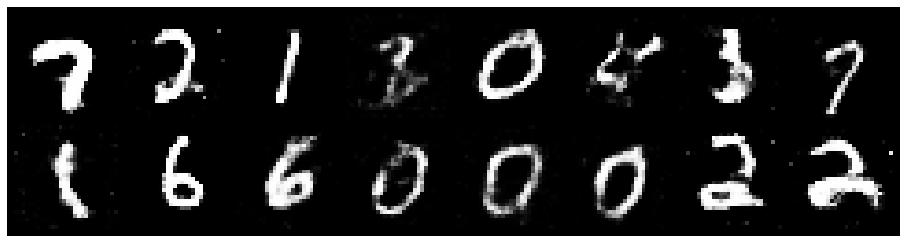

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.3007, Generator Loss: 0.9583
D(x): 0.5251, D(G(z)): 0.4199


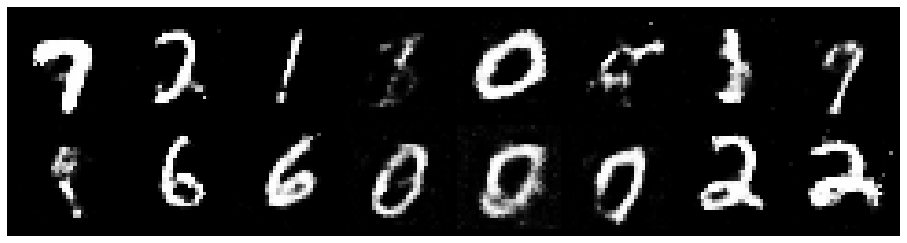

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.2700, Generator Loss: 0.8723
D(x): 0.5381, D(G(z)): 0.4555


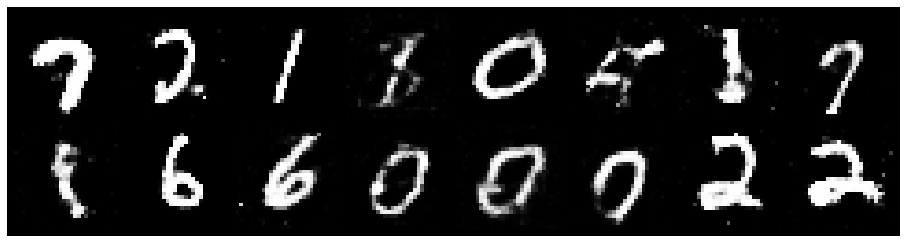

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.4154, Generator Loss: 0.7709
D(x): 0.5298, D(G(z)): 0.4836


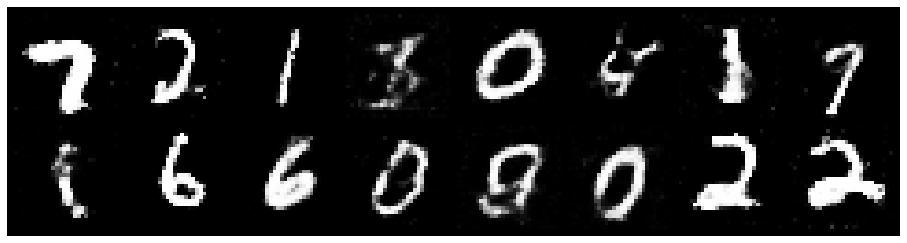

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.3074, Generator Loss: 0.9655
D(x): 0.5176, D(G(z)): 0.4277


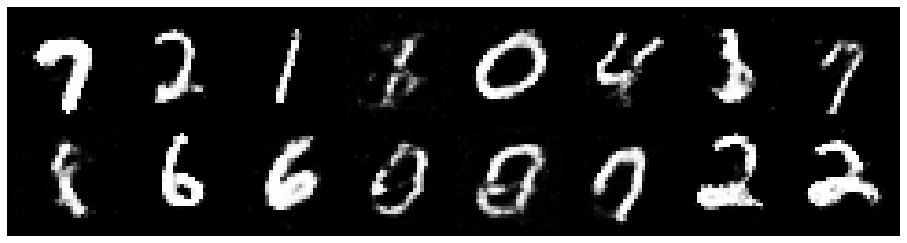

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.3168, Generator Loss: 0.9259
D(x): 0.5617, D(G(z)): 0.4595


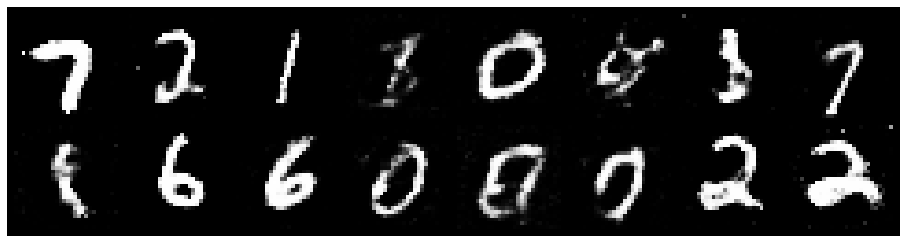

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.3255, Generator Loss: 0.9354
D(x): 0.5906, D(G(z)): 0.5019


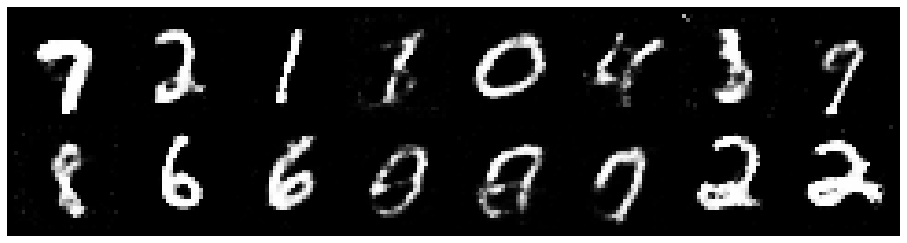

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.2270, Generator Loss: 0.8870
D(x): 0.5496, D(G(z)): 0.4301


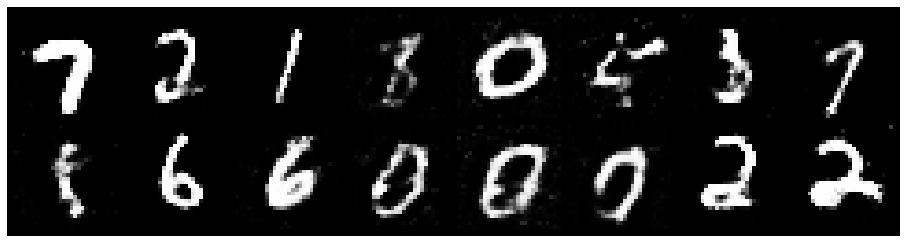

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.2934, Generator Loss: 0.9642
D(x): 0.5705, D(G(z)): 0.4571


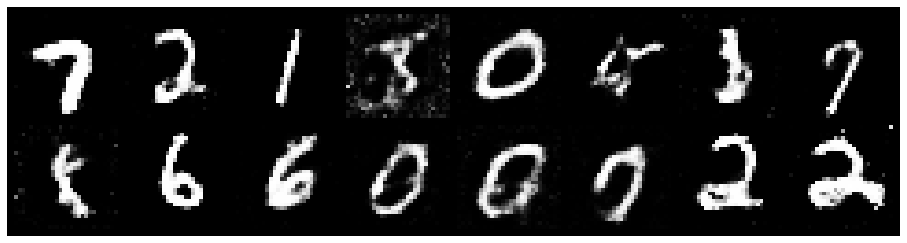

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.2207, Generator Loss: 1.0155
D(x): 0.5488, D(G(z)): 0.3904


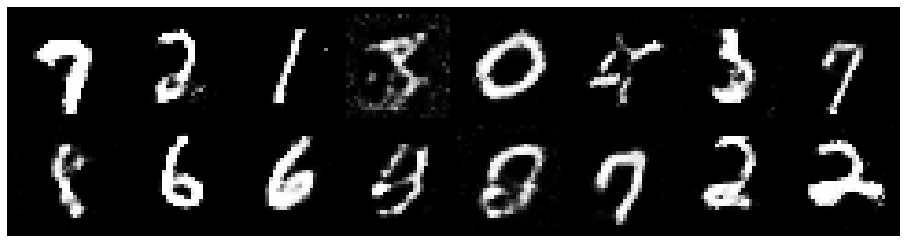

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.4452, Generator Loss: 0.9471
D(x): 0.5306, D(G(z)): 0.5001


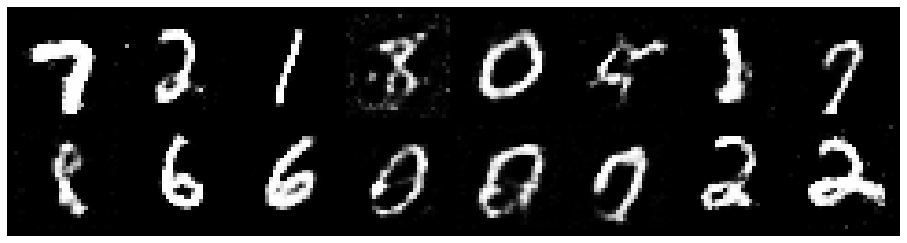

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.3404, Generator Loss: 0.8507
D(x): 0.5672, D(G(z)): 0.4727


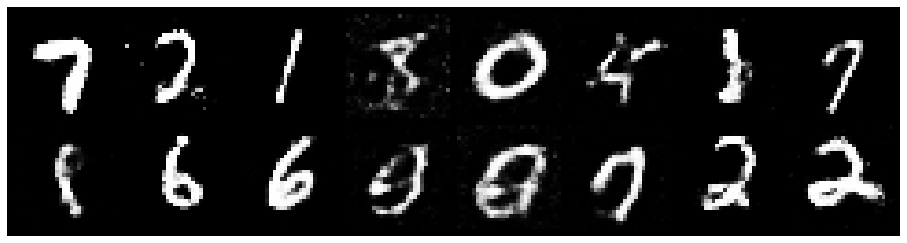

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.2942, Generator Loss: 0.8496
D(x): 0.5400, D(G(z)): 0.4470


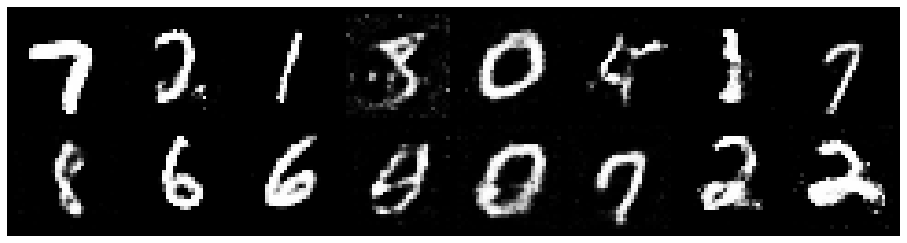

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.2799, Generator Loss: 0.8393
D(x): 0.5467, D(G(z)): 0.4467


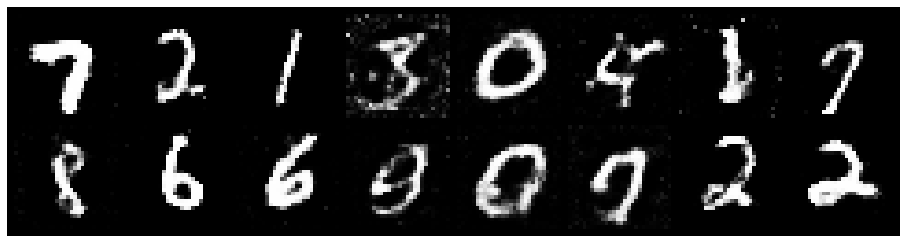

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.2129, Generator Loss: 0.9573
D(x): 0.5774, D(G(z)): 0.4417


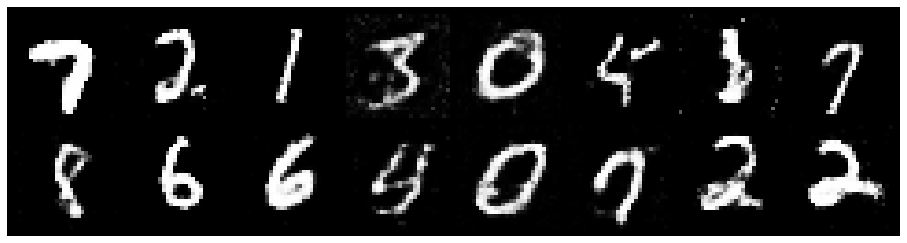

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.2313, Generator Loss: 0.9587
D(x): 0.5580, D(G(z)): 0.4203


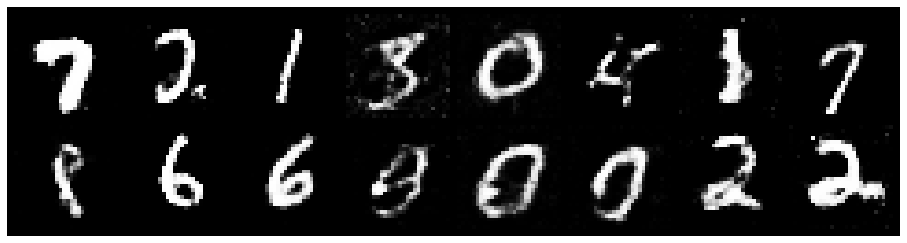

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.1453, Generator Loss: 0.9437
D(x): 0.5853, D(G(z)): 0.4065


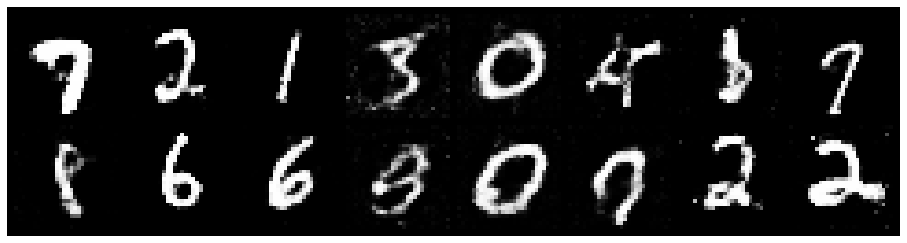

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.1697, Generator Loss: 1.0255
D(x): 0.6090, D(G(z)): 0.4412


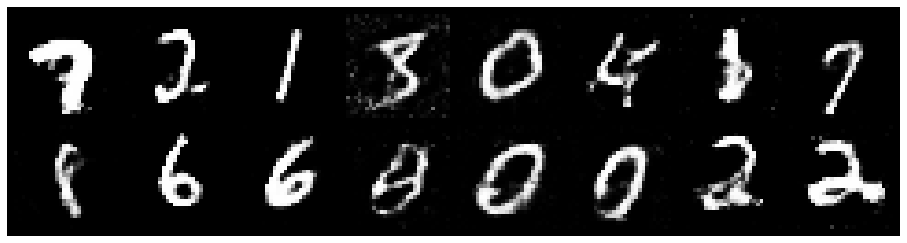

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.1935, Generator Loss: 0.9067
D(x): 0.5742, D(G(z)): 0.4237


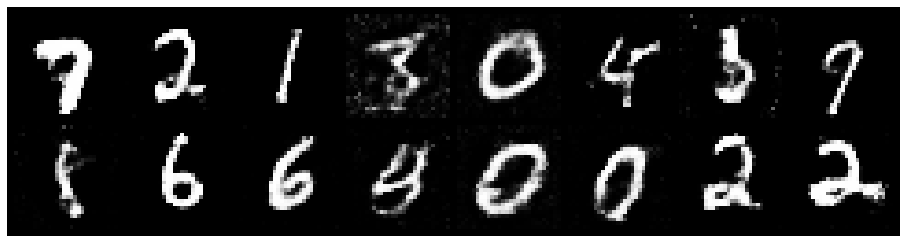

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.2455, Generator Loss: 0.8010
D(x): 0.6058, D(G(z)): 0.4673


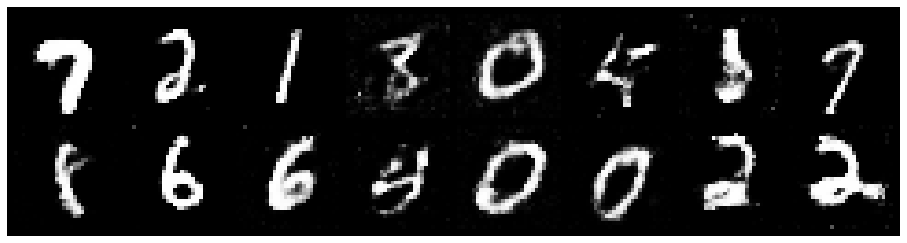

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.3145, Generator Loss: 0.8607
D(x): 0.6046, D(G(z)): 0.4944


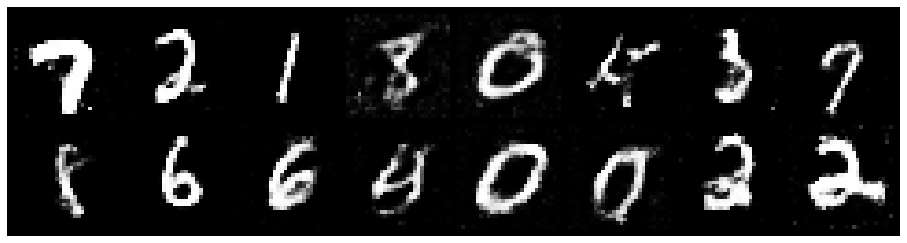

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.2824, Generator Loss: 0.9027
D(x): 0.5472, D(G(z)): 0.4486


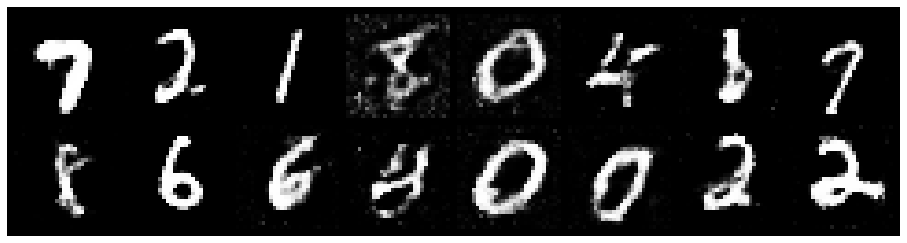

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.2094, Generator Loss: 0.9218
D(x): 0.5819, D(G(z)): 0.4359


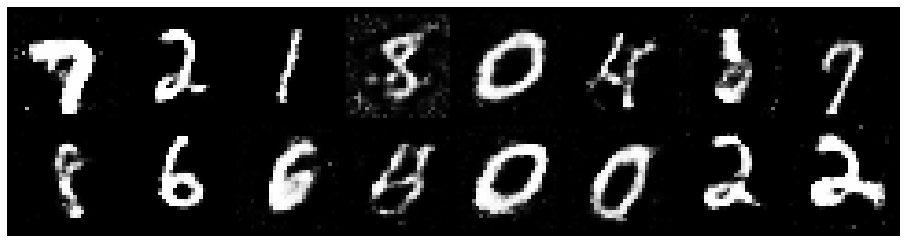

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.2708, Generator Loss: 1.0565
D(x): 0.5570, D(G(z)): 0.4277


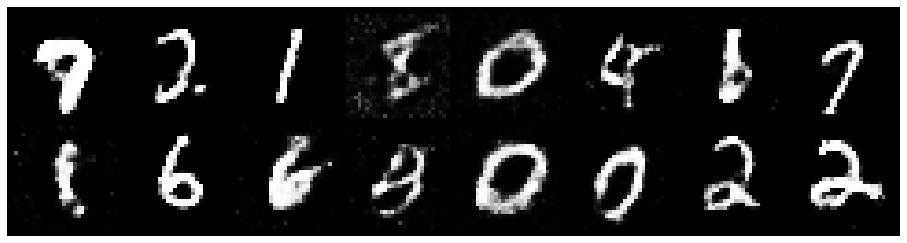

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.3060, Generator Loss: 0.8353
D(x): 0.5268, D(G(z)): 0.4285


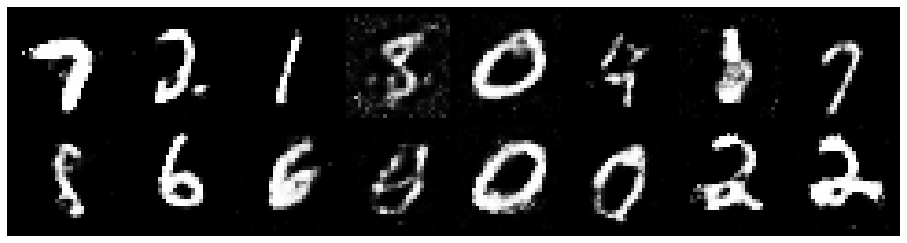

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.2302, Generator Loss: 0.9963
D(x): 0.5567, D(G(z)): 0.4081


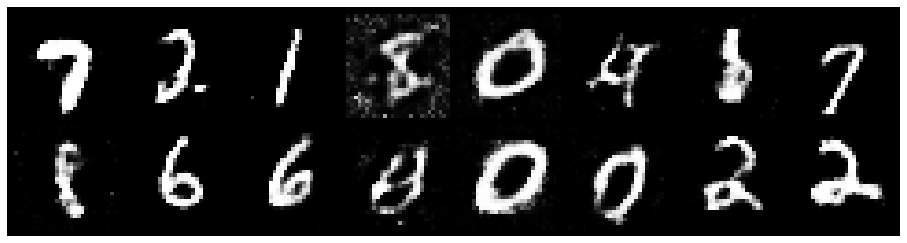

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.2153, Generator Loss: 0.9610
D(x): 0.5823, D(G(z)): 0.4433


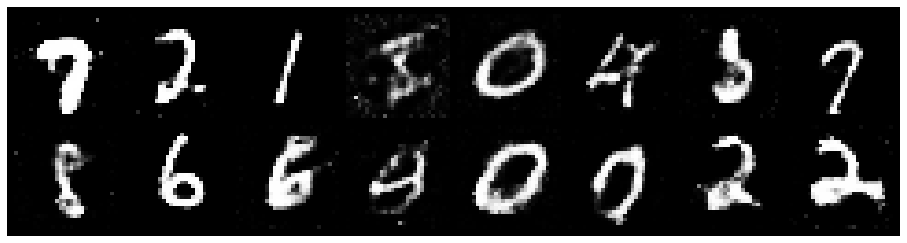

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.2250, Generator Loss: 1.0386
D(x): 0.5566, D(G(z)): 0.3957


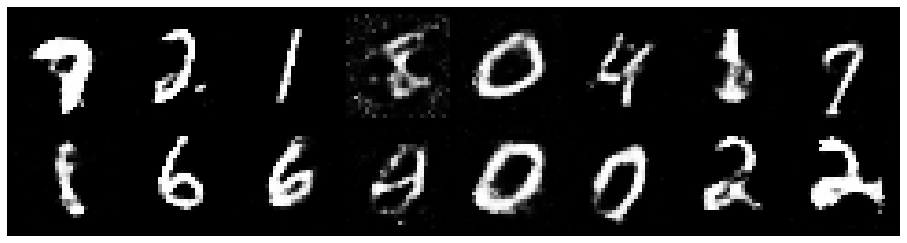

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.2616, Generator Loss: 0.9205
D(x): 0.5400, D(G(z)): 0.4149


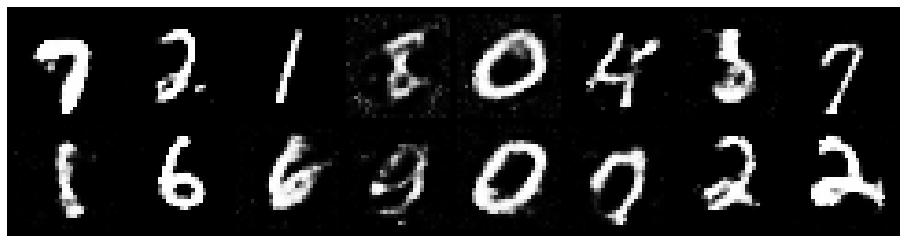

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.2172, Generator Loss: 0.9636
D(x): 0.5502, D(G(z)): 0.4071


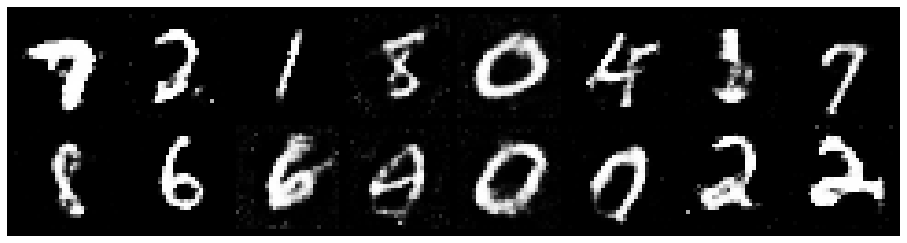

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.2901, Generator Loss: 0.8920
D(x): 0.5246, D(G(z)): 0.4272


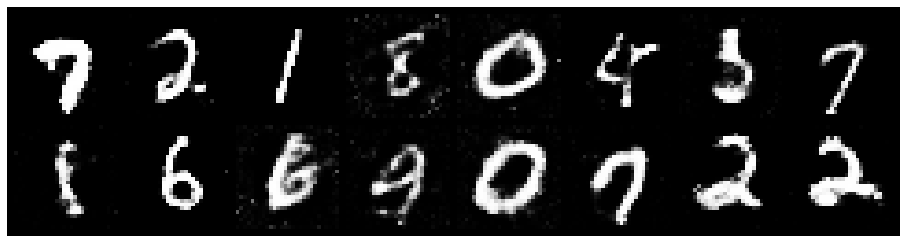

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.3082, Generator Loss: 0.8965
D(x): 0.5424, D(G(z)): 0.4554


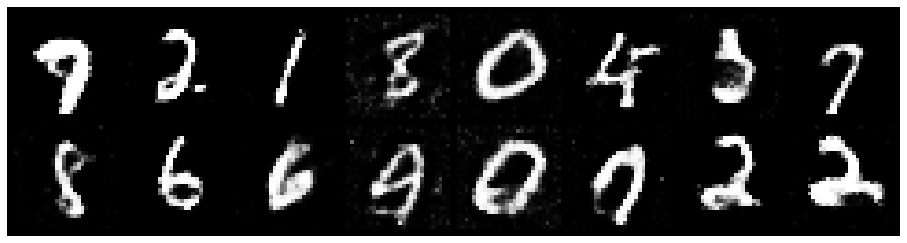

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.2318, Generator Loss: 0.9602
D(x): 0.5624, D(G(z)): 0.4459


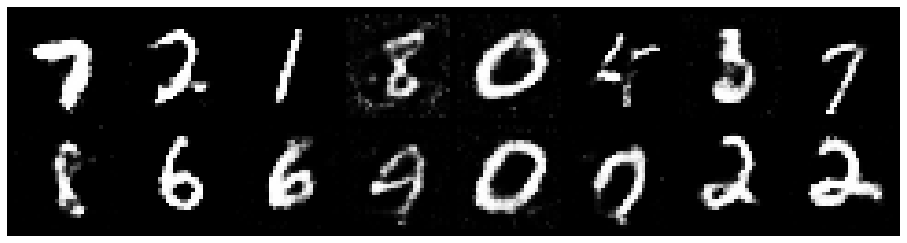

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.2728, Generator Loss: 0.8644
D(x): 0.5558, D(G(z)): 0.4475


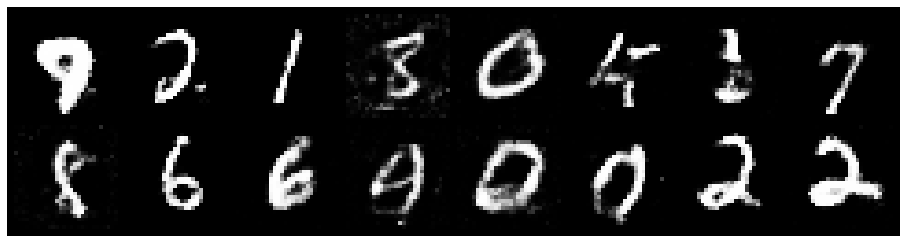

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.2121, Generator Loss: 1.0676
D(x): 0.5746, D(G(z)): 0.4281


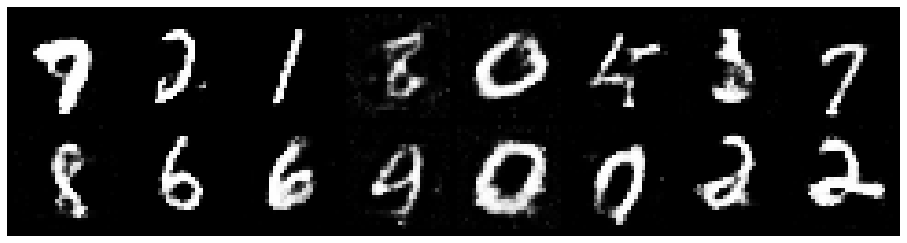

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.2099, Generator Loss: 1.0738
D(x): 0.5379, D(G(z)): 0.3946


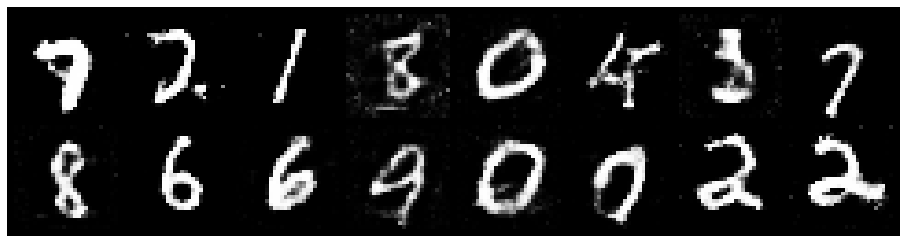

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.2126, Generator Loss: 1.0715
D(x): 0.5926, D(G(z)): 0.4435


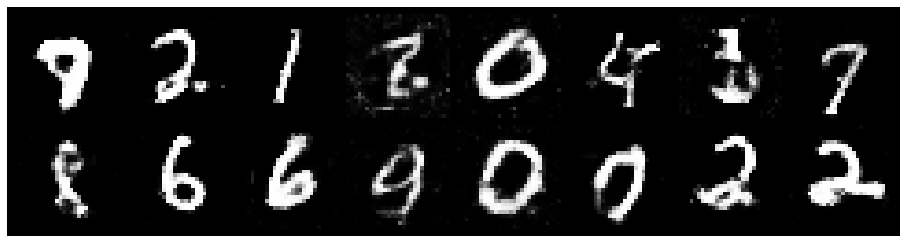

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.1160, Generator Loss: 1.0692
D(x): 0.5690, D(G(z)): 0.3742


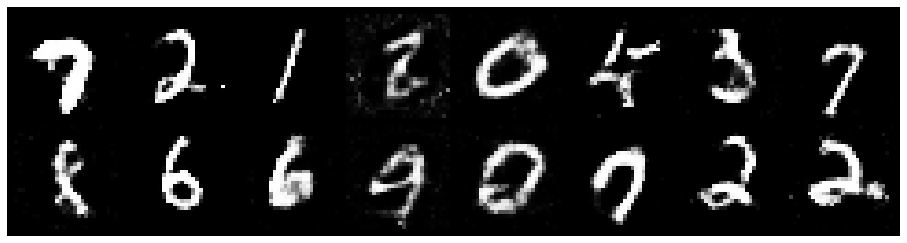

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.2711, Generator Loss: 0.8523
D(x): 0.5222, D(G(z)): 0.4237


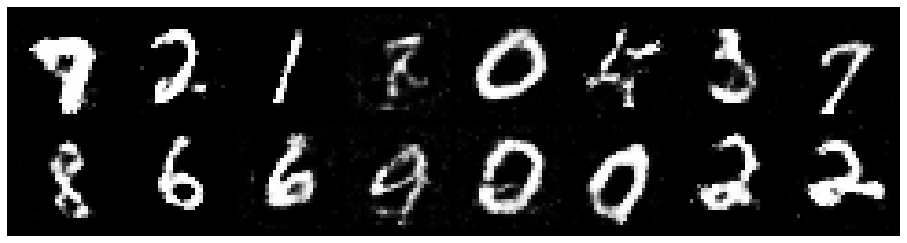

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.1824, Generator Loss: 0.9030
D(x): 0.5773, D(G(z)): 0.4296


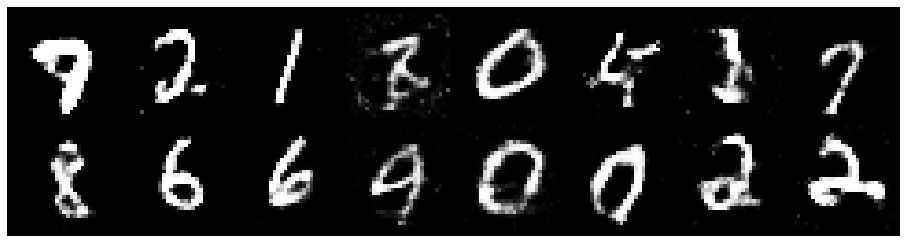

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.1975, Generator Loss: 0.9282
D(x): 0.5475, D(G(z)): 0.3845


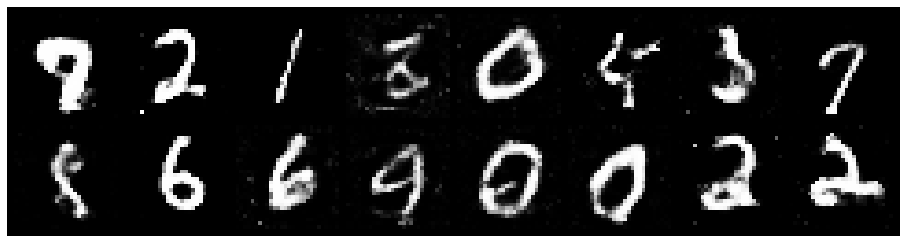

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.2792, Generator Loss: 0.8399
D(x): 0.5435, D(G(z)): 0.4405


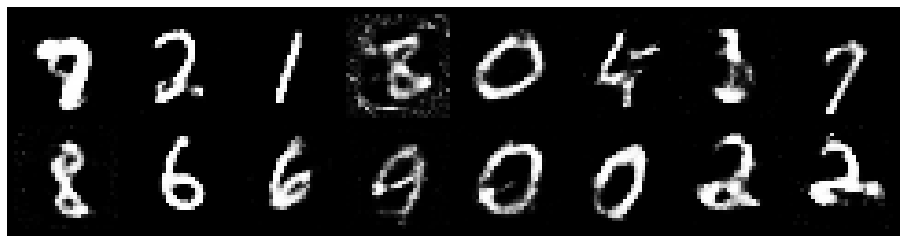

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.3337, Generator Loss: 0.8991
D(x): 0.5112, D(G(z)): 0.4310


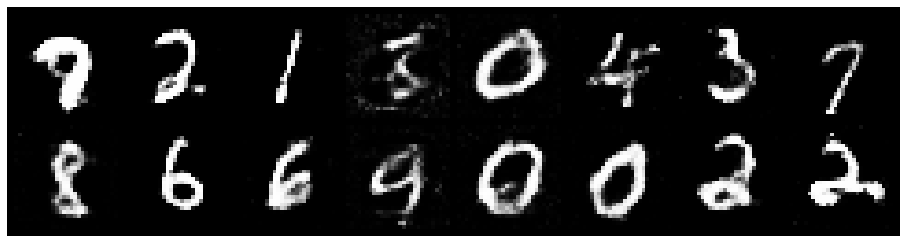

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.3372, Generator Loss: 0.9025
D(x): 0.5444, D(G(z)): 0.4712


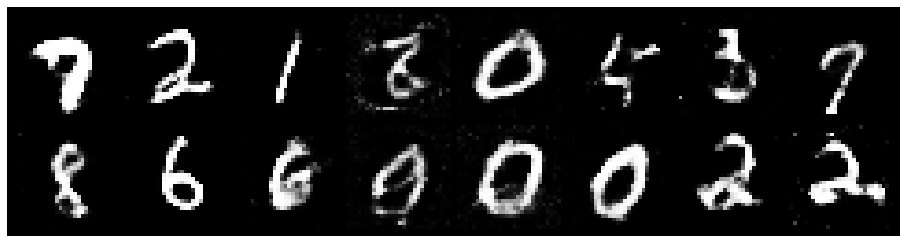

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.3116, Generator Loss: 0.9263
D(x): 0.5352, D(G(z)): 0.4488


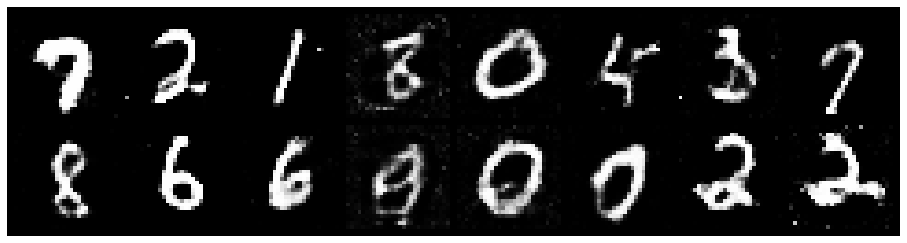

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.3005, Generator Loss: 0.8372
D(x): 0.5486, D(G(z)): 0.4562


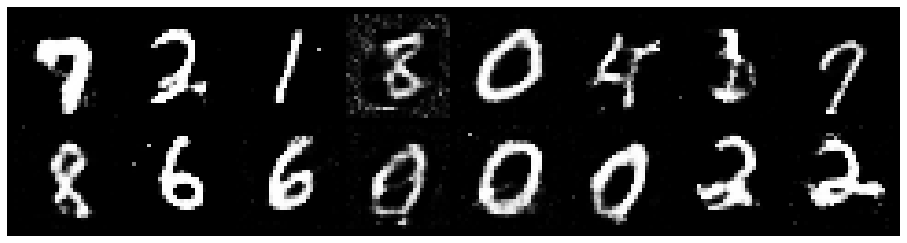

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.2386, Generator Loss: 0.8583
D(x): 0.5522, D(G(z)): 0.4276


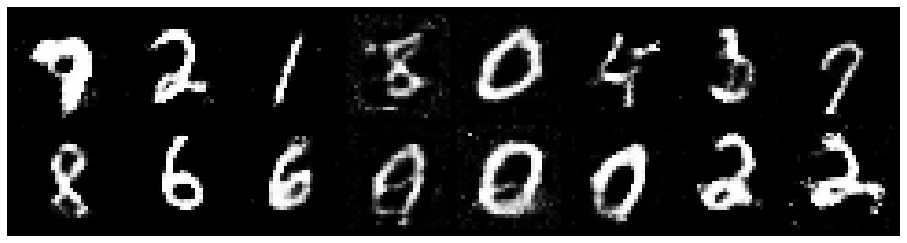

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.1472, Generator Loss: 1.0668
D(x): 0.6230, D(G(z)): 0.4254


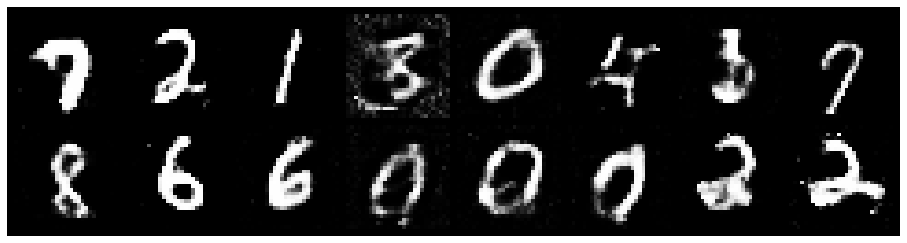

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.3013, Generator Loss: 0.9594
D(x): 0.5685, D(G(z)): 0.4445


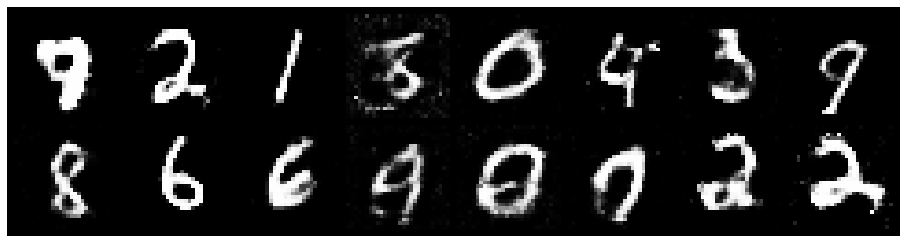

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.3592, Generator Loss: 0.7685
D(x): 0.5319, D(G(z)): 0.4844


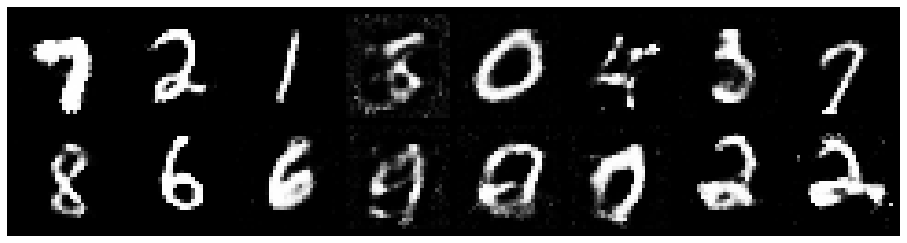

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.4042, Generator Loss: 0.6895
D(x): 0.5874, D(G(z)): 0.5389


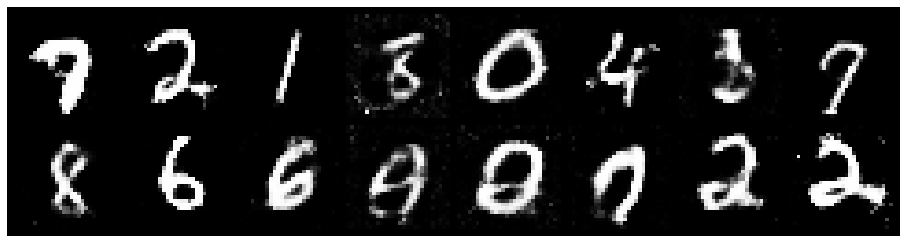

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.3562, Generator Loss: 0.8865
D(x): 0.5536, D(G(z)): 0.4673


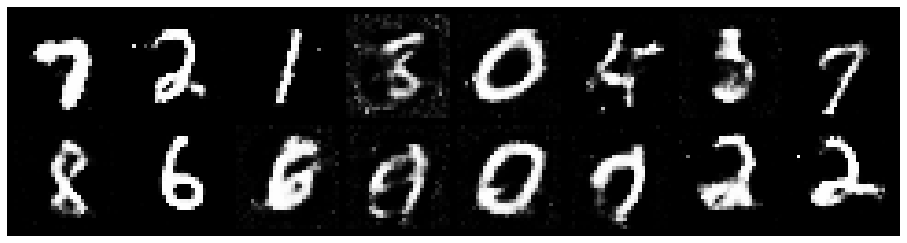

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.2880, Generator Loss: 0.8058
D(x): 0.5914, D(G(z)): 0.4877


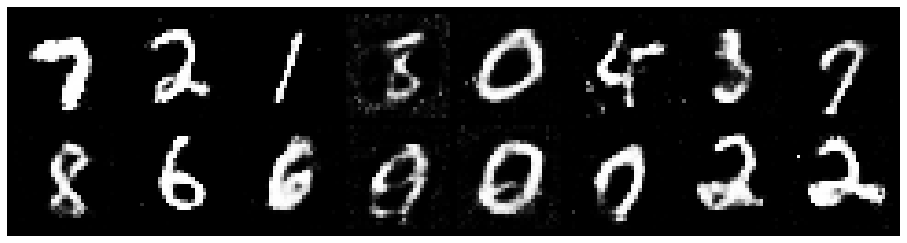

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.2693, Generator Loss: 0.7574
D(x): 0.5624, D(G(z)): 0.4617


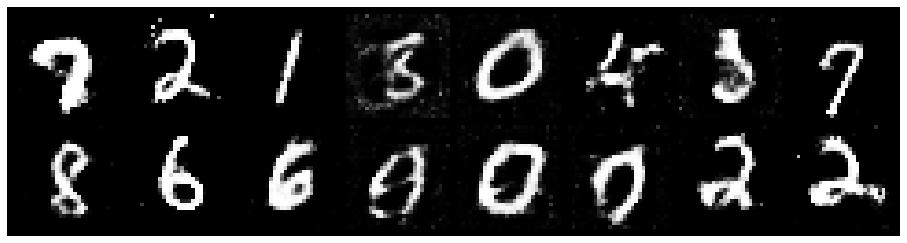

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.3251, Generator Loss: 0.8616
D(x): 0.5368, D(G(z)): 0.4483


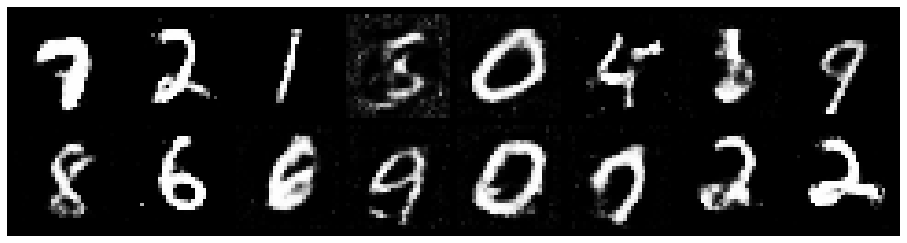

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.3212, Generator Loss: 0.7878
D(x): 0.5918, D(G(z)): 0.4994


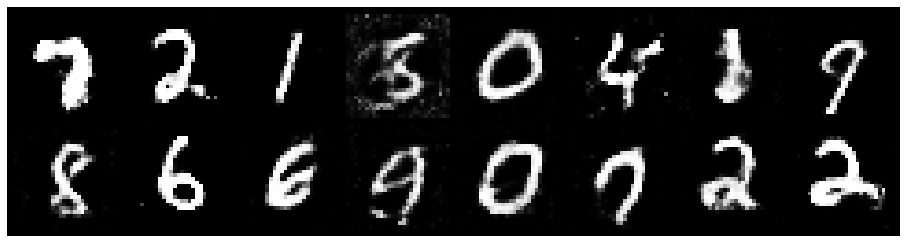

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.3260, Generator Loss: 0.8167
D(x): 0.5643, D(G(z)): 0.4755


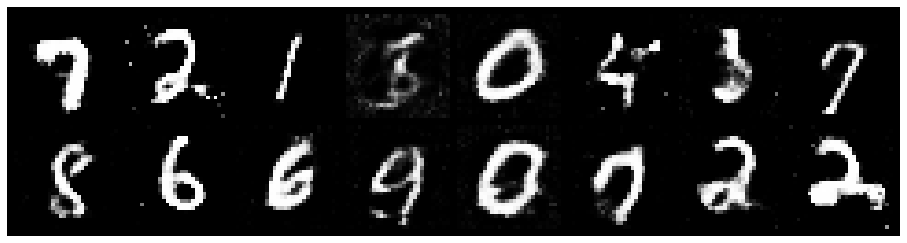

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.3405, Generator Loss: 0.7804
D(x): 0.5429, D(G(z)): 0.4820


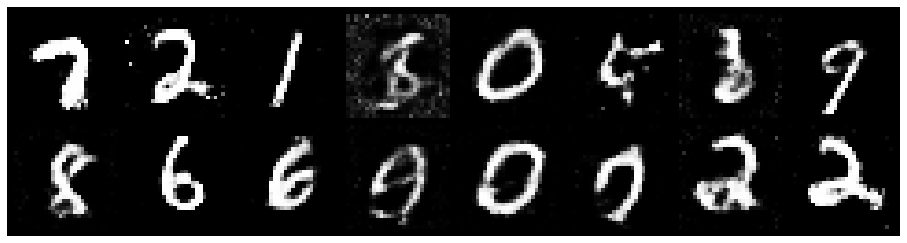

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.3644, Generator Loss: 0.8382
D(x): 0.5507, D(G(z)): 0.4877


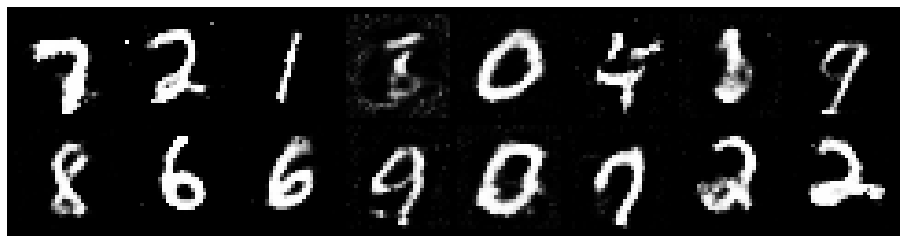

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.3131, Generator Loss: 0.8609
D(x): 0.5237, D(G(z)): 0.4392


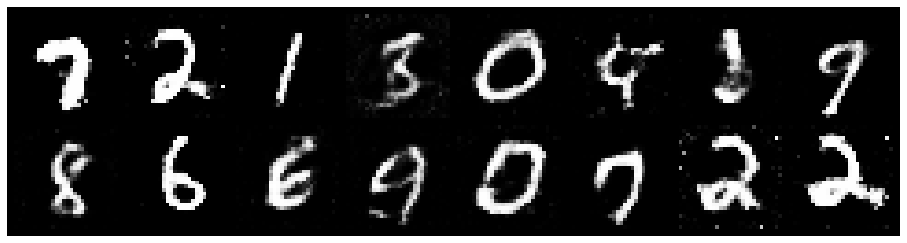

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.2645, Generator Loss: 0.8624
D(x): 0.5642, D(G(z)): 0.4476


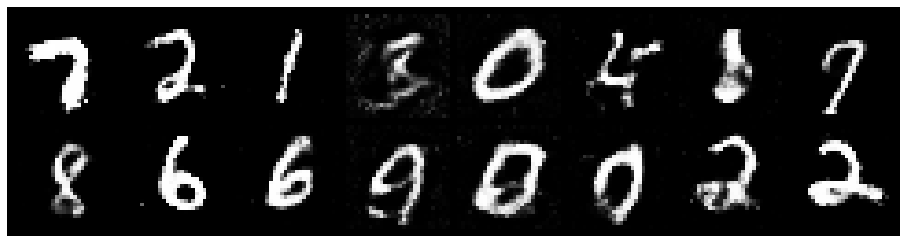

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.2611, Generator Loss: 0.9183
D(x): 0.5671, D(G(z)): 0.4415


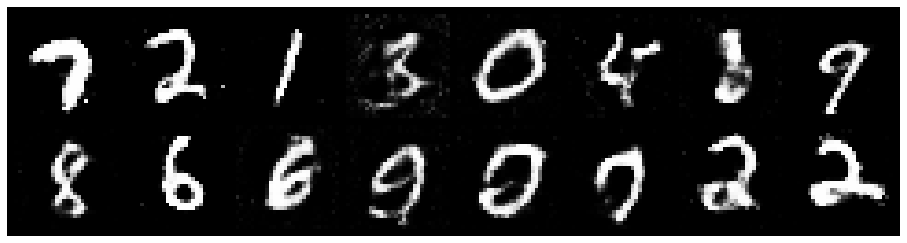

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.2346, Generator Loss: 0.8617
D(x): 0.5809, D(G(z)): 0.4556


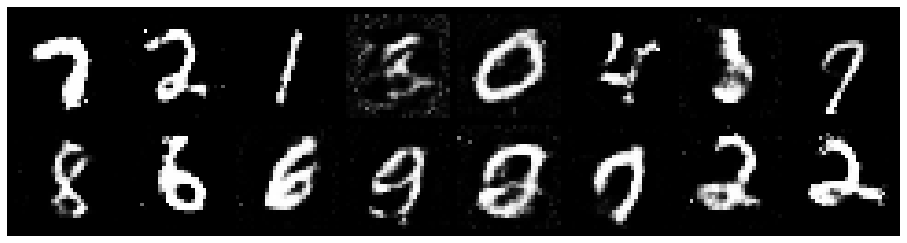

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.2667, Generator Loss: 0.9558
D(x): 0.5500, D(G(z)): 0.4255


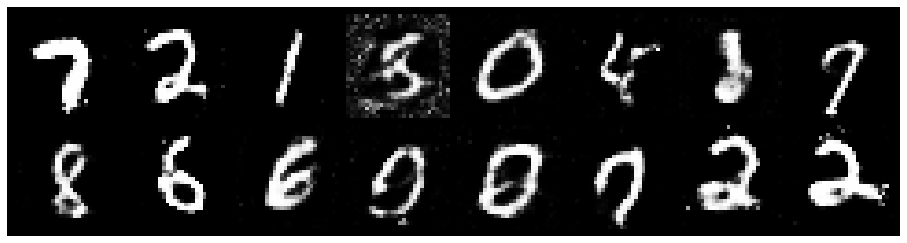

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.3188, Generator Loss: 0.8235
D(x): 0.5751, D(G(z)): 0.4731


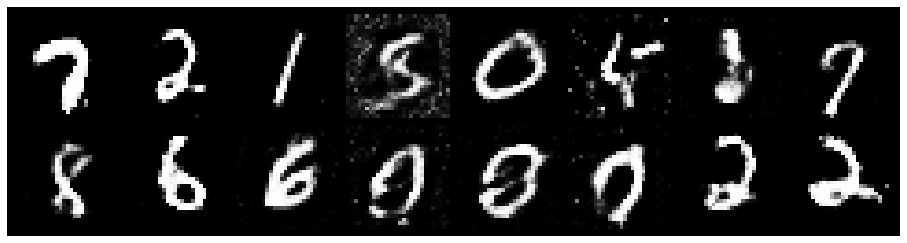

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.4246, Generator Loss: 0.8680
D(x): 0.5201, D(G(z)): 0.4730


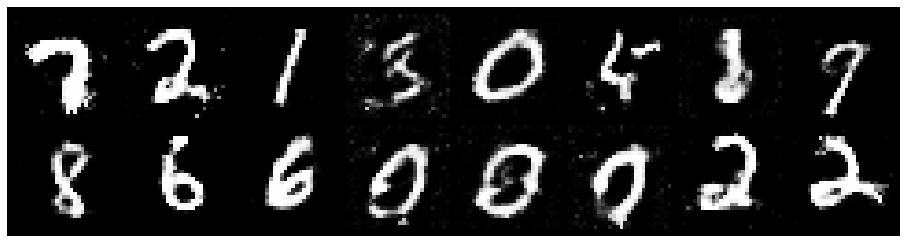

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.3993, Generator Loss: 0.7545
D(x): 0.5485, D(G(z)): 0.5084


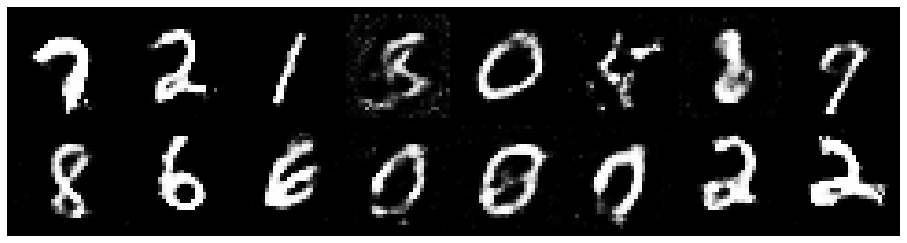

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.3079, Generator Loss: 0.9119
D(x): 0.5192, D(G(z)): 0.4254


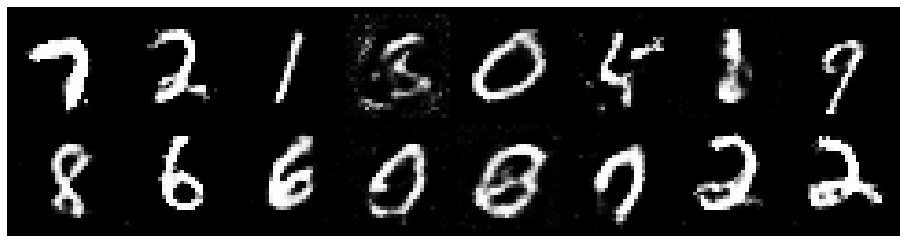

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.2944, Generator Loss: 0.8426
D(x): 0.5527, D(G(z)): 0.4613


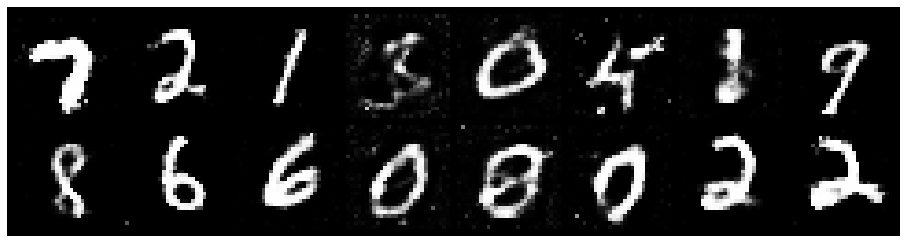

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.3335, Generator Loss: 0.8200
D(x): 0.5585, D(G(z)): 0.4750


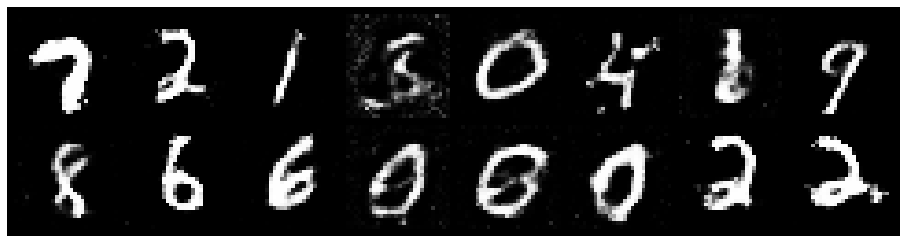

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.3264, Generator Loss: 0.8352
D(x): 0.5303, D(G(z)): 0.4557


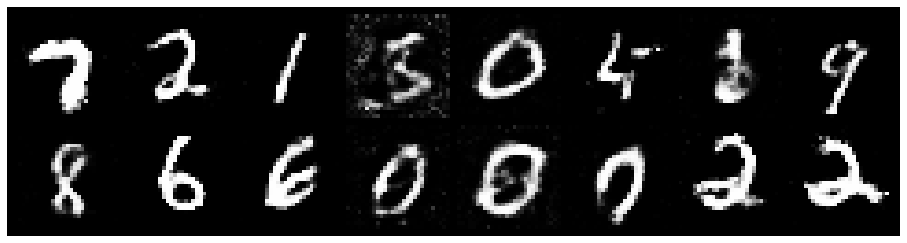

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.3319, Generator Loss: 0.8764
D(x): 0.5191, D(G(z)): 0.4544


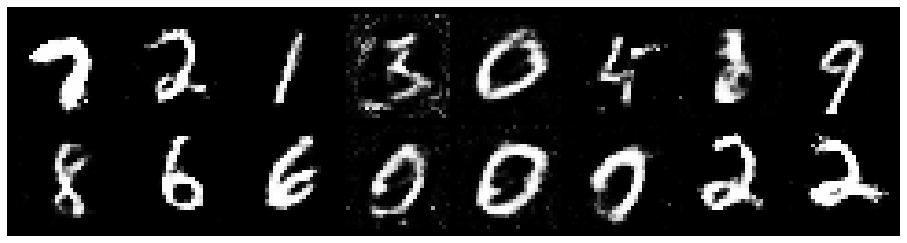

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.3708, Generator Loss: 0.8110
D(x): 0.5566, D(G(z)): 0.4965


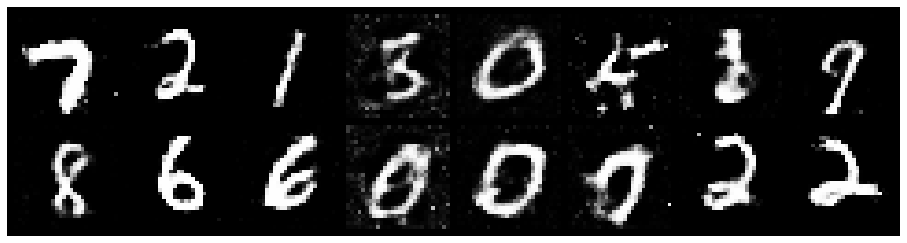

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.3435, Generator Loss: 0.8722
D(x): 0.5566, D(G(z)): 0.4917


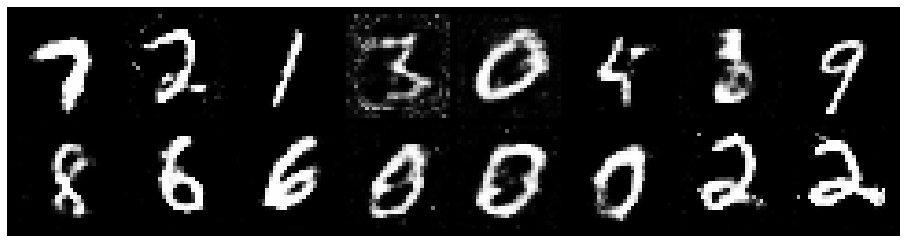

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.3672, Generator Loss: 0.8535
D(x): 0.5462, D(G(z)): 0.4876


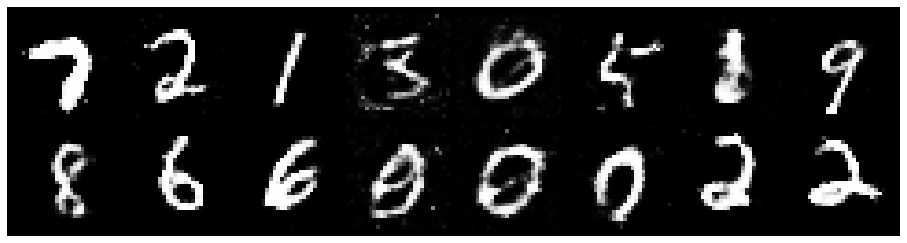

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.1885, Generator Loss: 0.9266
D(x): 0.5396, D(G(z)): 0.3951


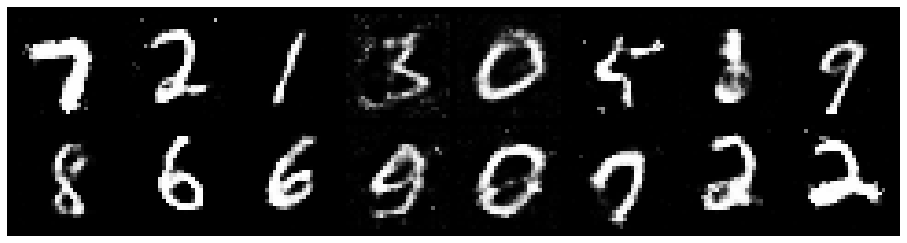

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.1277, Generator Loss: 0.9251
D(x): 0.5817, D(G(z)): 0.3910


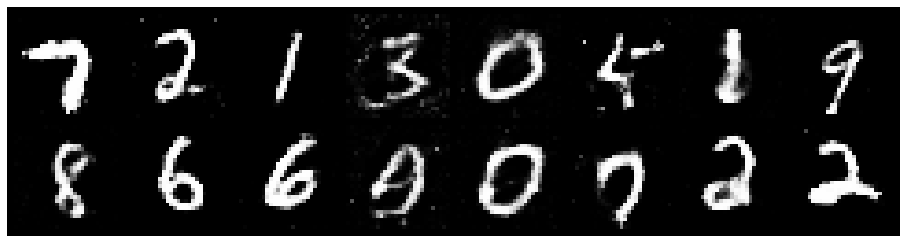

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.3179, Generator Loss: 0.9159
D(x): 0.5671, D(G(z)): 0.4316


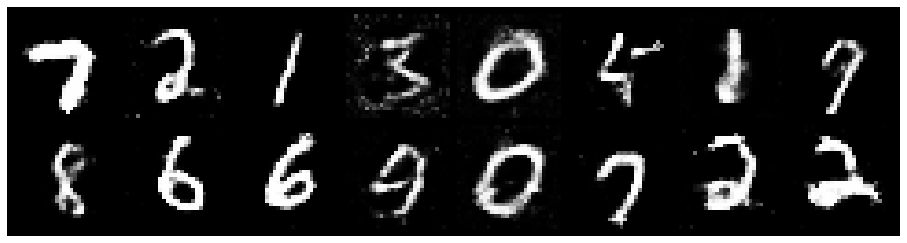

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.2453, Generator Loss: 0.8421
D(x): 0.5682, D(G(z)): 0.4513


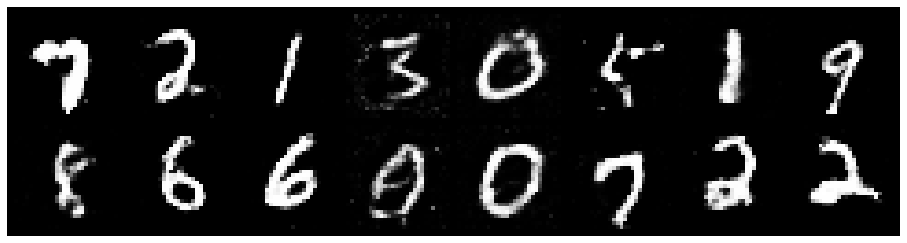

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.2261, Generator Loss: 0.8718
D(x): 0.5441, D(G(z)): 0.4272


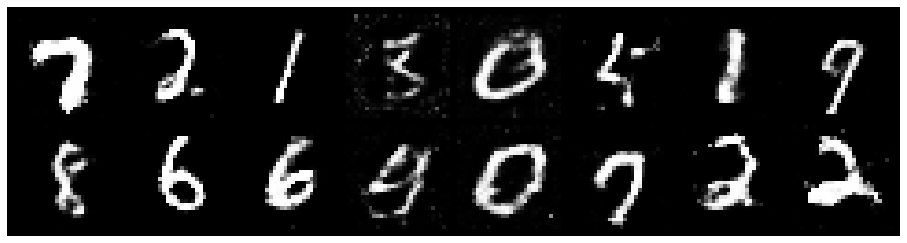

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.3153, Generator Loss: 1.0856
D(x): 0.5220, D(G(z)): 0.4303


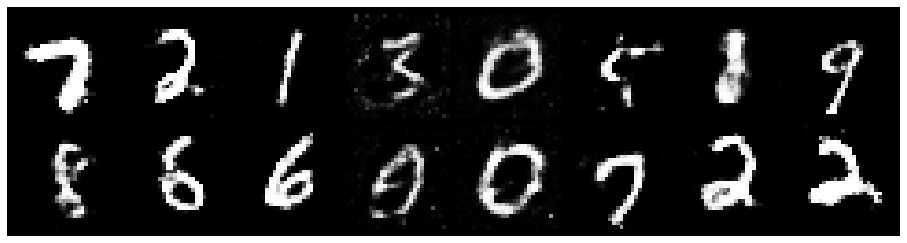

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.3111, Generator Loss: 0.8678
D(x): 0.5539, D(G(z)): 0.4768


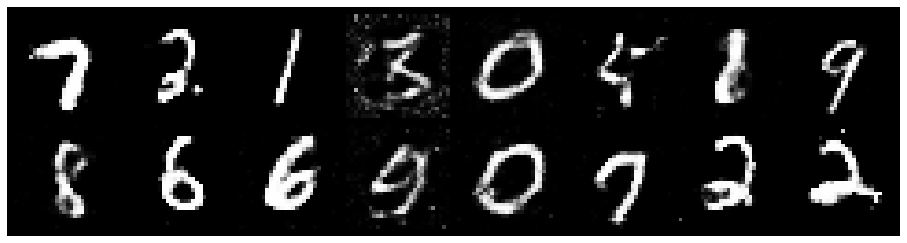

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.2031, Generator Loss: 0.9146
D(x): 0.5425, D(G(z)): 0.4155


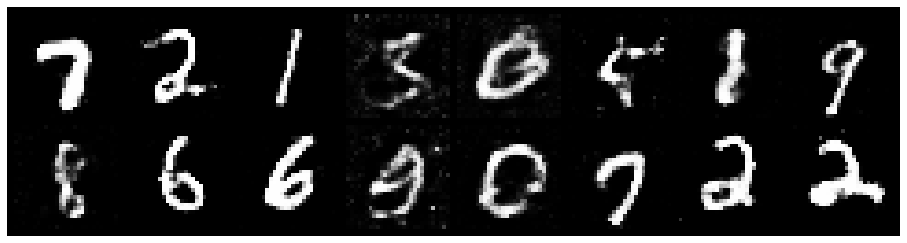

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.3168, Generator Loss: 0.9341
D(x): 0.5462, D(G(z)): 0.4675


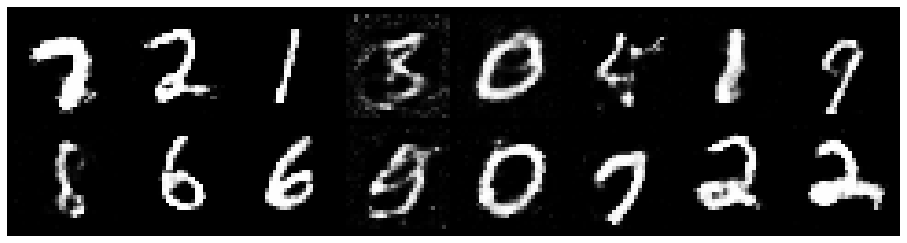

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.4036, Generator Loss: 0.9679
D(x): 0.5247, D(G(z)): 0.4611


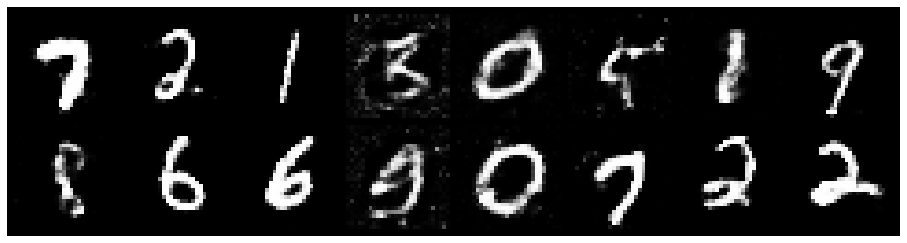

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.2563, Generator Loss: 0.8117
D(x): 0.5548, D(G(z)): 0.4407


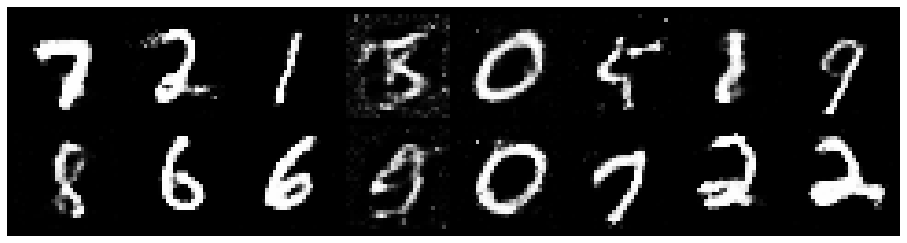

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.3552, Generator Loss: 0.8531
D(x): 0.5434, D(G(z)): 0.4473


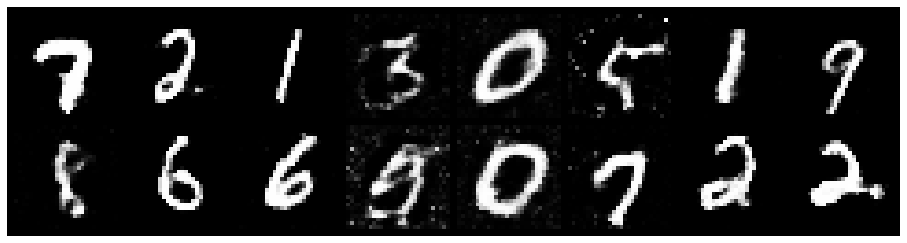

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.4866, Generator Loss: 0.8401
D(x): 0.5160, D(G(z)): 0.4732


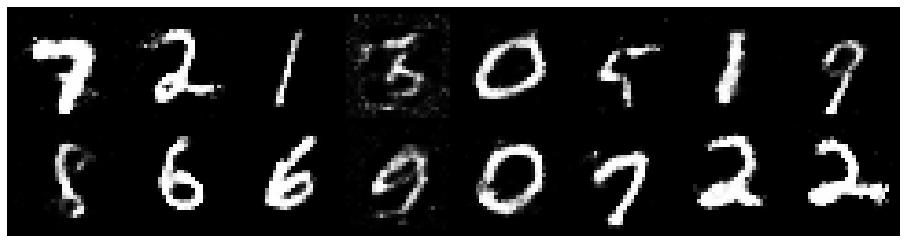

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.3706, Generator Loss: 0.7912
D(x): 0.5203, D(G(z)): 0.4693


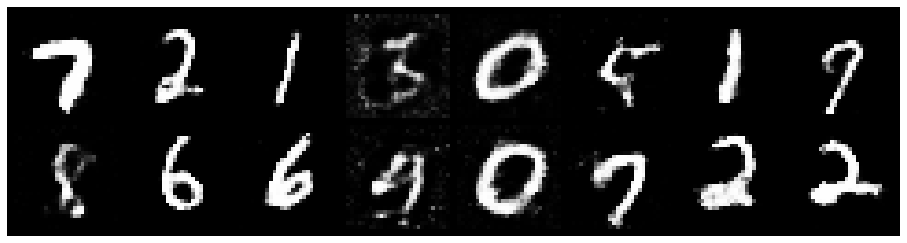

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.3043, Generator Loss: 0.9391
D(x): 0.5685, D(G(z)): 0.4606


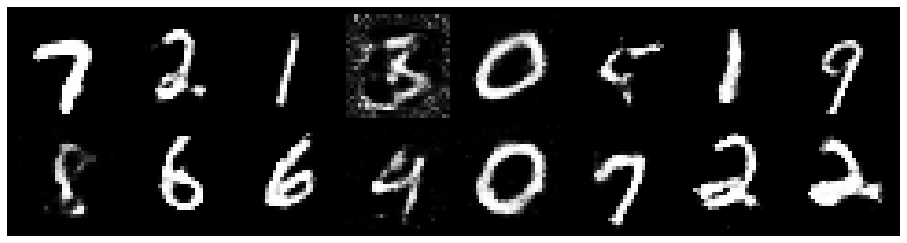

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.4119, Generator Loss: 0.7483
D(x): 0.5188, D(G(z)): 0.4790


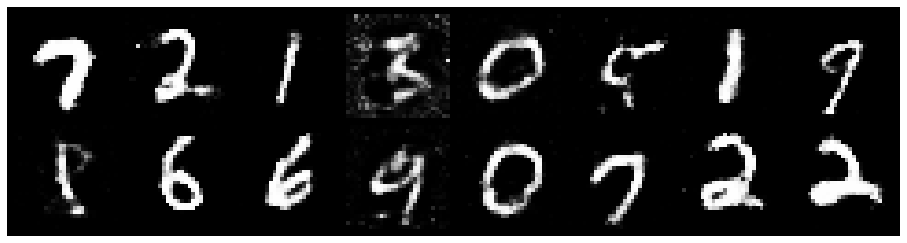

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.3692, Generator Loss: 0.8062
D(x): 0.5069, D(G(z)): 0.4560


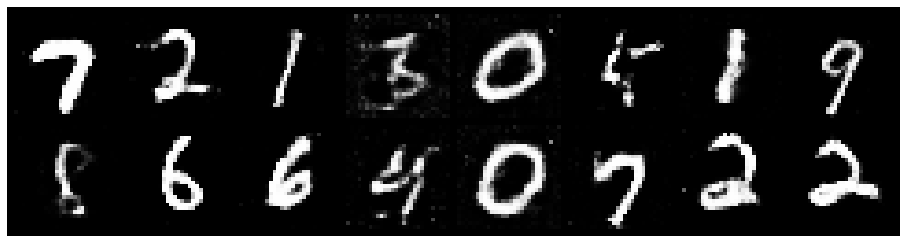

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.3263, Generator Loss: 0.8237
D(x): 0.5237, D(G(z)): 0.4532


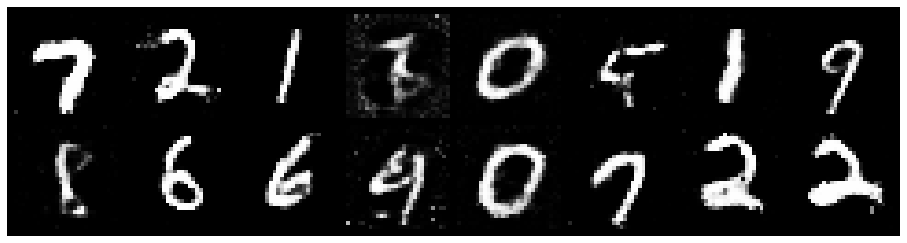

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.2410, Generator Loss: 0.9066
D(x): 0.5916, D(G(z)): 0.4573


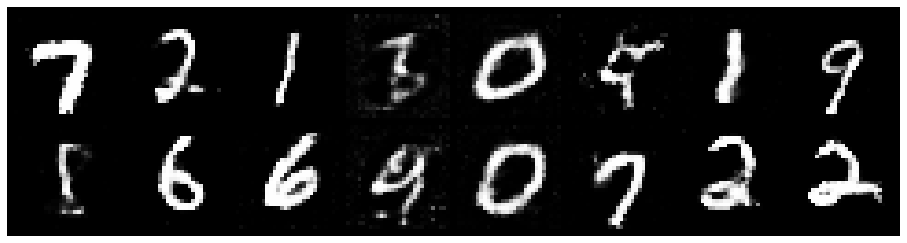

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.3307, Generator Loss: 0.9274
D(x): 0.5196, D(G(z)): 0.4298


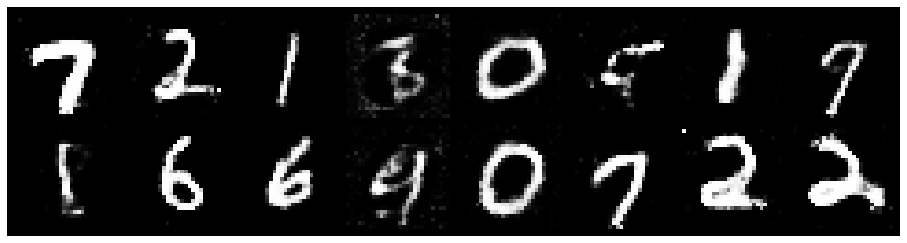

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.3721, Generator Loss: 0.9153
D(x): 0.5073, D(G(z)): 0.4206


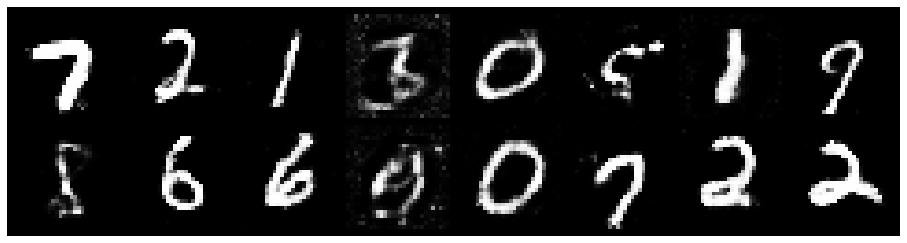

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.3366, Generator Loss: 0.8065
D(x): 0.5855, D(G(z)): 0.4904


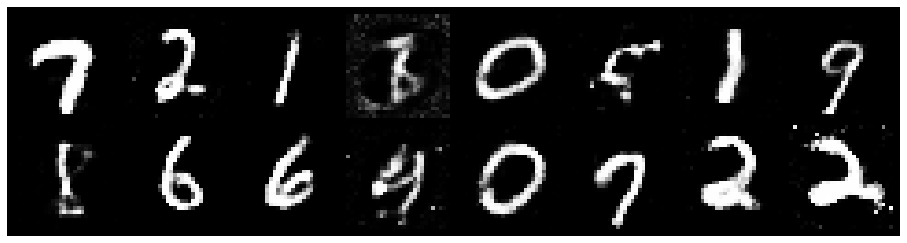

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.3153, Generator Loss: 0.7876
D(x): 0.6120, D(G(z)): 0.5049


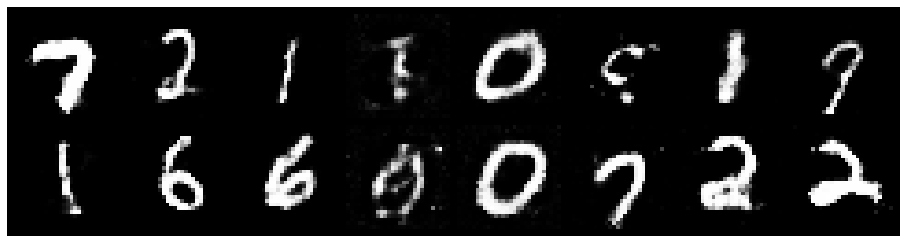

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.2708, Generator Loss: 0.8571
D(x): 0.5231, D(G(z)): 0.4371


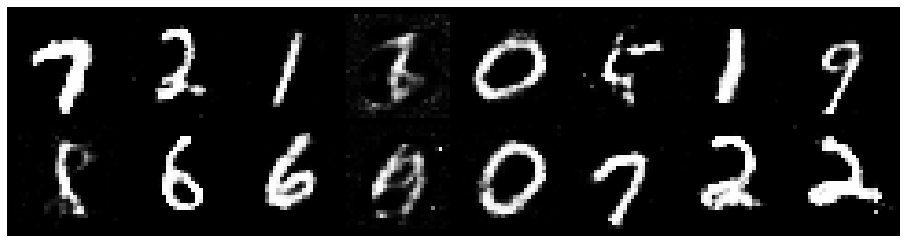

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.2588, Generator Loss: 0.8616
D(x): 0.5392, D(G(z)): 0.4427


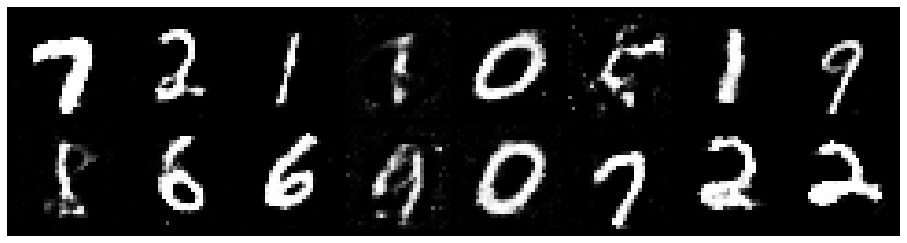

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.4313, Generator Loss: 0.9164
D(x): 0.5323, D(G(z)): 0.4618


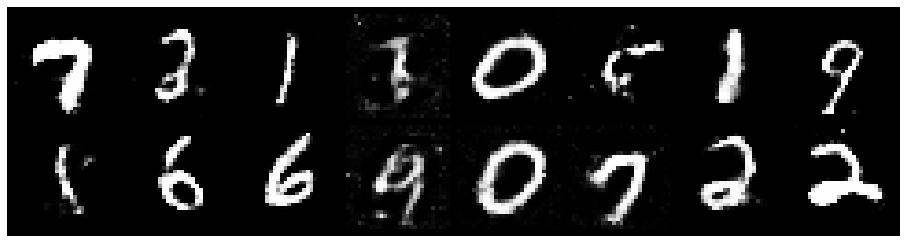

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.3170, Generator Loss: 0.9066
D(x): 0.5398, D(G(z)): 0.4495


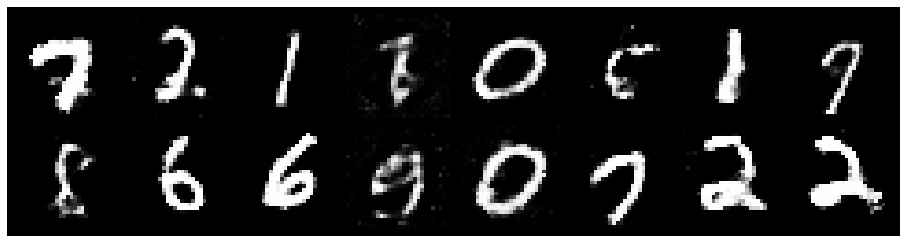

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.2808, Generator Loss: 0.9919
D(x): 0.5229, D(G(z)): 0.4096


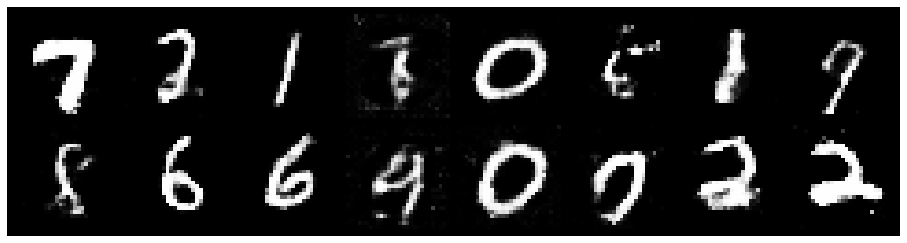

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.2572, Generator Loss: 0.9563
D(x): 0.5543, D(G(z)): 0.4369


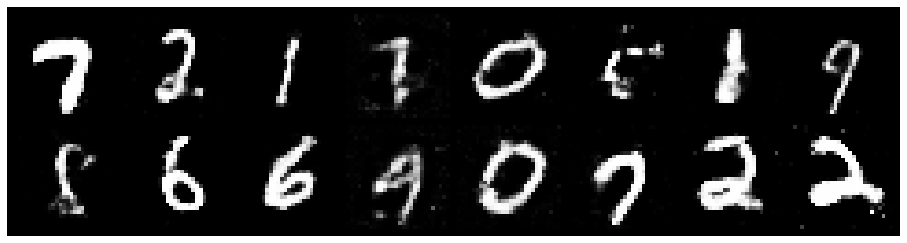

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.4184, Generator Loss: 0.9660
D(x): 0.5315, D(G(z)): 0.4852


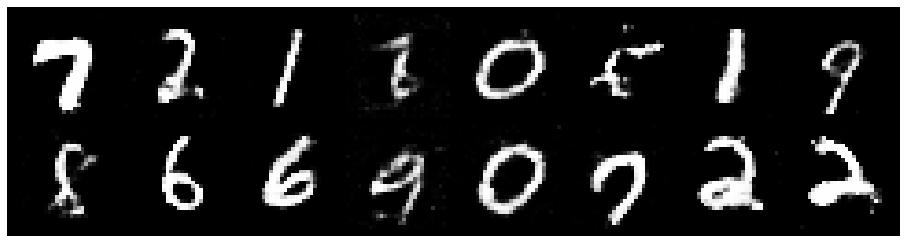

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.2875, Generator Loss: 0.9304
D(x): 0.5444, D(G(z)): 0.4434


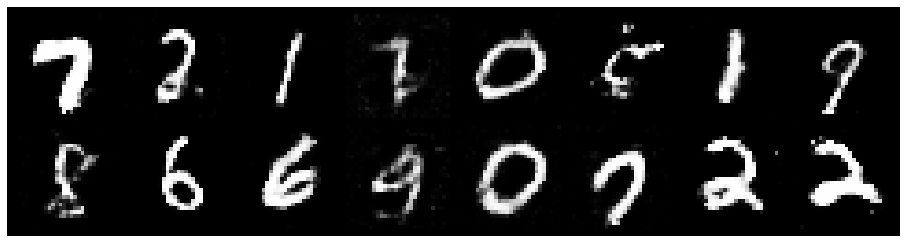

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.2877, Generator Loss: 0.9672
D(x): 0.5289, D(G(z)): 0.4352


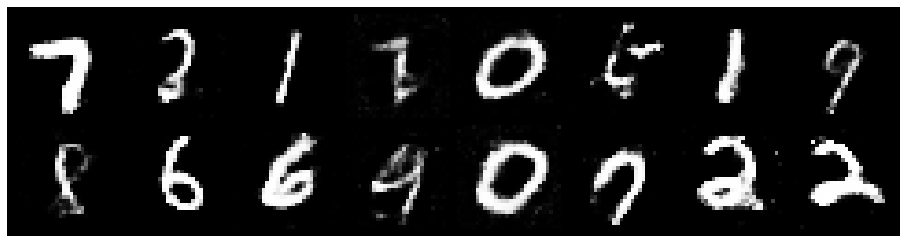

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.3244, Generator Loss: 0.8830
D(x): 0.5161, D(G(z)): 0.4509


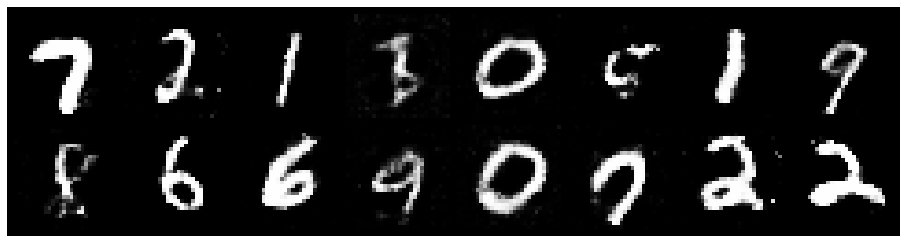

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.2407, Generator Loss: 1.0590
D(x): 0.5432, D(G(z)): 0.4095


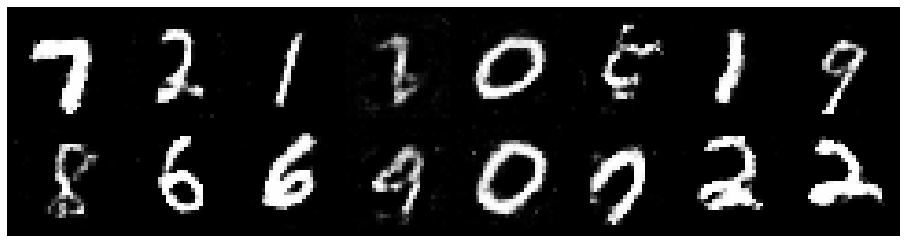

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.2089, Generator Loss: 0.9972
D(x): 0.6066, D(G(z)): 0.4276


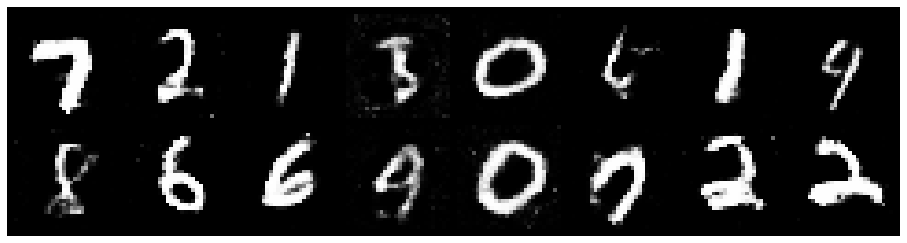

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.2082, Generator Loss: 1.1249
D(x): 0.6199, D(G(z)): 0.4375


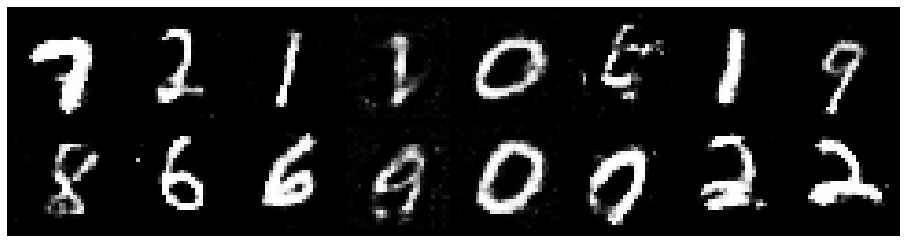

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.2311, Generator Loss: 0.9593
D(x): 0.5700, D(G(z)): 0.4286


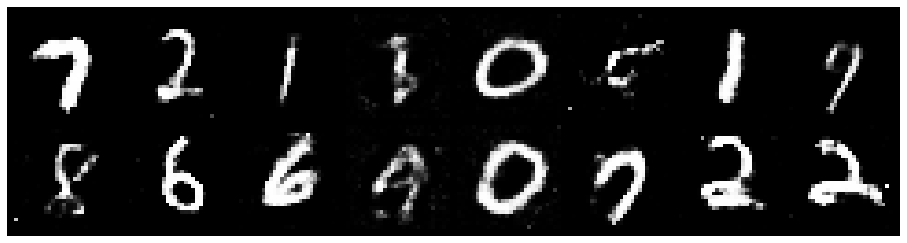

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.1734, Generator Loss: 0.9083
D(x): 0.5886, D(G(z)): 0.4215


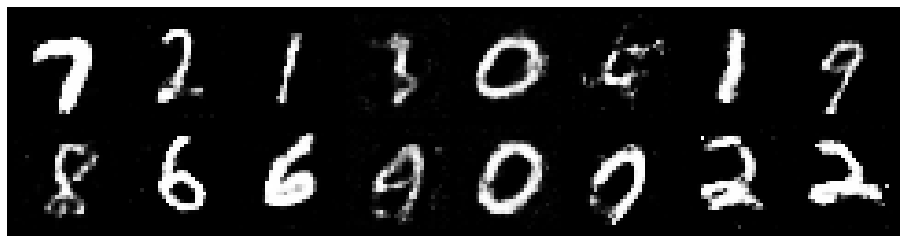

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.3357, Generator Loss: 0.9552
D(x): 0.5491, D(G(z)): 0.4687


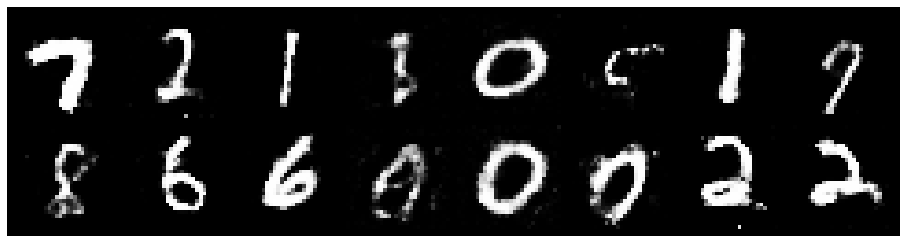

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.2938, Generator Loss: 0.8360
D(x): 0.5615, D(G(z)): 0.4638


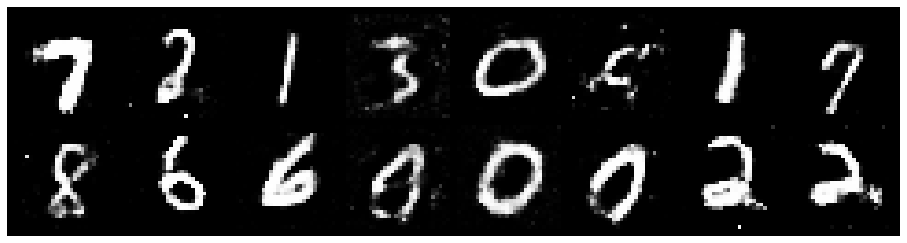

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.1844, Generator Loss: 0.9348
D(x): 0.5766, D(G(z)): 0.4270


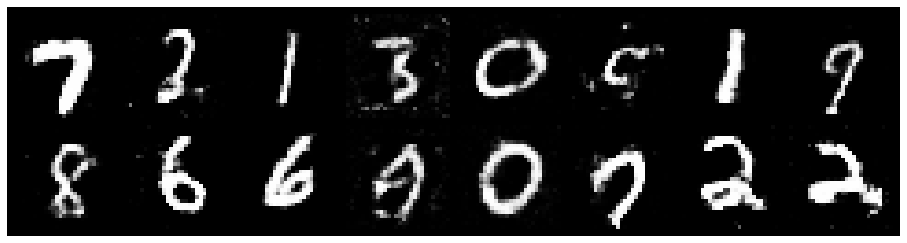

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.2370, Generator Loss: 0.8763
D(x): 0.5657, D(G(z)): 0.4341


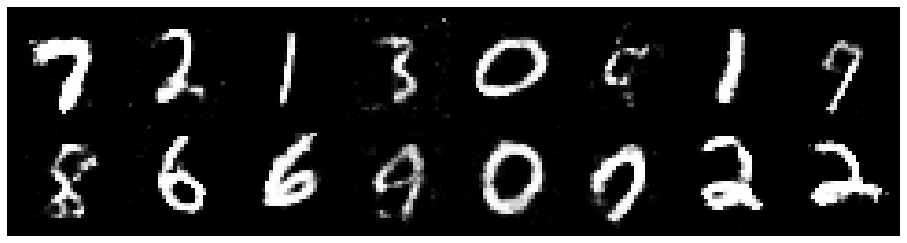

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.1640, Generator Loss: 0.9306
D(x): 0.5812, D(G(z)): 0.4170


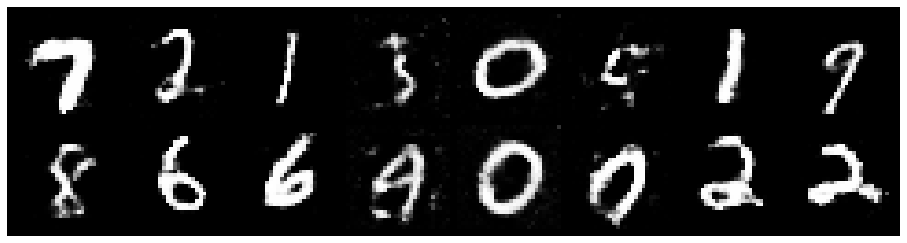

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.3216, Generator Loss: 0.8779
D(x): 0.5484, D(G(z)): 0.4534


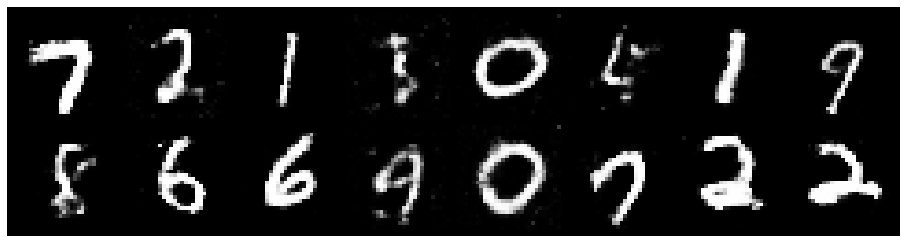

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.3397, Generator Loss: 0.7610
D(x): 0.5390, D(G(z)): 0.4727


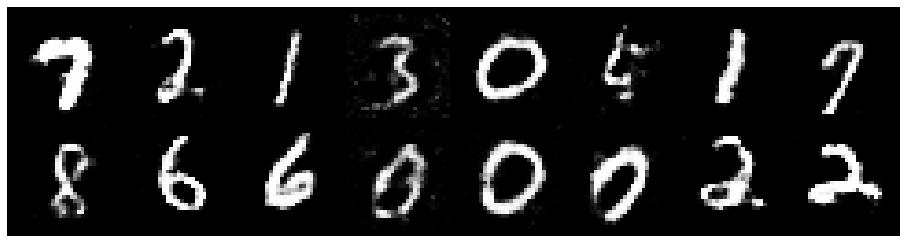

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.2342, Generator Loss: 0.8533
D(x): 0.5771, D(G(z)): 0.4535


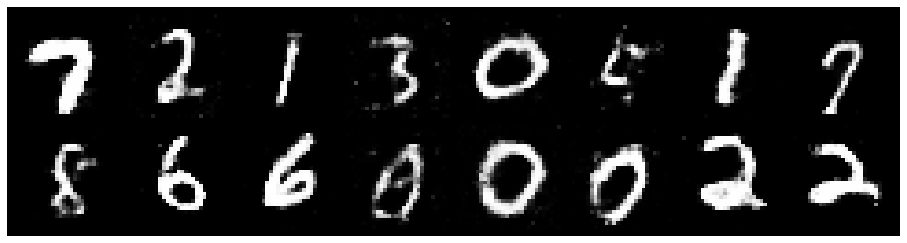

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.2242, Generator Loss: 0.9097
D(x): 0.5598, D(G(z)): 0.4441


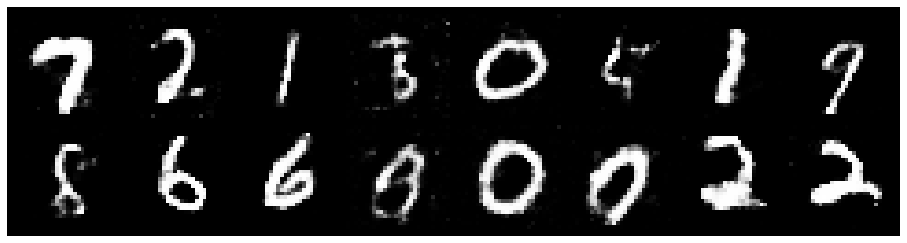

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.1943, Generator Loss: 0.8600
D(x): 0.5670, D(G(z)): 0.4281


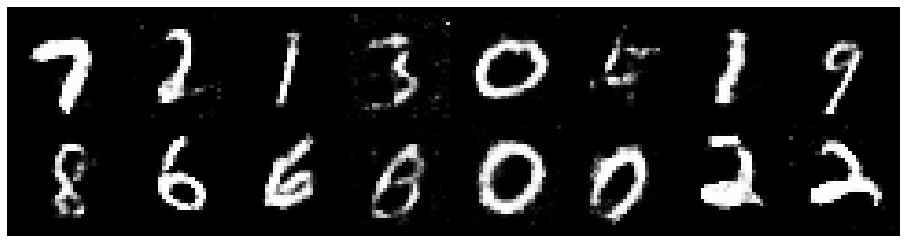

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.2464, Generator Loss: 0.9524
D(x): 0.5545, D(G(z)): 0.4186


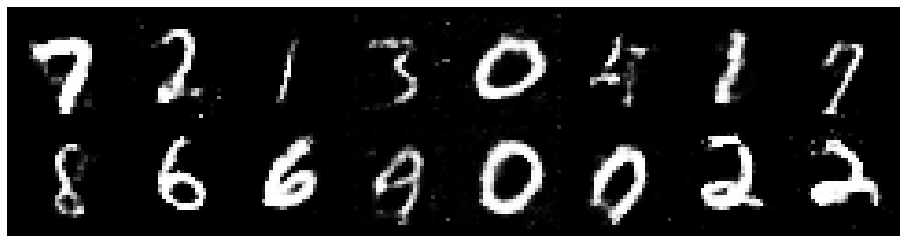

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.2440, Generator Loss: 1.0172
D(x): 0.5600, D(G(z)): 0.4362


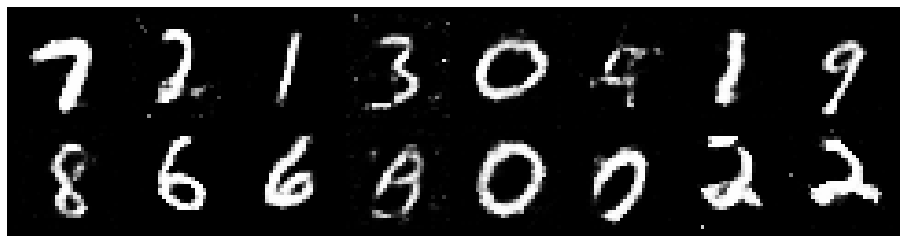

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.2397, Generator Loss: 0.8847
D(x): 0.5593, D(G(z)): 0.4397


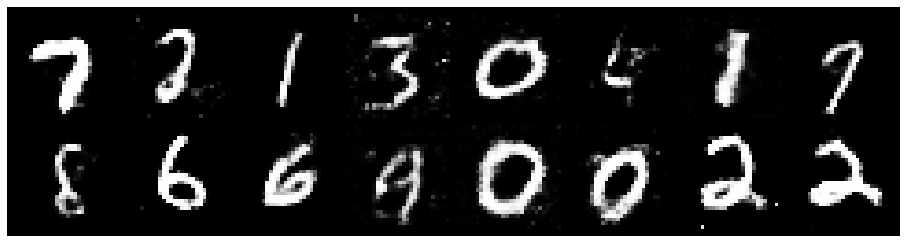

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.2581, Generator Loss: 0.9599
D(x): 0.5622, D(G(z)): 0.4458


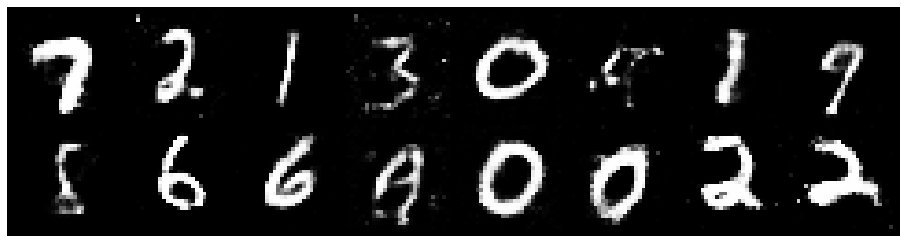

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.3430, Generator Loss: 0.9218
D(x): 0.5253, D(G(z)): 0.4349


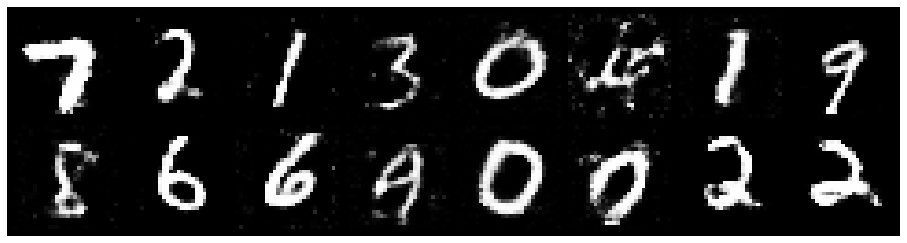

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.3404, Generator Loss: 1.0151
D(x): 0.5223, D(G(z)): 0.4219


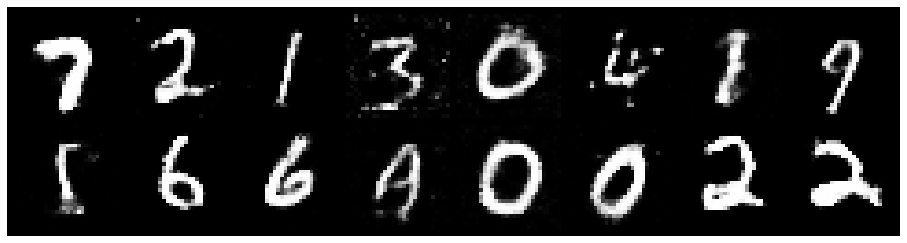

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.2544, Generator Loss: 0.7880
D(x): 0.5798, D(G(z)): 0.4608


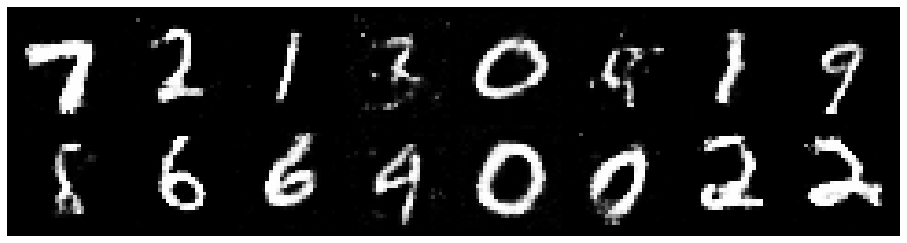

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.2829, Generator Loss: 0.7934
D(x): 0.5564, D(G(z)): 0.4749


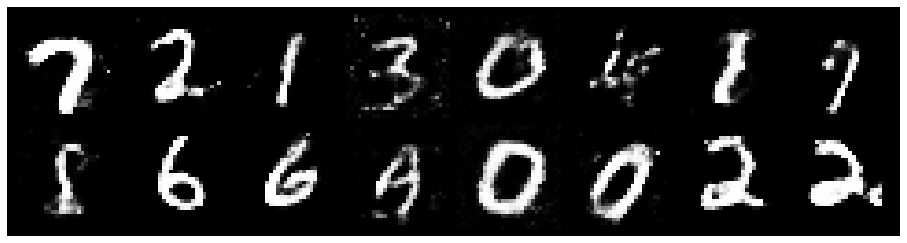

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.2513, Generator Loss: 0.8067
D(x): 0.5562, D(G(z)): 0.4452


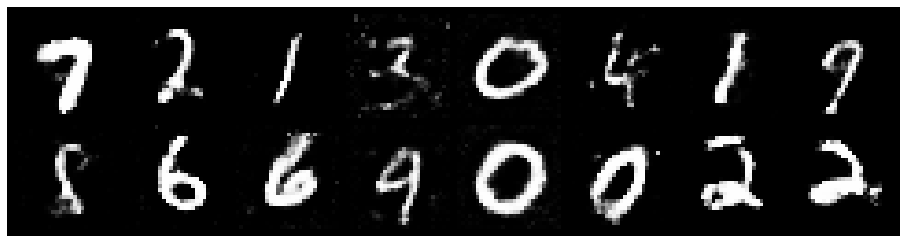

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.2697, Generator Loss: 0.7798
D(x): 0.5473, D(G(z)): 0.4585


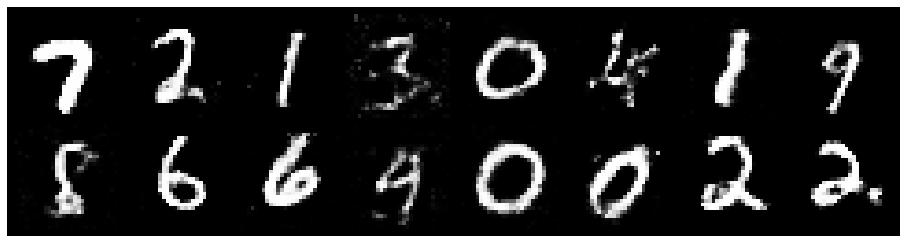

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.2717, Generator Loss: 0.8159
D(x): 0.5403, D(G(z)): 0.4429


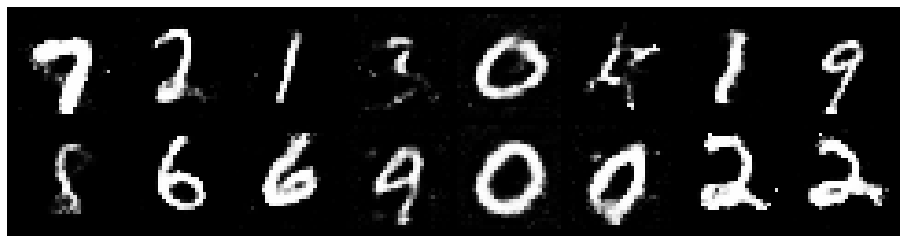

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.2242, Generator Loss: 0.8192
D(x): 0.5731, D(G(z)): 0.4606


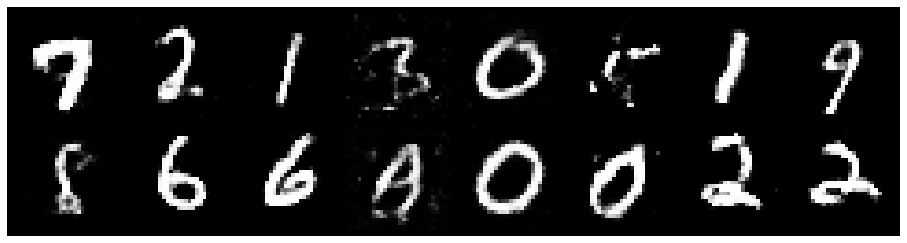

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.3020, Generator Loss: 0.8640
D(x): 0.5628, D(G(z)): 0.4655


In [ ]:
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')
# Total number of epochs to train
num_epochs = 200
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )


## Inferences and Conclusion : State all the key observations and conclusion

1. The discriminator error is very high (Aroung 1.4 - 1.3 in the first few epochs) in the beginning, as it doesn’t know how to classify correctly images as being either real or fake.
After 1 epoch : 
```
Discriminator Loss: 1.3903, Generator Loss: 0.6739
```


2. As the discriminator becomes better and its error decreases to about .5, the generator error increases, proving that the discriminator outperforms the generator and it can correctly classify the fake samples.



```
Discriminator Loss: 0.4254, Generator Loss: 5.7648
```

3. As time passes and training continues, the generator error lowers, implying that the images it generates are better and better. While the generator improves, the discriminator’s error increases, because the synthetic images are becoming more realistic each time.

Final epoch : 



```
Discriminator Loss: 1.3020, Generator Loss: 0.8640
```





Generated Images are : 

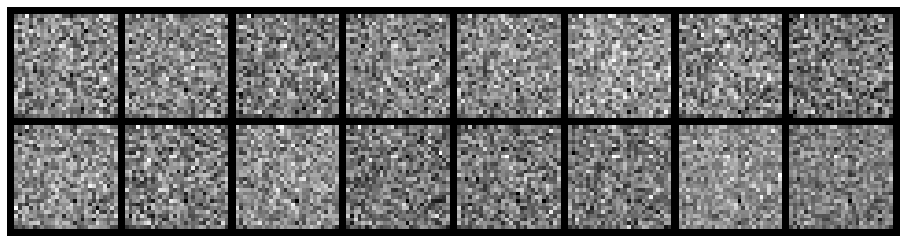

AFter some 50 epochs : 

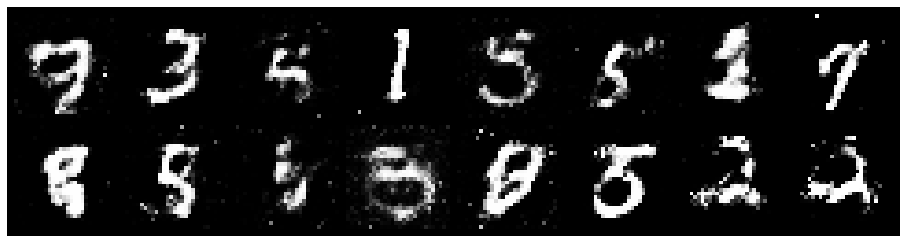

After 200 epochs:

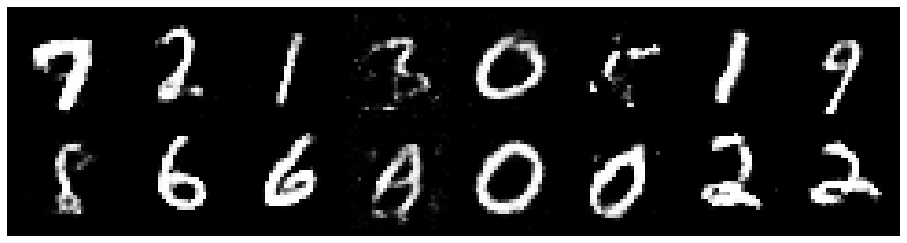
